In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions.ipynb
#uproot3
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [3]:
sim="sim"
run="e16"
cut_perf="delta"
species = "pim"

date = "06-21-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/06-13-2022"

root_file=dir+"/"+sim+"_"+run+"_clas6_"+cut_perf+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)
#selection 0-> pid in experimental W range, 1->event selection in full W range
selection = 1
# 0 => full range 1=> Experimental W range
W_range = 0

rel_top=['mnone','mall']

W_bits=['all','in_range']

In [4]:
#The Various layers of TDirectories to get to the histograms
layer1='Delta'
layer2=cut_perf+"_"+species
layer3=[layer2+"_pid",layer2+"_event"]
layer4=[[layer3[sel]+"_sec"+str(sec+1) for sel in range(2)] for sec in range(6)]
layer5=[[layer4[sec][sel]+"_cut" for sel in range(2)] for sec in range(6)]
layer6=[[layer5[sec][0]+"_mnone",layer5[sec][1]+"_mall"] for sec in range(6)]
layer7=[[layer6[sec][sel]+"_in_range" for sel in range(2)] for sec in range(6)]
layer8=[[layer3[sel]+"_cut_"+rel_top[sel]+"_sec"+str(sec+1)+"_"+W_bits[W_range] for sel in range(2)] for sec in range(6)]
dir_loc0= [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection] for sec in range(6)]
dir_loc = [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection]+"/"+layer8[sec][selection] for sec in range(6)]

hist = [file[dir_loc[sec]] for sec in range(6)]

print(layer8[0][selection])

delta_pim_event_cut_mall_sec1_all


In [5]:
print(layer8[0])
file[dir_loc0[0]].keys()


['delta_pim_pid_cut_mnone_sec1_all', 'delta_pim_event_cut_mall_sec1_all']


[b'delta_pim_event_cut_mall_sec1_in_range;1',
 b'delta_pim_event_cut_mall_sec1_all;1']

In [6]:
cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

In [7]:
#Extracting X and Y bins
#X and Y binning is the same for all sectors
xbins=Center_Xbins(hist[0])
ybins=Center_Ybins(hist[0])

In [8]:
#Extracting Zvals for 2d histograms
zvals_xy=[XY_Values(hist[sec]) for sec in range(6)]
zvals_yx=[YX_Values(hist[sec]) for sec in range(6)]

In [9]:
#Determining Cell Merging 
xmerge=3
ymerge=3
xname="p(GeV)"
yname="\u0395 t"
#Merge -> No Zeros
x = Merge_Bins(xbins,xmerge)
y = Merge_Bins(ybins,ymerge)
xedges = Merge_Bin_Edges(XEdges_2d(hist[0]),xmerge)
yedges = Merge_Bin_Edges(YEdges_2d(hist[0]),ymerge)
z_xy=[Merge_Z(zvals_xy[i],xmerge,ymerge) for i in range(6)]
z_yx=[Merge_Z(zvals_yx[i],ymerge,xmerge) for i in range(6)]
fit_x = [[Remove_Zeros_X(y,z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
fit_y = [[Remove_Zeros_Y(z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]



In [10]:
#dumb_x= np.zeros((6,len(x)*len(y)))
#dumb_y= np.zeros((6,len(x)*len(y)))
#dense2 = np.zeros((6,len(x)*len(y)))
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    #for i in range(len(x)):
    for i in range(len(xbins)):
        #for j in range(len(y)):
        for j in range(len(ybins)):
            #dumb_x[sec][i+j*len(x)]+=x[i]
            #dumb_y[sec][i+j*len(x)]+=y[j]
            #dense2[sec][i+j*len(x)]+=zvals_xy[sec][i][j]
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]


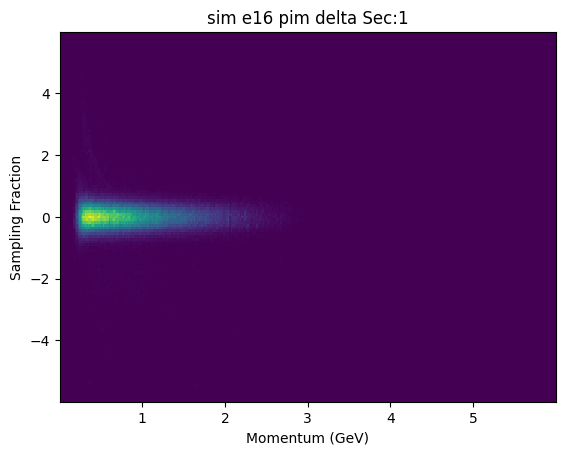

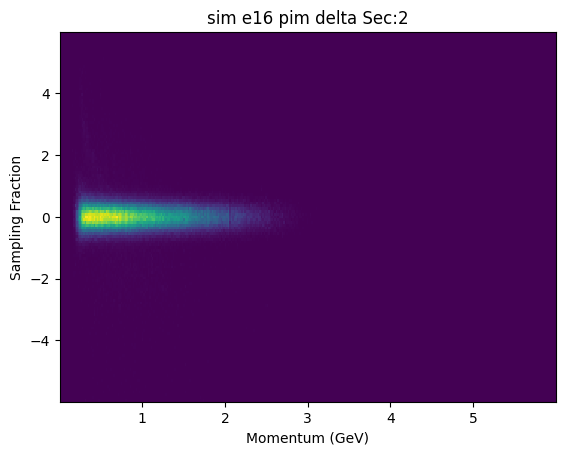

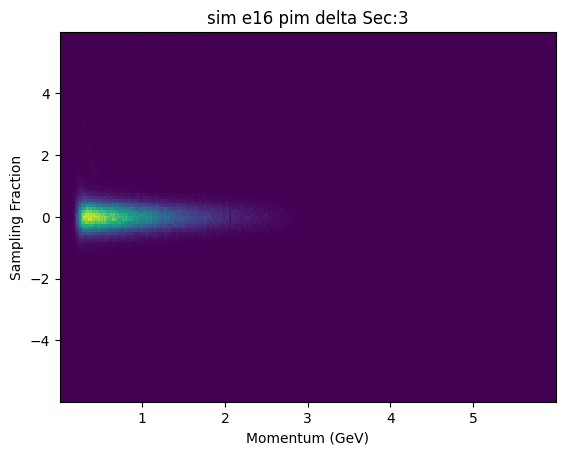

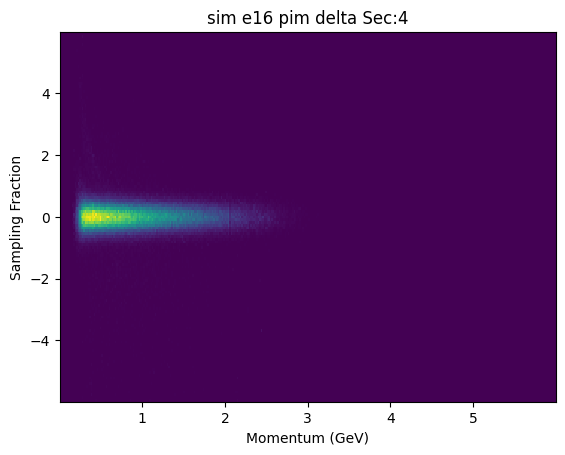

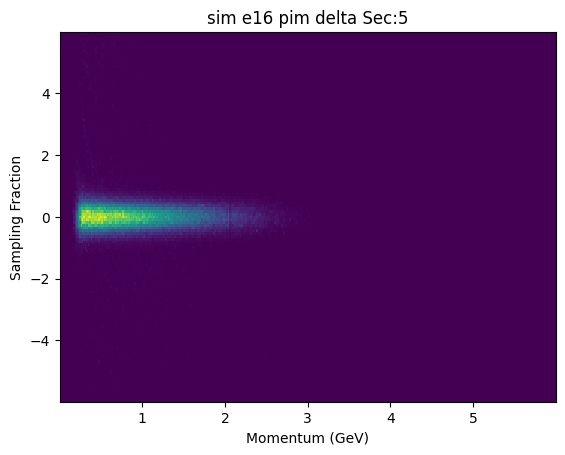

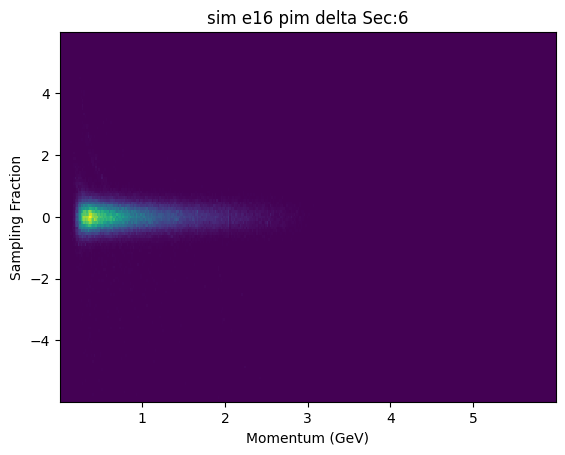

In [12]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(x), len(y)), weights=dense2[sec])
    plt.title("{} {} {} {} Sec:{}".format(sim,run,species,cut_perf,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("Sampling Fraction")
    plt.show()
    
    
    

In [13]:
def Pbin_low(xbin_):
    return round(xedges[xbin_],3)
def Pbin_top(xbin_):
    return round(xedges[xbin_+1],3)

In [14]:
print(np.argmax(z_xy[0][10]))
print(np.max(z_xy[0][10]))
print(z_xy[0][10][np.argmax(z_xy[0][10])])

66
0.04118434898555279
0.04118434898555279


In [15]:
# _me_ = 0.511
# _sig_e_ = 0.02

# width=[3,2]


# def Z_XY_ele_sub(xvals_,yvals_,z_xy_):
#     output=np.zeros((len(xvals_),len(yvals_)))
#     for x in range(len(xvals_)):
#         for y in range(len(yvals_)):
#             if y <= np.argmax(z_xy_[x])-width[0] or y > np.argmax(z_xy_[x])+width[1]:
#                 output[x][y] = z_xy_[x][y]
#     return output

# def Z_YX_ele_sub(xvals_,yvals_,z_yx_):
#     output=np.zeros((len(yvals_),len(xvals_)))
#     for x in range(len(xvals_)):
#         for y in range(len(yvals_)):
#             if x <= np.argmax(z_yx_[y])-width[0] or x > np.argmax(z_yx_[y])+width[1]:
#                 output[y][x] = z_yx_[y][x]  
#     return output

In [16]:
# n_zvals_xy = [Z_XY_ele_sub(x,y,z_xy[sec]) for sec in range(6)] 
# n_zvals_yx = [Z_YX_ele_sub(x,y,z_yx[sec]) for sec in range(6)] 
# nfit_x2 = [[Remove_Zeros_X(y,n_zvals_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
# nfit_y2 = [[Remove_Zeros_Y(n_zvals_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]


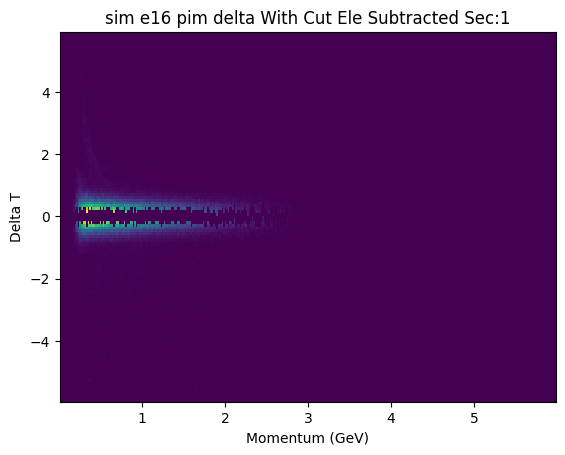

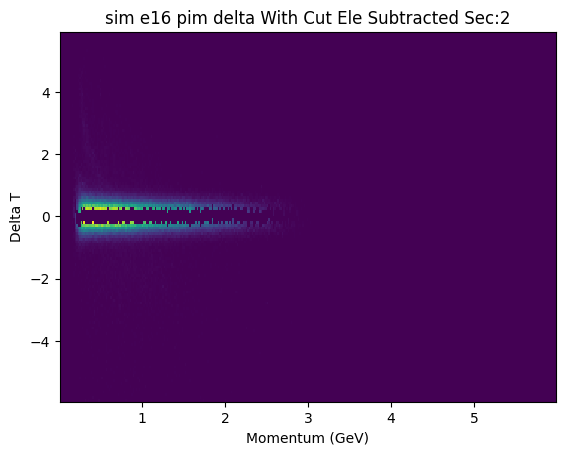

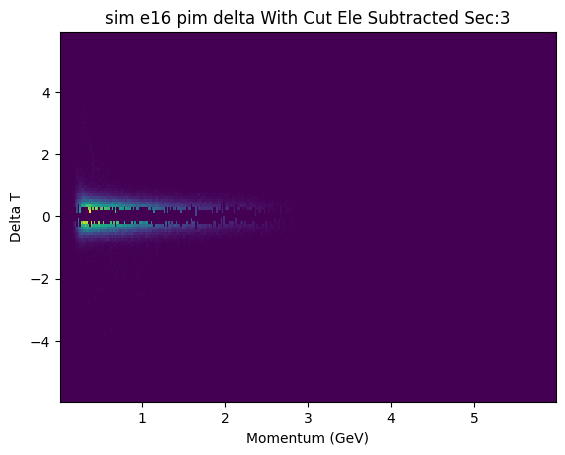

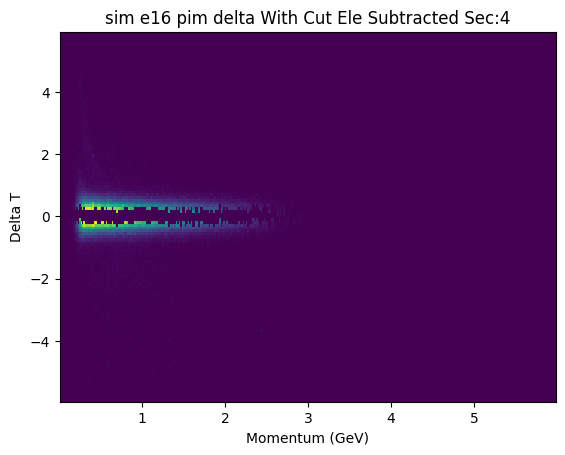

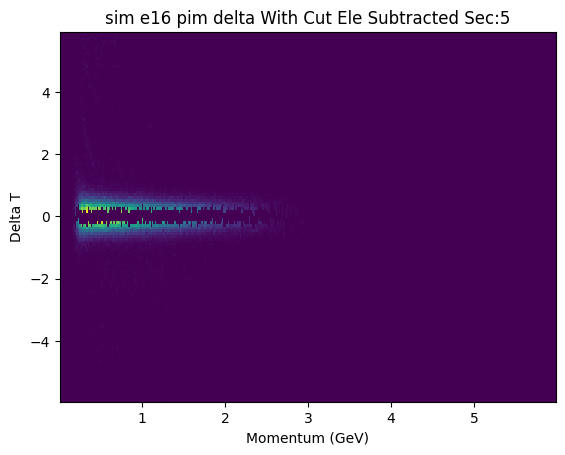

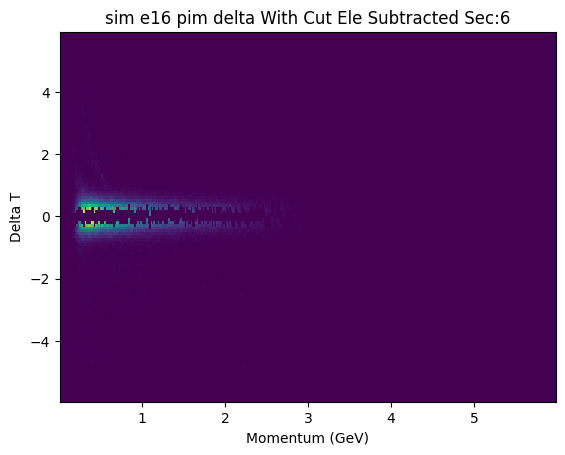

-0.9582385602653422 1.001880041834423
-1.1542504204753186 1.1978919020443992
-1.350262280685295 1.3939037622543757


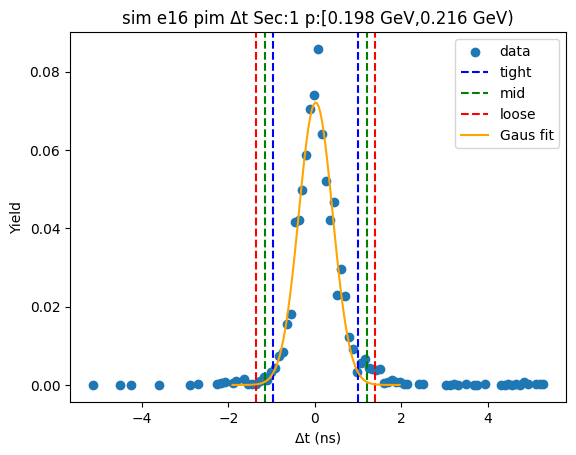

-0.9751279962635289 1.0126707602919978
-1.1739078719190816 1.2114506359475503
-1.3726877475746342 1.4102305116031033


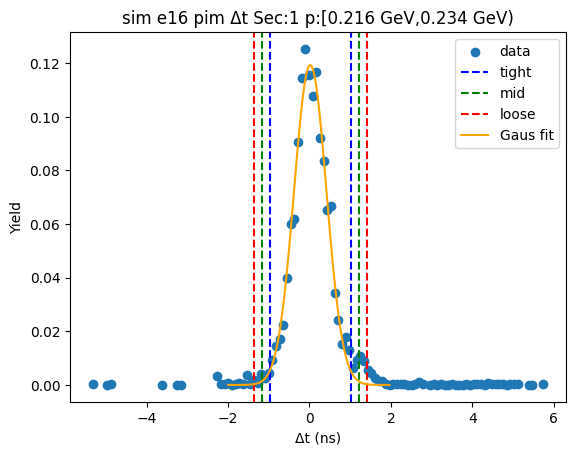

-0.9270393438805655 0.9690142387225134
-1.1166447021408734 1.1586195969828212
-1.3062500604011813 1.3482249552431291


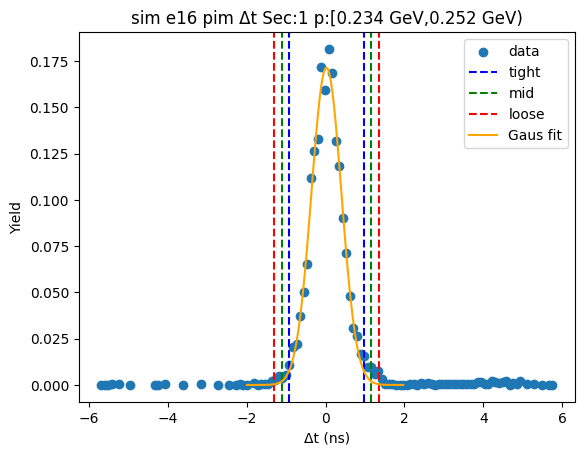

-0.9116100867021886 0.9235399550933199
-1.0951250908817396 1.107054959272871
-1.2786400950612904 1.2905699634524217


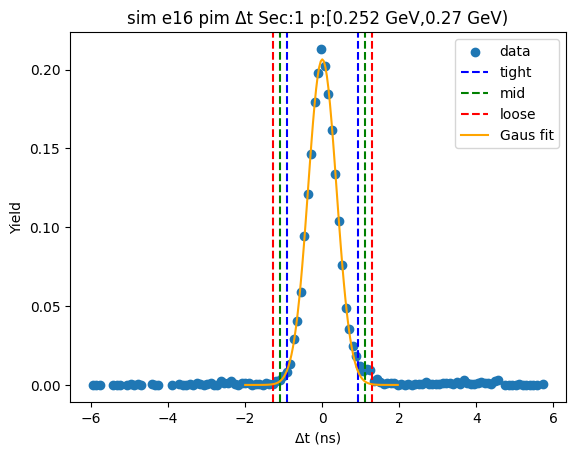

-0.8495525507925078 0.8751864529392165
-1.0220264511656802 1.0476603533123887
-1.1945003515388528 1.2201342536855613


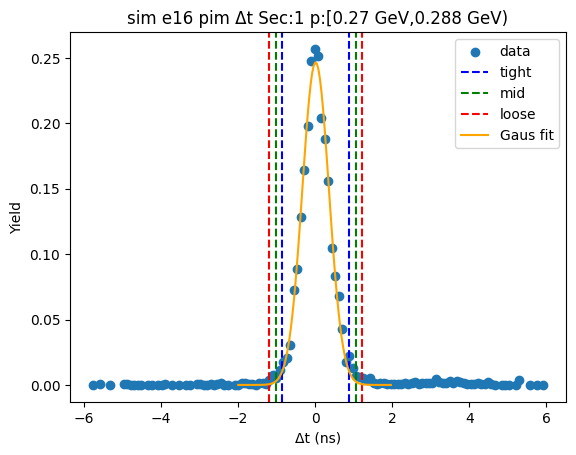

-0.8353386496249676 0.8556473798105405
-1.0044372525685183 1.0247459827540912
-1.1735358555120692 1.193844585697642


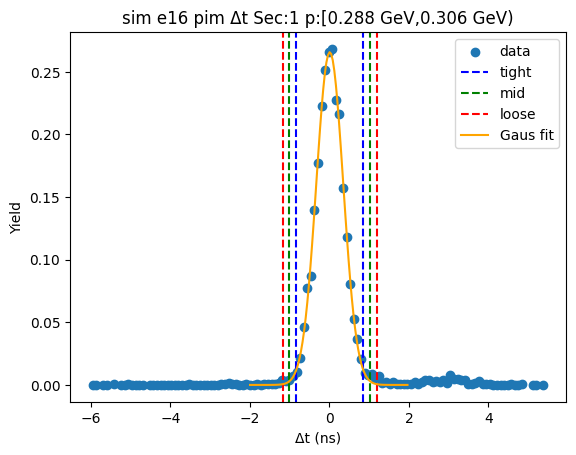

-0.8337862527591894 0.8692622050428186
-1.0040910985393903 1.0395670508230195
-1.174395944319591 1.2098718966032203


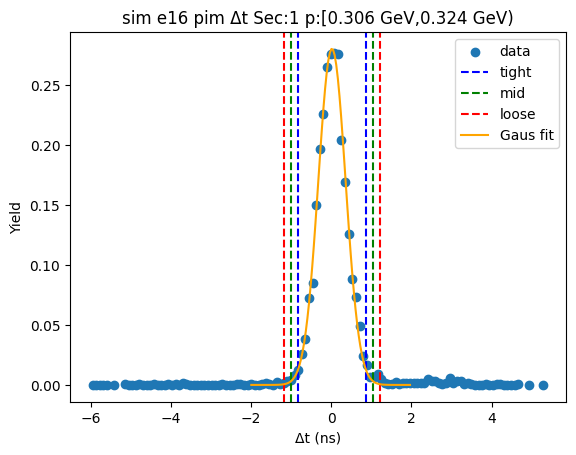

-0.8332663275375346 0.8600726342935466
-1.0026002237206426 1.0294065304766549
-1.1719341199037507 1.198740426659763


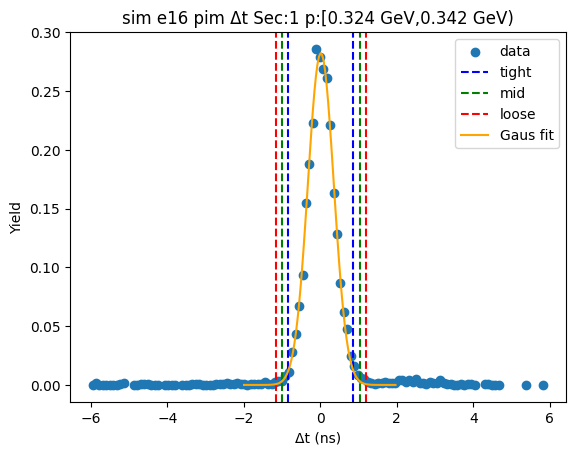

-0.7916288892983108 0.8162069624299393
-0.9524124744711358 0.9769905476027645
-1.1131960596439607 1.1377741327755895


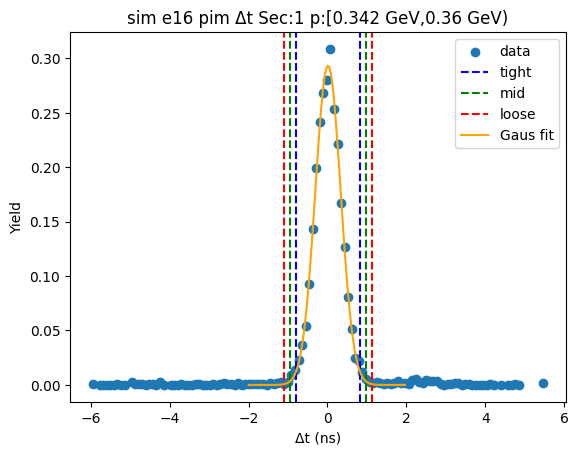

-0.7835715600931336 0.8349352207683246
-0.9454222381792793 0.9967858988544703
-1.1072729162654253 1.1586365769406162


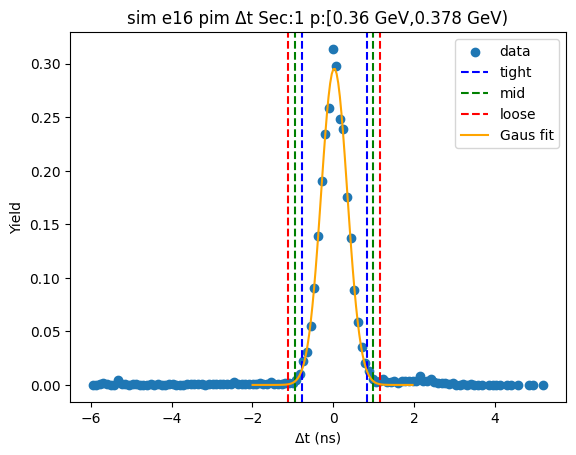

-0.7871038834321012 0.8300558596211743
-0.9488198577374287 0.9917718339265018
-1.1105358320427563 1.1534878082318294


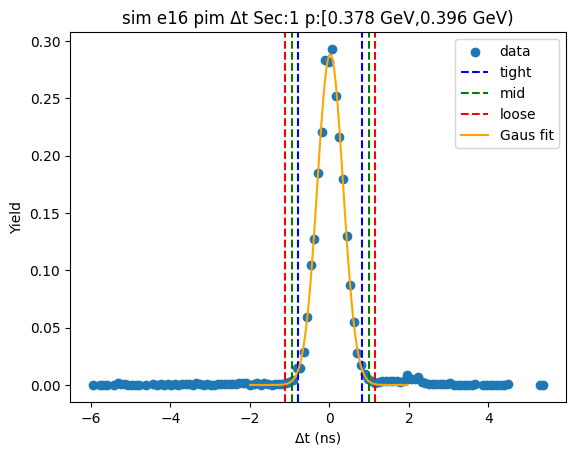

-0.7792223503362103 0.7966269618893167
-0.9368072815587631 0.9542118931118695
-1.0943922127813157 1.111796824334422


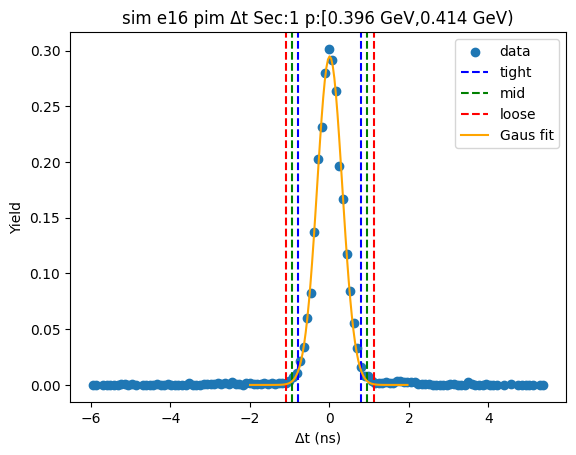

-0.783125315095732 0.7947925034936569
-0.9409170969546709 0.9525842853525958
-1.0987088788136097 1.1103760672115346


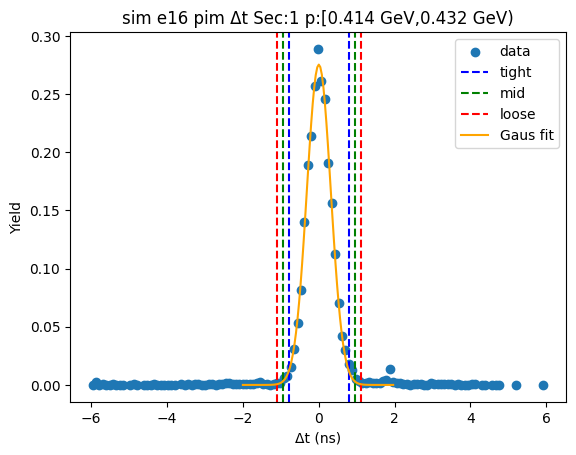

-0.7663493174315809 0.799722772722356
-0.9229565264469745 0.9563299817377496
-1.0795637354623684 1.1129371907531433


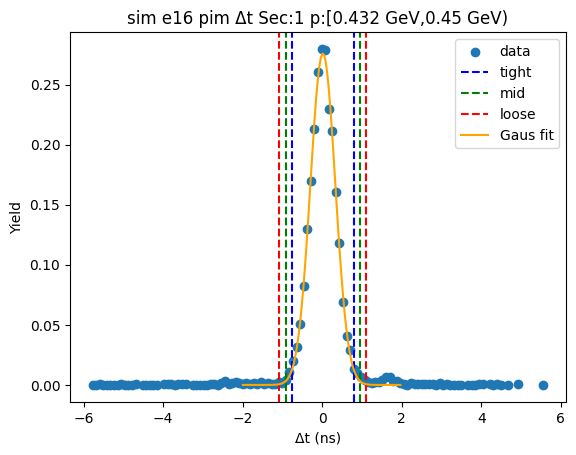

-0.7883948242629524 0.8182564372761261
-0.9490599504168603 0.978921563430034
-1.109725076570768 1.139586689583942


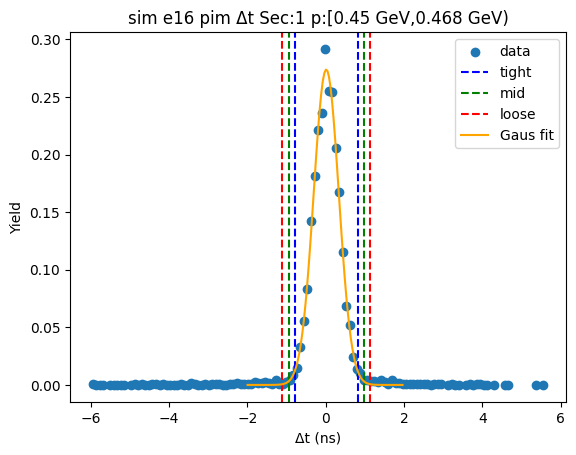

-0.7533619174819729 0.7965015377444175
-0.908348263004612 0.9514878832670566
-1.063334608527251 1.1064742287896956


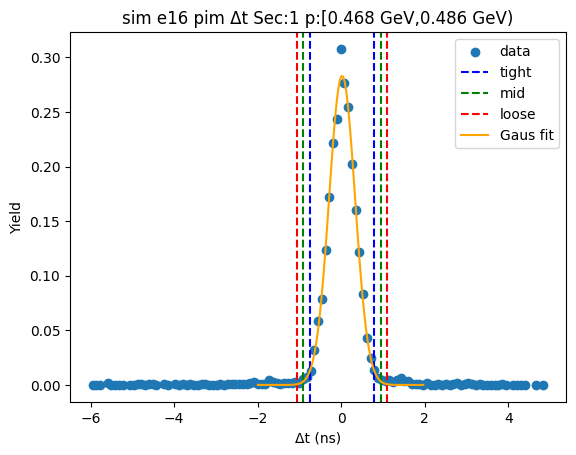

-0.7634078463309641 0.8041833458685457
-0.920166965550915 0.9609424650884966
-1.0769260847708662 1.1177015843084477


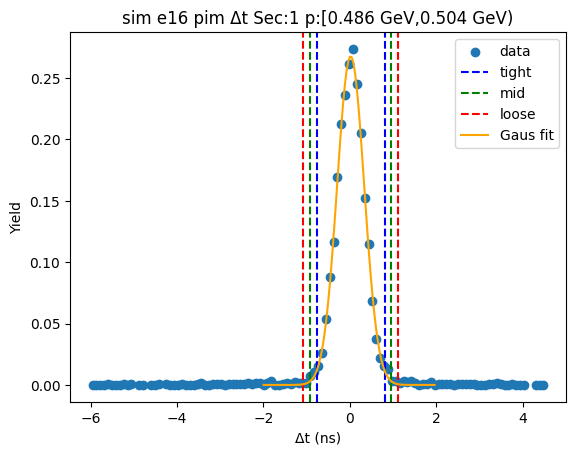

-0.7715315822057744 0.8074298205376107
-0.929427722480113 0.9653259608119492
-1.0873238627544515 1.123222101086288


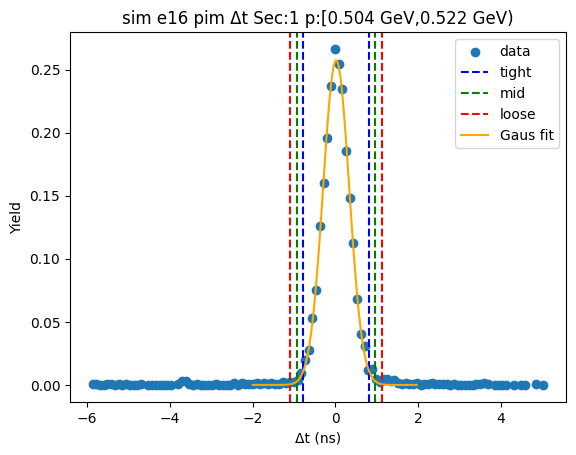

-0.7791541783502927 0.8051454844329613
-0.937584144628618 0.9635754507112867
-1.0960141109069437 1.122005416989612


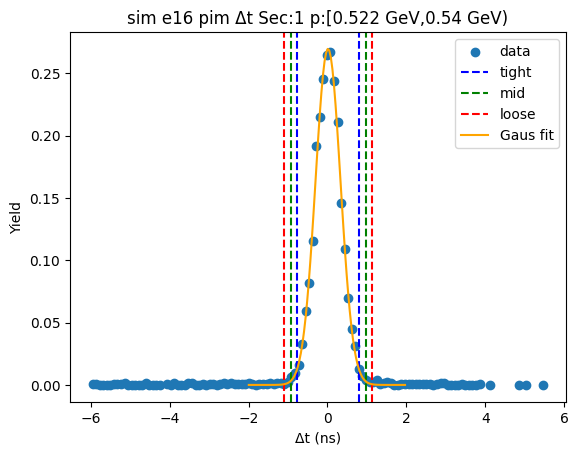

-0.753471290959189 0.7698103385132484
-0.9057994539064328 0.9221385014604923
-1.0581276168536766 1.0744666644077359


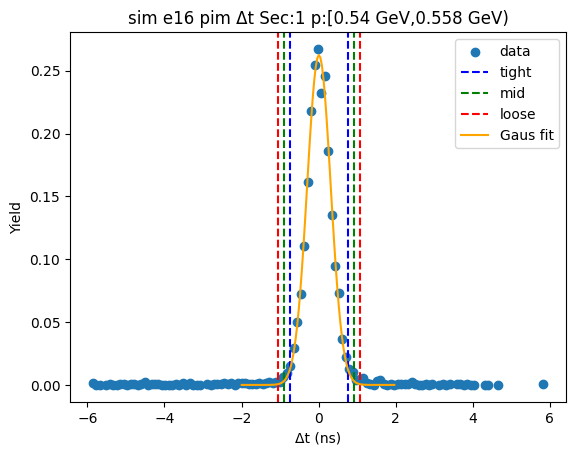

-0.7781172782143954 0.7976646252906489
-0.9356954685648997 0.9552428156411532
-1.0932736589154042 1.1128210059916575


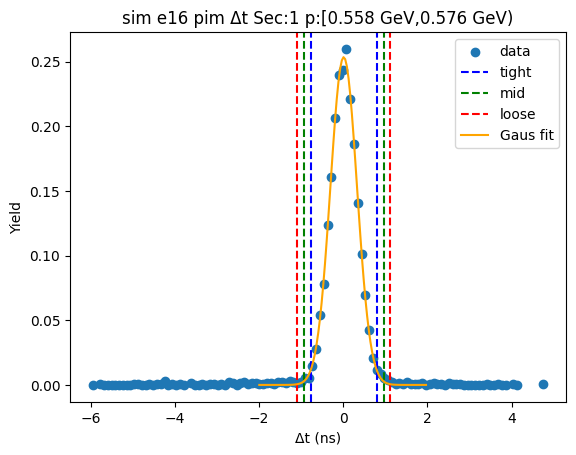

-0.7580319238042204 0.786358848447364
-0.9124710010293787 0.9407979256725224
-1.066910078254537 1.0952370028976808


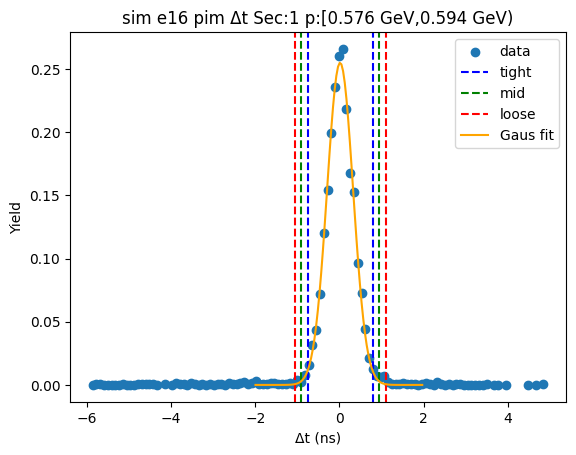

-0.7641409068792451 0.8285124528210353
-0.9234062428492732 0.9877777887910634
-1.082671578819301 1.1470431247610915


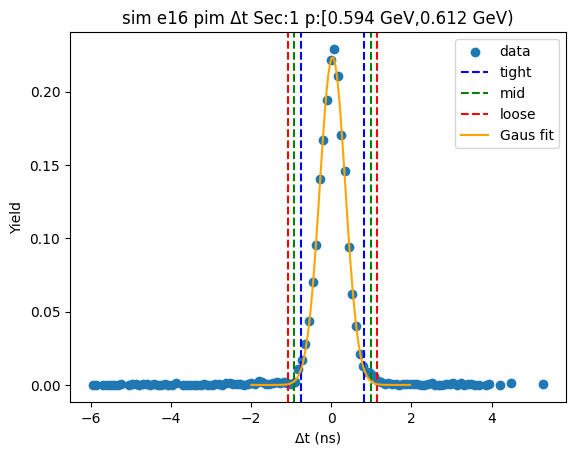

-0.7622927089445706 0.7787679546532762
-0.9163987753043553 0.9328740210130609
-1.07050484166414 1.0869800873728457


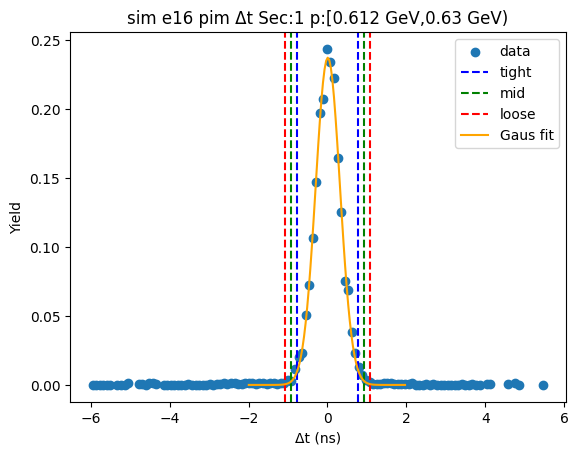

-0.7704491891184333 0.7964010116381091
-0.9271342091940876 0.9530860317137634
-1.083819229269742 1.1097710517894175


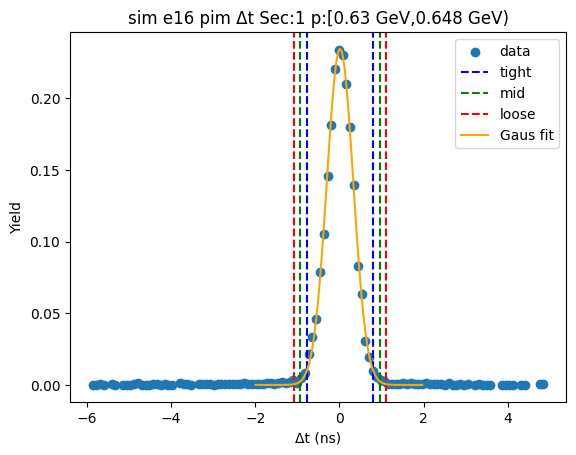

-0.7638300435033607 0.7913765032879292
-0.9193506981824896 0.9468971579670581
-1.0748713528616187 1.102417812646187


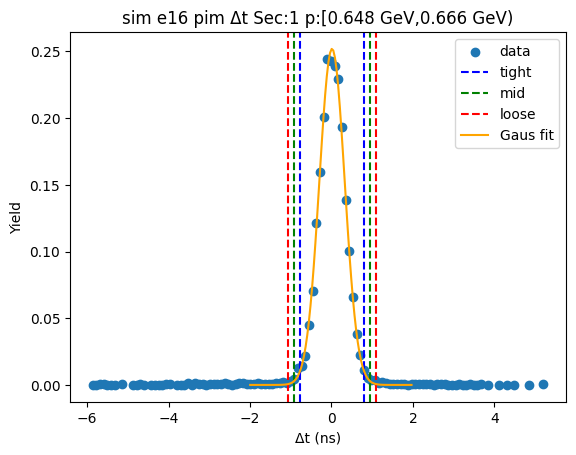

-0.7467091678632246 0.7823686260030088
-0.8996169472498479 0.9352764053896321
-1.0525247266364712 1.0881841847762554


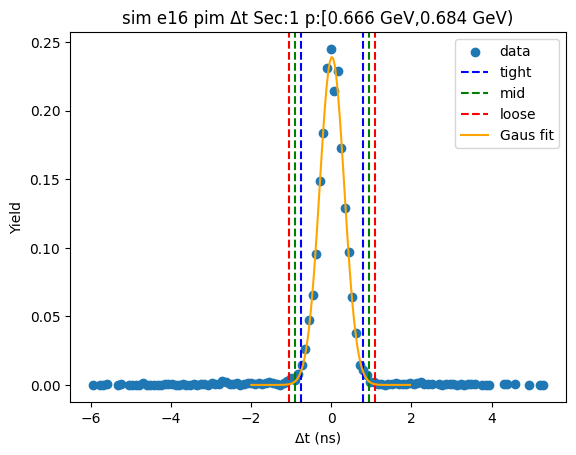

-0.7596798295556857 0.7773877736347119
-0.9133865898747255 0.9310945339537517
-1.0670933501937652 1.0848012942727914


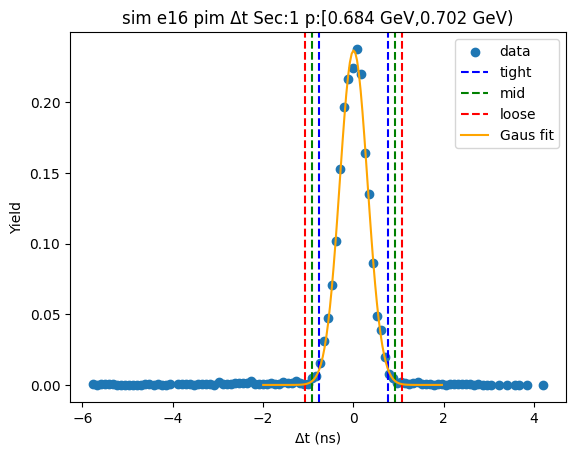

-0.7611787458818591 0.7761447896301894
-0.9149110994330639 0.9298771431813943
-1.0686434529842685 1.083609496732599


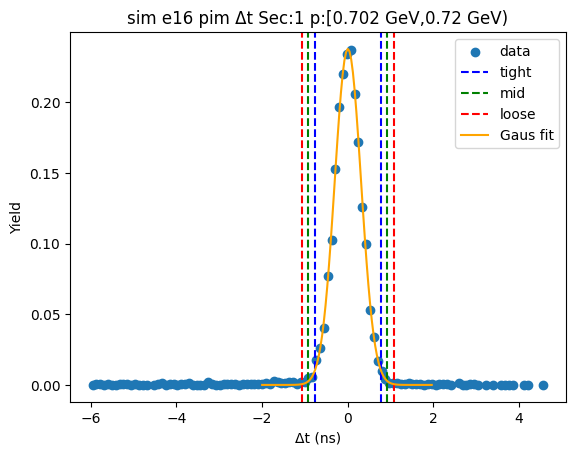

-0.7374751138761093 0.7668297527168249
-0.8879056005354028 0.9172602393761183
-1.0383360871946963 1.0676907260354118


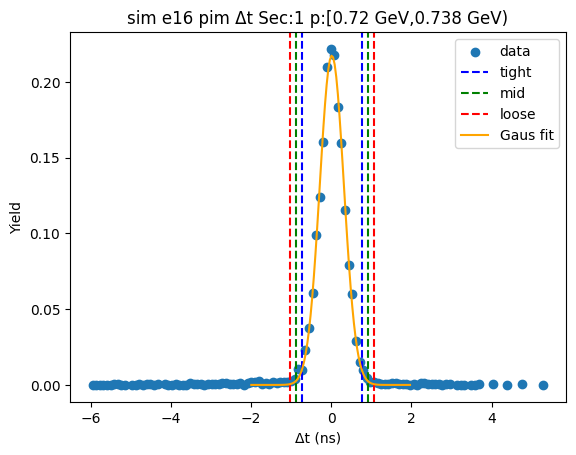

-0.732463774399922 0.7636876379073647
-0.8820789156306507 0.9133027791380933
-1.0316940568613793 1.062917920368822


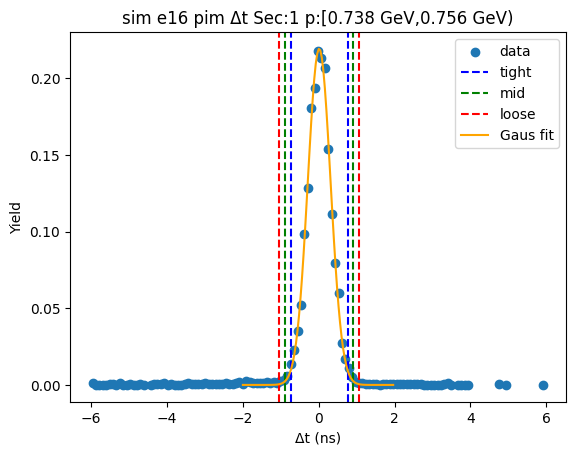

-0.7413434068185569 0.7442125870799934
-0.8898990062084119 0.8927681864698483
-1.0384546055982669 1.0413237858597033


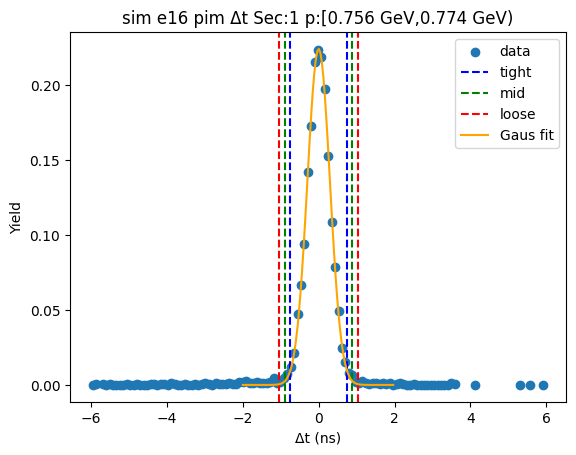

-0.7425091570000711 0.7702630637515114
-0.8937863790752294 0.9215402858266697
-1.0450636011503878 1.072817507901828


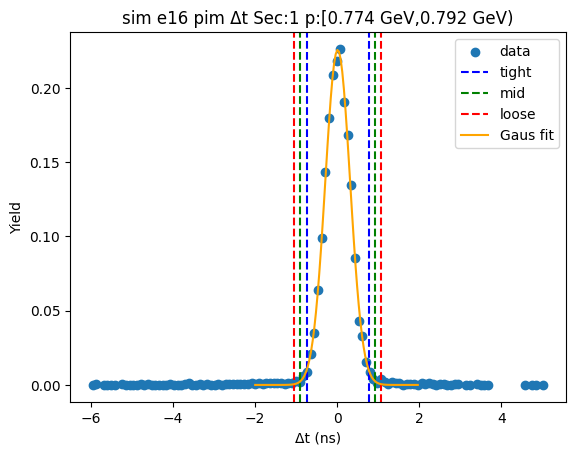

-0.7685724387838861 0.7709058903034063
-0.9225202716926153 0.9248537232121354
-1.0764681046013447 1.0788015561208648


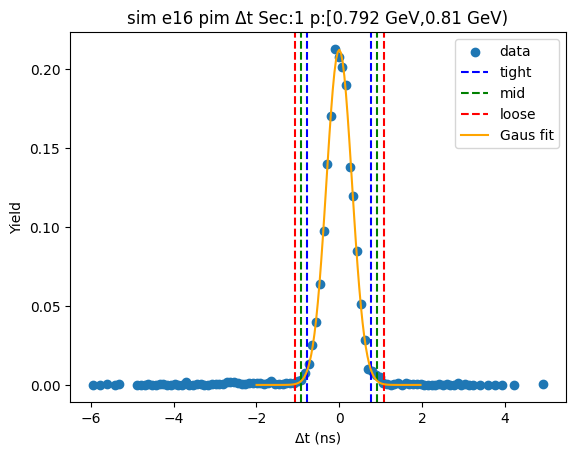

-0.7407434724195928 0.7338270495846698
-0.8882005246200191 0.8812841017850961
-1.0356575768204452 1.0287411539855222


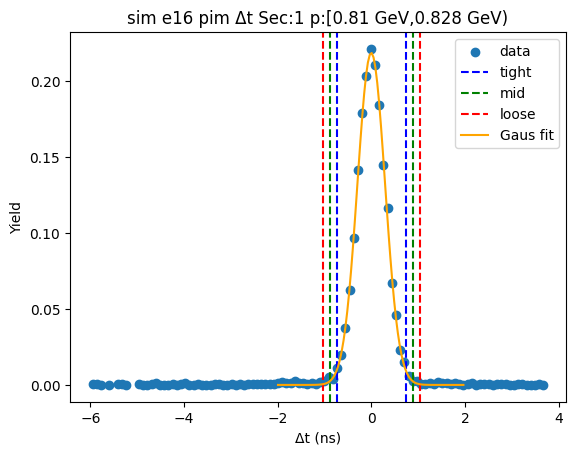

-0.7435133686169086 0.7609291400773195
-0.8939576194863315 0.9113733909467423
-1.0444018703557543 1.0618176418161651


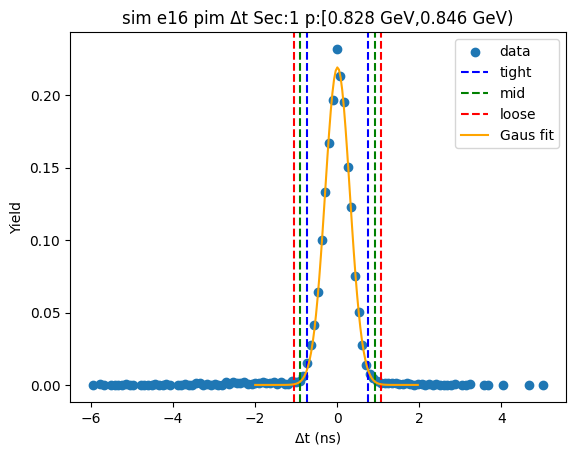

-0.7421363217379806 0.7501553992991088
-0.8913654938416896 0.8993845714028178
-1.0405946659453986 1.0486137435065268


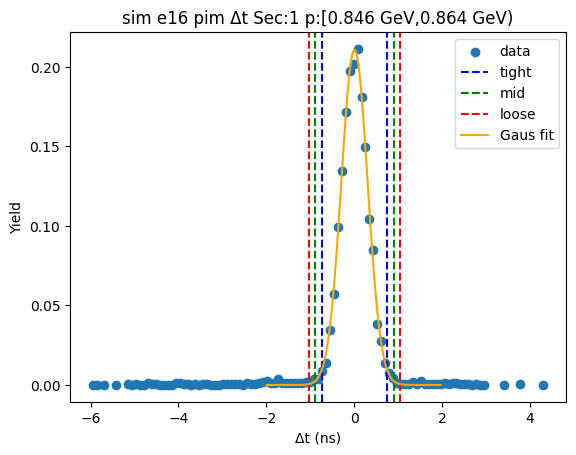

-0.7400111635774193 0.7620105931484827
-0.8902133392500094 0.9122127688210729
-1.0404155149225995 1.0624149444936632


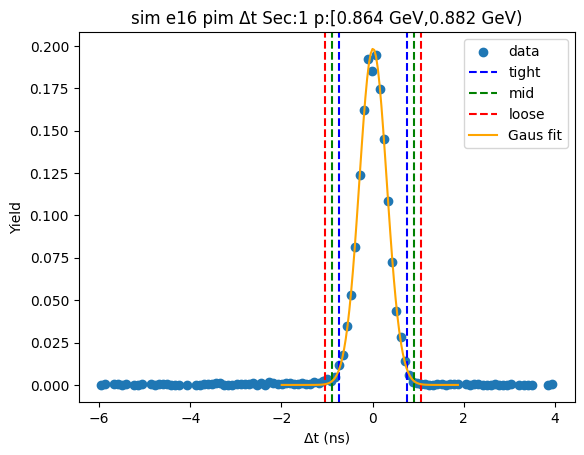

-0.7537074141282034 0.737791602980552
-0.902857315839079 0.8869415046914276
-1.0520072175499546 1.0360914064023032


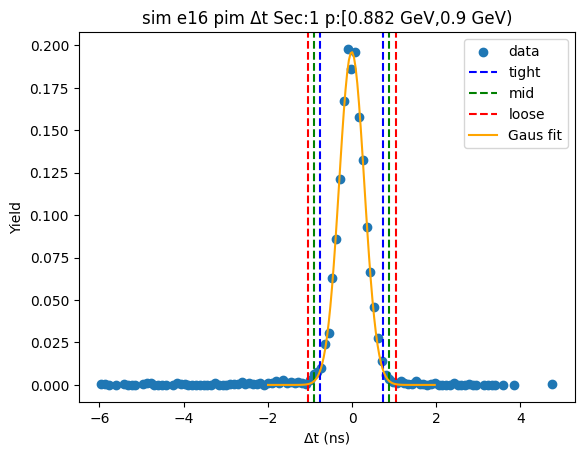

-0.7339935723121574 0.7579480639522814
-0.8831877359386013 0.9071422275787253
-1.0323818995650451 1.056336391205169


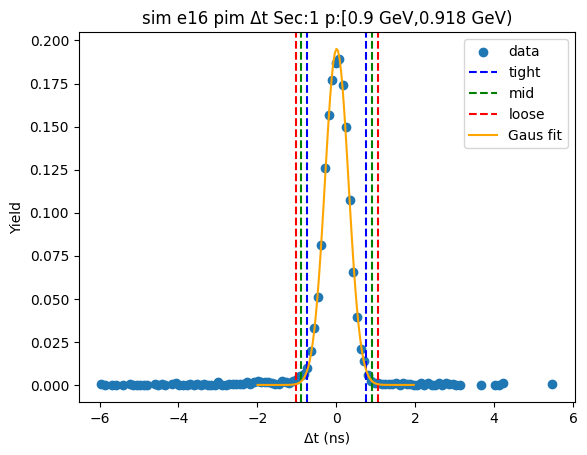

-0.7434547822661389 0.7588562459661005
-0.8936858850893629 0.9090873487893244
-1.043916987912587 1.0593184516125482


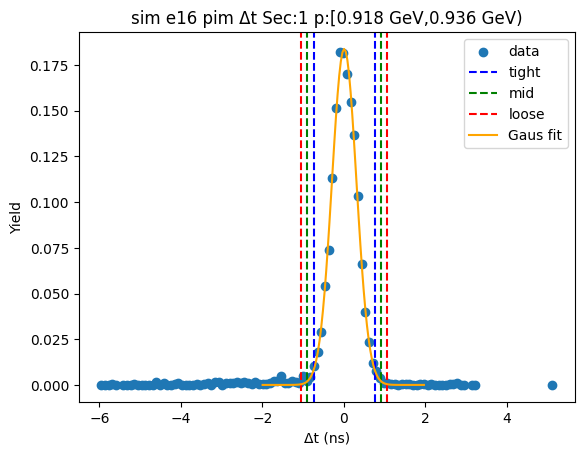

-0.7486063677298471 0.7683032643132337
-0.9002973309341552 0.9199942275175418
-1.051988294138463 1.0716851907218499


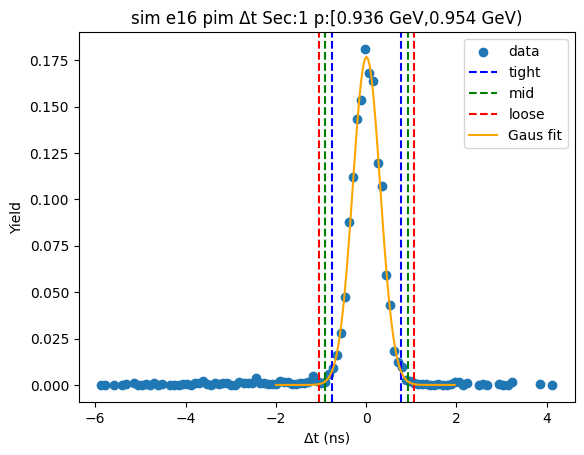

-0.7559104411391925 0.7611473495764579
-0.9076162202107576 0.912853128648023
-1.0593219992823226 1.064558907719588


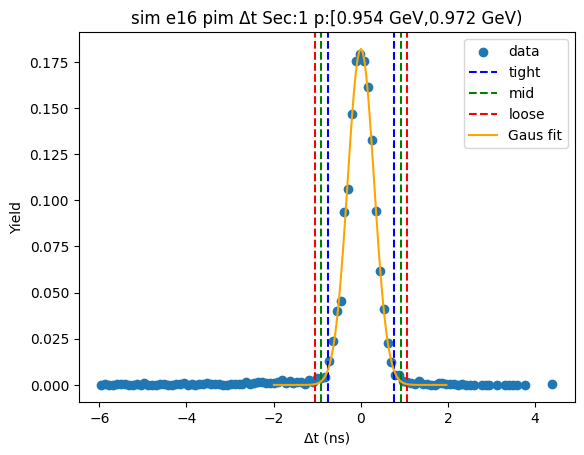

-0.7569232838898294 0.7723265091922566
-0.9098482631980381 0.9252514885004653
-1.0627732425062466 1.078176467808674


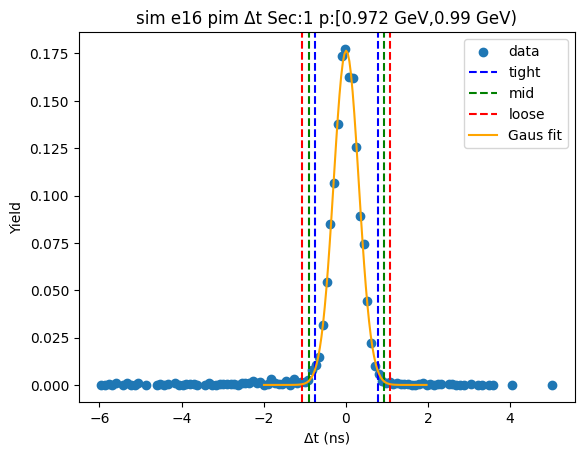

-0.7796457572507829 0.7915954054768601
-0.9367698735235471 0.9487195217496244
-1.0938939897963114 1.1058436380223886


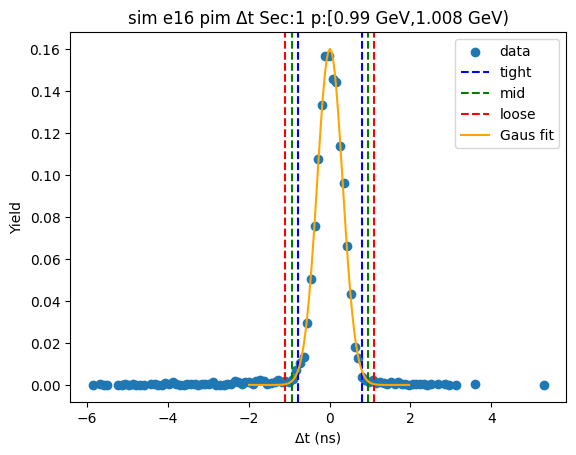

-0.7222770471691299 0.7234806869185625
-0.866852820577899 0.8680564603273316
-1.0114285939866683 1.0126322337361011


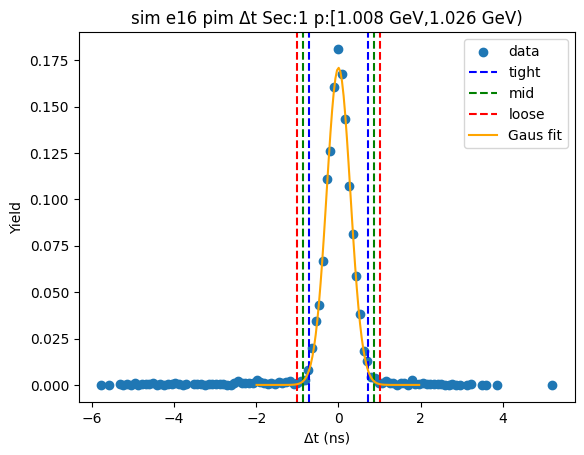

-0.7086505182886077 0.7542563973530702
-0.8549412098527756 0.900547088917238
-1.0012319014169433 1.046837780481406


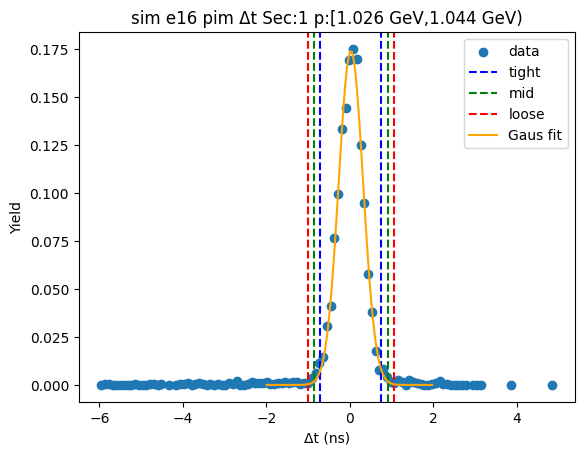

-0.7336545836770039 0.7439229619896255
-0.8814123382436667 0.8916807165562883
-1.0291700928103298 1.0394384711229514


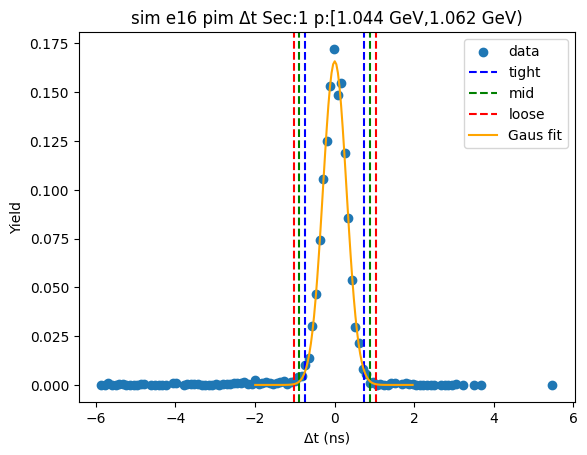

-0.7697816933130698 0.7619314981979798
-0.9229530124641748 0.9151028173490848
-1.0761243316152798 1.0682741365001895


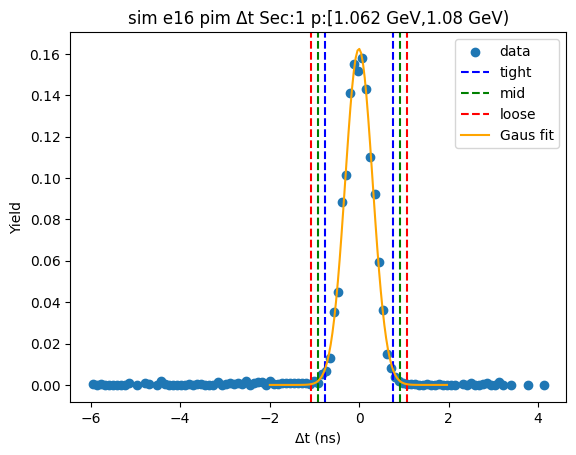

-0.7336242029502275 0.7386497445156012
-0.8808515976968103 0.885877139262184
-1.028078992443393 1.0331045340087668


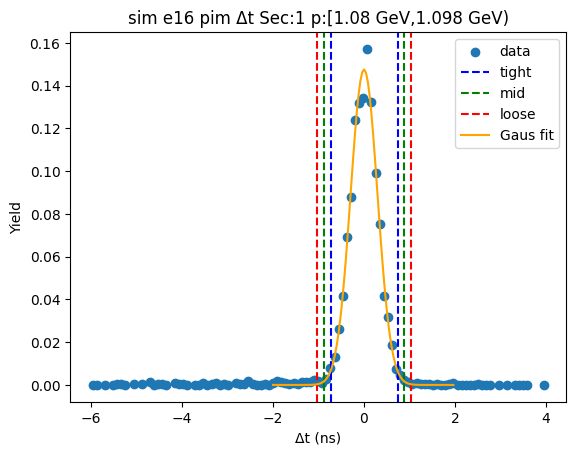

-0.7429375970174386 0.7514306319533022
-0.8923744199145127 0.9008674548503763
-1.0418112428115867 1.0503042777474503


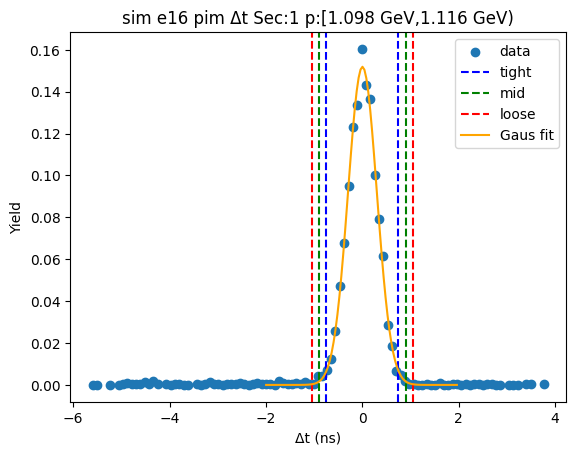

-0.7481996392779853 0.7522922429447176
-0.8982488275002555 0.9023414311669878
-1.0482980157225257 1.0523906193892583


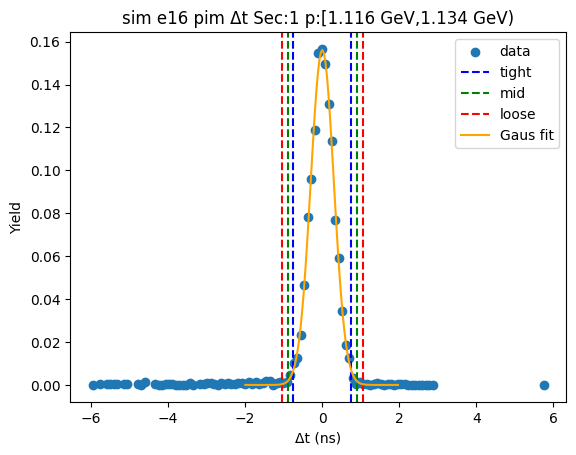

-0.7362139444575009 0.7457159714638277
-0.8844069360496338 0.8939089630559607
-1.0325999276417666 1.0421019546480934


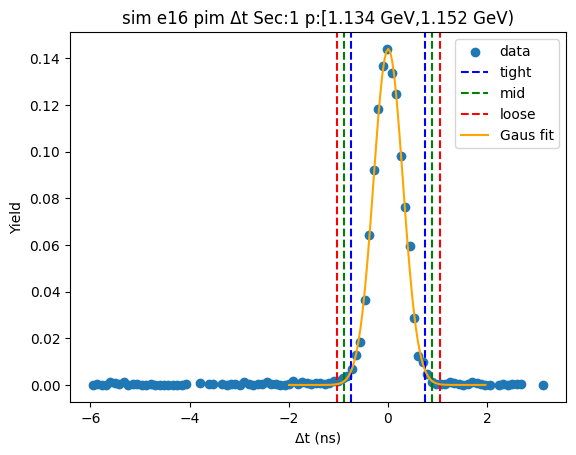

-0.7234929976091953 0.7299936375811764
-0.8688416611282324 0.8753423011002135
-1.0141903246472697 1.0206909646192508


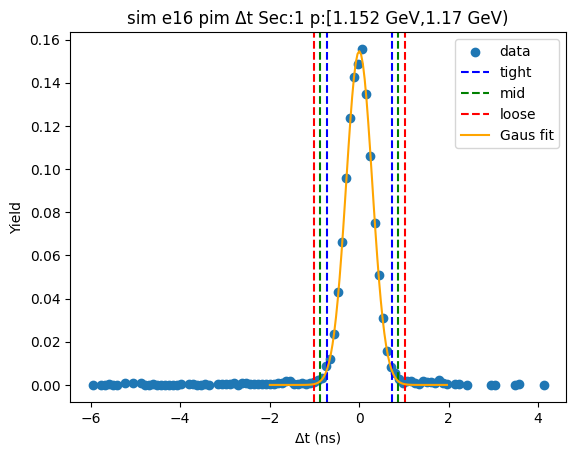

-0.7127114743599889 0.727435982293418
-0.8567262200253297 0.8714507279587588
-1.0007409656906705 1.0154654736240993


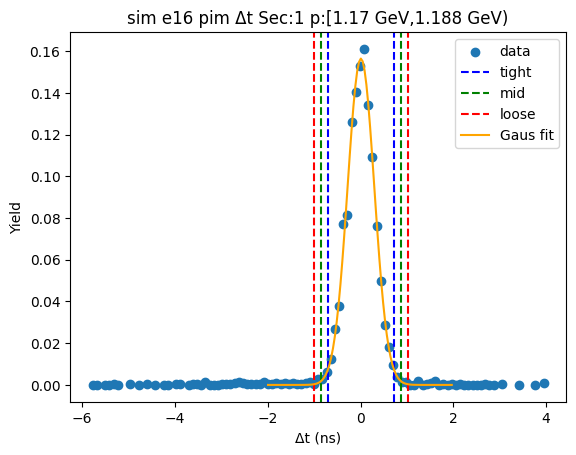

-0.7248239498239001 0.7502106392002378
-0.8723274087263139 0.8977140981026516
-1.0198308676287275 1.0452175570050655


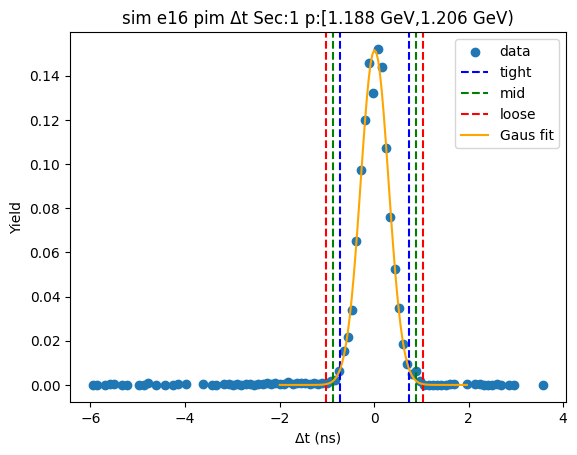

-0.7245675535950961 0.7417373909440045
-0.871198048049006 0.8883678853979144
-1.017828542502916 1.0349983798518245


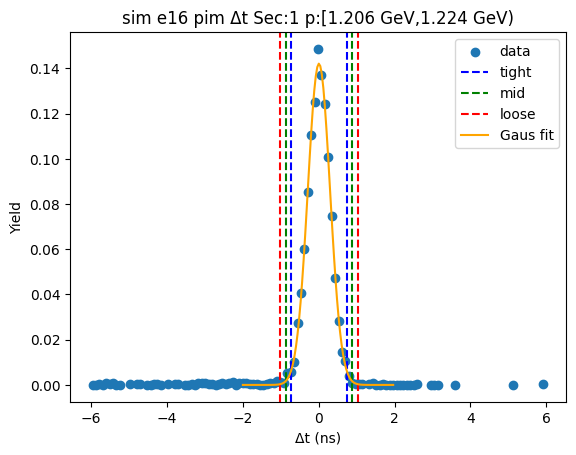

-0.7458231640244759 0.7131890929411626
-0.8917243897210398 0.8590903186377266
-1.0376256154176036 1.0049915443342903


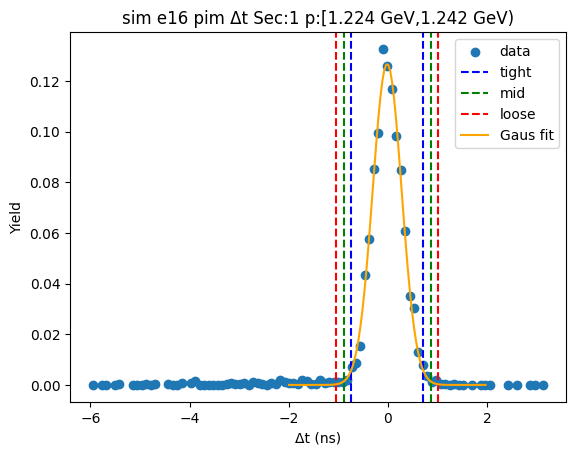

-0.7276241603786543 0.733284020087766
-0.8737149784252963 0.8793748381344081
-1.0198057964719383 1.0254656561810502


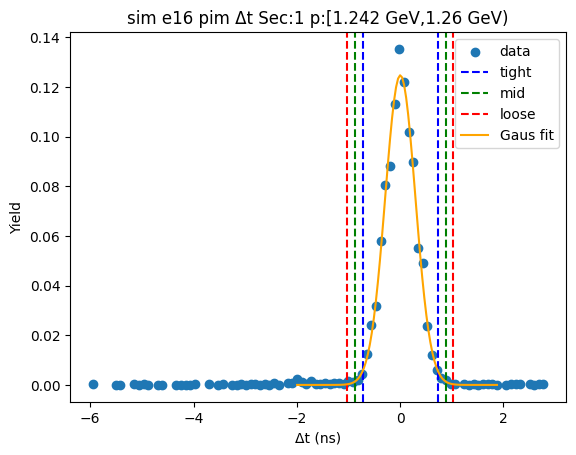

-0.736839484618983 0.7586992813128104
-0.8863933612121624 0.9082531579059898
-1.0359472378053416 1.057807034499169


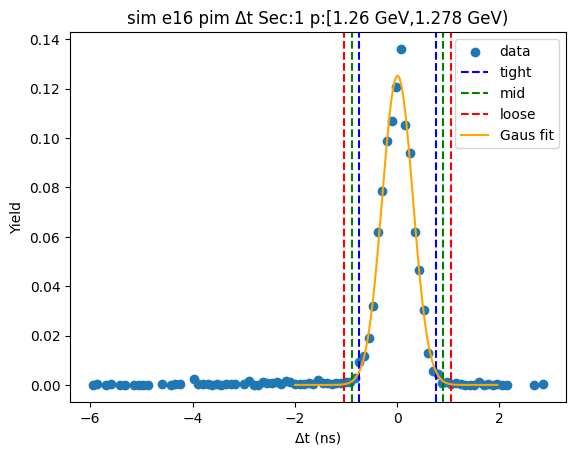

-0.7254821916392318 0.756835400288036
-0.8737139508319585 0.9050671594807627
-1.0219457100246854 1.0532989186734896


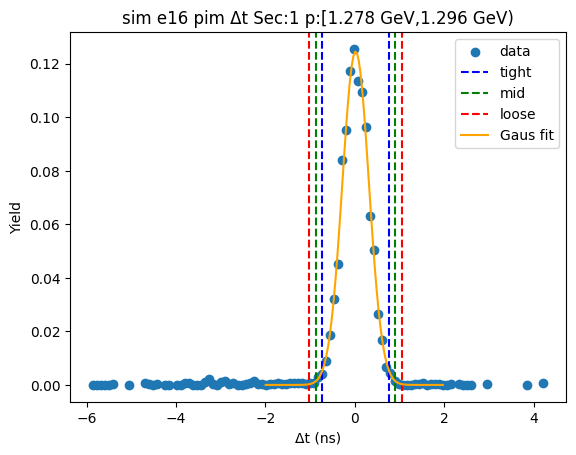

-0.6991462700336956 0.7142842586490411
-0.8404893229019693 0.8556273115173149
-0.981832375770243 0.9969703643855885


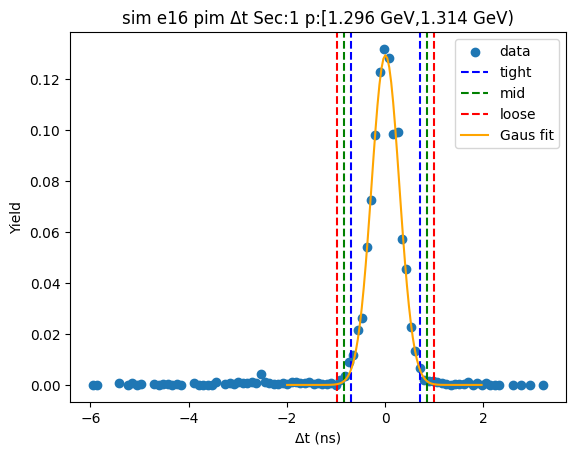

-0.7239383895986665 0.7394236155164925
-0.8702745901101825 0.8857598160280085
-1.0166107906216983 1.0320960165395245


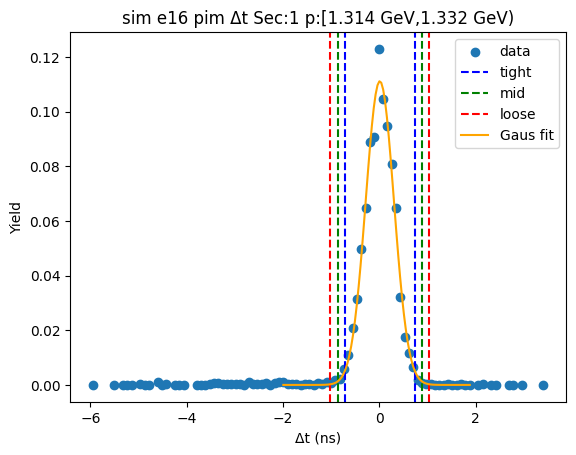

-0.7149753298882804 0.7591157375055975
-0.8623844366276682 0.9065248442449853
-1.009793543367056 1.0539339509843733


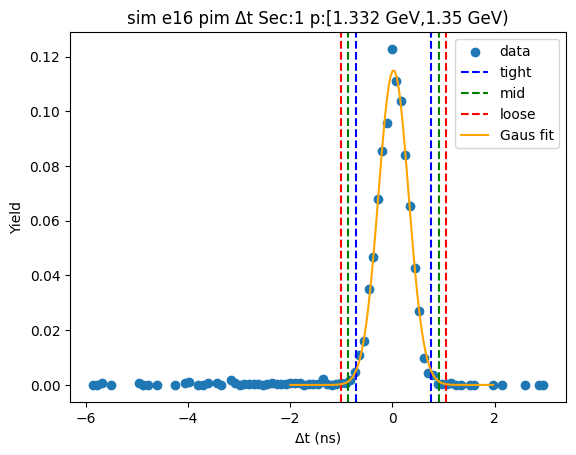

-0.7099773667293178 0.7423975744145724
-0.8552148608437068 0.8876350685289615
-1.0004523549580957 1.0328725626433506


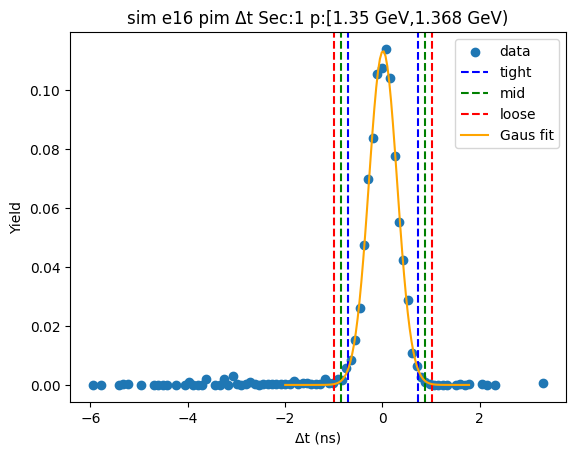

-0.6996688370443399 0.754282473065259
-0.8450639680552997 0.8996776040762188
-0.9904590990662597 1.0450727350871787


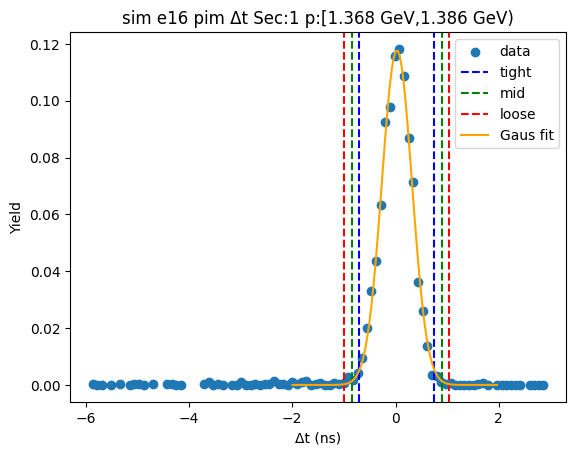

-0.7137505389901634 0.733415531898063
-0.8584671460789861 0.8781321389868857
-1.0031837531678087 1.0228487460757083


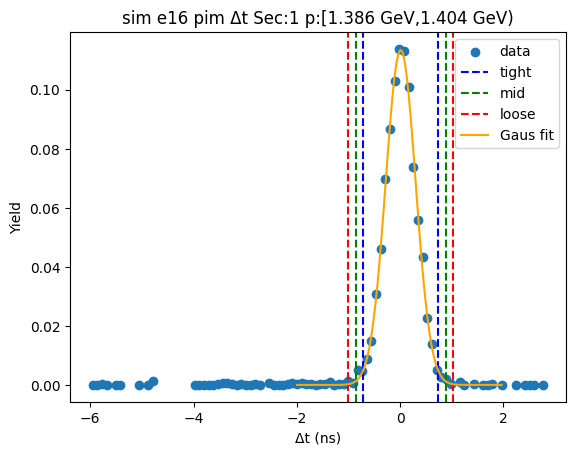

-0.7101677220101708 0.7078710993554769
-0.8519716041467355 0.8496749814920416
-0.9937754862833001 0.9914788636286063


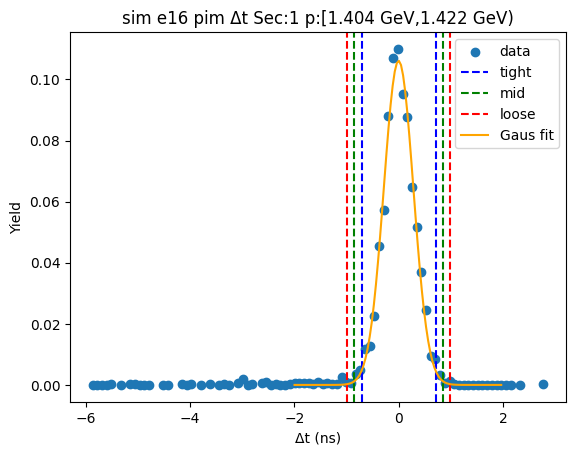

-0.7073291065440936 0.7294280398228867
-0.8510048211807917 0.8731037544595848
-0.9946805358174897 1.0167794690962828


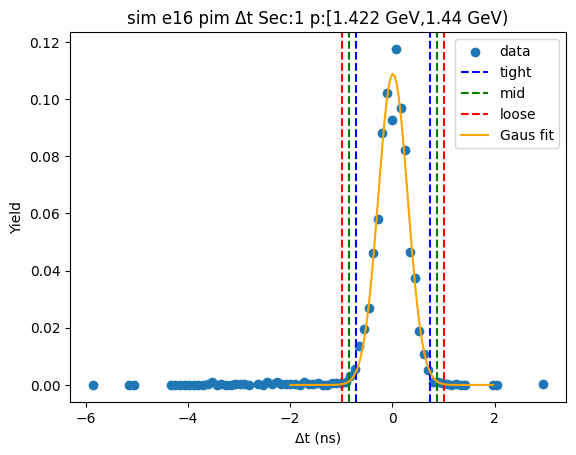

-0.6897656991870995 0.722818508900158
-0.8310241199958253 0.8640769297088837
-0.972282540804551 1.0053353505176095


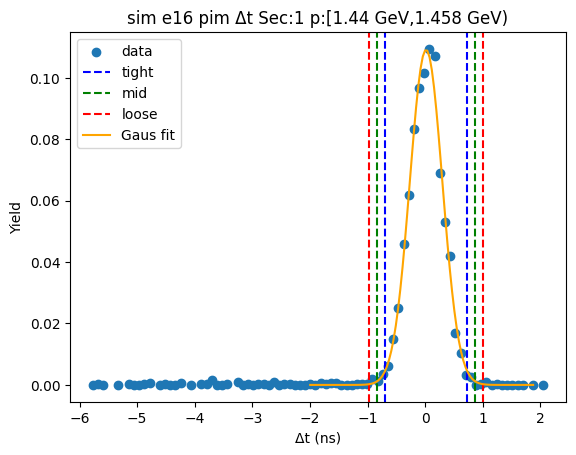

-0.7360043027715119 0.7325045315825912
-0.8828551862069222 0.8793554150180015
-1.0297060696423326 1.0262062984534117


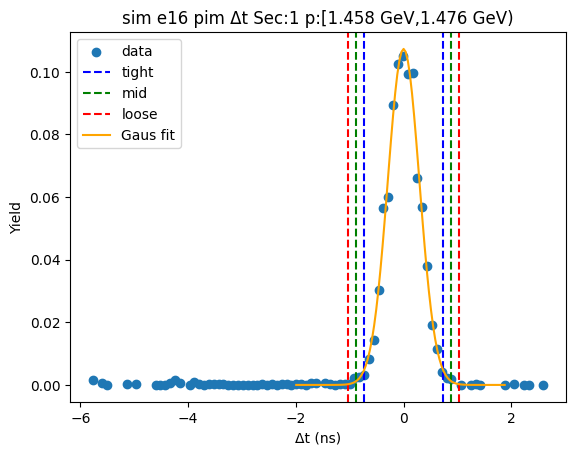

-0.7230704003399853 0.7366242872189555
-0.8690398690958793 0.8825937559748495
-1.0150093378517733 1.0285632247307435


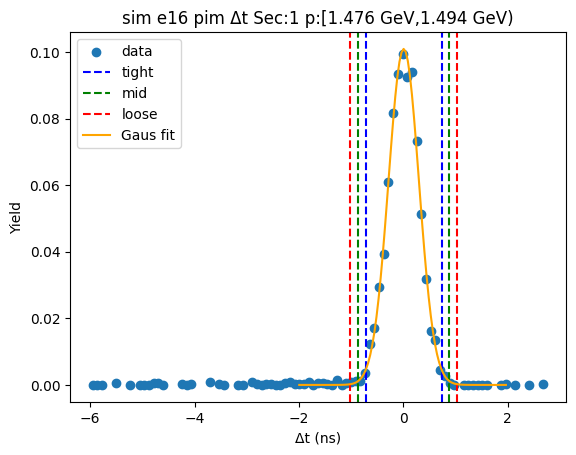

-0.7170571968488948 0.7233364840285617
-0.8610965649366404 0.8673758521163073
-1.005135933024386 1.011415220204053


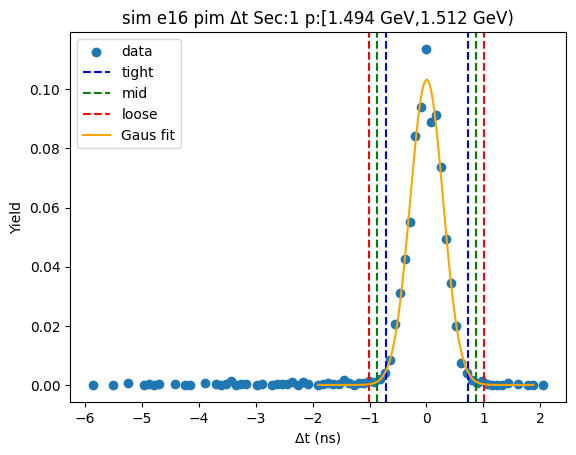

-0.6907014588350823 0.7109743124701428
-0.8308690359656047 0.8511418896006652
-0.9710366130961272 0.9913094667311877


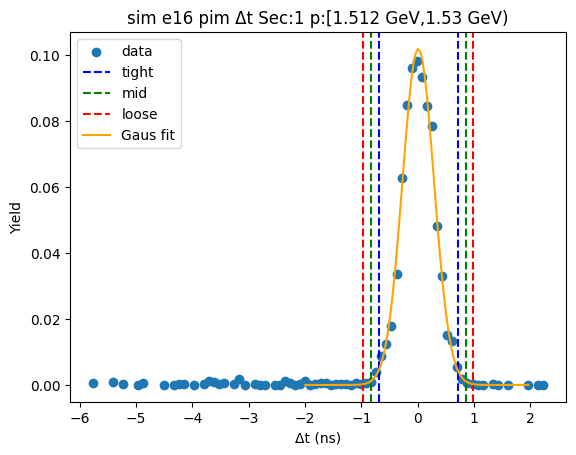

-0.7169401515222888 0.7074004223065209
-0.8593742089051699 0.849834479689402
-1.0018082662880508 0.9922685370722829


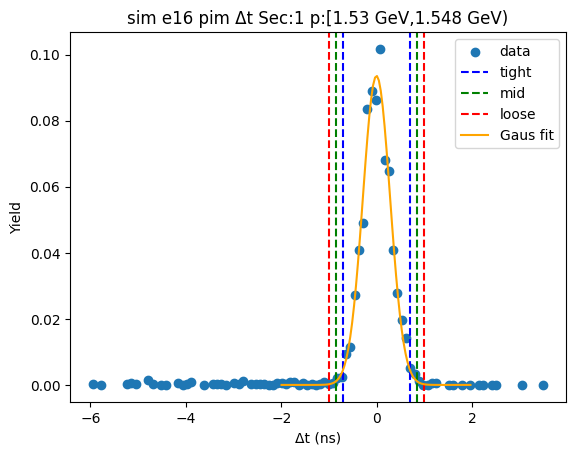

-0.7095987056493784 0.7559620223994628
-0.8561547784542625 0.9025180952043468
-1.0027108512591467 1.049074168009231


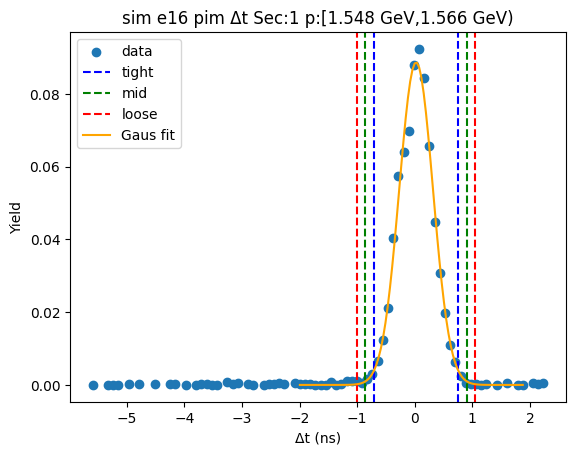

-0.702899890436382 0.7008567332906298
-0.8432755528090833 0.8412323956633311
-0.9836512151817844 0.9816080580360322


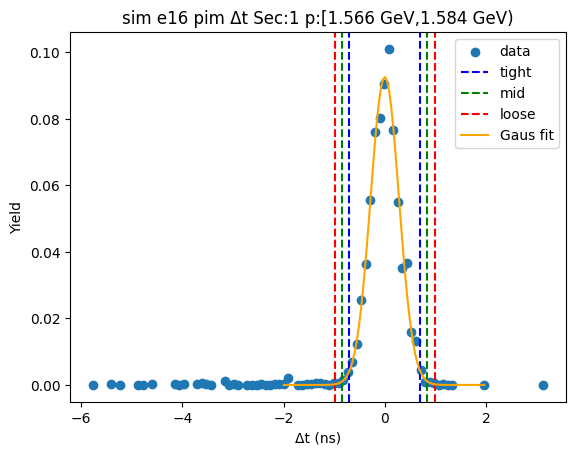

-0.7185367631097005 0.76232043656941
-0.8666224830776115 0.9104061565373209
-1.0147082030455226 1.0584918765052318


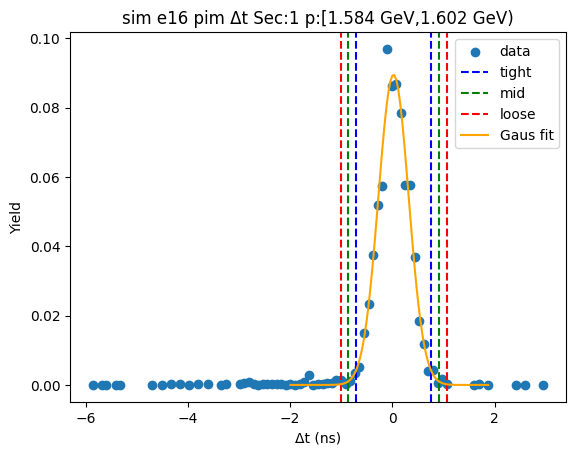

-0.7036722136280218 0.7513562431620497
-0.8491750593070289 0.8968590888410568
-0.9946779049860361 1.042361934520064


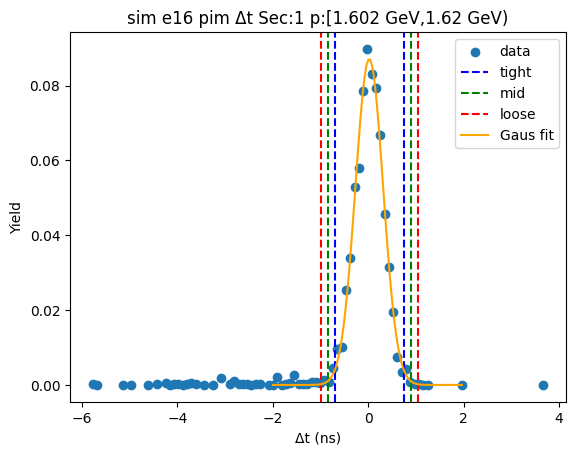

-0.6823068433611843 0.6934933179323102
-0.8198868594905337 0.8310733340616596
-0.9574668756198832 0.9686533501910091


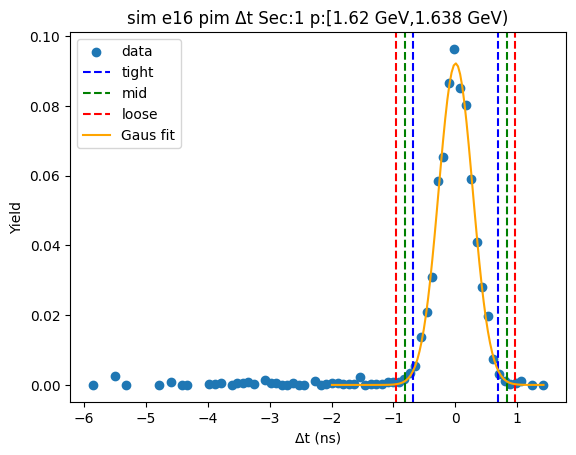

-0.7489765385619062 0.7417213206236947
-0.8980463244804662 0.8907911065422547
-1.0471161103990263 1.0398608924608146


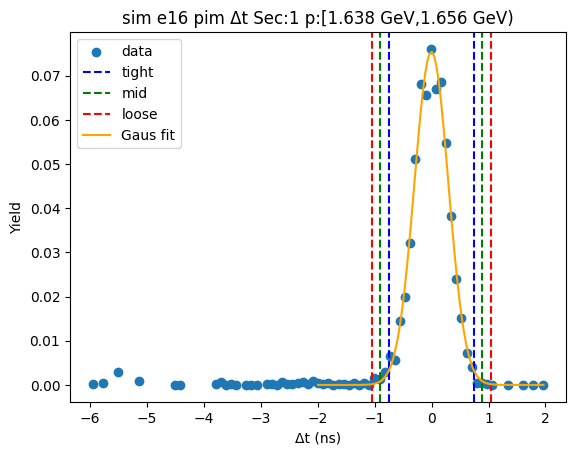

-0.6921256611350444 0.685557821936714
-0.8298940094422201 0.8233261702438898
-0.9676623577493959 0.9610945185510655


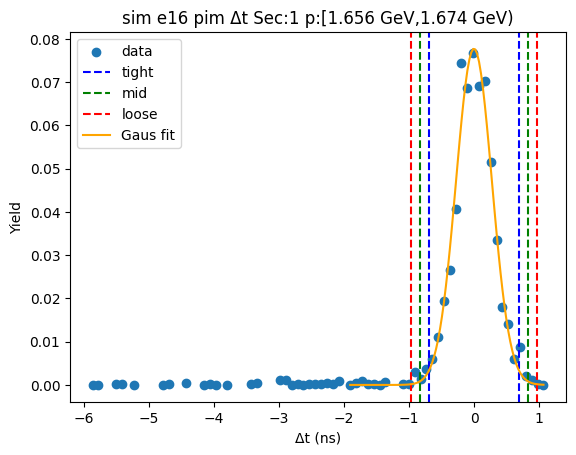

-0.7370694411341985 0.7844374967955496
-0.8892201349271732 0.9365881905885244
-1.041370828720148 1.0887388843814991


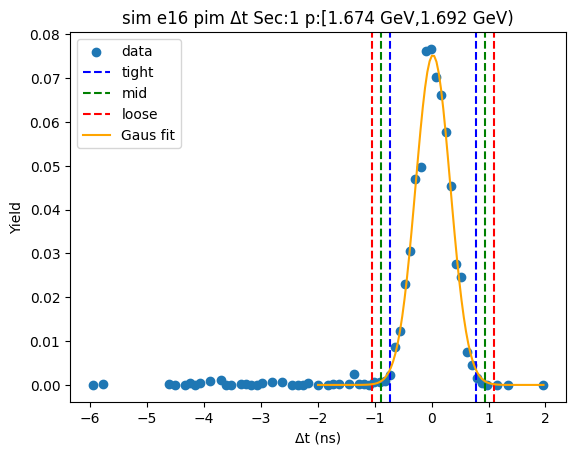

-0.6800409110259583 0.6956664614340261
-0.8176116482719568 0.8332371986800245
-0.9551823855179552 0.970807935926023


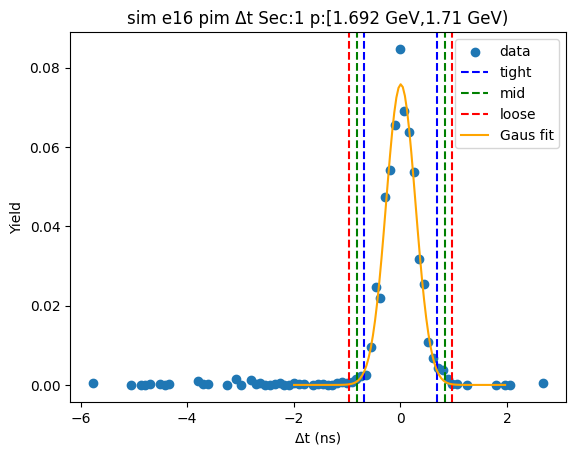

-0.73016406588544 0.7160912744979138
-0.8747895999237755 0.8607168085362492
-1.019415133962111 1.0053423425745847


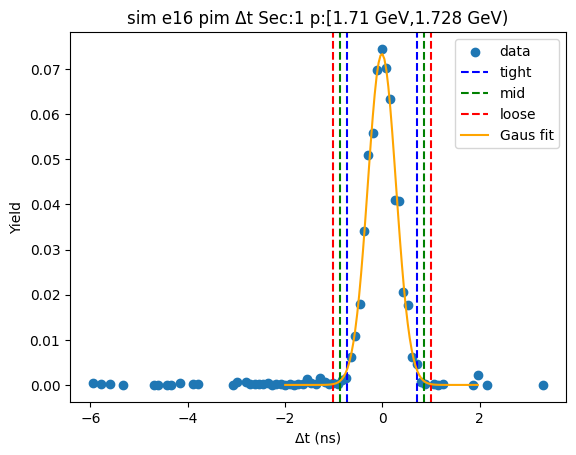

-0.6917384864197064 0.7269131901230509
-0.8336036540739822 0.8687783577773267
-0.9754688217282579 1.0106435254316024


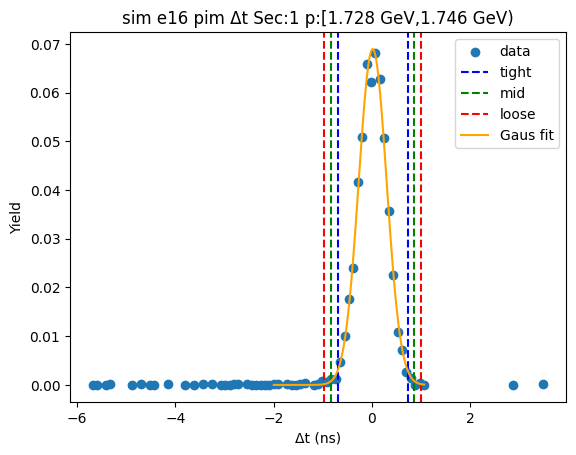

-0.6686696539186429 0.661658133485643
-0.8017024326590714 0.7946909122260715
-0.9347352113994999 0.9277236909665


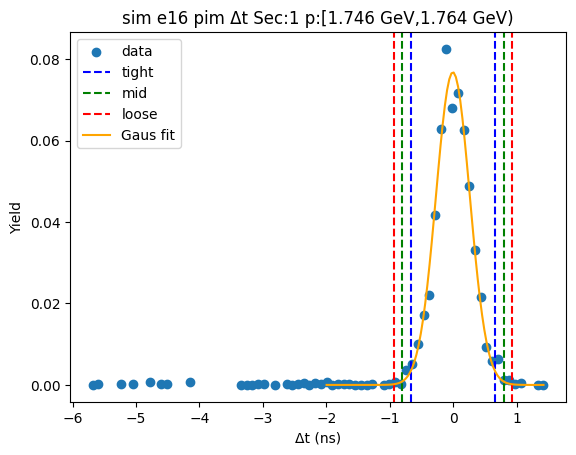

-0.7356555359529949 0.7392168712134161
-0.883142776669636 0.8867041119300572
-1.030630017386277 1.0341913526466981


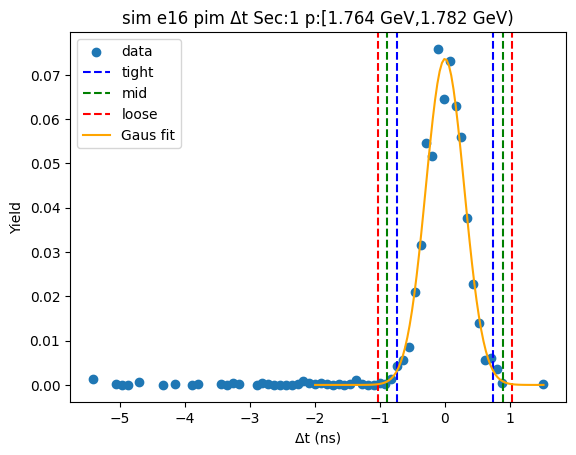

-0.6750439553082226 0.7202425359464166
-0.8145726044336865 0.8597711850718806
-0.9541012535591504 0.9992998341973445


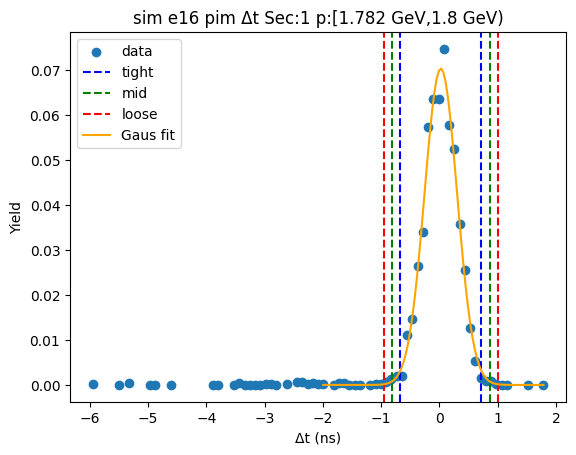

-0.7115749345406359 0.7163708241621474
-0.8543695104109142 0.8591654000324257
-0.9971640862811926 1.001959975902704


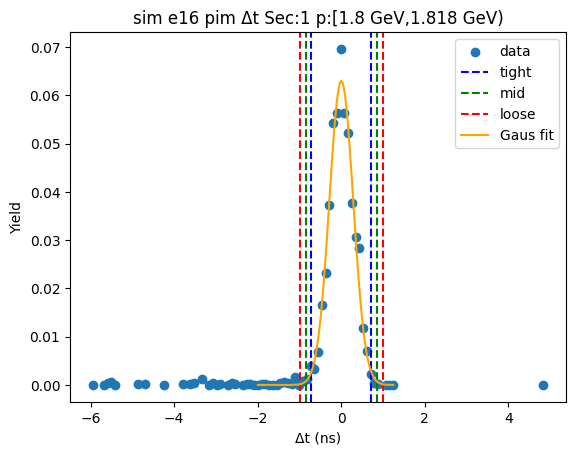

-0.686821900694187 0.700092988331693
-0.8255133895967751 0.8387844772342811
-0.9642048784993631 0.977475966136869


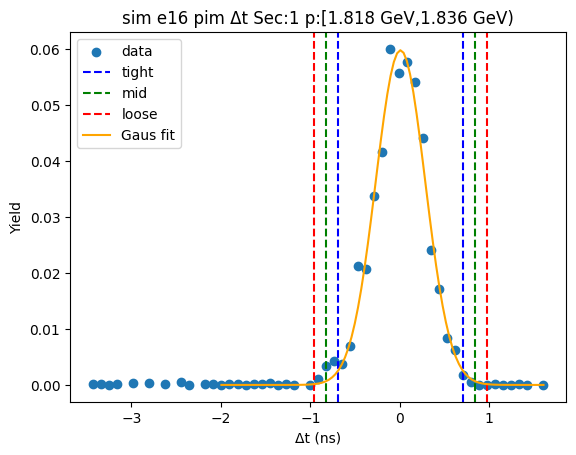

-0.7477899254282568 0.775372728274143
-0.9001061907984967 0.927688993644383
-1.0524224561687368 1.0800052590146232


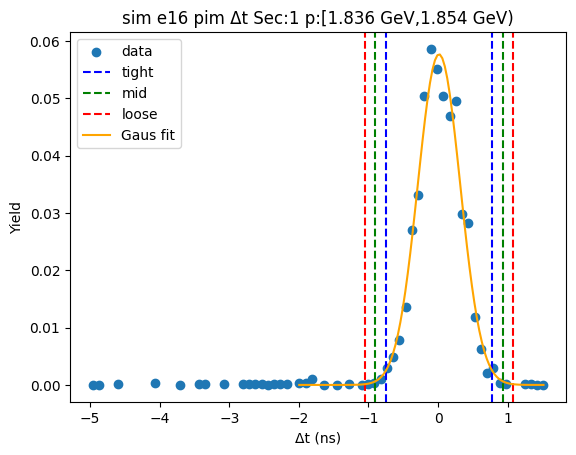

-0.6644653123629393 0.7016582011415805
-0.8010776637133912 0.8382705524920324
-0.9376900150638431 0.9748829038424843


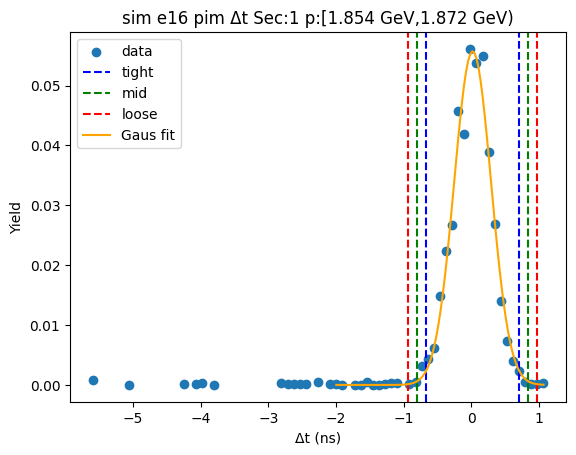

-0.683004178186523 0.7242168161197491
-0.8237262776171503 0.8649389155503764
-0.9644483770477775 1.0056610149810037


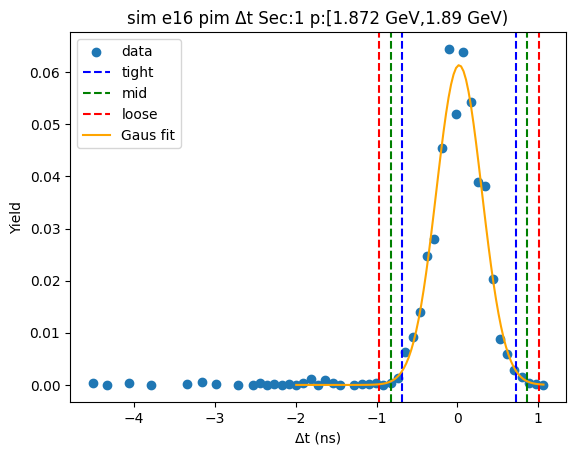

-0.7227728410434265 0.7471025962341914
-0.8697603847711883 0.8940901399619532
-1.0167479284989502 1.041077683689715


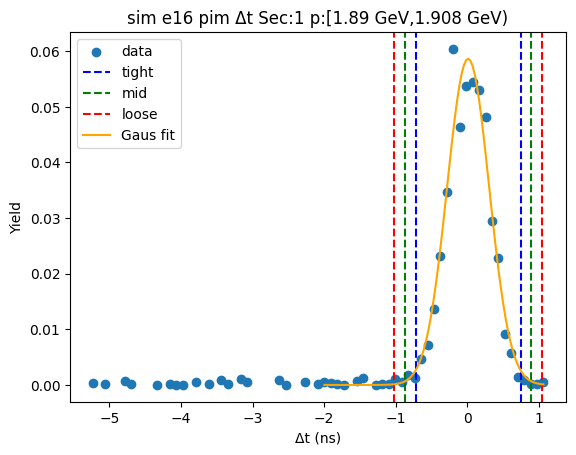

-0.6196962619451357 0.6667005088239469
-0.748335939022044 0.7953401859008552
-0.8769756160989522 0.9239798629777635


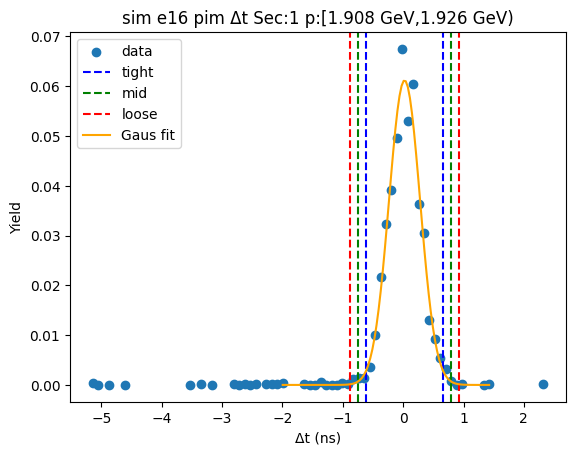

-0.6720776252597275 0.7112180477432913
-0.8104071925600294 0.8495476150435932
-0.9487367598603312 0.9878771823438951


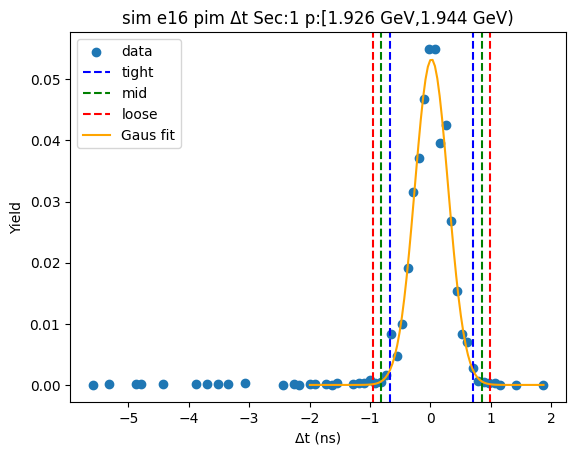

-0.6935640141602953 0.7232103964085664
-0.8352414552171815 0.8648878374654526
-0.9769188962740677 1.0065652785223387


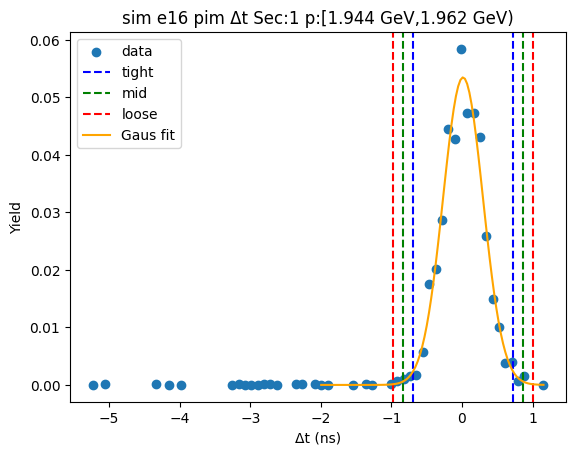

-0.6850442336876649 0.7384540617900573
-0.8273940632354372 0.8808038913378297
-0.9697438927832094 1.0231537208856019


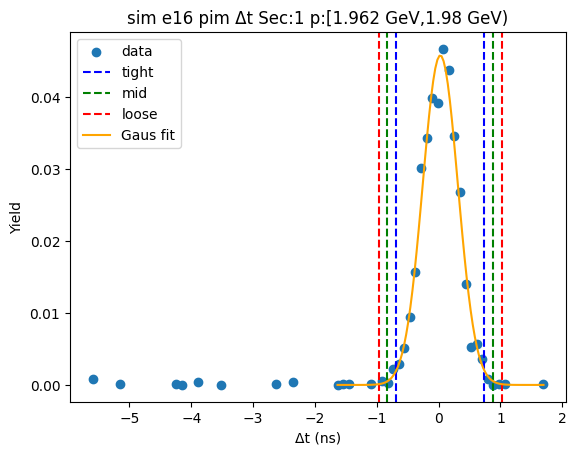

-0.7378867808769748 0.7694329776989942
-0.8886187567345717 0.9201649535565911
-1.0393507325921687 1.070896929414188


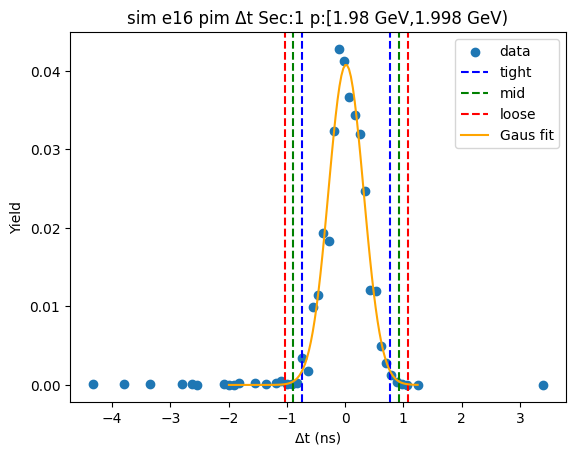

-0.6984799524885801 0.7618873700543933
-0.8445166847428773 0.9079241023086906
-0.9905534169971748 1.053960834562988


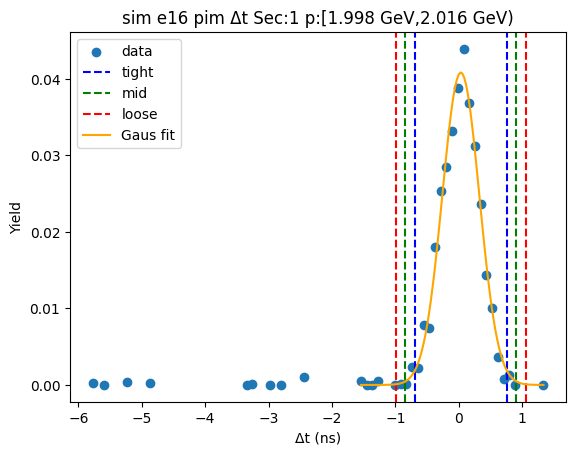

-0.7054966158184915 0.7055928178908836
-0.8466055591894291 0.8467017612618212
-0.9877145025603666 0.9878107046327587


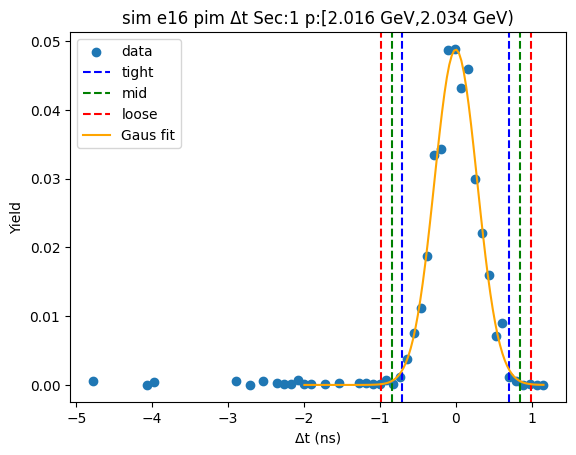

-0.6939681022517209 0.7422665032188899
-0.8375915627987819 0.8858899637659509
-0.9812150233458431 1.029513424313012


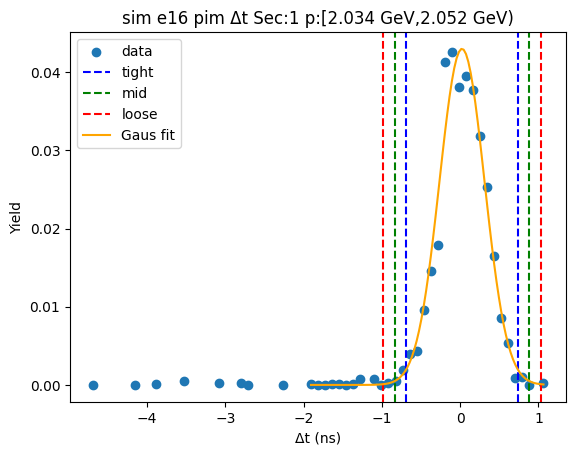

-0.6361317350292934 0.7033941287370513
-0.7700843214059281 0.8373467151136857
-0.9040369077825625 0.9712993014903204


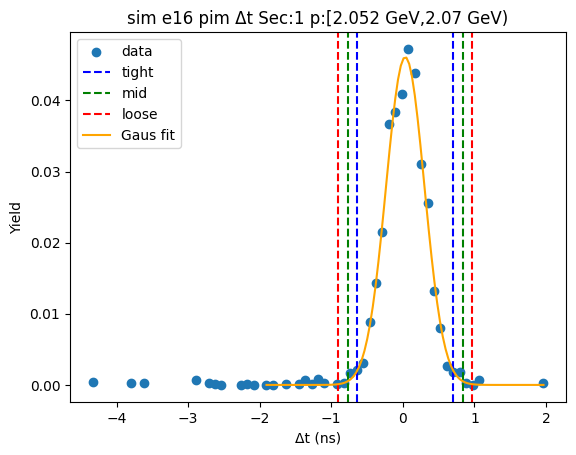

-0.7348986985354438 0.7287697306624692
-0.8812655414552351 0.8751365735822605
-1.0276323843750264 1.0215034165020518


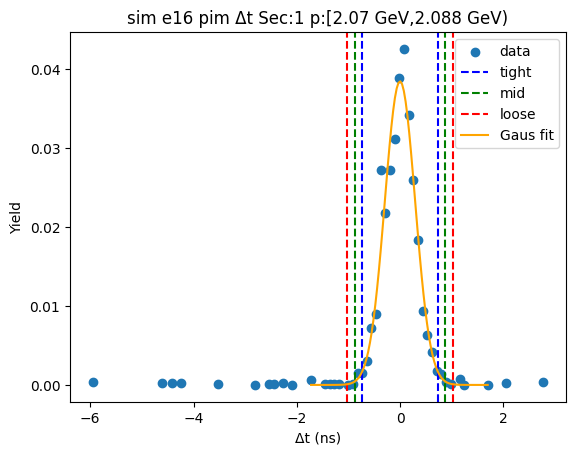

-0.7078954071232942 0.7014882643006718
-0.8488337742656908 0.8424266314430684
-0.9897721414080874 0.983364998585465


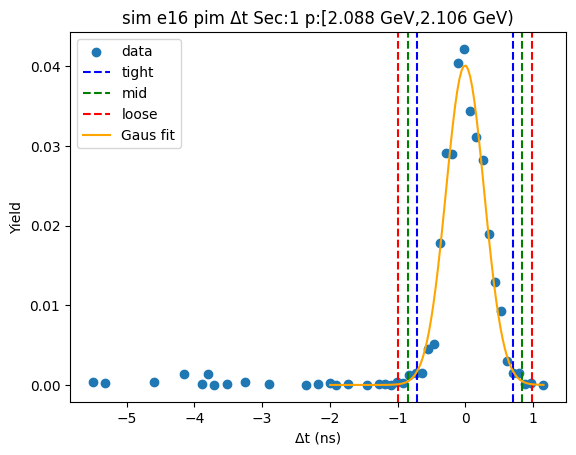

-0.6878764969304522 0.7037688418580371
-0.827041030809301 0.842933375736886
-0.9662055646881499 0.9820979096157348


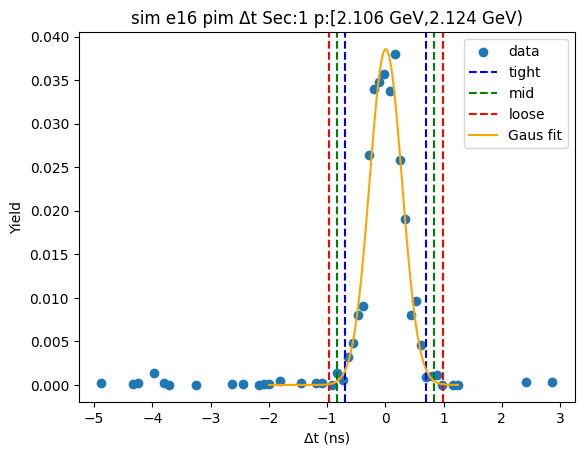

-0.6714397298083908 0.678191795544881
-0.8064028823437179 0.813154948080208
-0.9413660348790451 0.9481181006155353


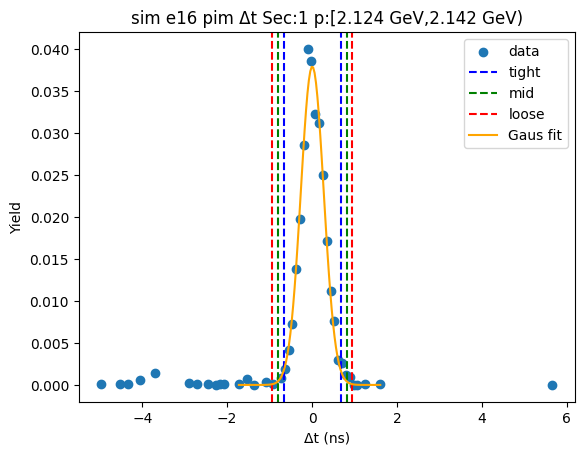

-0.6493475925040618 0.6428855755794279
-0.7785709093124108 0.7721088923877769
-0.9077942261207598 0.9013322091961259


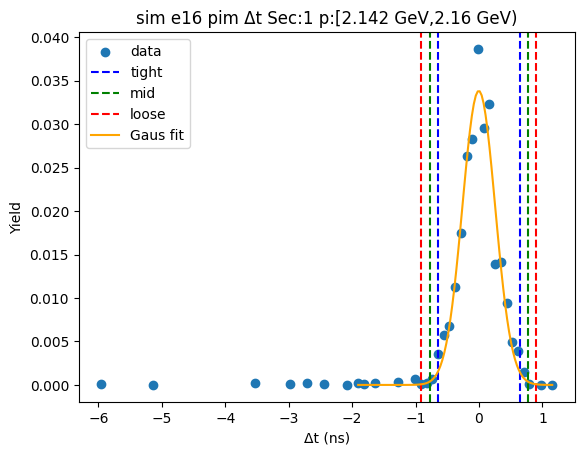

-0.6858619607392248 0.667831653095384
-0.8212313221226856 0.8032010144788447
-0.9566006835061465 0.9385703758623056


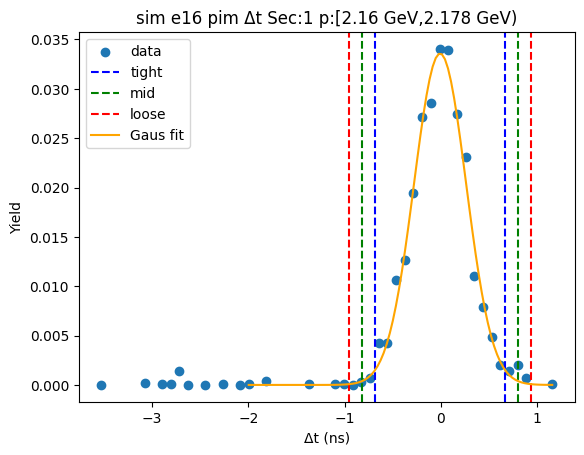

-0.6952035077989619 0.6792209743198335
-0.8326459560108413 0.816663422531713
-0.9700884042227209 0.9541058707435925


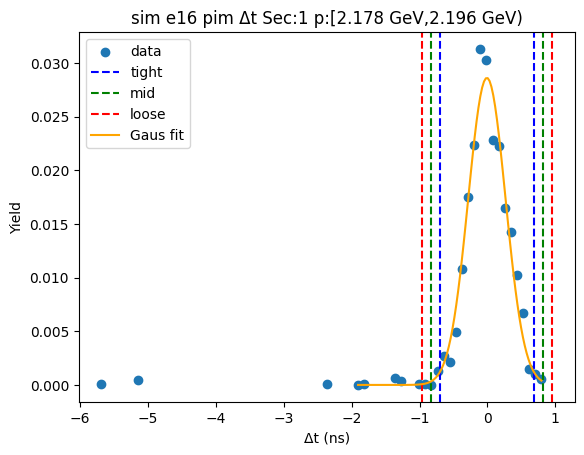

-0.731111898470585 0.7419251451800232
-0.8784156028356459 0.8892288495450841
-1.0257193072007067 1.0365325539101446


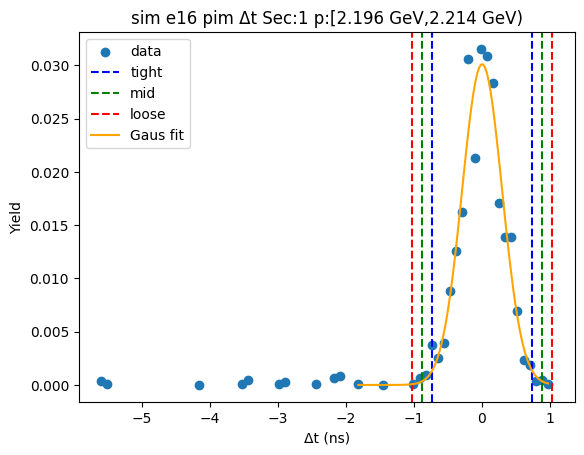

-0.6736659127079888 0.7041230572197089
-0.8114448097007585 0.8419019542124786
-0.9492237066935283 0.9796808512052484


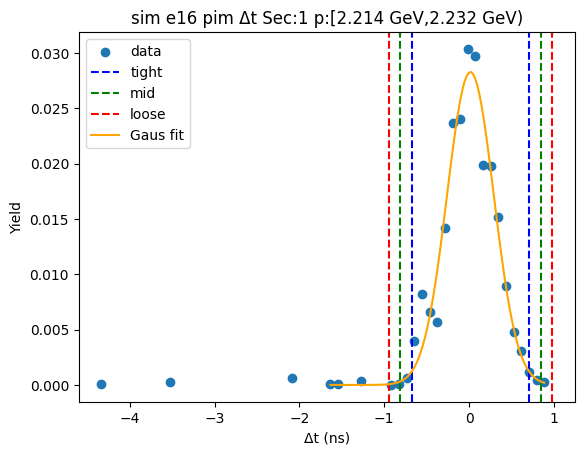

-0.517901004021563 0.5763571269900267
-0.6273268171227221 0.6857829400911858
-0.736752630223881 0.7952087531923447


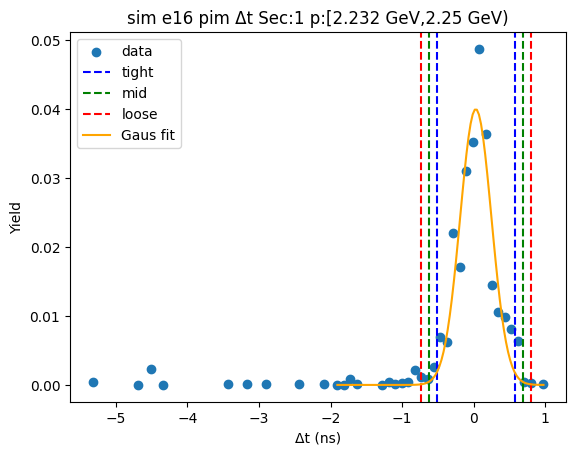

-0.7009280895667283 0.6750465021656564
-0.8385255487399667 0.8126439613388948
-0.976123007913205 0.9502414205121332


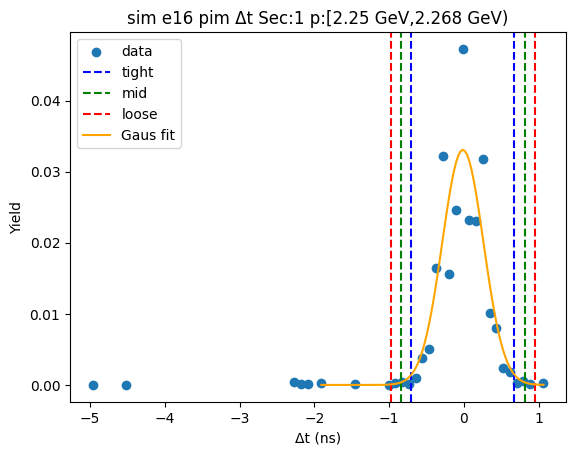

-0.8026595735250858 0.7342690777391098
-0.9563524386515053 0.8879619428655293
-1.1100453037779248 1.041654807991949


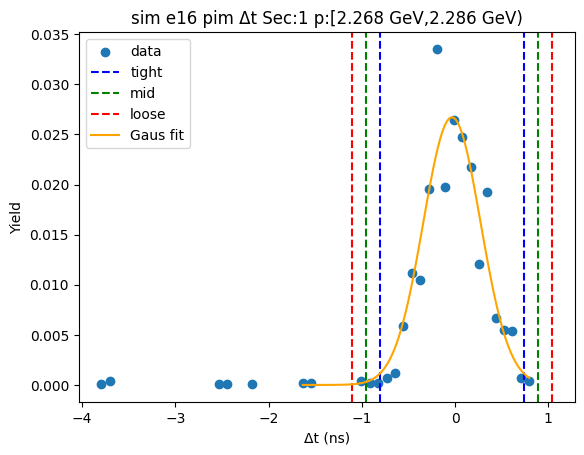

-0.6427434010318156 0.6595678167457928
-0.7729745228095763 0.7897989385235535
-0.9032056445873372 0.9200300603013144


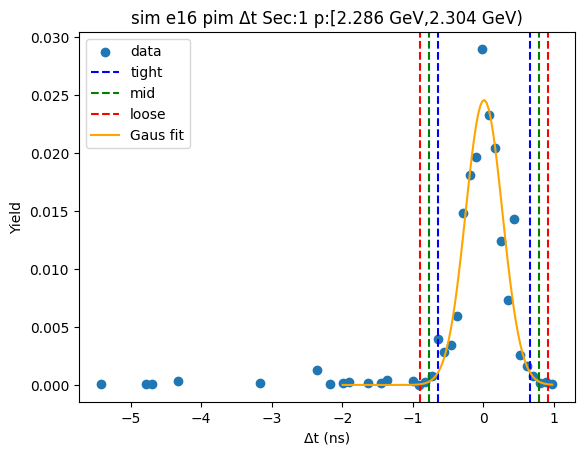

-0.6283867223846274 0.700198769942603
-0.7612452716173506 0.8330573191753261
-0.8941038208500737 0.9659158684080492


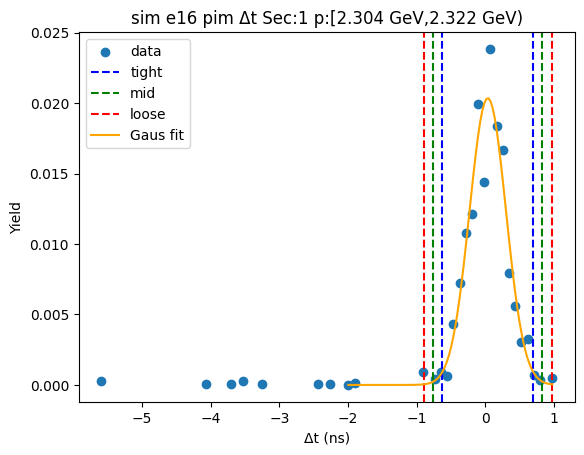

-0.7110771203282639 0.7736238919705486
-0.8595472215581451 0.9220939932004298
-1.0080173227880262 1.0705640944303112


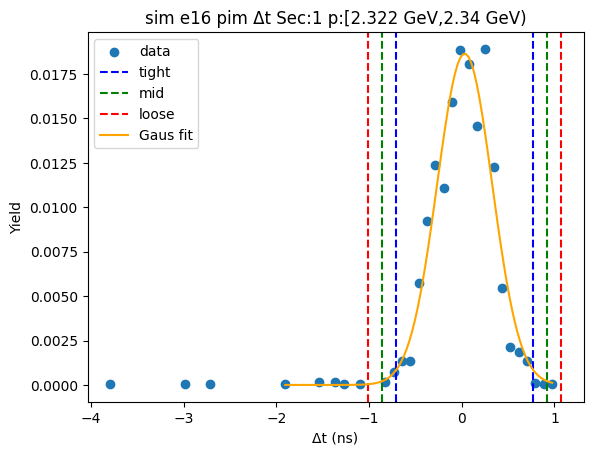

-0.6251861672887983 0.6861972142096483
-0.7563245054386429 0.817335552359493
-0.8874628435884876 0.9484738905093376


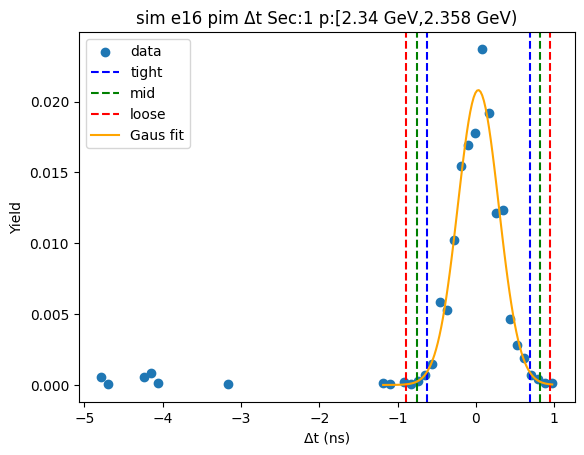

-0.7292327962223595 0.7187356840711556
-0.8740296442517109 0.8635325321005071
-1.0188264922810624 1.0083293801298585


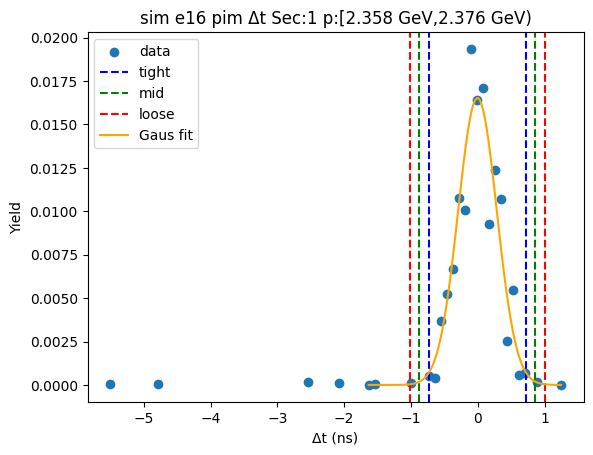

-0.7310051406029141 0.6343797821505746
-0.867543632878263 0.7709182744259234
-1.0040821251536118 0.9074567667012723


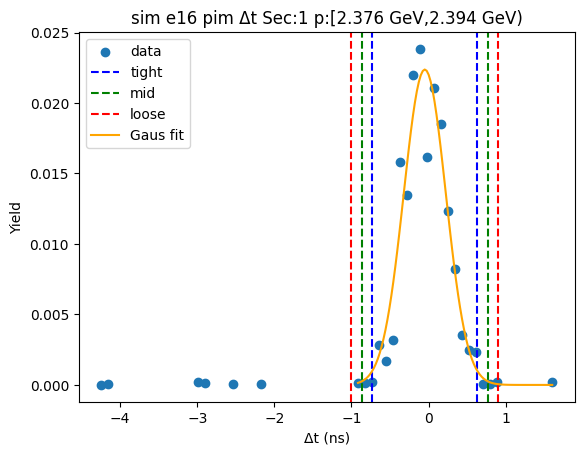

-0.7086797601993471 0.6371827206508209
-0.8432660082843638 0.7717689687358377
-0.9778522563693806 0.9063552168208544


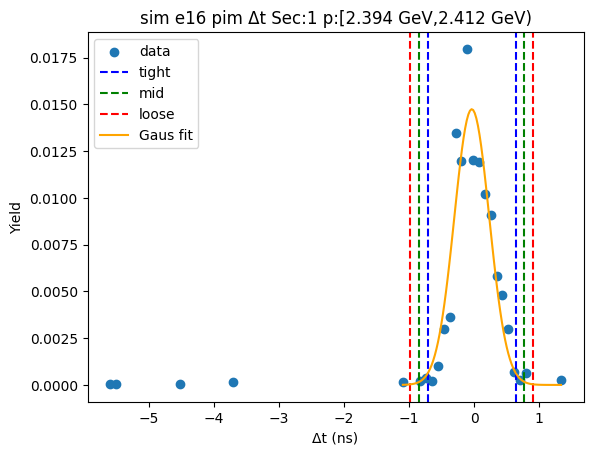

-0.6394102574988407 0.638134794396648
-0.7671647626883895 0.7658892995861968
-0.8949192678779384 0.8936438047757457


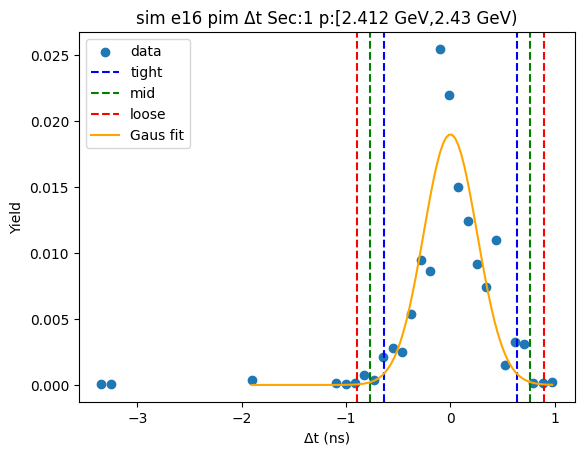

-0.6926910805817145 0.7846580872030945
-0.8404259973601953 0.9323930039815753
-0.9881609141386761 1.080127920760056


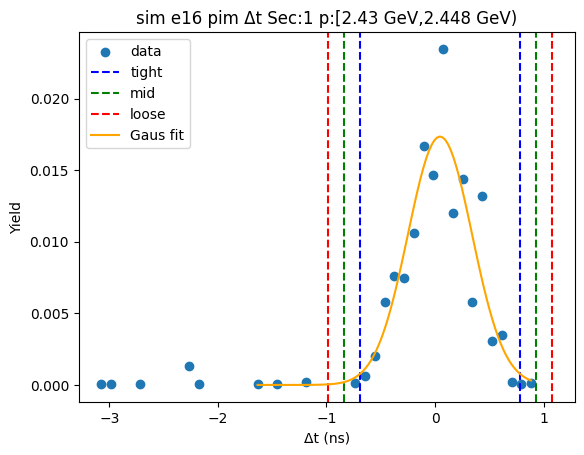

-0.7839114777130356 0.8277658142882061
-0.9450792069131598 0.9889335434883303
-1.106246936113284 1.1501012726884545


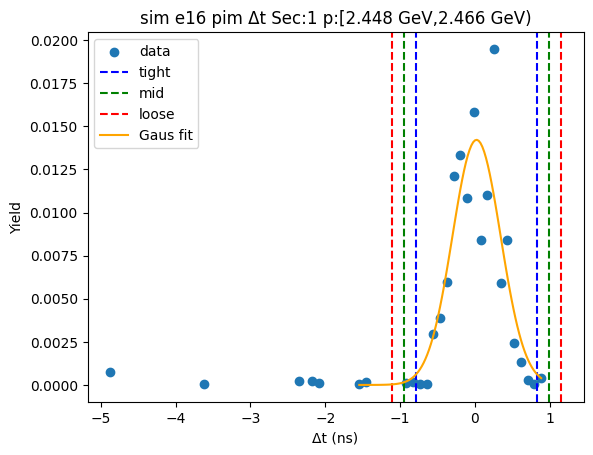

-0.6765437975343402 0.6891977058965737
-0.8131179478774316 0.8257718562396651
-0.949692098220523 0.9623460065827565


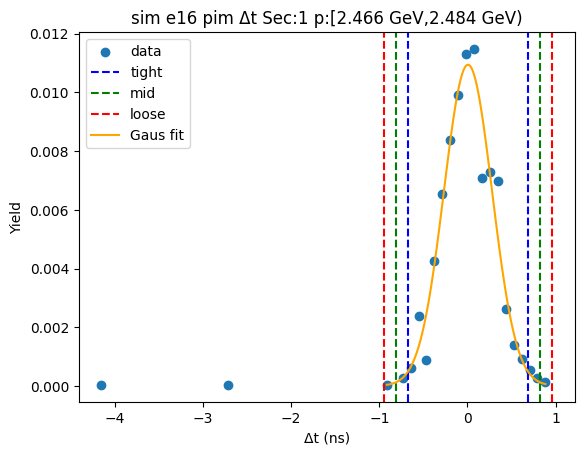

-0.6486521738990112 0.6550001414431563
-0.779017405433228 0.7853653729773731
-0.9093826369674447 0.9157306045115898


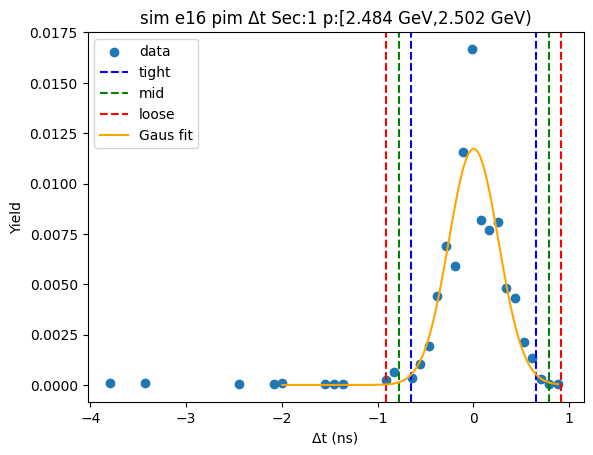

-0.9237231968531207 0.8899557941774144
-1.1050910959561742 1.071323693280468
-1.2864589950592276 1.2526915923835213


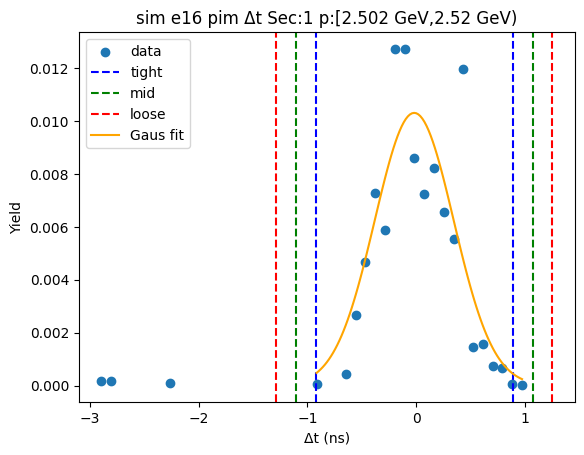

-0.6488628471968518 0.6547467867408054
-0.7792238105906176 0.7851077501345712
-0.9095847739843834 0.915468713528337


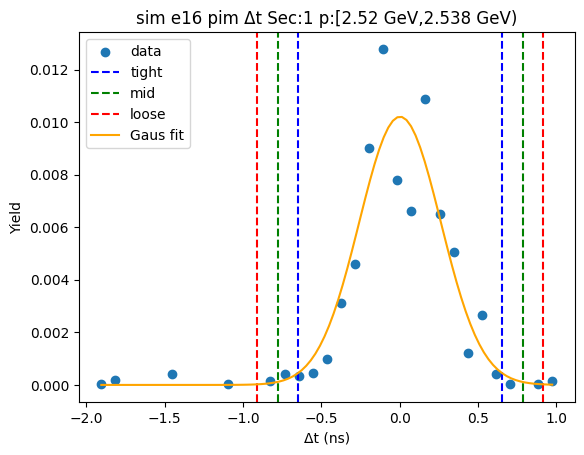

-0.7399908344438957 0.7722536059009018
-0.8912152784783753 0.9234780499353814
-1.0424397225128552 1.0747024939698613


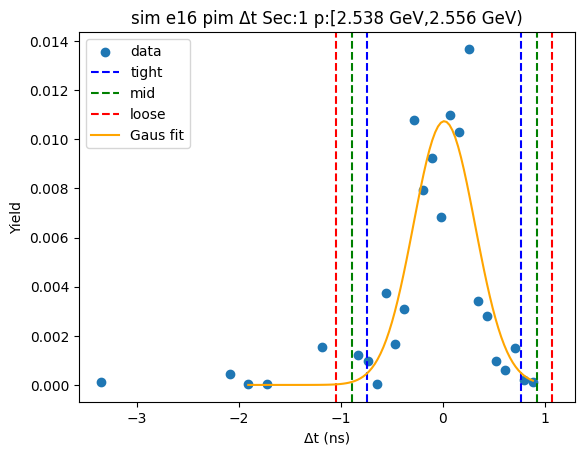

-0.675879061181774 0.6624599197940193
-0.8097129592793534 0.7962938178915987
-0.9435468573769328 0.9301277159891781


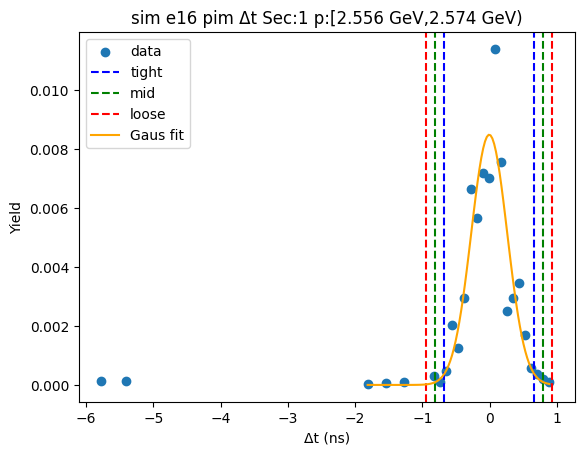

-0.8458035493971889 0.7414782105389841
-1.0045317253908062 0.9002063865326013
-1.1632599013844236 1.0589345625262188


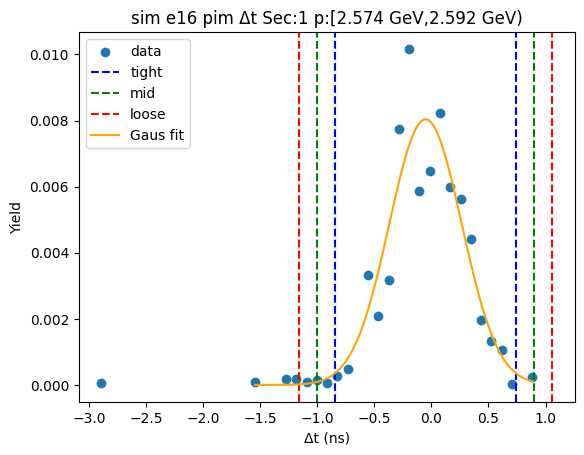

-0.4952724556553847 0.5582516289321939
-0.6006248641141425 0.6636040373909518
-0.7059772725729004 0.7689564458497097


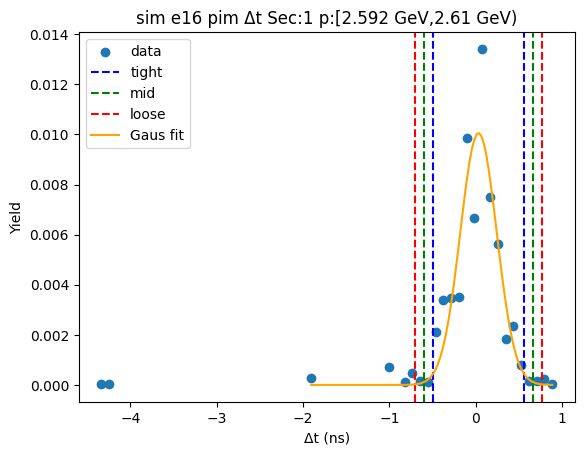

-0.6625438653233624 0.6802898736275713
-0.7968272392184559 0.8145732475226646
-0.9311106131135491 0.9488566214177581


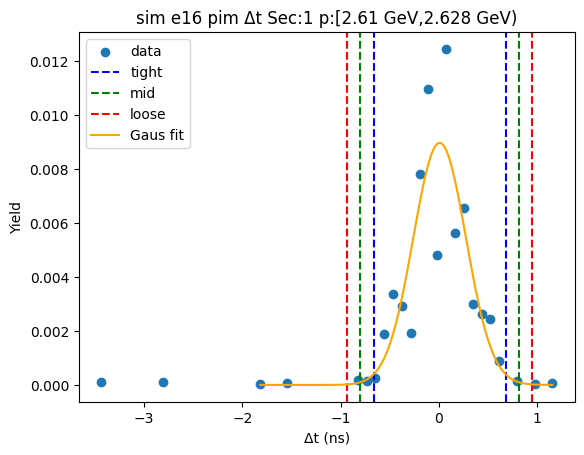

-0.6680159767750842 0.5015290888671566
-0.7849704833393082 0.6184835954313807
-0.9019249899035322 0.7354381019956047


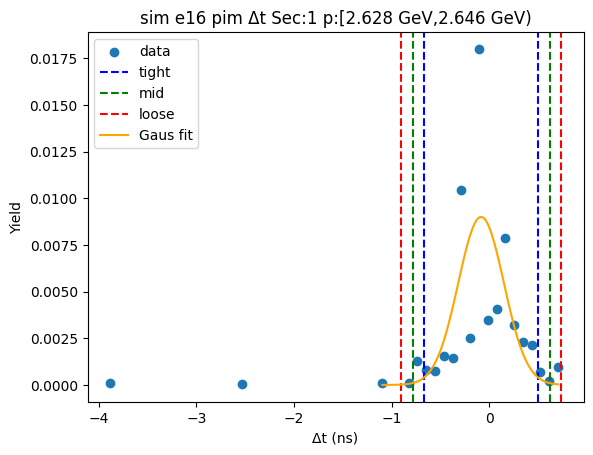

-0.8078085770552846 0.7469198506688236
-0.9632814198276956 0.9023926934412345
-1.1187542626001064 1.0578655362136453


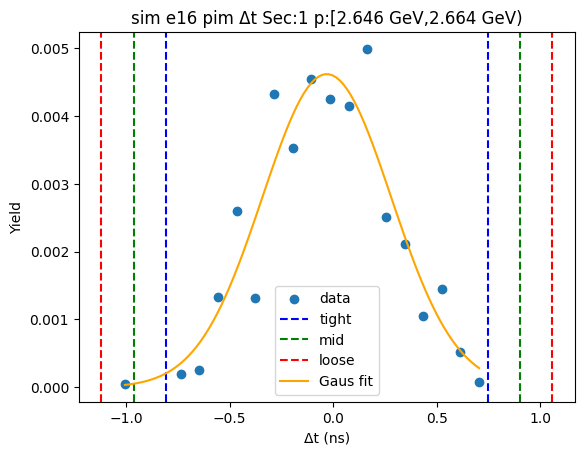

-0.6376478764070389 0.5924816916264369
-0.7606608332103865 0.7154946484297845
-0.883673790013734 0.8385076052331321


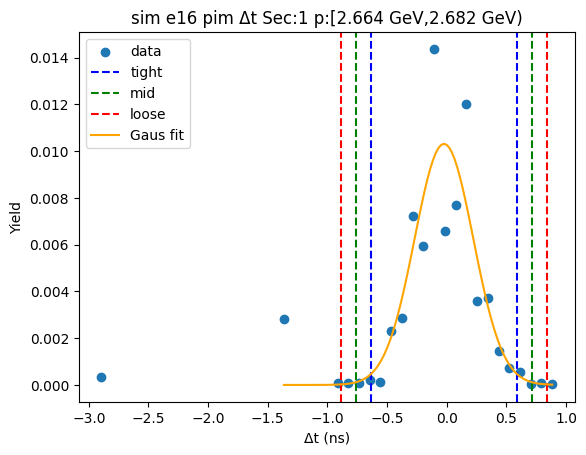

-0.42761668109222584 0.6871113778912875
-0.5390894869905771 0.7985841837896388
-0.6505622928889285 0.9100569896879902


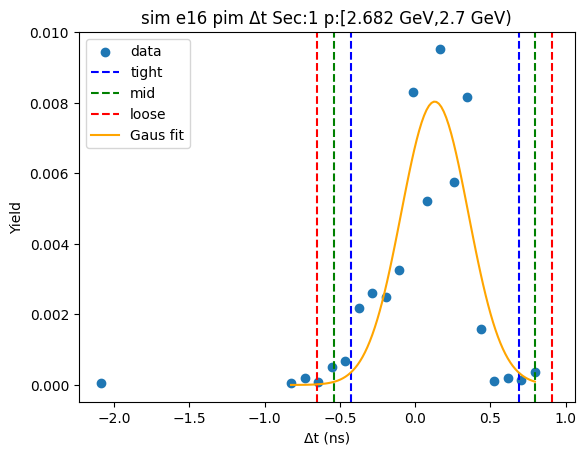

-0.6397525425983608 0.762338415810824
-0.7799616384392793 0.9025475116517425
-0.9201707342801978 1.0427566074926609


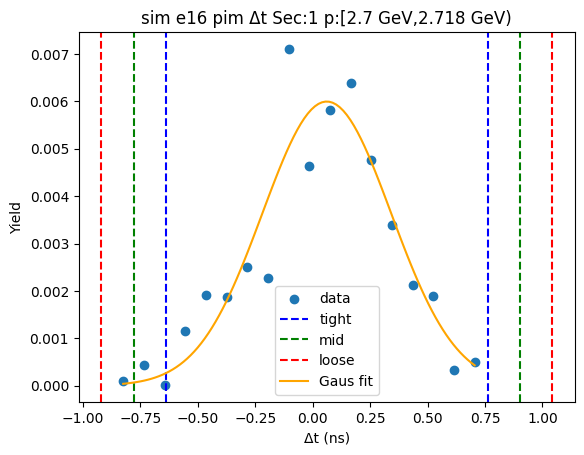

-0.7314116121390587 0.6160580091745341
-0.866158574270418 0.7508049713058934
-1.0009055364017774 0.8855519334372527


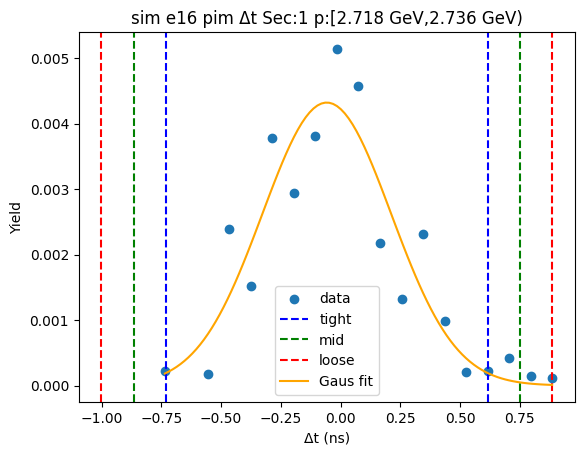

-0.7916543116320717 0.9851192195227308
-0.9693316647475518 1.162796572638211
-1.147009017863032 1.3404739257536913


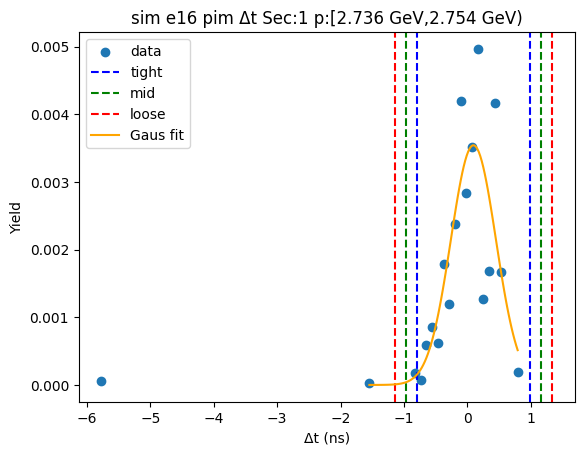

-0.5777396697505607 0.44867733451050784
-0.6803813701766674 0.5513190349366146
-0.7830230706027743 0.6539607353627215


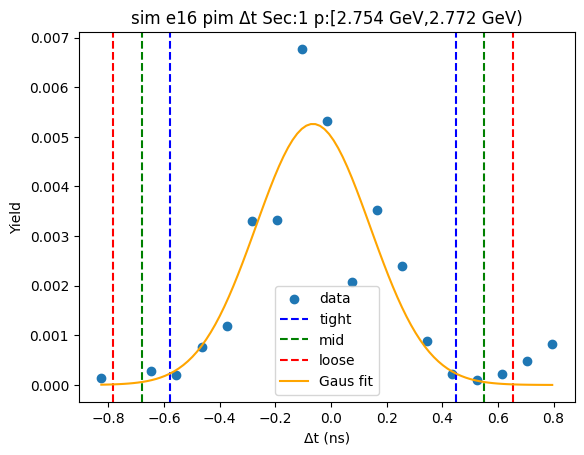

-0.917452243842876 0.9927471183925722
-1.1084721800664208 1.183767054616117
-1.2994921162899657 1.374786990839662


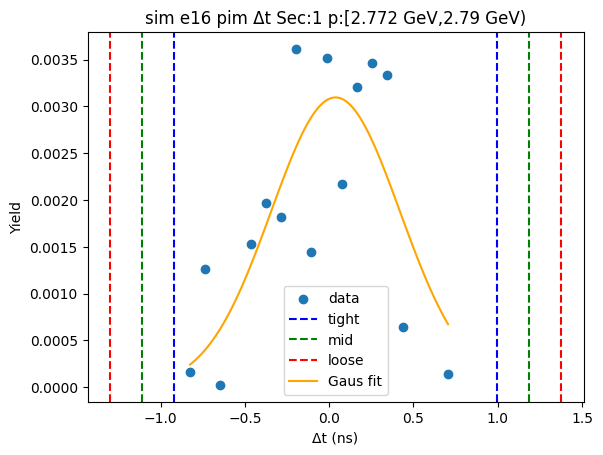

-1.1974093218100075 0.9517587831542745
-1.4123261323064358 1.166675593650703
-1.6272429428028639 1.381592404147131


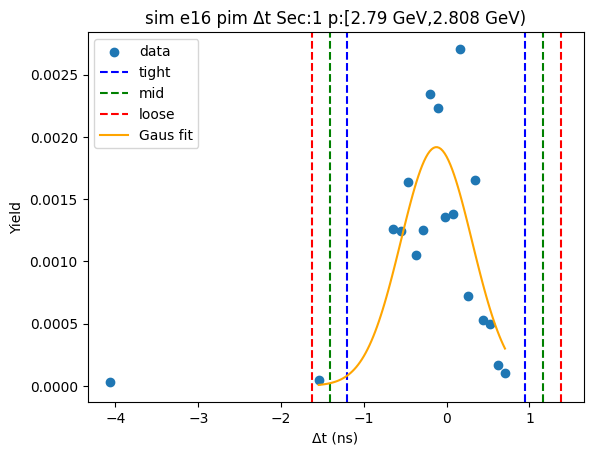

-0.7652082038559543 0.7694583759263881
-0.9186748618341887 0.9229250339046224
-1.072141519812423 1.0763916918828567


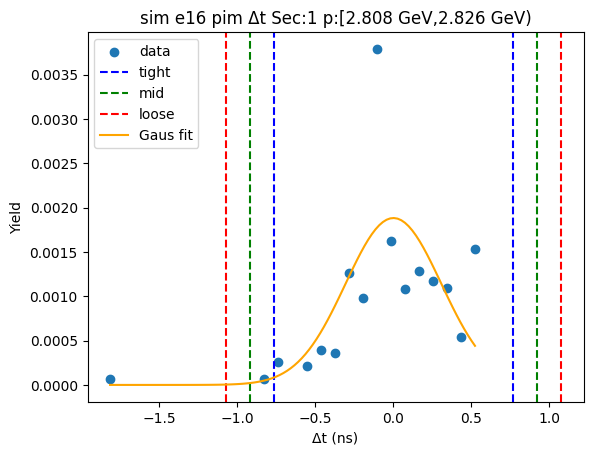

-0.9651703232312492 1.0943082466444072
-1.1711181802188146 1.3002561036319726
-1.3770660372063803 1.5062039606195383


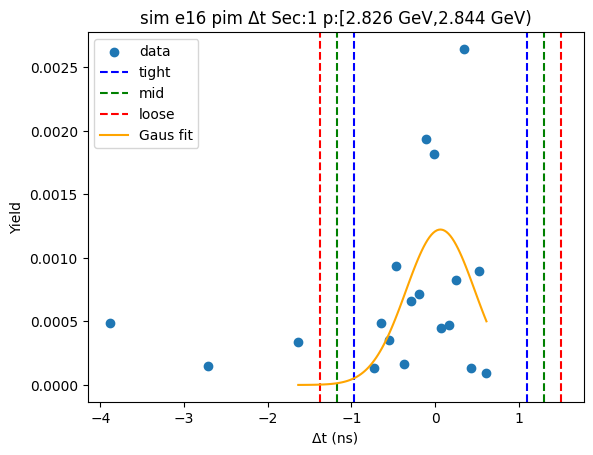

-1.6656726169802112 1.9021148653443802
-2.02245136521267 2.2588936135768396
-2.379230113445129 2.6156723618092985


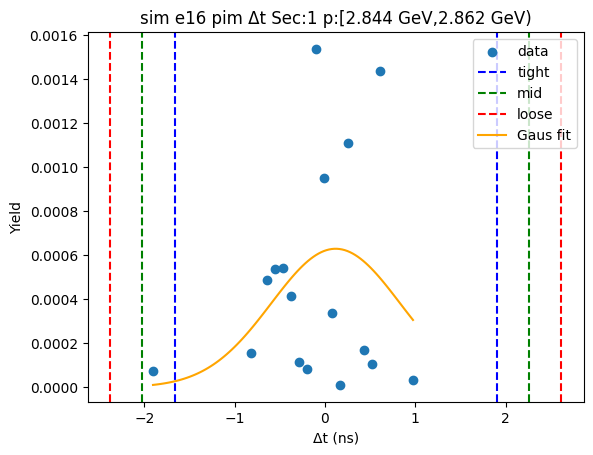

-0.6331936144902057 0.6915458085360995
-0.7656675567928362 0.8240197508387299
-0.8981414990954667 0.9564936931413605


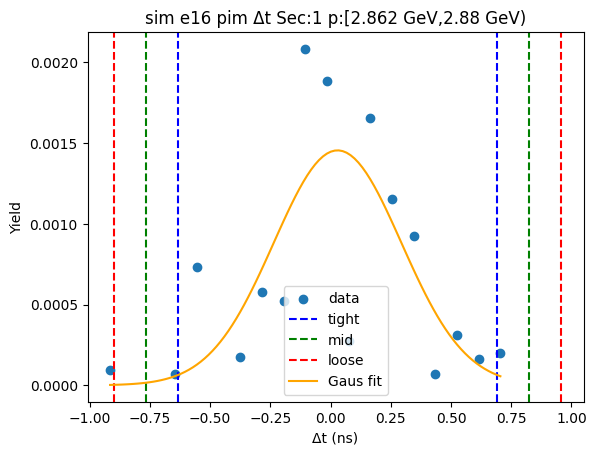

-0.698067130275043 0.9017673625561897
-0.8580505795581663 1.061750811839313
-1.0180340288412895 1.2217342611224362


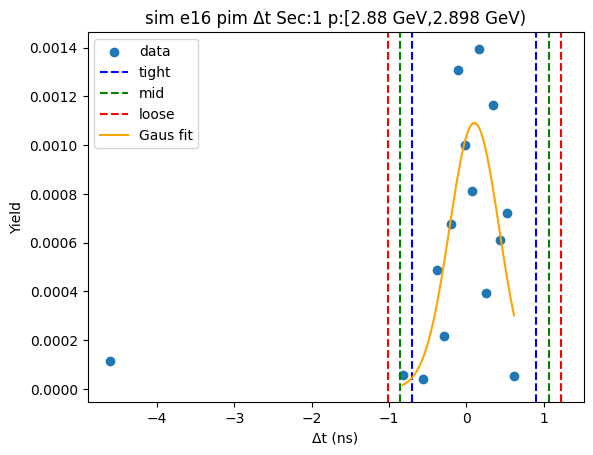

-0.7311278100802776 0.6466716755231929
-0.8689077586406247 0.7844516240835401
-1.0066877072009717 0.9222315726438871


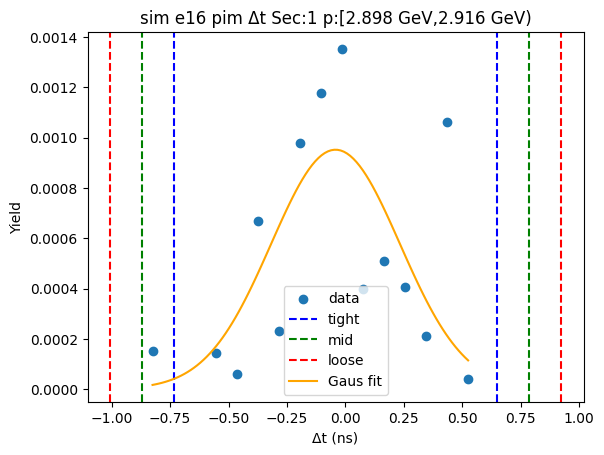

-1.203660064439866 1.1028573649207738
-1.43431180737593 1.3335091078568377
-1.664963550311994 1.5641608507929017


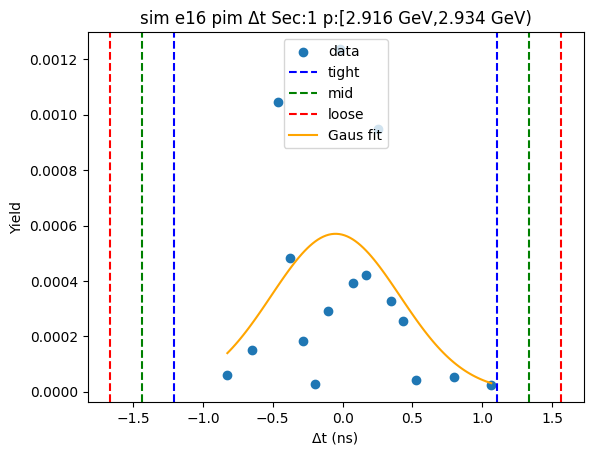

-0.61795421761875 0.37327911082847354
-0.7170775504634723 0.47240244367319595
-0.8162008833081947 0.5715257765179184


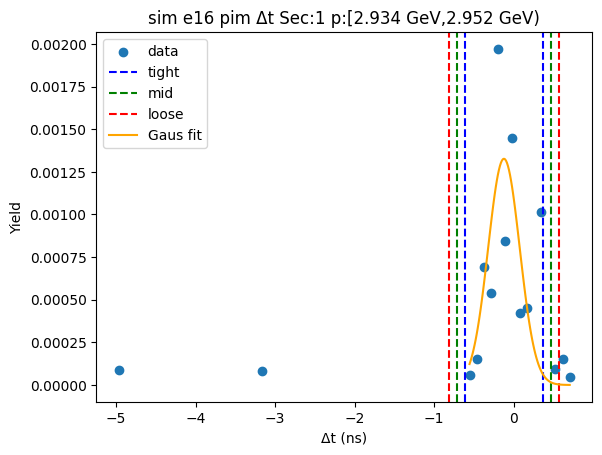

-0.2552924155301077 0.37093244623087523
-0.317914901706206 0.43355493240697357
-0.3805373878823043 0.49617741858307185


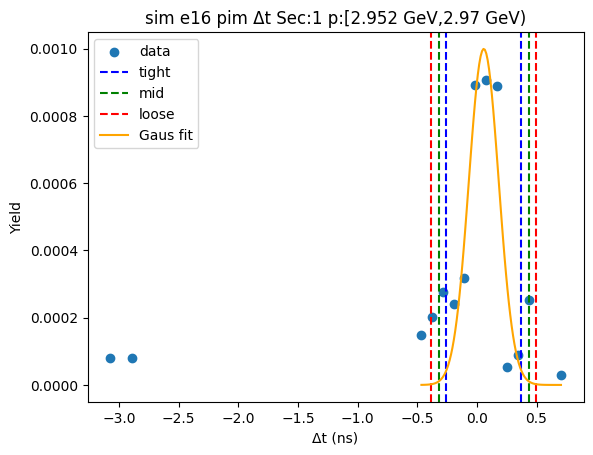

-0.5625367821833294 0.8321469980104959
-0.702005160202712 0.9716153760298785
-0.8414735382220945 1.111083754049261


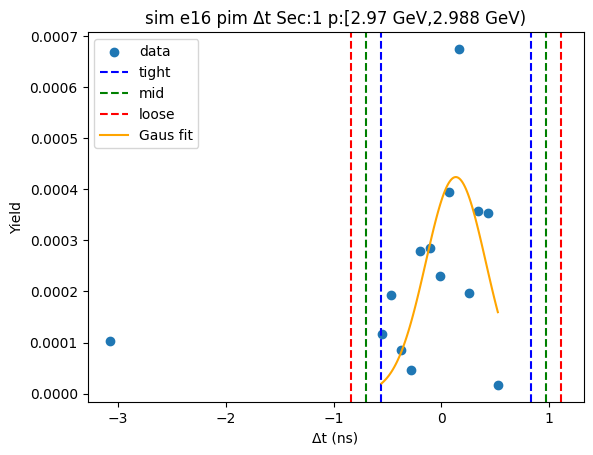

-0.7800428146101837 1.0130709497540356
-0.9593541910466057 1.1923823261904574
-1.1386655674830277 1.3716937026268794


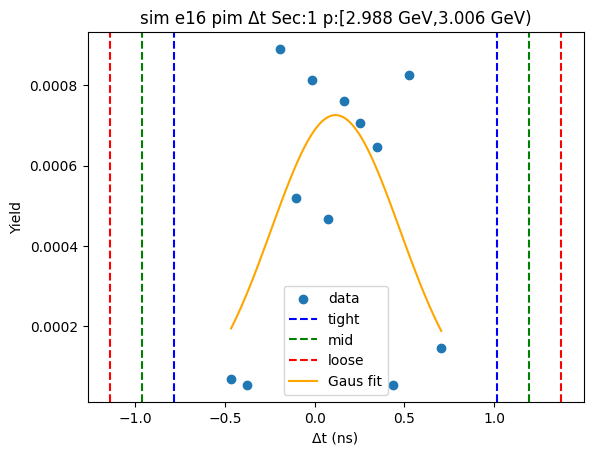

-0.9234671187888766 0.9047475023470317
-1.1062885809024674 1.0875689644606223
-1.2891100430160582 1.2703904265742132


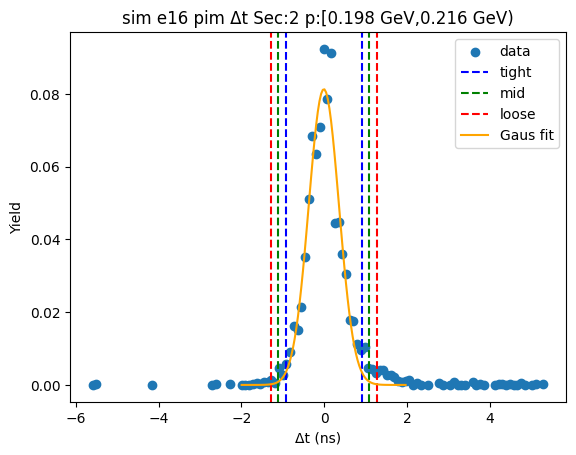

-0.9476226686663644 0.9708299745182917
-1.13946793298483 1.1626752388367572
-1.3313131973032957 1.3545205031552228


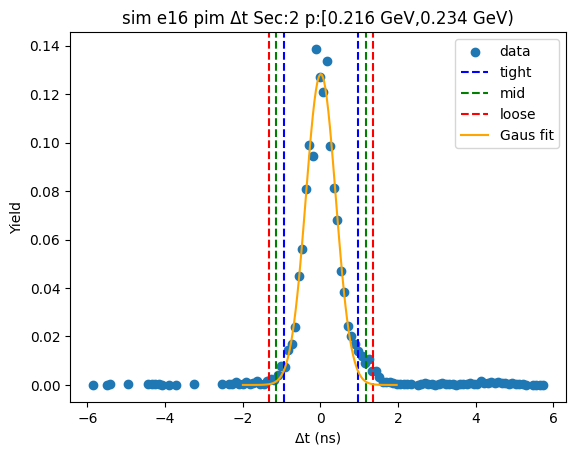

-0.9420318680900157 0.9684726725628474
-1.1330823221553021 1.1595231266281336
-1.3241327762205883 1.3505735806934198


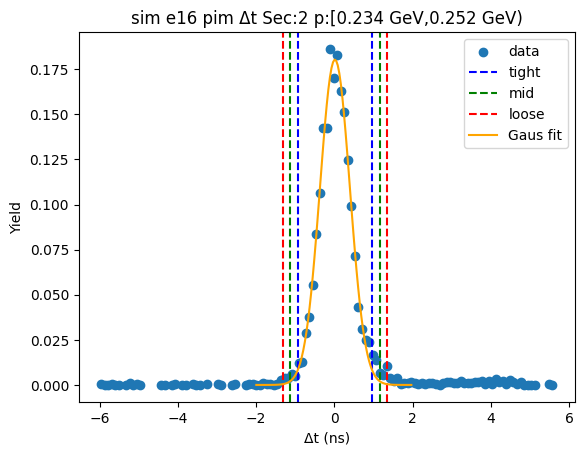

-0.8836539141097207 0.8948395849386154
-1.0615032640145543 1.0726889348434492
-1.2393526139193878 1.2505382847482827


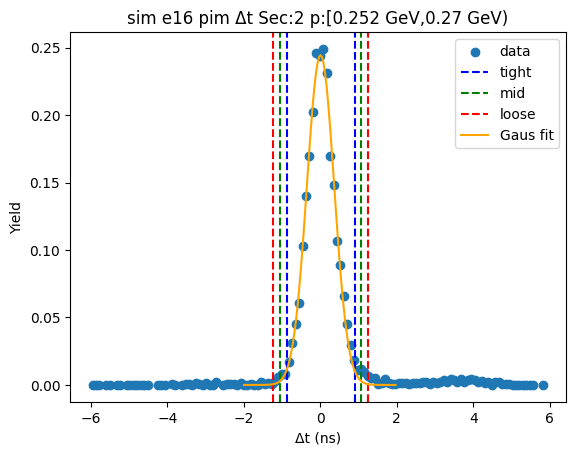

-0.8455459792425772 0.874253917075094
-1.0175259688743445 1.0462339067068613
-1.1895059585061116 1.2182138963386284


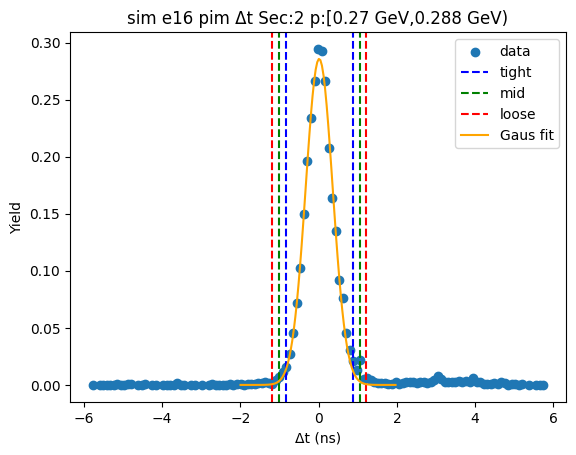

-0.8315605153718946 0.8669113020874653
-1.0014076971178307 1.0367584838334014
-1.1712548788637667 1.2066056655793373


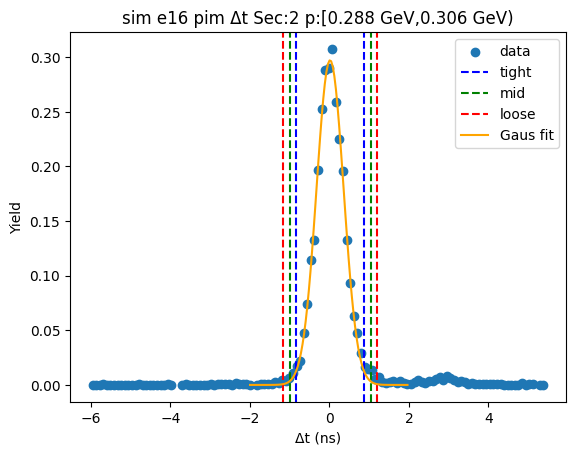

-0.8182594404003244 0.8447242055734393
-0.9845578049977008 1.0110225701708158
-1.1508561695950772 1.177320934768192


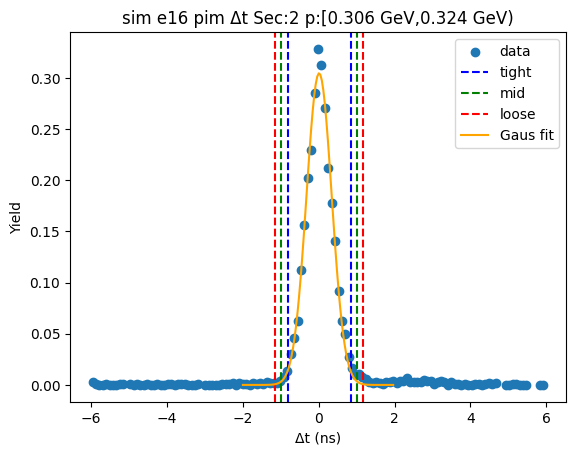

-0.8083001173343325 0.8466433671560014
-0.9737944657833658 1.0121377156050346
-1.1392888142323991 1.177632064054068


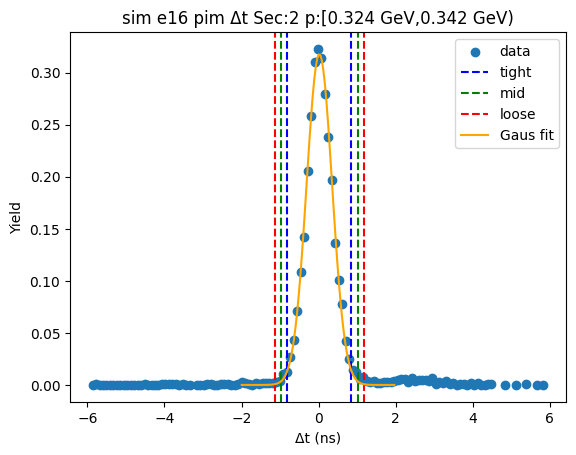

-0.7891882722506567 0.8172808801224594
-0.9498351874879684 0.977927795359771
-1.11048210272528 1.1385747105970827


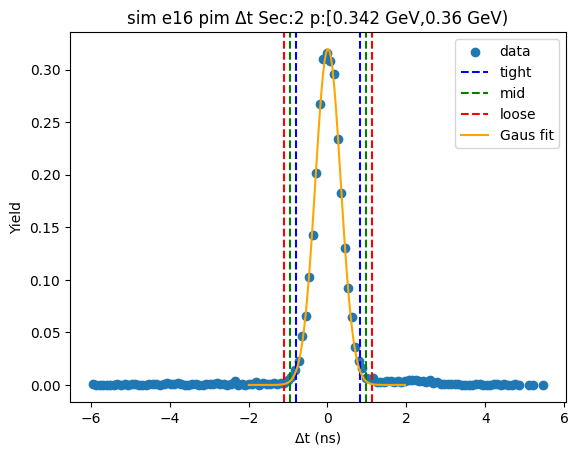

-0.7713918706510308 0.8138519100279769
-0.9299162487189315 0.9723762880958776
-1.088440626786832 1.1309006661637784


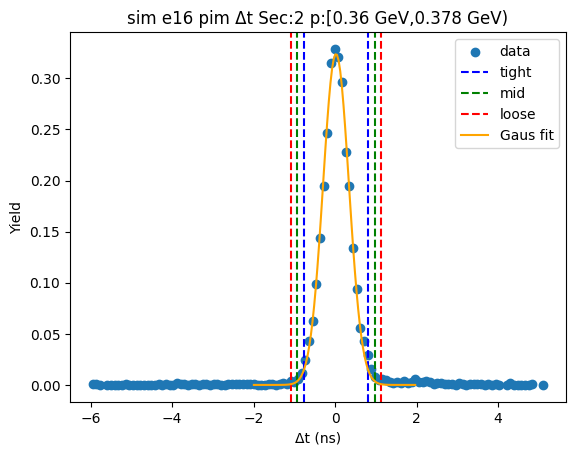

-0.7901852955229144 0.8146174548154111
-0.9506655705567469 0.9750977298492437
-1.1111458455905796 1.1355780048830761


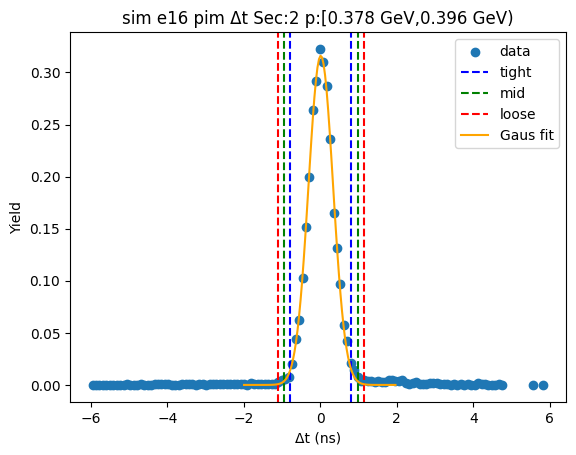

-0.796859135404317 0.8235930185357095
-0.9589043507983197 0.9856382339297123
-1.1209495661923223 1.147683449323715


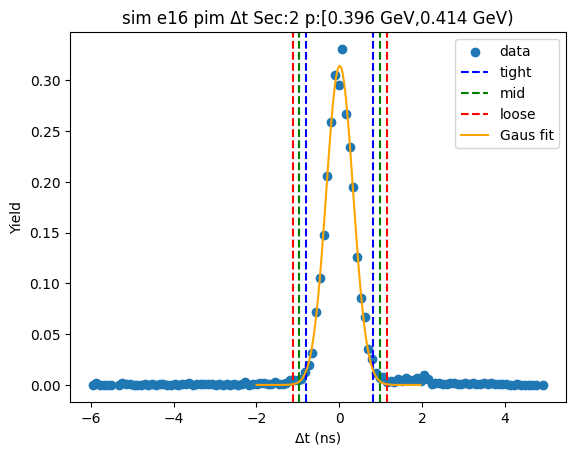

-0.7692697366541151 0.8028663508406629
-0.926483345403593 0.9600799595901408
-1.0836969541530708 1.1172935683396188


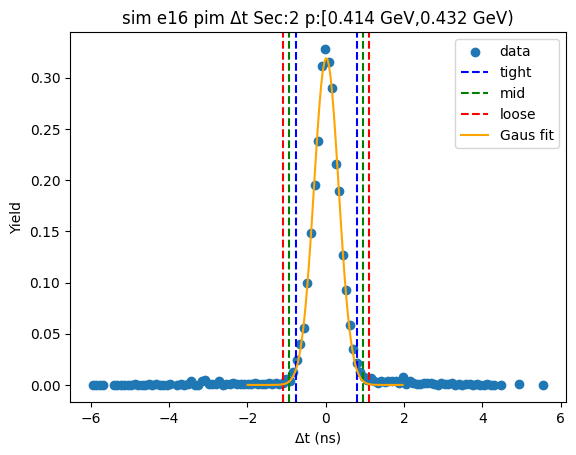

-0.7885424066750565 0.813247185958255
-0.9487213659383876 0.9734261452215861
-1.1089003252017189 1.1336051044849171


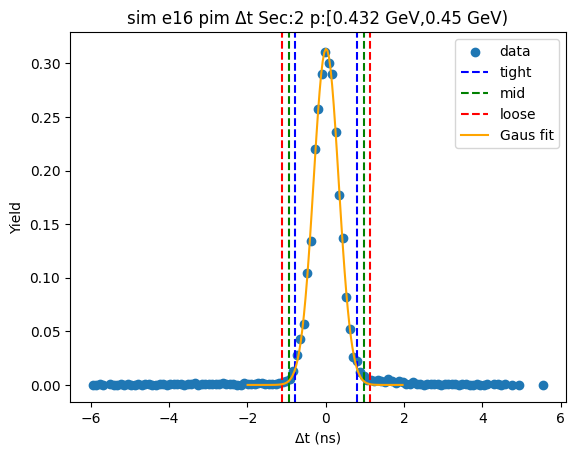

-0.7997129399861955 0.8216074878359259
-0.9618449827684076 0.9837395306181379
-1.1239770255506196 1.1458715734003502


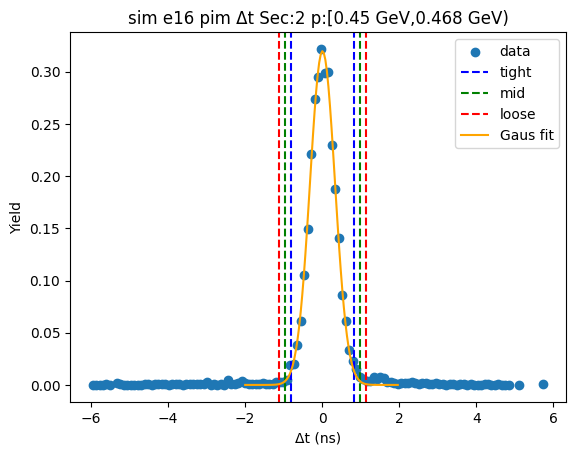

-0.7970620721473175 0.8226706656883264
-0.9590353459308818 0.9846439394718907
-1.1210086197144462 1.146617213255455


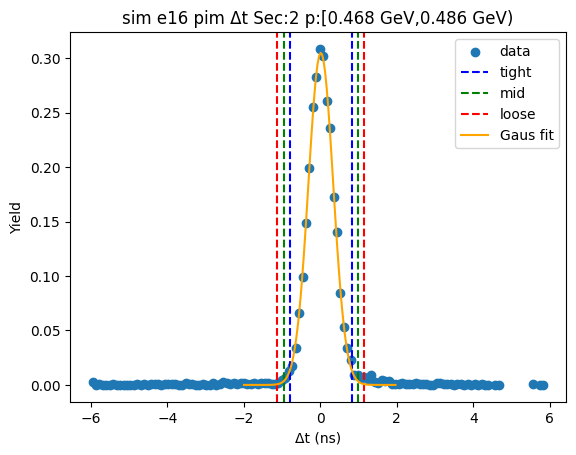

-0.7682660916718972 0.8075407670970319
-0.9258467775487902 0.9651214529739249
-1.083427463425683 1.1227021388508178


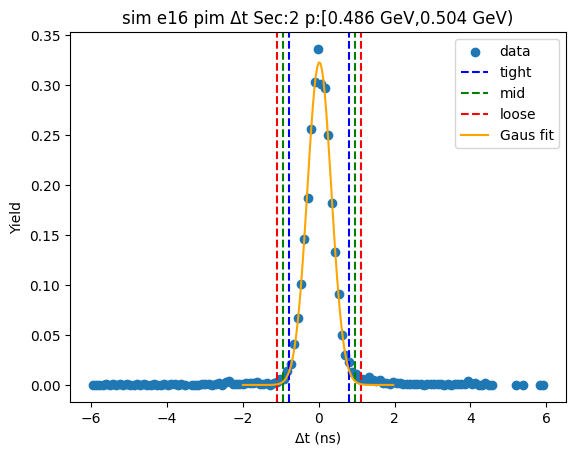

-0.7921468215348954 0.8012712657866429
-0.9514886302670491 0.9606130745187966
-1.110830438999203 1.1199548832509503


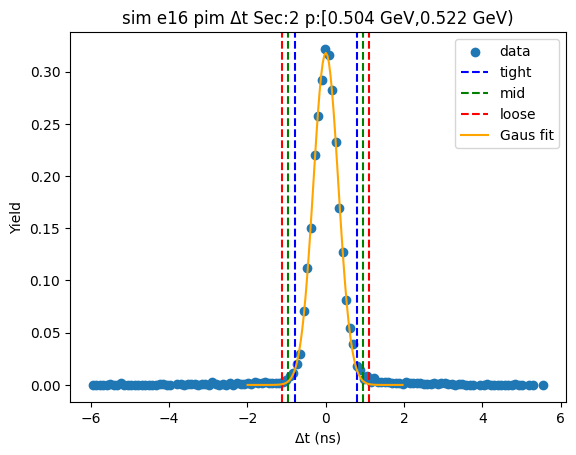

-0.7680759631529321 0.8105866013985081
-0.9259422196080761 0.9684528578536521
-1.08380847606322 1.126319114308796


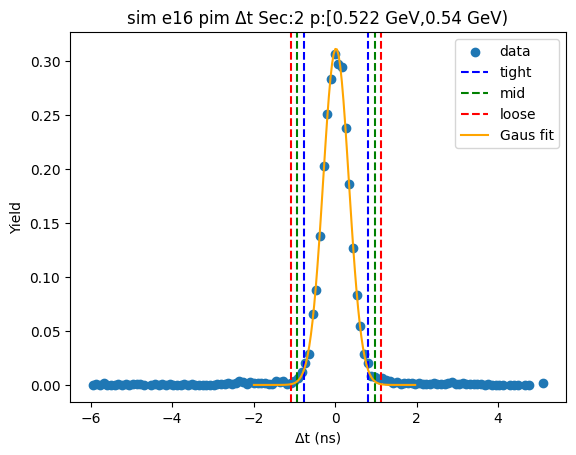

-0.7659927116403108 0.8020323031905493
-0.9227952131233967 0.9588348046736352
-1.0795977146064826 1.1156373061567213


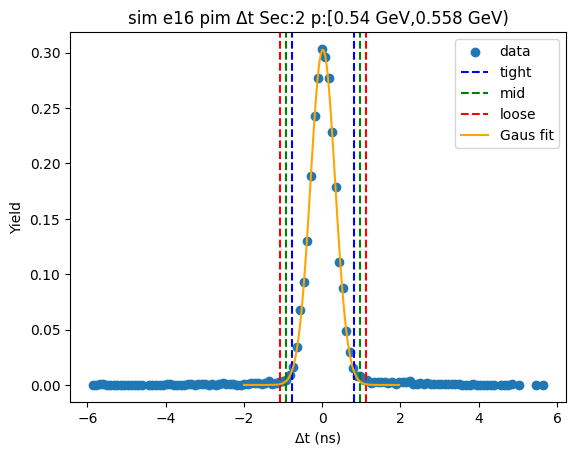

-0.7839860900547934 0.8139061777586155
-0.9437753168361342 0.9736954045399564
-1.1035645436174752 1.1334846313212974


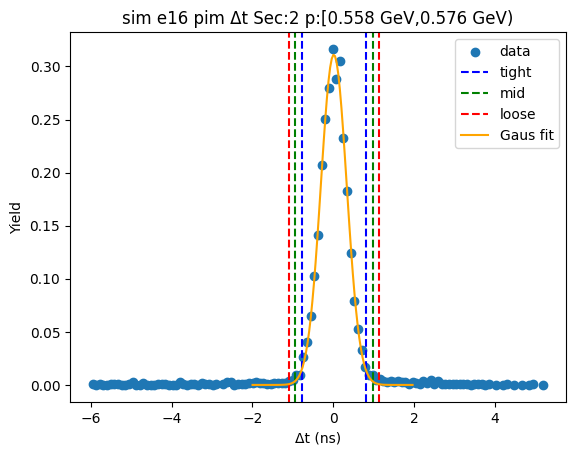

-0.7631149706717493 0.8005388937140498
-0.9194803571103293 0.9569042801526298
-1.075845743548909 1.1132696665912098


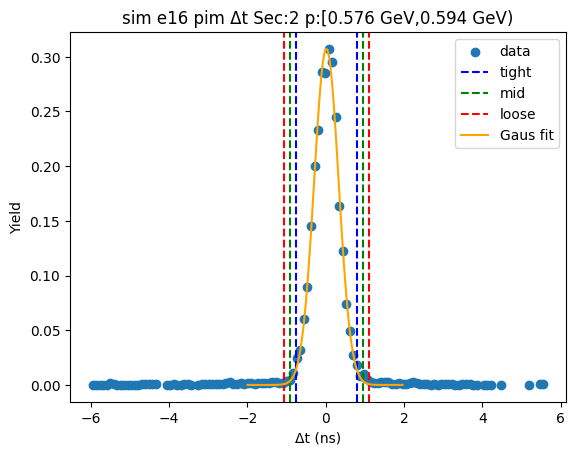

-0.76367427192384 0.797622513702494
-0.9198039504864735 0.9537521922651275
-1.0759336290491068 1.109881870827761


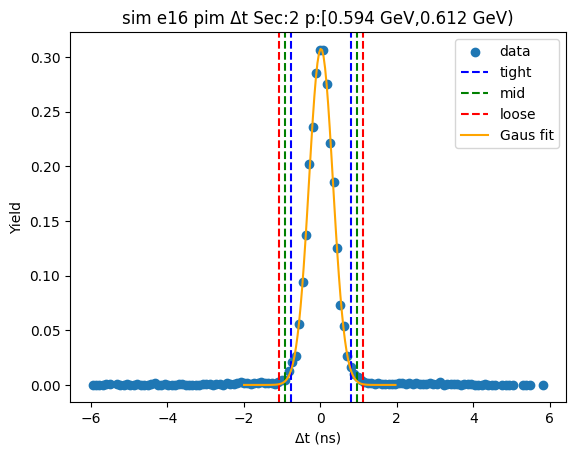

-0.7510780251773832 0.7810264162124088
-0.9042884693163623 0.9342368603513879
-1.0574989134553414 1.0874473044903672


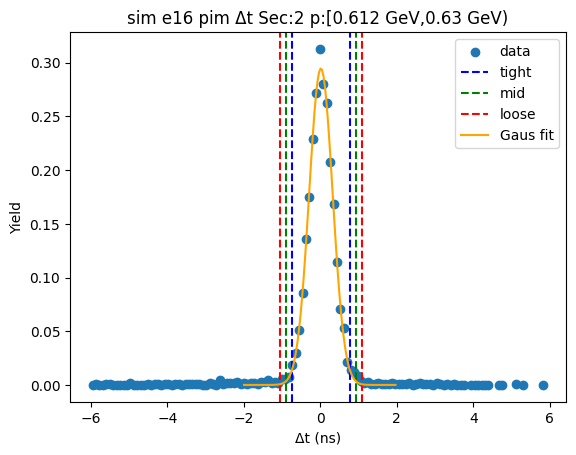

-0.758742597554149 0.7837823068052031
-0.9129950879900841 0.9380347972411383
-1.0672475784260191 1.0922872876770735


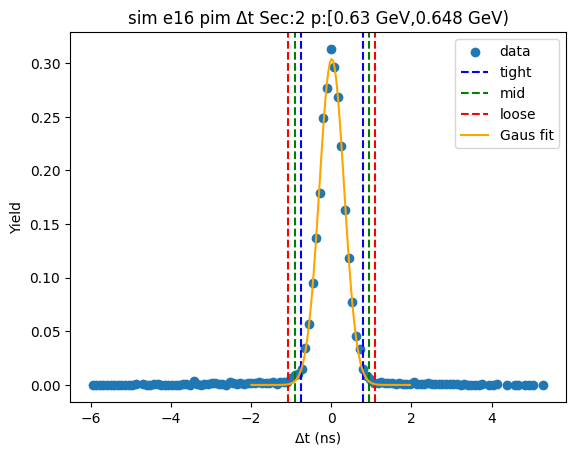

-0.7504724159565417 0.7896308196385076
-0.9044827395160465 0.9436411431980124
-1.0584930630755516 1.0976514667575172


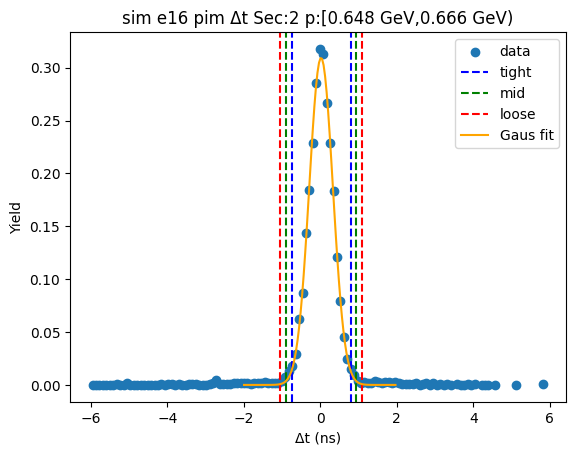

-0.7546456559177148 0.779918389385047
-0.9081020604479909 0.9333747939153231
-1.0615584649782672 1.0868311984455992


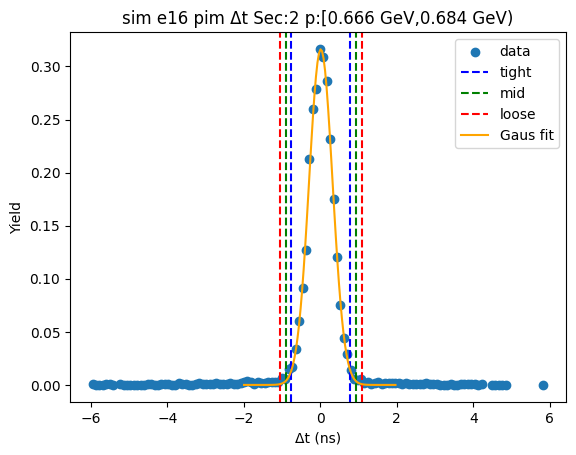

-0.775281087021995 0.7832414490485244
-0.9311333406290471 0.9390937026555765
-1.086985594236099 1.0949459562626285


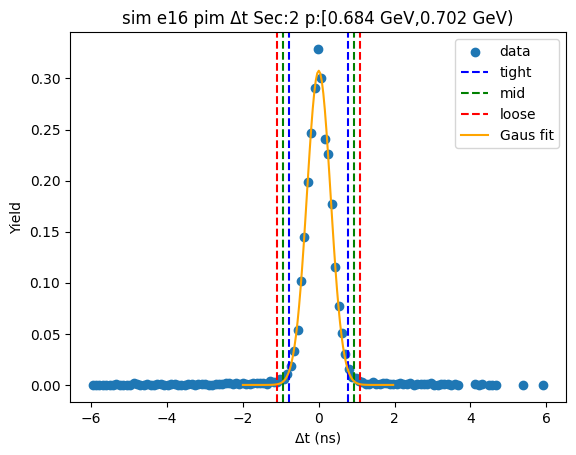

-0.7531243470836453 0.7733238353988319
-0.905769165331893 0.9259686536470796
-1.0584139835801407 1.078613471895327


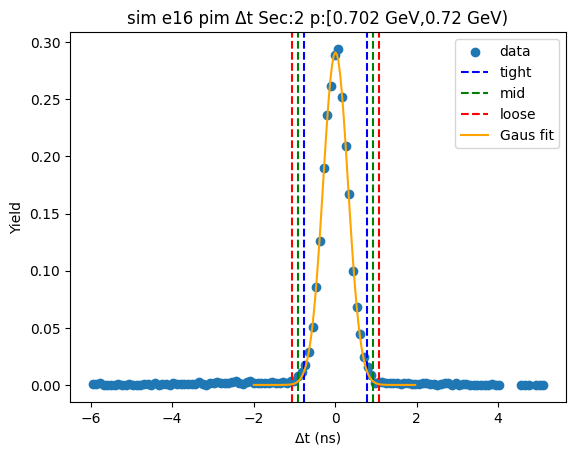

-0.7397083923156555 0.75724488980188
-0.889403720527409 0.9069402180136334
-1.0390990487391627 1.0566355462253871


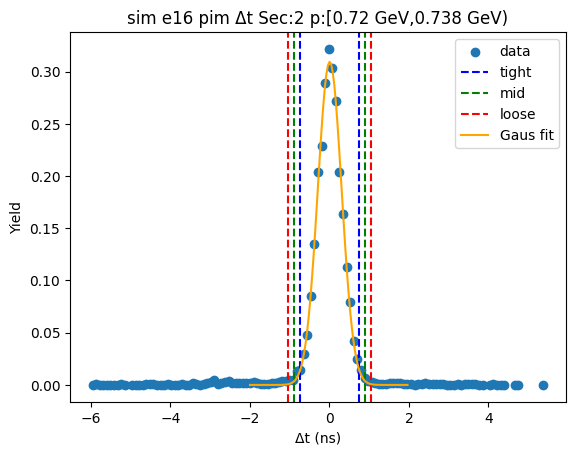

-0.745884040109441 0.7902018629711961
-0.8994926304175046 0.9438104532792597
-1.0531012207255683 1.0974190435873235


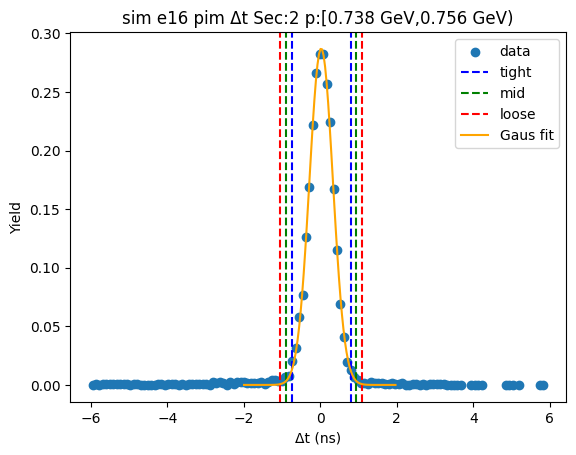

-0.755761060392444 0.7762883290385086
-0.9089659993355391 0.9294932679816038
-1.0621709382786344 1.0826982069246993


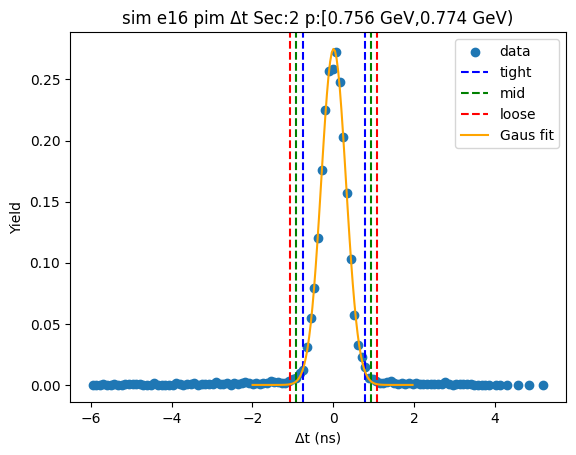

-0.7553936354354268 0.7653887053330336
-0.9074718695122728 0.9174669394098796
-1.0595501035891188 1.0695451734867256


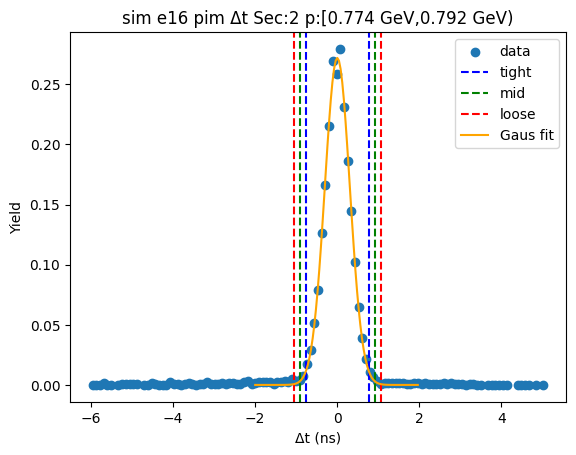

-0.7645665620622516 0.7689858567654232
-0.917921803945019 0.9223410986481906
-1.0712770458277865 1.075696340530958


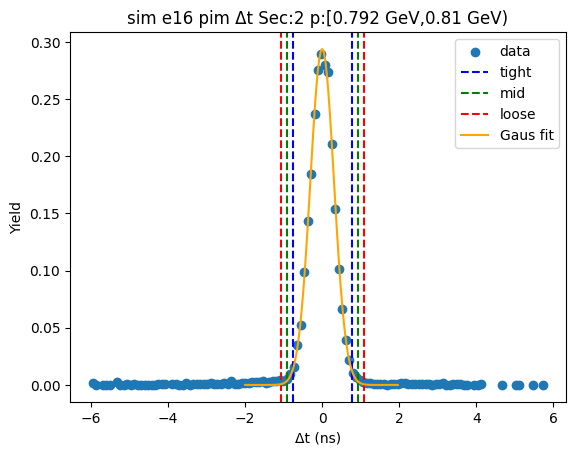

-0.7417018893356375 0.7663817270128856
-0.8925102509704897 0.9171900886477379
-1.043318612605342 1.0679984502825903


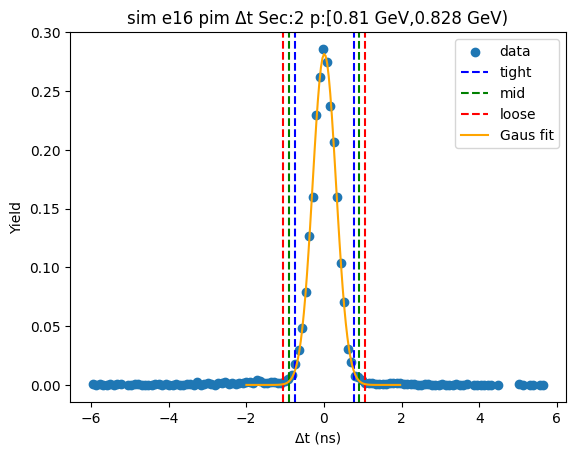

-0.7712927095637536 0.7874829553057416
-0.9271702760507032 0.9433605217926913
-1.0830478425376526 1.0992380882796406


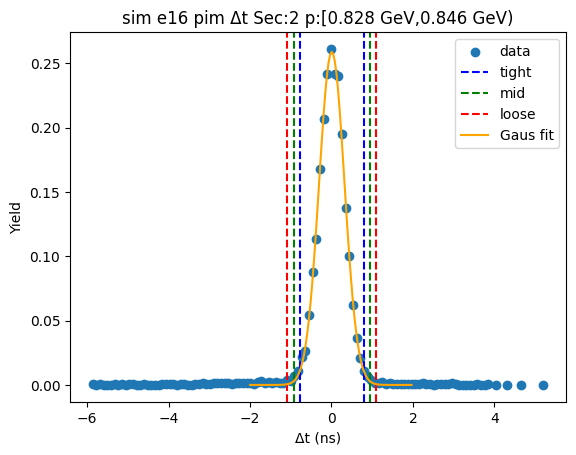

-0.7619223784812494 0.7762680616344335
-0.9157414224928176 0.9300871056460017
-1.069560466504386 1.08390614965757


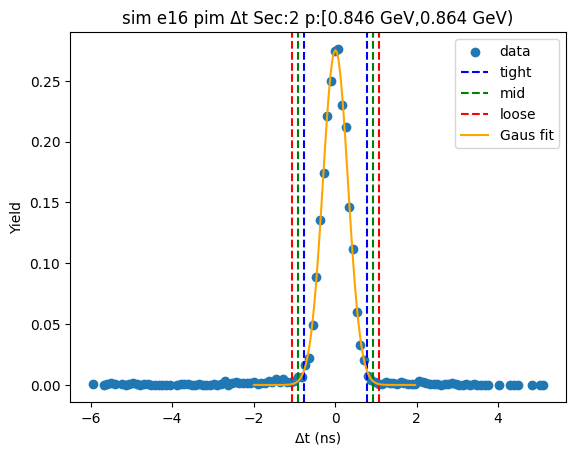

-0.7492847189146354 0.7741762993821049
-0.9016308207443096 0.926522401211779
-1.0539769225739835 1.0788685030414529


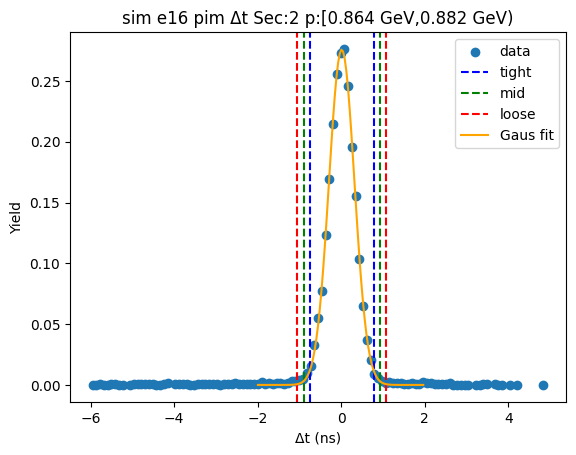

-0.7717992313358866 0.7948878454101072
-0.9284679390104859 0.9515565530847064
-1.0851366466850851 1.108225260759306


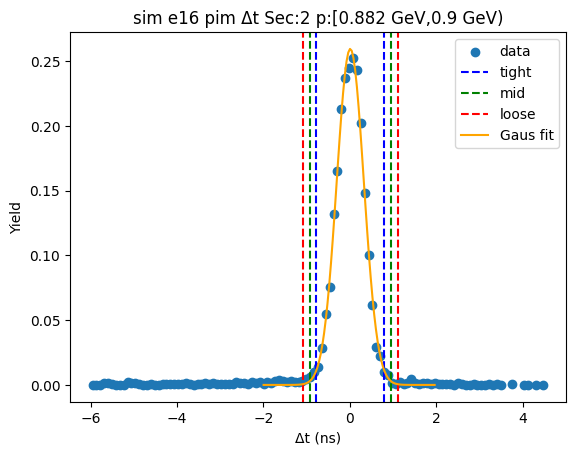

-0.7596727451218332 0.7829028289427422
-0.9139303025282909 0.9371603863491998
-1.0681878599347485 1.0914179437556573


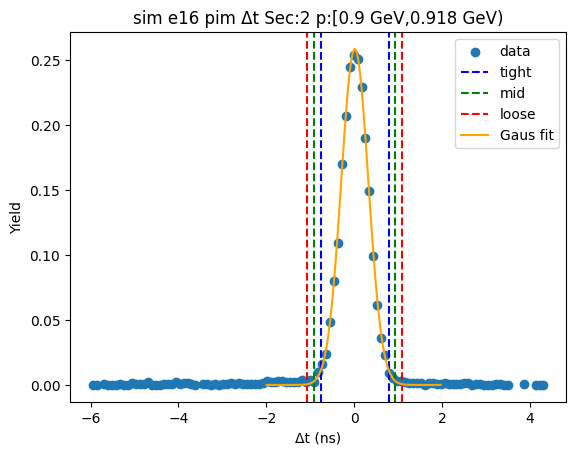

-0.7416592430840293 0.7729358571522712
-0.8931187531076594 0.9243953671759013
-1.0445782631312897 1.0758548771995313


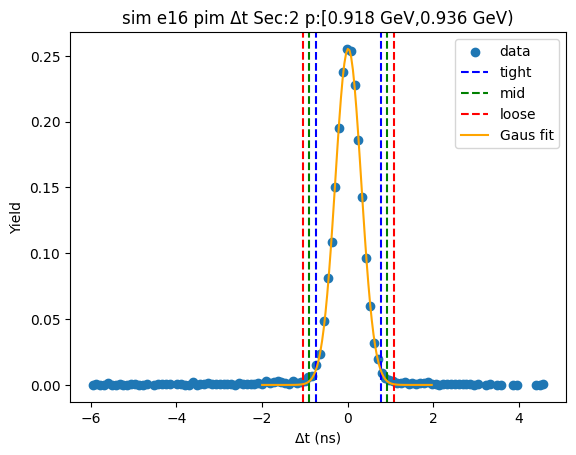

-0.7502715370572147 0.7713001529545968
-0.9024287060583959 0.9234573219557779
-1.054585875059577 1.0756144909569592


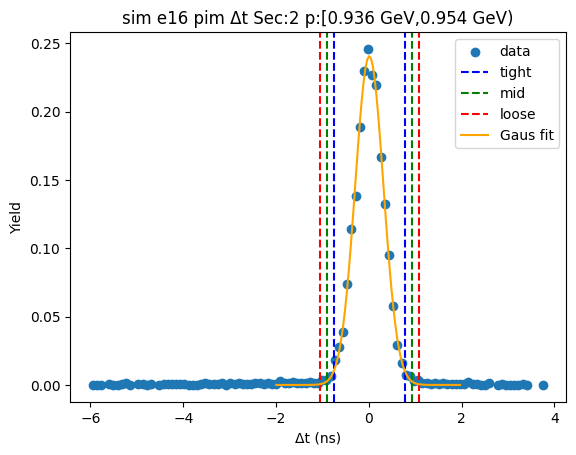

-0.732538533441293 0.7584402483349997
-0.8816364116189223 0.9075381265126289
-1.0307342897965515 1.056636004690258


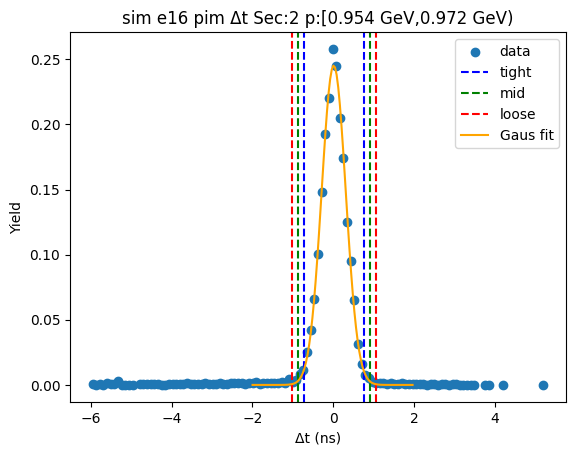

-0.7371128266183812 0.7603834586956585
-0.8868624551497852 0.9101330872270625
-1.0366120836811892 1.0598827157584665


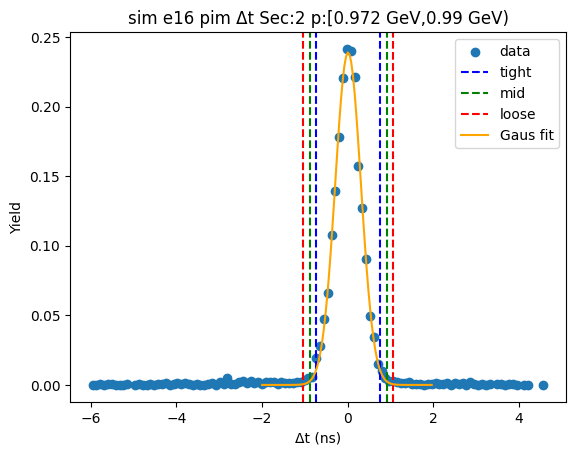

-0.7407041690142656 0.7623483637396958
-0.8910094222896618 0.9126536170150921
-1.041314675565058 1.0629588702904882


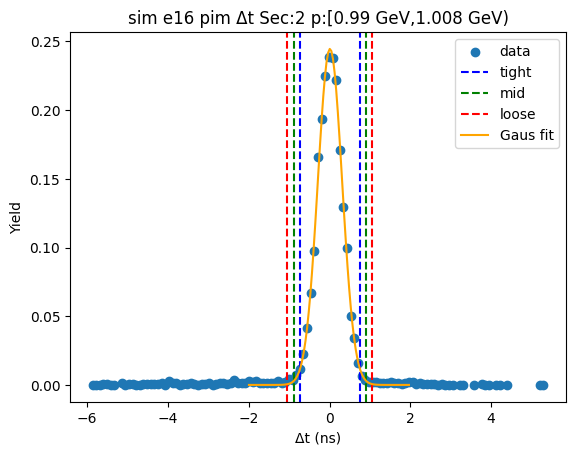

-0.7216686430764456 0.750587342035073
-0.8688942415875974 0.8978129405462248
-1.0161198400987492 1.0450385390573766


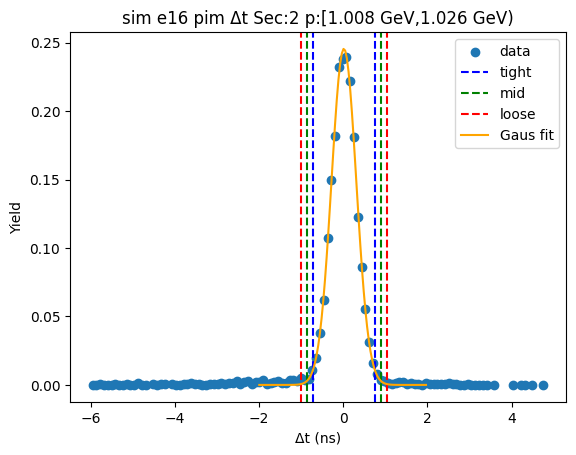

-0.7295337218973643 0.7609216003533359
-0.8785792541224344 0.909967132578406
-1.0276247863475043 1.059012664803476


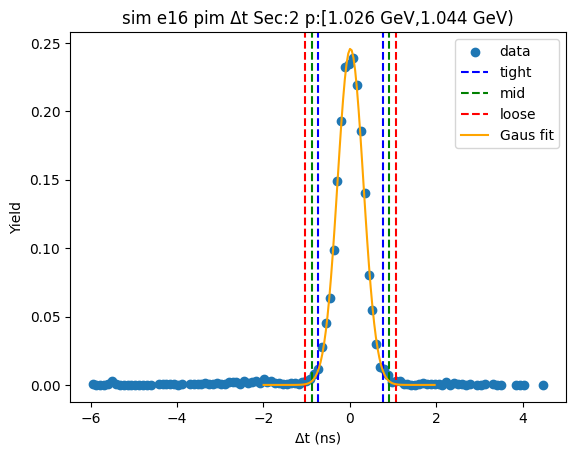

-0.7474787653786101 0.7636666336735236
-0.8985933052838234 0.9147811735787369
-1.0497078451890367 1.0658957134839504


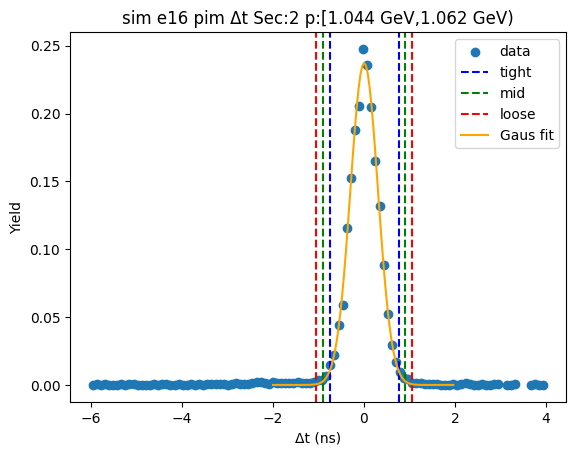

-0.7181663652007755 0.7531700012663372
-0.8653000018474867 0.9003036379130483
-1.0124336384941979 1.0474372745597595


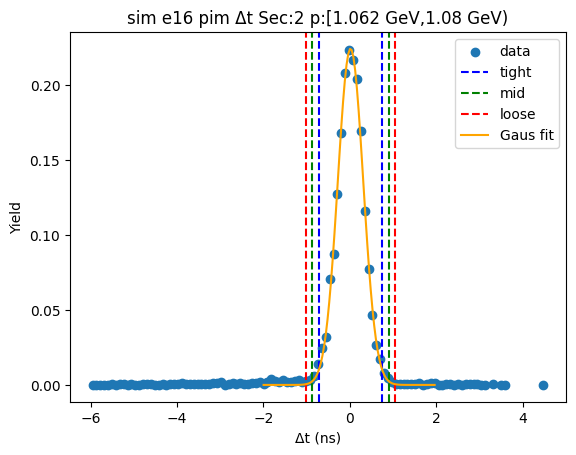

-0.7285673638745123 0.7729146908133182
-0.8787155693432953 0.9230628962821013
-1.0288637748120784 1.0732111017508843


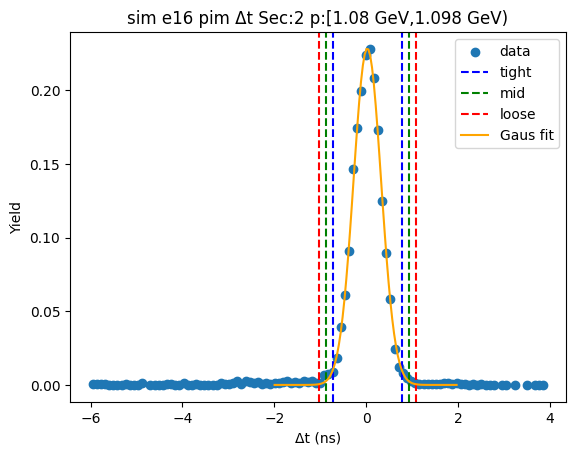

-0.724876192138461 0.7578160265590823
-0.8731454140082153 0.9060852484288366
-1.0214146358779697 1.054354470298591


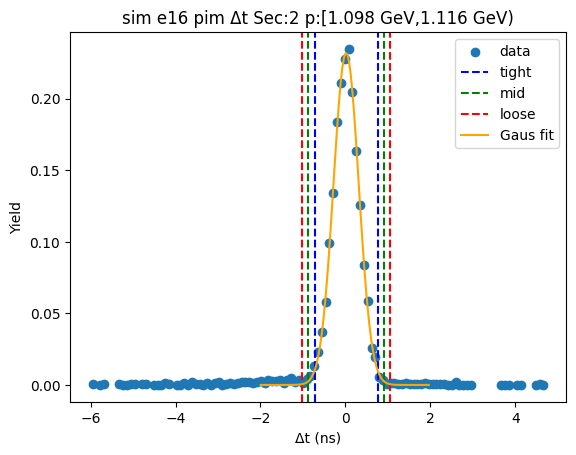

-0.7198098933661535 0.7201400755110642
-0.8638048902538753 0.864135072398786
-1.007799887141597 1.0081300692865076


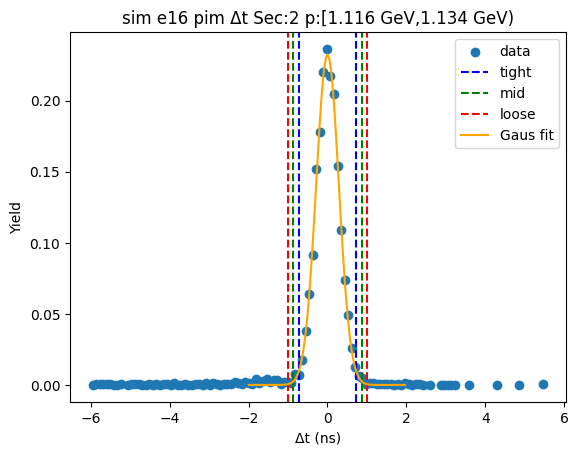

-0.7090582391188496 0.7371350657452969
-0.8536775696052643 0.8817543962317116
-0.9982969000916788 1.026373726718126


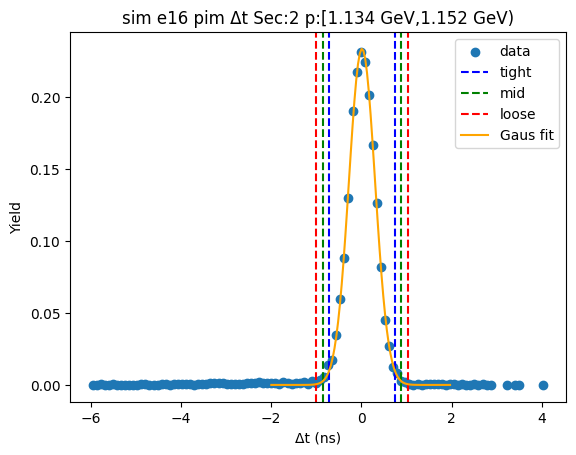

-0.7094575424299255 0.7439715919078728
-0.8548004558637055 0.8893145053416527
-1.0001433692974853 1.0346574187754325


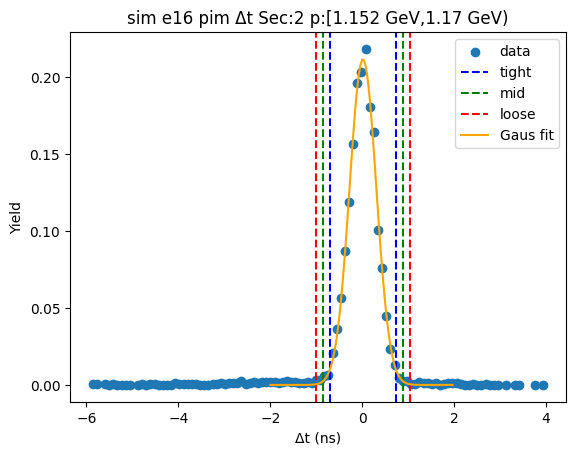

-0.7317609956686598 0.7503691779080869
-0.8799740130263345 0.8985821952657616
-1.0281870303840093 1.0467952126234363


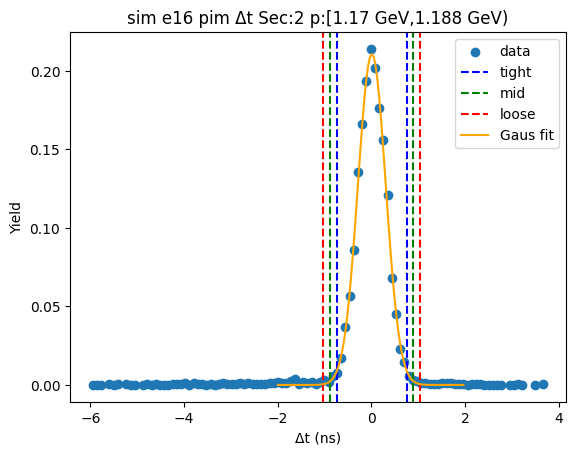

-0.7263826233167934 0.7243288155511696
-0.8714537672035896 0.8693999594379658
-1.016524911090386 1.0144711033247622


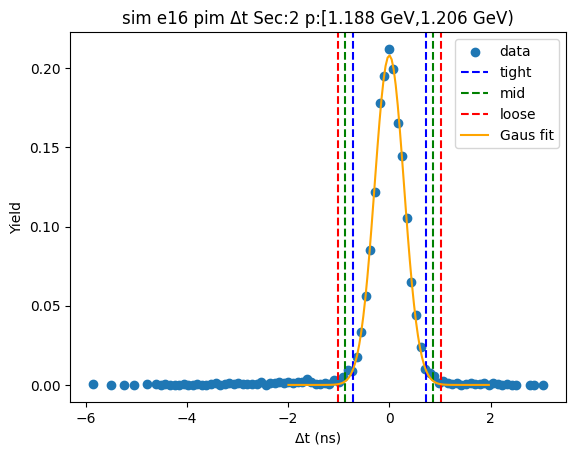

-0.7299732814375851 0.736572152560563
-0.8766278248374 0.8832266959603778
-1.0232823682372147 1.0298812393601928


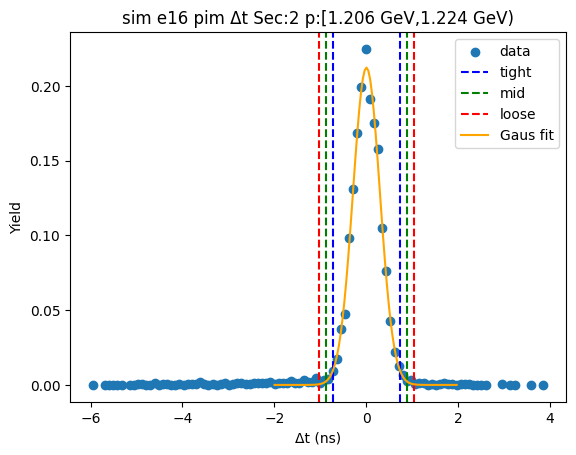

-0.7225363974246011 0.7303517392405632
-0.8678252110911174 0.8756405529070795
-1.0131140247576338 1.020929366573596


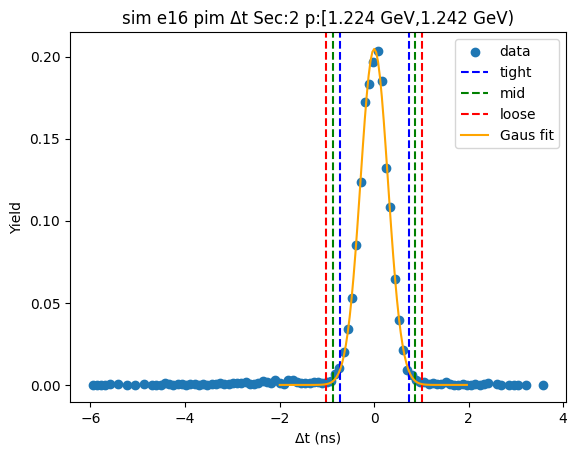

-0.7015313528773364 0.709710390055053
-0.8426555271705752 0.8508345643482919
-0.9837797014638141 0.9919587386415307


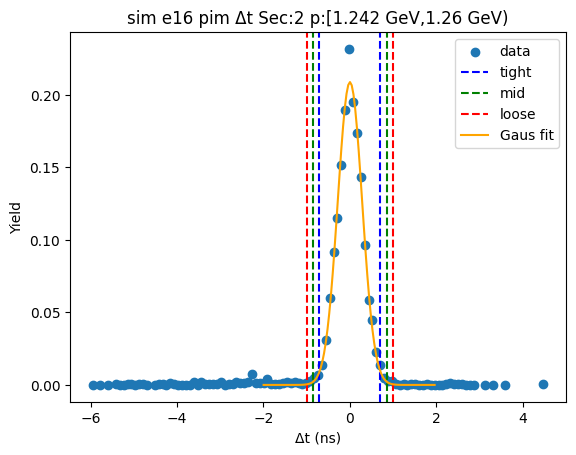

-0.7273236073225822 0.7482982125205693
-0.8748857893068973 0.8958603945048844
-1.0224479712912125 1.0434225764891996


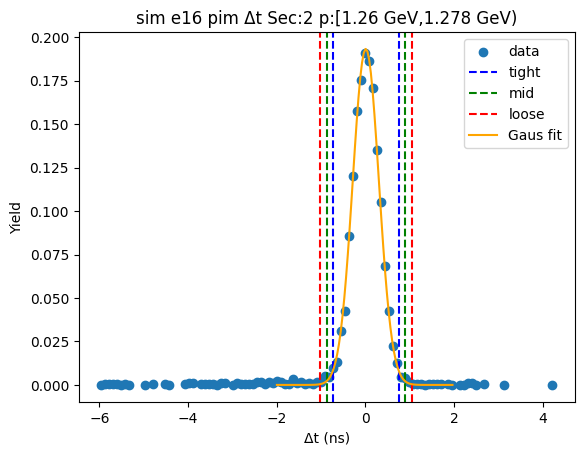

-0.7293828230526235 0.7338937874829611
-0.875710484106182 0.8802214485365196
-1.0220381451597405 1.026549109590078


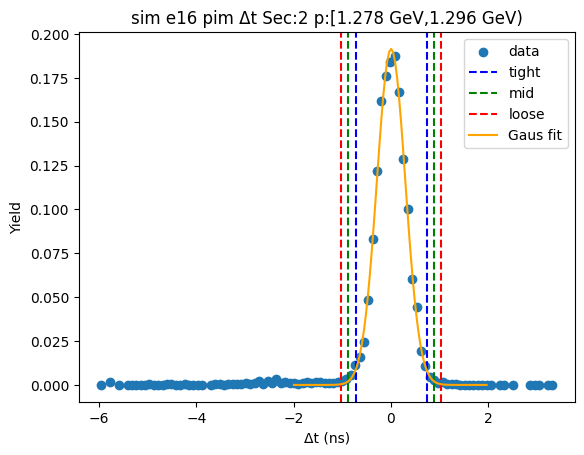

-0.7242898832113405 0.7285608034352449
-0.8695749518759991 0.8738458720999035
-1.0148600205406577 1.019130940764562


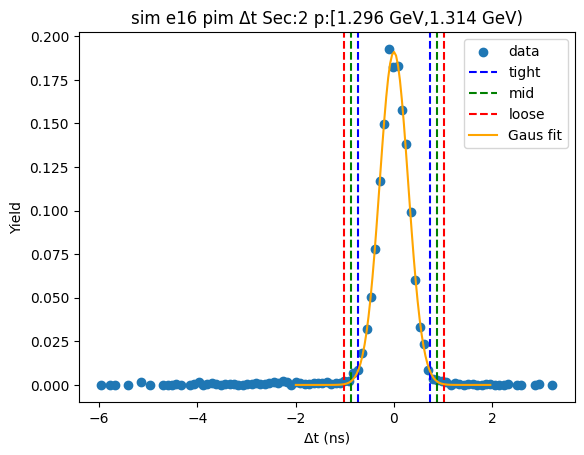

-0.7227194805728158 0.7345262621938994
-0.8684440548494873 0.8802508364705709
-1.0141686291261587 1.0259754107472425


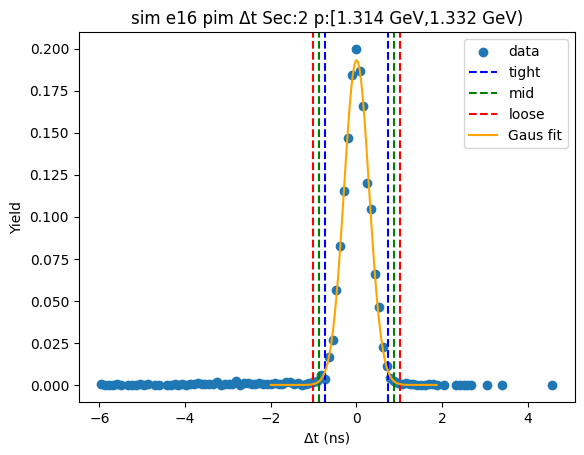

-0.7174954836437153 0.7304337467570787
-0.8622884066837947 0.8752266697971581
-1.0070813297238743 1.0200195928372375


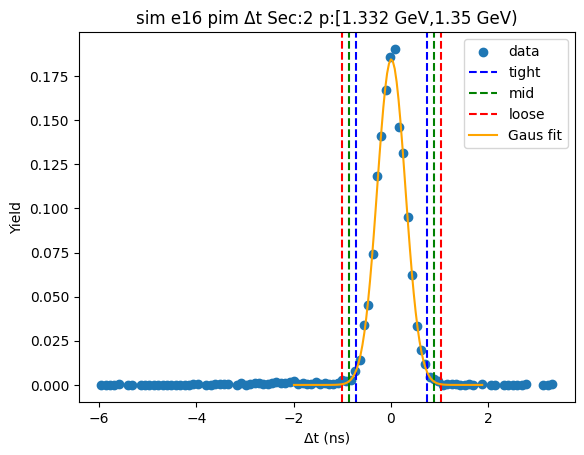

-0.7129847933618356 0.7321638128595112
-0.8574996539839702 0.8766786734816457
-1.0020145146061048 1.0211935341037806


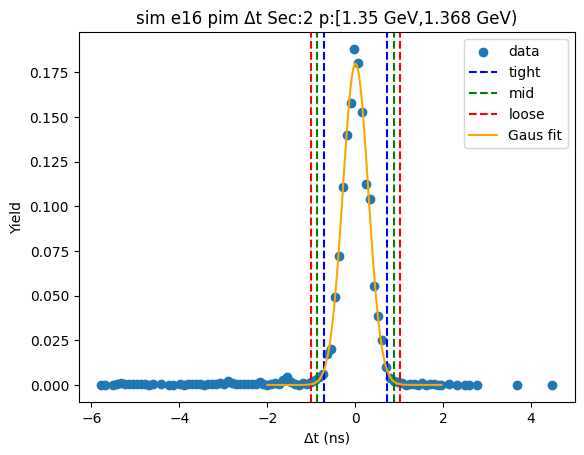

-0.726847048925198 0.7343028721923478
-0.8729620410369525 0.8804178643041023
-1.0190770331487071 1.026532856415857


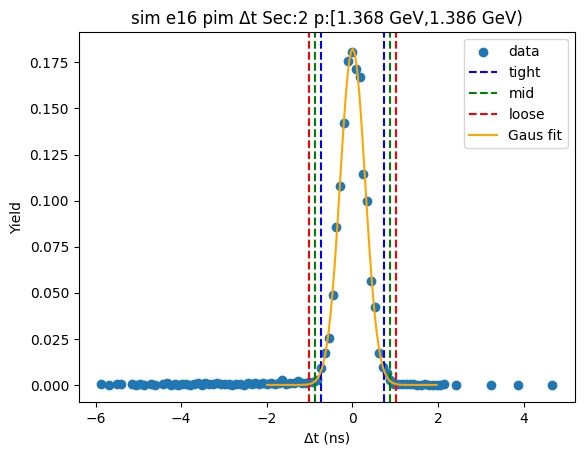

-0.7248273795581354 0.7311486661519987
-0.8704249841291487 0.876746270723012
-1.016022588700162 1.0223438752940255


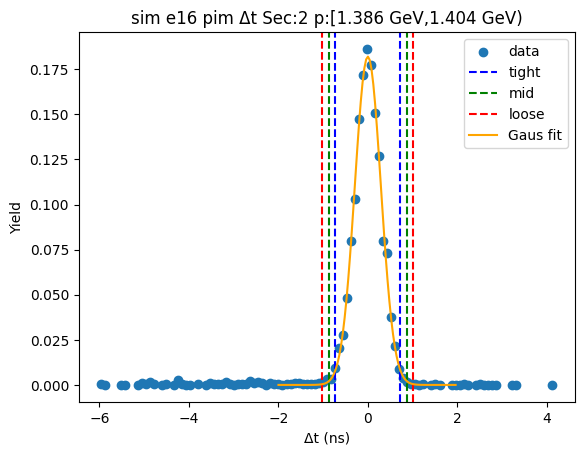

-0.7091524201374917 0.7387523475480127
-0.8539428969060422 0.8835428243165632
-0.9987333736745927 1.0283333010851137


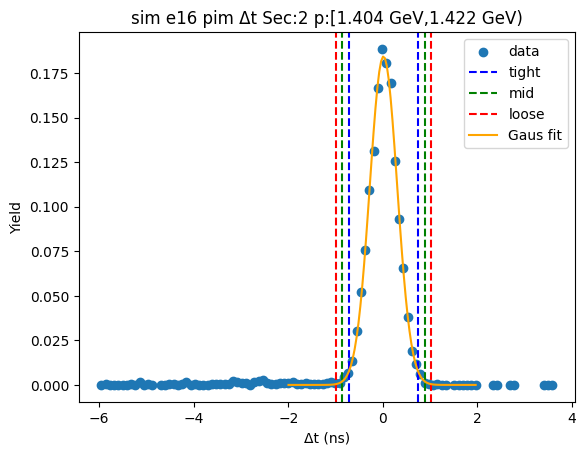

-0.7355957660656169 0.7491465989697739
-0.884070002569156 0.897620835473313
-1.032544239072695 1.0460950719768518


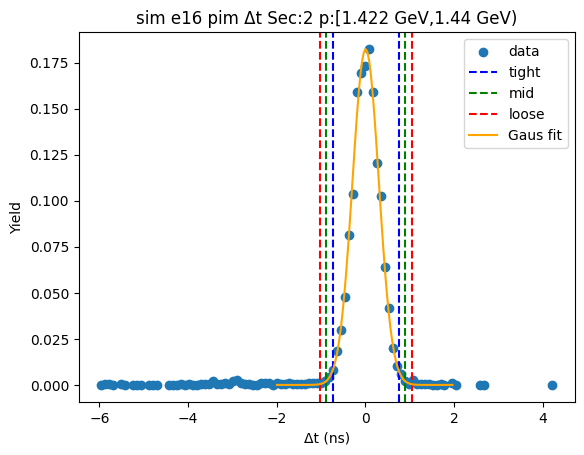

-0.7142598751703507 0.7348212976196239
-0.8591679924493483 0.8797294148986214
-1.0040761097283457 1.0246375321776189


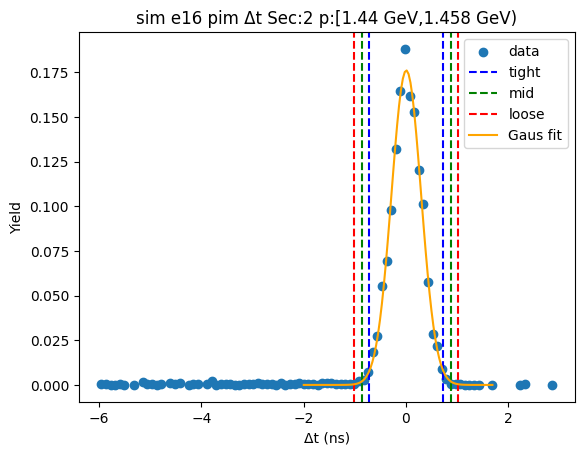

-0.6858122417830997 0.7274838952393557
-0.8271418554853454 0.8688135089416014
-0.968471469187591 1.0101431226438469


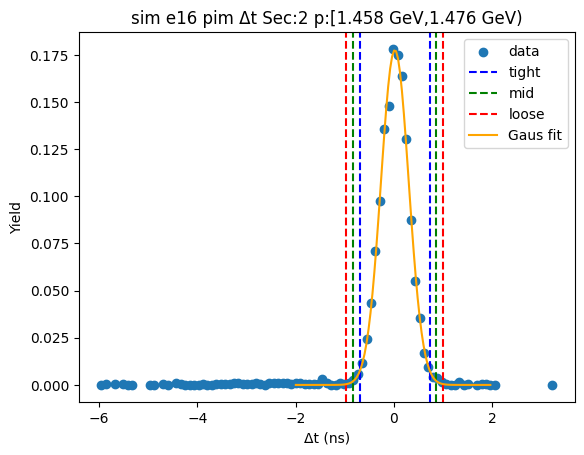

-0.7246629373496443 0.7553660691978765
-0.8726658380043963 0.9033689698526286
-1.0206687386591484 1.0513718705073807


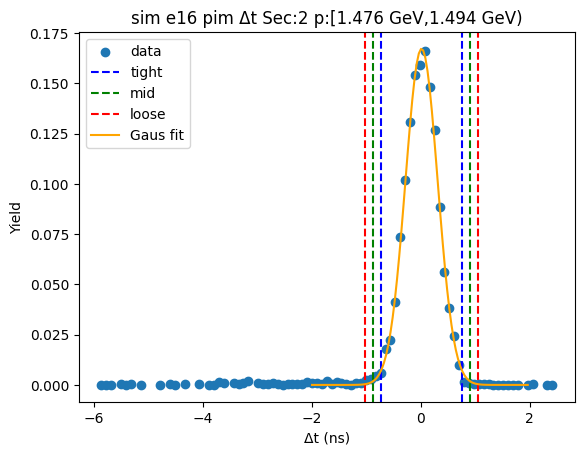

-0.7167848959683367 0.7347993833213342
-0.8619433238973039 0.8799578112503014
-1.007101751826271 1.0251162391792685


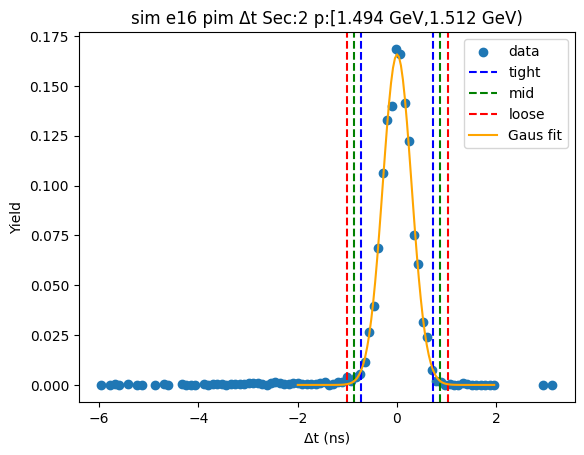

-0.6991561644708784 0.6992612467975095
-0.8389979055977171 0.8391029879243482
-0.9788396467245559 0.978944729051187


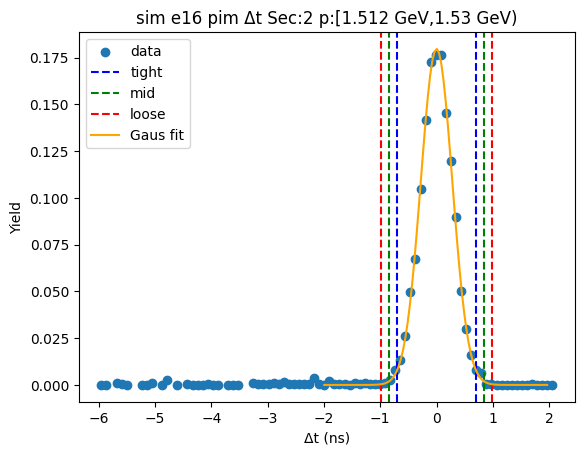

-0.6843066657789756 0.7171496888532485
-0.8244523012421979 0.8572953243164708
-0.9645979367054203 0.9974409597796932


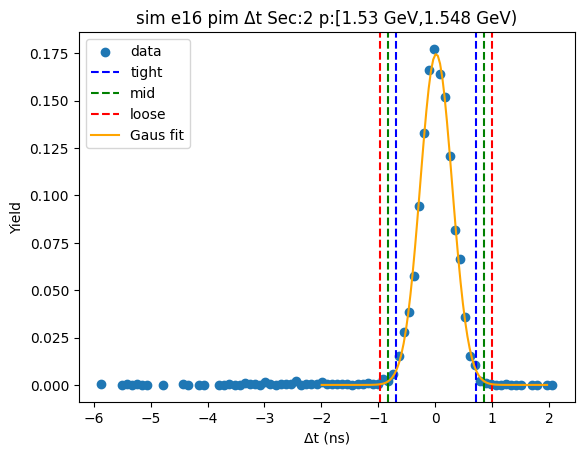

-0.6915454446458623 0.7045578589521816
-0.8311557750056666 0.8441681893119859
-0.970766105365471 0.9837785196717903


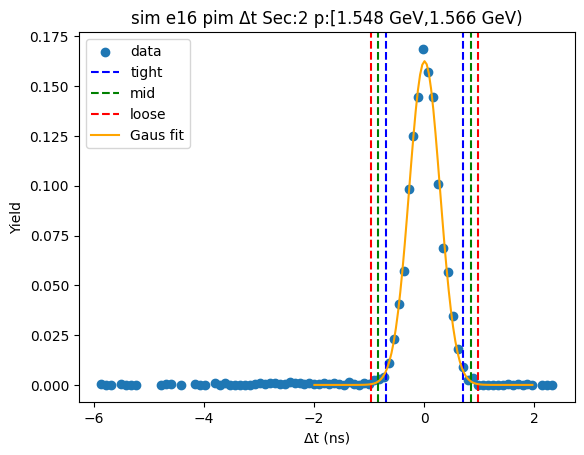

-0.7052449779248589 0.7729711199271501
-0.8530665877100598 0.920792729712351
-1.0008881974952606 1.0686143394975518


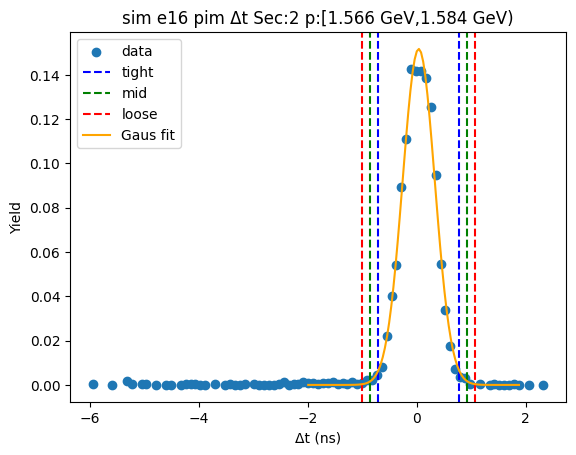

-0.7184252049501365 0.7527432946637487
-0.865542054911525 0.8998601446251372
-1.0126589048729138 1.0469769945865257


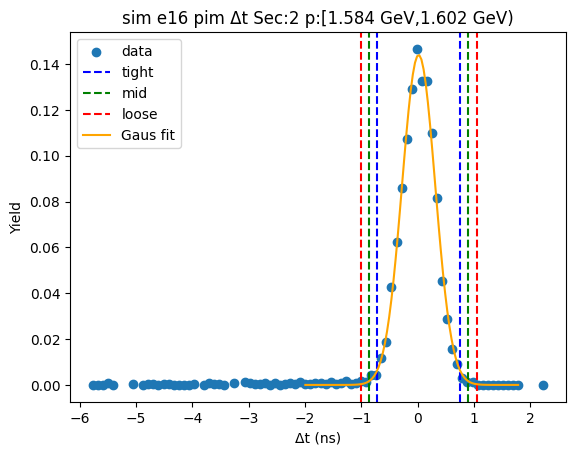

-0.6995004910607538 0.7137159965963267
-0.8408221398264618 0.8550376453620346
-0.9821437885921699 0.9963592941277427


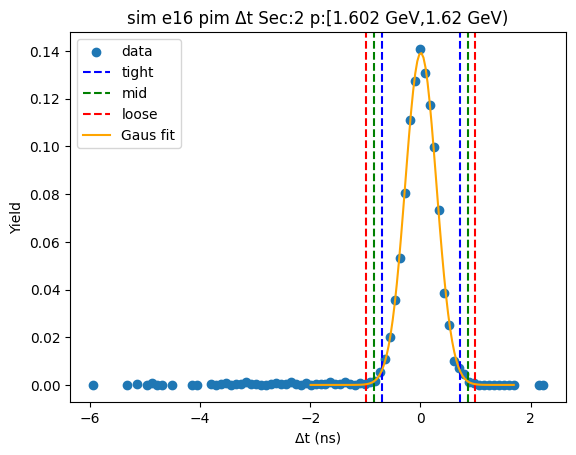

-0.7309762919302861 0.7421224193894368
-0.8782861630622585 0.8894322905214092
-1.025596034194231 1.0367421616533814


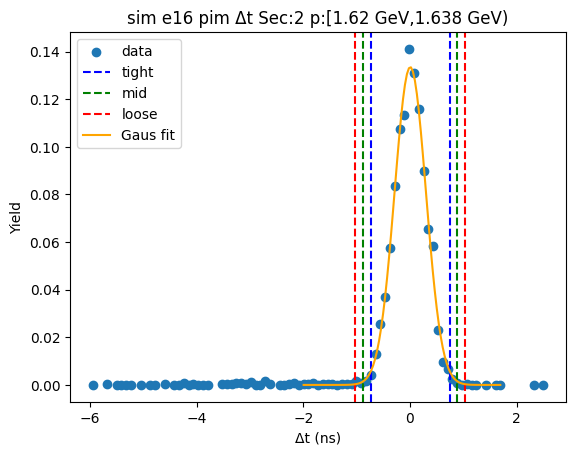

-0.6690564840302069 0.7064119494795214
-0.8066033273811799 0.8439587928304941
-0.9441501707321527 0.9815056361814671


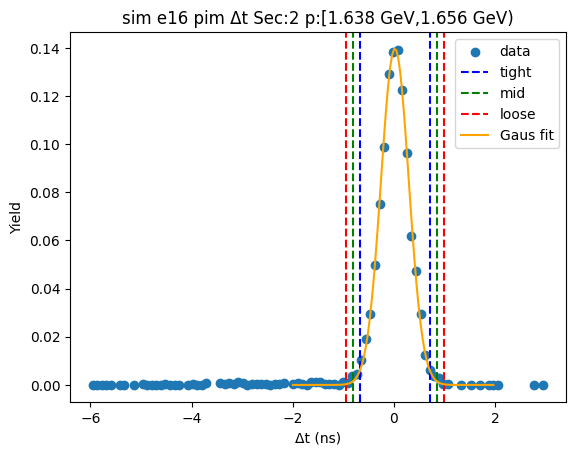

-0.7202633376251827 0.7069427702298351
-0.8629839484106844 0.8496633810153368
-1.0057045591961862 0.9923839918008386


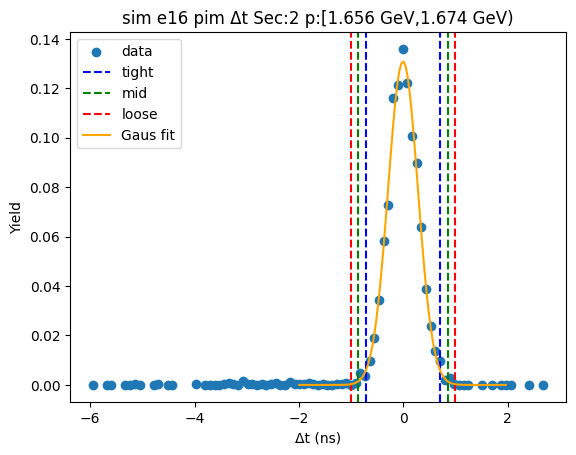

-0.6865465489617759 0.6960095462636953
-0.824802158484323 0.8342651557862424
-0.9630577680068702 0.9725207653087895


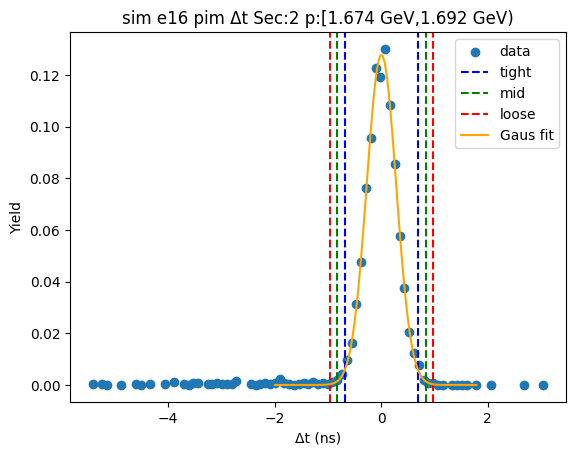

-0.7067770577023689 0.7236244072672904
-0.8498172041993347 0.8666645537642562
-0.9928573506963007 1.009704700261222


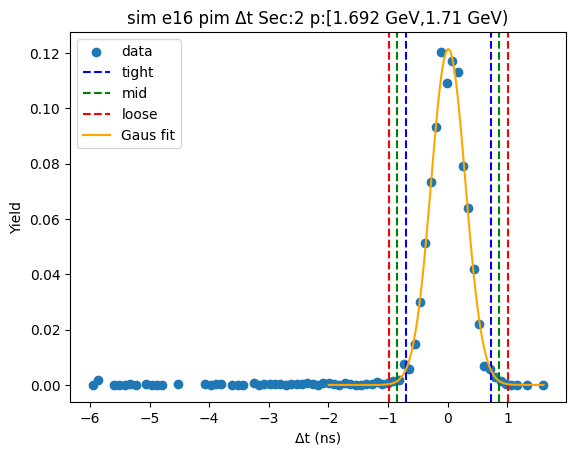

-0.656313972530045 0.7026697767346949
-0.792212347456519 0.8385681516611689
-0.9281107223829931 0.974466526587643


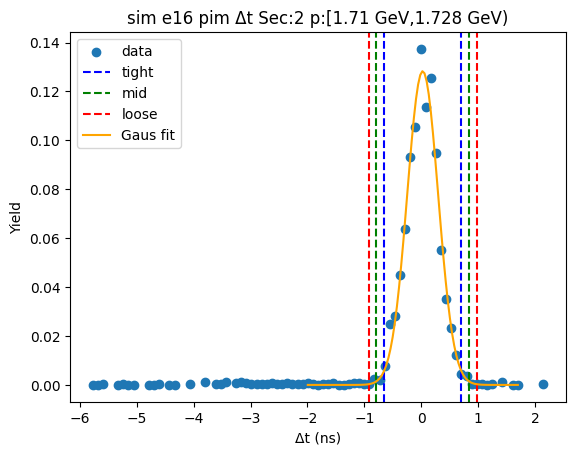

-0.7033859852304004 0.6933297620790754
-0.8430575599613479 0.8330013368100229
-0.9827291346922955 0.9726729115409705


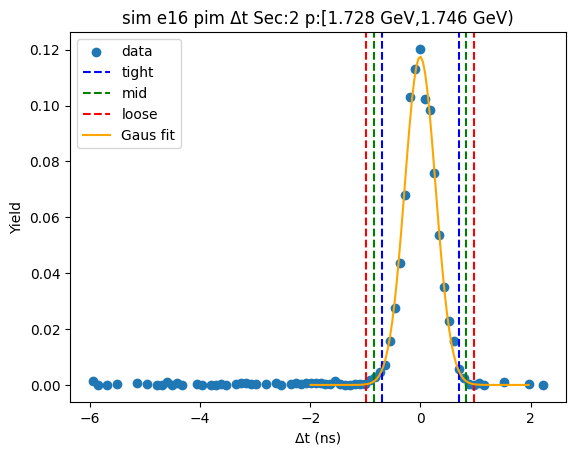

-0.698537105869908 0.7057651615153756
-0.8389673326084365 0.8461953882539041
-0.9793975593469648 0.9866256149924324


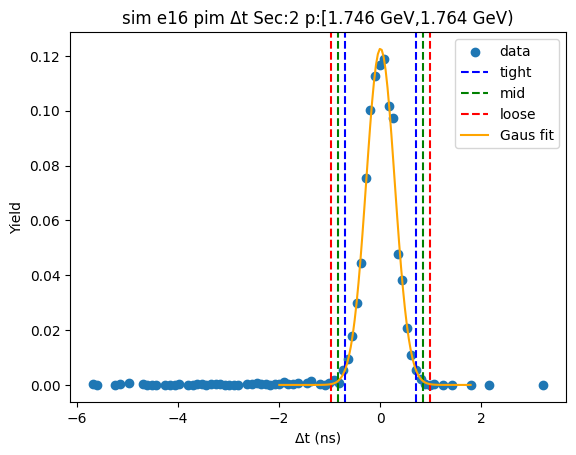

-0.7203499083091105 0.7363352505233365
-0.8660184241923552 0.8820037664065812
-1.0116869400756 1.0276722822898259


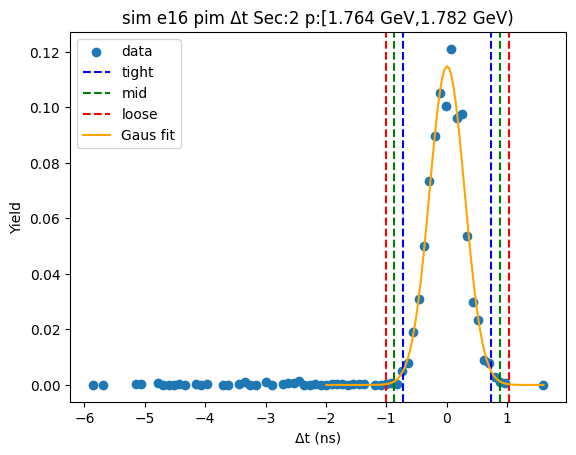

-0.6770544480062787 0.7058084010077065
-0.8153407329076773 0.8440946859091051
-0.9536270178090758 0.9823809708105036


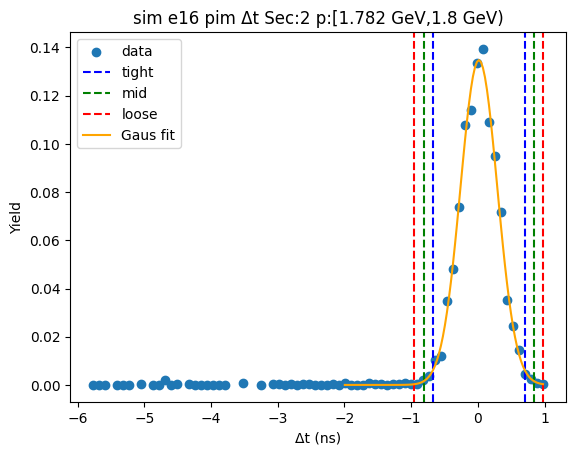

-0.6918423790596863 0.7020525420311444
-0.8312318711687694 0.8414420341402276
-0.9706213632778525 0.9808315262493107


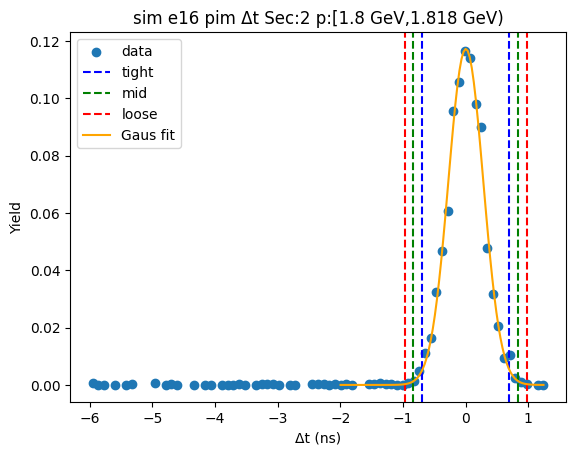

-0.7085446855315258 0.7169042749049073
-0.8510895815751692 0.8594491709485507
-0.9936344776188125 1.001994066992194


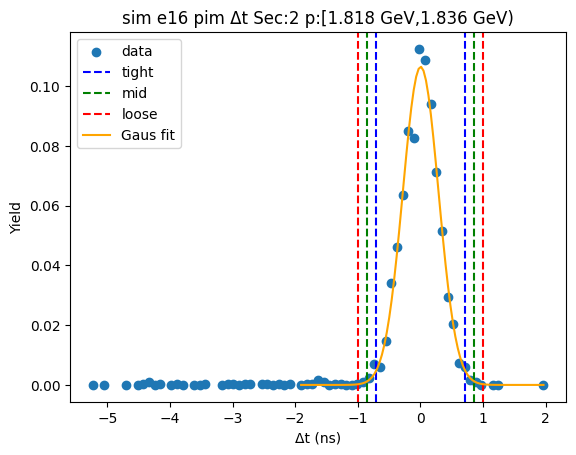

-0.68975481245957 0.7271385653690356
-0.8314441502424307 0.8688279031518963
-0.9731334880252913 1.010517240934757


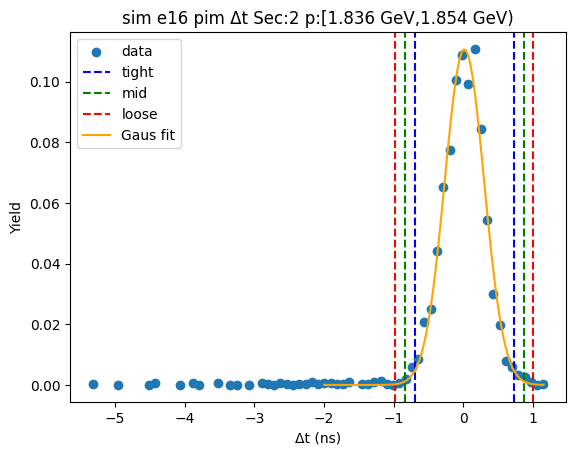

-0.679576661127103 0.6965401912355029
-0.8171883463633637 0.8341518764717636
-0.9548000315996243 0.9717635617080242


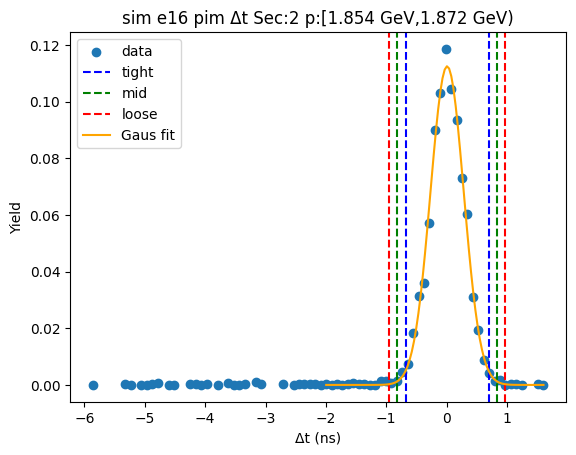

-0.6821429773330158 0.6874553164158305
-0.8191028067079005 0.8244151457907152
-0.9560626360827851 0.9613749751655998


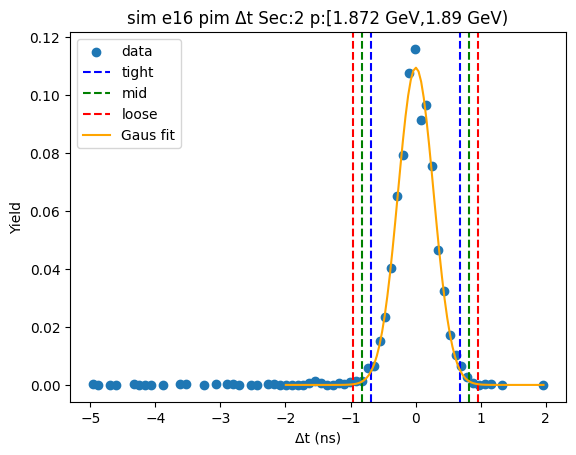

-0.6991241112572929 0.6854272718268043
-0.8375792495657026 0.823882410135214
-0.9760343878741123 0.9623375484436237


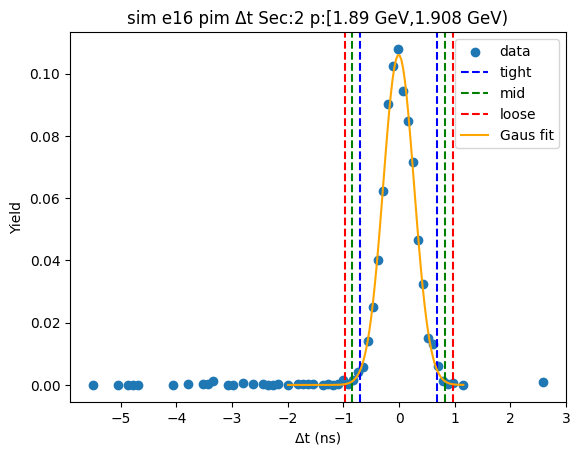

-0.6742495769735549 0.7200294255178007
-0.8136774772226906 0.8594573257669363
-0.9531053774718261 0.9988852260160719


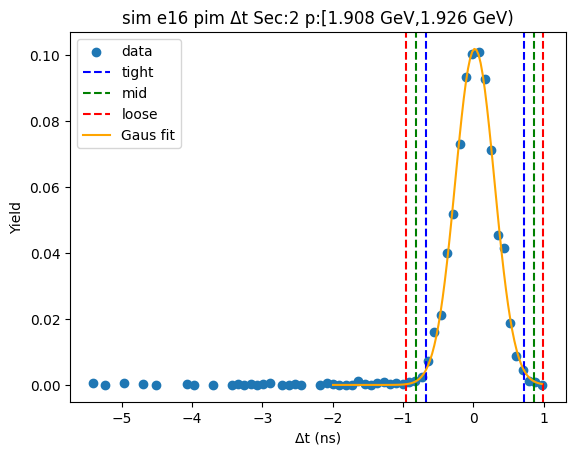

-0.7129816649661698 0.7322357334054579
-0.8575034048033325 0.8767574732426207
-1.0020251446404953 1.0212792130797834


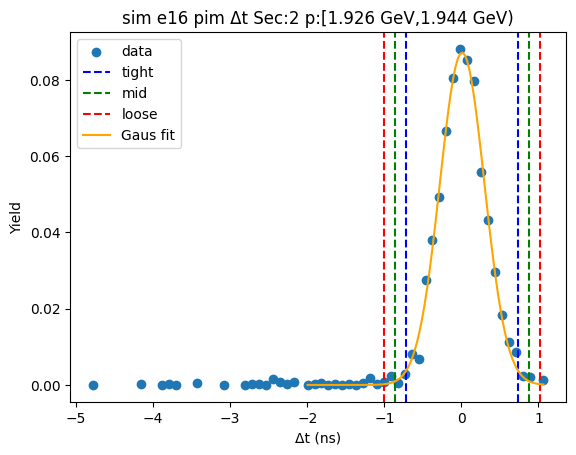

-0.6951353644408599 0.7533183162695035
-0.8399807325118963 0.89816368434054
-0.9848261005829325 1.043009052411576


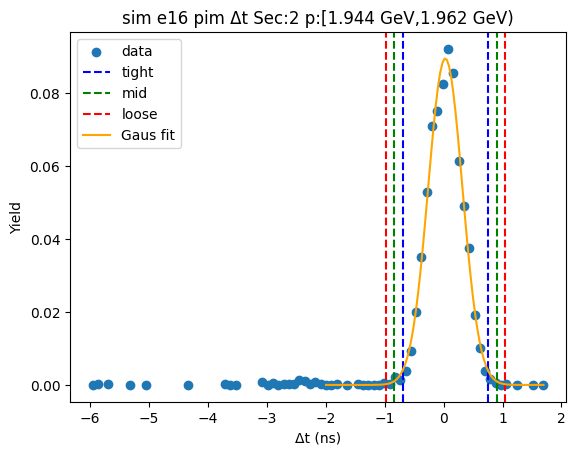

-0.6601330005530237 0.7180938349266766
-0.7979556841009938 0.8559165184746467
-0.9357783676489638 0.9937392020226167


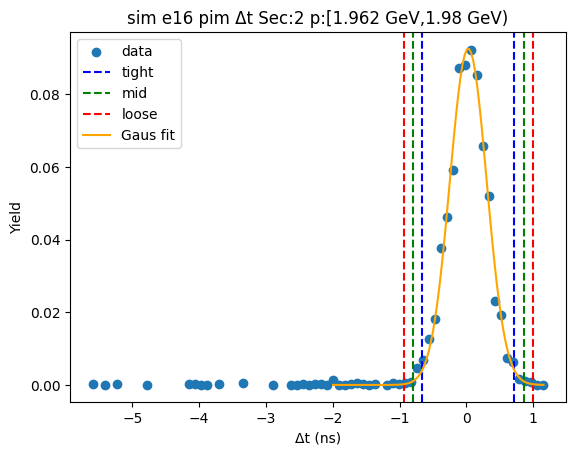

-0.650815667434397 0.6651043061166049
-0.7824076647894972 0.7966963034717051
-0.9139996621445974 0.9282883008268052


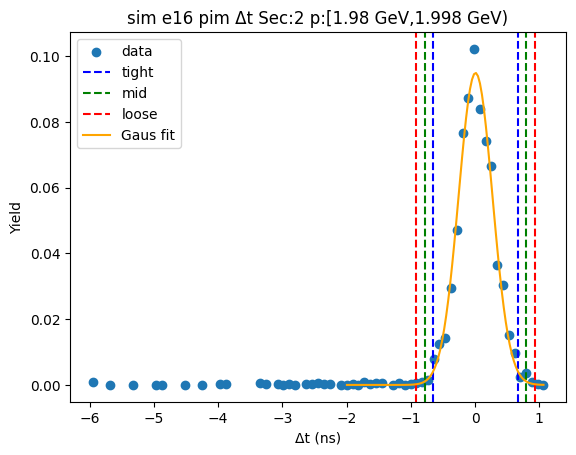

-0.6793414678419692 0.6836150124373109
-0.8156371158698972 0.8199106604652389
-0.9519327638978252 0.9562063084931669


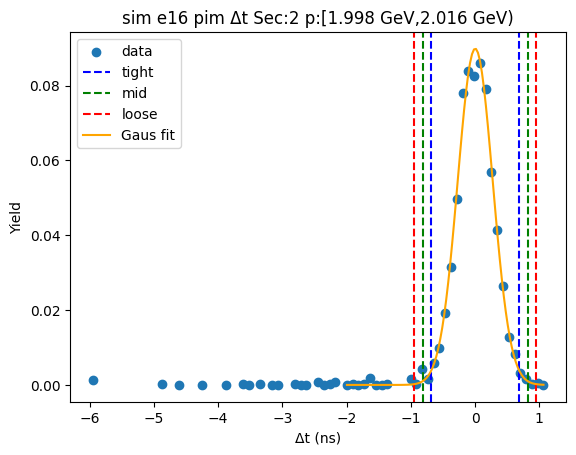

-0.6775414538975711 0.6856830427670467
-0.8138639035640329 0.8220054924335085
-0.9501863532304947 0.9583279420999703


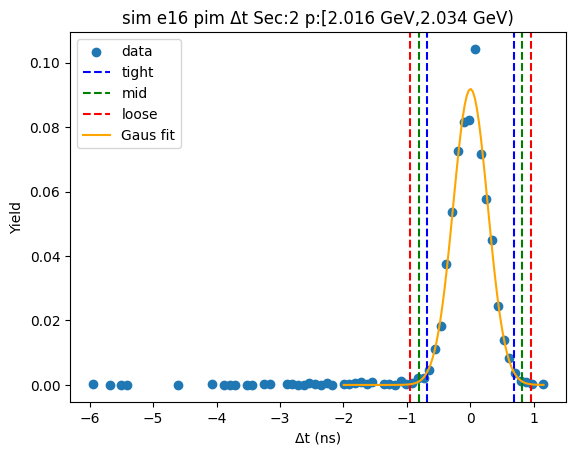

-0.703670453755798 0.7195081494704102
-0.8459883140784187 0.8618260097930309
-0.9883061744010395 1.0041438701156518


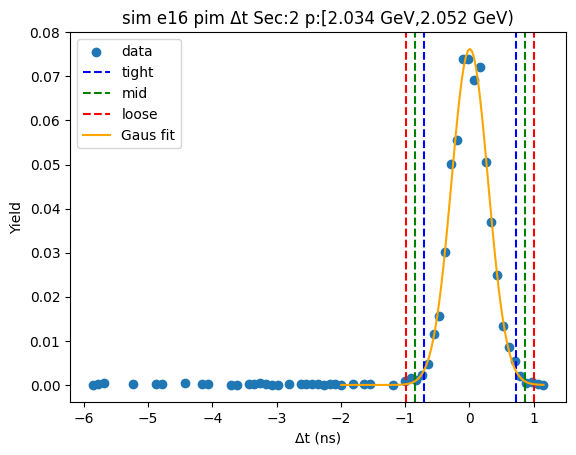

-0.7215674757802113 0.7004984504301734
-0.8637740684012497 0.8427050430512119
-1.0059806610222881 0.9849116356722503


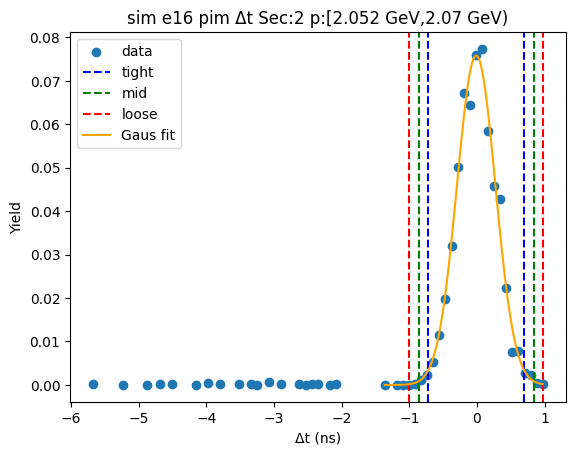

-0.6914899589394952 0.7152436932466546
-0.8321633241581102 0.8559170584652697
-0.9728366893767252 0.9965904236838846


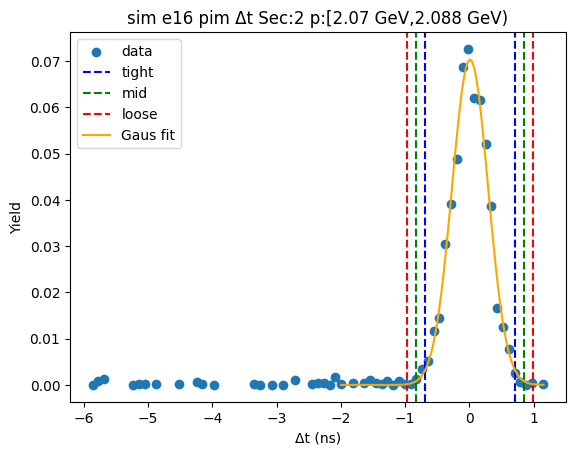

-0.7636496444681329 0.7909409880114084
-0.9191087077160871 0.9464000512593627
-1.074567770964041 1.1018591145073167


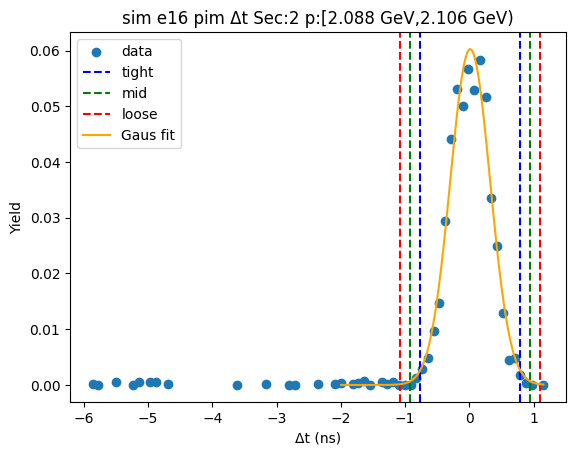

-0.6948967300766657 0.6872173397285013
-0.8331081370571825 0.825428746709018
-0.9713195440376992 0.9636401536895347


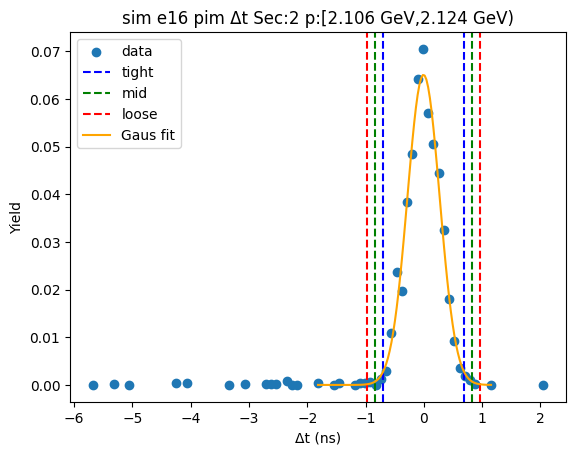

-0.6528243490894244 0.6899658170423918
-0.787103365702606 0.8242448336555733
-0.9213823823157876 0.958523850268755


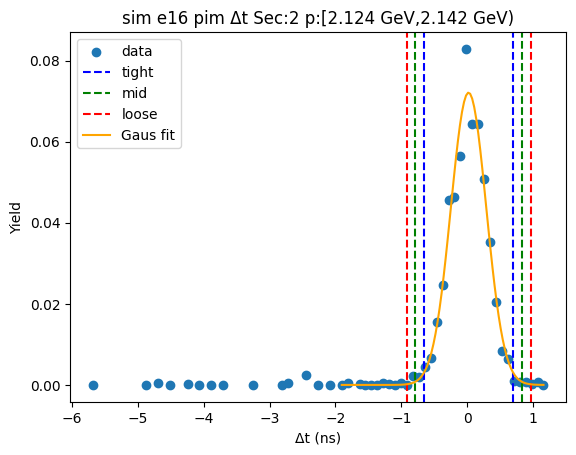

-0.7277087597079592 0.7355632194561641
-0.8740359576243715 0.8818904173725763
-1.020363155540784 1.0282176152889888


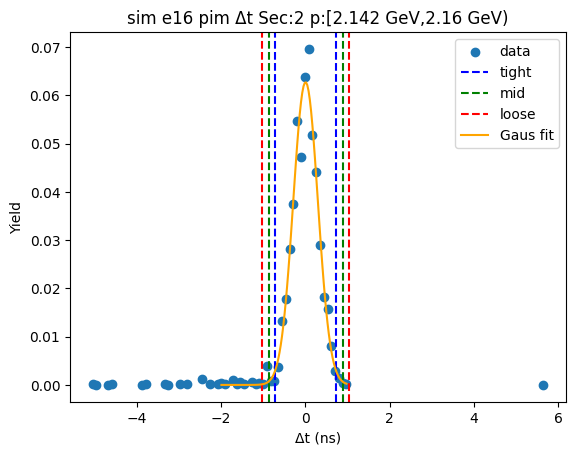

-0.6944347422203258 0.6963951783849484
-0.8335177342808531 0.8354781704454757
-0.9726007263413805 0.9745611625060031


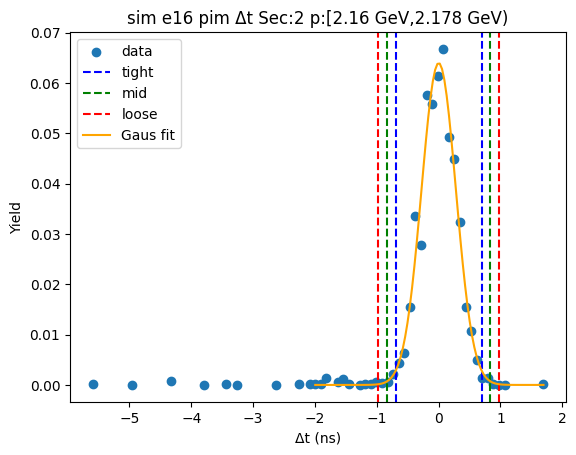

-0.6892804844090769 0.7192974666160331
-0.8301382795115879 0.8601552617185442
-0.970996074614099 1.0010130568210551


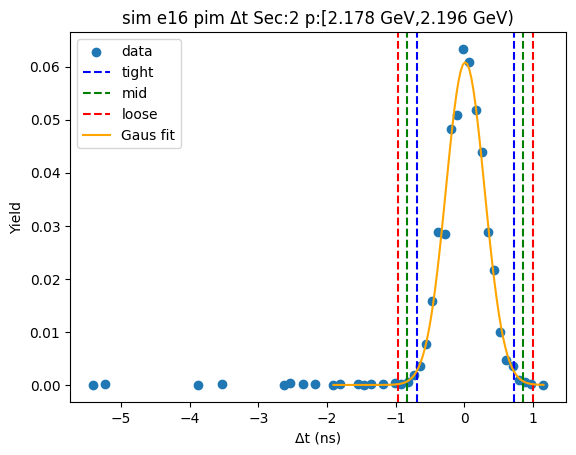

-0.7071790022492721 0.7322055622995793
-0.8511174587041573 0.8761440187544646
-0.9950559151590425 1.0200824752093496


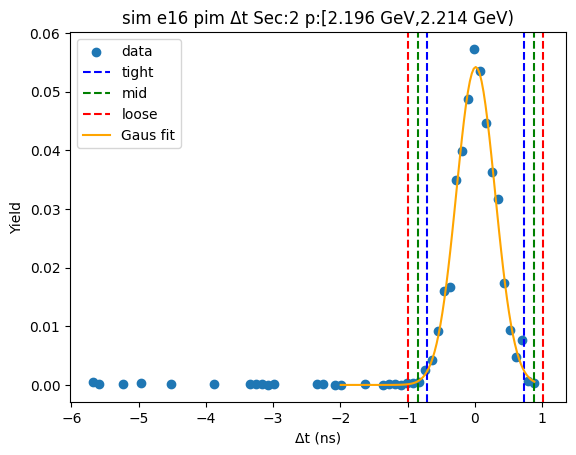

-0.6575061500756274 0.76609813880961
-0.7998665789641511 0.9084585676981337
-0.9422270078526749 1.0508189965866575


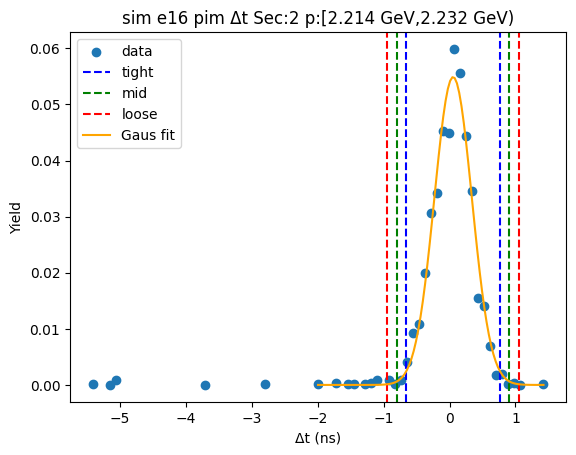

-0.6610515959828535 0.6820990136144499
-0.7953666569425838 0.8164140745741802
-0.9296817179023141 0.9507291355339106


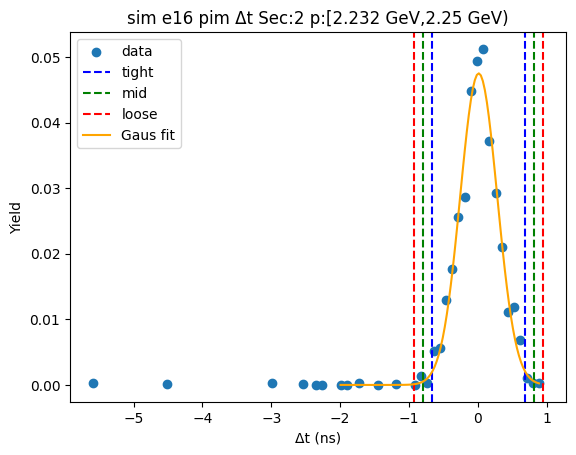

-0.6459446006524626 0.724439212290863
-0.7829829819467953 0.8614775935851957
-0.9200213632411278 0.9985159748795283


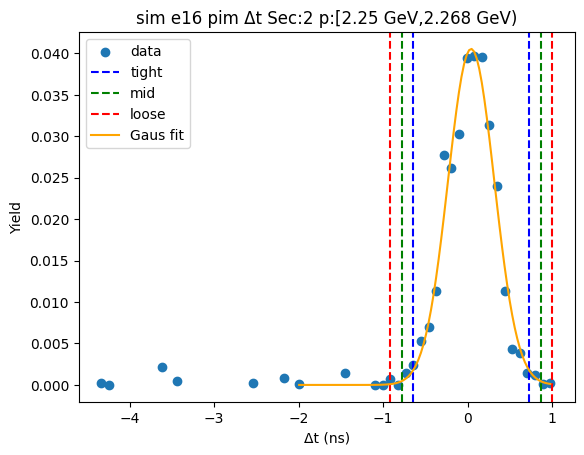

-0.6438385732407181 0.6735835284835319
-0.7755807834131431 0.8053257386559568
-0.907322993585568 0.9370679488283817


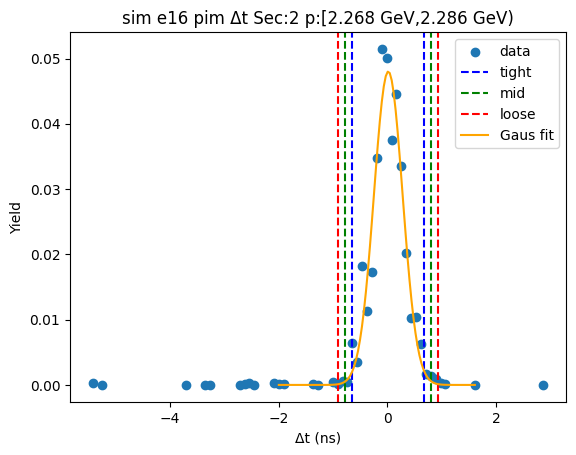

-0.6580454368193377 0.617299434622599
-0.7855799239635313 0.7448339217667925
-0.913114411107725 0.8723684089109862


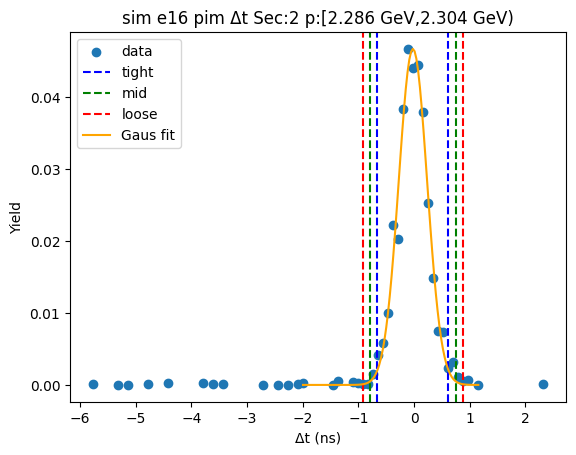

-0.590981473968231 0.7010570426443953
-0.7201853256294937 0.830260894305658
-0.8493891772907564 0.9594647459669207


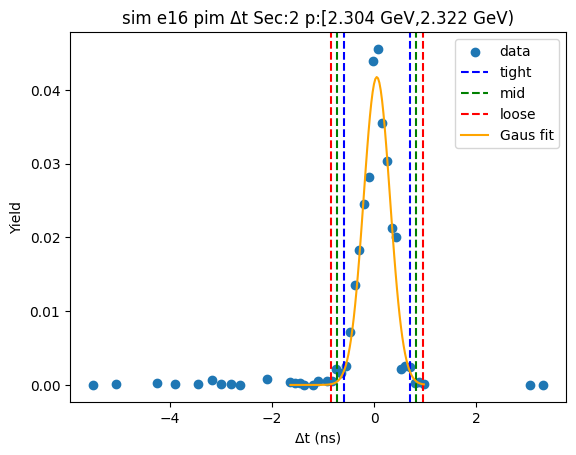

-0.6551062964379658 0.7055420389491146
-0.7911711299766739 0.8416068724878227
-0.927235963515382 0.9776717060265308


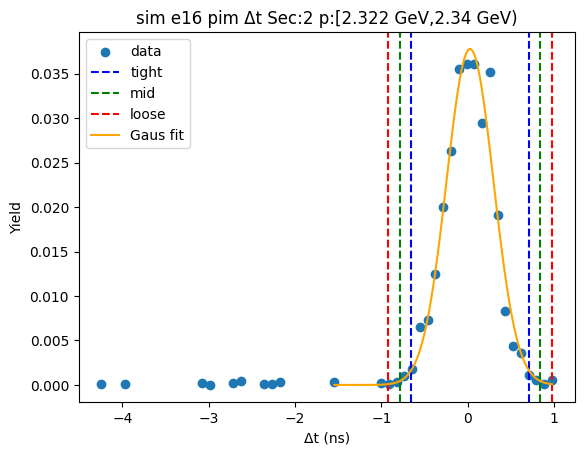

-0.6740761968695227 0.6843147104838471
-0.8099152876048598 0.8201538012191841
-0.9457543783401967 0.9559928919545211


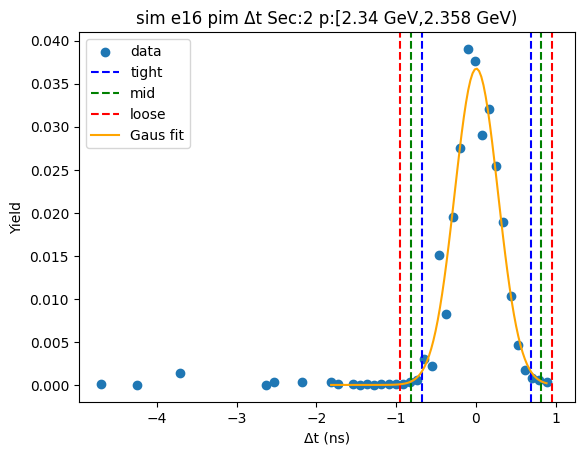

-0.5980319232225267 0.6914155656497812
-0.7269766721097575 0.820360314537012
-0.8559214209969882 0.9493050634242427


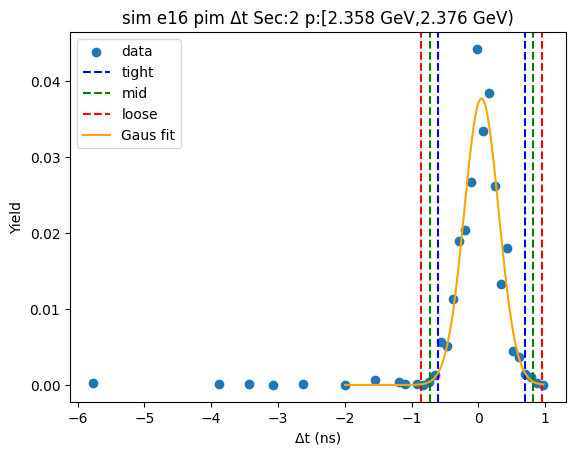

-0.6627358680857223 0.7103077956366508
-0.8000402344579596 0.8476121620088881
-0.9373446008301969 0.9849165283811254


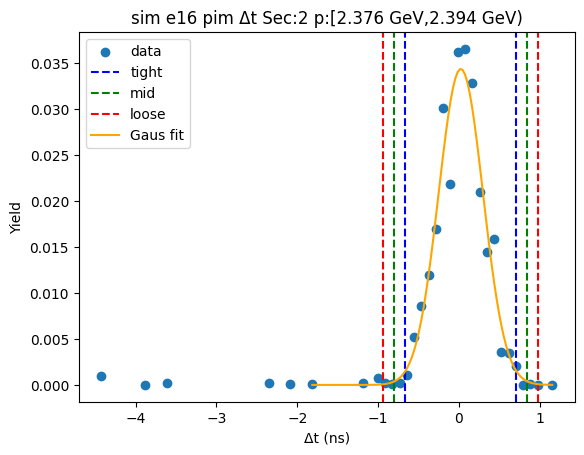

-0.6352966596708371 0.6262061909549836
-0.7614469447334192 0.7523564760175657
-0.8875972297960013 0.8785067610801478


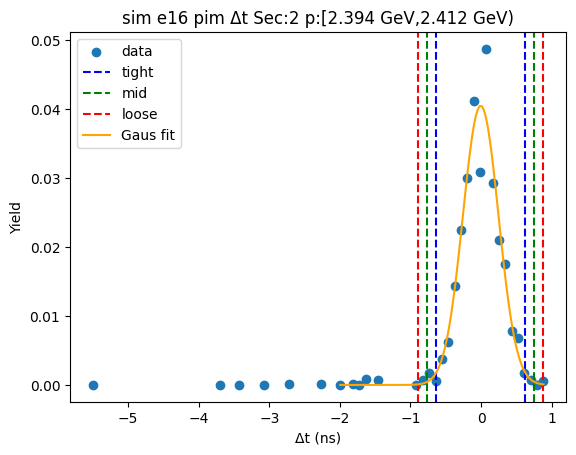

-0.5848431989889573 0.6286701001192905
-0.7061945288997821 0.7500214300301152
-0.8275458588106068 0.87137275994094


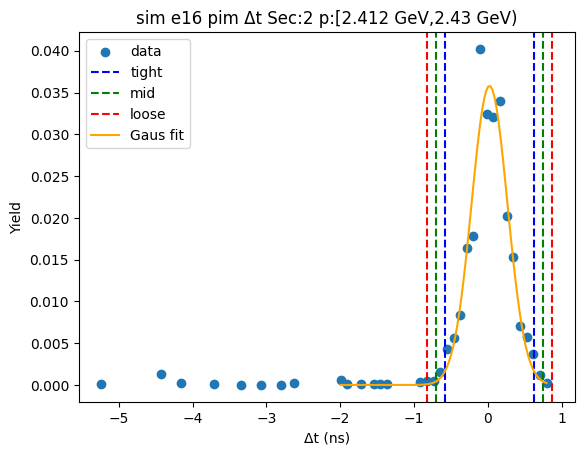

-0.792583611300185 0.755525197514918
-0.9473944921816952 0.9103360783964283
-1.1022053730632055 1.0651469592779386


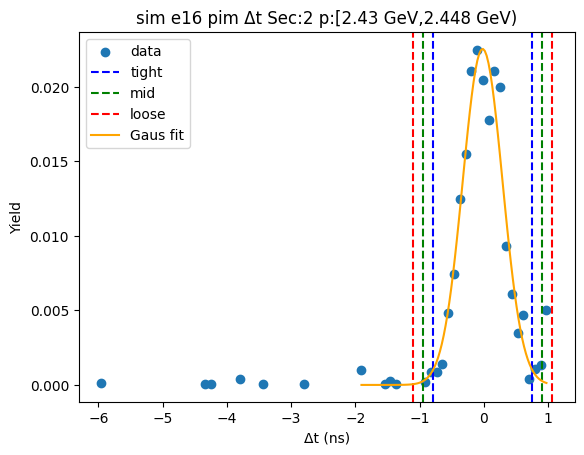

-0.7909525864723851 0.8035008843228938
-0.950397933551913 0.9629462314024217
-1.1098432806314409 1.1223915784819498


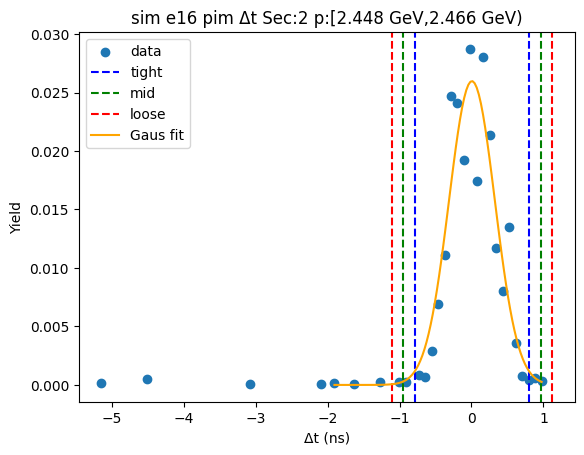

-0.7175206890826827 0.7482472320315489
-0.8640974811941059 0.894824024142972
-1.010674273305529 1.0414008162543953


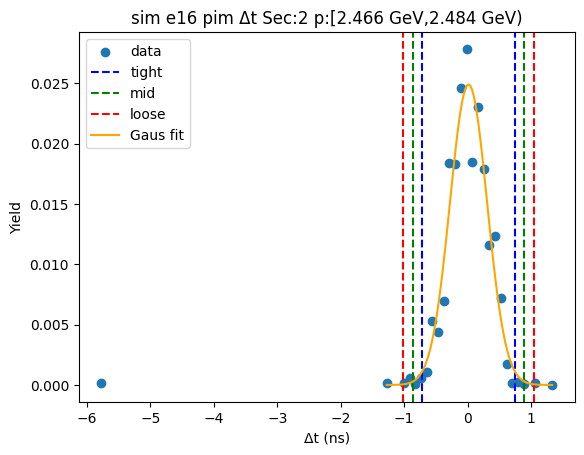

-0.6713395451973364 0.7121638730229168
-0.8096898870193617 0.8505142148449422
-0.9480402288413871 0.9888645566669675


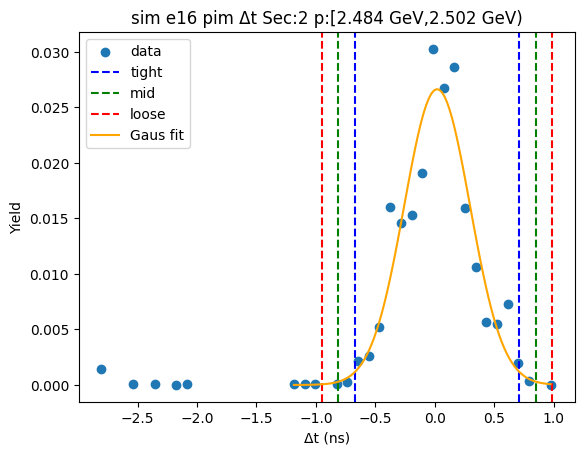

-0.7081395780315853 0.722295838995425
-0.8511831197342863 0.865339380698126
-0.9942266614369875 1.0083829224008272


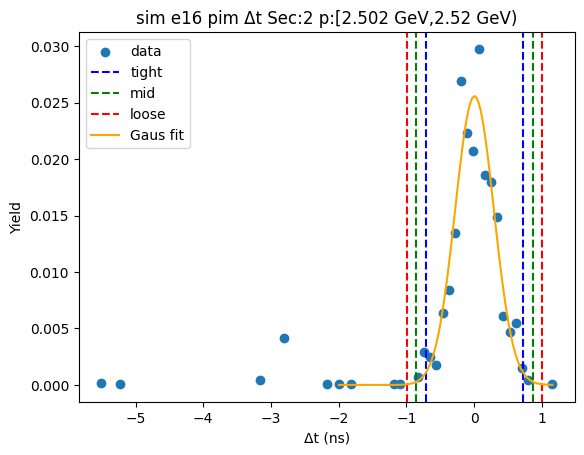

-0.7162449103640482 0.6996650118055341
-0.8578359025810064 0.8412560040224922
-0.9994268947979646 0.9828469962394505


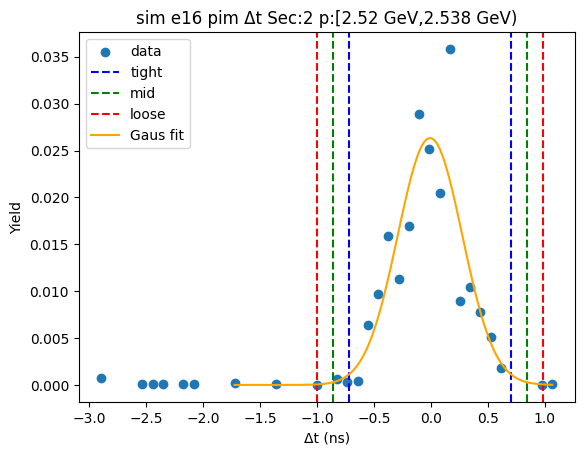

-0.7425088044865461 0.6900935872701087
-0.8857690436622117 0.8333538264457743
-1.0290292828378773 0.9766140656214398


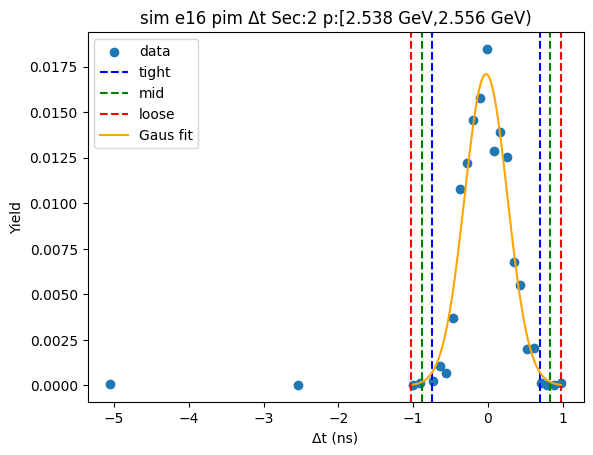

-0.6823535175649407 0.6516898309816279
-0.8157578524195975 0.7850941658362848
-0.9491621872742544 0.9184985006909416


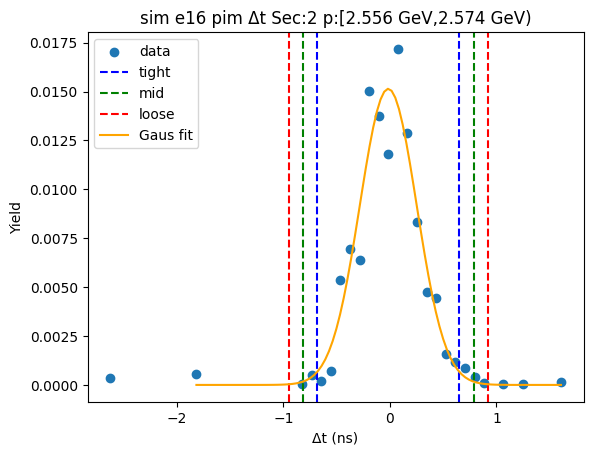

-0.8180819470793727 0.7891079150387291
-0.9788009332911829 0.9498269012505394
-1.1395199195029933 1.1105458874623495


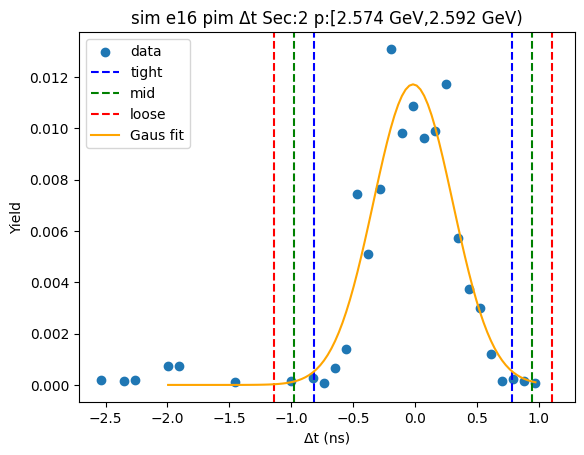

-0.8252581975859541 0.8435997237997701
-0.9921439897245263 1.0104855159383423
-1.1590297818630988 1.1773713080769148


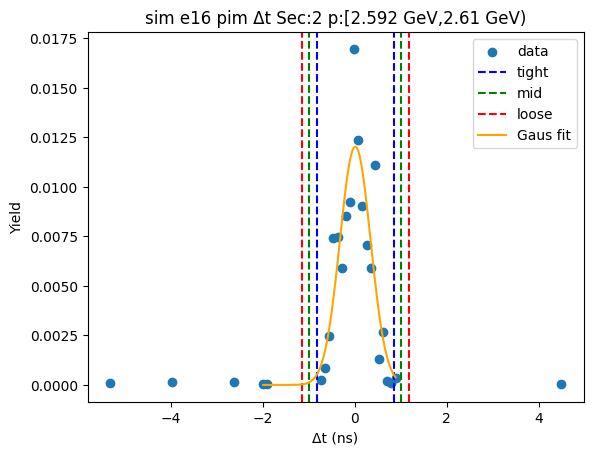

-0.6577057738893228 0.7077386388249778
-0.7942502151607529 0.8442830800964078
-0.930794656432183 0.9808275213678379


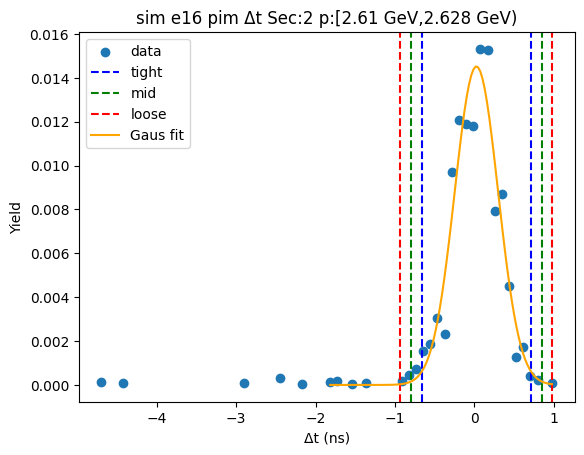

-0.8424894931804754 0.9254441848048038
-1.0192828609790032 1.1022375526033317
-1.1960762287775313 1.2790309204018597


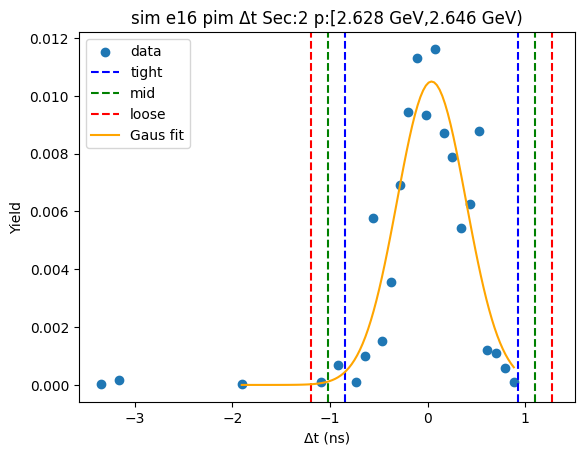

-0.8354917007252686 0.7473007209454968
-0.993770942892345 0.9055799631125733
-1.1520501850594216 1.06385920527965


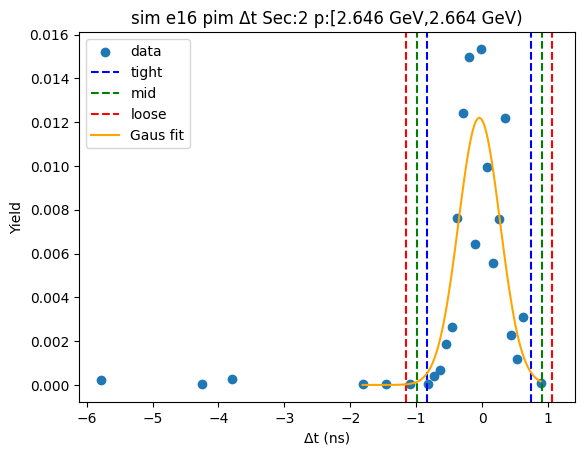

-0.67627999712247 0.7225803465022405
-0.816166031484941 0.8624663808647115
-0.9560520658474121 1.0023524152271825


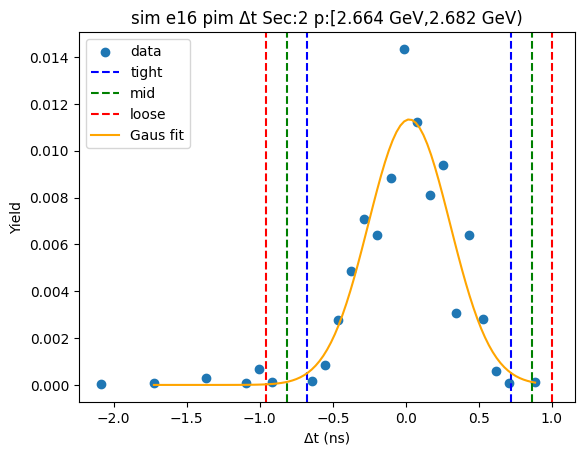

-0.3635799016790084 0.44208664896522515
-0.4441465567434318 0.5226533040296486
-0.524713211807855 0.6032199590940719


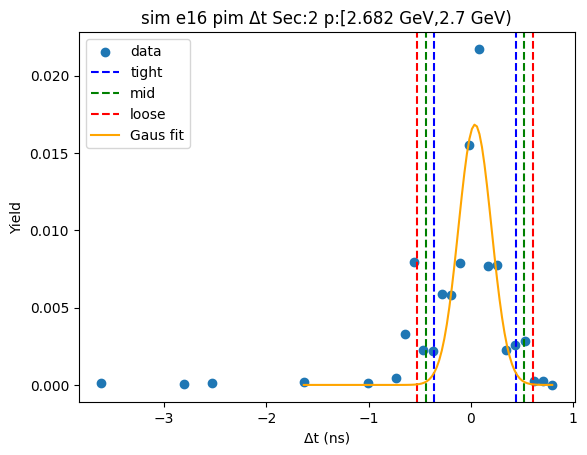

-0.7575332339061281 0.6276235076007385
-0.8960489080568148 0.7661391817514251
-1.0345645822075014 0.9046548559021118


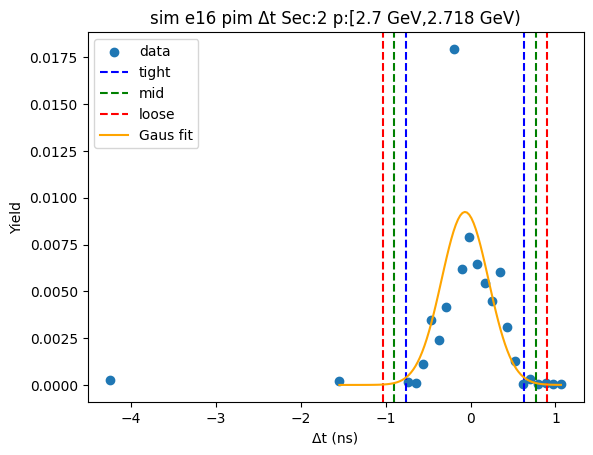

-0.5937637423135634 0.8012532117159746
-0.7332654377165173 0.9407549071189285
-0.8727671331194712 1.0802566025218825


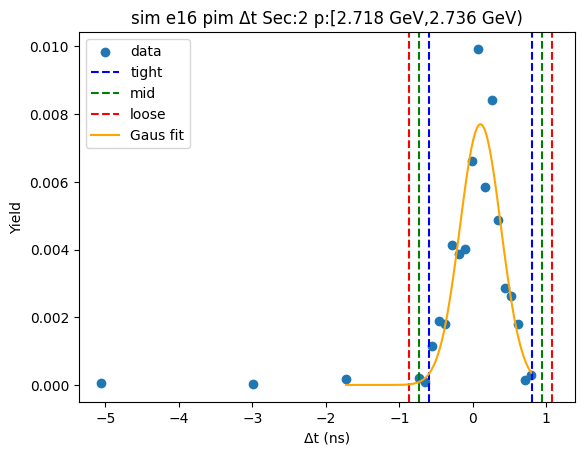

-0.6513029875002587 0.6283390132397537
-0.7792671875742601 0.756303213313755
-0.9072313876482613 0.8842674133877563


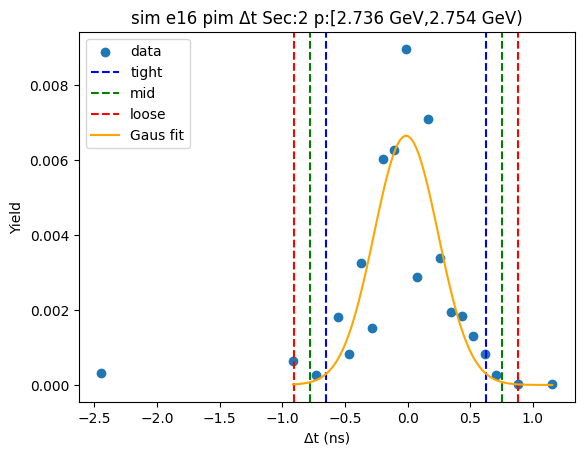

-0.6150211391282164 0.6909648015793747
-0.7456197331989755 0.8215633956501337
-0.8762183272697346 0.9521619897208928


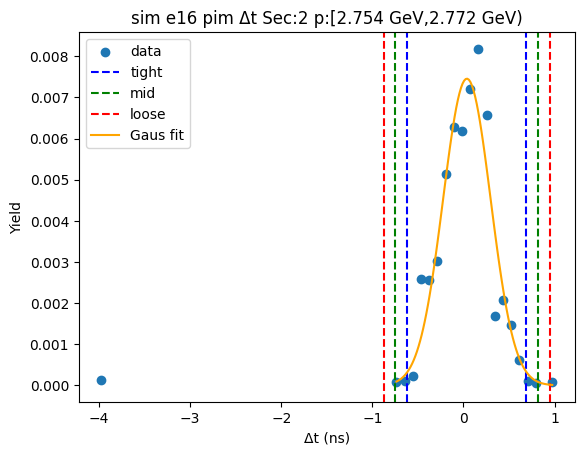

-0.7924984654345476 0.8898128324117308
-0.9607295952191754 1.0580439621963587
-1.1289607250038032 1.2262750919809864


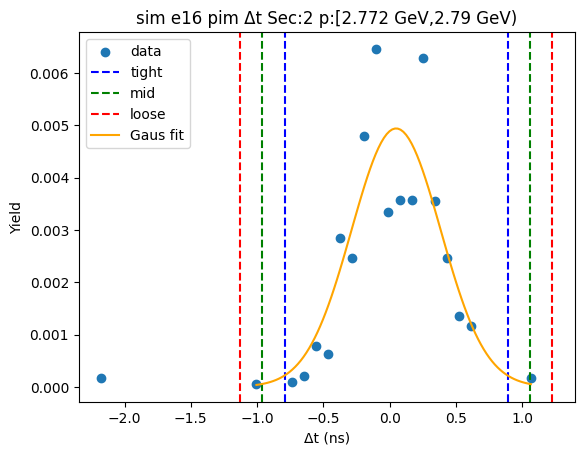

-0.7247595550949727 0.7554610576442459
-0.8727816163688946 0.9034831189181678
-1.0208036776428164 1.0515051801920898


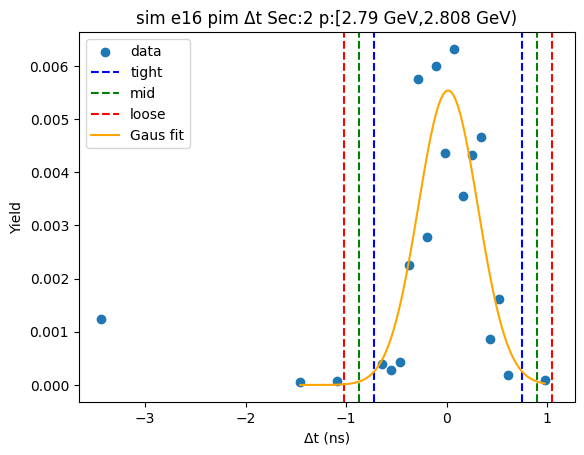

-0.6318788250972321 0.7108024620762611
-0.7661469538145815 0.8450705907936105
-0.9004150825319309 0.9793387195109599


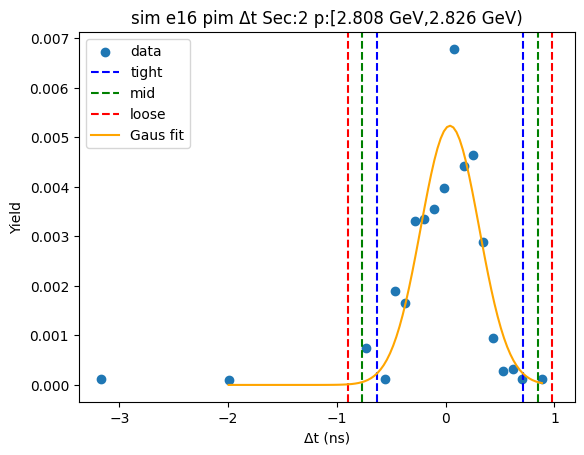

-0.860603161847112 0.8627824328727737
-1.0329417213191006 1.035120992344762
-1.2052802807910892 1.2074595518167506


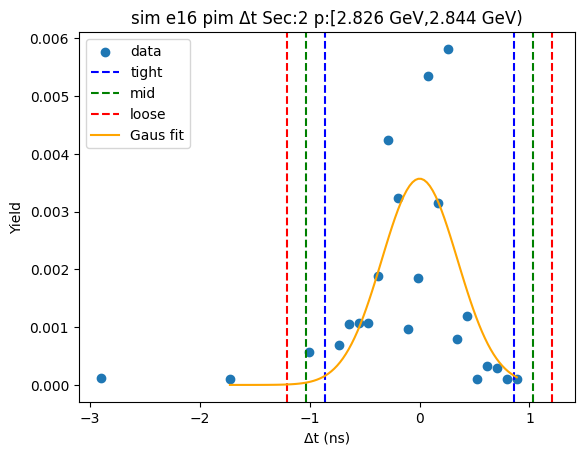

-0.6605823614223991 0.6845854165842276
-0.7950991392230619 0.8191021943848903
-0.9296159170237246 0.953618972185553


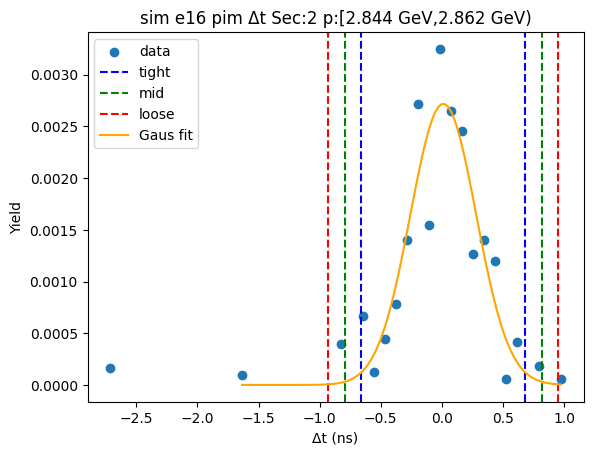

-0.6884247350669315 0.6268382294793791
-0.8199510315215625 0.75836452593401
-0.9514773279761934 0.889890822388641


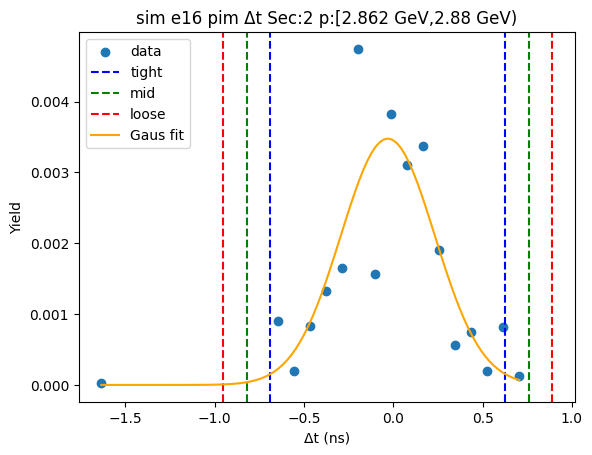

-0.9636779529891801 1.0584794533730633
-1.1658936936254043 1.2606951940092874
-1.3681094342616287 1.4629109346455118


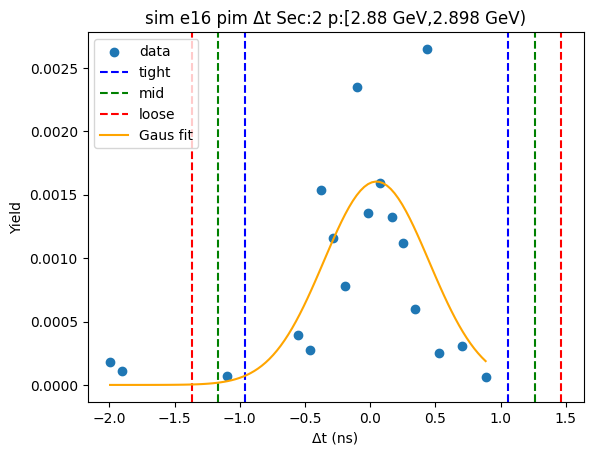

-0.8919749990427069 0.8083217499010314
-1.062004673937081 0.9783514247954054
-1.2320343488314547 1.148381099689779


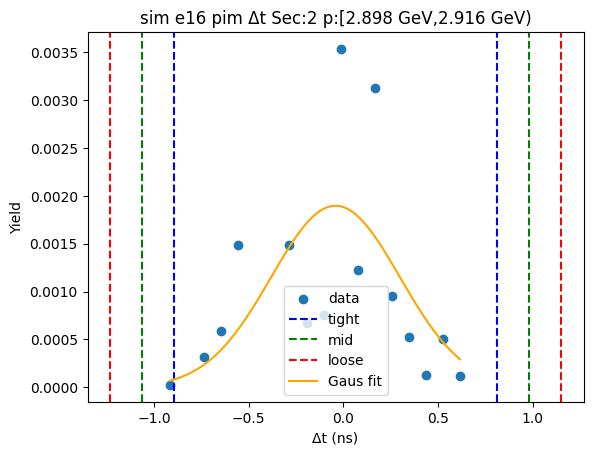

-0.6244710691568146 0.7476378695181428
-0.7616819630243103 0.8848487633856386
-0.8988928568918061 1.0220596572531344


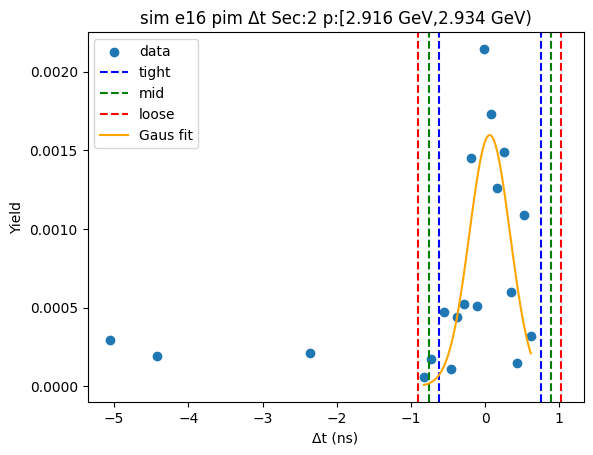

-0.5824377758479011 0.49948602320666957
-0.6906301557533583 0.6076784031121267
-0.7988225356588153 0.7158707830175838


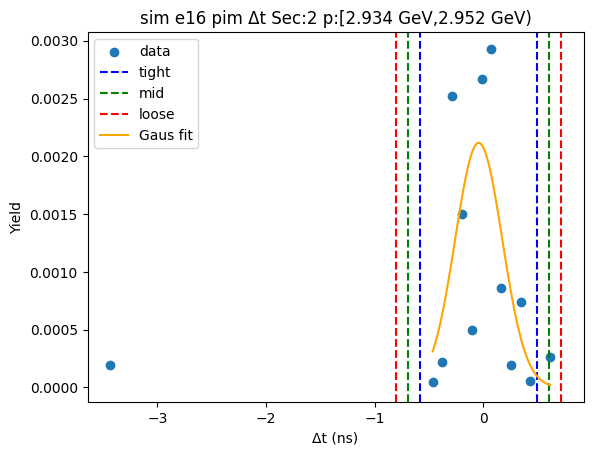

-0.5844707362728709 0.7024021351048702
-0.713158023410645 0.8310894222426443
-0.8418453105484192 0.9597767093804184


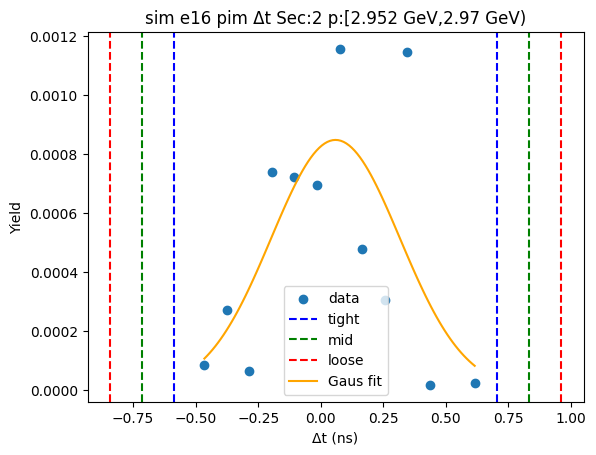

-0.04965202869400703 0.31217203850936337
-0.08583443541434407 0.3483544452297004
-0.12201684213468114 0.3845368519500375


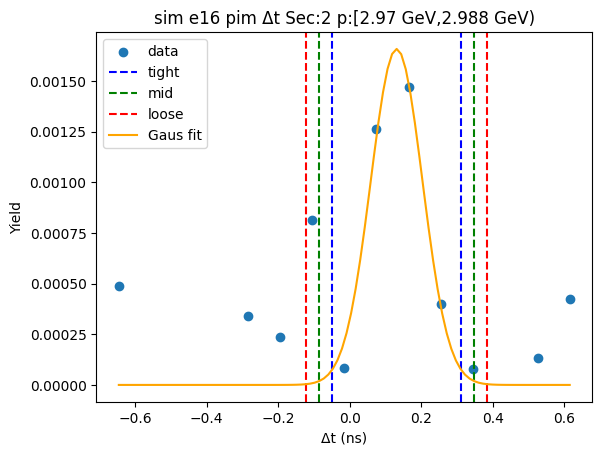

-0.89316730939891 0.8126503607332026
-1.0637490764121211 0.9832321277464139
-1.2343308434253324 1.1538138947596253


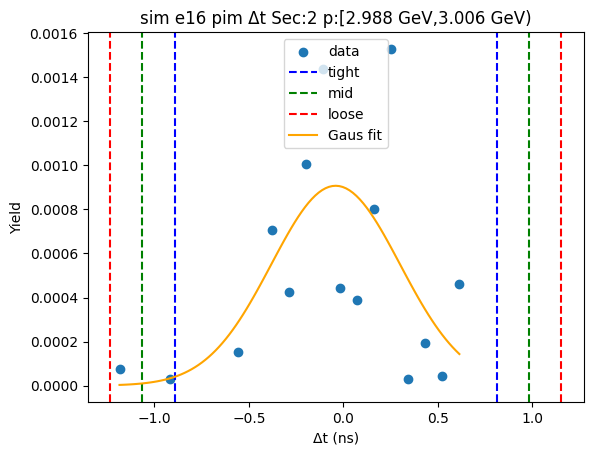

-0.9418216887280239 0.9610392653420118
-1.1321077841350273 1.1513253607490153
-1.322393879542031 1.3416114561560188


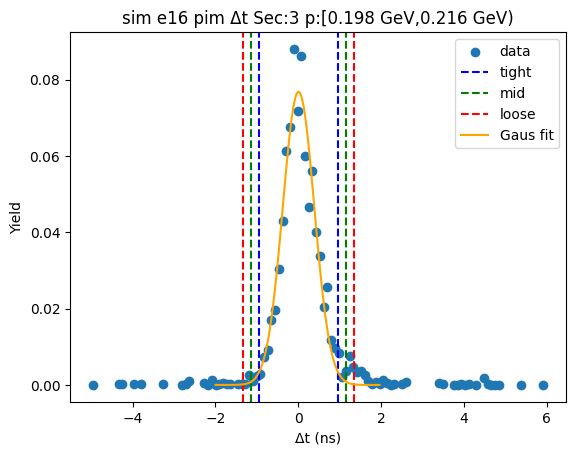

-0.9211982353877459 0.9911928234790777
-1.1124373412744284 1.18243192936576
-1.3036764471611106 1.3736710352524422


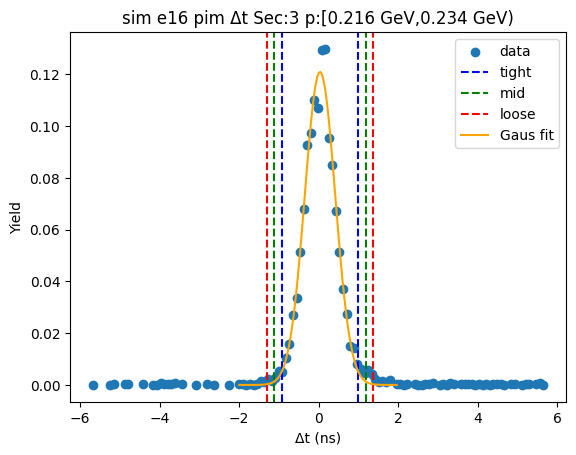

-0.9052620445368404 0.9200891722681339
-1.0877971662173378 1.1026242939486313
-1.2703322878978354 1.2851594156291288


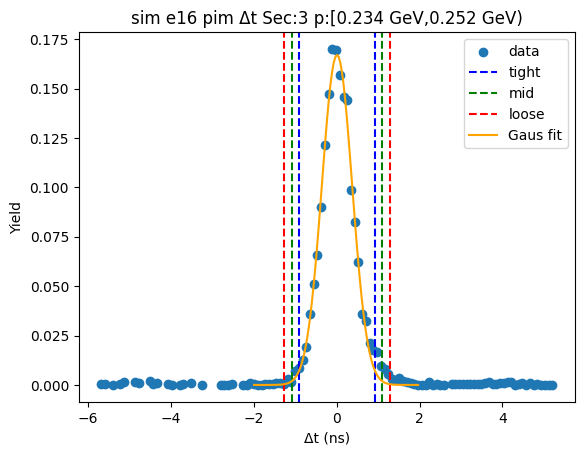

-0.8822830211621266 0.8850431740614597
-1.0590156406844853 1.0617757935838184
-1.235748260206844 1.238508413106177


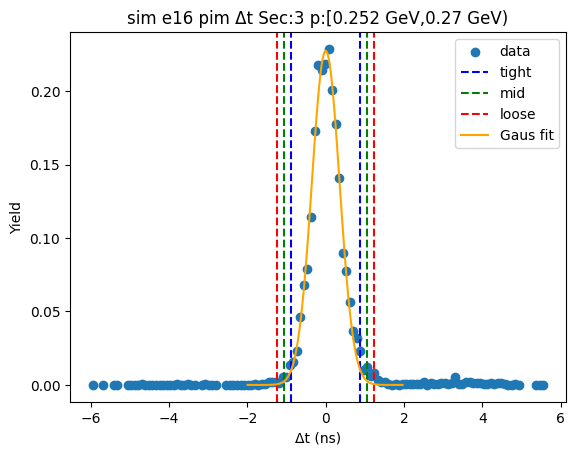

-0.8432729030253865 0.8813289923330776
-1.015733092561233 1.053789181868924
-1.1881932820970793 1.2262493714047704


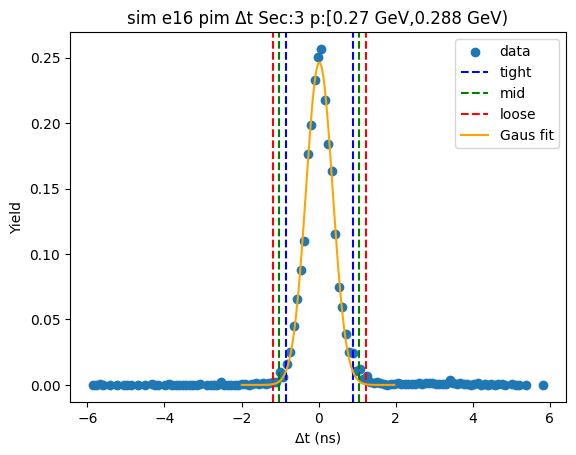

-0.825508603156454 0.8491958070148933
-0.9929790441735888 1.016666248032028
-1.1604494851907234 1.1841366890491627


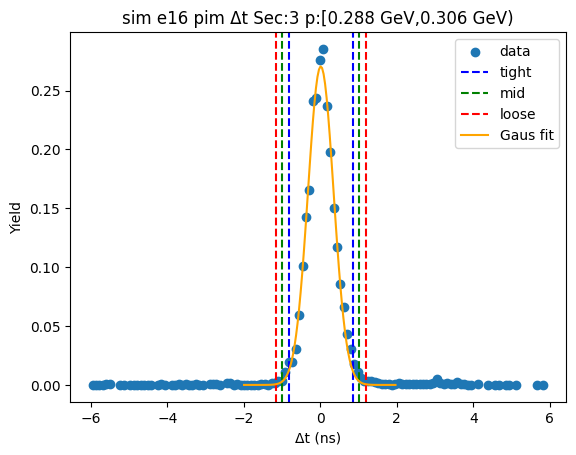

-0.8084828751623098 0.8461298755795817
-0.9739441502364988 1.011591150653771
-1.139405425310688 1.1770524257279602


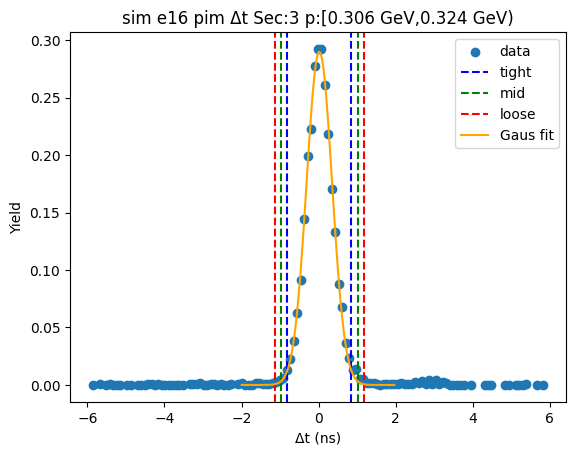

-0.8021966711025001 0.8479399993089918
-0.9672103381436494 1.012953666350141
-1.1322240051847985 1.1779673333912901


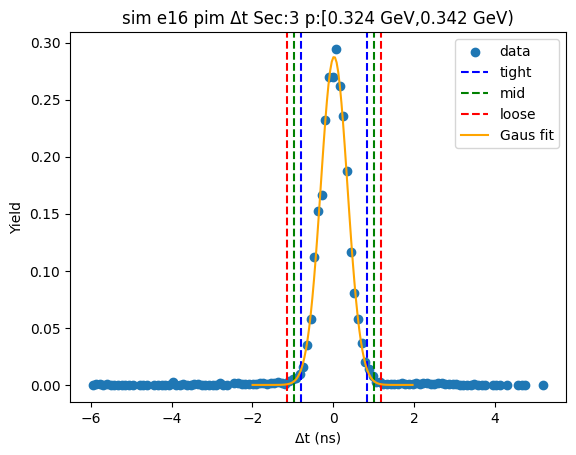

-0.8134699912807623 0.8521084587917155
-0.9800278362880099 1.0186663037989632
-1.1465856812952577 1.185224148806211


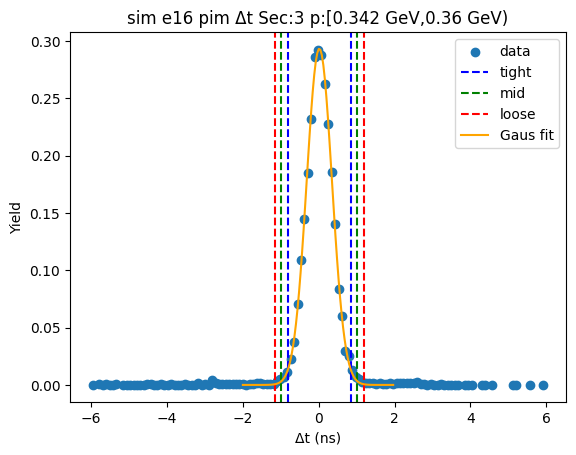

-0.7787393739790752 0.818633619131297
-0.9384766732901125 0.9783709184423343
-1.0982139726011495 1.1381082177533715


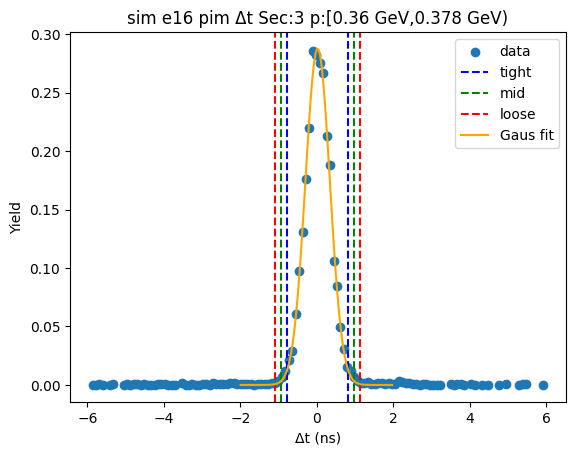

-0.7940665776467376 0.8246464311693341
-0.9559378785283448 0.9865177320509413
-1.1178091794099518 1.1483890329325483


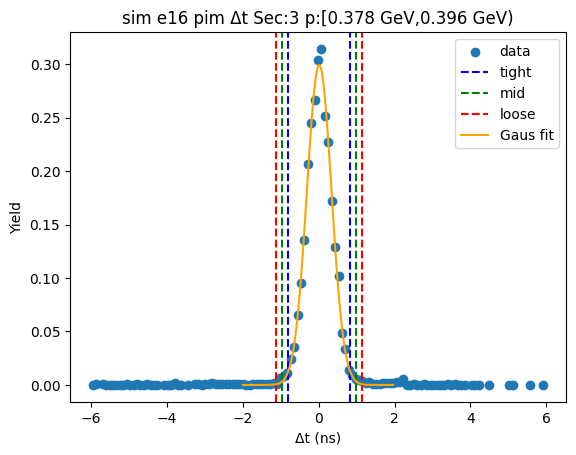

-0.7765783123660378 0.8181341205861558
-0.9360495556612572 0.9776053638813752
-1.0955207989564764 1.1370766071765945


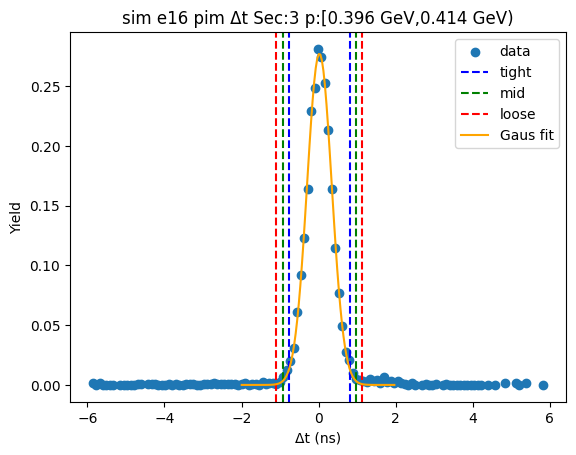

-0.7593670900430842 0.811494730438727
-0.9164532720912653 0.968580912486908
-1.0735394541394465 1.1256670945350893


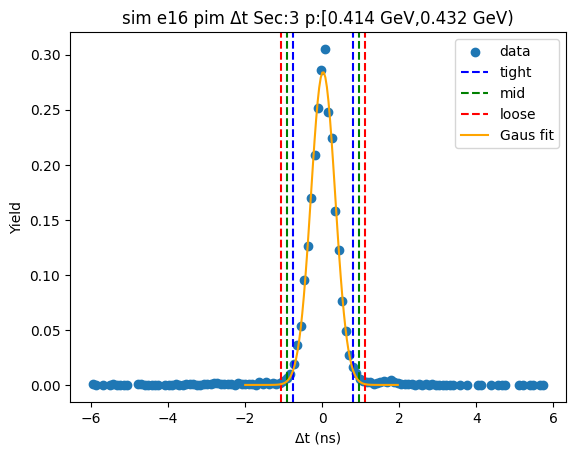

-0.7764313356632799 0.8138243751652885
-0.9354569067461367 0.9728499462481452
-1.0944824778289937 1.1318755173310022


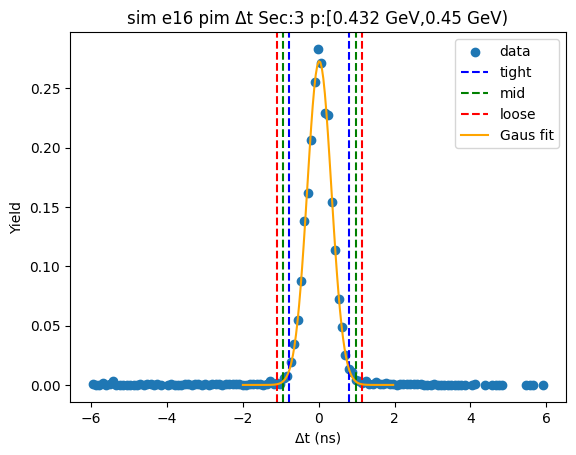

-0.7725160837845702 0.7931889707303112
-0.9290865892360584 0.9497594761817995
-1.0856570946875466 1.1063299816332877


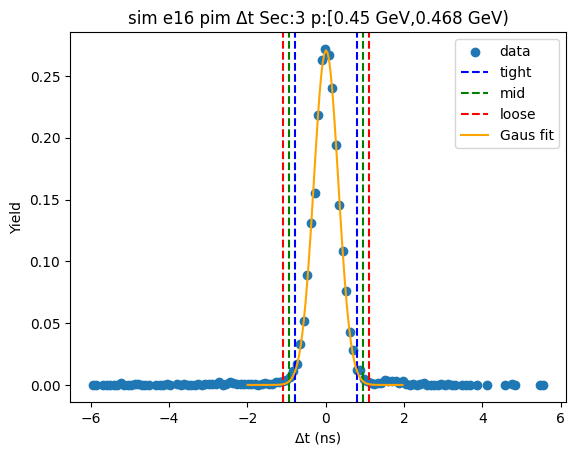

-0.7851966397776128 0.8005931512382917
-0.9437756188792031 0.959172130339882
-1.1023545979807938 1.1177511094414725


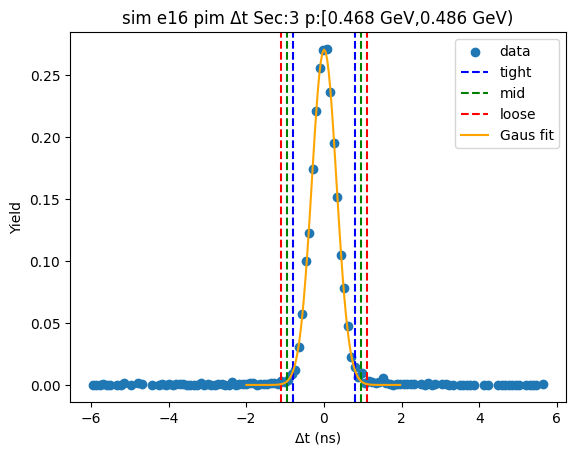

-0.7672213635686977 0.80367554692935
-0.9243110546185026 0.9607652379791548
-1.0814007456683072 1.1178549290289597


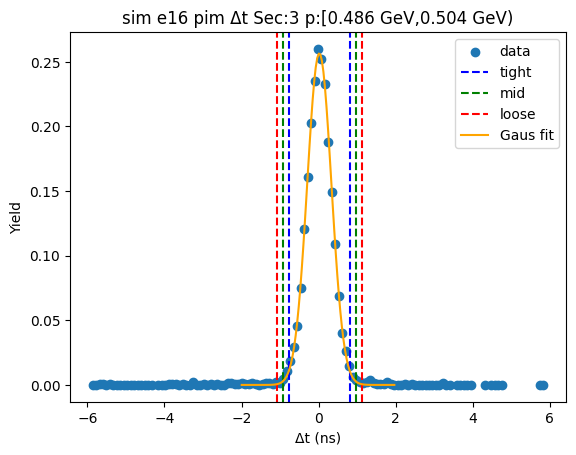

-0.771834444606958 0.78220886230232
-0.9272387752978858 0.9376131929932477
-1.0826431059888135 1.0930175236841755


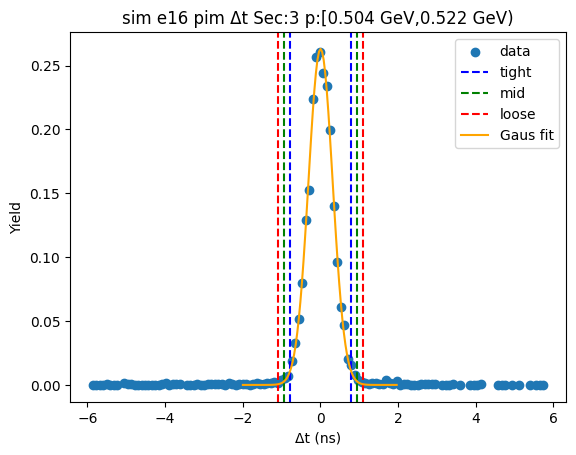

-0.7750688281542888 0.7950029952730104
-0.9320760104970187 0.9520101776157404
-1.0890831928397486 1.1090173599584703


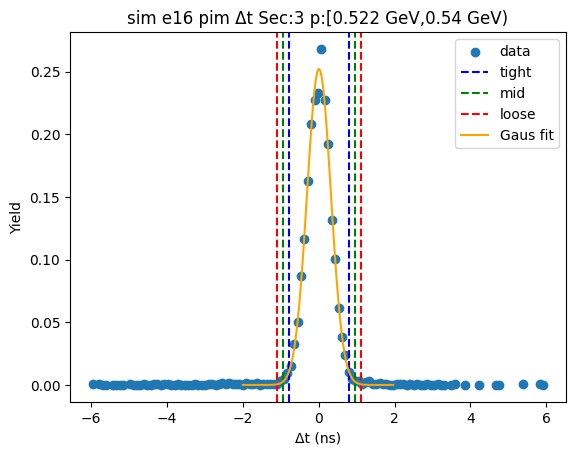

-0.7695727150508781 0.769556862869678
-0.9234856728429337 0.9234698206617336
-1.0773986306349894 1.0773827784537893


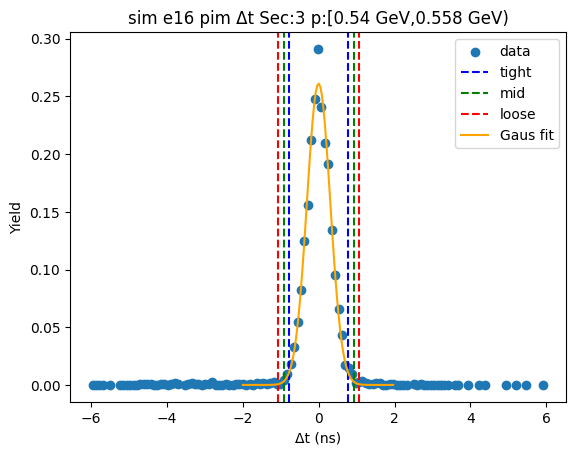

-0.7820943347140055 0.7928017437596895
-0.9395839425613749 0.9502913516070589
-1.0970735504087443 1.1077809594544283


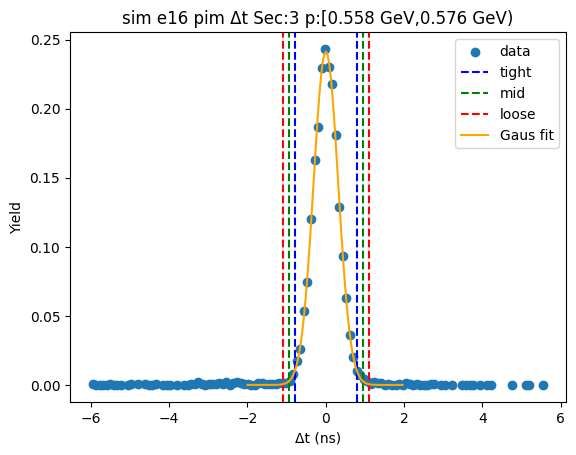

-0.7855285200002949 0.7904989742616714
-0.9431312694264915 0.9481017236878679
-1.1007340188526882 1.1057044731140644


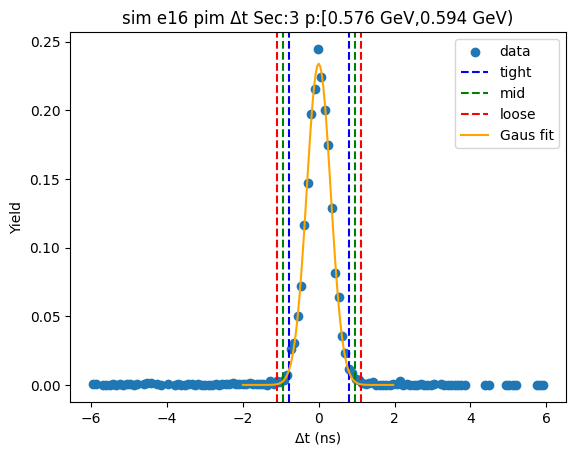

-0.7935510496700623 0.8083018638003739
-0.9537363410171059 0.9684871551474176
-1.1139216323641496 1.128672446494461


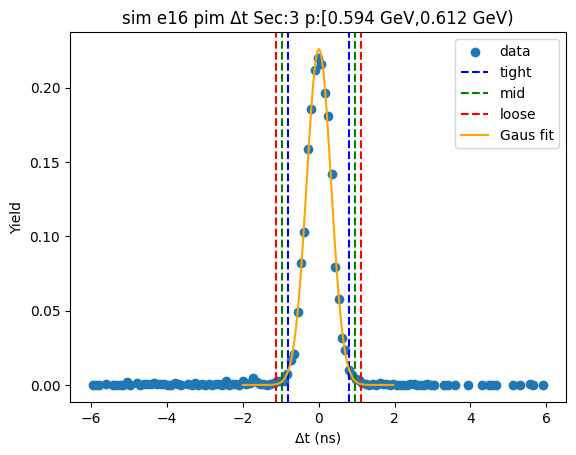

-0.7588712977882816 0.7897548342296327
-0.9137339109900731 0.9446174474314242
-1.0685965241918645 1.0994800606332156


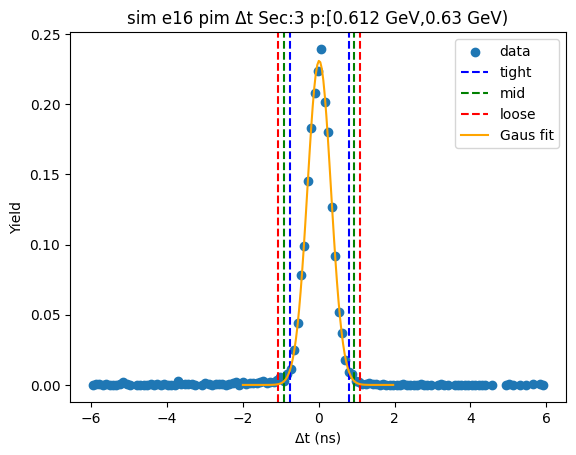

-0.769229331572812 0.7996268146310386
-0.926114946193197 0.9565124292514235
-1.0830005608135822 1.1133980438718087


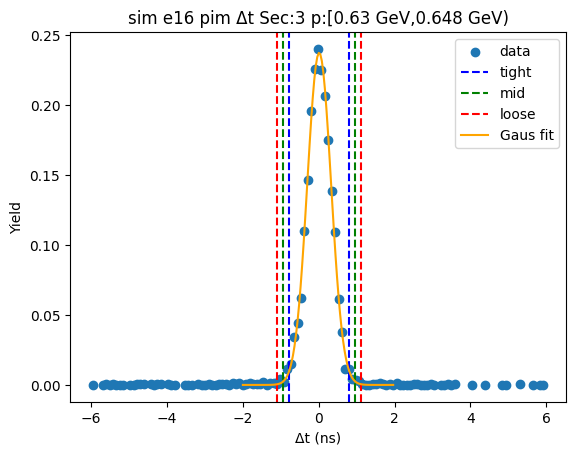

-0.7520767428432323 0.7685147884545694
-0.9041358959730126 0.9205739415843497
-1.0561950491027927 1.07263309471413


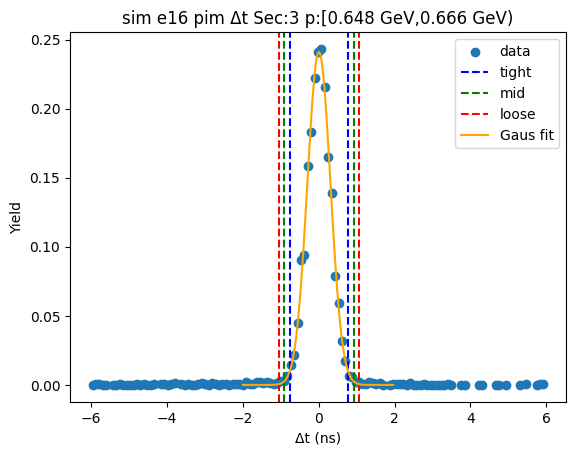

-0.7896407900626968 0.795824511291039
-0.9481873201980705 0.9543710414264127
-1.1067338503334438 1.1129175715617863


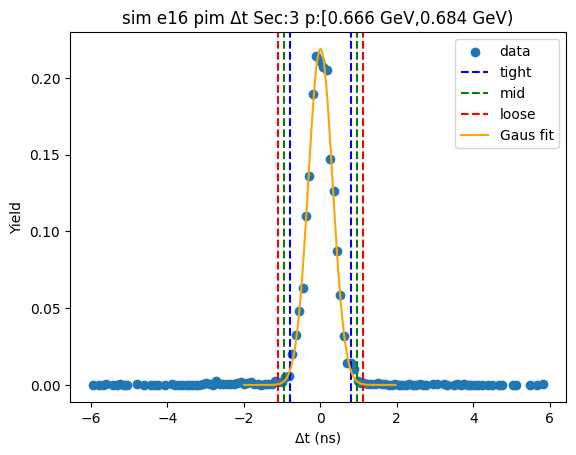

-0.7663525224326078 0.7916648828216957
-0.922154262958038 0.947466623347126
-1.0779560034834683 1.1032683638725562


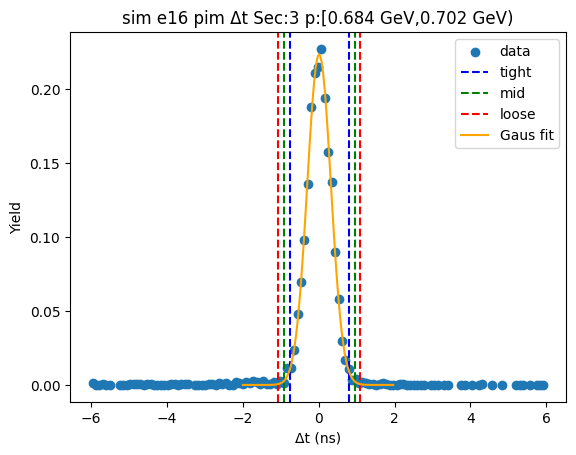

-0.76975192221581 0.7866247514678739
-0.9253895895841785 0.9422624188362424
-1.0810272569525468 1.0979000862046109


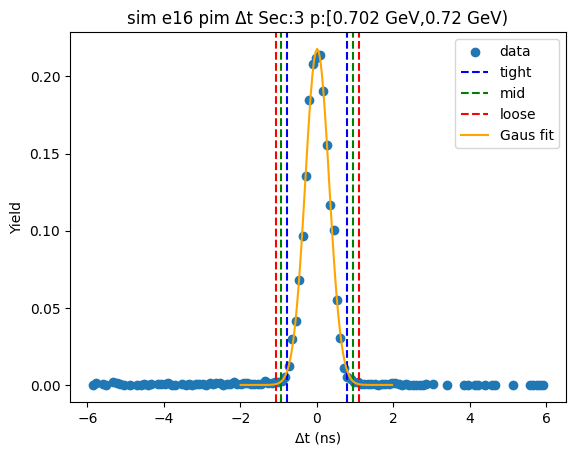

-0.7527660407945054 0.7760915530851435
-0.9056518001824703 0.9289773124731084
-1.0585375595704352 1.0818630718610733


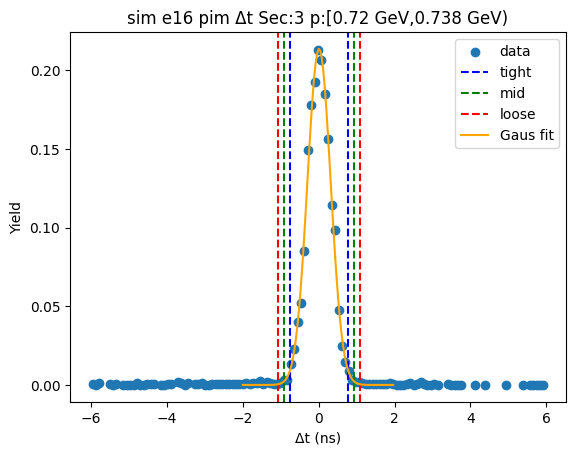

-0.7834441706388393 0.7808278511679729
-0.9398713728195206 0.9372550533486542
-1.096298575000202 1.0936822555293355


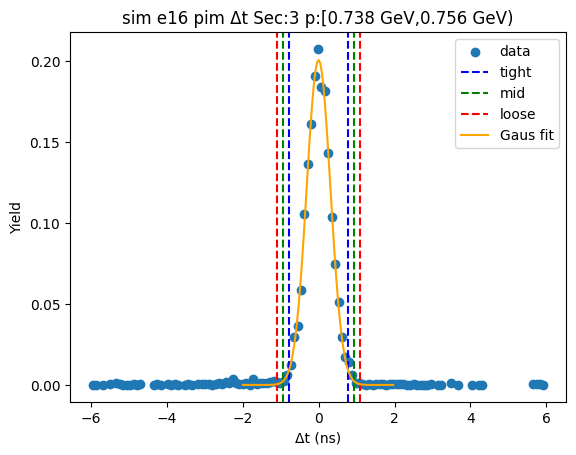

-0.737019210949489 0.7478969832679595
-0.8855108303712339 0.8963886026897044
-1.0340024497929785 1.0448802221114493


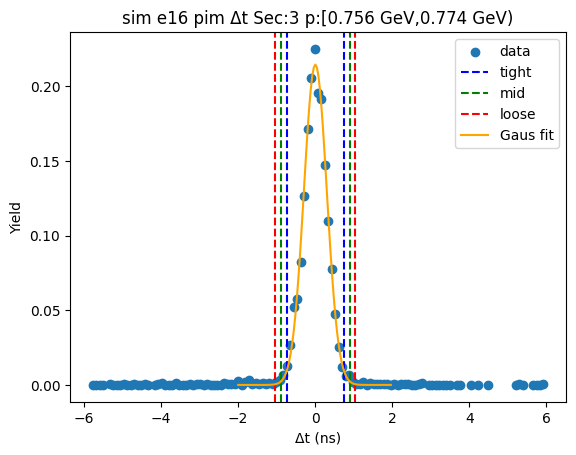

-0.7773033250211577 0.7858629612486036
-0.9336199536481338 0.9421795898755796
-1.08993658227511 1.0984962185025557


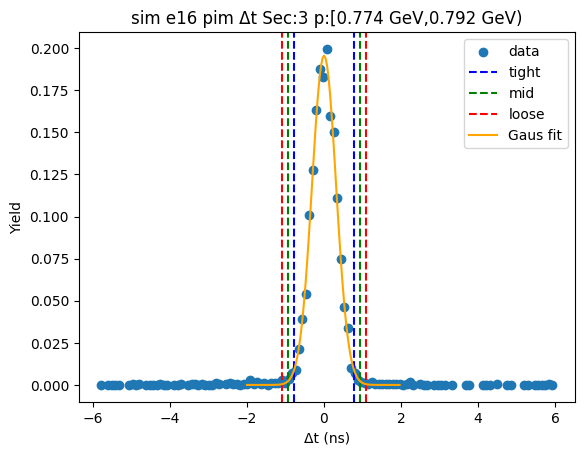

-0.7442711783124681 0.740090859783925
-0.8927073821221075 0.8885270635935644
-1.0411435859317466 1.0369632674032037


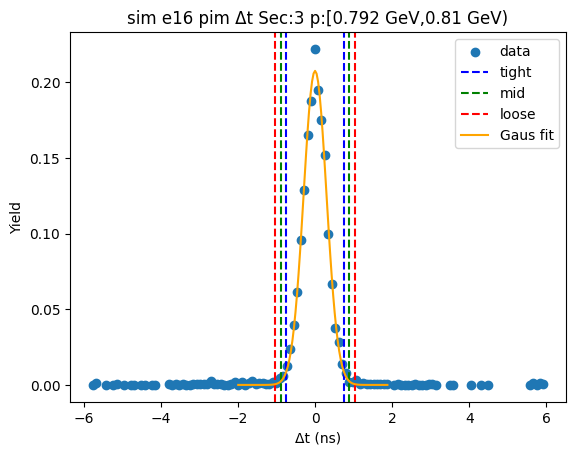

-0.7402786533888416 0.7696253067628732
-0.891269049404013 0.9206157027780446
-1.0422594454191845 1.071606098793216


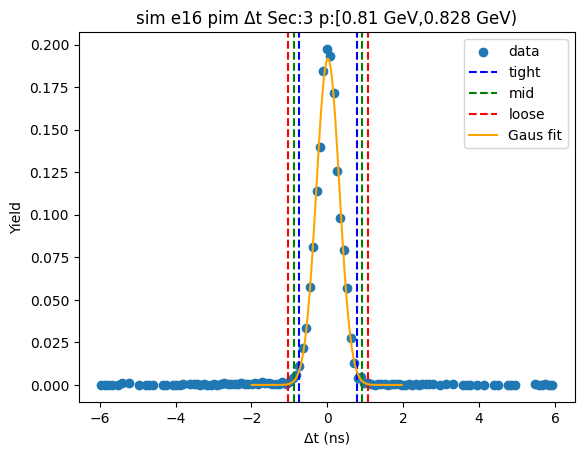

-0.7614096255126747 0.7813599220854918
-0.9156865802724914 0.9356368768453085
-1.069963535032308 1.0899138316051251


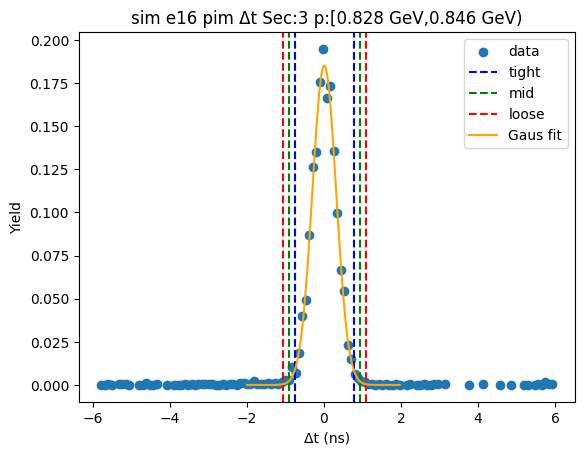

-0.7691612494828317 0.7861176278082103
-0.9246891372119359 0.9416455155373145
-1.08021702494104 1.0971734032664187


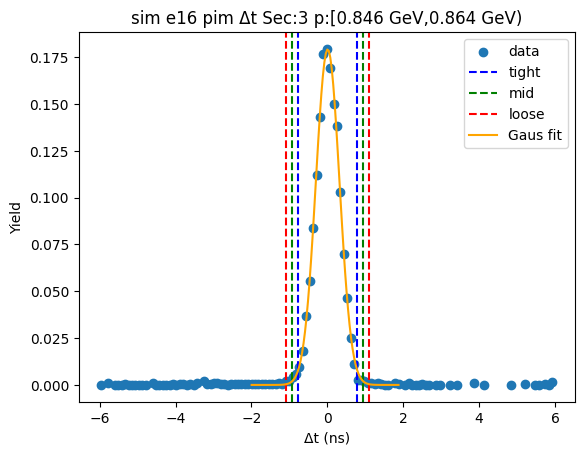

-0.7575054632753253 0.7591515741181944
-0.9091711670146774 0.9108172778575465
-1.0608368707540292 1.0624829815968984


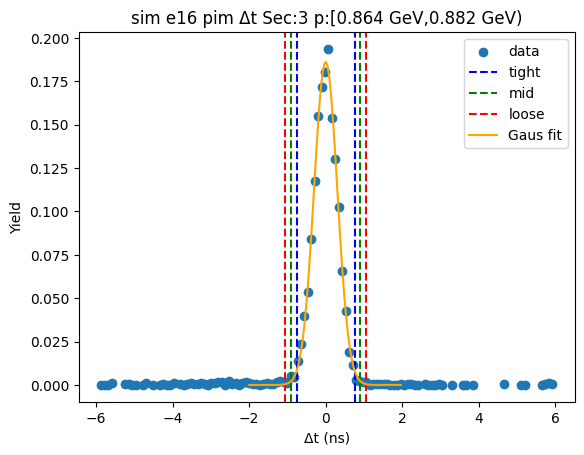

-0.74791893512689 0.7844340695538663
-0.9011542355949655 0.9376693700219418
-1.0543895360630413 1.0909046704900176


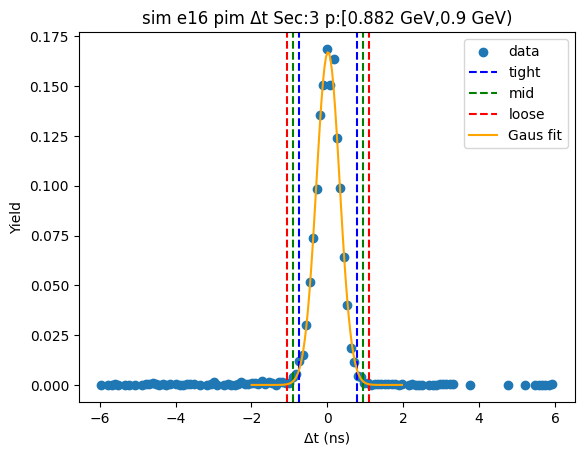

-0.7414283230421227 0.7605212187751954
-0.8916232772238546 0.9107161729569273
-1.0418182314055864 1.060911127138659


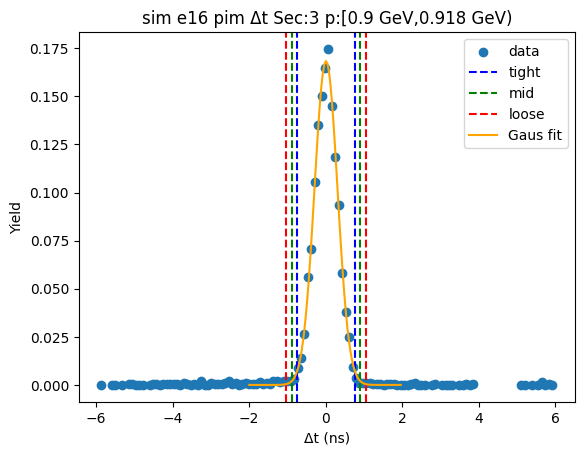

-0.7549490965609424 0.7496904375004931
-0.9054130499670859 0.9001543909066366
-1.0558770033732294 1.0506183443127801


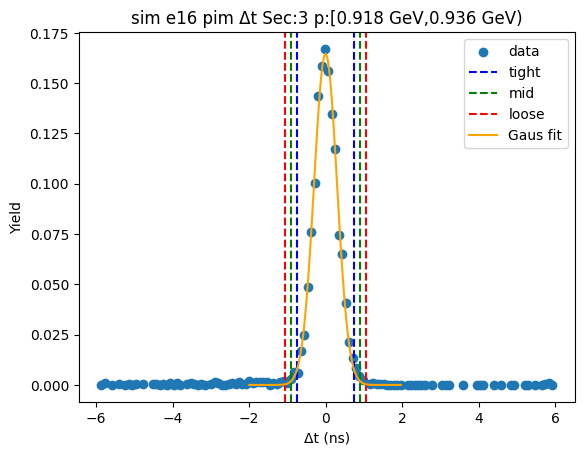

-0.7300780194029218 0.7392369594175728
-0.8770095172849712 0.8861684572996222
-1.0239410151670207 1.0330999551816715


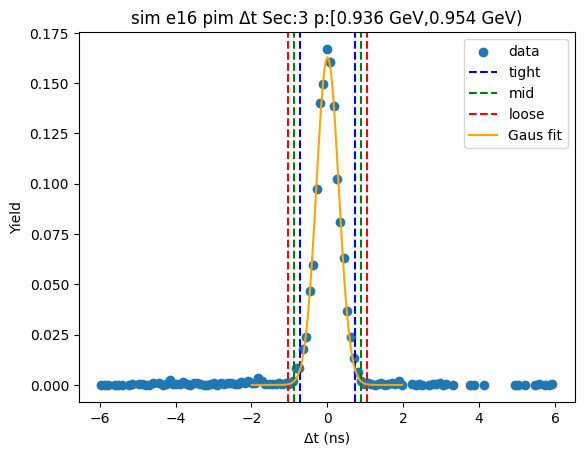

-0.7425891619613295 0.759534335167736
-0.8928015116742362 0.9097466848806427
-1.0430138613871425 1.0599590345935492


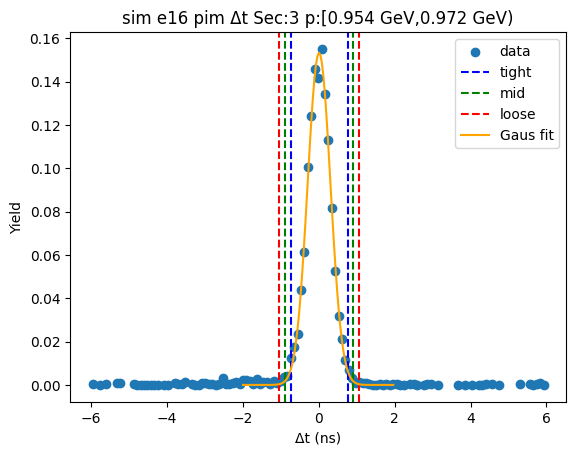

-0.7354442010639801 0.7446303171857167
-0.8834516528889499 0.8926377690106865
-1.0314591047139197 1.040645220835656


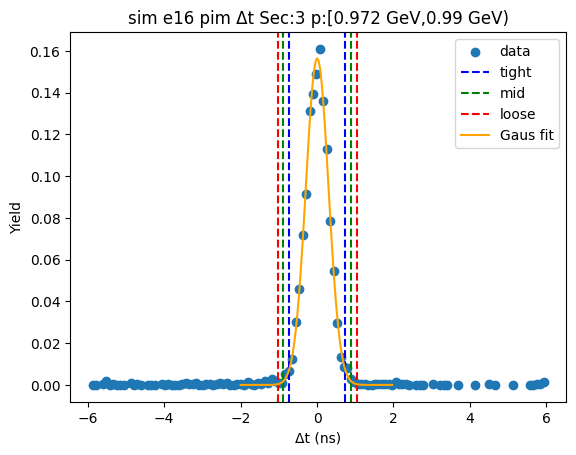

-0.7635304645263373 0.7679285010637379
-0.9166763610853448 0.9210743976227453
-1.0698222576443521 1.074220294181753


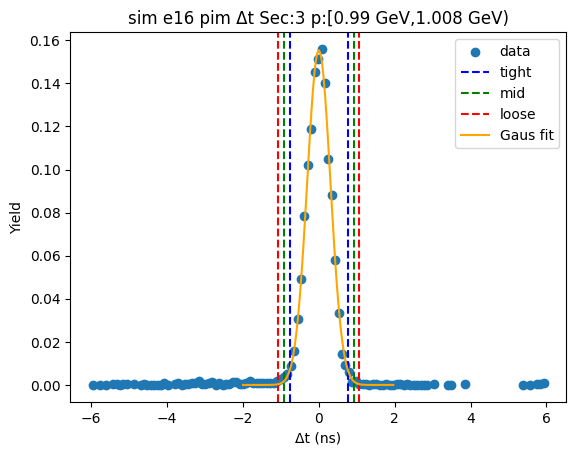

-0.7297595425485142 0.76746892414404
-0.8794823892177697 0.9171917708132955
-1.029205235887025 1.0669146174825508


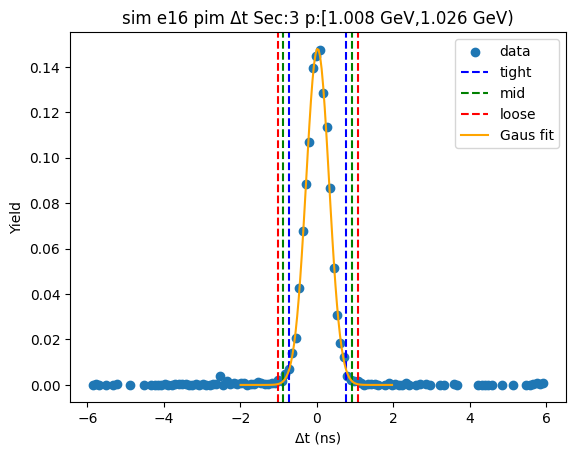

-0.7337932639235879 0.7343416865355145
-0.8806067589694981 0.8811551815814247
-1.0274202540154083 1.0279686766273348


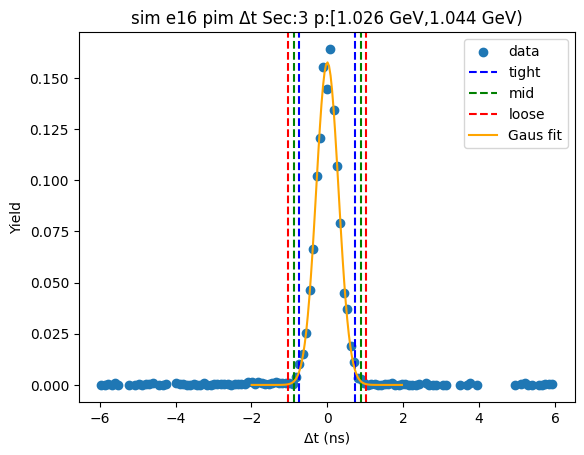

-0.7606811750401833 0.7593340392845079
-0.9126826964726523 0.911335560716977
-1.0646842179051217 1.0633370821494461


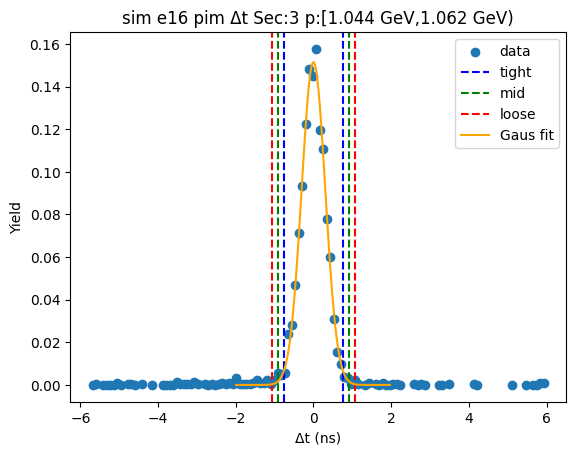

-0.7027441527611822 0.71577699969406
-0.8445962680067064 0.8576291149395842
-0.9864483832522306 0.9994812301851084


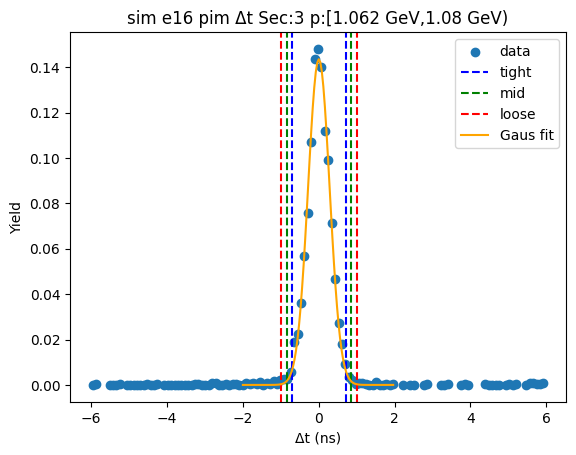

-0.7209922412911552 0.7444159969794714
-0.8675330651182178 0.8909568208065339
-1.0140738889452805 1.0374976446335966


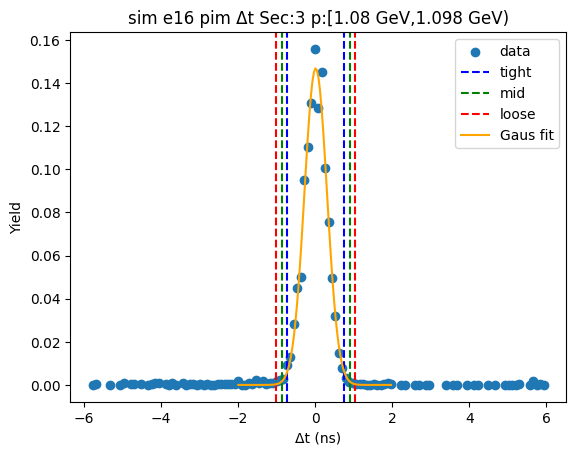

-0.7021581127518405 0.7261765053858916
-0.8449915745656137 0.8690099671996648
-0.9878250363793869 1.0118434290134382


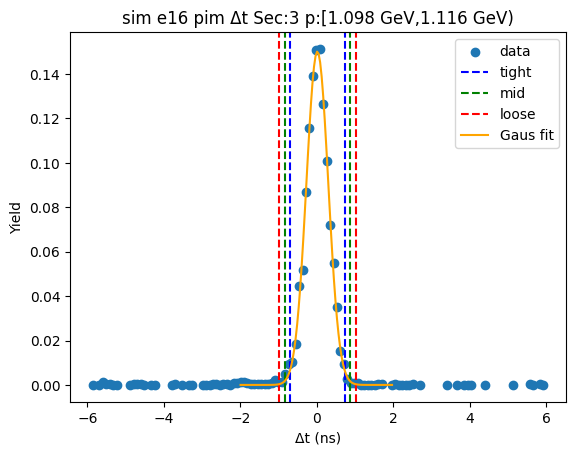

-0.707649745076949 0.7173951908552394
-0.8501542386701679 0.8598996844484583
-0.9926587322633867 1.0024041780416773


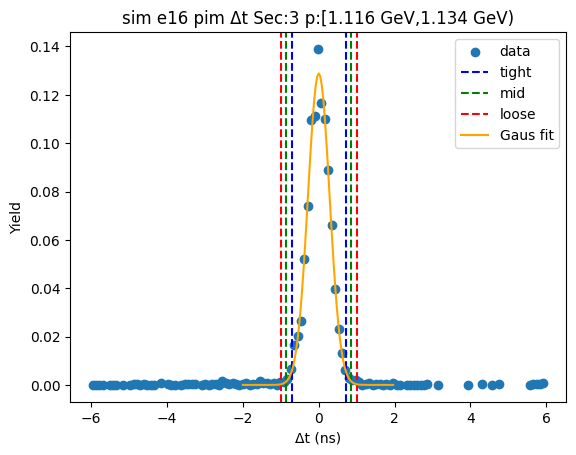

-0.7388346770983435 0.7308078920438964
-0.8857989340125675 0.8777721489581204
-1.0327631909267914 1.0247364058723445


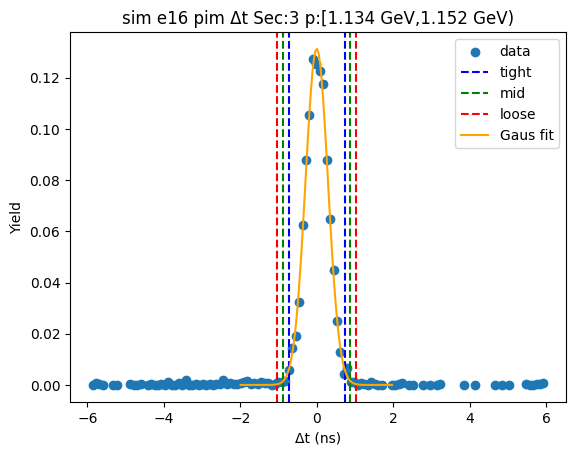

-0.7380369018033573 0.7409889873056018
-0.8859394907142533 0.8888915762164977
-1.0338420796251493 1.0367941651273938


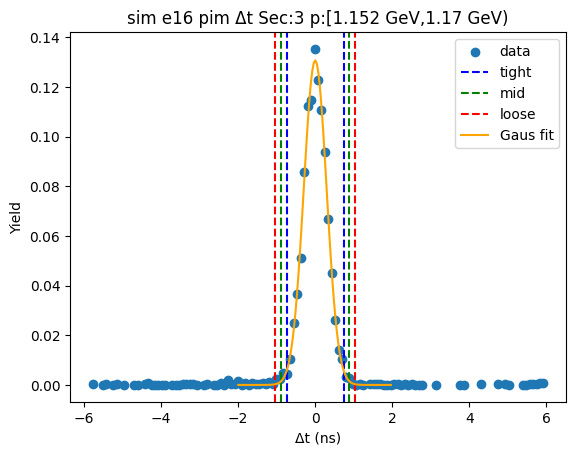

-0.7184922409152231 0.7734531450832717
-0.8676867795150727 0.9226476836831212
-1.0168813181149223 1.0718422222829707


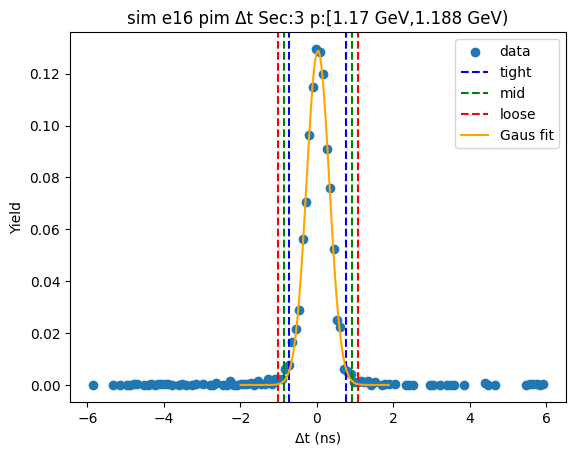

-0.7239945437129547 0.7436863138517138
-0.8707626294694216 0.8904543996081807
-1.0175307152258883 1.0372224853646477


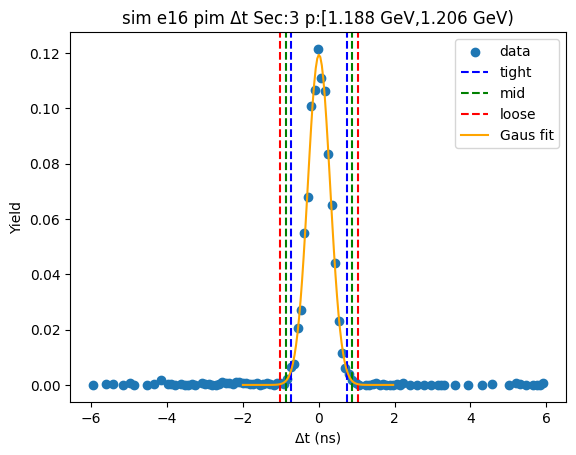

-0.7126989319284128 0.7348231151039243
-0.8574511366316466 0.8795753198071581
-1.0022033413348803 1.0243275245103918


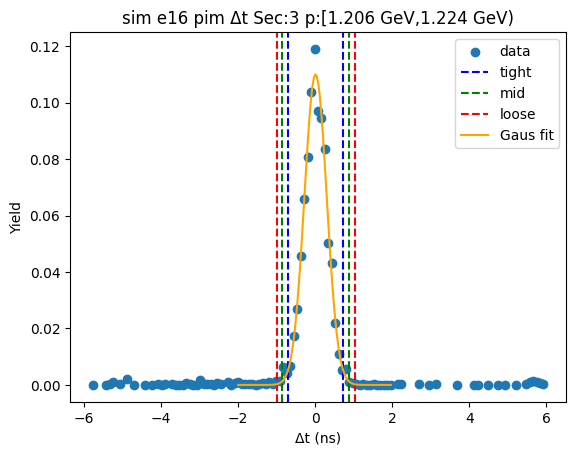

-0.7277377777144629 0.7533145237587504
-0.8758430078617842 0.9014197539060717
-1.0239482380091056 1.049524984053393


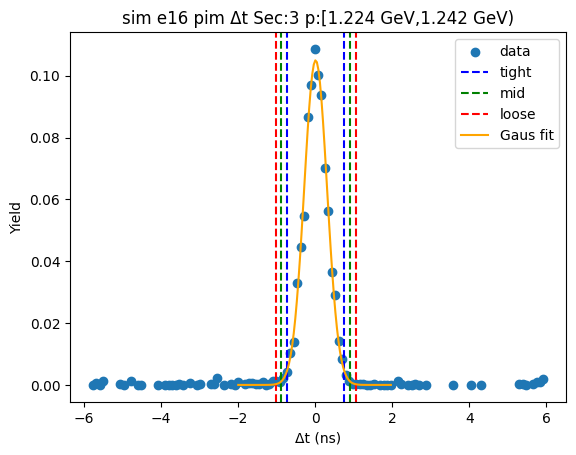

-0.7179125289868789 0.7385492444587956
-0.8635587063314465 0.884195421803363
-1.009204883676014 1.0298415991479304


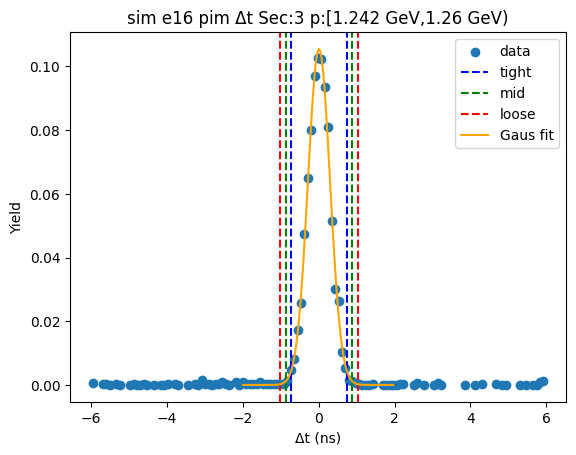

-0.7018010881009958 0.6925229384657708
-0.8412334907576725 0.8319553411224475
-0.9806658934143492 0.9713877437791242


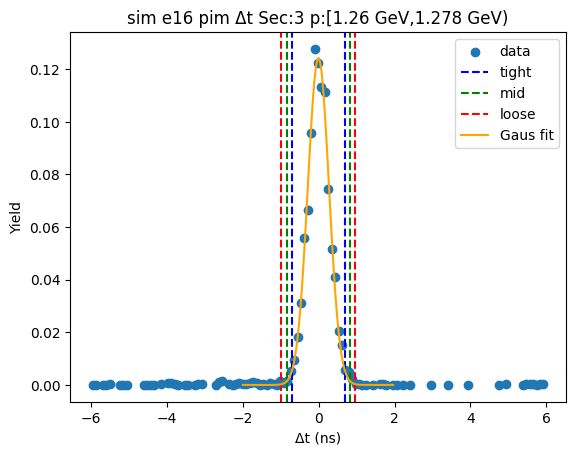

-0.7099490308946684 0.7511975687173801
-0.8560636908558732 0.8973122286785848
-1.002178350817078 1.0434268886397897


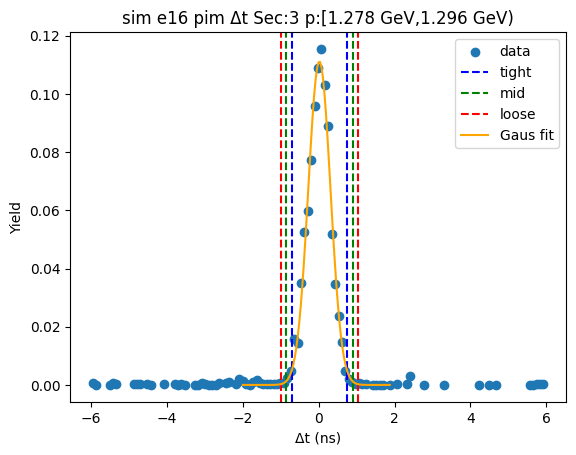

-0.7461607947585198 0.7431907009442262
-0.8950959443287944 0.8921258505145008
-1.044031093899069 1.0410610000847753


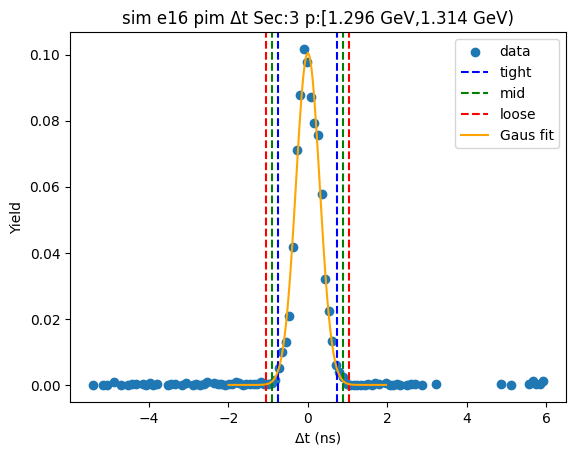

-0.6933950698641997 0.7113561654776157
-0.8338701933983812 0.8518312890117972
-0.9743453169325628 0.9923064125459787


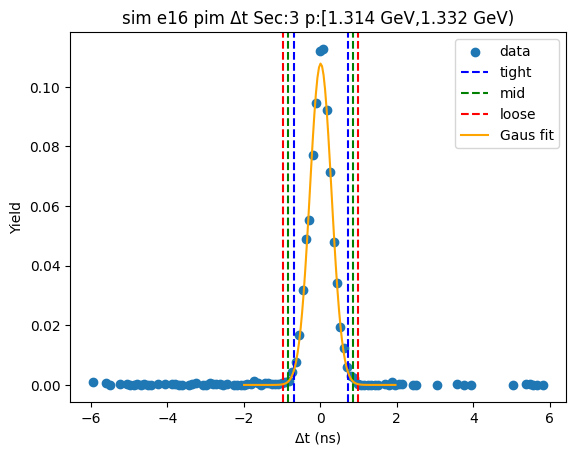

-0.7258392115495949 0.7404033561584591
-0.8724634683204003 0.8870276129292646
-1.0190877250912058 1.0336518697000698


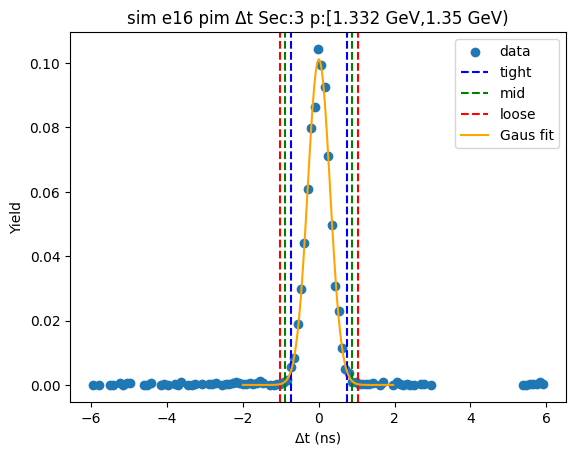

-0.6794762712127104 0.7209313346316423
-0.8195170317971456 0.8609720952160775
-0.9595577923815809 1.001012855800513


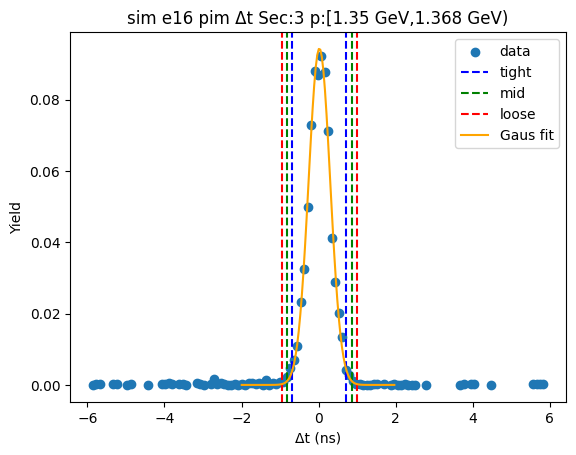

-0.6697311241833975 0.6827198636057198
-0.8049762229623092 0.8179649623846315
-0.9402213217412209 0.9532100611635431


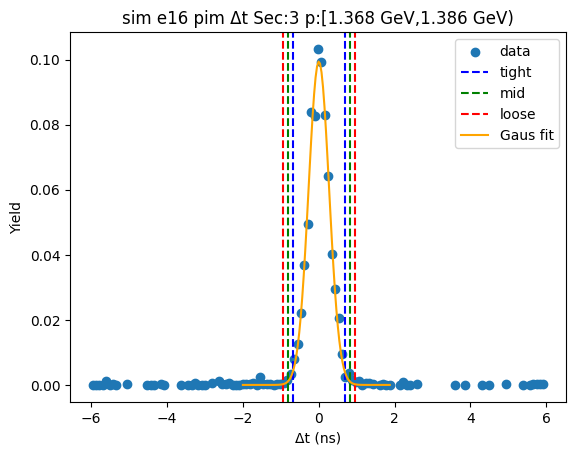

-0.6708375420417082 0.7052016720961797
-0.8084414634554971 0.8428055935099685
-0.9460453848692859 0.9804095149237574


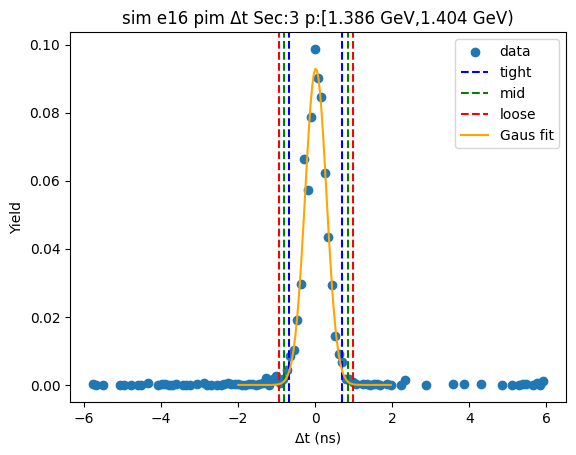

-0.7158870586048642 0.7274987217921918
-0.8602256366445697 0.8718372998318973
-1.0045642146842755 1.016175877871603


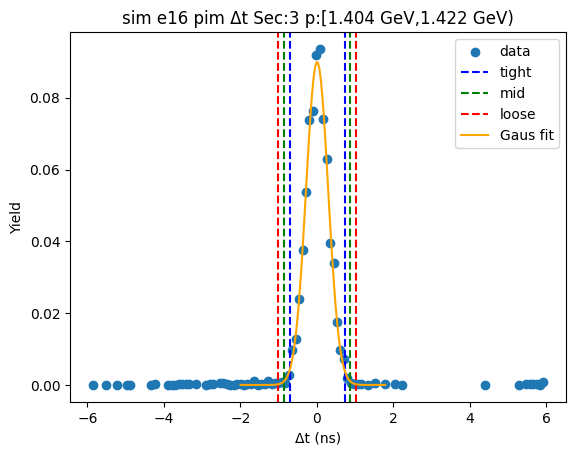

-0.7266635915009323 0.7617107671048551
-0.875501027361511 0.9105482029654338
-1.02433846322209 1.0593856388260126


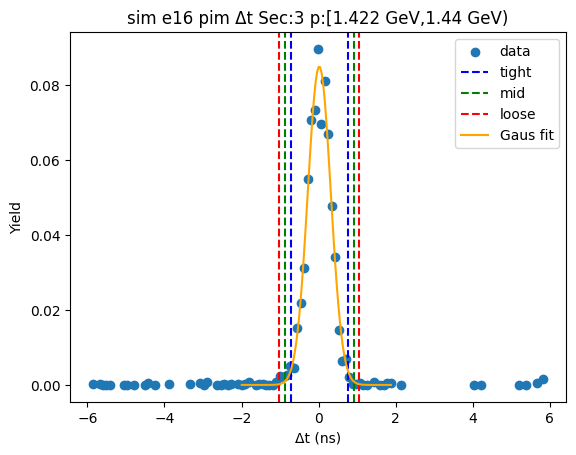

-0.6946876511594806 0.7267680925738245
-0.836833225532811 0.8689136669471549
-0.9789787999061416 1.0110592413204853


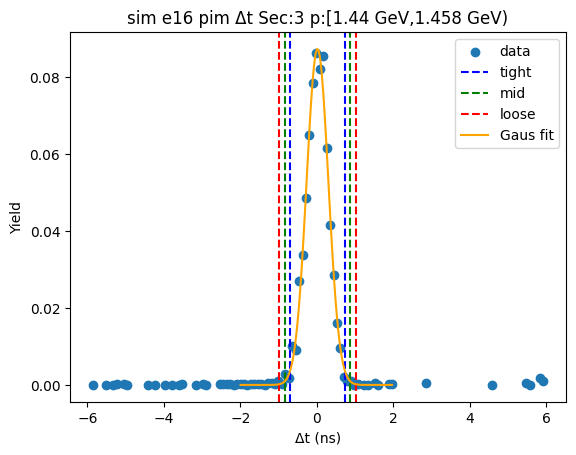

-0.6847448377783661 0.7061887602169726
-0.8238381975779001 0.8452821200165066
-0.962931557377434 0.9843754798160405


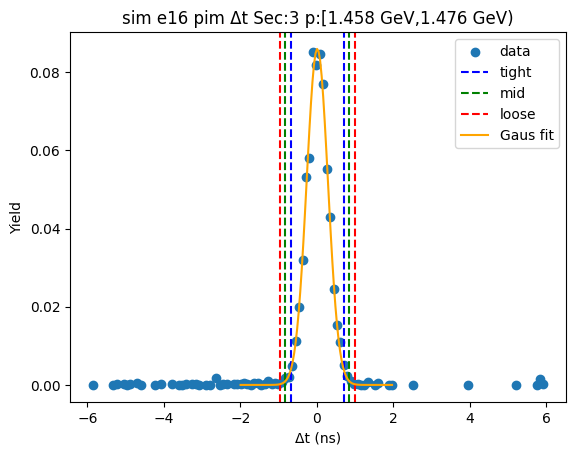

-0.7158684108960974 0.7143807984474645
-0.8588933318304537 0.8574057193818208
-1.00191825276481 1.000430640316177


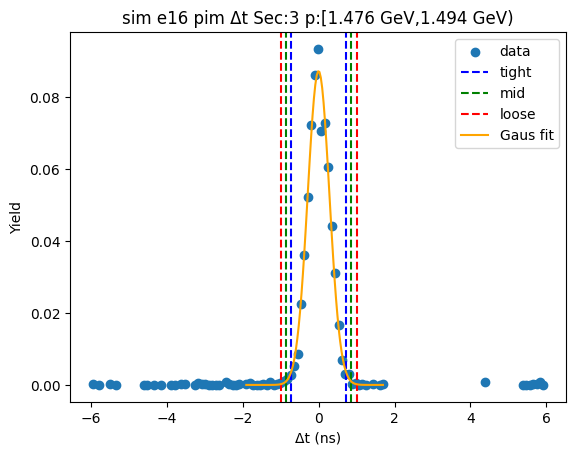

-0.7516935067973565 0.7273582649836674
-0.899598683975459 0.8752634421617699
-1.0475038611535612 1.0231686193398724


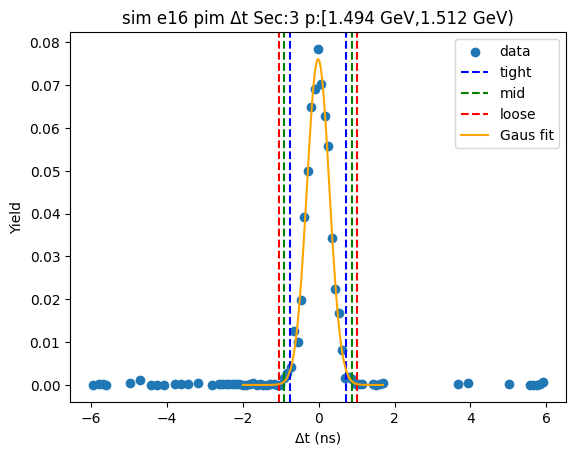

-0.7214388208390806 0.7502168128453103
-0.8686043842075196 0.8973823762137493
-1.0157699475759587 1.0445479395821886


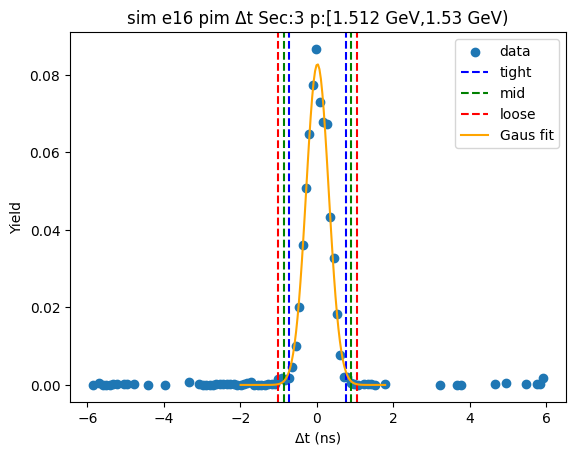

-0.6729557073934256 0.6970445378225054
-0.8099557319150187 0.8340445623440985
-0.9469557564366118 0.9710445868656916


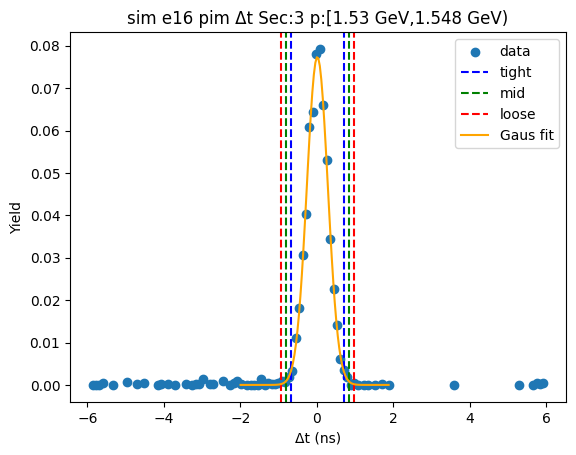

-0.7002799332986346 0.6956226588403976
-0.8398701925125378 0.8352129180543009
-0.979460451726441 0.9748031772682041


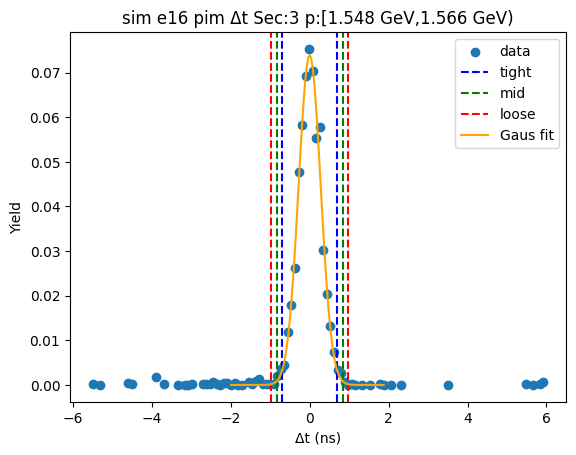

-0.695410818953126 0.7085071639427817
-0.8358026172427167 0.8488989622323724
-0.9761944155323073 0.9892907605219631


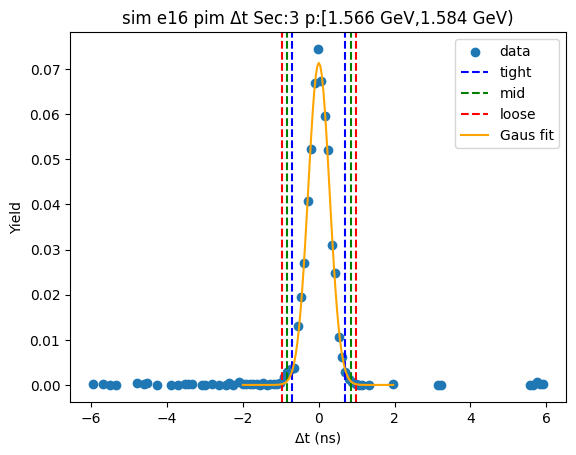

-0.7245326259106556 0.7667576038009373
-0.873661648881815 0.9158866267720966
-1.0227906718529742 1.065015649743256


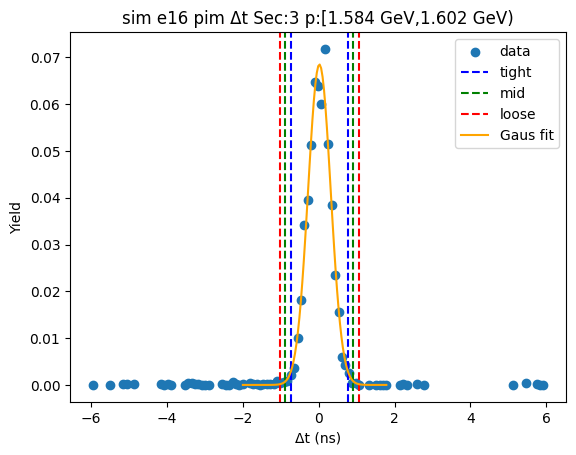

-0.7270842381021707 0.7373851538791505
-0.8735311773003028 0.8838320930772826
-1.019978116498435 1.0302790322754145


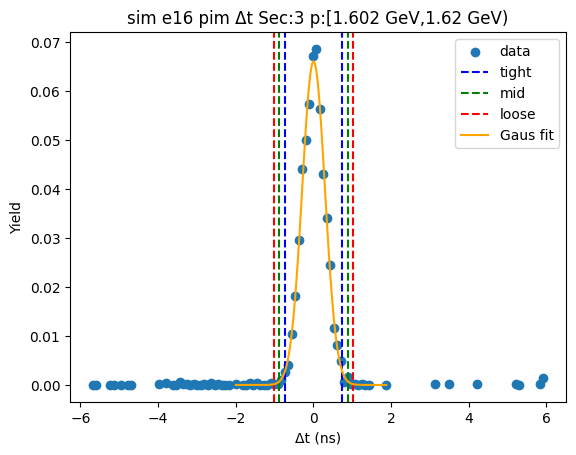

-0.6694690591761008 0.7115614154390131
-0.8075721066376123 0.8496644629005246
-0.9456751540991236 0.9877675103620359


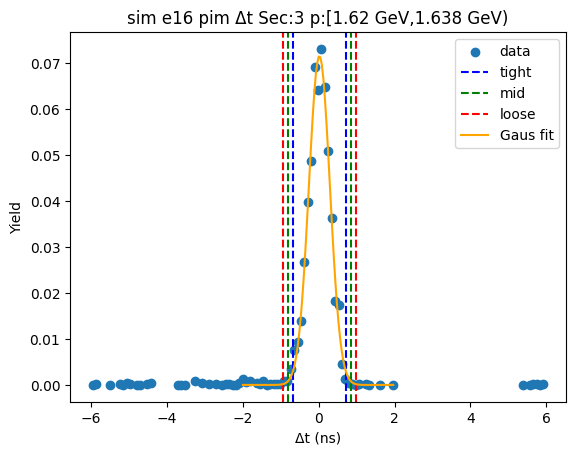

-0.722201549838652 0.7498685379892787
-0.8694085586214452 0.8970755467720718
-1.0166155674042383 1.044282555554865


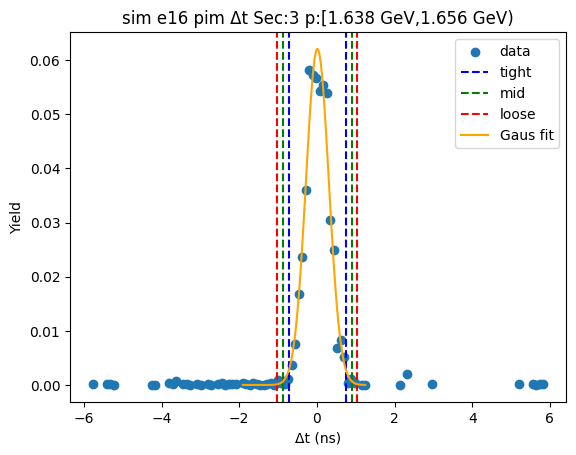

-0.6891645039028933 0.7145808082034828
-0.829539035113531 0.8549553394141205
-0.9699135663241686 0.9953298706247581


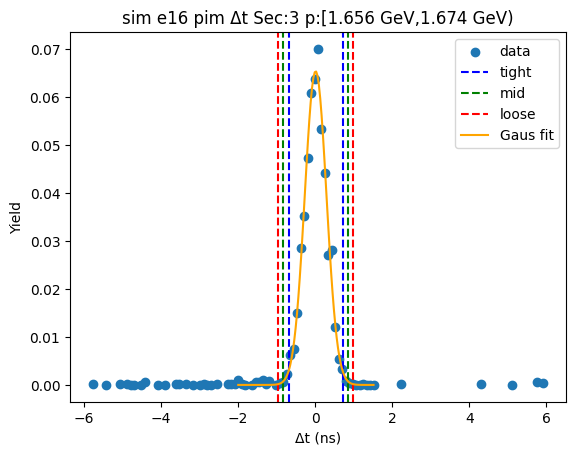

-0.7560600580995949 0.7718828104057562
-0.9088543449501301 0.9246770972562914
-1.061648631800665 1.0774713841068264


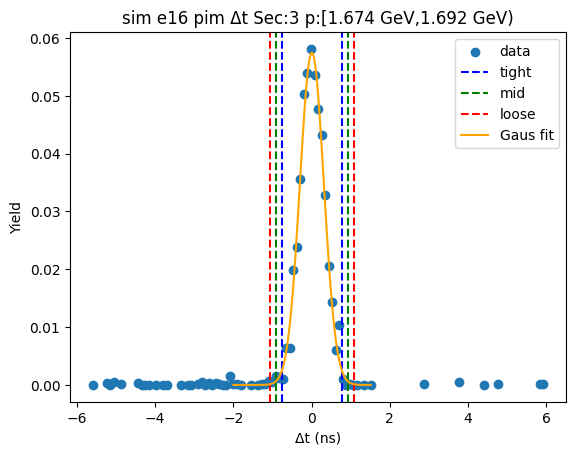

-0.7268404222504702 0.7268741215618734
-0.8722118766317046 0.8722455759431078
-1.017583331012939 1.0176170303243421


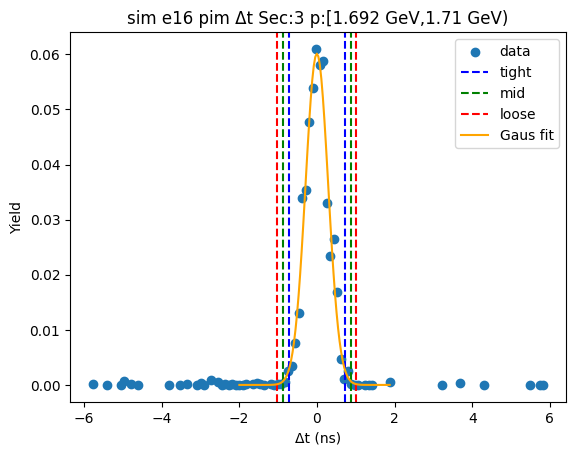

-0.7114302548094905 0.7145539357666447
-0.8540286738671041 0.8571523548242583
-0.9966270929247176 0.9997507738818718


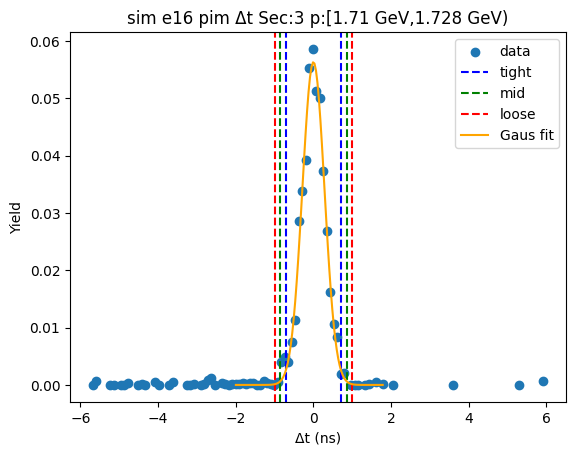

-0.6687396907089251 0.7075073290177811
-0.8063643926815958 0.8451320309904518
-0.9439890946542664 0.9827567329631224


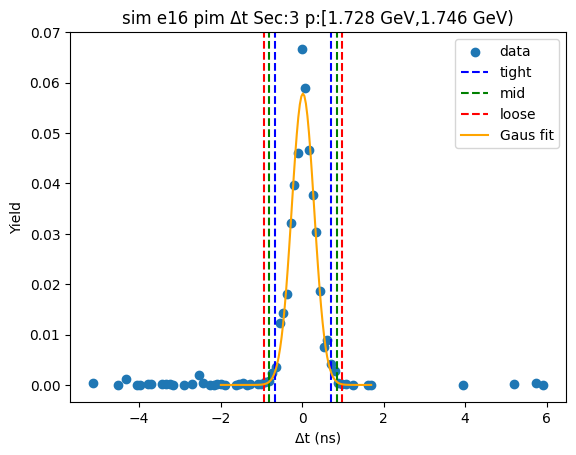

-0.7174337925515096 0.7057532416684739
-0.8597524959735079 0.8480719450904721
-1.0020711993955063 0.9903906485124705


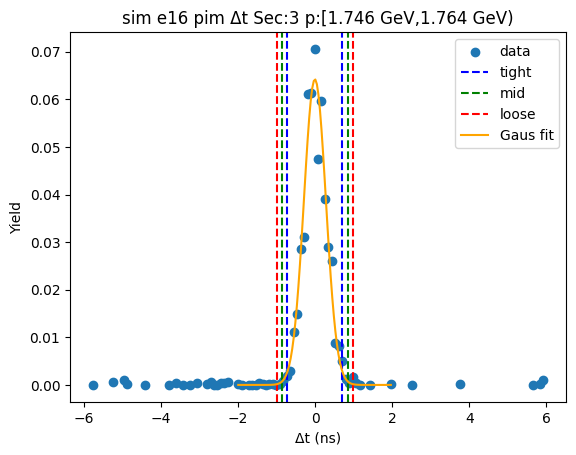

-0.6499507096598071 0.6737843374264051
-0.7823242143684284 0.8061578421350264
-0.9146977190770496 0.9385313468436476


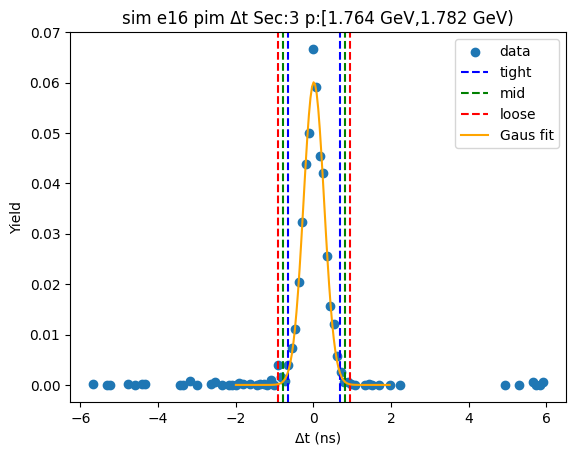

-0.617819478340977 0.696118057027268
-0.7492132318778015 0.8275118105640926
-0.880606985414626 0.9589055641009171


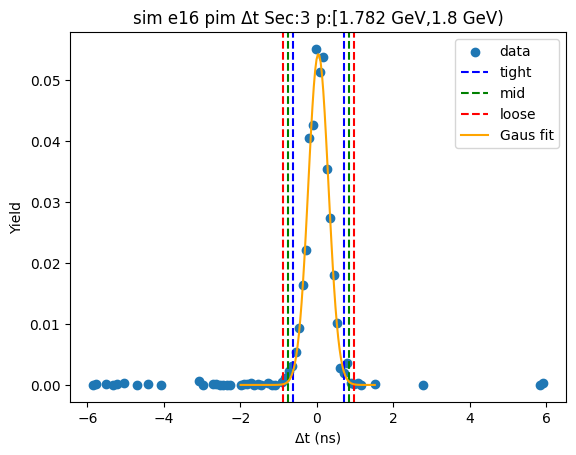

-0.6872476608982769 0.7048448369941809
-0.8264569106875228 0.8440540867834267
-0.9656661604767686 0.9832633365726725


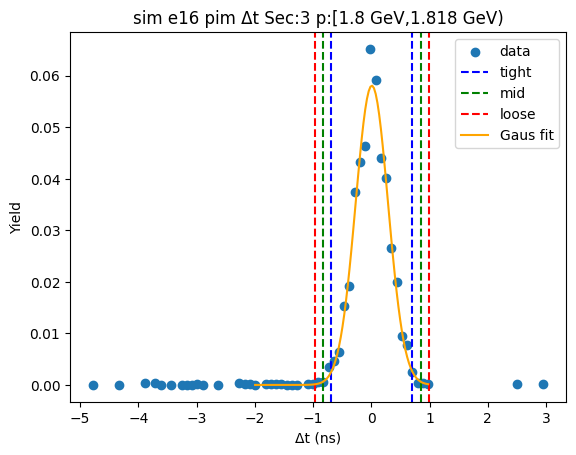

-0.6905782922492463 0.7382292124514451
-0.8334590427193155 0.8811099629215143
-0.9763397931893847 1.0239907133915835


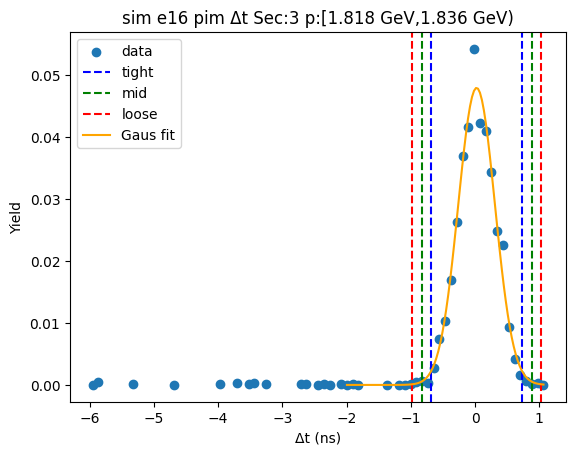

-0.6678192662375743 0.6965050087902337
-0.804251693740355 0.8329374362930144
-0.9406841212431357 0.9693698637957952


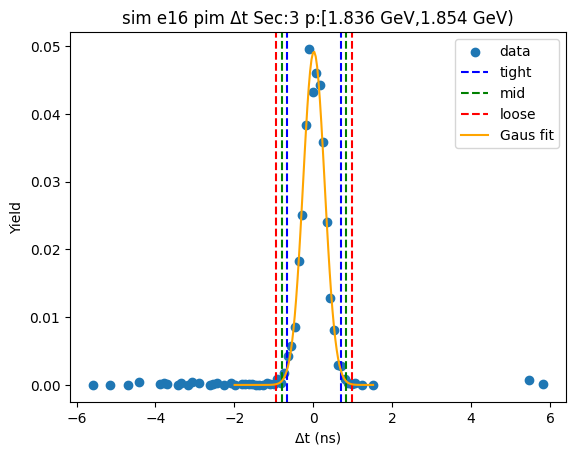

-0.6737440192437245 0.7316087793477706
-0.8142792991028741 0.8721440592069202
-0.9548145789620236 1.0126793390660696


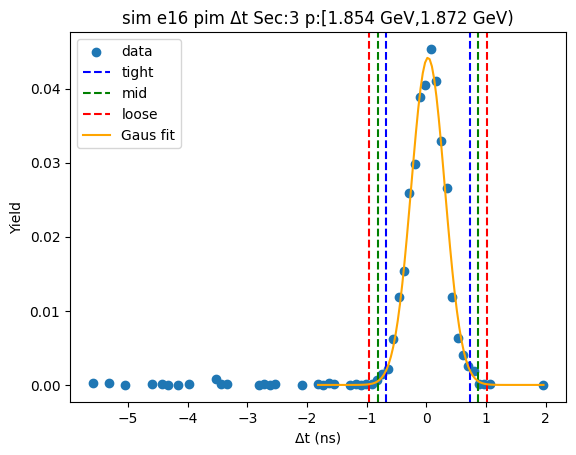

-0.6835379709318392 0.6891453791507194
-0.8208063059400951 0.8264137141589752
-0.9580746409483509 0.9636820491672311


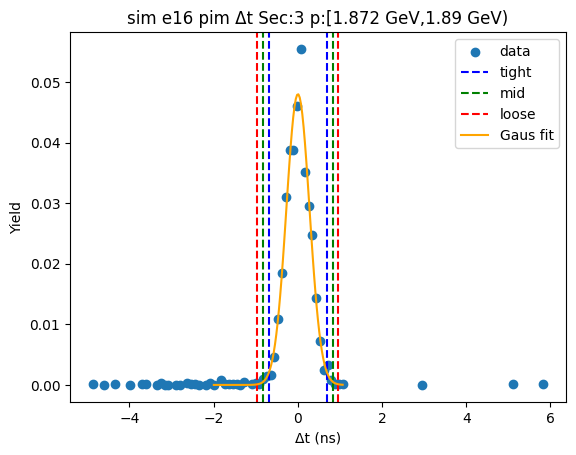

-0.7095843626666879 0.7461583940832107
-0.8551586383416778 0.8917326697582006
-1.0007329140166676 1.0373069454331907


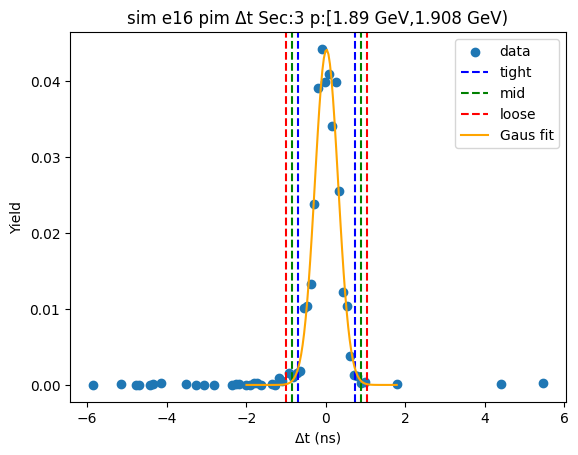

-0.7461218270132527 0.7599350086018494
-0.896727510574763 0.9105406921633596
-1.0473331941362733 1.0611463757248698


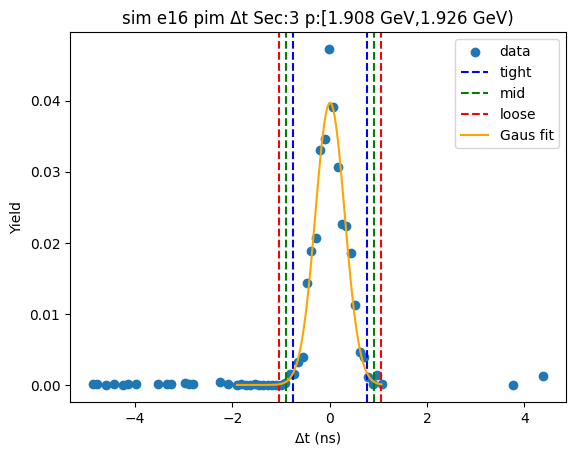

-0.6598306736125692 0.7354130306387499
-0.7993550440377012 0.8749374010638818
-0.9388794144628331 1.0144617714890136


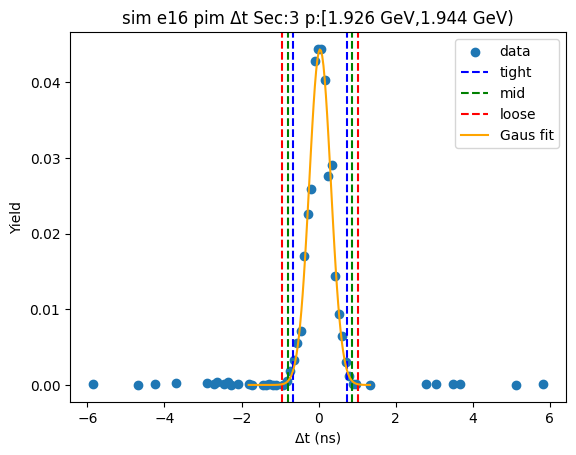

-0.6614570942175039 0.7249830000428973
-0.8001011036435439 0.8636270094689373
-0.938745113069584 1.0022710188949773


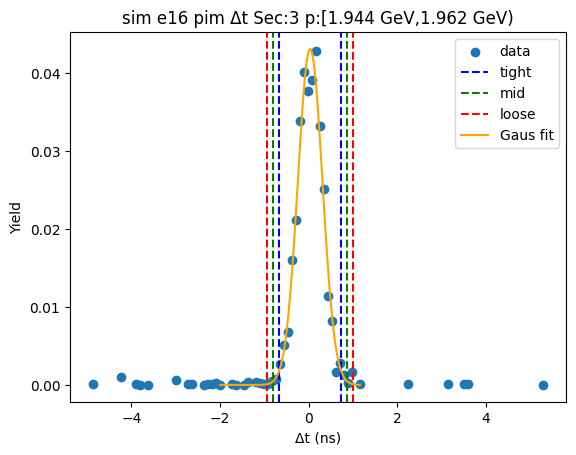

-0.673570229291445 0.67443740219617
-0.8083709924402065 0.8092381653449314
-0.9431717555889679 0.9440389284936929


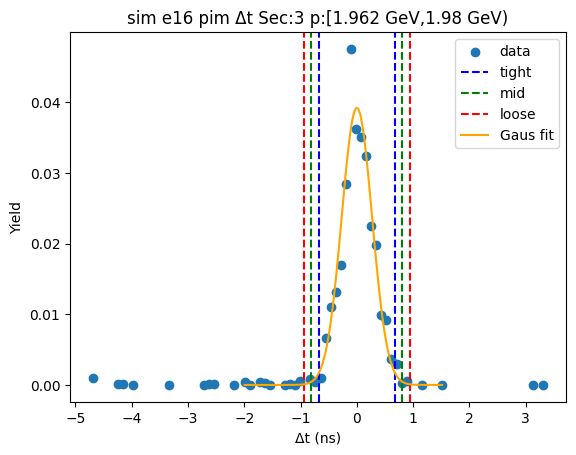

-0.7345022059461913 0.7464849730319544
-0.8826009238440058 0.8945836909297689
-1.0306996417418204 1.0426824088275835


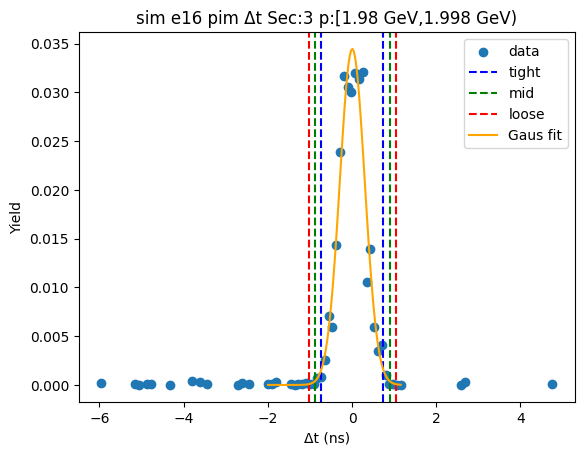

-0.7003359315845951 0.6908752064766565
-0.8394570453907203 0.8299963202827817
-0.9785781591968454 0.9691174340889068


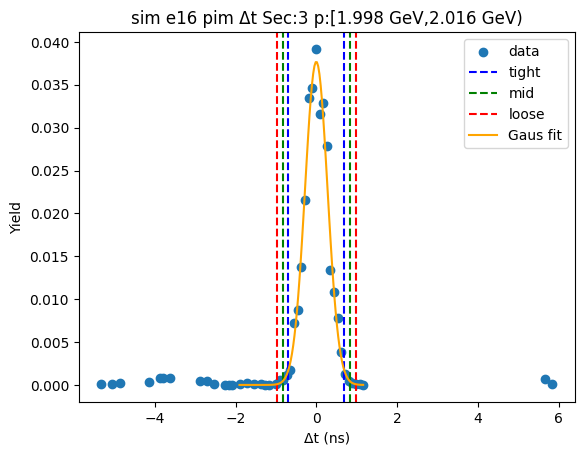

-0.6636492677766564 0.7407684418552934
-0.8040910387398514 0.8812102128184884
-0.9445328097030464 1.0216519837816833


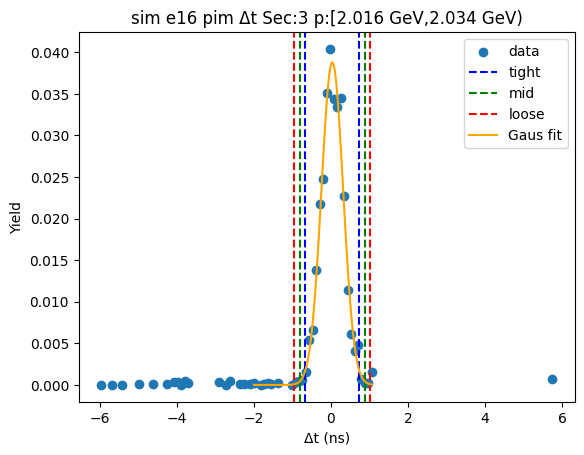

-0.6810679038900128 0.7522740458850244
-0.8244020988675165 0.8956082408625281
-0.9677362938450201 1.0389424358400319


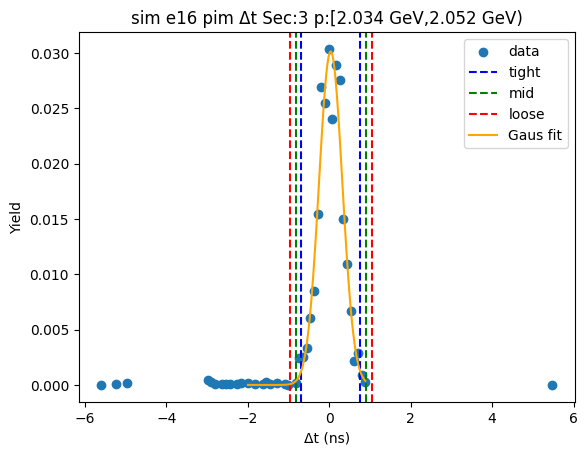

-0.7108753678402812 0.7229415615790152
-0.8542570607822109 0.8663232545209449
-0.9976387537241406 1.0097049474628745


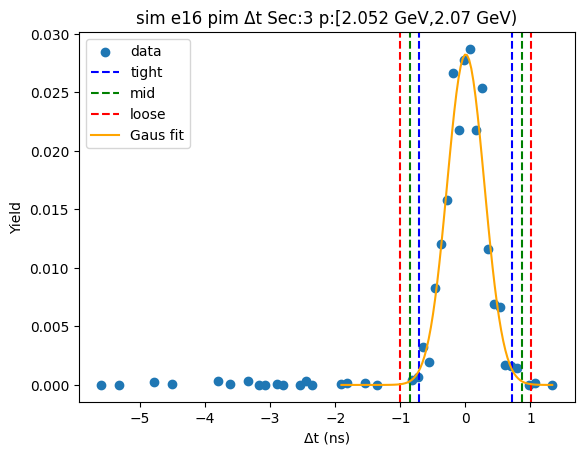

-0.7257185323177088 0.7516163878695764
-0.8734520243364372 0.8993498798883048
-1.0211855163551657 1.0470833719070334


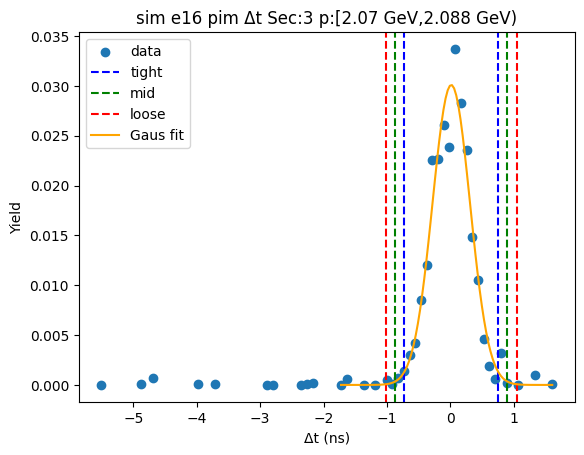

-0.6063429512106003 0.6431572048468587
-0.7312929668163461 0.7681072204526045
-0.8562429824220921 0.8930572360583504


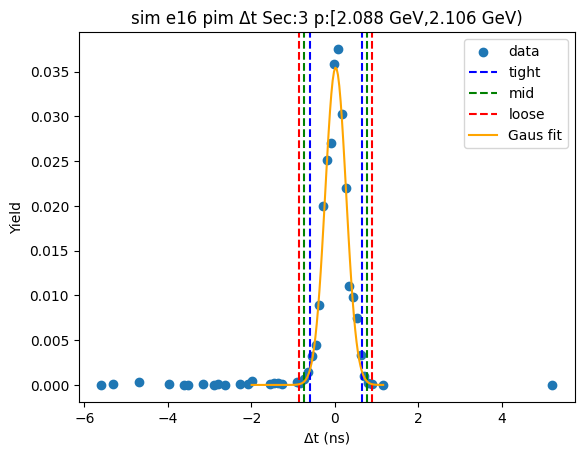

-0.7439637784146068 0.726855808341882
-0.8910457370902557 0.8739377670175309
-1.0381276957659047 1.0210197256931797


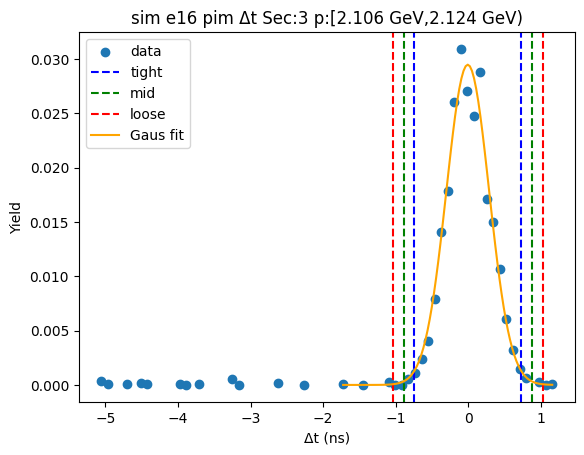

-0.6397702460249033 0.6969280348846467
-0.7734400741158584 0.8305978629756018
-0.9071099022068134 0.9642676910665569


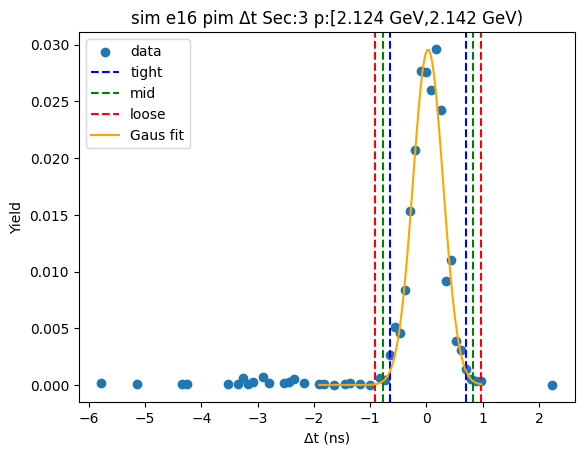

-0.6720842983061522 0.6514065358370581
-0.8044333817204732 0.783755619251379
-0.9367824651347942 0.9161047026657001


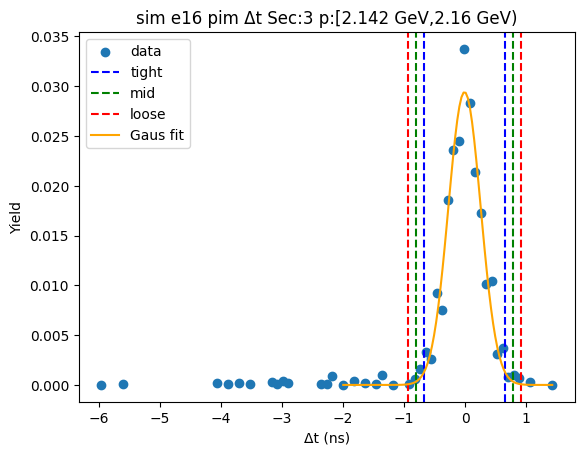

-0.7465426650466424 0.7233797823648539
-0.893534909787792 0.8703720271060036
-1.0405271545289416 1.0173642718471534


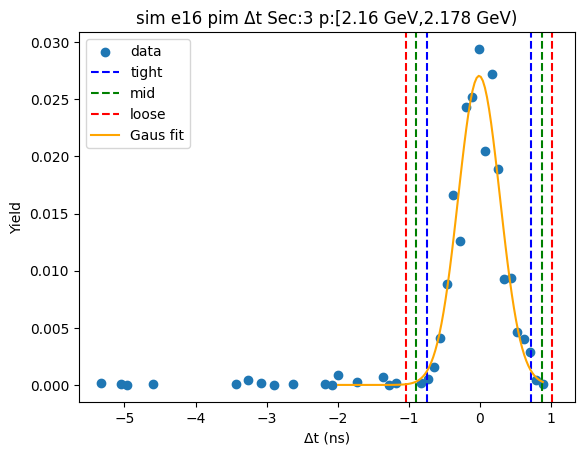

-0.7100953392452962 0.7406672903875018
-0.855171602208576 0.8857435533507816
-1.0002478651718558 1.0308198163140614


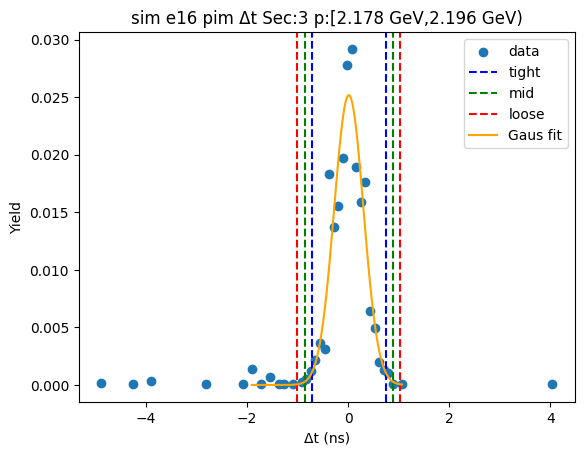

-0.6699465881148894 0.8253042072579164
-0.81947166765217 0.9748292867951971
-0.9689967471894505 1.1243543663324775


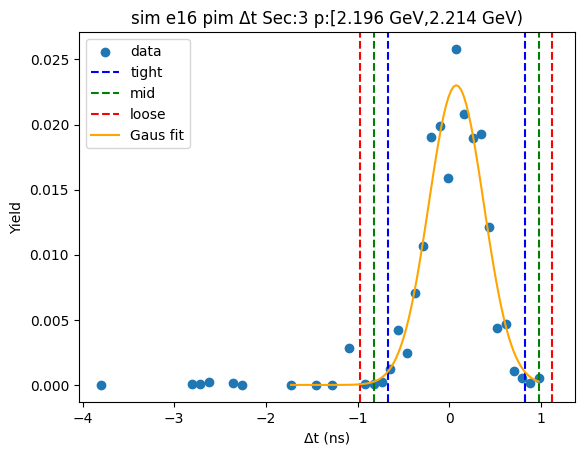

-0.6712260613839266 0.7064735049055321
-0.8089960180128725 0.8442434615344779
-0.9467659746418183 0.9820134181634238


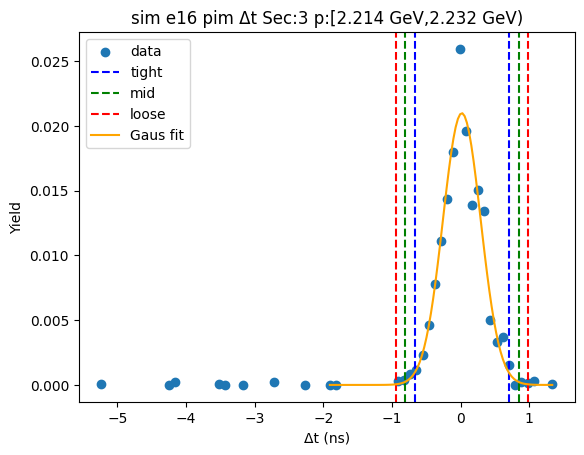

-0.6673820970613661 0.6944455764664704
-0.8035648644141496 0.830628343819254
-0.9397476317669333 0.9668111111720377


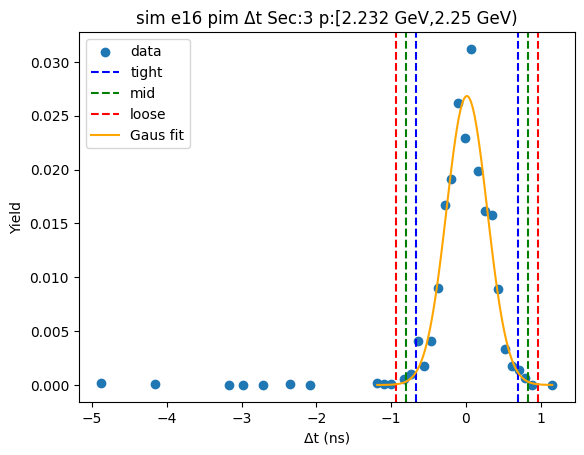

-0.5976562009083879 0.6467909362168502
-0.7221009146209117 0.7712356499293741
-0.8465456283334355 0.8956803636418978


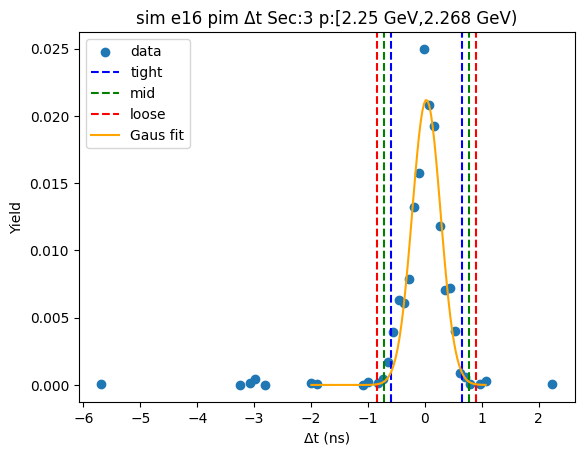

-0.5781783979615234 0.5500276698099957
-0.6909990047386753 0.6628482765871476
-0.8038196115158271 0.7756688833642995


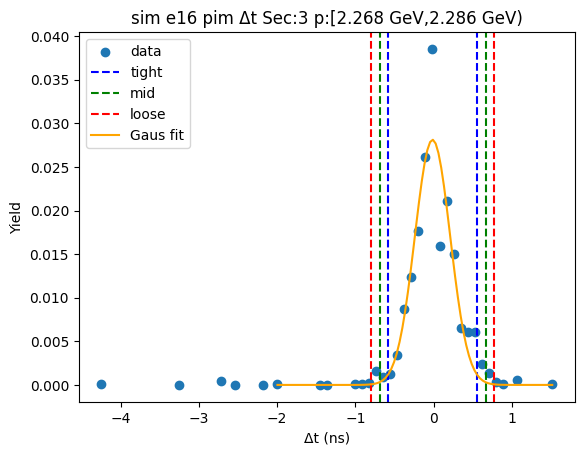

-0.7067868626544344 0.7232868210016222
-0.8497942310200399 0.8662941893672278
-0.9928015993856456 1.0093015577328335


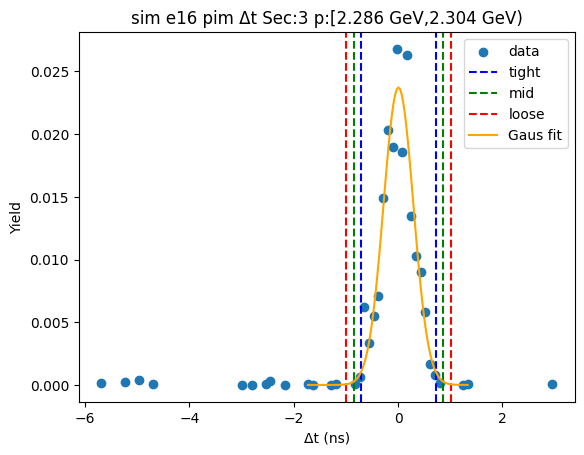

-0.7319512752053057 0.7947113471161271
-0.8846175374374489 0.9473776093482703
-1.0372837996695923 1.1000438715804135


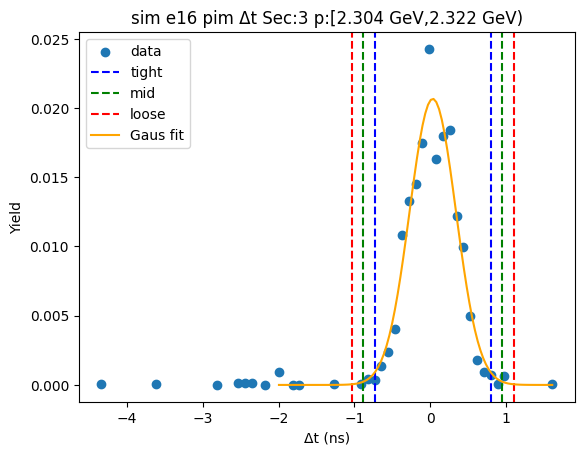

-0.6895785216227915 0.6927516529890348
-0.8278115390839741 0.8309846704502174
-0.9660445565451568 0.9692176879114001


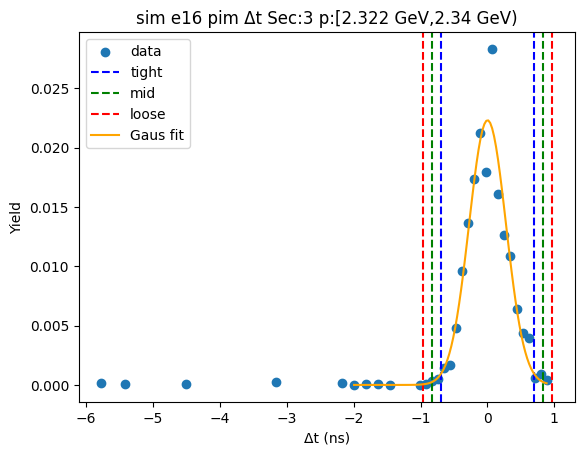

-0.729451666421104 0.7738544924023122
-0.8797822823034456 0.9241851082846537
-1.0301128981857872 1.0745157241669954


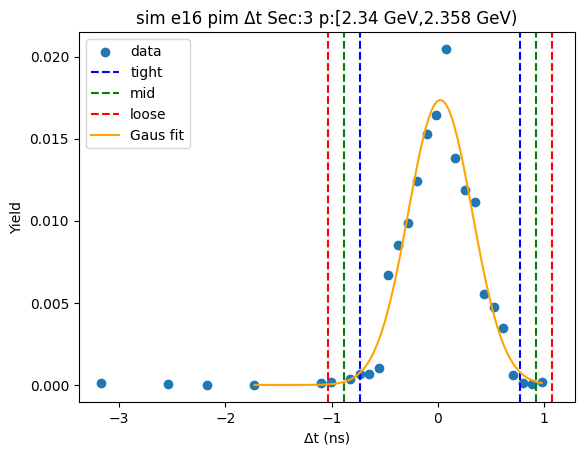

-0.7038658456505728 0.6733689531030177
-0.8415893255259318 0.8110924329783767
-0.9793128054012908 0.9488159128537358


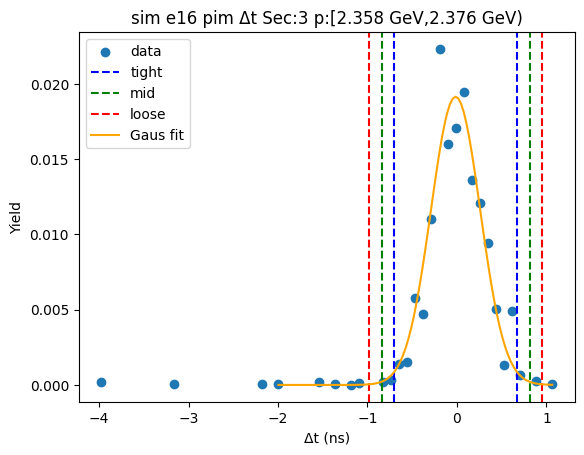

-0.7029946404270789 0.6824141379717169
-0.8415355182669586 0.8209550158115966
-0.9800763961068382 0.9594958936514761


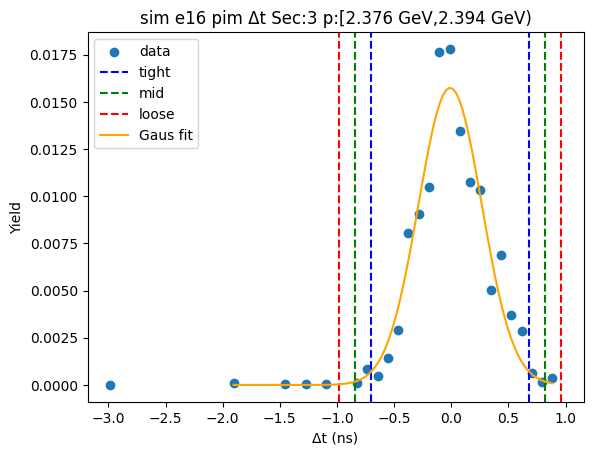

-0.6614268053762679 0.6642564235051133
-0.7939951282644059 0.7968247463932513
-0.926563451152544 0.9293930692813894


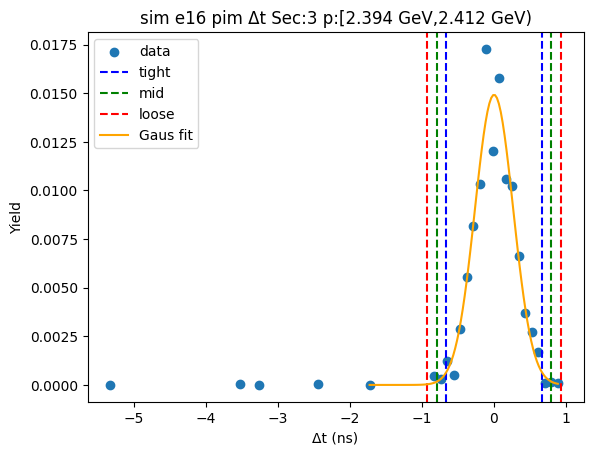

-0.7464974779272503 0.7318588825296789
-0.8943331139729431 0.8796945185753717
-1.042168750018636 1.0275301546210647


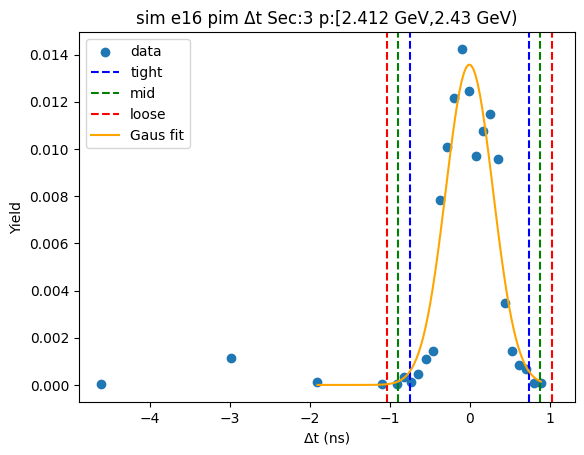

-0.6418566170543424 0.7239978393842225
-0.7784420626981989 0.860583285028079
-0.9150275083420555 0.9971687306719356


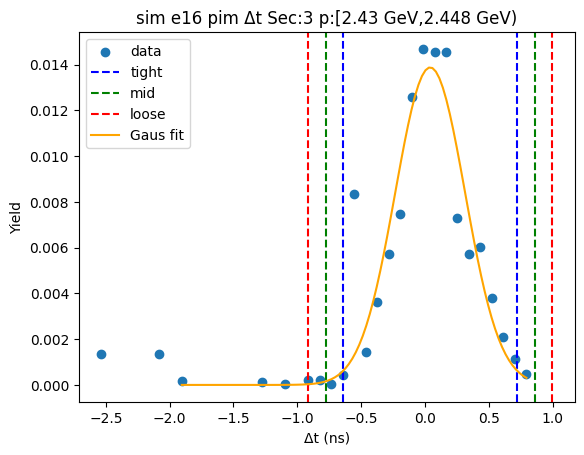

-0.6549123037266268 0.6697693276523166
-0.7873804668645211 0.8022374907902109
-0.9198486300024155 0.9347056539281052


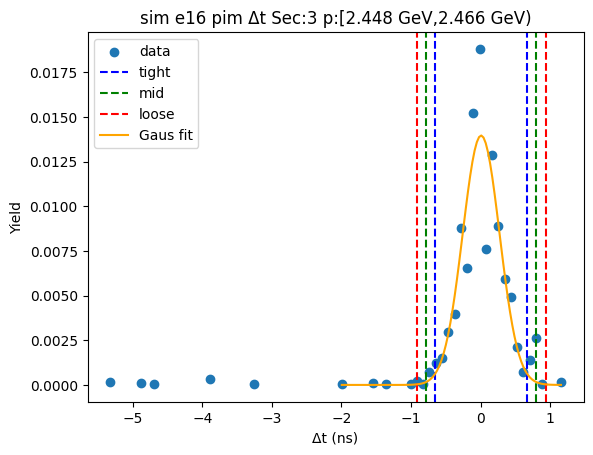

-0.6502531646835743 0.6382518418336545
-0.7791036653352972 0.7671023424853773
-0.9079541659870201 0.8959528431371002


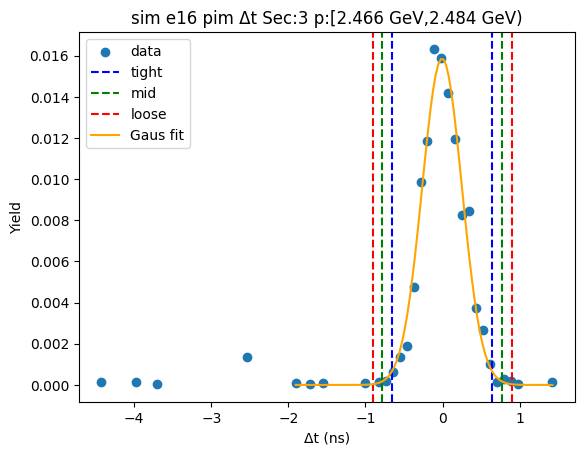

-0.6375897563331689 0.6447750549452715
-0.7658262374610131 0.7730115360731157
-0.8940627185888571 0.9012480172009597


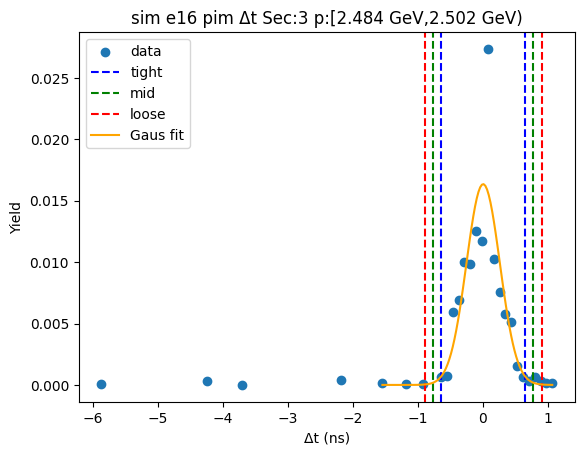

-0.6687548444874805 0.7600383755207758
-0.811634166488306 0.9029176975216013
-0.9545134884891318 1.045797019522427


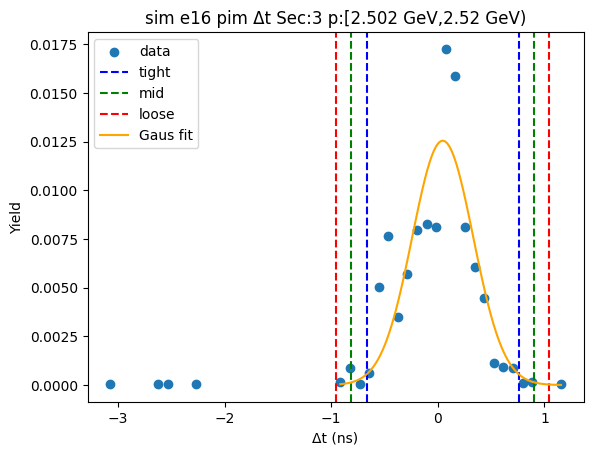

-0.6951437462641814 0.7005334905632183
-0.8347114699469215 0.8401012142459584
-0.9742791936296614 0.9796689379286984


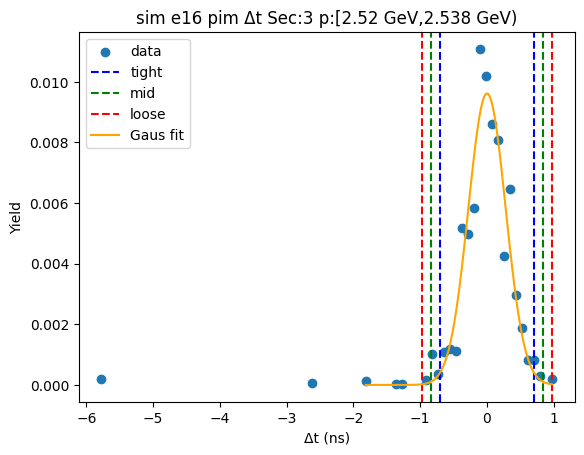

-0.656325899190381 0.7162993821536446
-0.7935884273247836 0.8535619102880473
-0.9308509554591862 0.9908244384224498


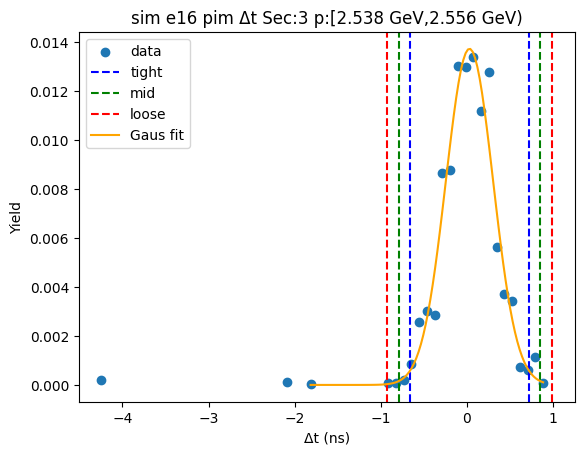

-0.7550137679182245 0.7387200438423671
-0.9043871490942837 0.8880934250184264
-1.0537605302703428 1.0374668061944856


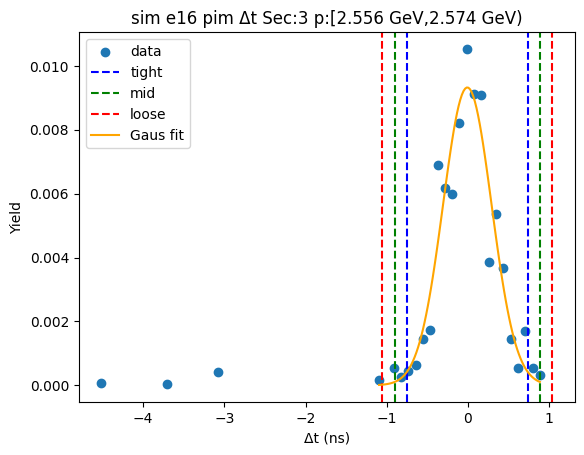

-0.7888566631085632 0.6796512736613063
-0.9357074567855501 0.8265020673382932
-1.082558250462537 0.9733528610152802


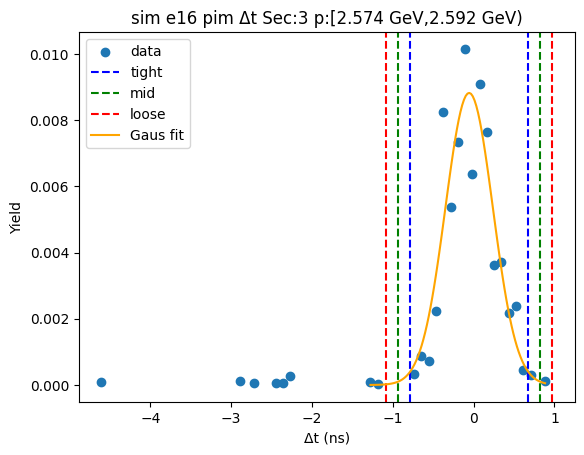

-0.6515139006529453 0.7261360046553034
-0.7892788911837701 0.8639009951861282
-0.927043881714595 1.001665985716953


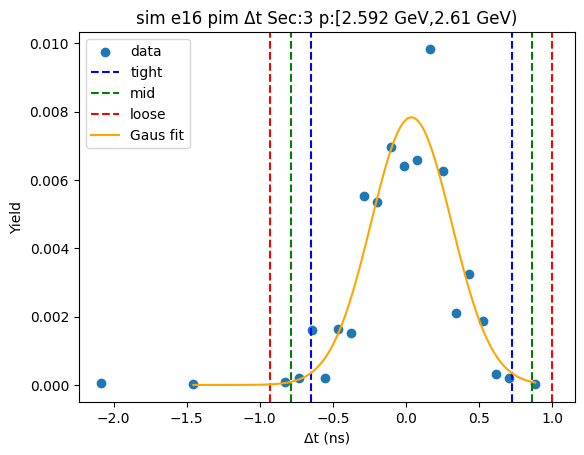

-0.7612822359860213 0.6239384463479641
-0.8998043042194199 0.7624605145813628
-1.0383263724528184 0.9009825828147613


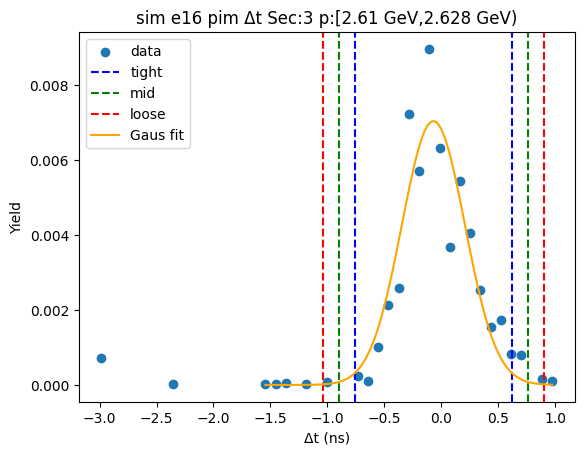

-0.6408021278773589 0.6412939449404694
-0.7690117351591417 0.7695035522222522
-0.8972213424409244 0.897713159504035


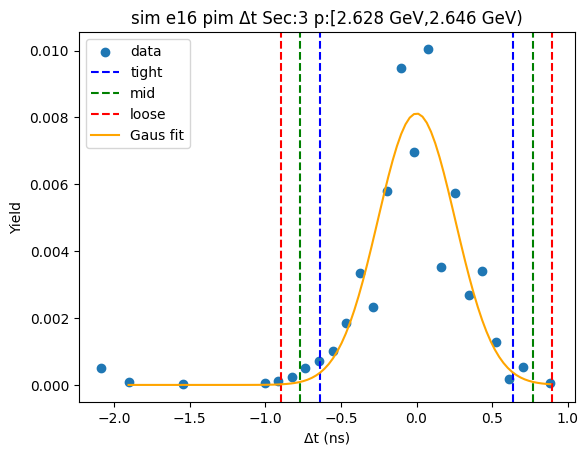

-0.7913449231092593 0.7837623621275738
-0.9488556516329426 0.9412730906512571
-1.1063663801566257 1.0987838191749404


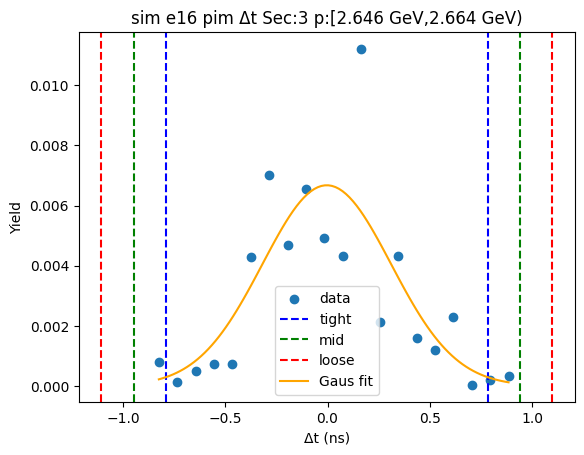

-0.9397952148173079 0.7772089124689019
-1.1114956275459287 0.9489093251975227
-1.2831960402745497 1.1206097379261437


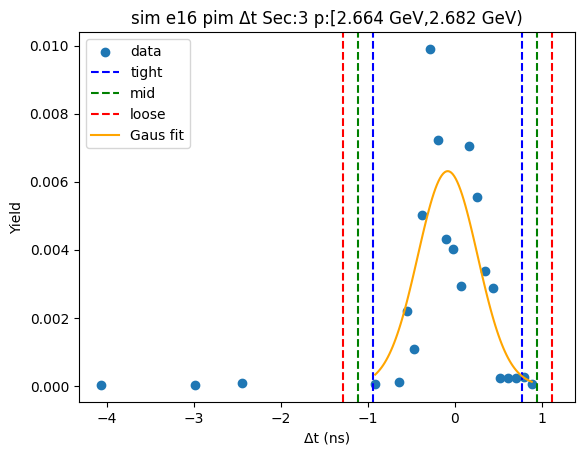

-0.5094302179174981 0.6017178588707508
-0.6205450255963231 0.7128326665495758
-0.7316598332751479 0.8239474742284006


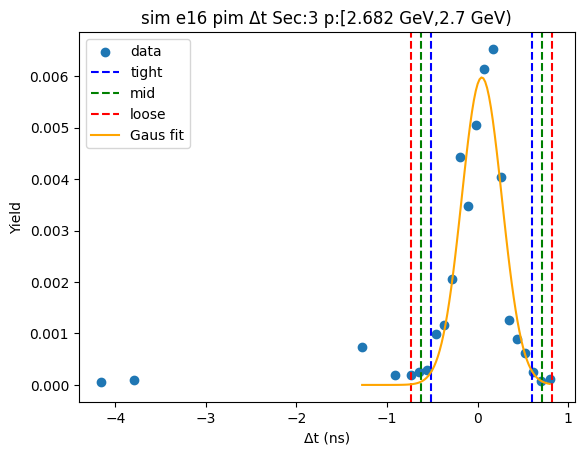

-0.8016678984554184 0.8660207704739424
-0.9684367653483543 1.0327896373668783
-1.1352056322412905 1.1995585042598145


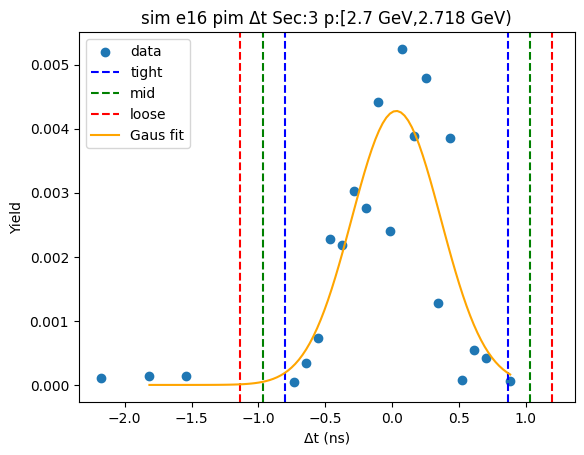

-0.6173716270745531 0.6706774221719602
-0.7461765319992043 0.7994823270966115
-0.8749814369238557 0.9282872320212628


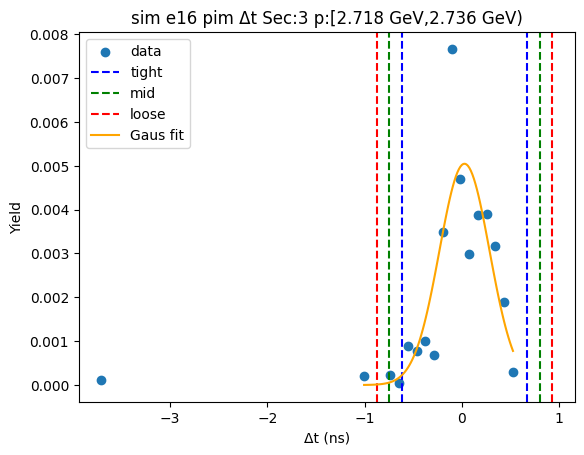

-0.694224774110975 0.6923522059933509
-0.8328824721214076 0.8310099040037835
-0.9715401701318402 0.9696676020142161


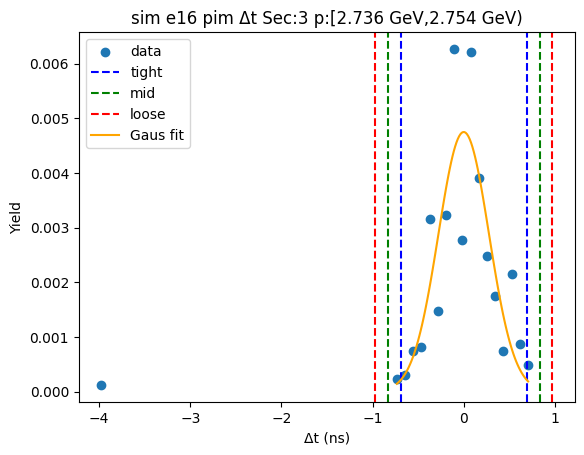

-0.5695307383462836 0.5709745425918059
-0.6835812664400926 0.6850250706856149
-0.7976317945339015 0.7990755987794238


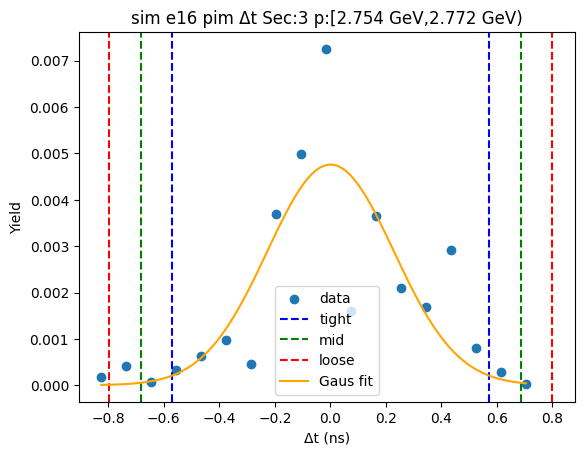

-0.6059884687256307 0.6369572029895911
-0.7302830358971529 0.7612517701611133
-0.8545776030686751 0.8855463373326355


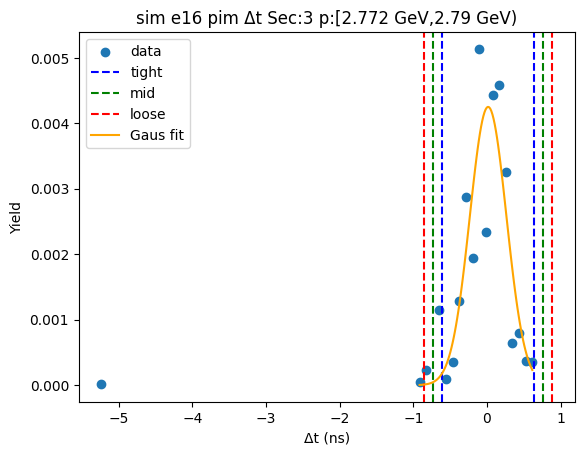

-0.8760449502060709 0.9435943699046964
-1.0580088822171474 1.125558301915773
-1.2399728142282243 1.30752223392685


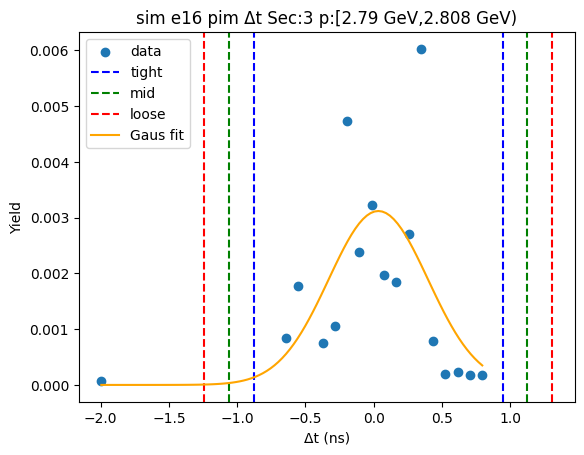

-0.8229339414789304 0.9217540623009638
-0.9974027418569199 1.0962228626789532
-1.1718715422349093 1.2706916630569425


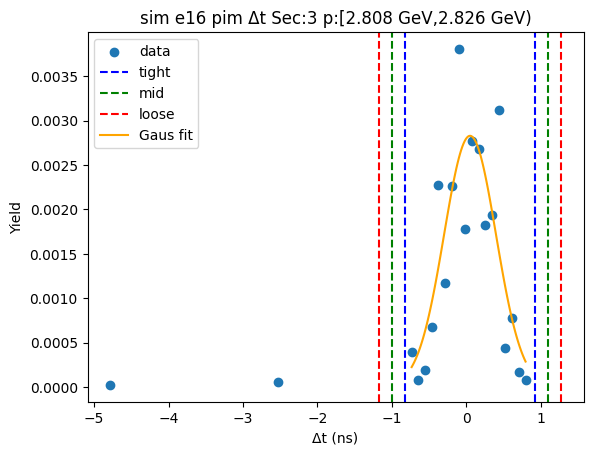

-0.506449849518321 0.4800875480192102
-0.605103589272074 0.5787412877729632
-0.703757329025827 0.6773950275267164


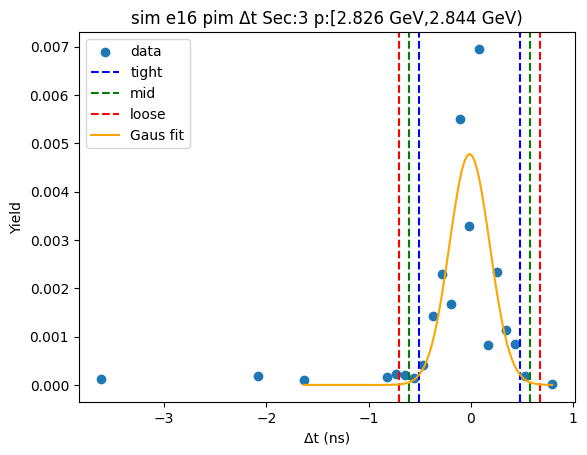

-0.5489545441704723 0.7546063318108777
-0.6793106317686073 0.8849624194090127
-0.8096667193667423 1.0153185070071475


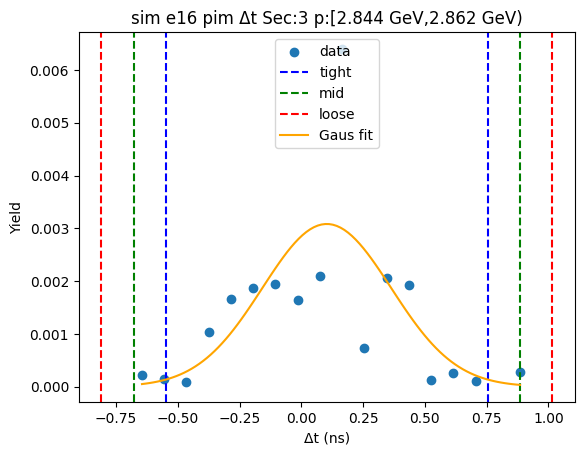

-0.7112977616377617 0.5607302719024708
-0.838500564991785 0.6879330752564942
-0.9657033683458083 0.8151358786105174


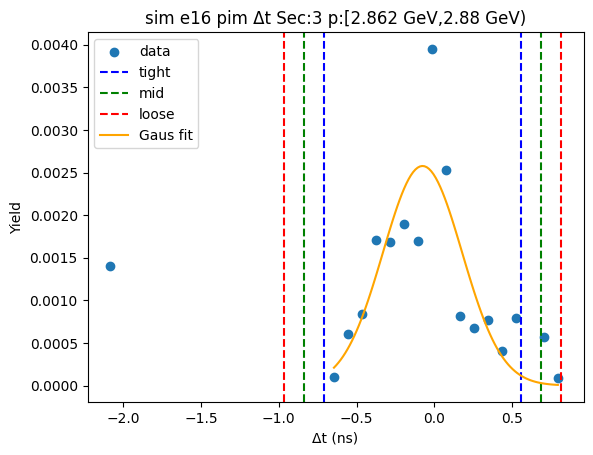

-1.0012601887781207 0.9992876658398384
-1.2013149742399167 1.1993424513016344
-1.4013697597017125 1.3993972367634302


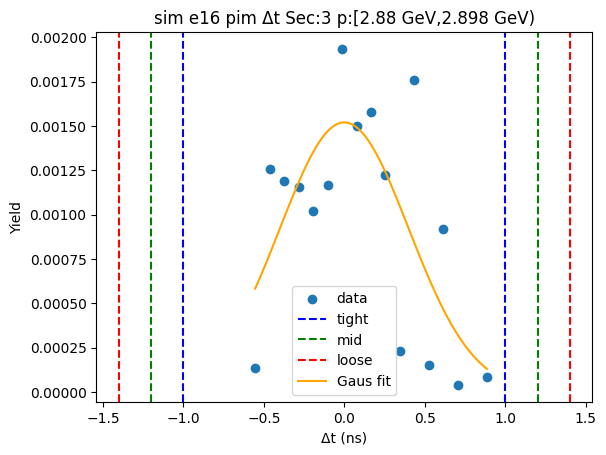

-0.36181820040940993 0.049792191799154645
-0.40297923963026644 0.09095323102001113
-0.4441402788511229 0.13211427024086758


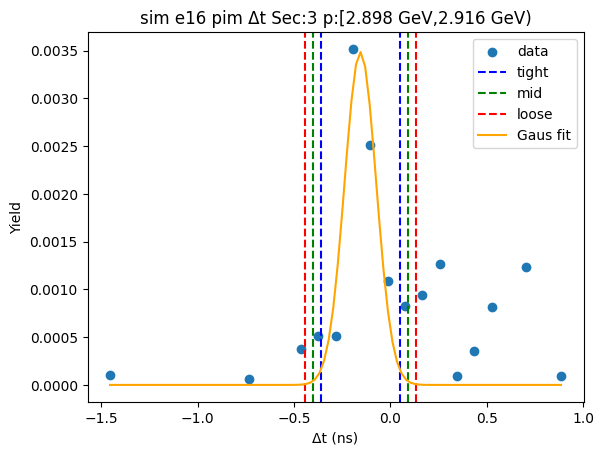

-0.31430952469800516 -0.037960307696031426
-0.34194444639820254 -0.010325385995834047
-0.3695793680983999 0.017309535704363332


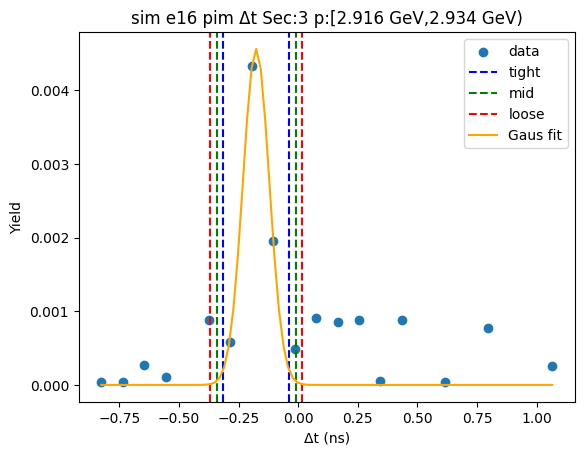

-0.3407229436372893 -0.080863324003564
-0.3667089056006618 -0.054877362040191446
-0.3926948675640344 -0.028891400076818924


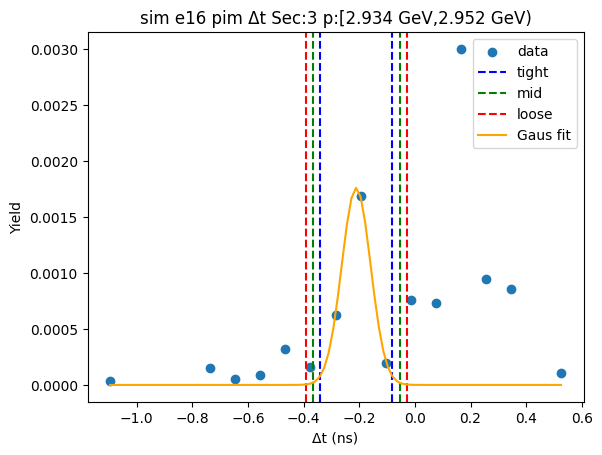

-0.6487235773689061 0.5758926974479169
-0.7711852048505884 0.6983543249295993
-0.8936468323322707 0.8208159524112816


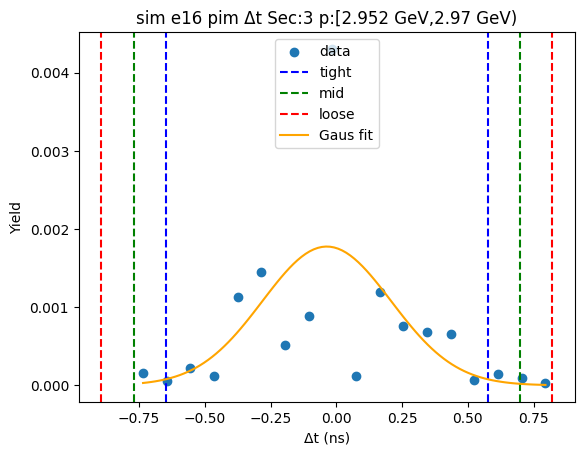

-1.045035609496595 0.9865560541190327
-1.2481947758581577 1.1897152204805954
-1.4513539422197204 1.392874386842158


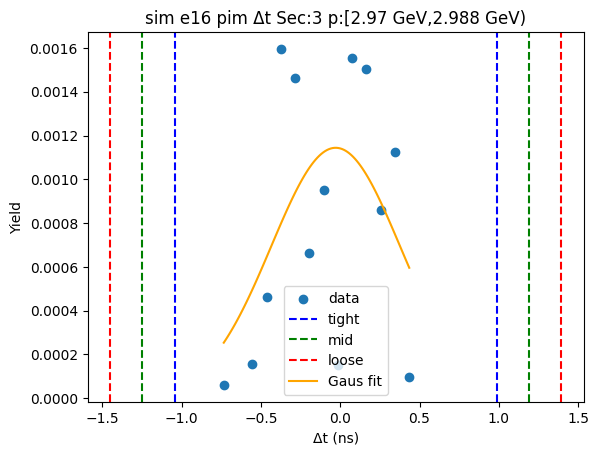

-0.8376930173169838 0.7056315644733814
-0.9920254754960203 0.8599640226524179
-1.1463579336750567 1.0142964808314543


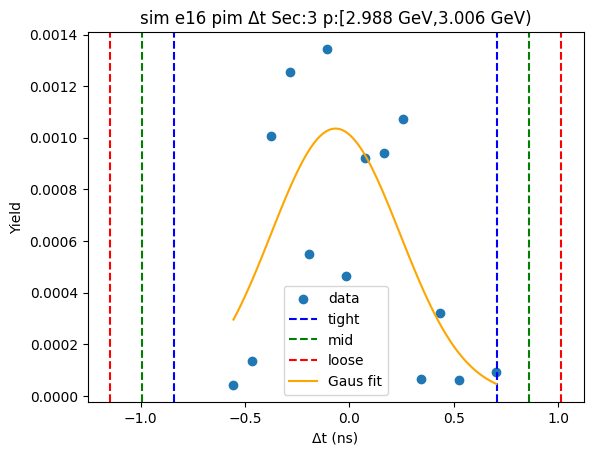

-0.961257928658268 1.0521476974108315
-1.1625984912651777 1.2534882600177413
-1.3639390538720875 1.454828822624651


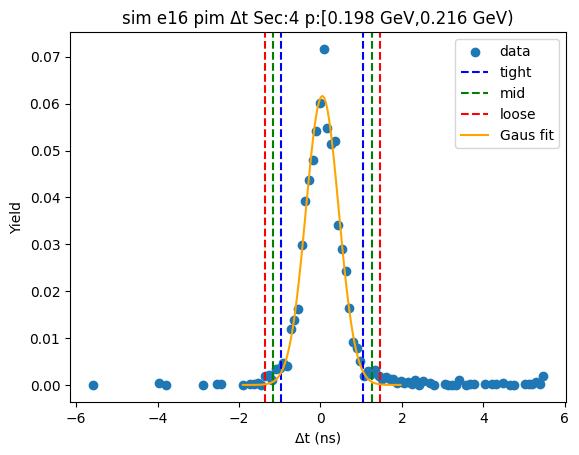

-0.9466014999957417 0.9838412811884099
-1.139645778114157 1.1768855593068248
-1.332690056232572 1.36992983742524


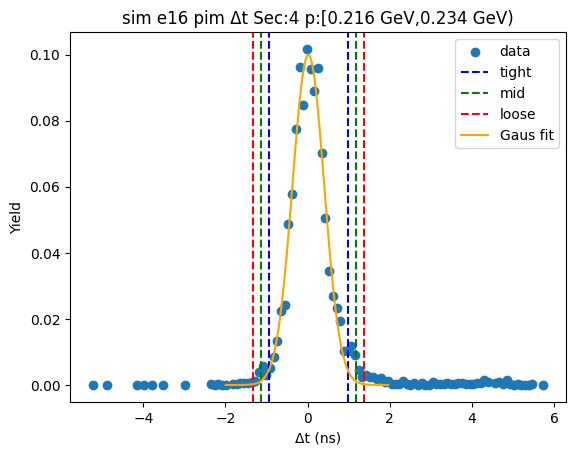

-0.8993640518265917 0.9342777492356245
-1.0827282319328135 1.1176419293418463
-1.266092412039035 1.3010061094480678


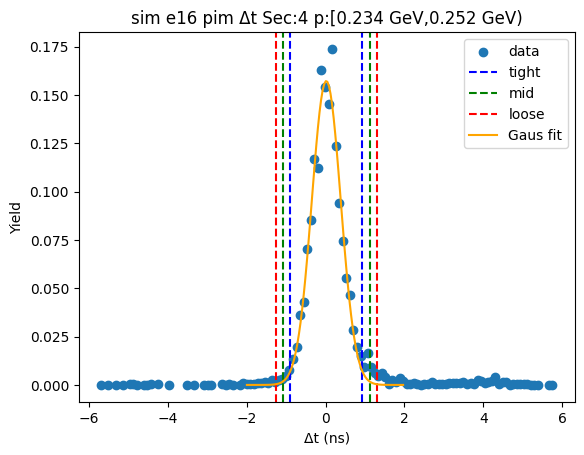

-0.8496653024560082 0.8674786975573386
-1.0213797024573432 1.0391930975586734
-1.1930941024586779 1.210907497560008


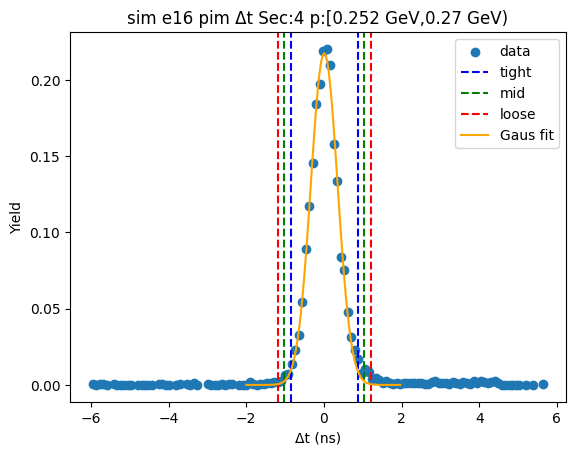

-0.8342533658014513 0.8439157253033507
-1.0020702749119315 1.0117326344138309
-1.1698871840224117 1.179549543524311


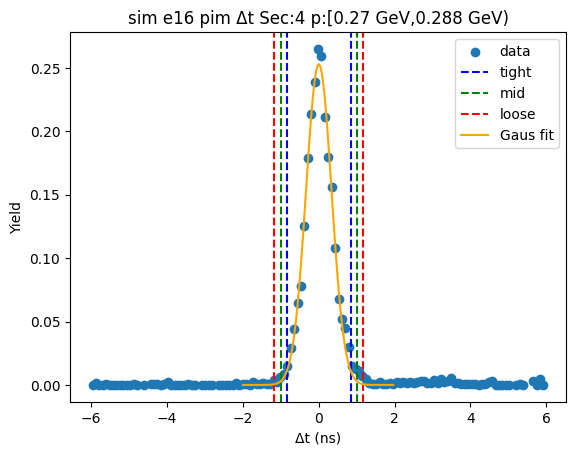

-0.8496689794126208 0.8710174611608036
-1.021737623469963 1.043086105218146
-1.1938062675273056 1.2151547492754884


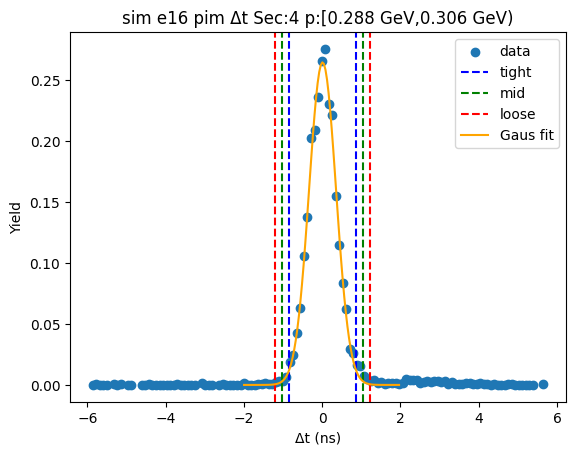

-0.8236545302728038 0.8663028769016976
-0.9926502709902538 1.0352986176191477
-1.161646011707704 1.204294358336598


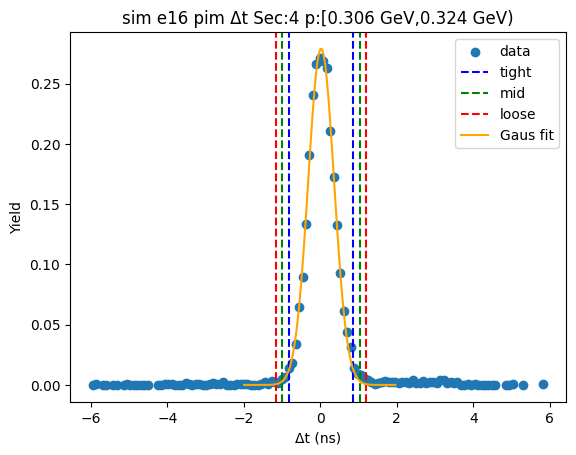

-0.7989572307971661 0.8226403039354832
-0.9611169842704309 0.984800057408748
-1.123276737743696 1.146959810882013


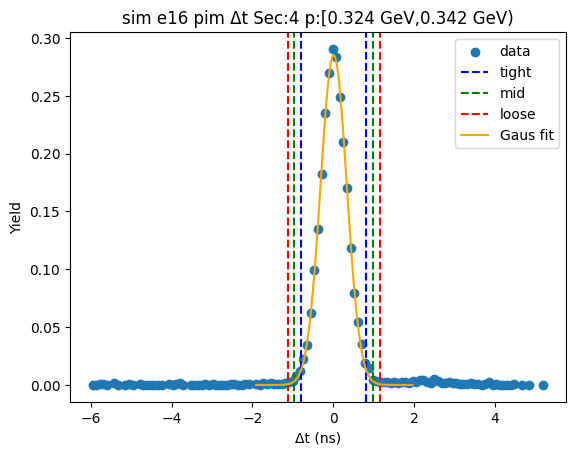

-0.7904833817031504 0.8239626448669571
-0.951927984360161 0.9854072475239678
-1.1133725870171718 1.1468518501809788


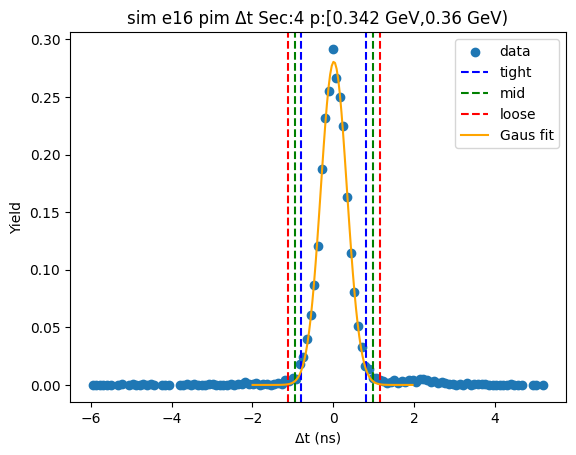

-0.8064044228328767 0.8280956891935435
-0.9698544340355187 0.9915457003961855
-1.1333044452381607 1.1549957115988276


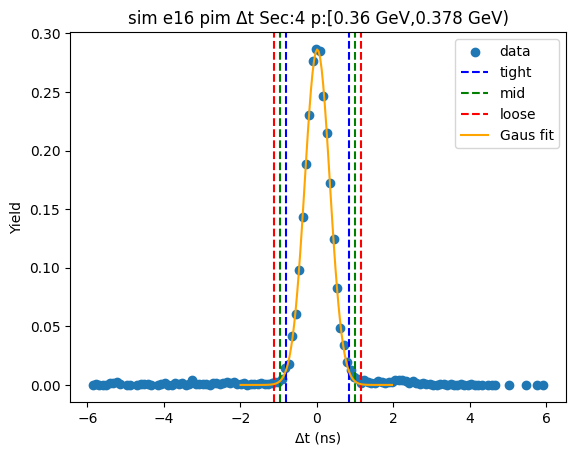

-0.8126485230304019 0.8342127364958636
-0.9773346489830285 0.9988988624484901
-1.1420207749356548 1.1635849884011167


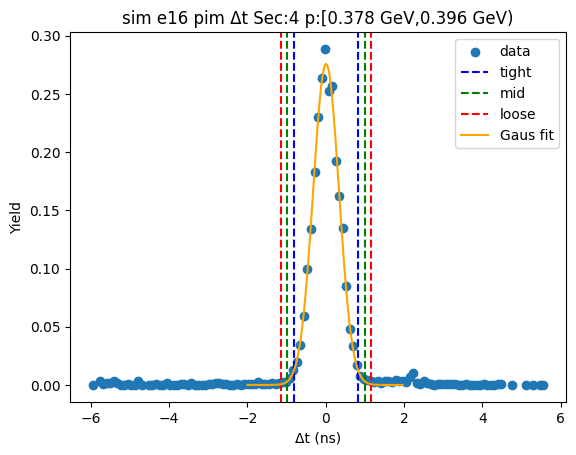

-0.7978238983799094 0.8432705911495507
-0.9619333473328555 1.0073800401024968
-1.1260427962858015 1.1714894890554428


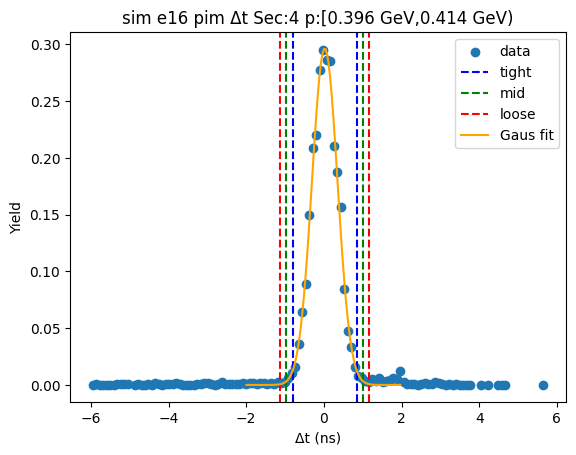

-0.7871267423598824 0.8168137423654882
-0.9475207908324196 0.9772077908380253
-1.1079148393049567 1.1376018393105625


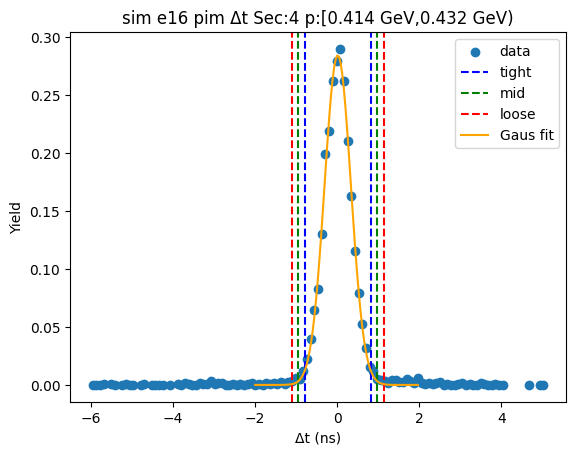

-0.7757012438531943 0.8100963766314846
-0.9342810059016621 0.9686761386799524
-1.0928607679501299 1.1272559007284204


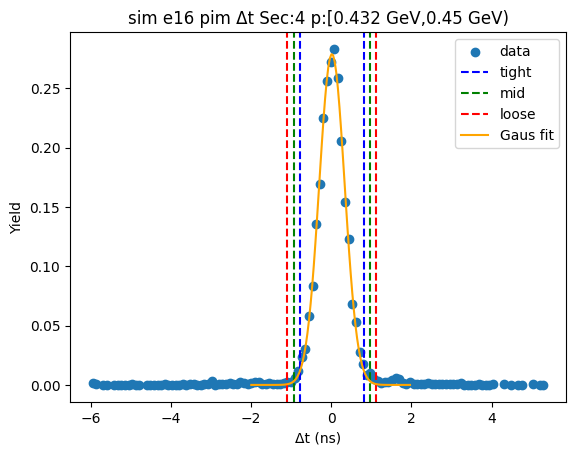

-0.7788211878717902 0.8008819993792399
-0.9367915065968931 0.9588523181043428
-1.0947618253219964 1.1168226368294458


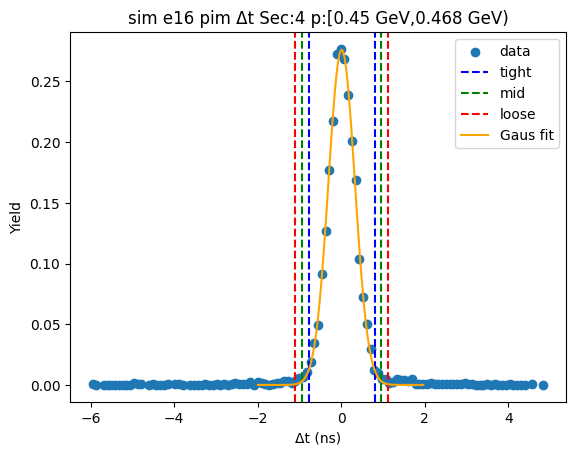

-0.7772370977757831 0.8139090821308902
-0.9363517157664505 0.9730237001215576
-1.095466333757118 1.1321383181122249


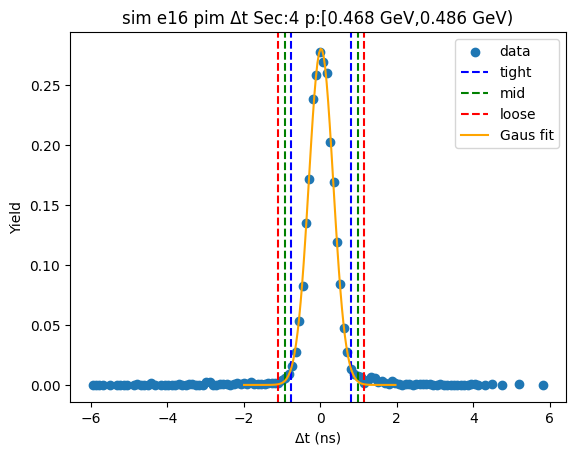

-0.7535241049807928 0.7549510030348883
-0.9043716157823609 0.9057985138364564
-1.055219126583929 1.0566460246380245


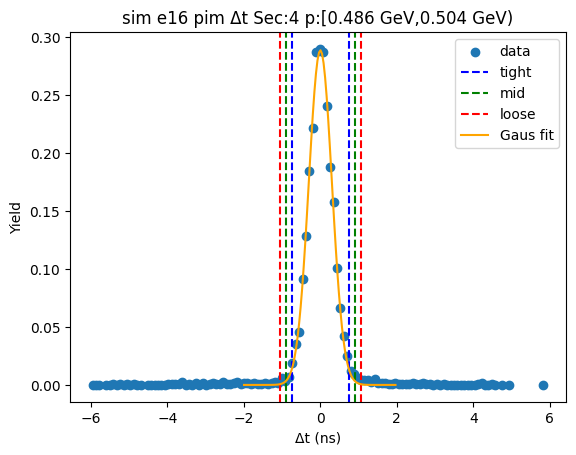

-0.7791293399795717 0.799314115388876
-0.9369736855164164 0.9571584609257207
-1.0948180310532611 1.1150028064625654


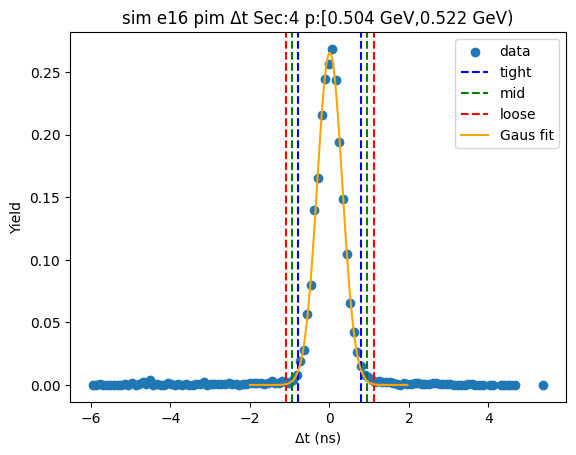

-0.7829181385761159 0.8003037337350751
-0.9412403258072349 0.9586259209661941
-1.099562513038354 1.1169481081973134


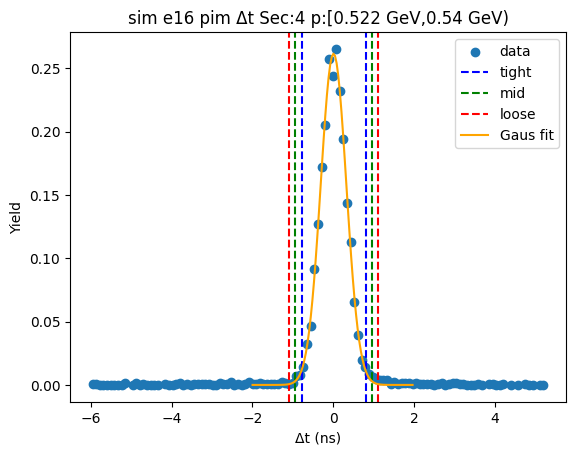

-0.7558949439947114 0.7735482642724467
-0.9088392648214271 0.9264925850991624
-1.0617835856481428 1.0794369059258784


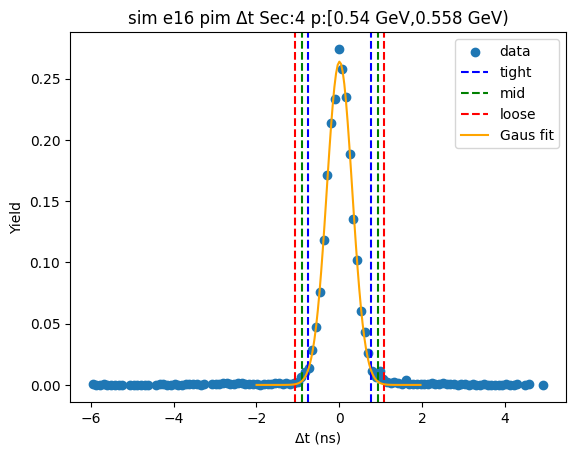

-0.7644877261796921 0.799262638950905
-0.9208627626927517 0.9556376754639646
-1.0772377992058115 1.1120127119770244


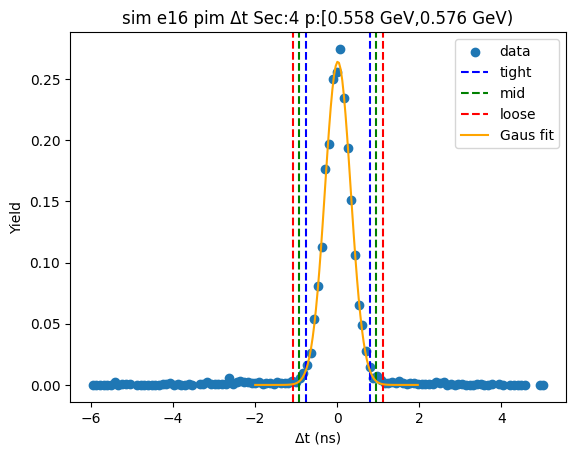

-0.7796683347964902 0.8104436770458515
-0.9386795359807244 0.9694548782300857
-1.0976907371649585 1.12846607941432


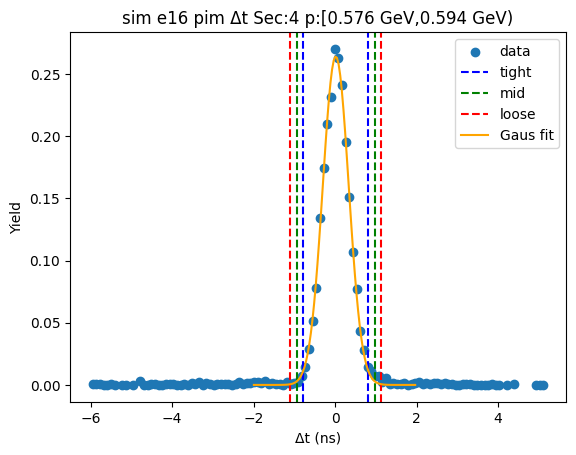

-0.7651951303003128 0.7927040201738365
-0.9209850453477278 0.9484939352212515
-1.0767749603951429 1.1042838502686663


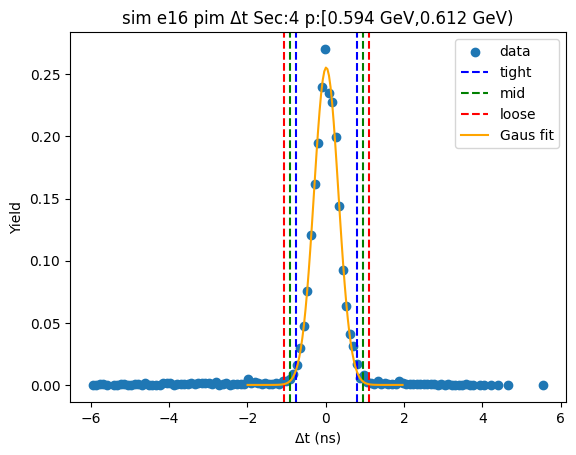

-0.7678551098940759 0.7946094967534806
-0.9241015705588315 0.9508559574182361
-1.0803480312235871 1.107102418082992


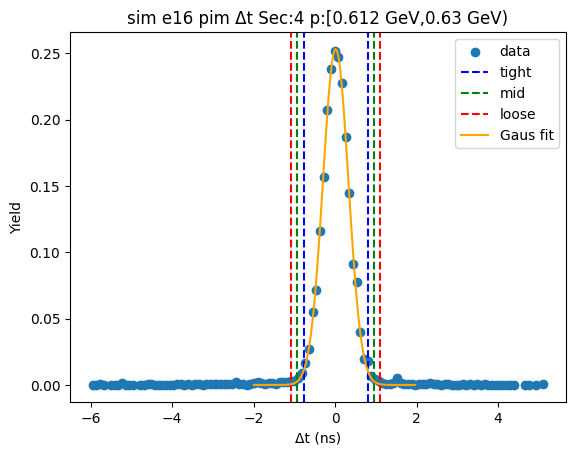

-0.7809246044472206 0.8028441040519162
-0.9393014752971341 0.9612209749018298
-1.097678346147048 1.1195978457517435


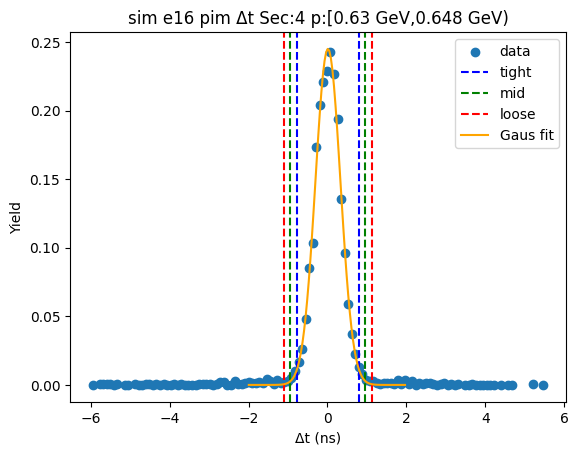

-0.7851303730184641 0.7951259450646709
-0.9431560048267775 0.9531515768729844
-1.101181636635091 1.1111772086812979


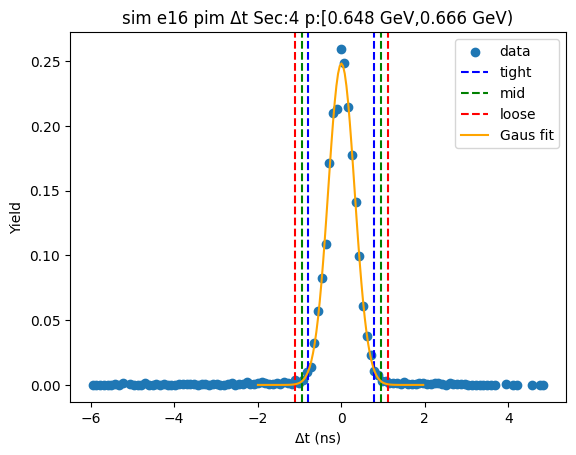

-0.7603310425600356 0.7741137006082295
-0.9137755168768621 0.927558174925056
-1.0672199911936884 1.0810026492418825


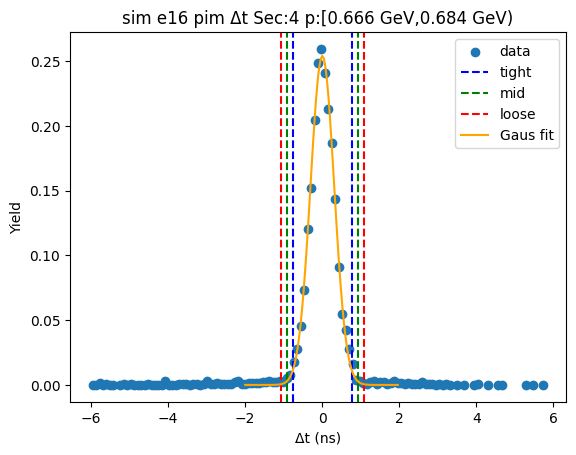

-0.7767115849330255 0.7927680170047755
-0.9336595451268056 0.9497159771985556
-1.0906075053205857 1.1066639373923355


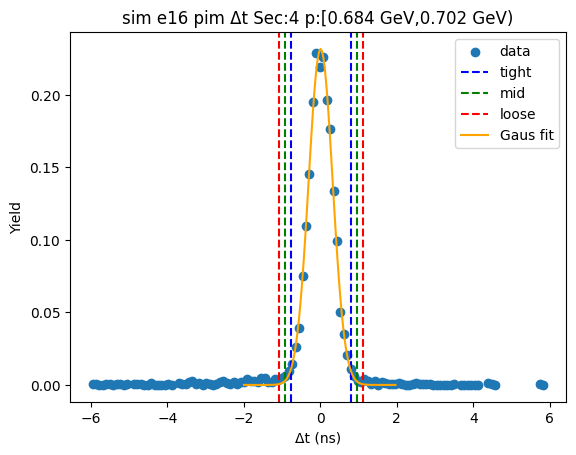

-0.7500671855236988 0.7687486675381782
-0.9019487708298866 0.920630252844366
-1.0538303561360742 1.0725118381505536


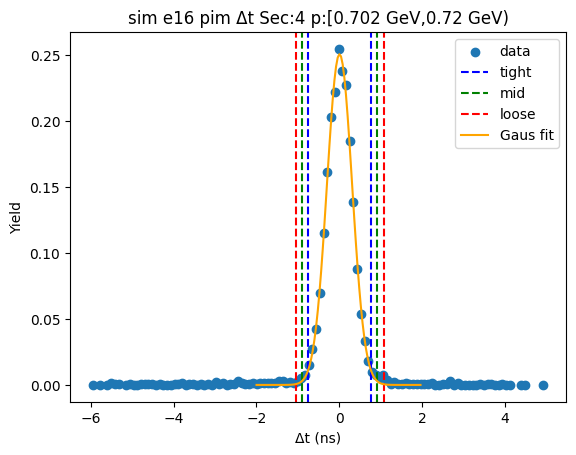

-0.7483711317646345 0.7484468032703963
-0.8980529252681376 0.8981285967738993
-1.0477347187716408 1.0478103902774023


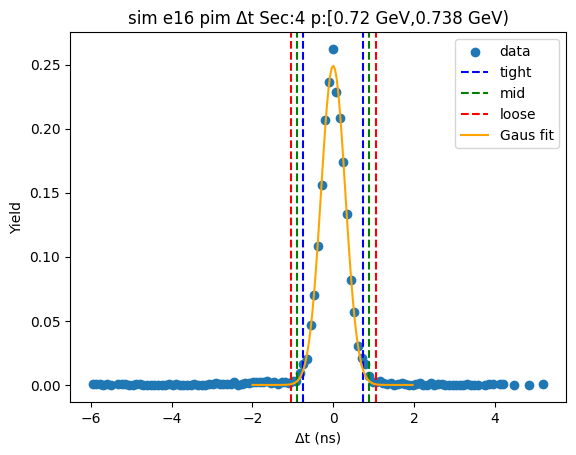

-0.7572600414398566 0.7692106212704214
-0.9099071077108845 0.9218576875414493
-1.0625541739819122 1.0745047538124772


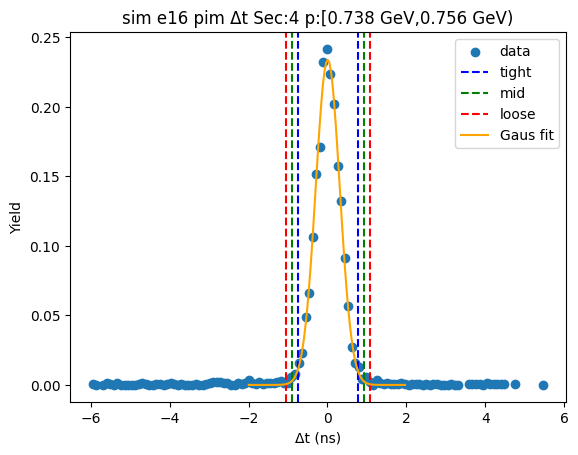

-0.7662498905541633 0.7829373241690469
-0.9211686120264844 0.937856045641368
-1.0760873334988053 1.092774767113689


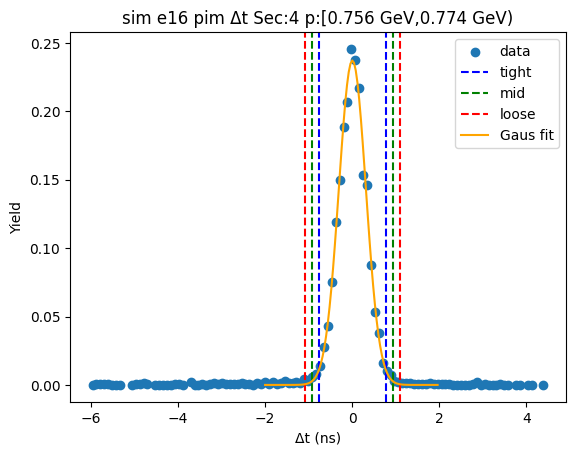

-0.741501692618417 0.75539535856383
-0.8911913977366418 0.9050850636820548
-1.0408811028548666 1.0547747688002795


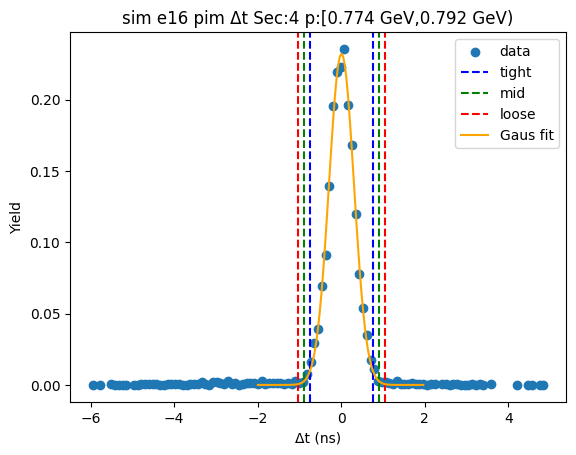

-0.7493157846748857 0.7891345725891776
-0.9031608204012921 0.942979608315584
-1.0570058561276985 1.0968246440419904


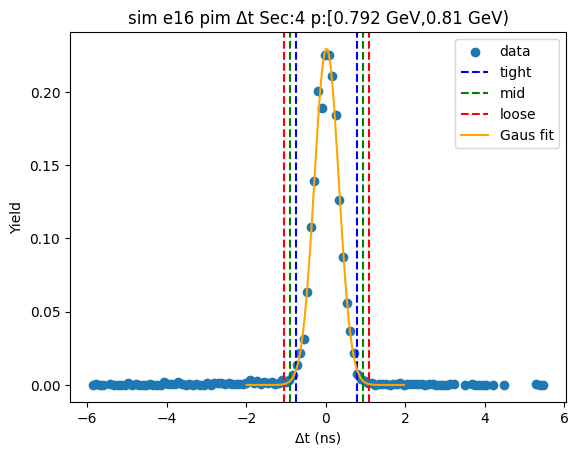

-0.7569794197160475 0.7782079840070644
-0.9104981600883588 0.9317267243793756
-1.0640169004606699 1.0852454647516867


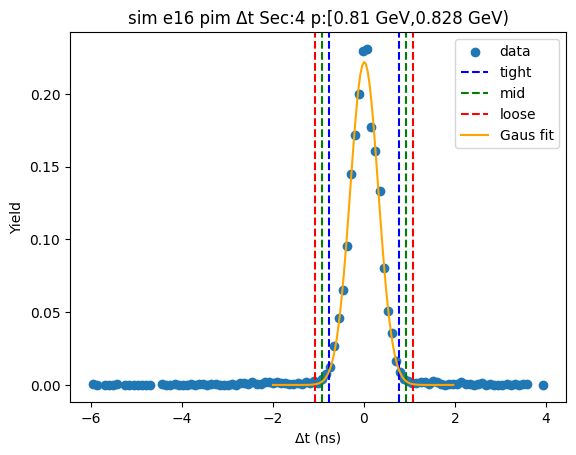

-0.724835268328286 0.7423471423599867
-0.8715535093971134 0.889065383428814
-1.0182717504659407 1.0357836244976413


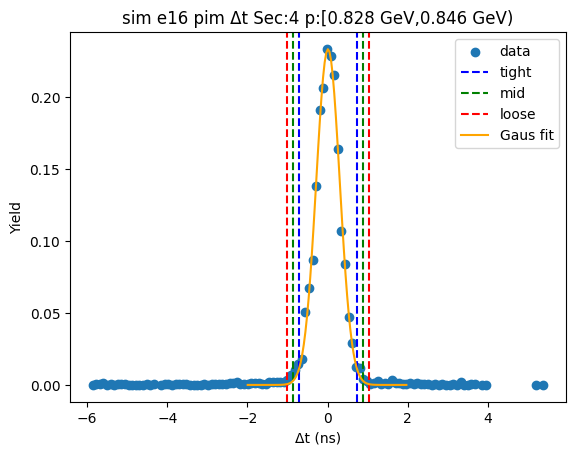

-0.7597809943859308 0.7591965212196026
-0.9116787459464842 0.911094272780156
-1.0635764975070376 1.0629920243407094


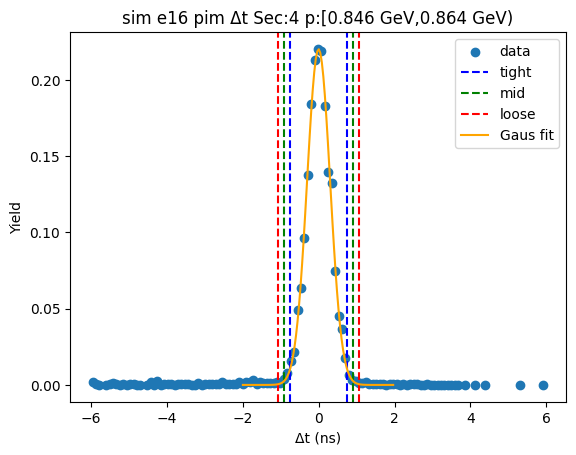

-0.7602283462546492 0.7819915273391825
-0.9144503336140323 0.9362135146985656
-1.0686723209734155 1.090435502057949


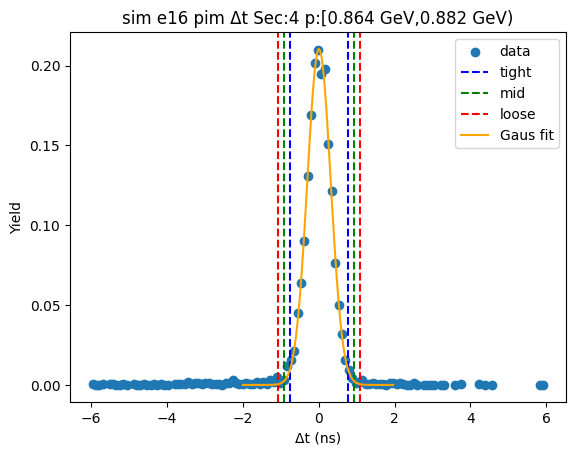

-0.7426343973690961 0.7363355784992309
-0.8905313949559287 0.8842325760860635
-1.0384283925427613 1.0321295736728964


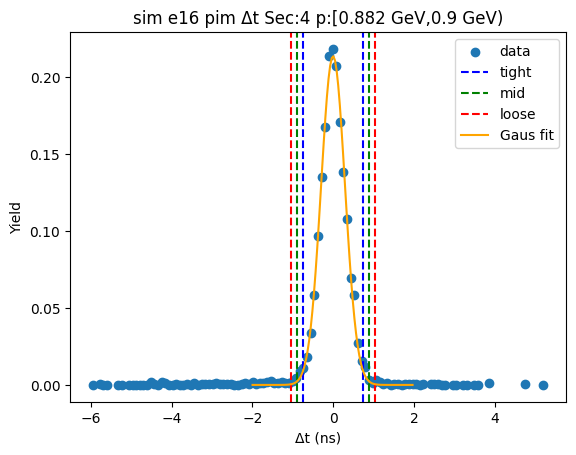

-0.7534367380805089 0.753563936236239
-0.9041368055121838 0.9042640036679138
-1.0548368729438586 1.0549640710995887


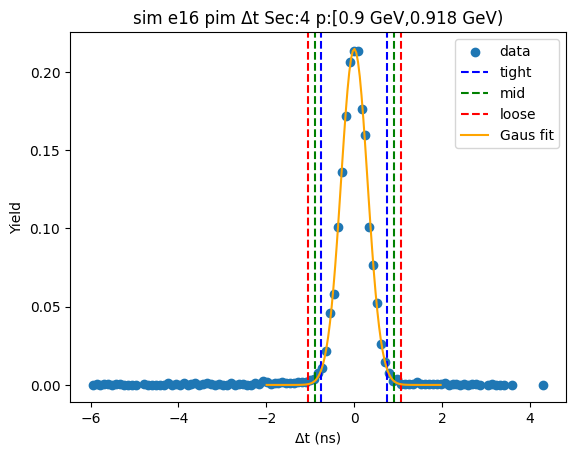

-0.7335382469965203 0.7550202757861327
-0.8823940992747856 0.9038761280643981
-1.031249951553051 1.0527319803426634


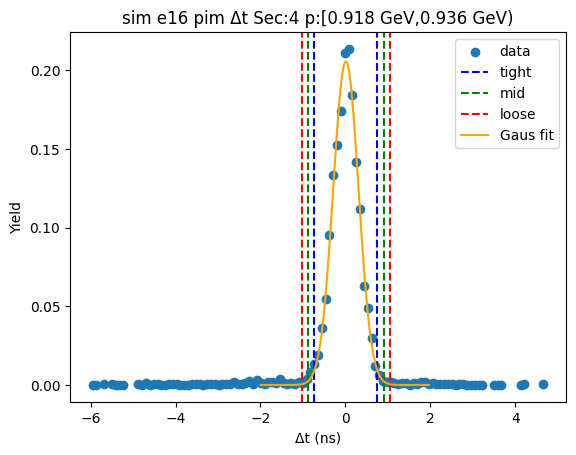

-0.774490425869211 0.7909301067162909
-0.9310324791277612 0.9474721599748411
-1.0875745323863113 1.1040142132333914


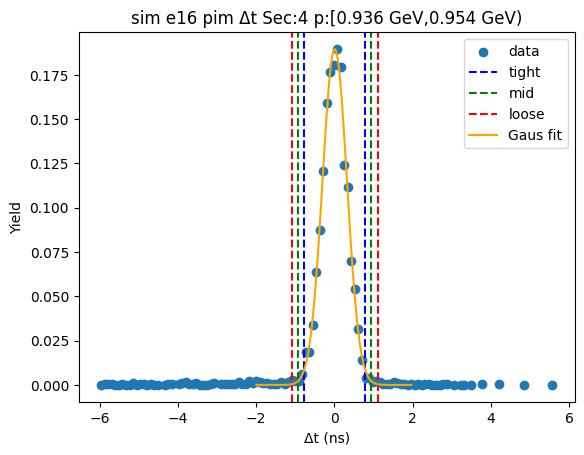

-0.7314349430952943 0.7615736585093839
-0.8807358032557621 0.9108745186698516
-1.0300366634162301 1.0601753788303194


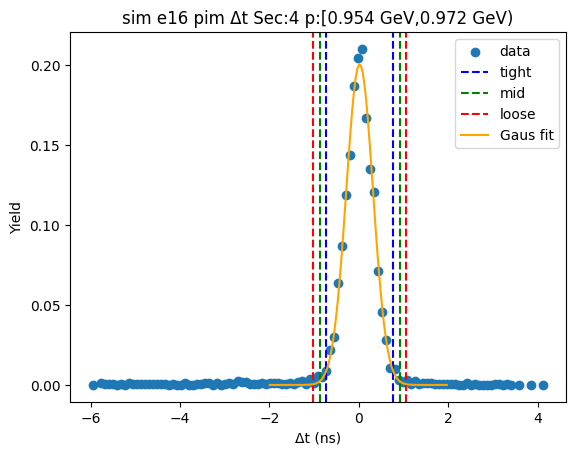

-0.7238678581710017 0.7561749428404386
-0.8718721382721457 0.9041792229415826
-1.0198764183732898 1.0521835030427265


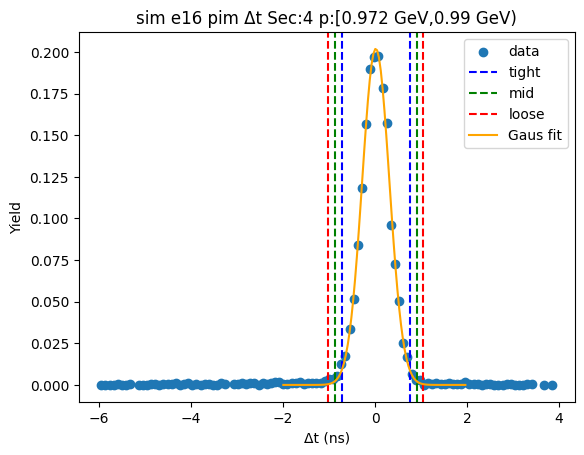

-0.7567097165739667 0.7496747313663501
-0.9073481613679985 0.9003131761603819
-1.05798660616203 1.0509516209544136


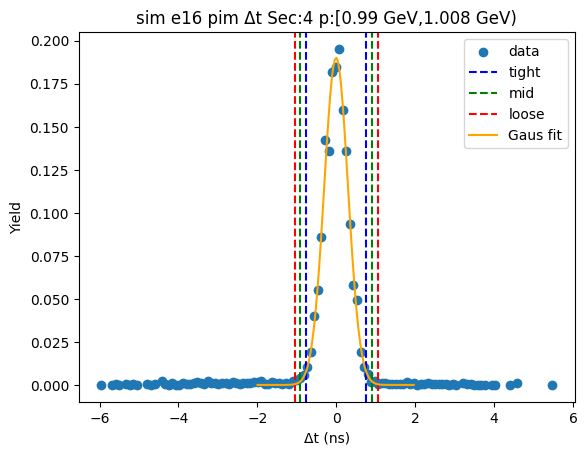

-0.7410870349118218 0.7749411043750419
-0.8926898488405083 0.9265439183037284
-1.0442926627691944 1.0781467322324148


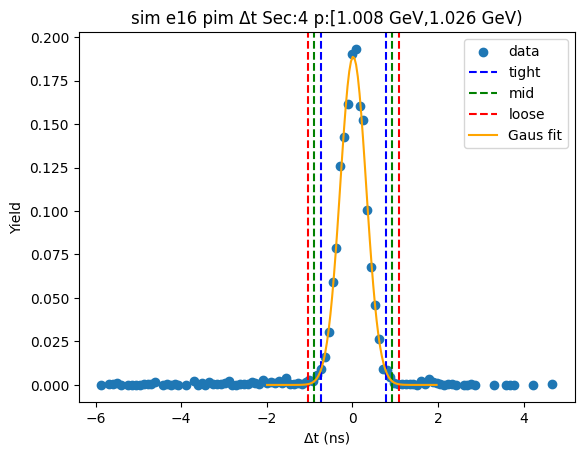

-0.7380916118742951 0.7450107694360746
-0.8864018500053321 0.8933210075671116
-1.034712088136369 1.0416312456981485


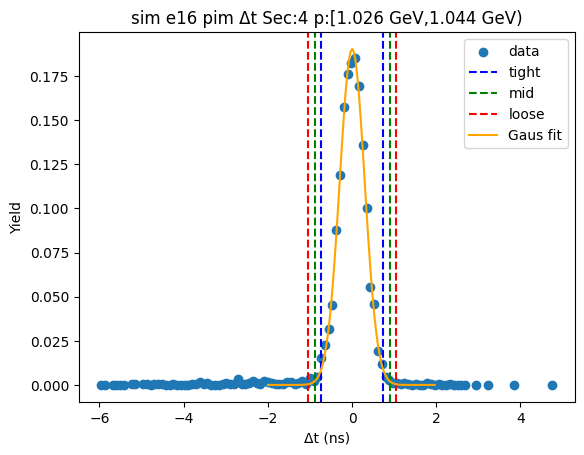

-0.7594988693673842 0.7648267221771085
-0.9119314285218334 0.9172592813315577
-1.0643639876762827 1.0696918404860067


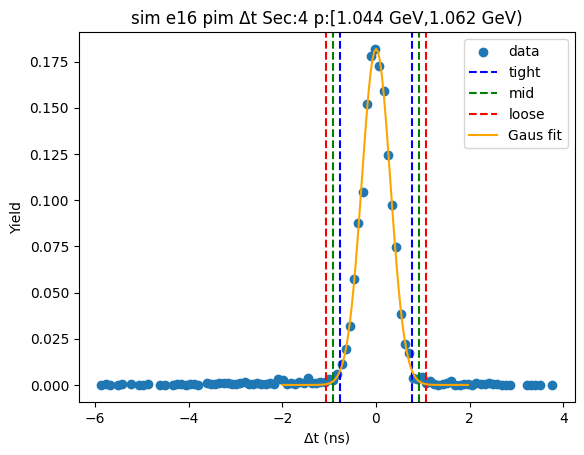

-0.7299388486365467 0.7233154110922501
-0.8752642746094264 0.8686408370651297
-1.020589700582306 1.0139662630380093


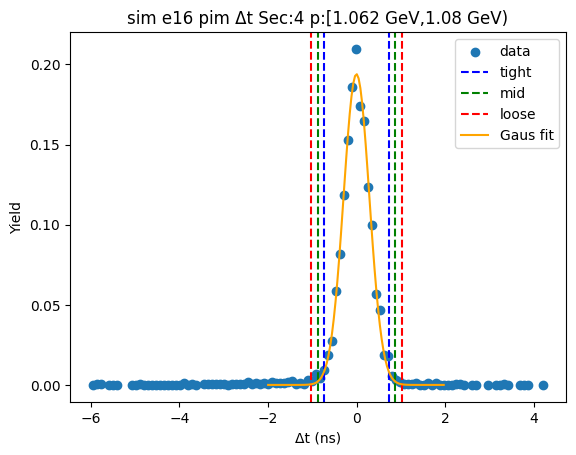

-0.7338517194424259 0.7560181197724478
-0.8828387033639133 0.9050051036939353
-1.0318256872854006 1.0539920876154225


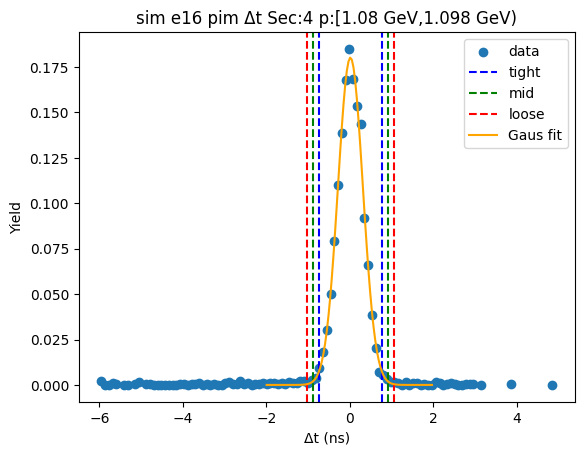

-0.7504713892754937 0.7566652081699647
-0.9011850490200395 0.9073788679145105
-1.0518987087645855 1.0580925276590565


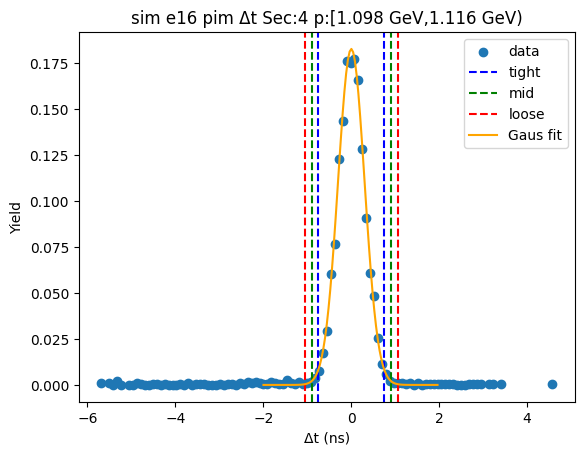

-0.7266774533317403 0.7189909130902338
-0.8712442899739378 0.8635577497324313
-1.015811126616135 1.0081245863746287


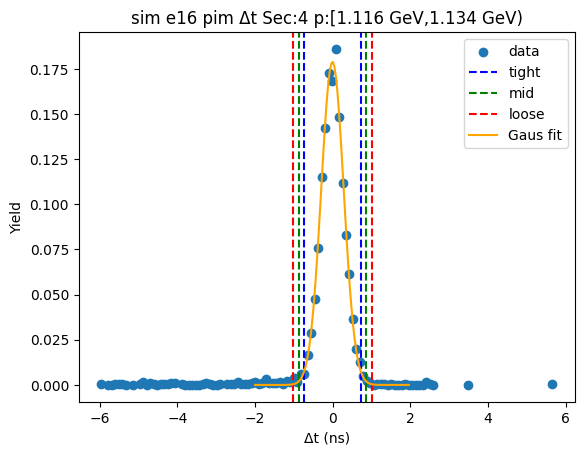

-0.738075173115562 0.7483989410039825
-0.8867225845275164 0.8970463524159369
-1.0353699959394709 1.0456937638278914


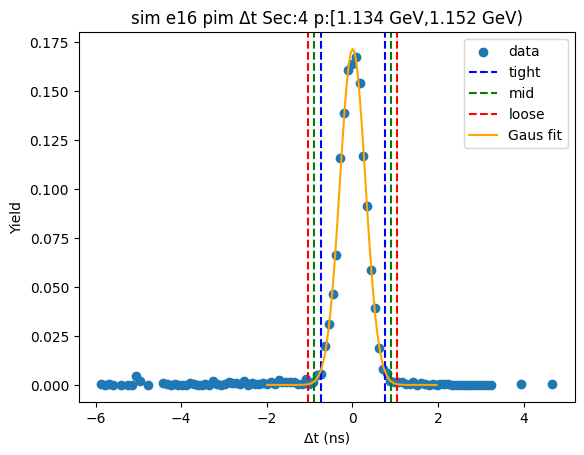

-0.7353507115571918 0.7589277097425111
-0.8847785536871621 0.9083555518724814
-1.0342063958171321 1.0577833940024517


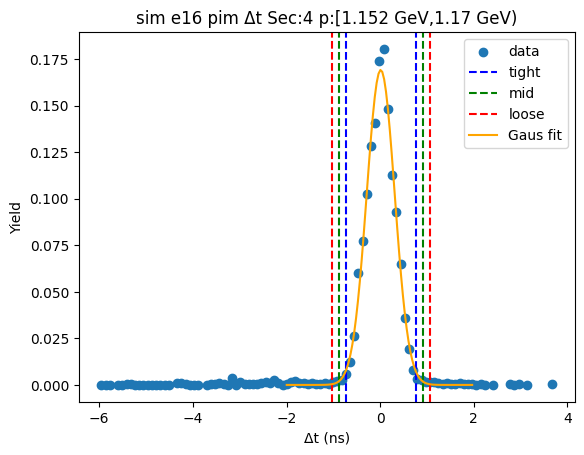

-0.7314185841295036 0.7581965937085409
-0.8803801019133081 0.9071581114923454
-1.0293416196971126 1.0561196292761499


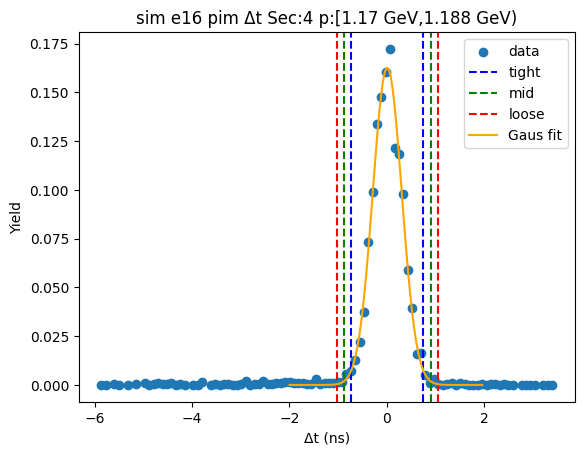

-0.7346582924997251 0.7387470791692368
-0.8819988296666212 0.8860876163361329
-1.0293393668335176 1.0334281535030292


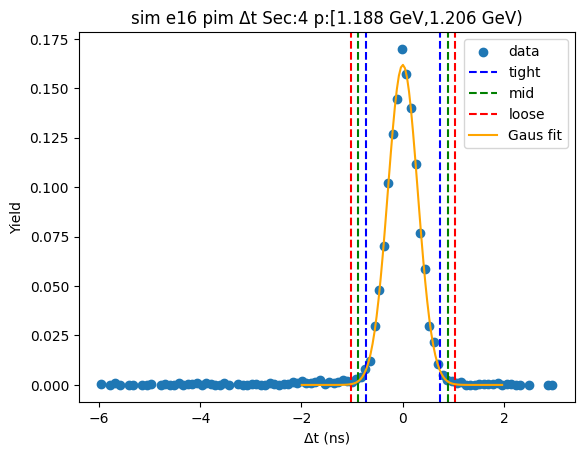

-0.724414230783902 0.7530577768434544
-0.8721614315466377 0.9008049776061902
-1.0199086323093733 1.0485521783689258


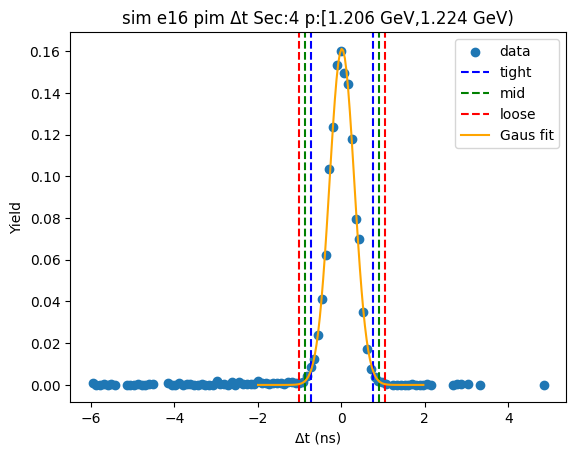

-0.7221059121626008 0.7194813586336968
-0.8662646392422306 0.8636400857133266
-1.0104233663218603 1.0077988127929562


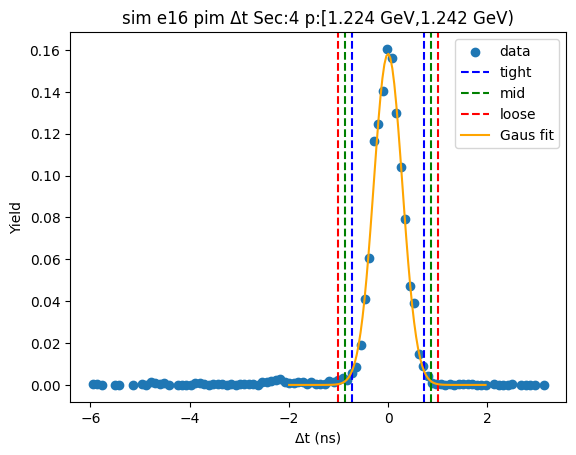

-0.7150368887511743 0.7342958273073555
-0.8599701603570272 0.8792290989132084
-1.0049034319628805 1.0241623705190614


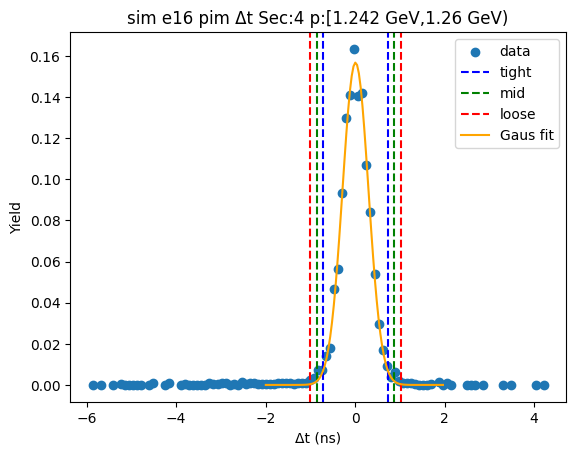

-0.7056172569269885 0.7369116724400935
-0.8498701498636968 0.8811645653768018
-0.994123042800405 1.02541745831351


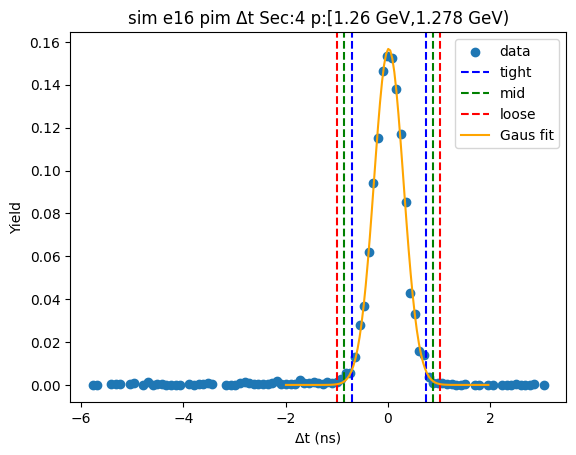

-0.7282246065244954 0.7420343066144627
-0.8752504978383913 0.8890601979283586
-1.0222763891522872 1.0360860892422543


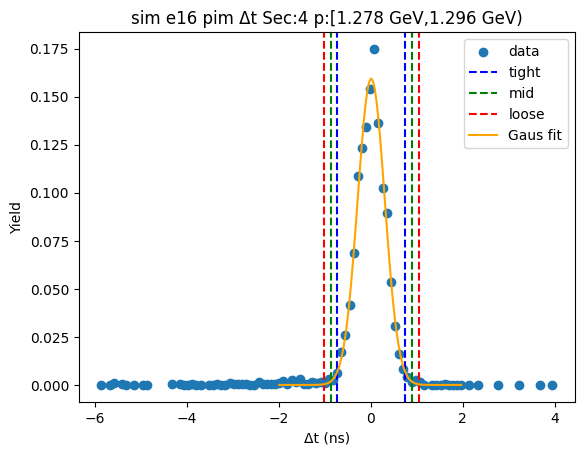

-0.7193039355609517 0.741410886393795
-0.8653754177564263 0.8874823685892697
-1.011446899951901 1.0335538507847442


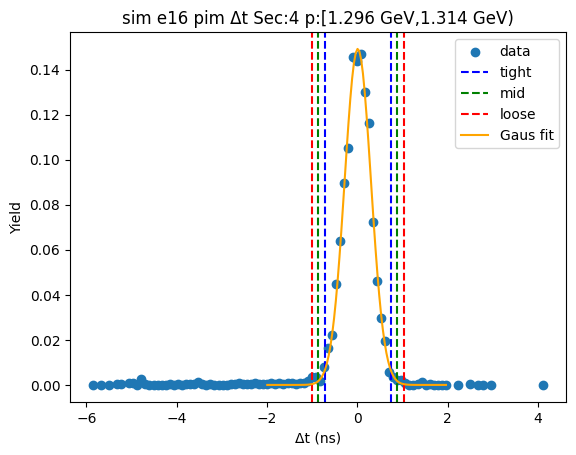

-0.7336017852132694 0.7378541177289212
-0.8807473755074885 0.8849997080231403
-1.0278929658017075 1.0321452983173591


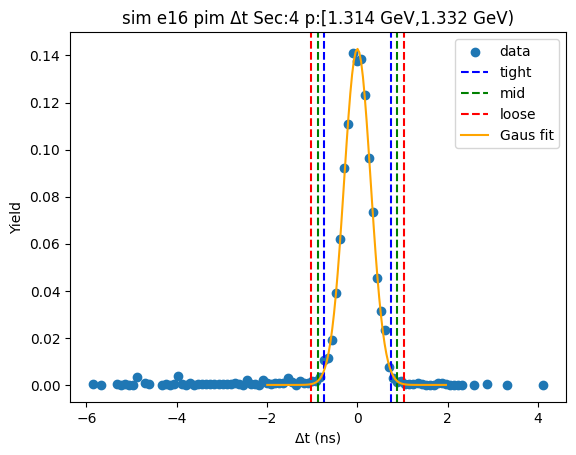

-0.7043101591971989 0.7160716825237828
-0.8463483433692971 0.8581098666958811
-0.9883865275413953 1.0001480508679794


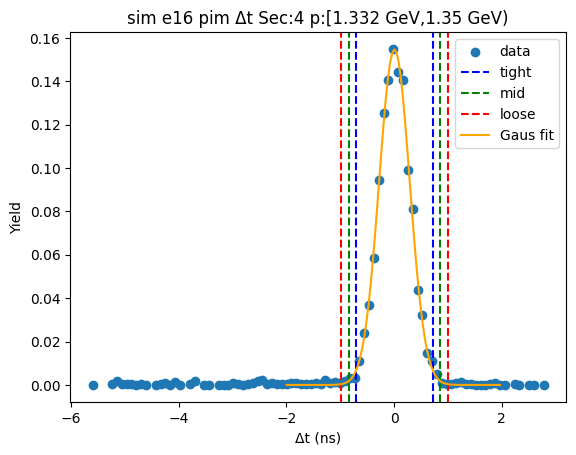

-0.6677149398482831 0.6998660500086571
-0.8044730388339771 0.8366241489943511
-0.9412311378196712 0.9733822479800451


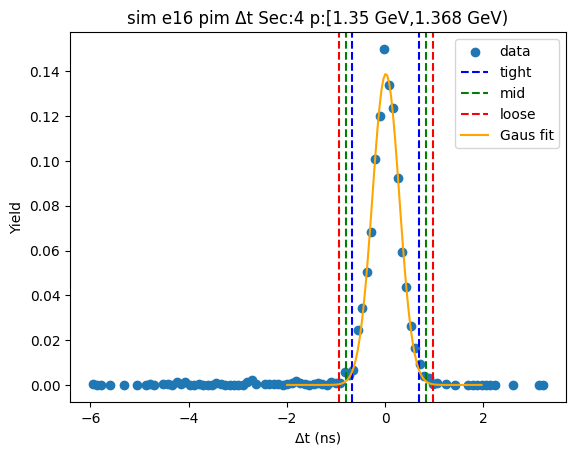

-0.7401707479334593 0.7571800557754161
-0.8899058283043467 0.9069151361463036
-1.0396409086752343 1.0566502165171914


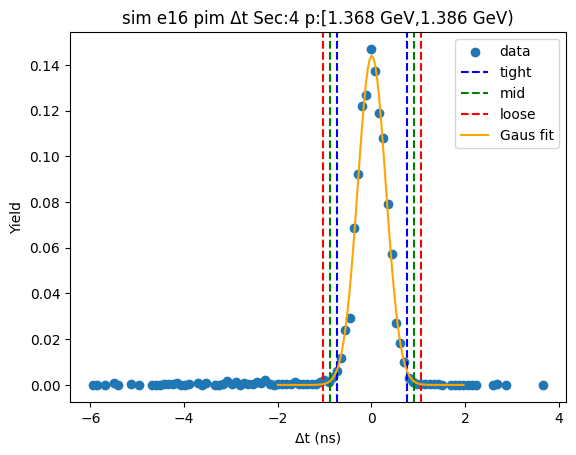

-0.6879008603012242 0.7005428912100788
-0.8267452354523545 0.8393872663612091
-0.9655896106034847 0.9782316415123393


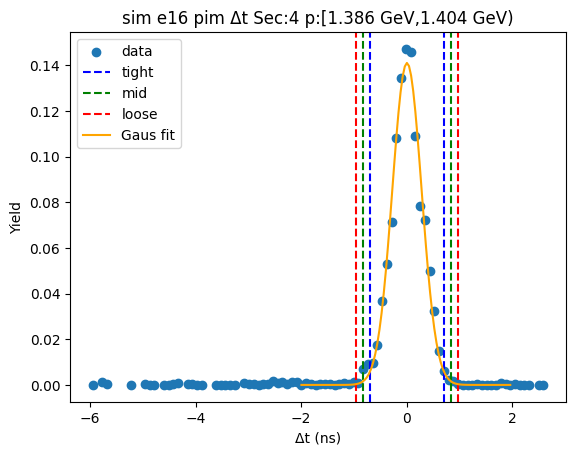

-0.7122955833684341 0.731911119006853
-0.8567162536059629 0.8763317892443818
-1.0011369238434915 1.0207524594819104


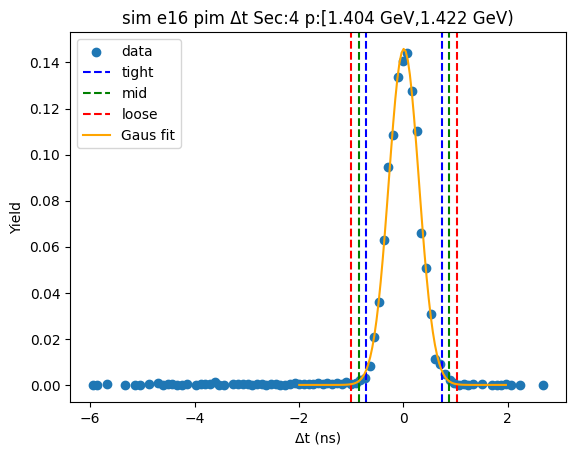

-0.7452206709112771 0.745377083939785
-0.8942804463963834 0.8944368594248913
-1.0433402218814896 1.0434966349099974


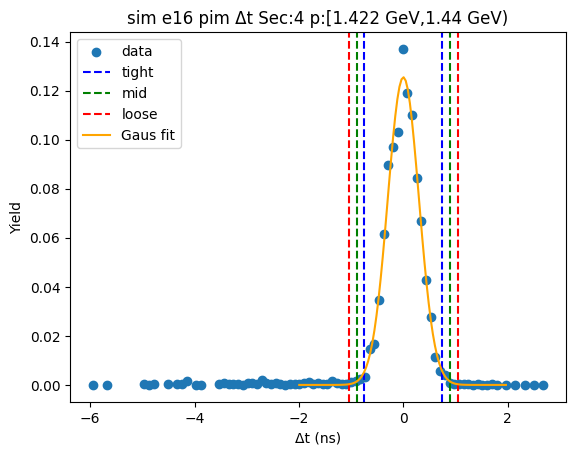

-0.7198681760634363 0.7396172390971162
-0.8658167175794915 0.8855657806131714
-1.0117652590955468 1.0315143221292264


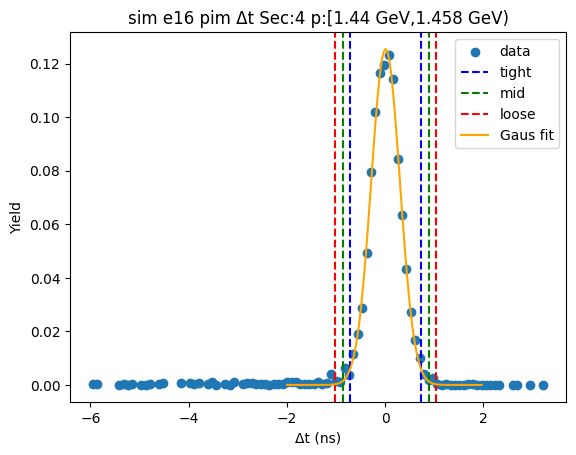

-0.705425339864869 0.7217194561781283
-0.8481398194691687 0.864433935782428
-0.9908542990734684 1.0071484153867276


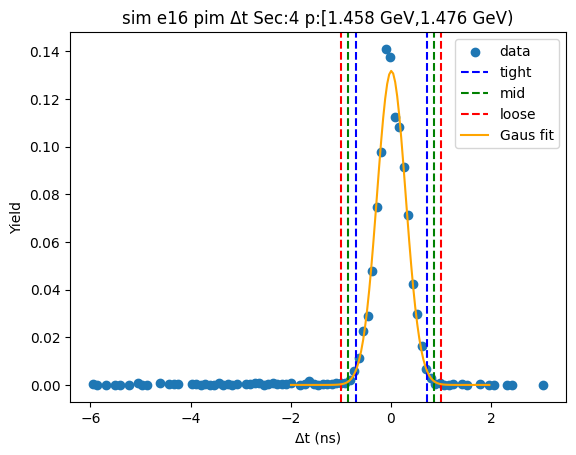

-0.7309020793396849 0.7386859888065768
-0.8778608861543111 0.885644795621203
-1.0248196929689373 1.0326036024358292


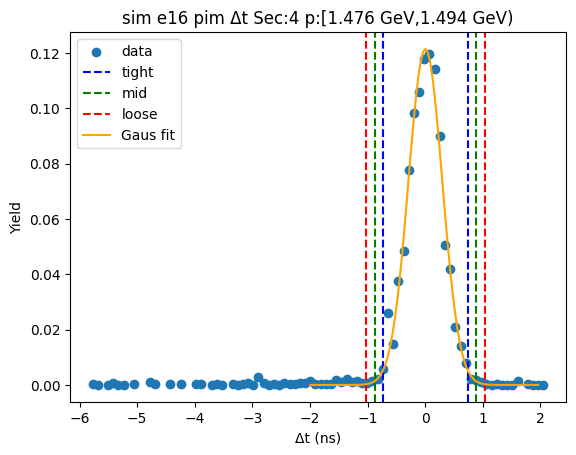

-0.694773869812788 0.7219968781582587
-0.8364509446098927 0.8636739529553634
-0.9781280194069973 1.0053510277524682


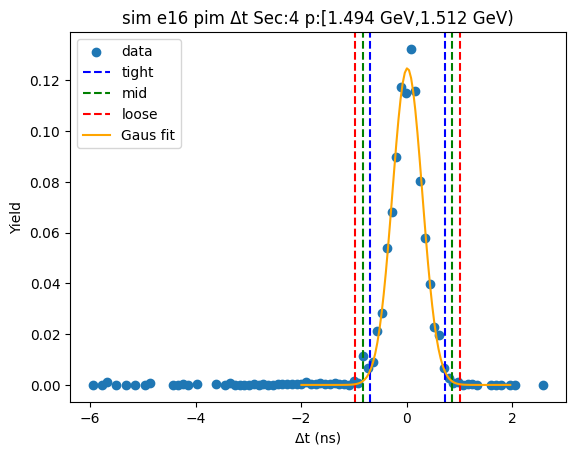

-0.7271073904298788 0.7280445998996279
-0.8726225894628296 0.8735597989325786
-1.0181377884957803 1.0190749979655294


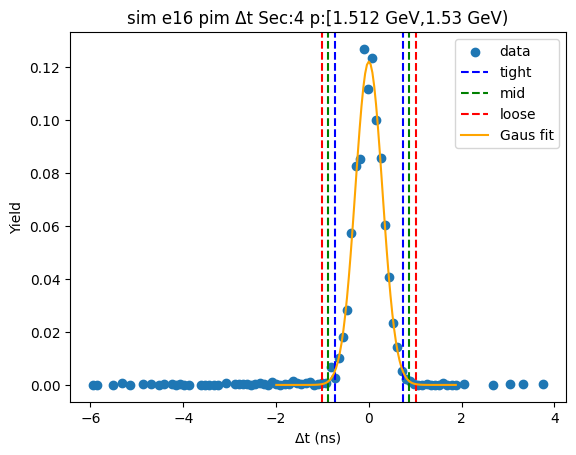

-0.7227798998943133 0.7470850154343935
-0.869766391427184 0.8940715069672642
-1.0167528829600547 1.041057998500135


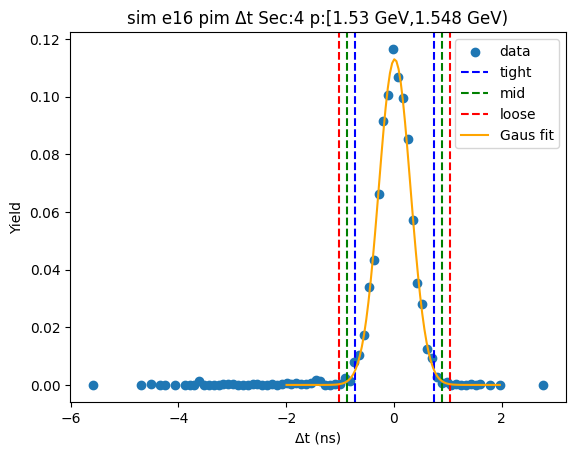

-0.6437857183605339 0.684904799312276
-0.7766547701278148 0.8177738510795569
-0.9095238218950957 0.9506429028468378


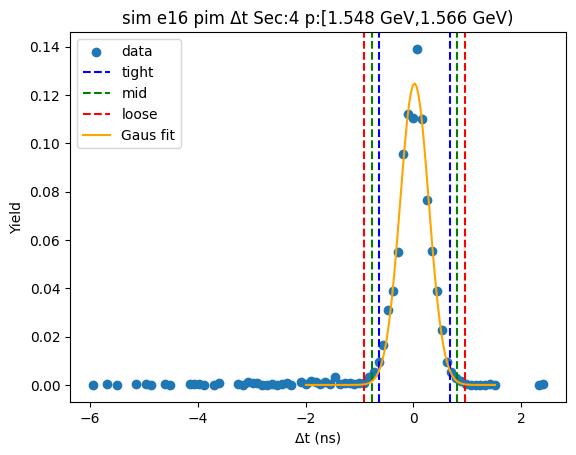

-0.728437272403002 0.7317614473734796
-0.8744571443806501 0.8777813193511277
-1.0204770163582983 1.0238011913287757


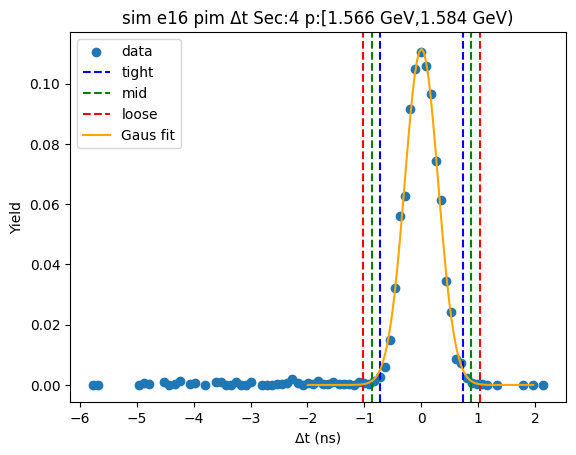

-0.6711006491624321 0.70225640598426
-0.8084363546771012 0.8395921114989291
-0.9457720601917704 0.9769278170135983


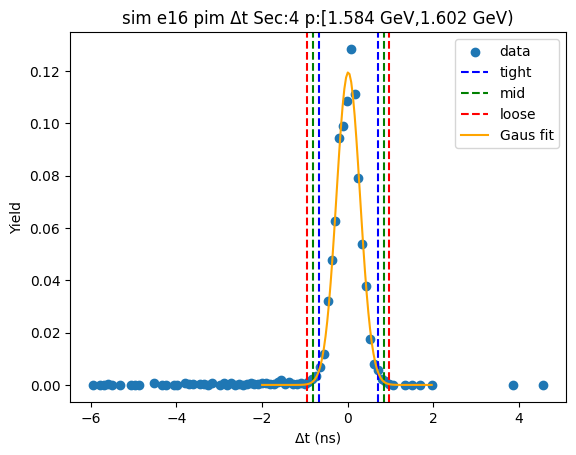

-0.7100780250468662 0.7330238055154376
-0.8543882081030967 0.877333988571668
-0.9986983911593271 1.0216441716278983


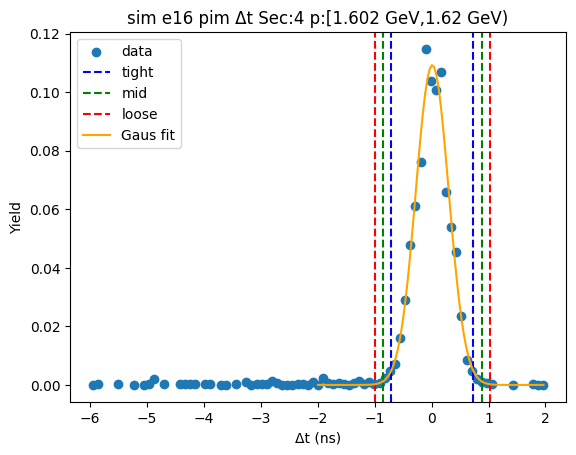

-0.7005224611115571 0.6989478199077551
-0.8404694892134883 0.8388948480096863
-0.9804165173154195 0.9788418761116174


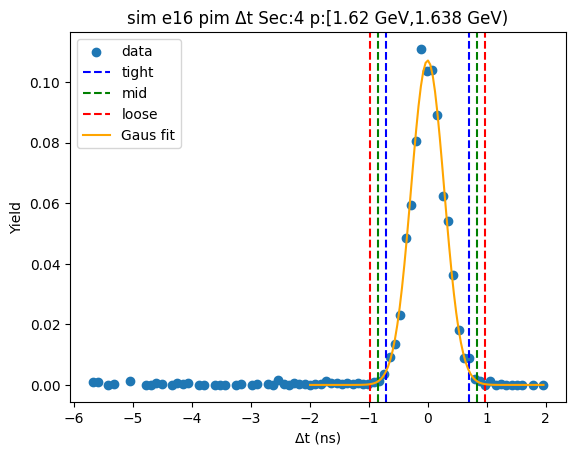

-0.7332368011447971 0.7460330368768208
-0.8811637849469589 0.8939600206789826
-1.0290907687491206 1.0418870044811446


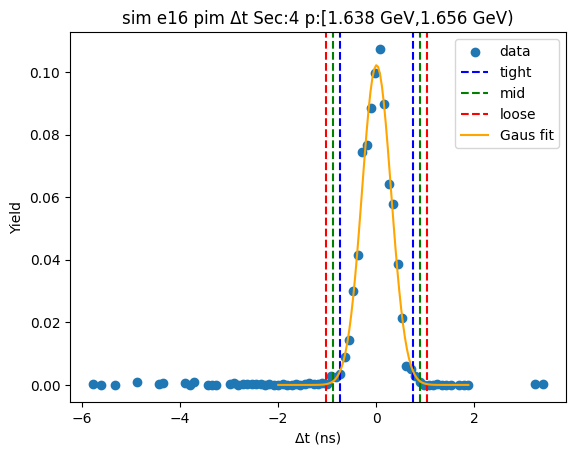

-0.6905610318937435 0.7212234431751753
-0.8317394794006353 0.8624018906820671
-0.9729179269075272 1.003580338188959


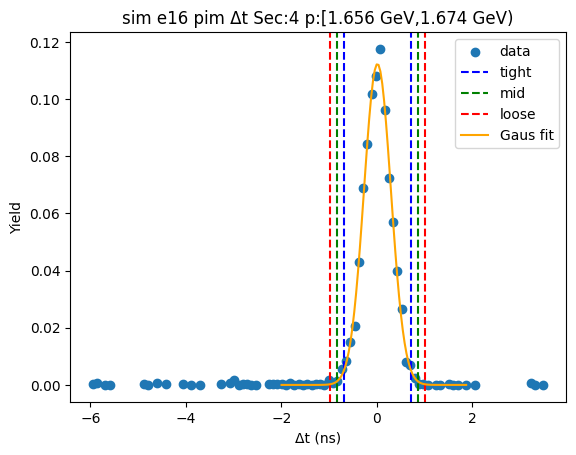

-0.6926039808558859 0.7185126425453237
-0.8337156431960069 0.8596243048854446
-0.9748273055361278 1.0007359672255656


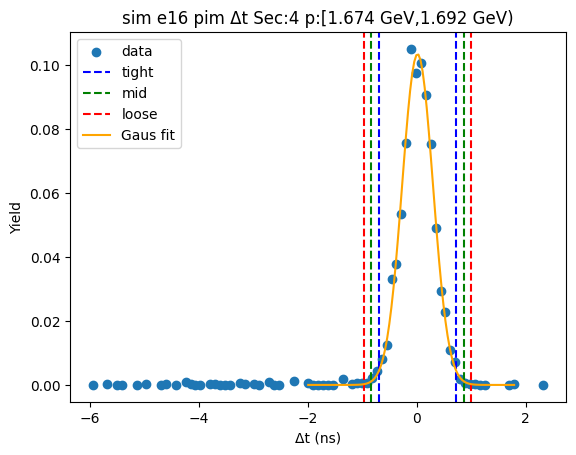

-0.6730671913601558 0.6845473896945462
-0.8088286494656259 0.8203088478000163
-0.9445901075710961 0.9560703059054865


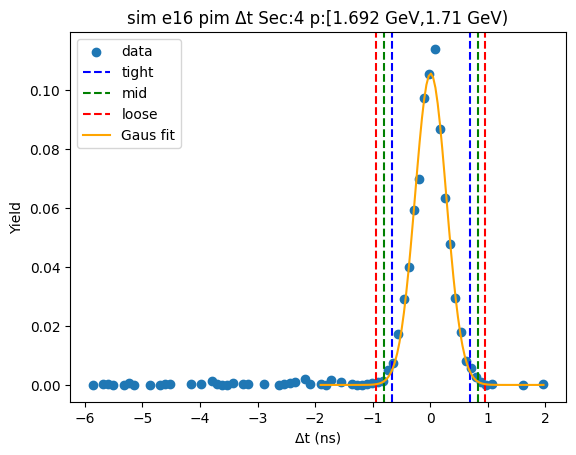

-0.7056068749388448 0.7121484179360295
-0.8473824042263323 0.8539239472235169
-0.9891579335138198 0.9956994765110044


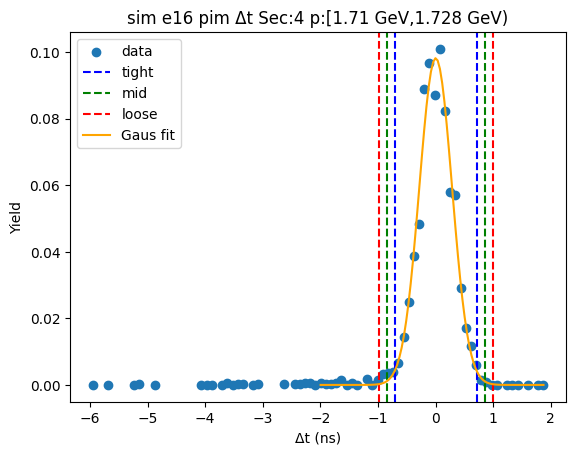

-0.7129483780547979 0.7466103990270995
-0.8589042557629877 0.8925662767352892
-1.0048601334711775 1.0385221544434788


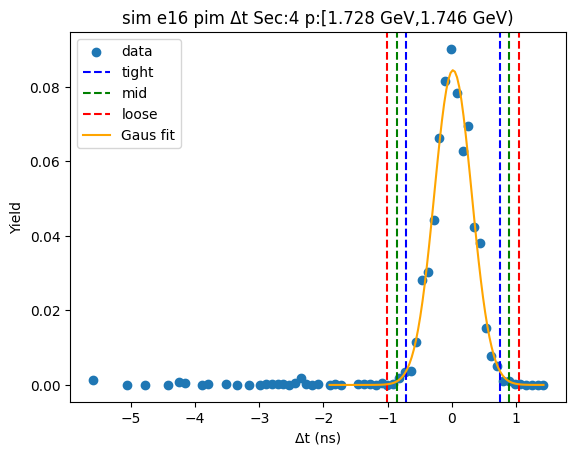

-0.6662100913766261 0.6771199076401212
-0.8005430912783009 0.811452907541796
-0.9348760911799757 0.9457859074434708


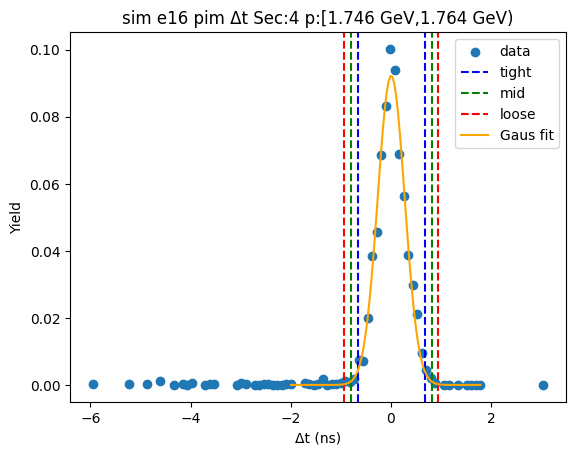

-0.6846581733409361 0.6864605792746977
-0.8217700486024995 0.823572454536261
-0.9588819238640628 0.9606843297978244


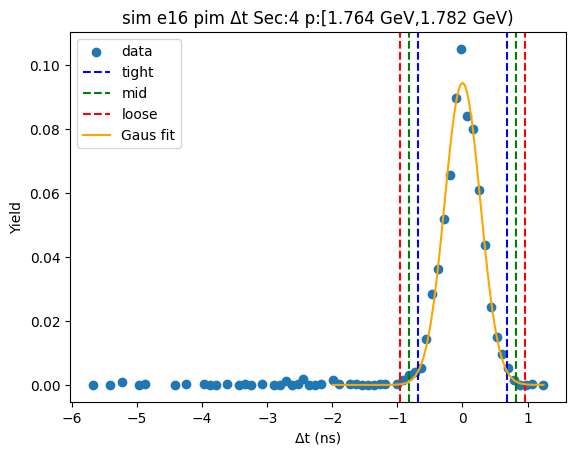

-0.66706202377849 0.6834413384170662
-0.8021123599980455 0.8184916746366218
-0.9371626962176012 0.9535420108561774


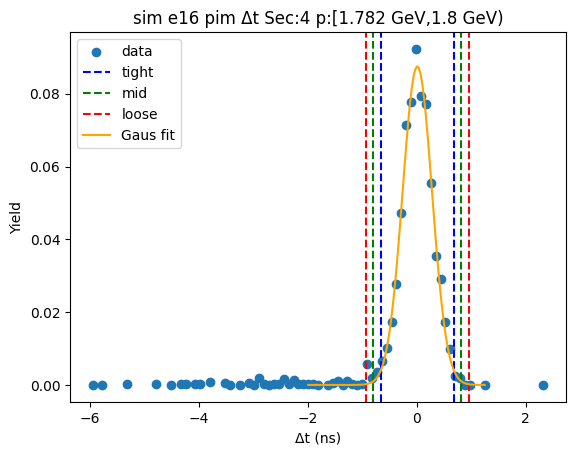

-0.6847863731149497 0.7124557873223303
-0.8245105891586778 0.8521800033660584
-0.9642348052024058 0.9919042194097863


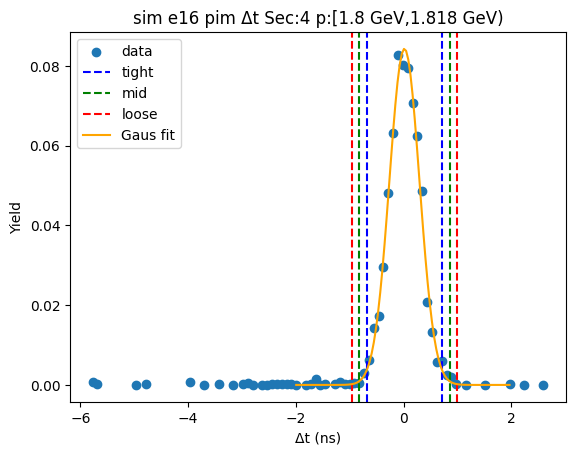

-0.6859934989397578 0.7073440036572953
-0.8253272491994632 0.8466777539170007
-0.9646609994591685 0.986011504176706


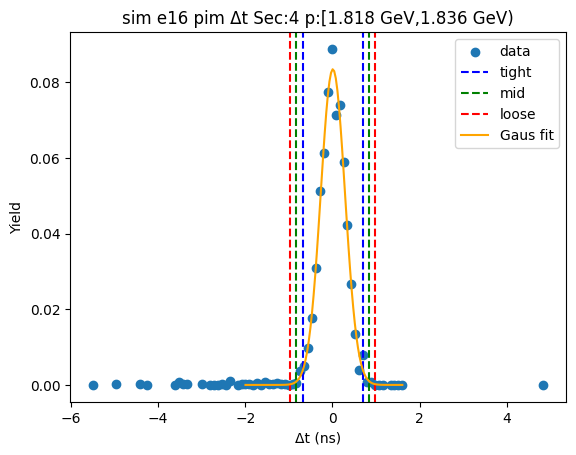

-0.665681249641354 0.7111273134368519
-0.8033621059491747 0.8488081697446725
-0.9410429622569952 0.9864890260524931


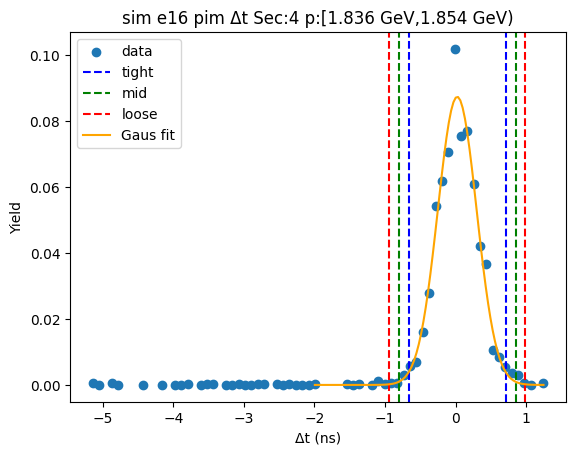

-0.6832511135603228 0.7023530482516802
-0.821811529741523 0.8409134644328805
-0.9603719459227233 0.9794738806140808


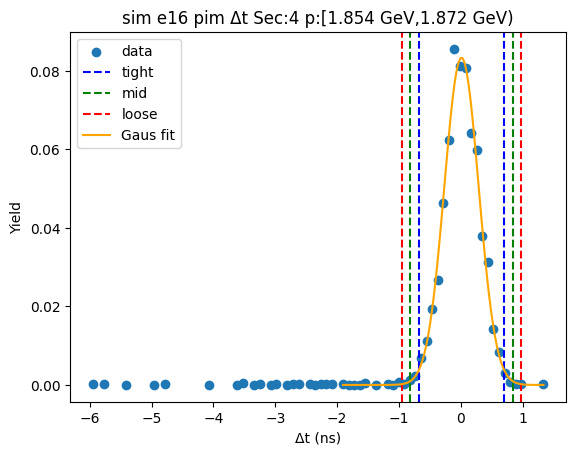

-0.7033390489570208 0.7452238332200629
-0.8481953371747293 0.8900801214377714
-0.9930516253924375 1.0349364096554796


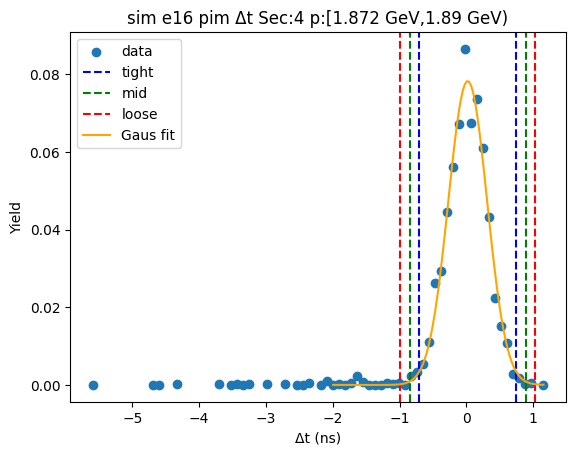

-0.6935374185288823 0.7248694370896034
-0.8353781040907308 0.8667101226514519
-0.9772187896525794 1.0085508082133006


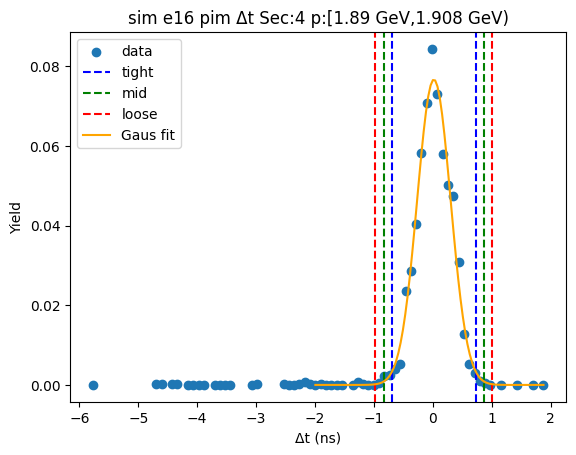

-0.6916706549049872 0.6688166697254033
-0.8277193873680263 0.8048654021884424
-0.9637681198310654 0.9409141346514814


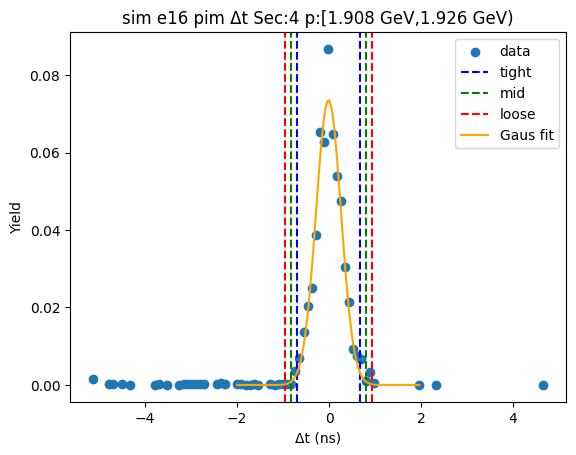

-0.7202833448321366 0.7196468775465914
-0.8642763670700094 0.8636398997844642
-1.008269389307882 1.007632922022337


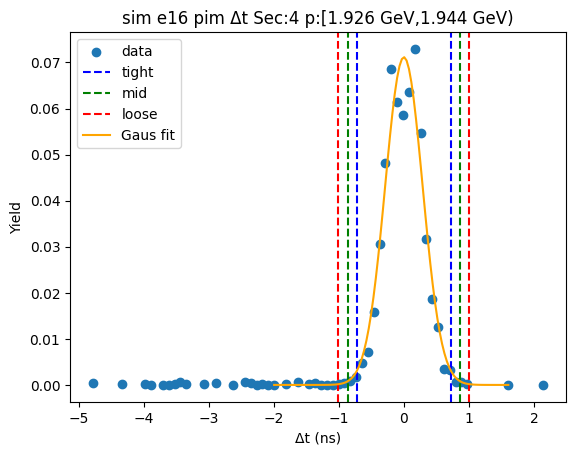

-0.7307151061702147 0.7334138407199574
-0.877128000859232 0.8798267354089747
-1.023540895548249 1.026239630097992


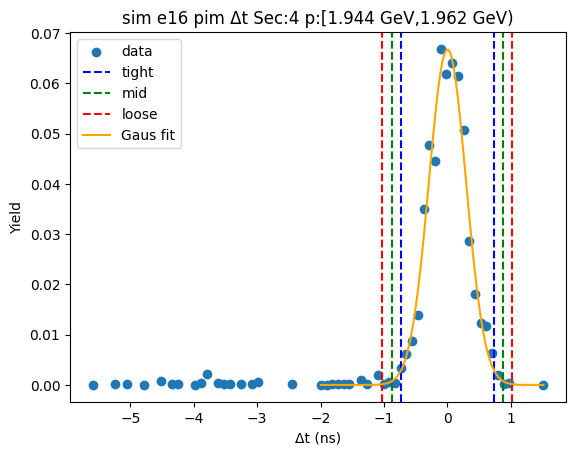

-0.6748669021786448 0.6890198941786704
-0.8112555818143762 0.8254085738144018
-0.9476442614501077 0.9617972534501333


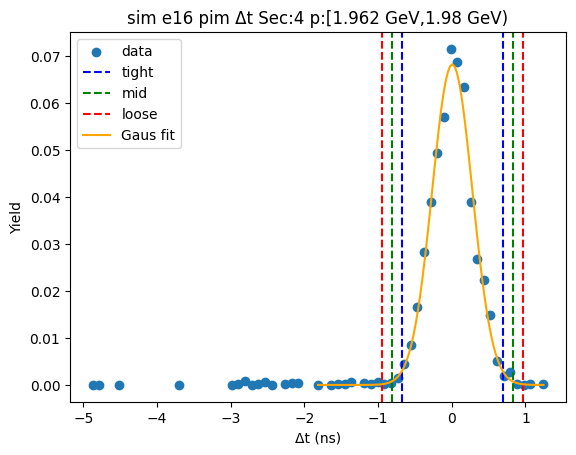

-0.6992389654426204 0.7222481665294175
-0.8413876786398242 0.8643968797266213
-0.983536391837028 1.006545592923825


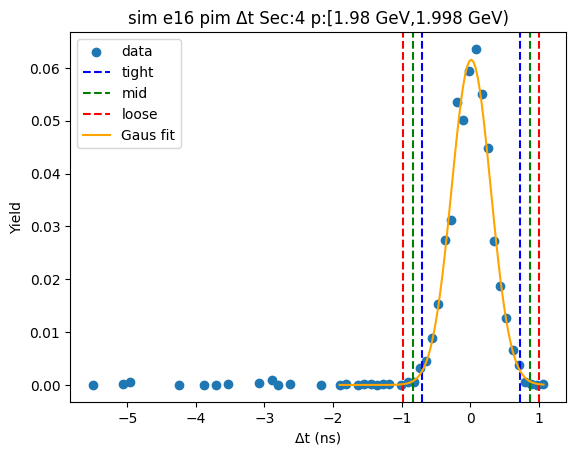

-0.6762322829729895 0.7131270840359992
-0.8151682196738884 0.8520630207368981
-0.9541041563747873 0.990998957437797


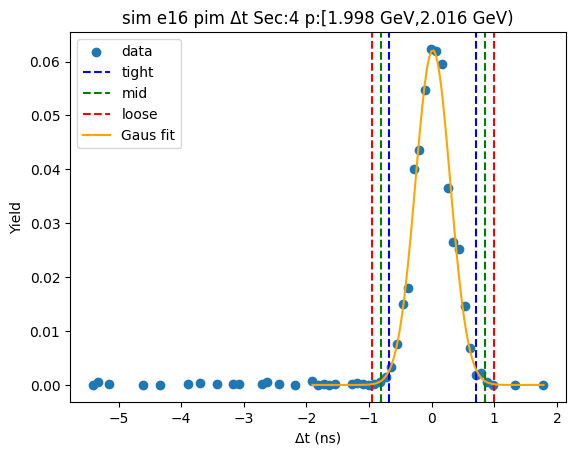

-0.6653156850069574 0.6975515255870396
-0.8016024060663571 0.8338382466464394
-0.9378891271257569 0.9701249677058391


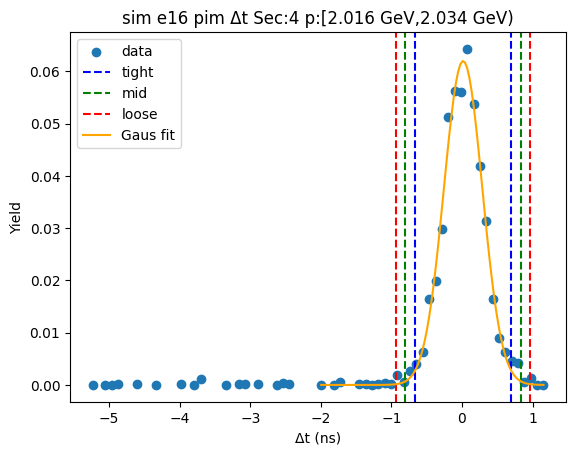

-0.7188601446215627 0.7058142115713698
-0.861327580240856 0.8482816471906631
-1.0037950158601494 0.9907490828099564


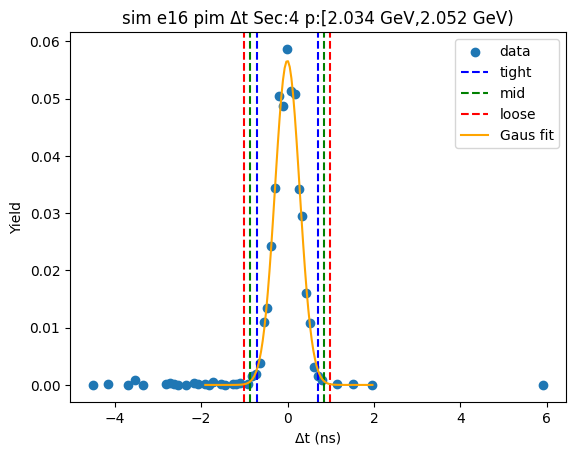

-0.6993771436437906 0.7264154134791856
-0.8419563993560882 0.8689946691914833
-0.9845356550683859 1.011573924903781


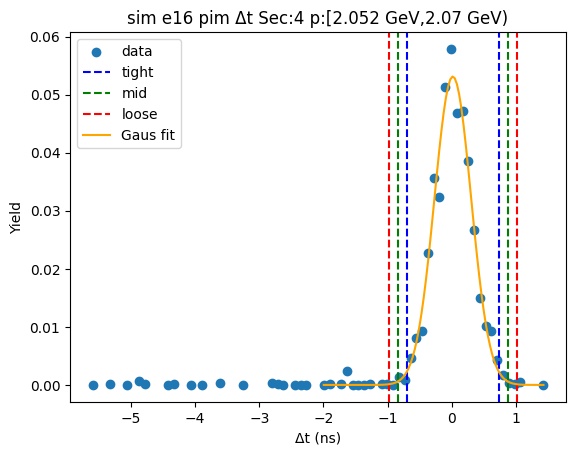

-0.7469523329982918 0.7363831068643109
-0.895285876984552 0.884716650850571
-1.0436194209708123 1.0330501948368311


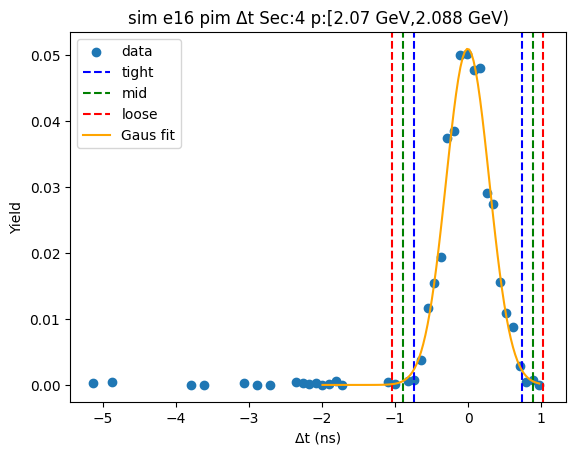

-0.6968751343974504 0.720426695013737
-0.8386053173385692 0.8621568779548558
-0.980335500279688 1.0038870608959745


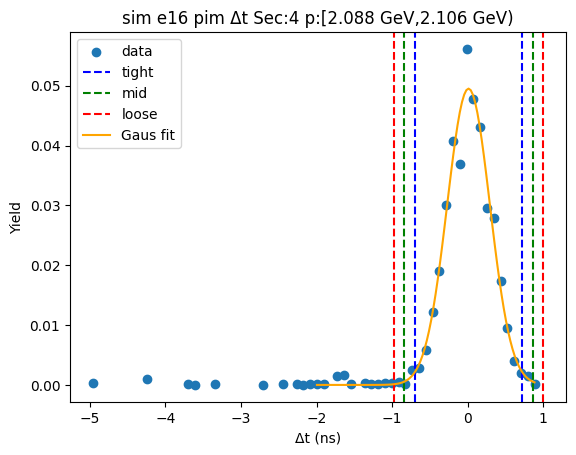

-0.6568690072126966 0.686206267064597
-0.791176534640426 0.8205137944923264
-0.9254840620681554 0.9548213219200558


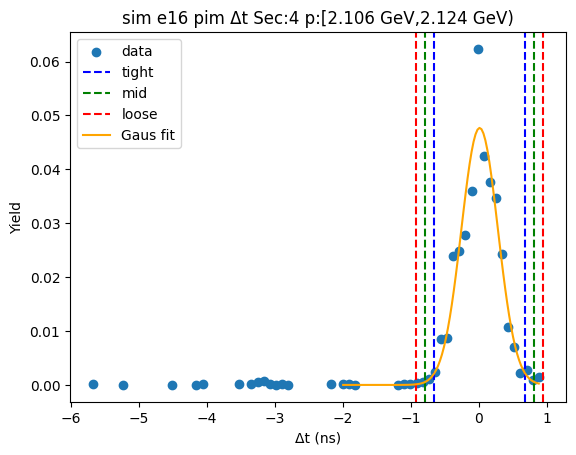

-0.6666850423245028 0.6874799203310391
-0.802101538590057 0.8228964165965933
-0.9375180348556111 0.9583129128621475


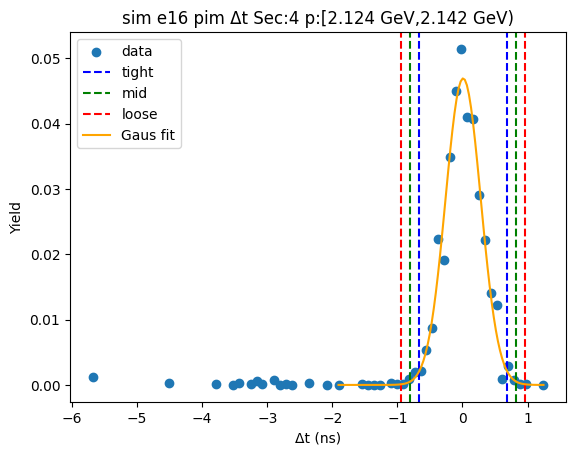

-0.7450883911660441 0.6939306268293833
-0.8889902929655867 0.837832528628926
-1.0328921947651297 0.9817344304284689


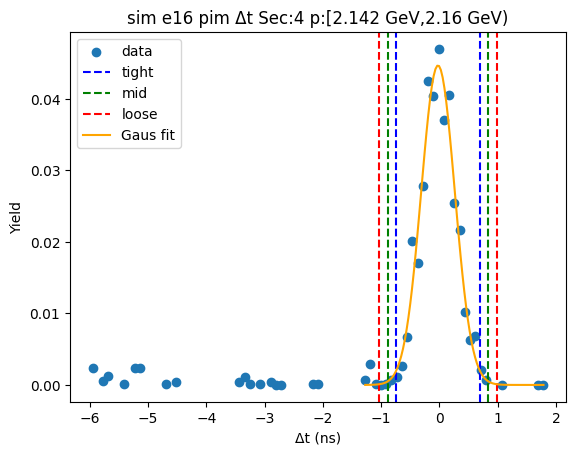

-0.6911398385191889 0.740236735272225
-0.8342774958983301 0.8833743926513664
-0.9774151532774715 1.0265120500305078


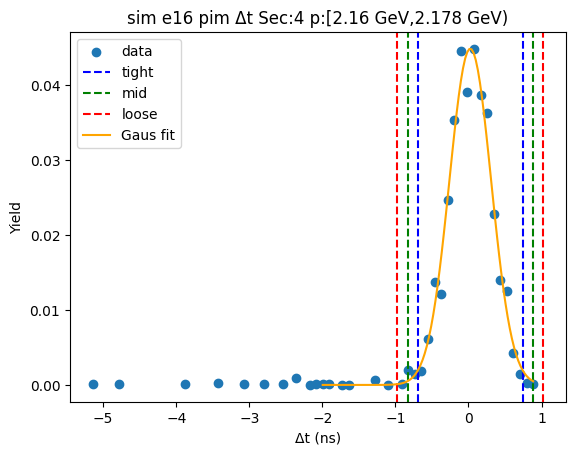

-0.6372675494882344 0.6664167301549037
-0.7676359774525482 0.7967851581192175
-0.898004405416862 0.9271535860835313


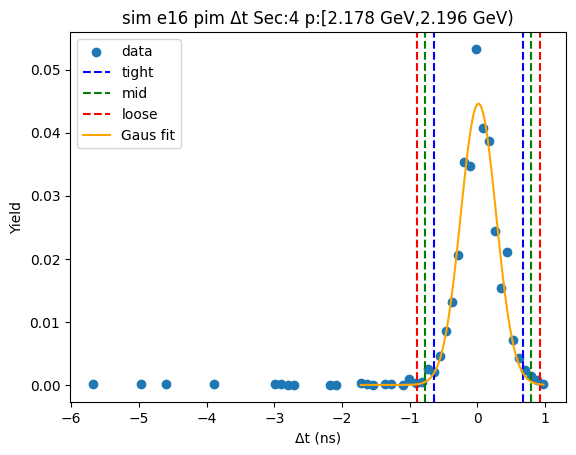

-0.7605301885644564 0.7457166128354531
-0.9111548687044473 0.896341292975444
-1.0617795488444384 1.046965973115435


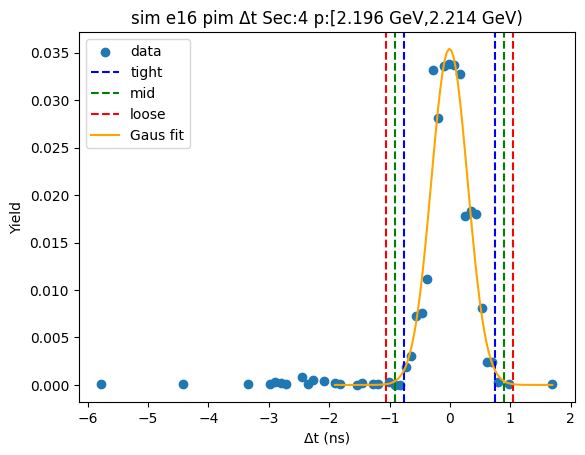

-0.6860173118484937 0.7319388712920981
-0.8278129301625529 0.8737344896061573
-0.969608548476612 1.0155301079202166


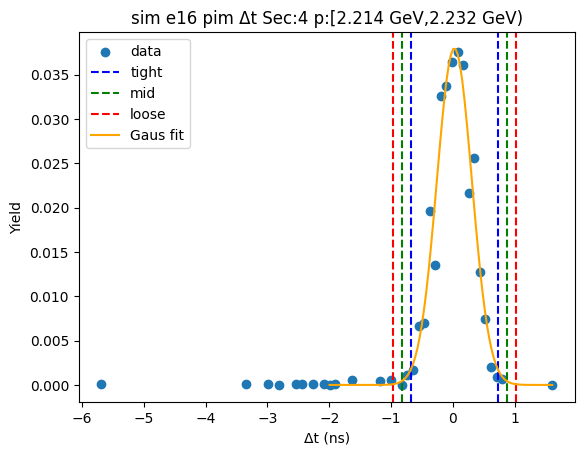

-0.6834194790151118 0.7083915328724055
-0.8226005802038636 0.8475726340611573
-0.9617816813926153 0.9867537352499091


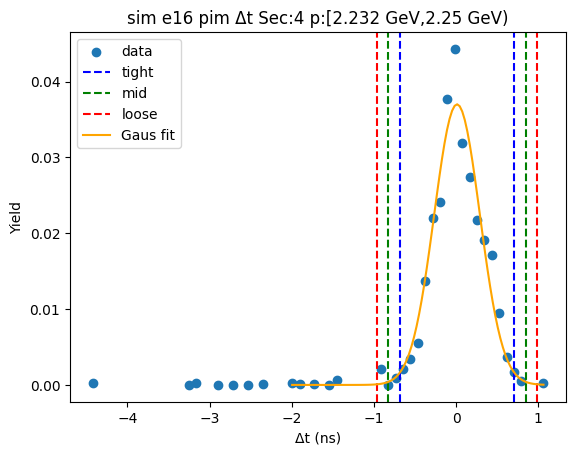

-0.6977799033833029 0.7083188941285777
-0.8383897831344909 0.8489287738797657
-0.9789996628856789 0.9895386536309537


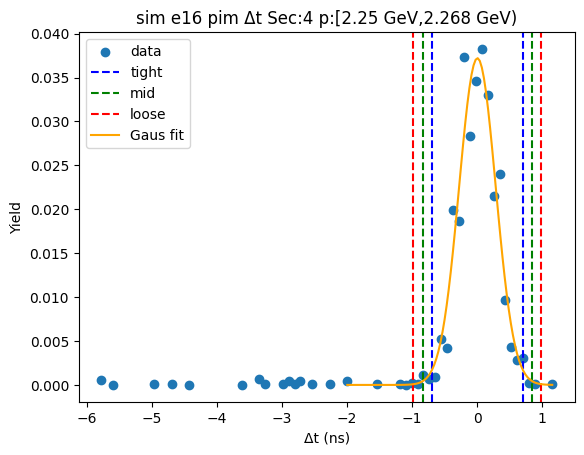

-0.7705910818290547 0.7010665504917248
-0.9177568450611325 0.8482323137238027
-1.0649226082932104 0.9953980769558807


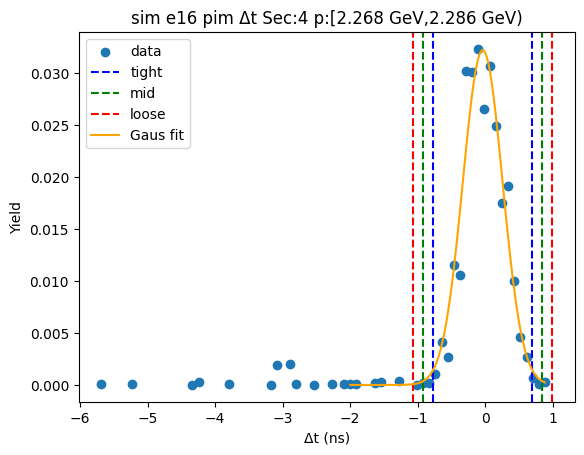

-0.6147352689872435 0.7111776053271629
-0.7473265564186841 0.8437688927586035
-0.8799178438501247 0.9763601801900441


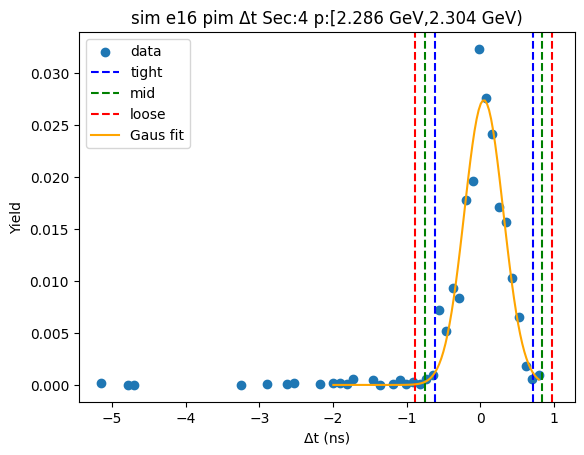

-0.6801003404410015 0.6971027716534177
-0.8178206516504434 0.8348230828628596
-0.9555409628598853 0.9725433940723015


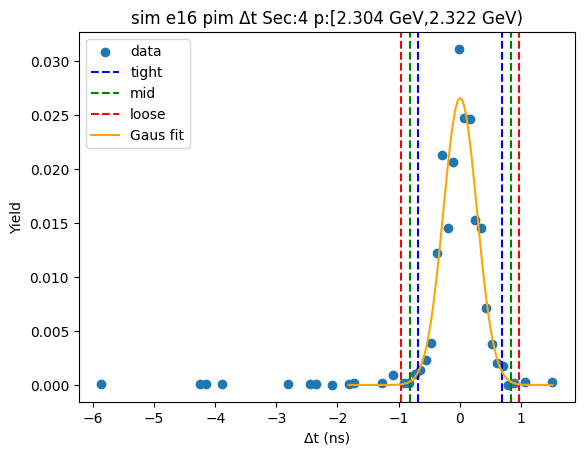

-0.696058697942953 0.7047040759497953
-0.8361349753322278 0.8447803533390701
-0.9762112527215027 0.984856630728345


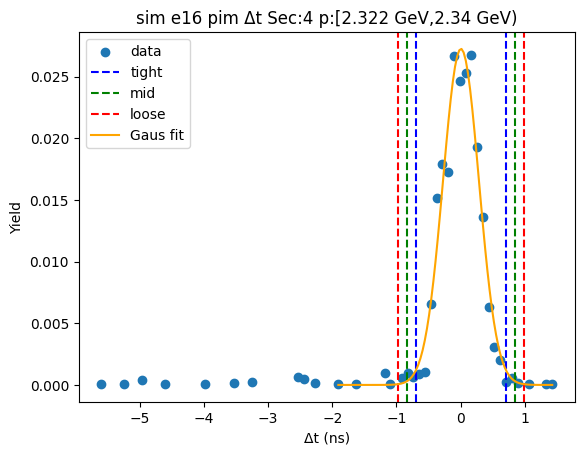

-0.6574356728106109 0.7723445940513433
-0.8004136994968063 0.9153226207375387
-0.9433917261830018 1.0583006474237342


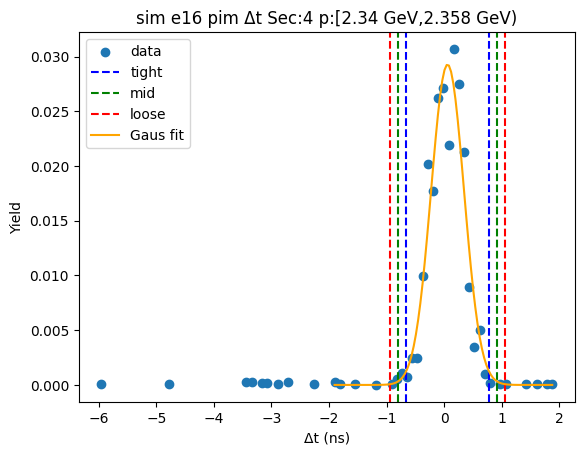

-0.7191606872114829 0.7549860422574777
-0.866575360158379 0.9024007152043738
-1.013990033105275 1.0498153881512697


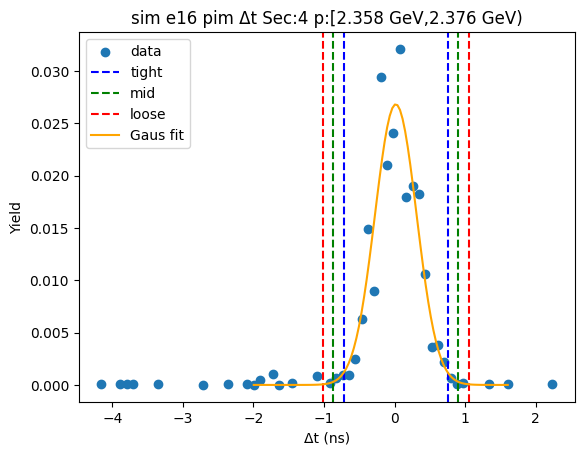

-0.7852776947258986 0.7855532361884832
-0.9423607878173367 0.9426363292799212
-1.099443880908775 1.0997194223713593


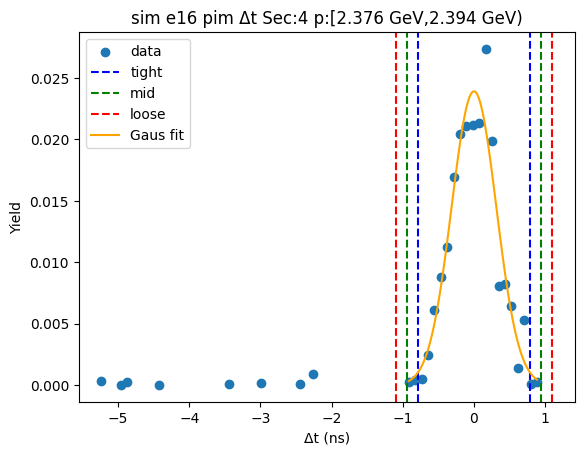

-0.670622740989911 0.6687252337076446
-0.8045575384596666 0.8026600311774001
-0.9384923359294222 0.9365948286471557


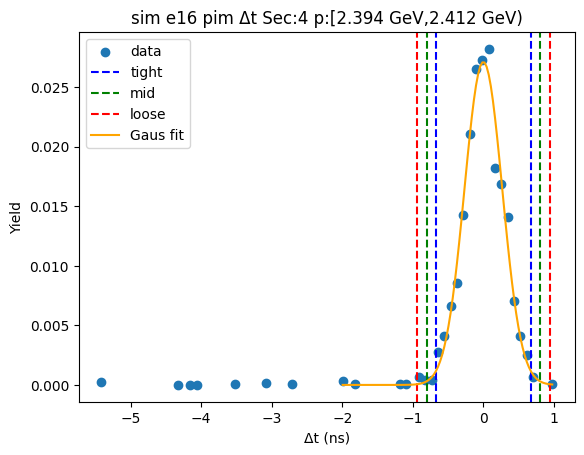

-0.5464808787284179 0.6007832082113185
-0.6612072874223914 0.715509616905292
-0.7759336961163651 0.8302360255992657


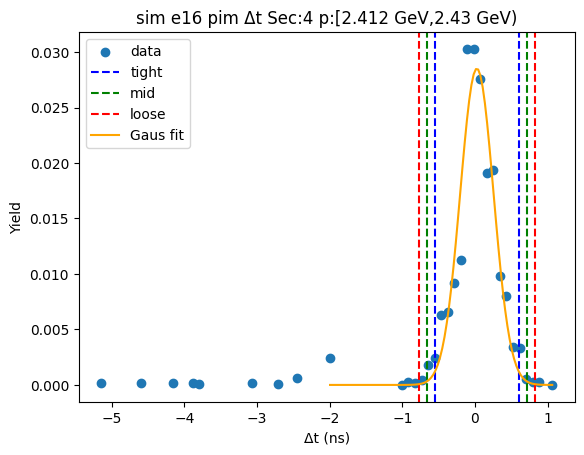

-0.7037148555452466 0.6647799387253084
-0.8405643349723021 0.8016294181523639
-0.9774138143993576 0.9384788975794194


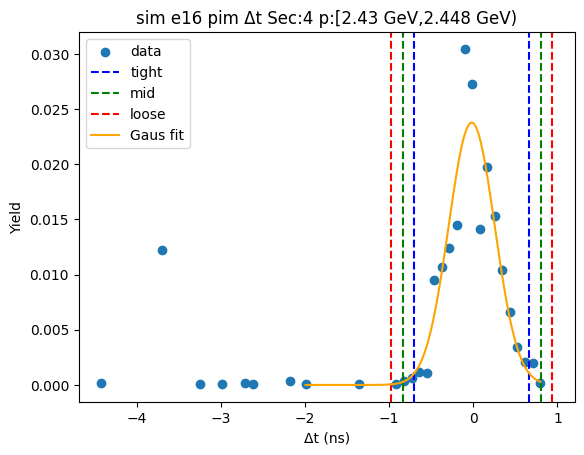

-0.6301232961027137 0.6042634345937592
-0.753561969172361 0.7277021076634065
-0.8770006422420082 0.8511407807330538


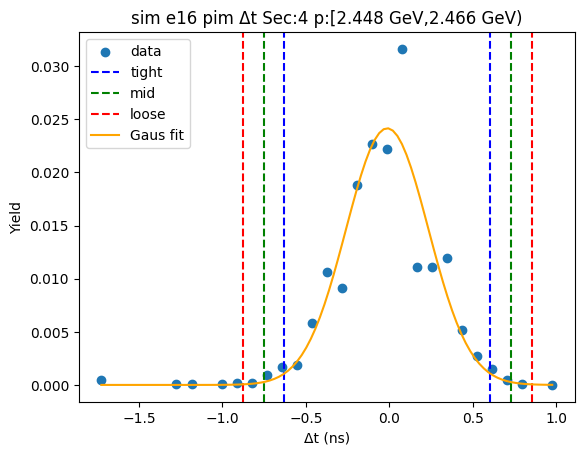

-0.5540897722157789 0.6614500062911495
-0.6756437500664717 0.7830039841418422
-0.7971977279171645 0.904557961992535


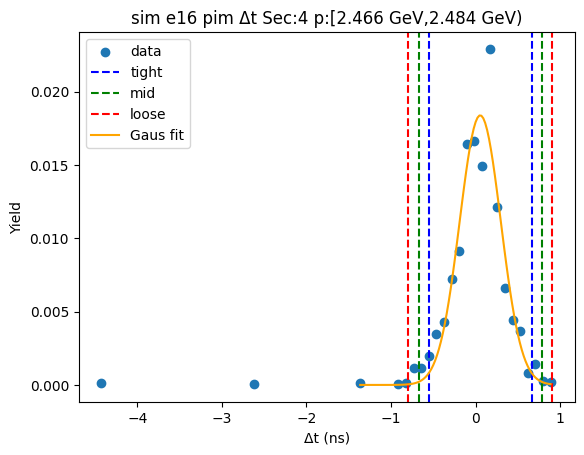

-0.7050413019194954 0.6667915573212848
-0.8422245878435735 0.8039748432453628
-0.9794078737676515 0.9411581291694409


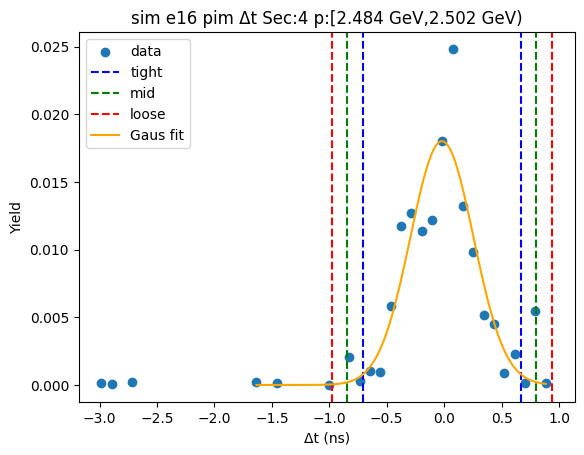

-0.6715119330531331 0.6981503233466632
-0.8084781586931127 0.8351165489866428
-0.9454443843330923 0.9720827746266224


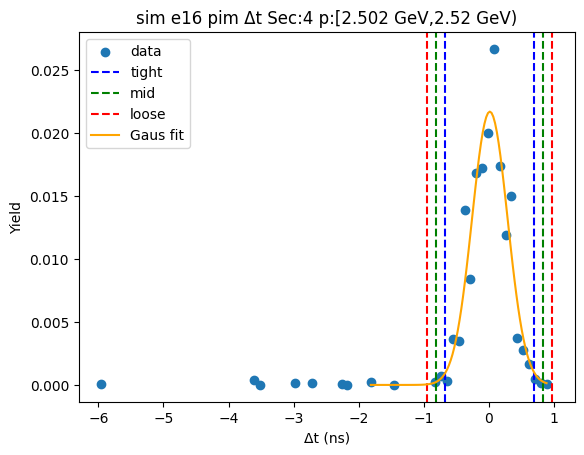

-0.562504256619636 0.5232813362623462
-0.6710828159078343 0.6318598955505444
-0.7796613751960324 0.7404384548387426


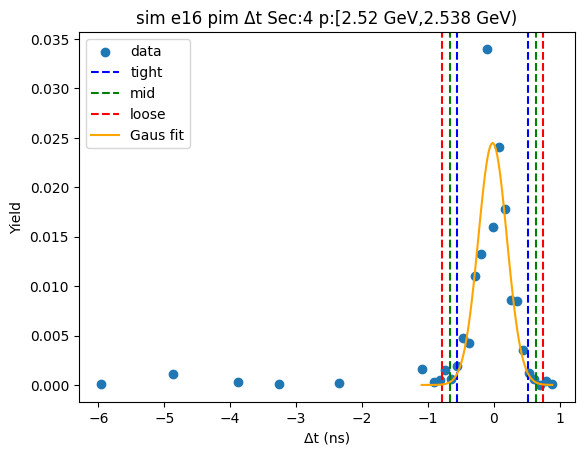

-0.6662120508201357 0.6510451040205782
-0.797937766304207 0.7827708195046496
-0.9296634817882784 0.914496534988721


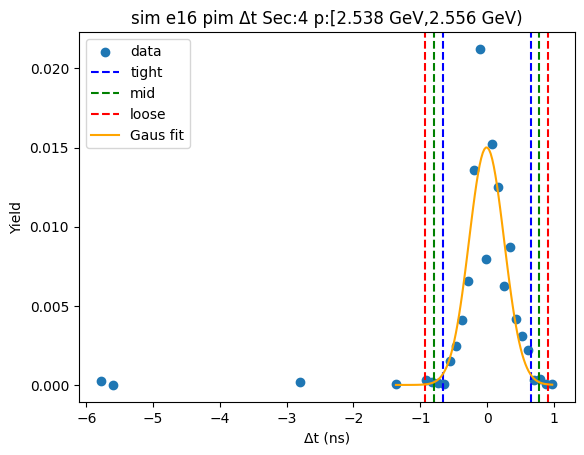

-0.579770635514281 0.6390167856820271
-0.7016493776339119 0.760895527801658
-0.8235281197535427 0.8827742699212888


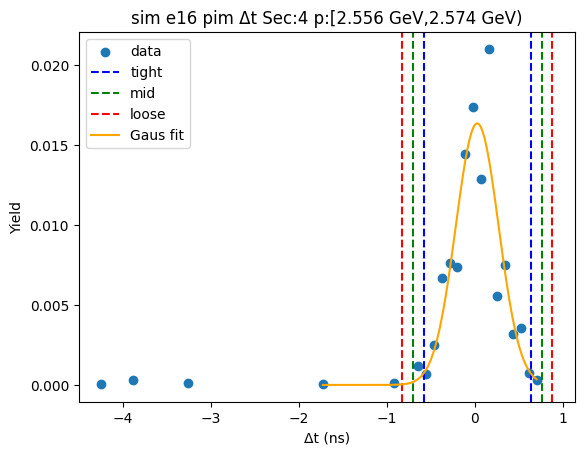

-0.5987733221015311 0.6792964976618748
-0.7265803040778718 0.8071034796382155
-0.8543872860542124 0.9349104616145562


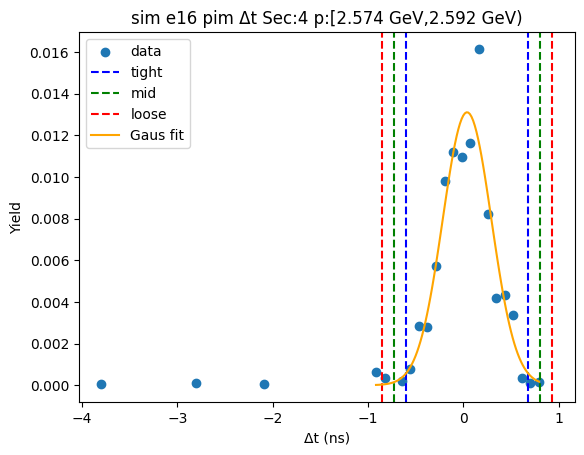

-0.5346963790926416 0.49402291810636334
-0.637568308812542 0.5968948478262638
-0.7404402385324426 0.6997667775461643


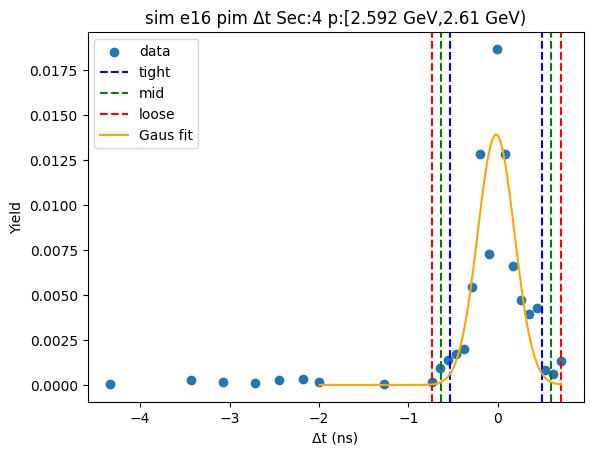

-0.6362200416956223 0.6963116984338726
-0.7694732157085719 0.8295648724468222
-0.9027263897215214 0.9628180464597718


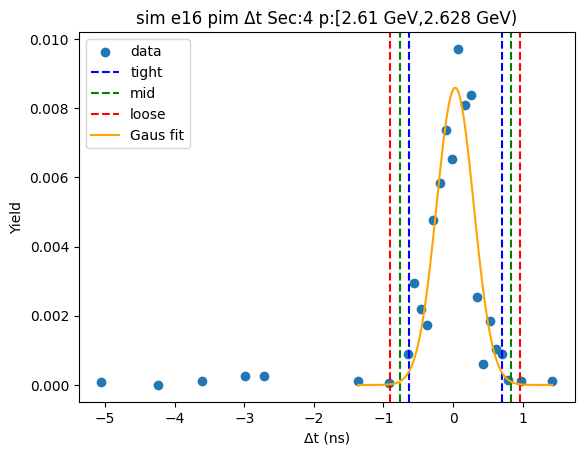

-0.7839514389278818 0.6729463852930219
-0.9296412213499721 0.8186361677151122
-1.0753310037720623 0.9643259501372025


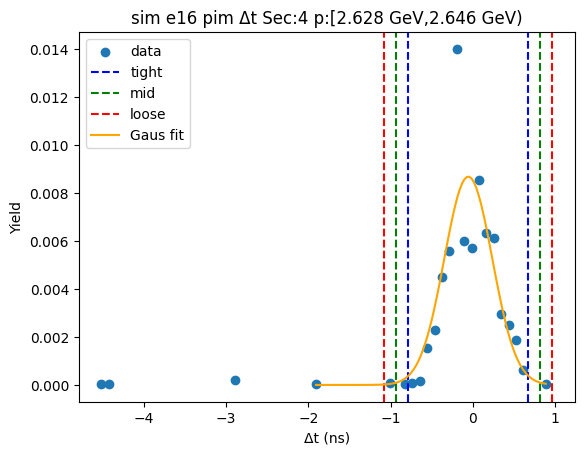

-0.6877513463134877 0.7609249748231142
-0.8326189784271479 0.9057926069367744
-0.9774866105408081 1.0506602390504347


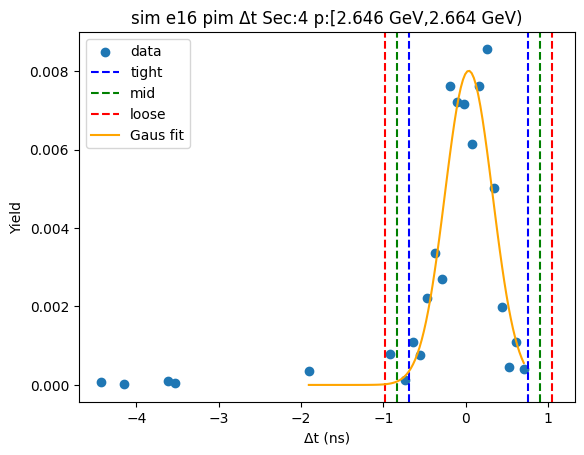

-0.7892070820181836 0.8104411340314996
-0.949171903623152 0.970405955636468
-1.1091367252281203 1.1303707772414364


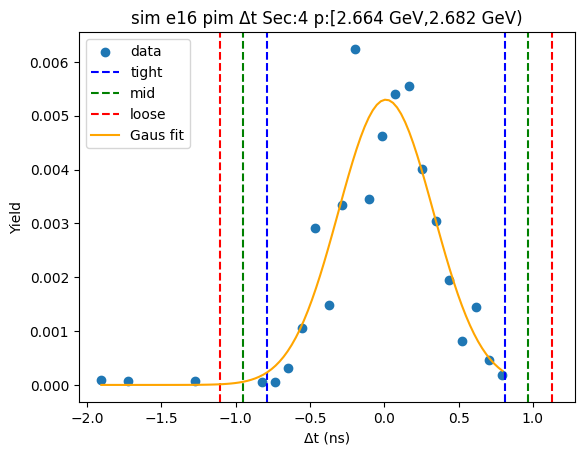

-0.7038190658787528 0.6676443636753614
-0.8409654088341643 0.8047907066307729
-0.9781117517895757 0.9419370495861843


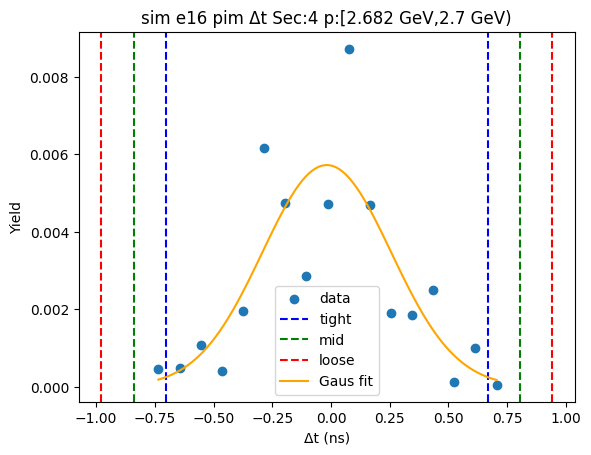

-0.7995572864280251 0.7362590474369621
-0.9531389198145238 0.8898406808234608
-1.1067205532010225 1.0434223142099595


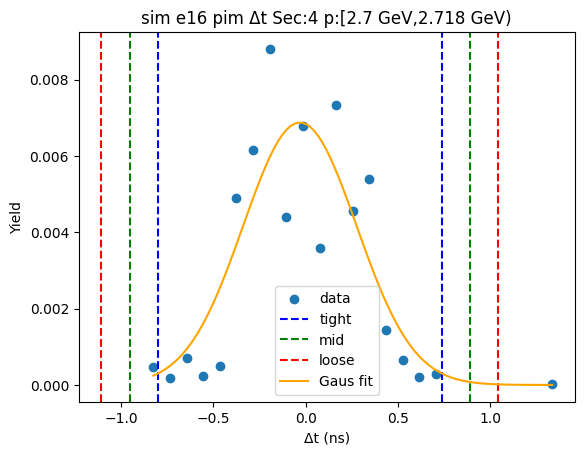

-0.7759941941145616 0.7728458647745391
-0.9308782000034718 0.9277298706634493
-1.0857622058923817 1.0826138765523594


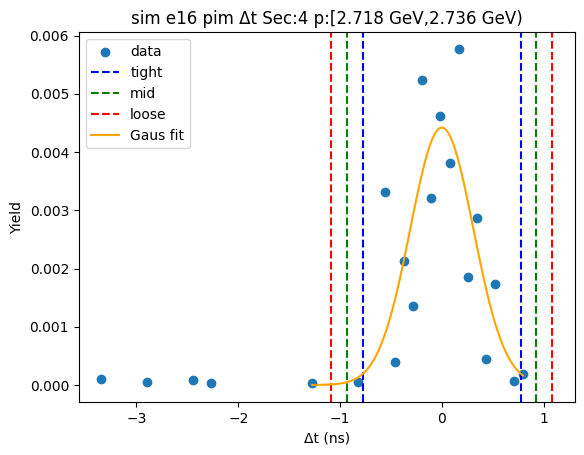

-0.6386579967799269 0.8180727924601325
-0.7843310757039328 0.9637458713841385
-0.9300041546279387 1.1094189503081444


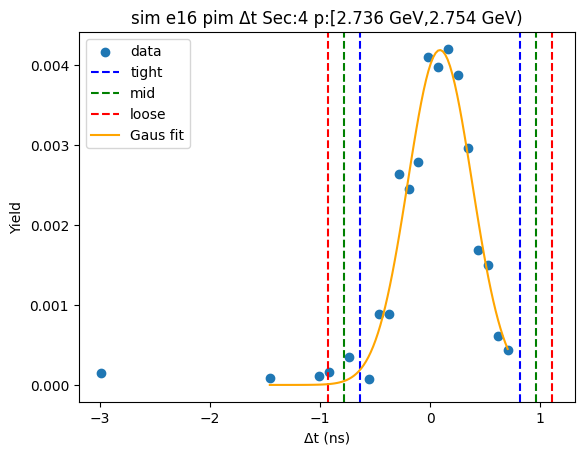

-1.0088688826959697 1.2415703100684272
-1.2339128019724093 1.4666142293448667
-1.458956721248849 1.6916581486213065


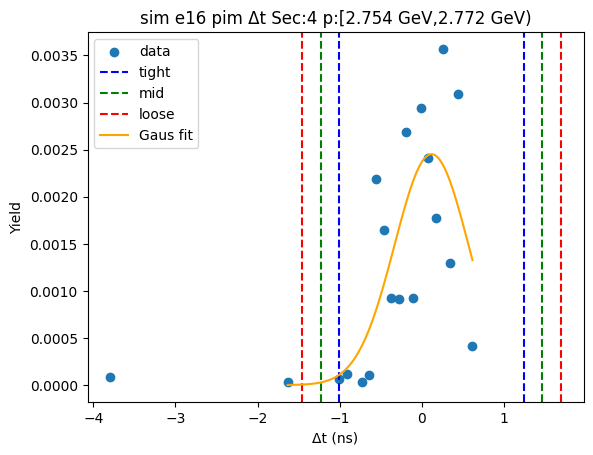

-0.810821808275251 0.6296222000542224
-0.9548662091081983 0.7736666008871698
-1.0989106099411456 0.9177110017201171


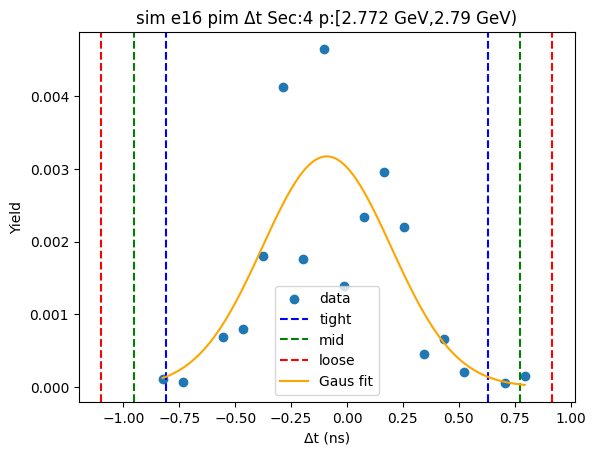

-0.6052825842513608 0.573224192593465
-0.7231332619358435 0.6910748702779477
-0.8409839396203261 0.8089255479624303


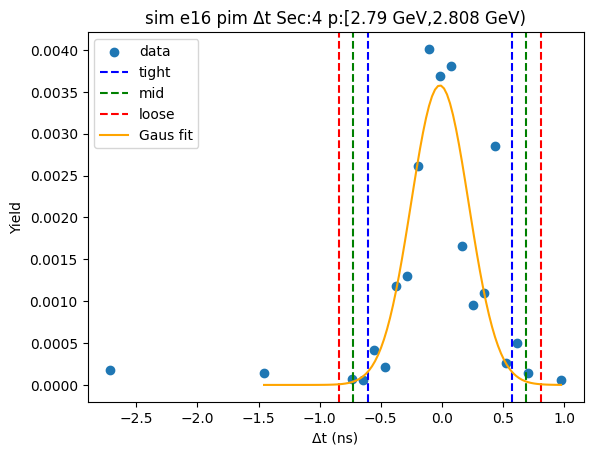

-0.756474664931827 0.8342191189767842
-0.9155440433226882 0.9932884973676455
-1.0746134217135492 1.1523578757585065


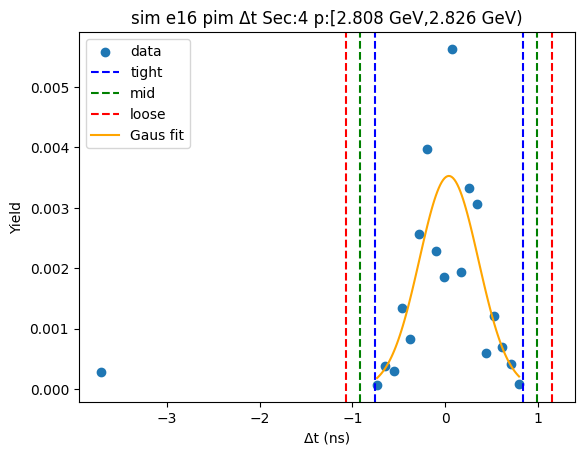

-0.5464249850119148 0.651702457785044
-0.6662377292916107 0.7715152020647399
-0.7860504735713066 0.8913279463444358


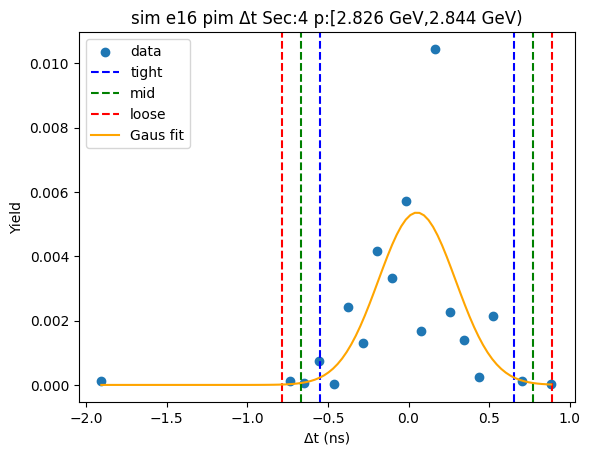

-0.5759704914634591 0.585399225932822
-0.6921074632030872 0.7015361976724501
-0.8082444349427154 0.8176731694120782


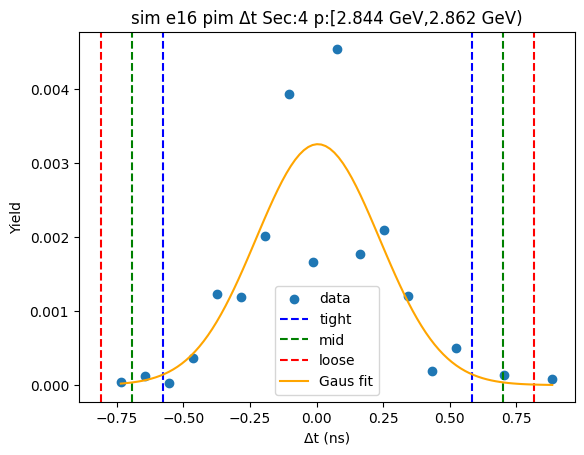

-0.3832523165023677 0.7205836508150772
-0.49363591323411216 0.8309672475468217
-0.6040195099658566 0.9413508442785662


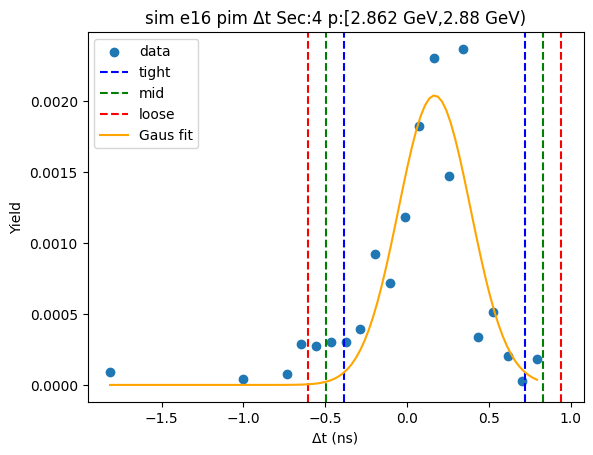

-0.15931161477820116 0.5356799020765781
-0.22881076646367904 0.6051790537620559
-0.29830991814915697 0.6746782054475339


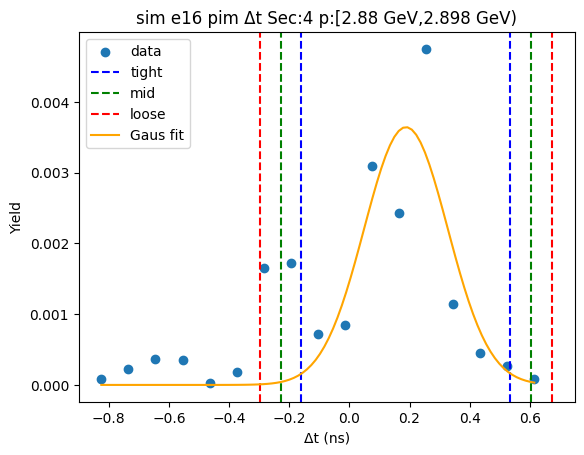

-1.0066894175137397 1.389027316406704
-1.2462610909057843 1.6285989897987485
-1.4858327642978284 1.868170663190793


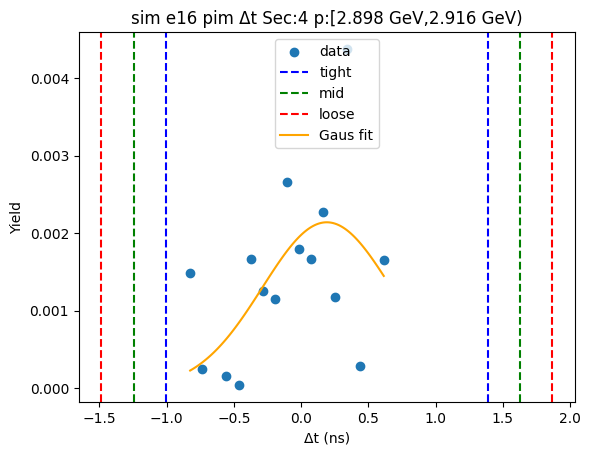

-0.806858844319275 0.7696840640429374
-0.9645131351554962 0.9273383548791586
-1.1221674259917174 1.0849926457153798


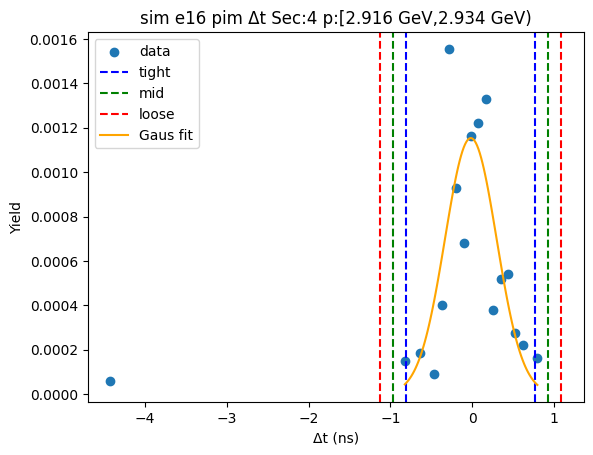

-1.4001651335983822 0.9490679766218159
-1.635088444620402 1.1839912876438357
-1.8700117556424216 1.4189145986658553


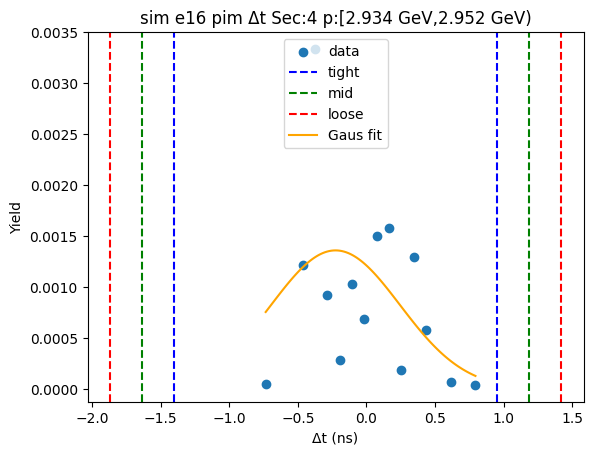

-0.16201738321230136 0.38146231490211874
-0.21636535302374338 0.43581028471356076
-0.2707133228351854 0.4901582545250028


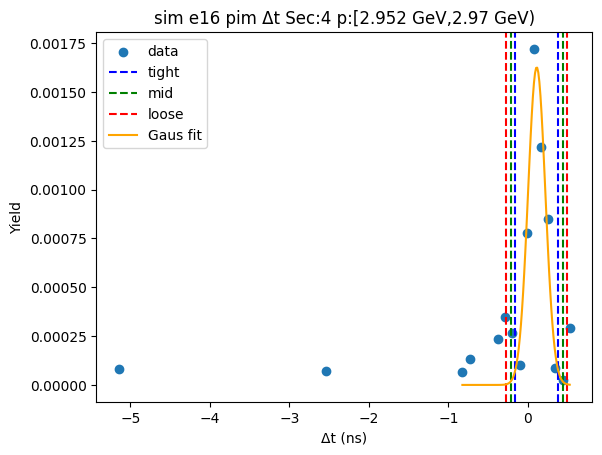

-1.006457607885625 1.0585994720660428
-1.2129633158807918 1.2651051800612094
-1.4194690238759584 1.471610888056376


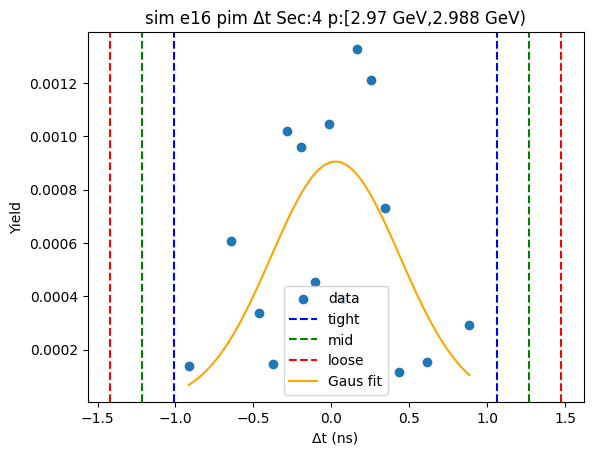

-0.8396124985381505 1.0184855026779205
-1.0254222986597574 1.2042953027995276
-1.2112320987813645 1.3901051029211346


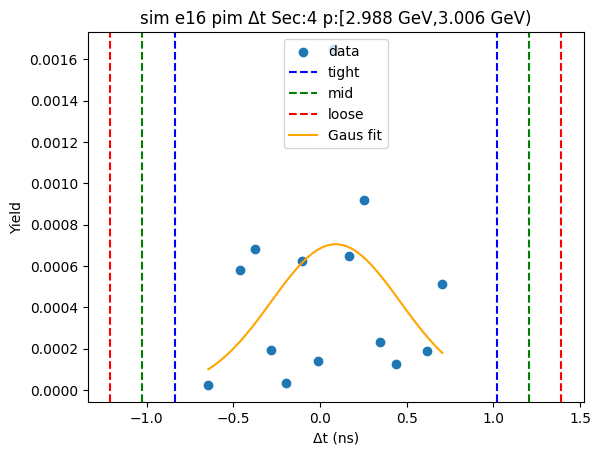

-0.9158927235136882 0.8483666292087506
-1.092318658785932 1.0247925644809943
-1.2687445940581759 1.2012184997532382


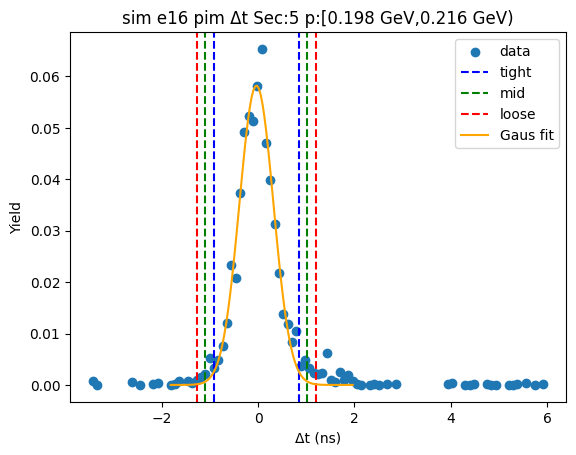

-0.9128665232193391 0.944512997187358
-1.098604475260009 1.130250949228028
-1.2843424273006787 1.3159889012686976


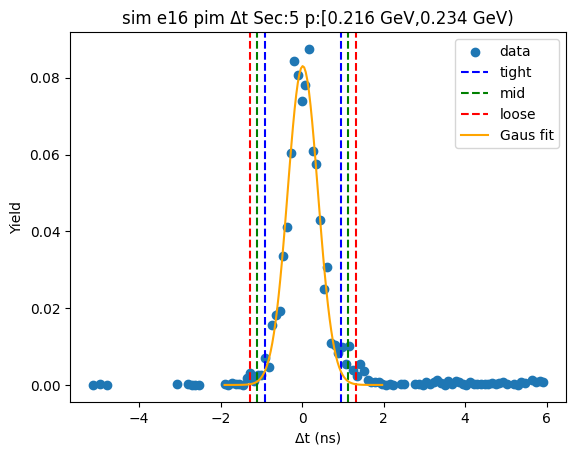

-0.9257150889912064 0.9515235427572625
-1.113438952166053 1.1392474059321094
-1.3011628153409 1.3269712691069564


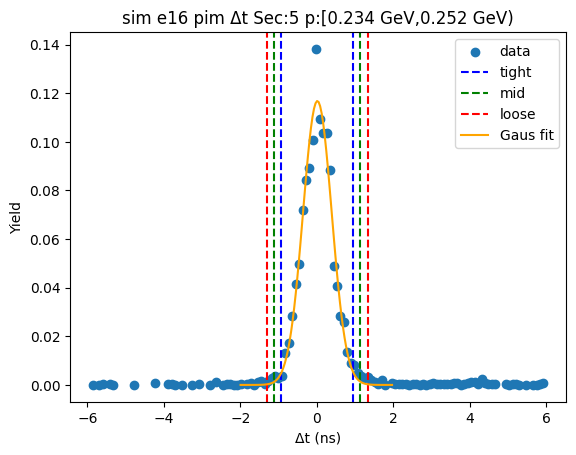

-0.8491691704939366 0.8854636956636961
-1.0226324571096999 1.0589269822794594
-1.1960957437254631 1.2323902688952226


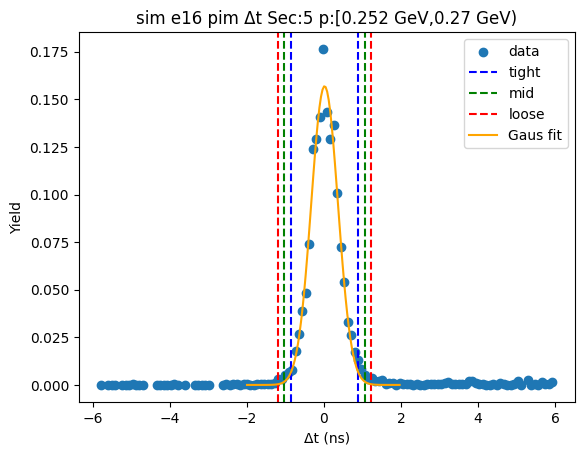

-0.8443307207524096 0.8693328434579388
-1.0156970771734444 1.0406991998789739
-1.1870634335944792 1.2120655563000087


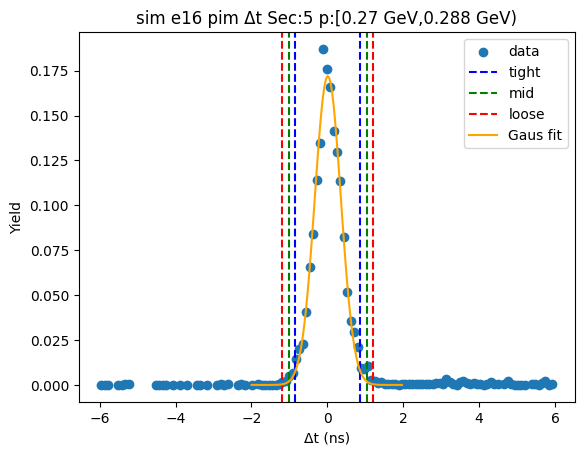

-0.8224013389477584 0.8427941572818217
-0.9889208885707164 1.0093137069047797
-1.1554404381936745 1.1758332565277378


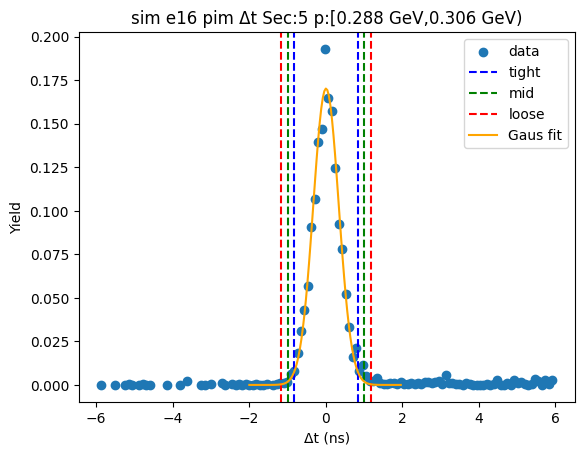

-0.8526043958579856 0.8979187885982016
-1.0276567143036042 1.0729711070438204
-1.202709032749223 1.2480234254894391


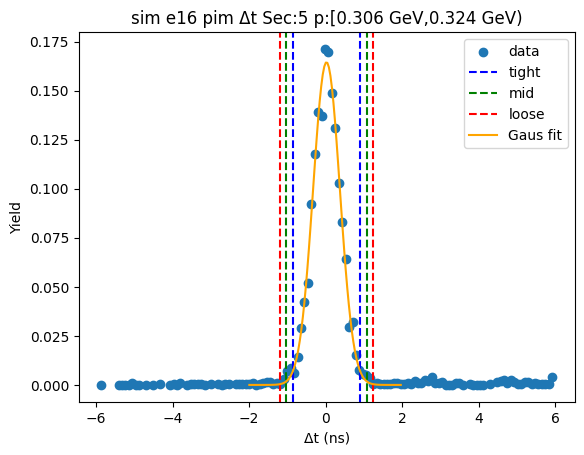

-0.8184997187263469 0.8812122160376169
-0.9884709122027434 1.0511834095140133
-1.1584421056791396 1.22115460299041


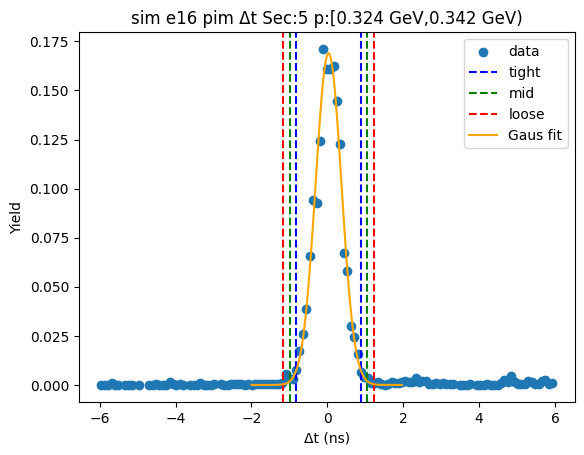

-0.7917177882697323 0.8278511469025377
-0.9536746817869594 0.9898080404197648
-1.115631575304186 1.1517649339369918


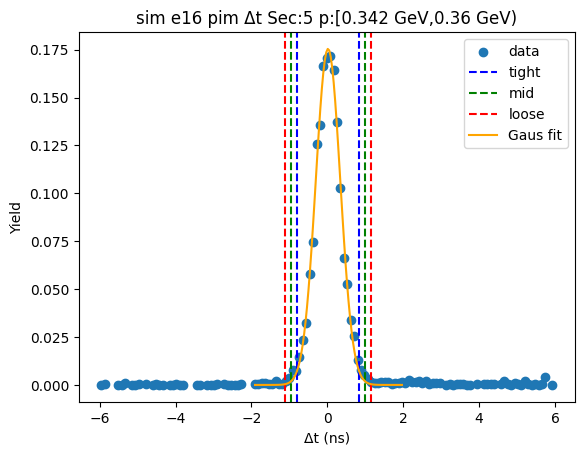

-0.7909668785983528 0.8380936357522673
-0.9538729300334149 1.0009996871873295
-1.1167789814684768 1.1639057386223914


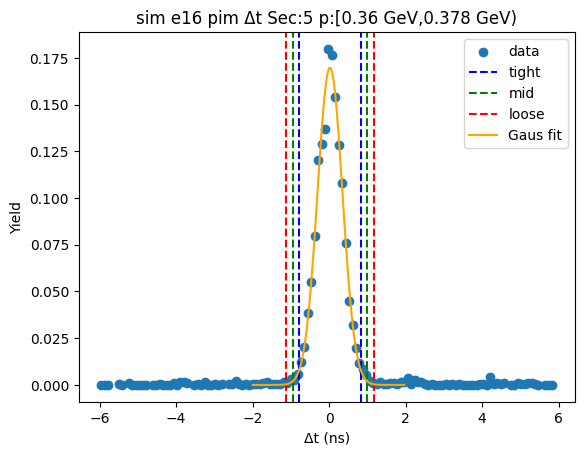

-0.8743334207892839 0.8574372899571958
-1.0475104918639317 1.030614361031844
-1.2206875629385798 1.203791432106492


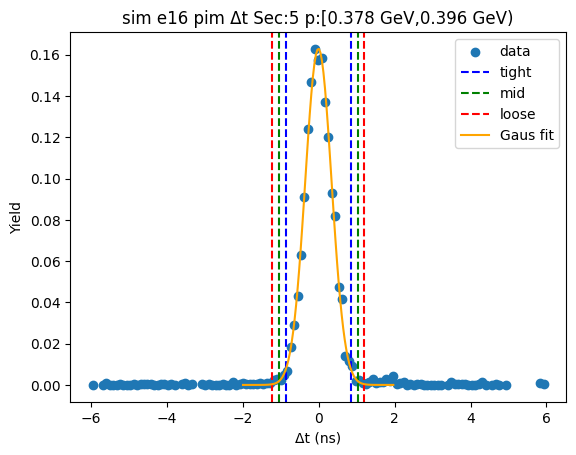

-0.8115542379116224 0.83521043963904
-0.9762307056666886 0.9998869073941061
-1.1409071734217546 1.1645633751491724


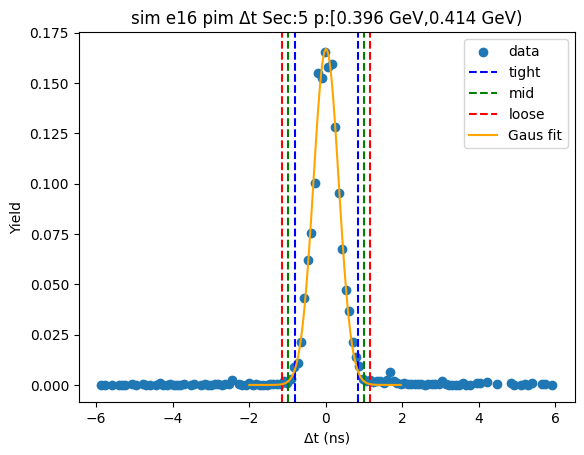

-0.7840430037261502 0.8006788680894564
-0.942515190907711 0.9591510552710172
-1.1009873780892716 1.1176232424525778


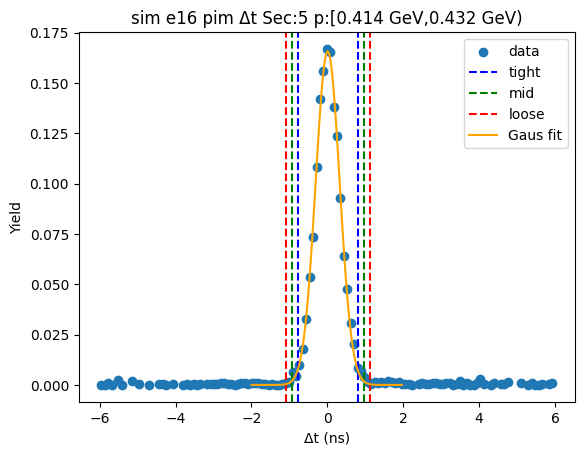

-0.8141660390844494 0.8263764934144533
-0.9782202923343396 0.9904307466643435
-1.1422745455842298 1.1544849999142337


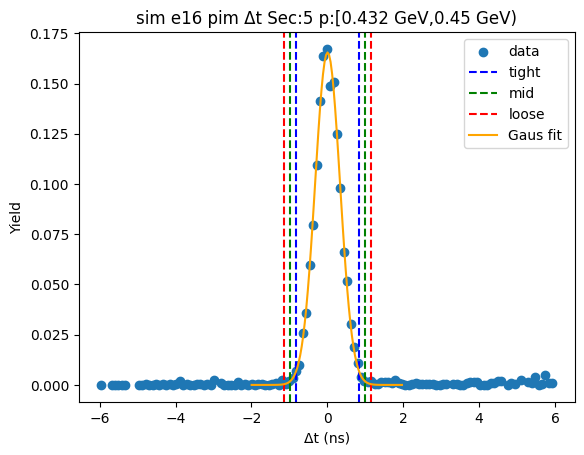

-0.7838566914336894 0.8049933905805767
-0.9427416996351161 0.9638783987820034
-1.1016267078365427 1.12276340698343


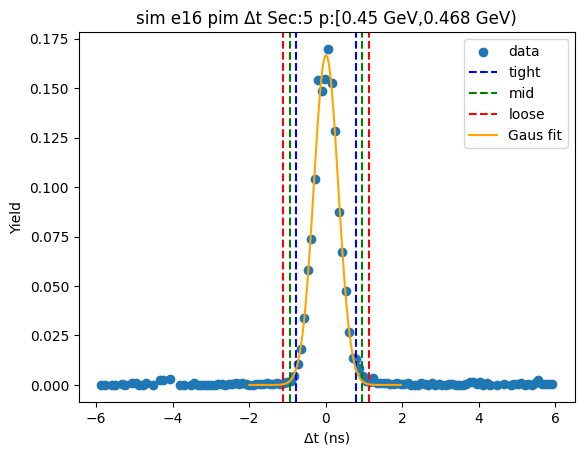

-0.7919126097707865 0.8201430066382205
-0.9531181714116871 0.9813485682791211
-1.114323733052588 1.1425541299200217


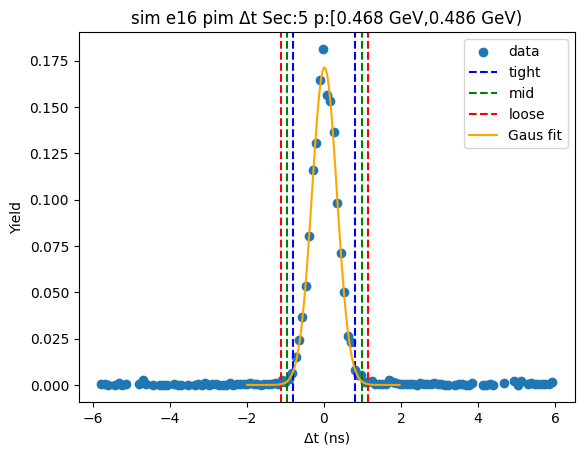

-0.7694908900939881 0.8035712454506281
-0.9267971036484497 0.9608774590050897
-1.0841033172029113 1.1181836725595513


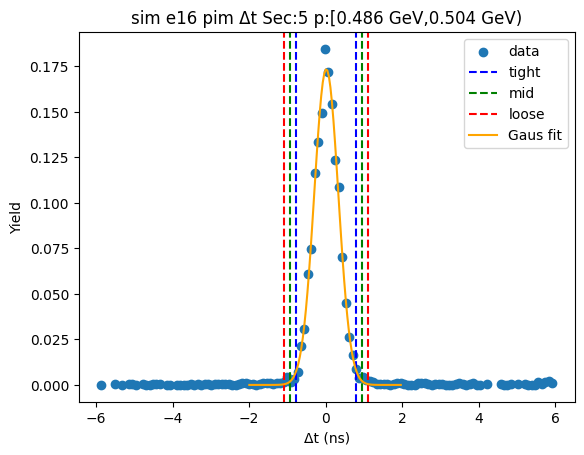

-0.7897545333256213 0.7952461204796331
-0.9482545987061468 0.9537461858601586
-1.1067546640866721 1.1122462512406839


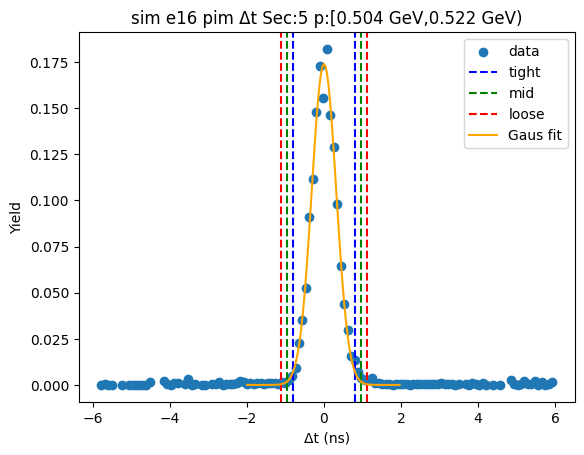

-0.8174186739812873 0.83032947459851
-0.982193488839267 0.9951042894564898
-1.1469683036972467 1.1598791043144696


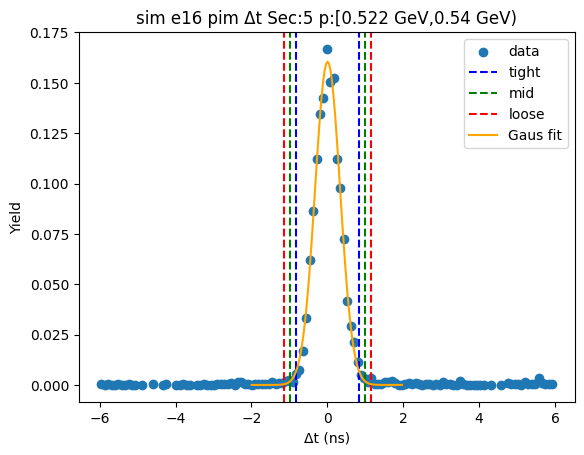

-0.787250406638861 0.8008898605625869
-0.9460644333590059 0.9597038872827318
-1.1048784600791506 1.1185179140028767


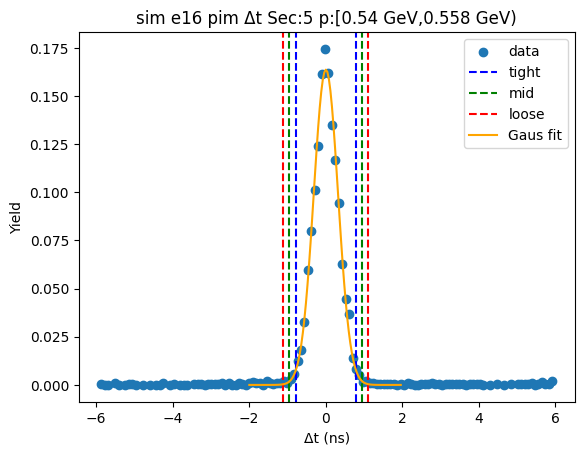

-0.816957892456926 0.7979738438781919
-0.9784510660904377 0.9594670175117037
-1.1399442397239496 1.1209601911452156


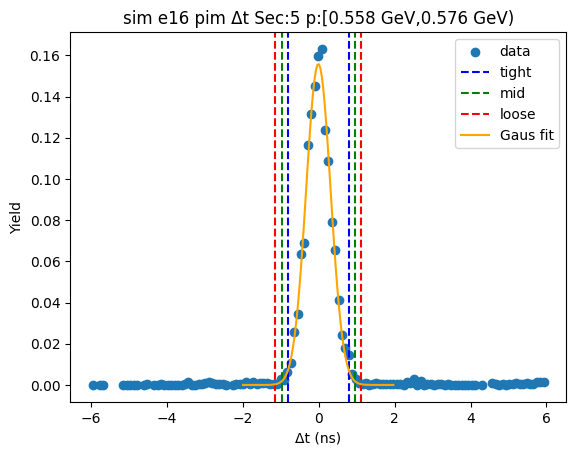

-0.8041405829889227 0.8276397887421182
-0.9673186201620267 0.9908178259152223
-1.130496657335131 1.1539958630883265


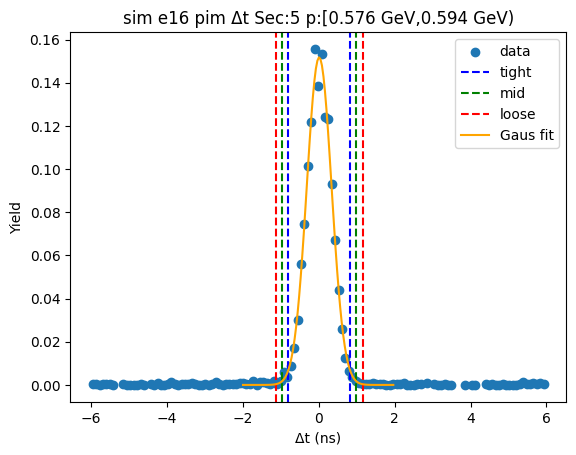

-0.7903542307577526 0.8010480938290444
-0.9494944632164323 0.9601883262877241
-1.108634695675112 1.1193285587464037


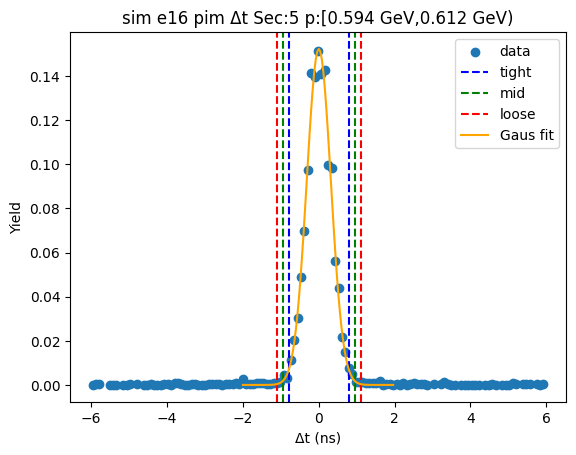

-0.7812133789882387 0.8016279819480168
-0.9394975150818642 0.9599121180416422
-1.0977816511754896 1.118196254135268


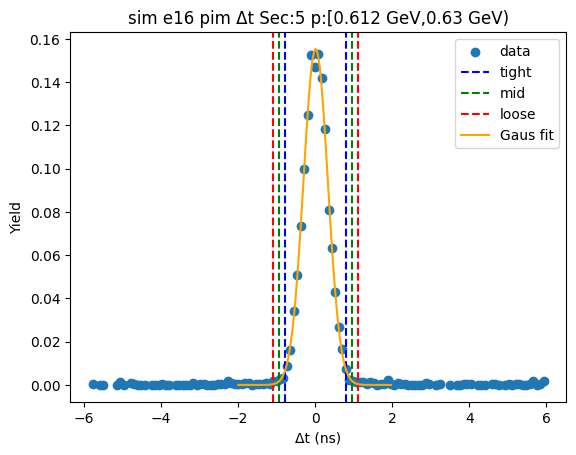

-0.7729264106169121 0.8069706336112022
-0.9309161150397235 0.9649603380340136
-1.088905819462535 1.1229500424568253


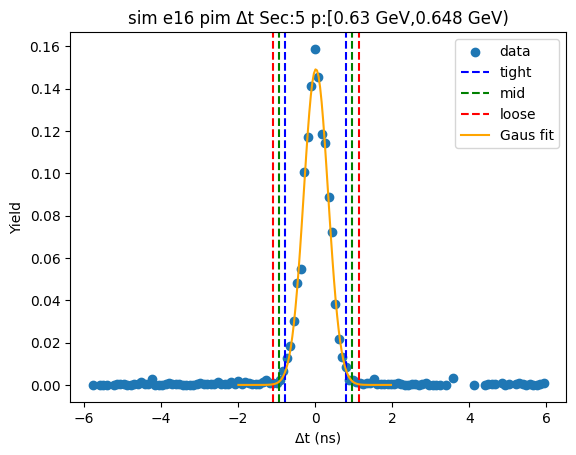

-0.7808798256364092 0.813022449356155
-0.9402700531356656 0.9724126768554113
-1.0996602806349218 1.1318029043546678


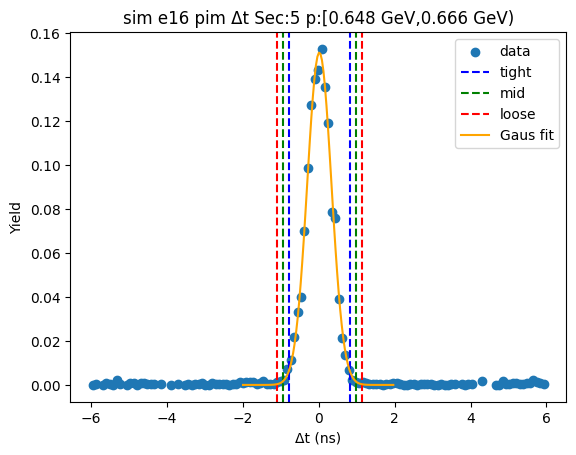

-0.7413251968561341 0.7423827890044679
-0.8896959954421944 0.8907535875905281
-1.0380667940282544 1.0391243861765882


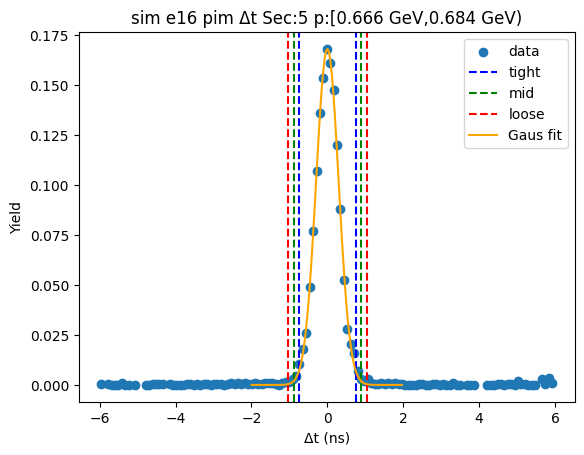

-0.764022780585986 0.7802780738179578
-0.9184528660263804 0.9347081592583522
-1.0728829514667748 1.0891382446987465


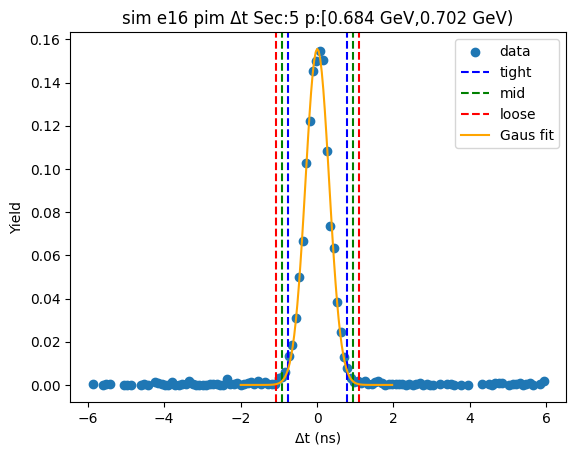

-0.7404064559472305 0.7660346928487114
-0.8910505708268248 0.9166788077283057
-1.0416946857064189 1.0673229226078997


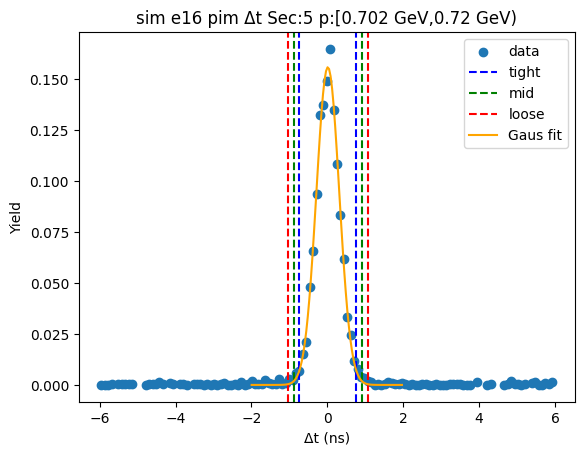

-0.7581095001291656 0.7829144930312766
-0.9122118994452099 0.9370168923473209
-1.0663142987612542 1.091119291663365


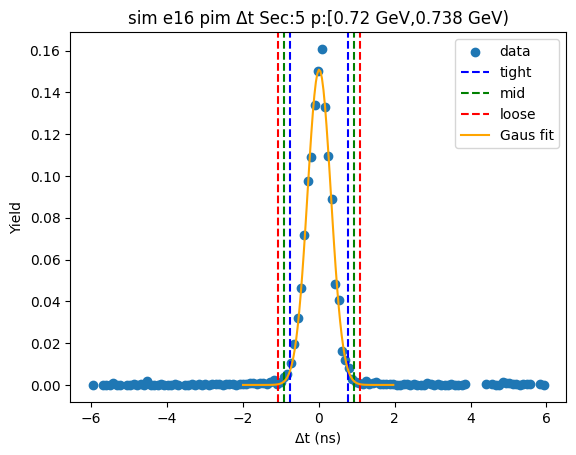

-0.7676755913002185 0.7902281355400032
-0.9234659639842405 0.9460185082240252
-1.0792563366682628 1.1018088809080473


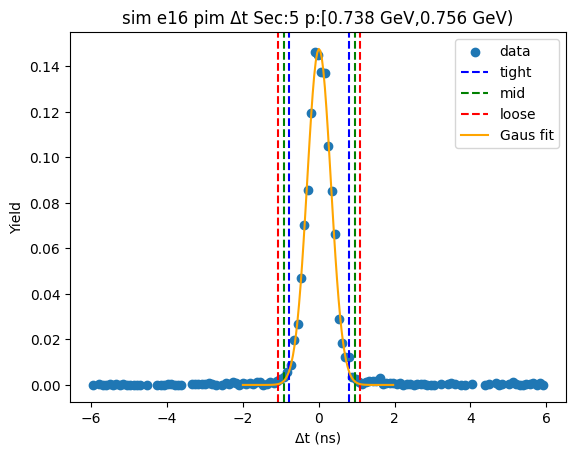

-0.7255349531826394 0.75556184644841
-0.8736446331457443 0.9036715264115148
-1.0217543131088491 1.0517812063746197


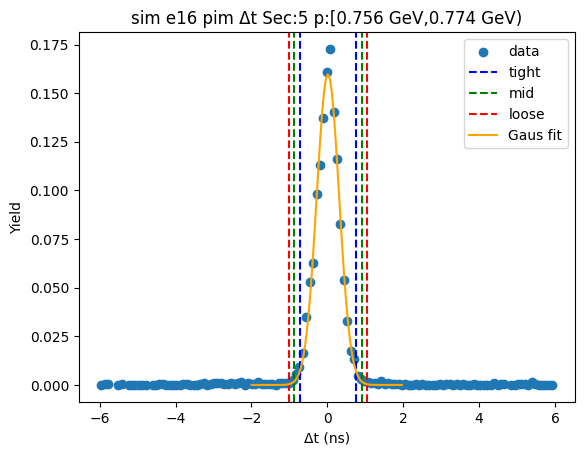

-0.737600846784503 0.7552117417056159
-0.8868821056335149 0.9044930005546278
-1.036163364482527 1.0537742594036397


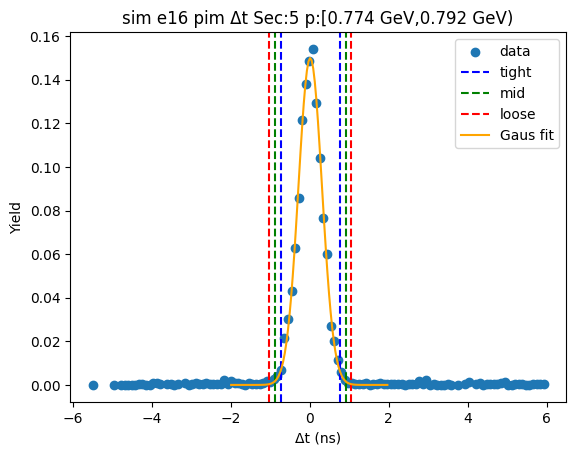

-0.7469372069501637 0.7409953837775157
-0.8957304660229316 0.8897886428502836
-1.0445237250956996 1.0385819019230518


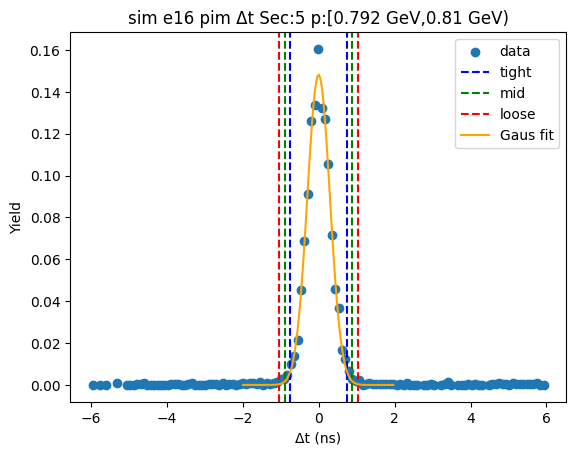

-0.7714476996091477 0.7753012095468952
-0.9261225905247521 0.9299761004624996
-1.0807974814403563 1.0846509913781037


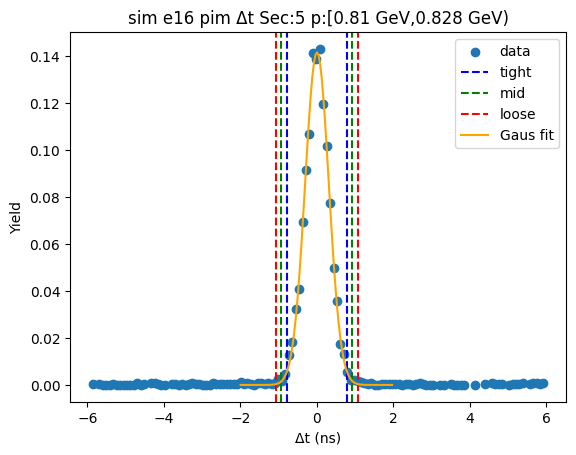

-0.7495529317095158 0.7698208597089511
-0.9014903108513624 0.9217582388507978
-1.0534276899932091 1.0736956179926447


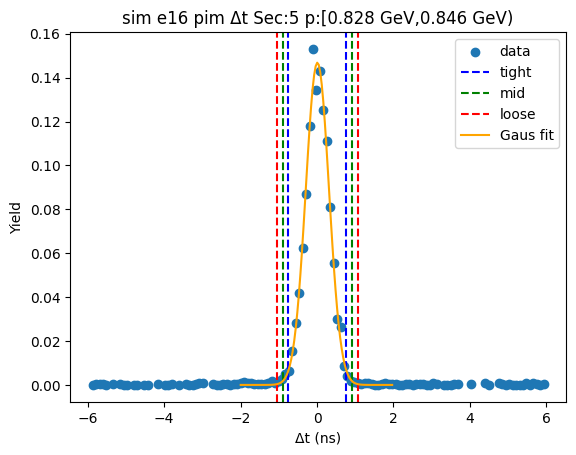

-0.7668903028016795 0.7873669259708992
-0.9223160256789373 0.942792648848157
-1.0777417485561953 1.098218371725415


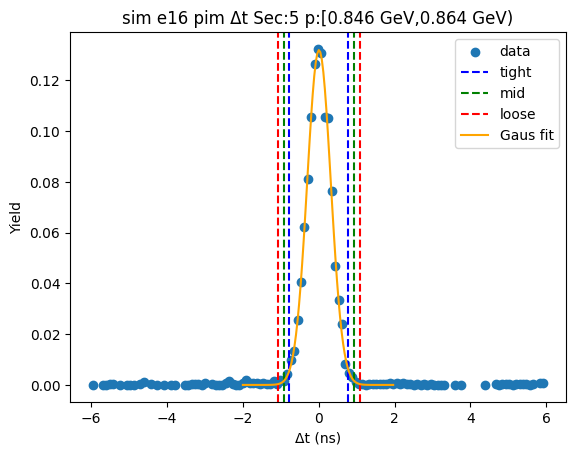

-0.744206611096621 0.7679730654066645
-0.8954245787469495 0.919191033056993
-1.0466425463972782 1.0704090007073217


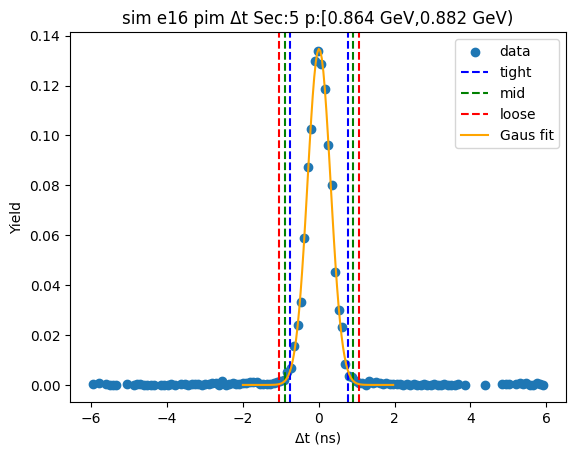

-0.7509574344632559 0.7761254288894865
-0.9036657207985302 0.9288337152247609
-1.0563740071338044 1.0815420015600352


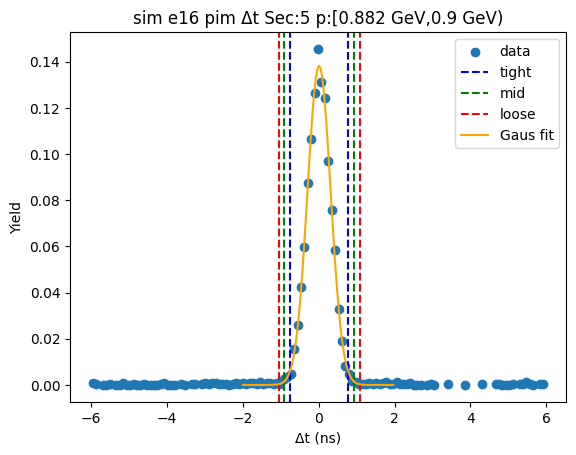

-0.7381869580831402 0.7560619742076029
-0.8876118513122145 0.9054868674366773
-1.037036744541289 1.0549117606657517


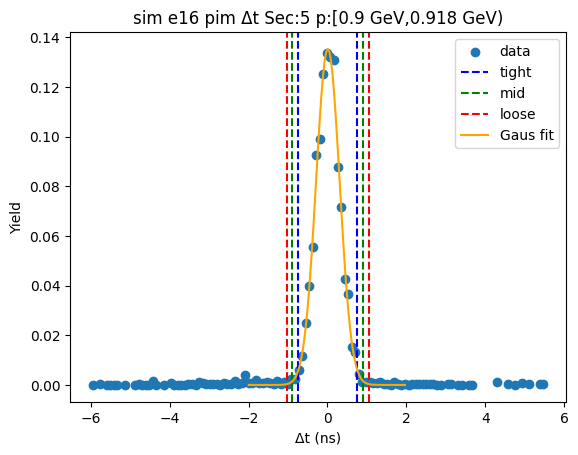

-0.7633294068438163 0.7317789685408254
-0.9128402443822805 0.8812898060792895
-1.0623510819207447 1.0308006436177537


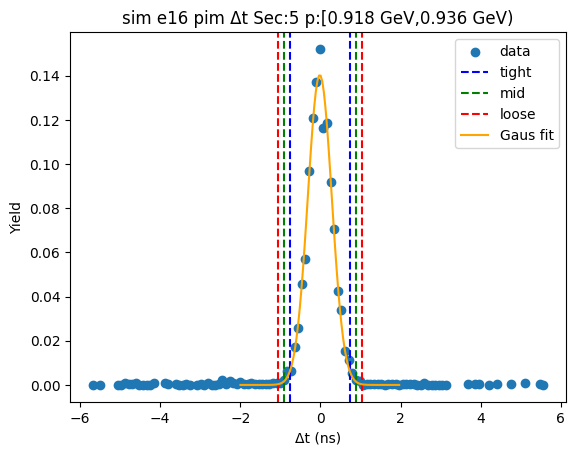

-0.767822881537218 0.7668012255702158
-0.9212852922479613 0.9202636362809591
-1.0747477029587047 1.0737260469917025


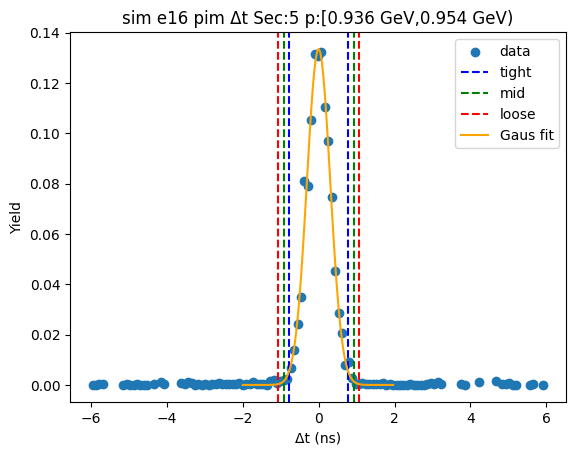

-0.7285728951873133 0.7226299179999921
-0.8736931765060437 0.8677501993187225
-1.0188134578247743 1.0128704806374533


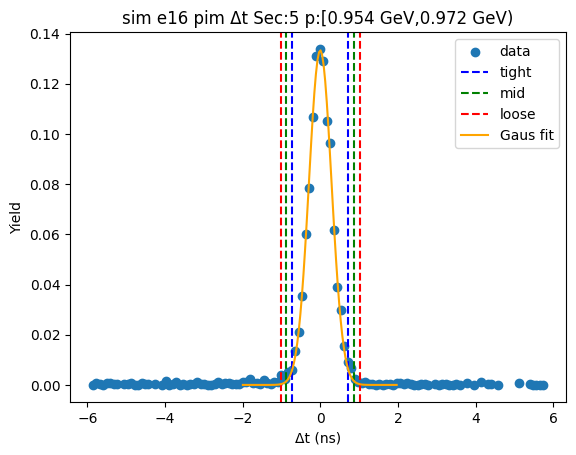

-0.7220633139803249 0.7571343770068574
-0.8699830830790432 0.9050541461055757
-1.0179028521777613 1.052973915204294


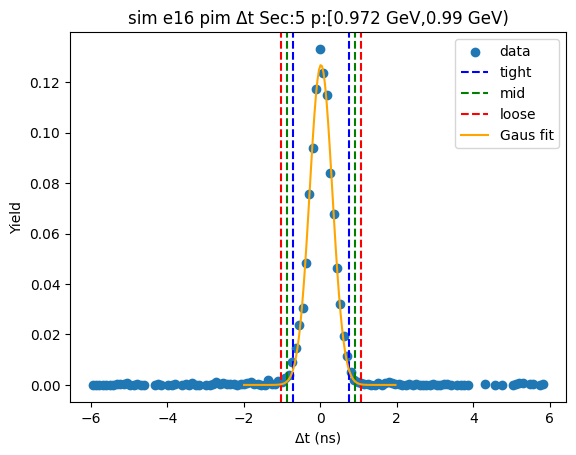

-0.7214474709542343 0.7527323002332754
-0.8688654480729854 0.9001502773520265
-1.0162834251917365 1.0475682544707774


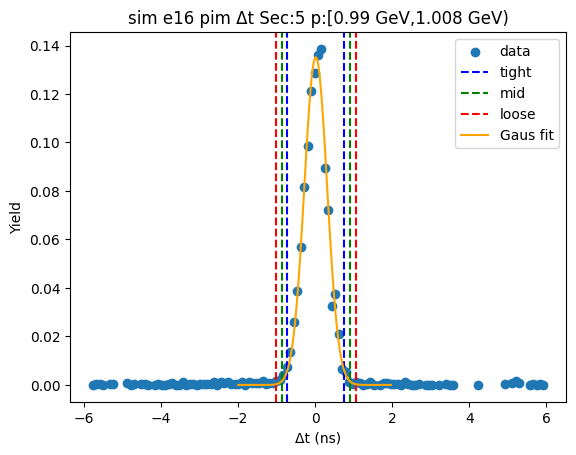

-0.7239384665023831 0.7196811513163843
-0.8683004282842598 0.864043113098261
-1.0126623900661367 1.0084050748801376


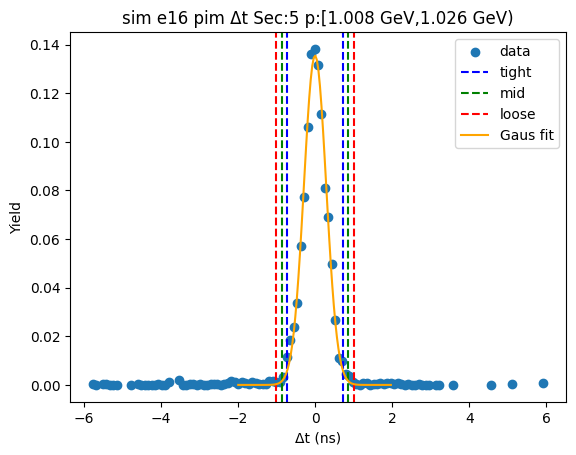

-0.7344395215925085 0.7660739023701563
-0.8844908639887749 0.9161252447664227
-1.0345422063850414 1.0661765871626894


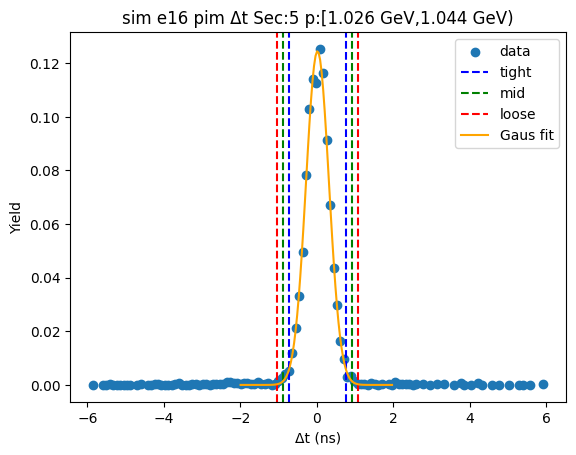

-0.7418043120784409 0.7579879423677719
-0.8917835375230622 0.9079671678123932
-1.0417627629676833 1.0579463932570146


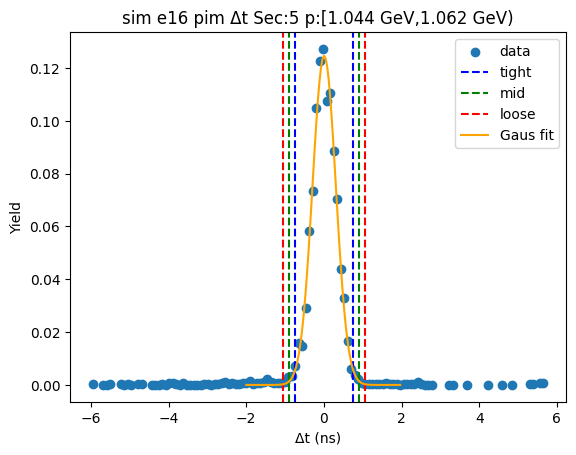

-0.7147586193194023 0.7417732567605774
-0.8604118069274004 0.8874264443685754
-1.0060649945353983 1.0330796319765732


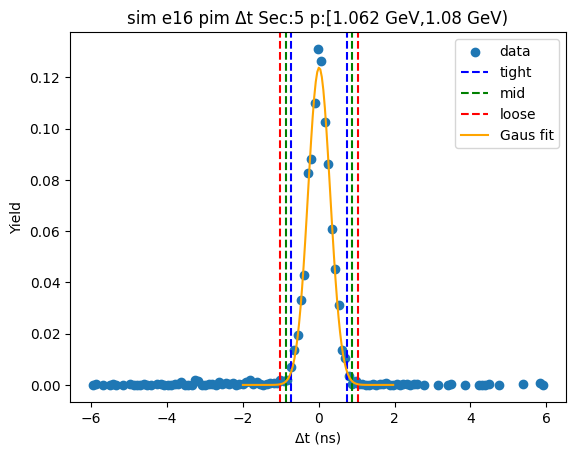

-0.7276382982320159 0.7543140793350601
-0.8758335359887234 0.9025093170917676
-1.024028773745431 1.0507045548484755


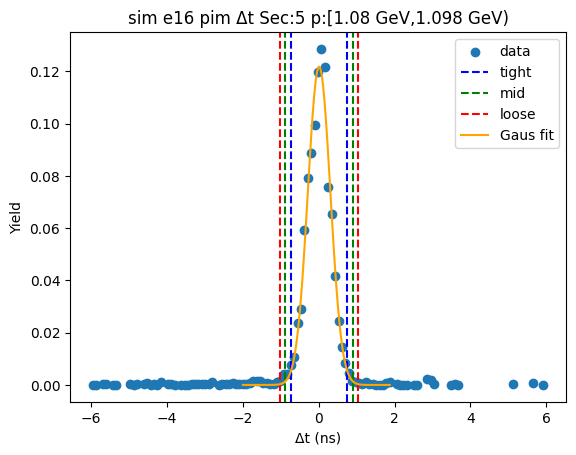

-0.7684713494790607 0.7606448863469715
-0.9213829730616638 0.9135565099295746
-1.0742945966442672 1.066468133512178


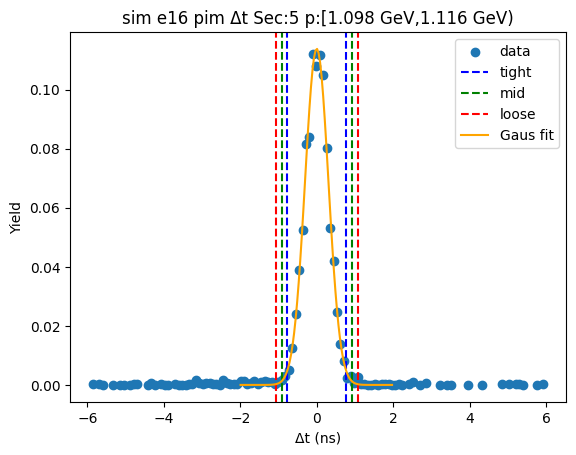

-0.7095430177979619 0.735713017971026
-0.8540686213748606 0.8802386215479246
-0.9985942249517595 1.0247642251248237


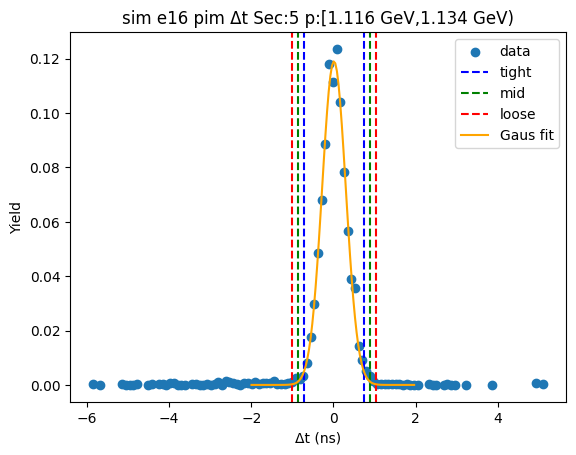

-0.7206849258942236 0.7476005682221702
-0.8675134753058631 0.8944291176338097
-1.0143420247175023 1.041257667045449


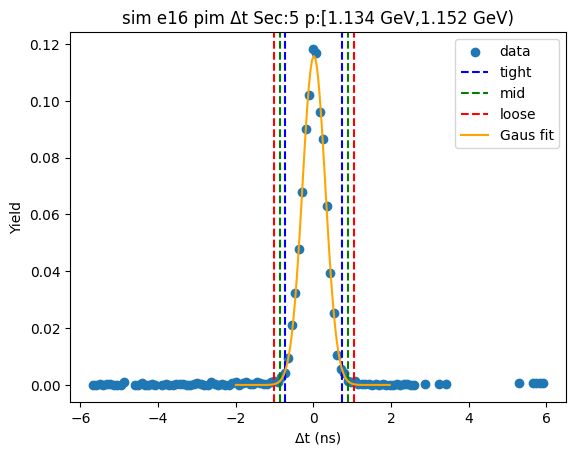

-0.7064616838037274 0.7247054048462123
-0.8495783926687215 0.8678221137112063
-0.9926951015337153 1.0109388225762002


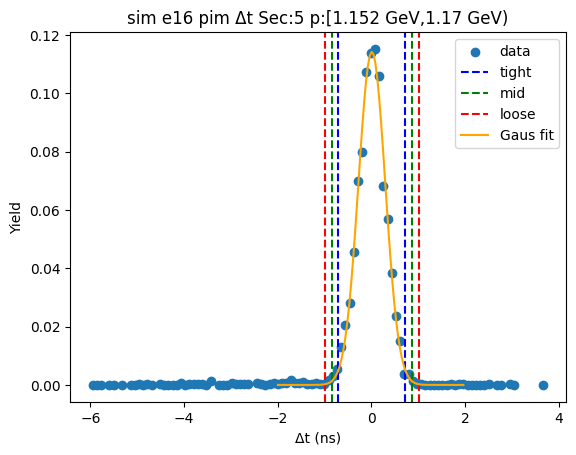

-0.7366448769293984 0.751775345987488
-0.885486899221087 0.9006173682791766
-1.0343289215127756 1.0494593905708653


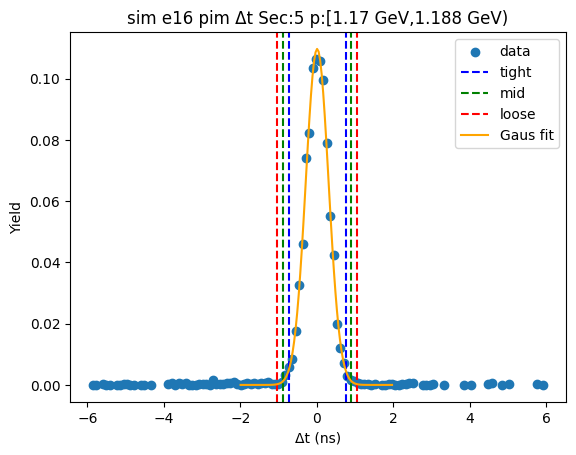

-0.7248240702577842 0.7295334562197366
-0.8702598229055362 0.8749692088674886
-1.0156955755532884 1.0204049615152406


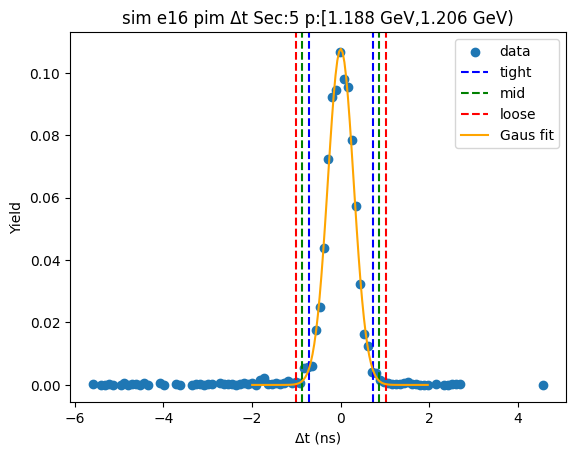

-0.7486783214977758 0.7707744089259315
-0.9006235945401466 0.9227196819683023
-1.0525688675825173 1.074664955010673


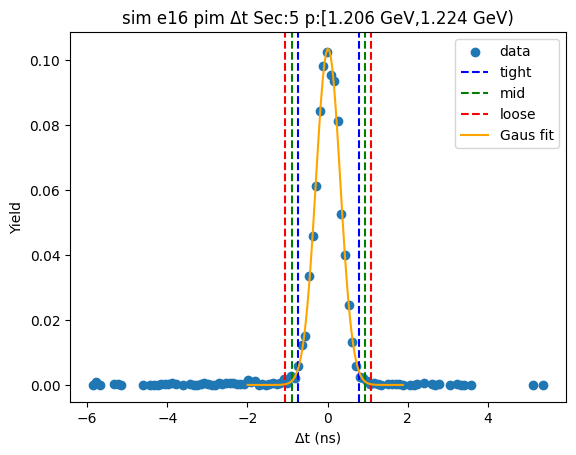

-0.7240937635667182 0.7228621711680421
-0.8687893570401941 0.867557764641518
-1.0134849505136703 1.0122533581149942


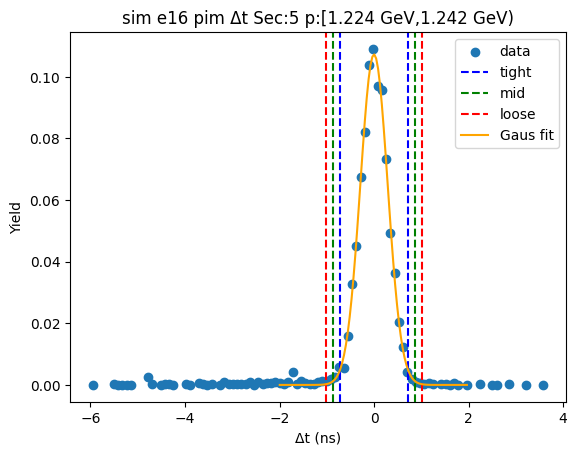

-0.6875331536753383 0.7184433238742604
-0.8281308014302982 0.8590409716292202
-0.968728449185258 0.9996386193841801


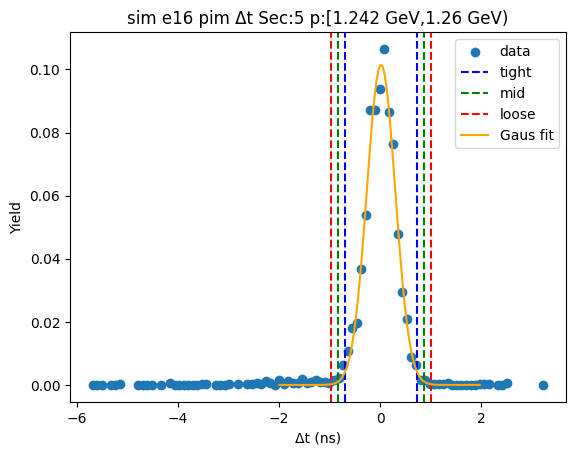

-0.7460506423617944 0.7475389440832781
-0.8954096010063017 0.8968979027277855
-1.0447685596508092 1.0462568613722927


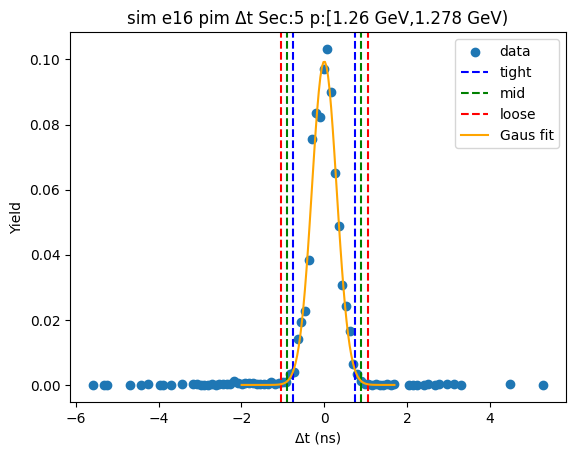

-0.6981894786233294 0.7279416667229281
-0.840802593157955 0.8705547812575538
-0.9834157076925808 1.0131678957921797


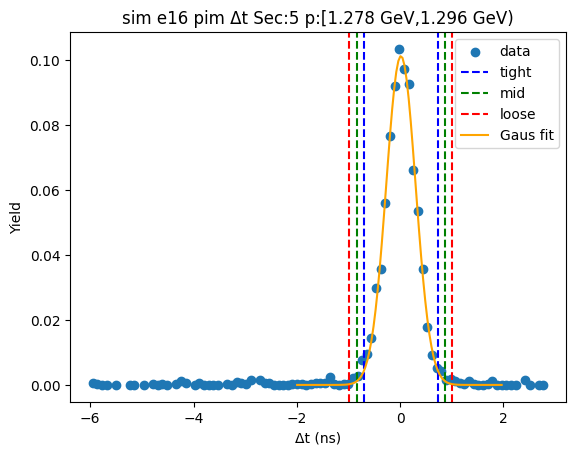

-0.712974571046439 0.7485651598846486
-0.8591285441395479 0.8947191329777574
-1.0052825172326565 1.0408731060708662


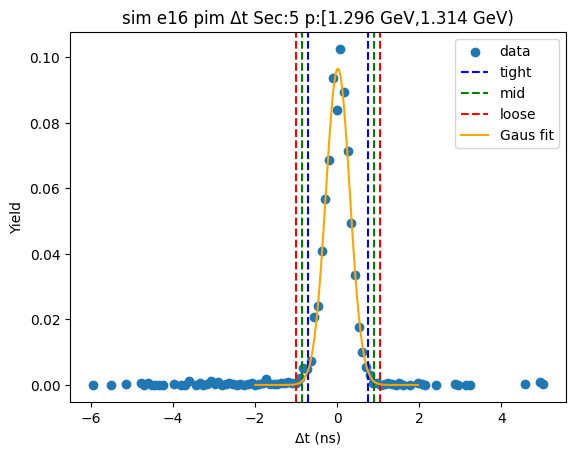

-0.7109053645574591 0.7309288982225653
-0.8550887908354616 0.8751123245005679
-0.9992722171134641 1.0192957507785705


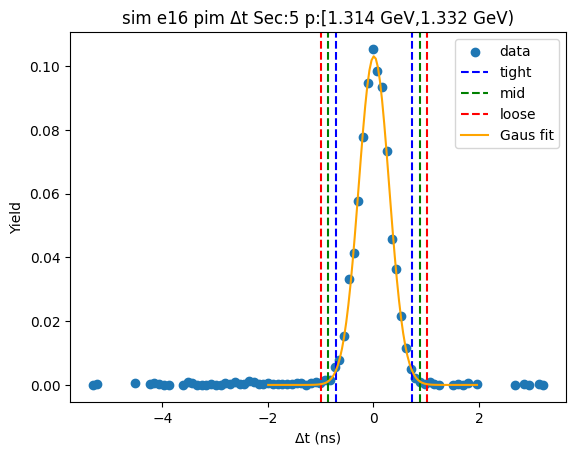

-0.7222163154284414 0.7410951516057899
-0.8685474621318645 0.8874262983092129
-1.0148786088352875 1.0337574450126361


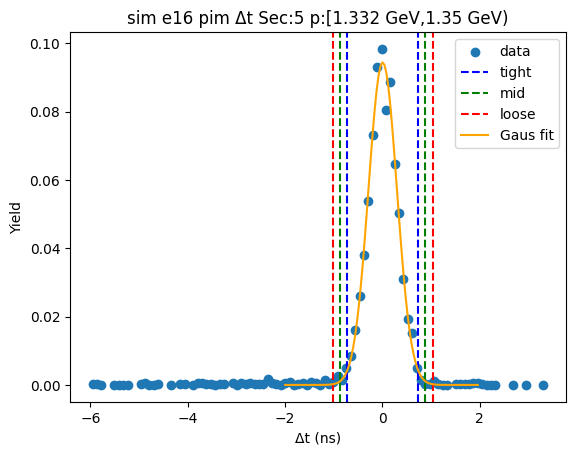

-0.7189117621664785 0.750629130470676
-0.8658658514301939 0.8975832197343915
-1.0128199406939091 1.044537308998107


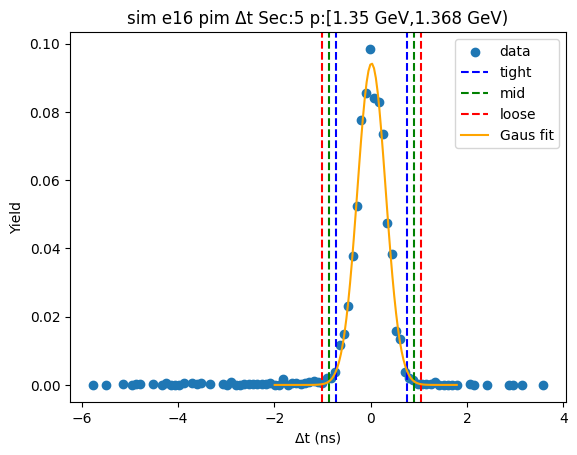

-0.7314673797429734 0.7704568872974313
-0.8816598064470139 0.9206493140014719
-1.0318522331510545 1.0708417407055124


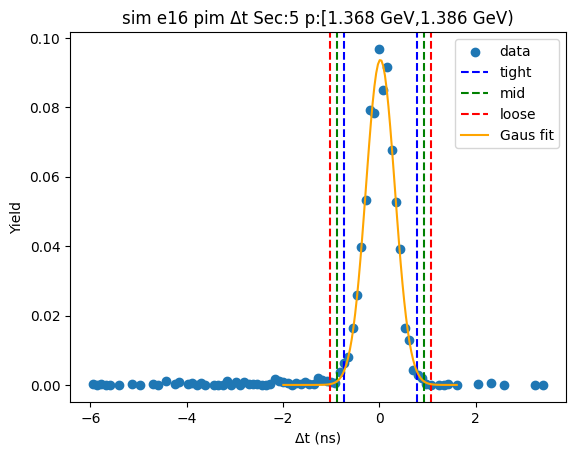

-0.7366442522204222 0.7594300081505436
-0.8862516782575188 0.9090374341876403
-1.0358591042946155 1.058644860224737


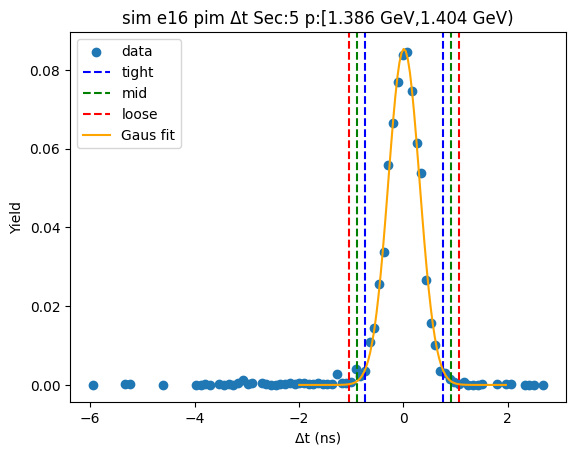

-0.6932705662183198 0.702576100738977
-0.8328552329140496 0.8421607674347068
-0.9724398996097793 0.9817454341304365


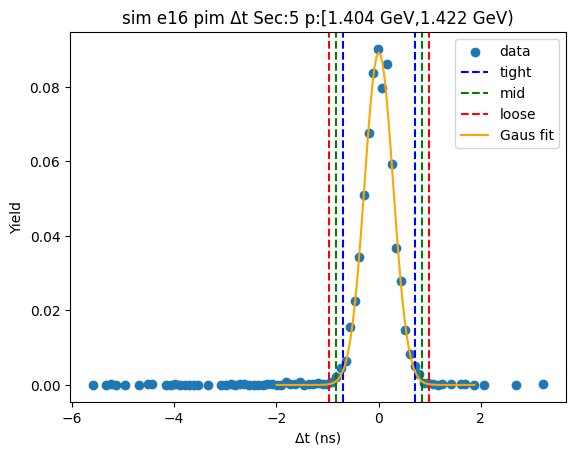

-0.7129558927256792 0.7312527343126205
-0.8573767554295092 0.8756735970164505
-1.0017976181333392 1.0200944597202806


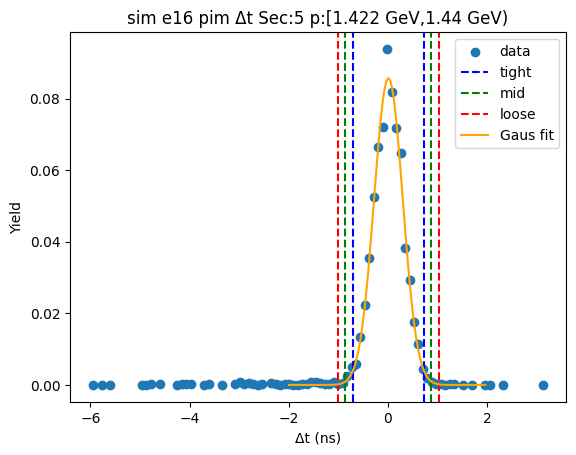

-0.7370808141989776 0.7820488200460692
-0.8889937776234824 0.933961783470574
-1.040906741047987 1.0858747468950787


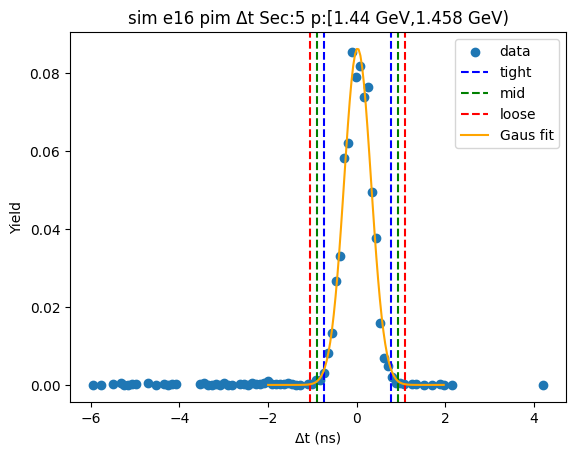

-0.7375334515201858 0.7666423161489281
-0.8879510282870973 0.9170598929158396
-1.0383686050540086 1.067477469682751


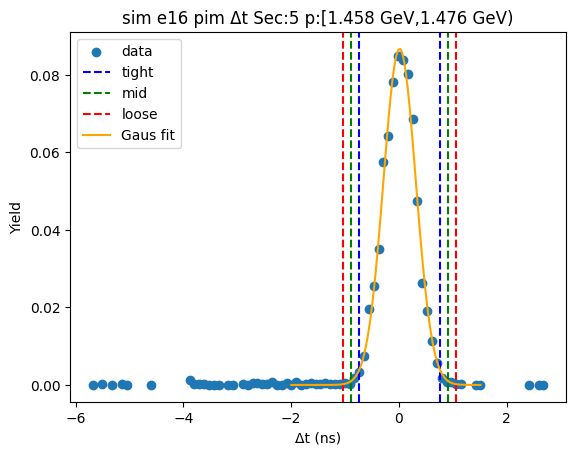

-0.7074055913964291 0.7228329225178519
-0.8504294427878571 0.86585677390928
-0.9934532941792852 1.008880625300708


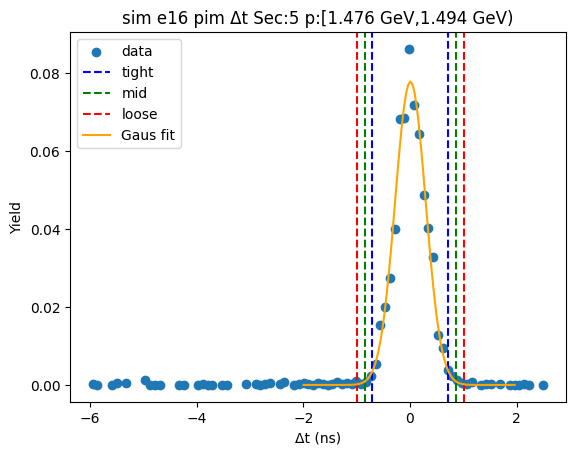

-0.6911981425435861 0.7241241048313732
-0.8327303672810821 0.8656563295688692
-0.974262592018578 1.007188554306365


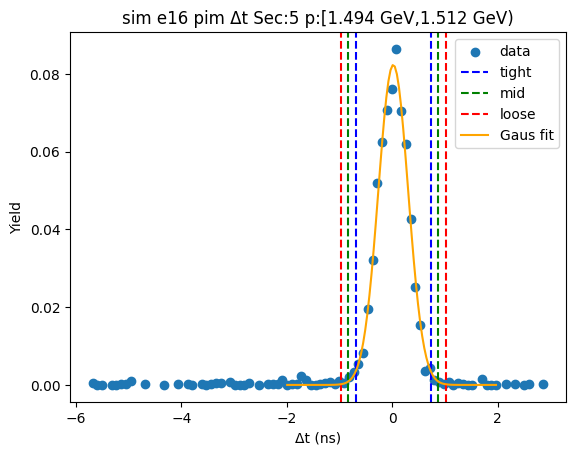

-0.7230209924548265 0.7534803828971202
-0.8706711299900213 0.9011305204323149
-1.018321267525216 1.0487806579675096


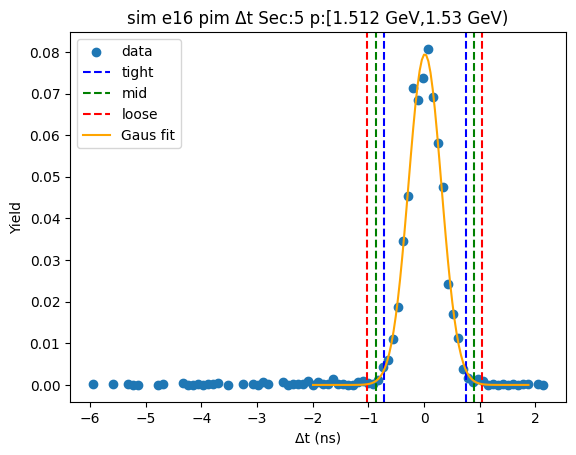

-0.707746683223601 0.7251793910093076
-0.8510392906468919 0.8684719984325985
-0.9943318980701826 1.0117646058558893


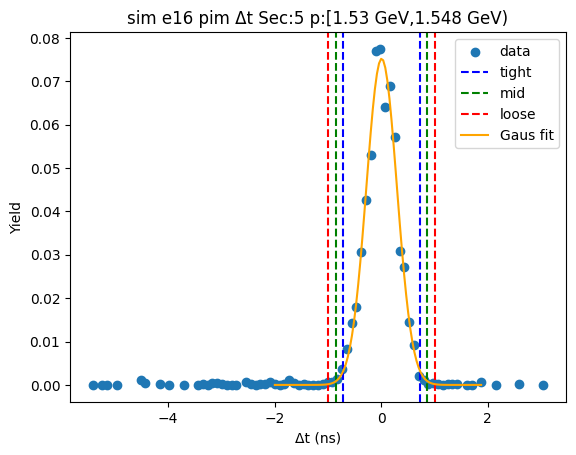

-0.6781444637151989 0.6961688995966225
-0.8155758000463811 0.8336002359278047
-0.9530071363775633 0.971031572258987


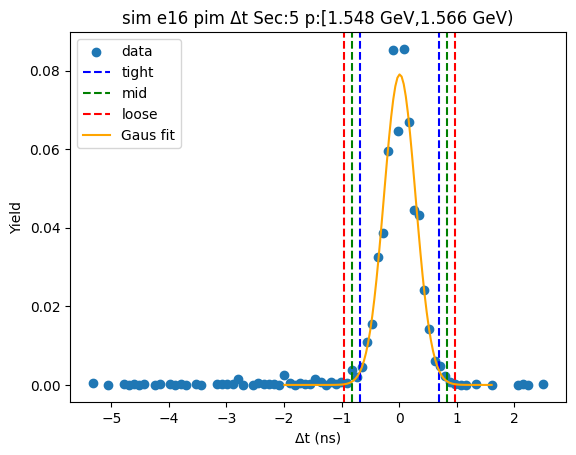

-0.6756128725289716 0.7104656588602527
-0.814220725667894 0.8490735119991751
-0.9528285788068165 0.9876813651380976


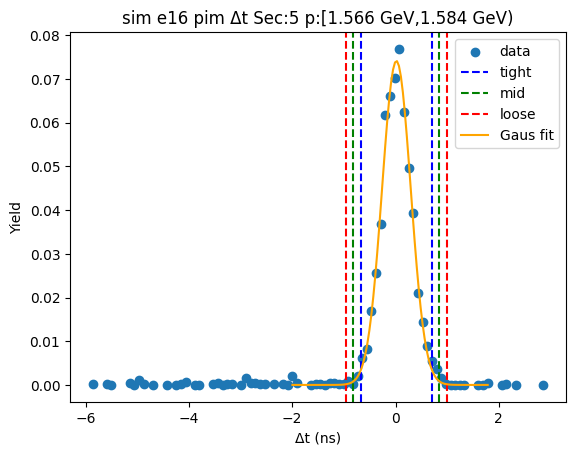

-0.7237216115155097 0.7333583657815855
-0.8694296092452192 0.879066363511295
-1.0151376069749287 1.0247743612410045


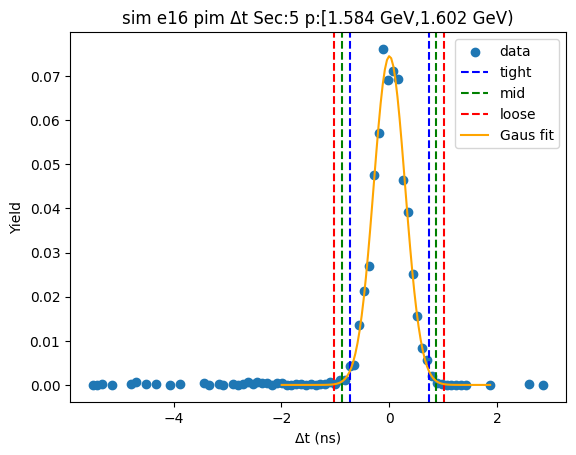

-0.7385934540392692 0.7324350384211978
-0.885696303285316 0.8795378876672446
-1.0327991525313627 1.0266407369132915


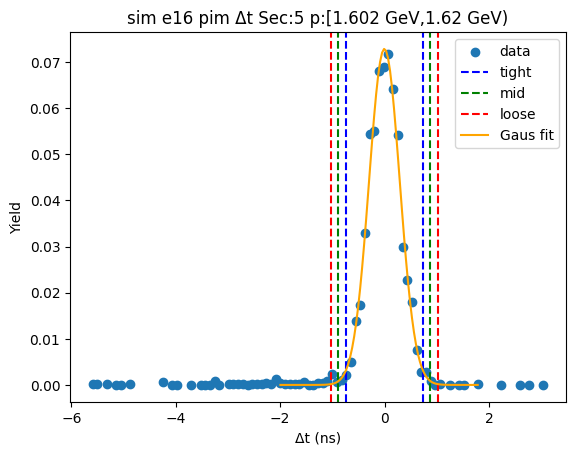

-0.720078076769254 0.7805606092135685
-0.8701419453675362 0.9306244778118508
-1.0202058139658183 1.0806883464101331


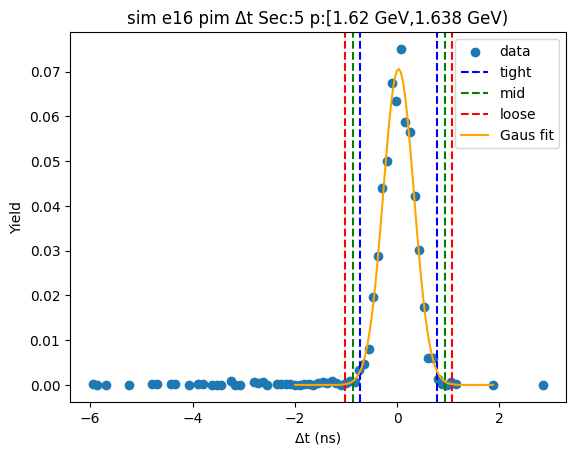

-0.6642536259062028 0.7066549737947927
-0.8013444858763025 0.8437458337648923
-0.9384353458464021 0.9808366937349919


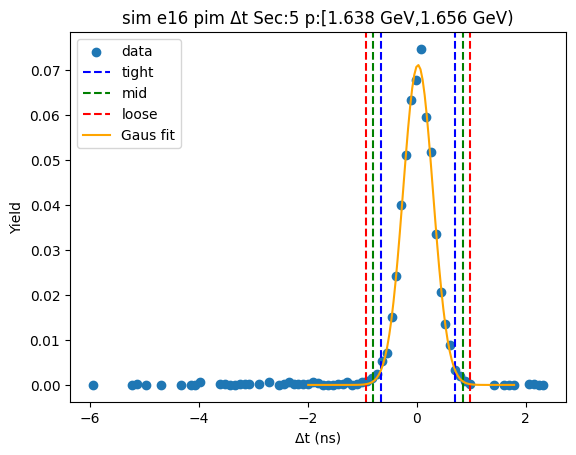

-0.727914458507367 0.7365672191052218
-0.8743626262686258 0.8830153868664806
-1.020810794029885 1.0294635546277395


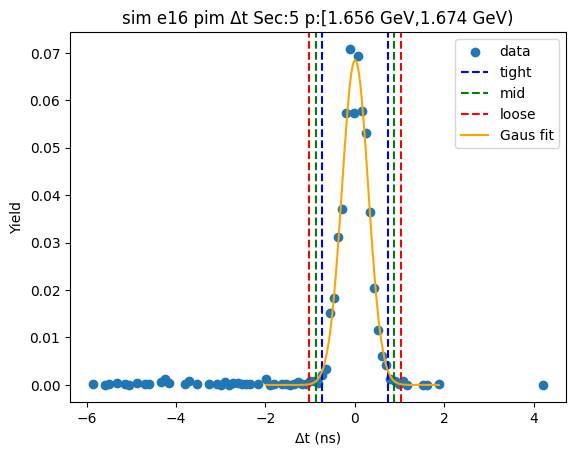

-0.7420835327045722 0.774109026251454
-0.8937027886001747 0.9257282821470565
-1.0453220444957774 1.077347538042659


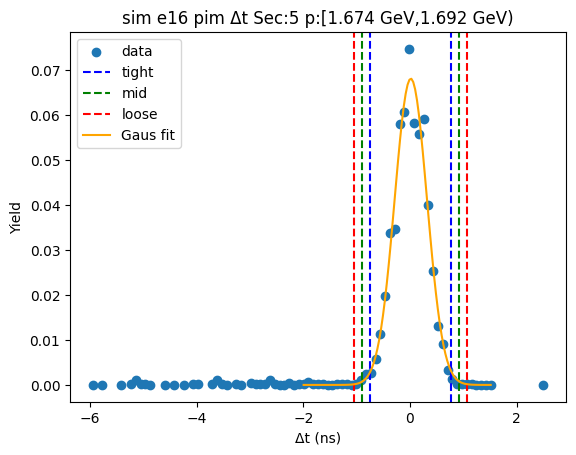

-0.6927772212948409 0.7542482301634419
-0.8374797664406692 0.8989507753092703
-0.9821823115864974 1.0436533204550984


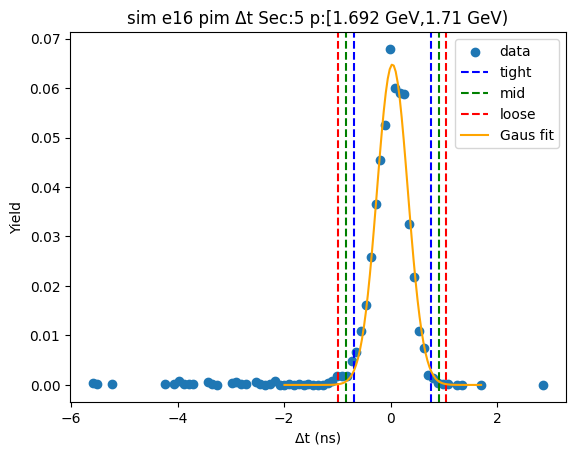

-0.6541424375389683 0.7511830487688597
-0.7946749861697511 0.8917155973996425
-0.9352075348005339 1.0322481460304251


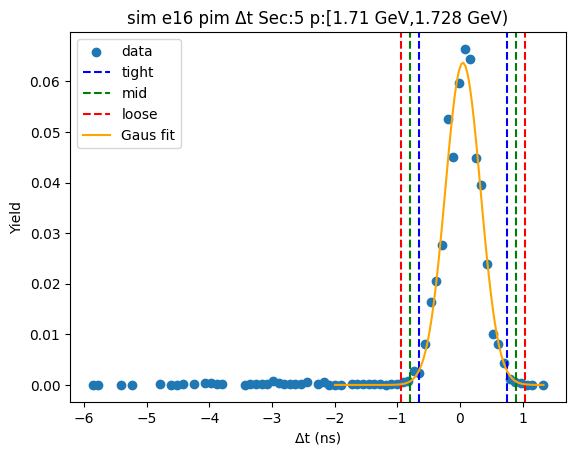

-0.6869301064205501 0.7265747806889188
-0.8282805951314969 0.8679252693998656
-0.9696310838424438 1.0092757581108125


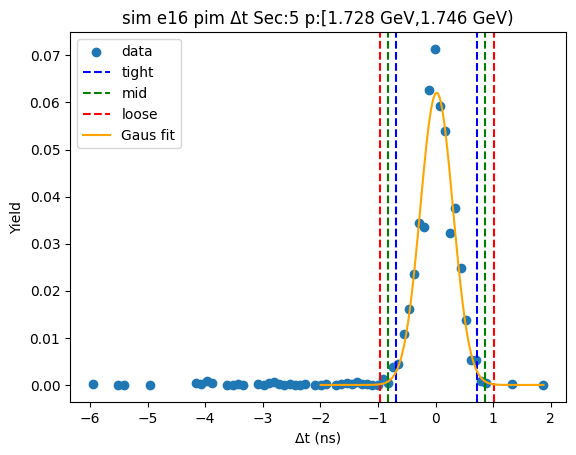

-0.7185190513226607 0.7378312571517933
-0.864154082170106 0.8834662879992387
-1.0097891130175514 1.029101318846684


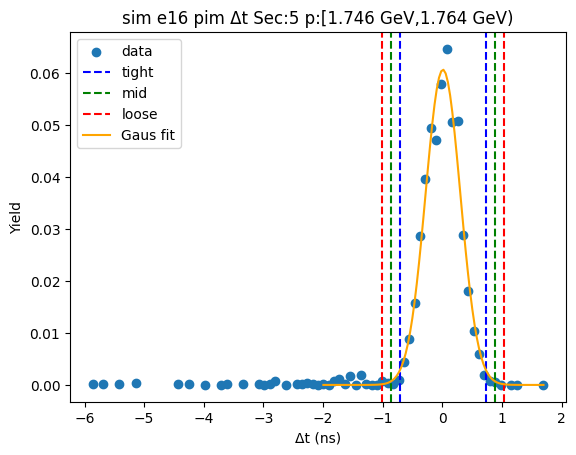

-0.6699906696614031 0.6979702415074385
-0.8067867607782871 0.8347663326243225
-0.9435828518951713 0.9715624237412067


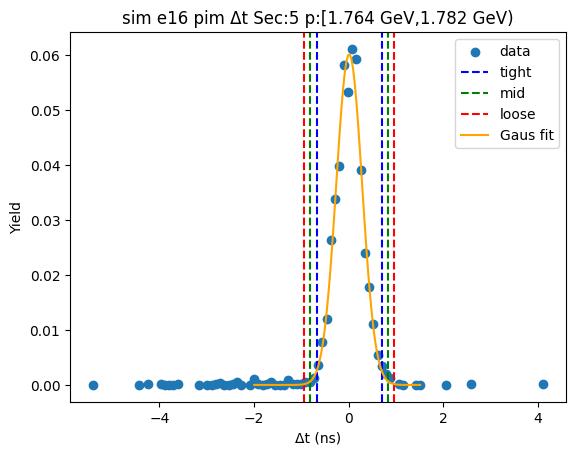

-0.6445951488205224 0.6786612278299455
-0.7769207864855692 0.8109868654949923
-0.909246424150616 0.9433125031600391


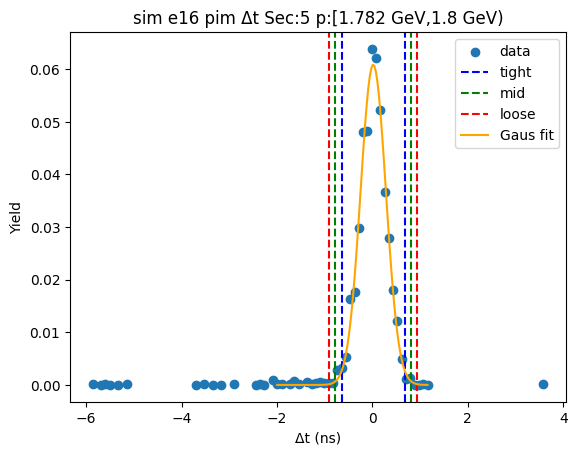

-0.7129404454603532 0.7336959144495574
-0.8576040814513441 0.8783595504405484
-1.0022677174423353 1.0230231864315396


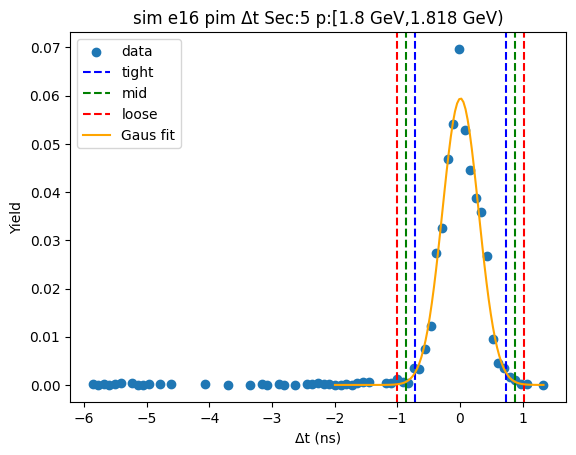

-0.6963055491702997 0.7295836765304101
-0.8388944717403708 0.8721725991004812
-0.9814833943104418 1.0147615216705523


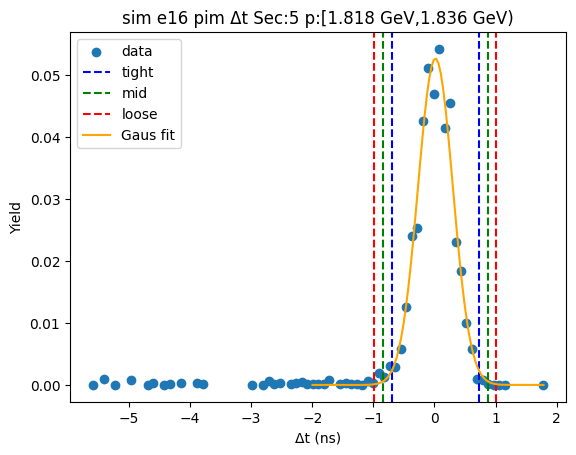

-0.6679257273338916 0.7364316041158313
-0.8083614604788639 0.8768673372608037
-0.9487971936238362 1.017303070405776


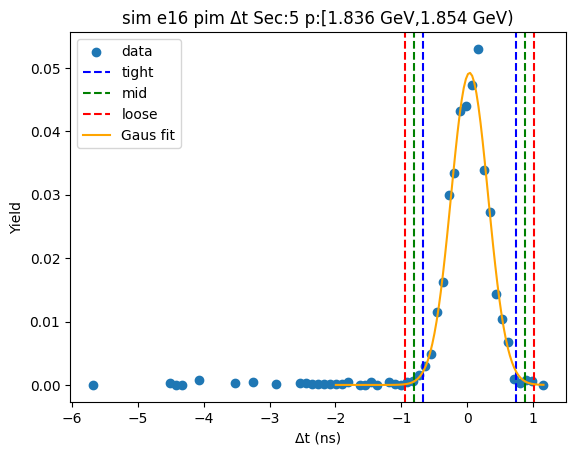

-0.6392121475541442 0.7131237481917808
-0.7744457371287367 0.8483573377663732
-0.9096793267033292 0.9835909273409658


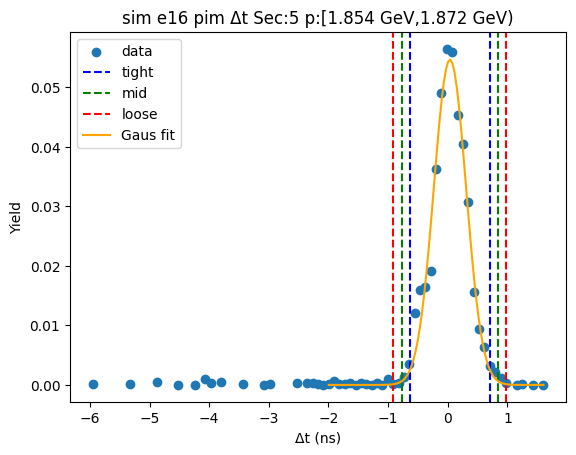

-0.7545241028367194 0.7762586721215906
-0.9076023803325504 0.9293369496174215
-1.0606806578283814 1.0824152271132526


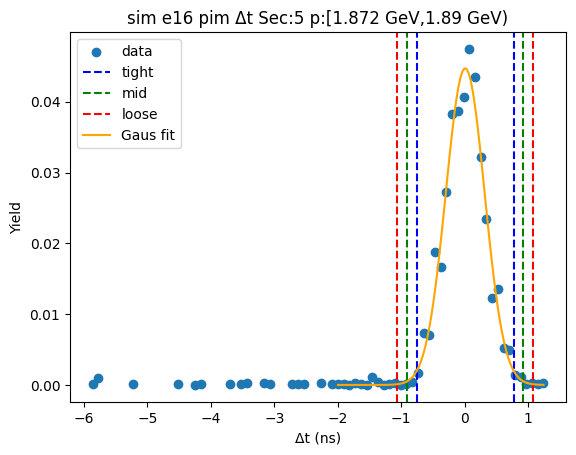

-0.732534491550088 0.7474385919544286
-0.8805317999005396 0.8954359003048803
-1.0285291082509915 1.043433208655332


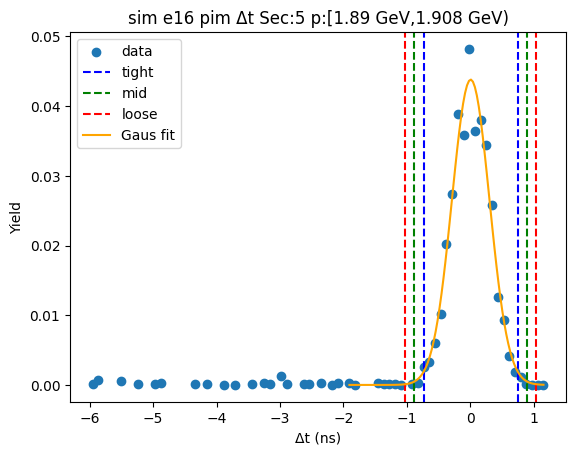

-0.7060258896739284 0.7307961470106801
-0.8497080933423893 0.8744783506791409
-0.9933902970108501 1.0181605543476018


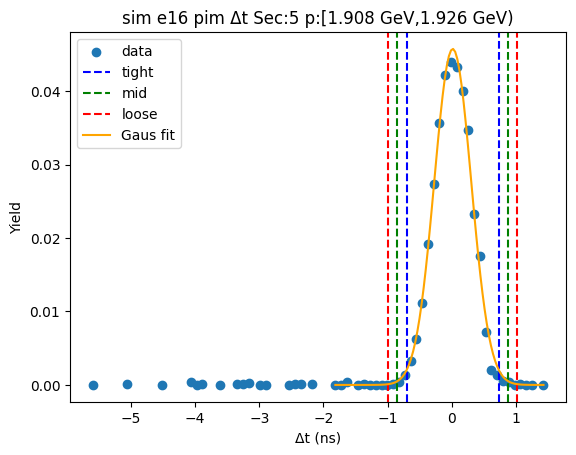

-0.7465840056369041 0.7807804415096863
-0.899320450351563 0.9335168862243453
-1.052056895066222 1.0862533309390043


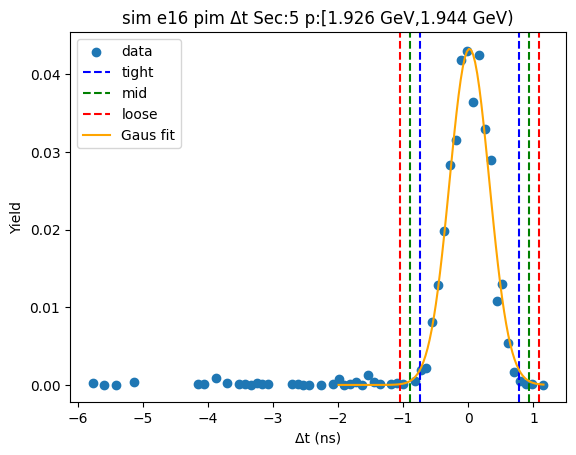

-0.7138035514488198 0.7683894503744003
-0.8620228516311419 0.9166087505567224
-1.0102421518134639 1.0648280507390444


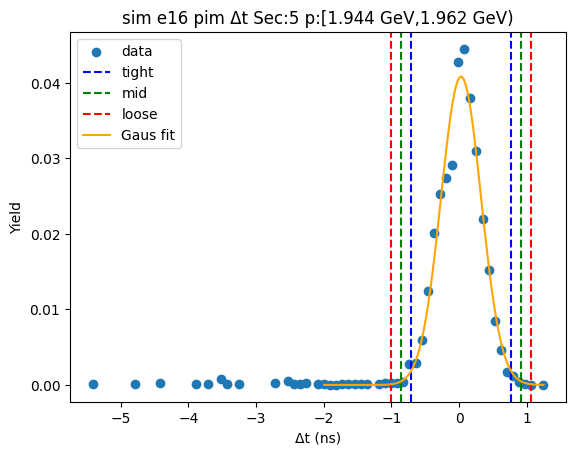

-0.689591666791562 0.7292967461389037
-0.8314805080846086 0.8711855874319503
-0.9733693493776552 1.0130744287249969


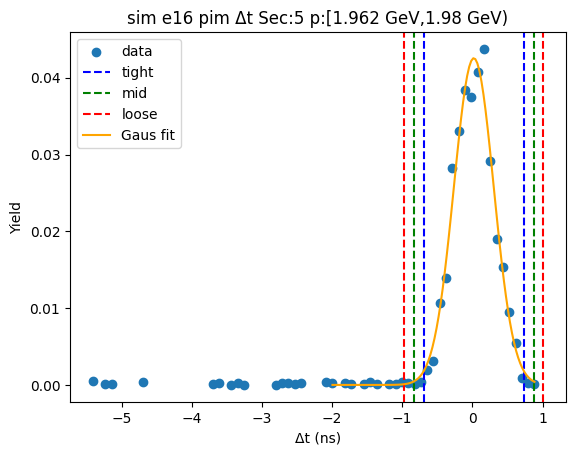

-0.6344512405951117 0.6391927223187377
-0.7618156368864966 0.7665571186101225
-0.8891800331778815 0.8939215149015075


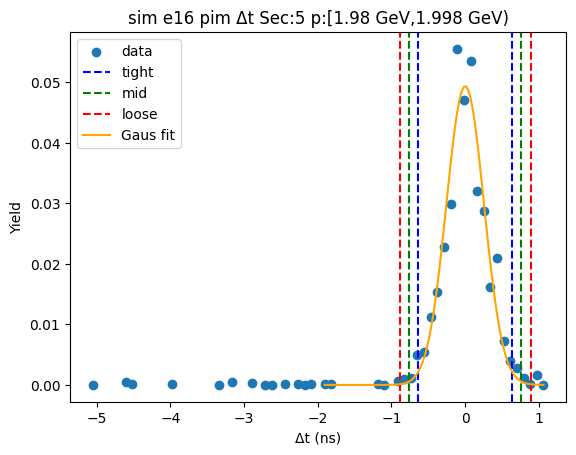

-0.7828273106539867 0.7839011556930628
-0.9395001572886917 0.9405740023277679
-1.0961730039233968 1.0972468489624727


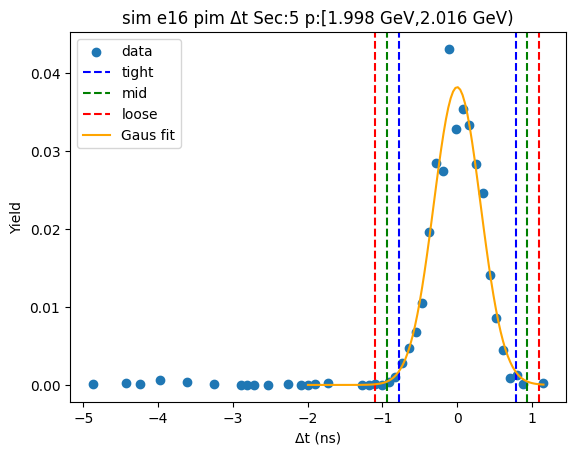

-0.7137650950666597 0.7105118119576993
-0.8561927857690957 0.8529395026601353
-0.9986204764715316 0.9953671933625712


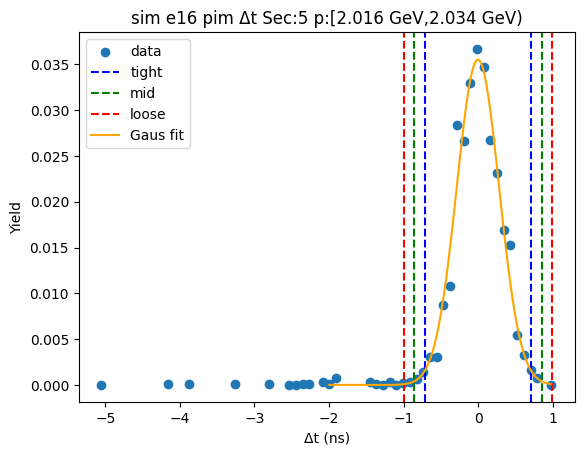

-0.6889136402701861 0.6875322458256246
-0.8265582288797672 0.8251768344352056
-0.9642028174893482 0.9628214230447867


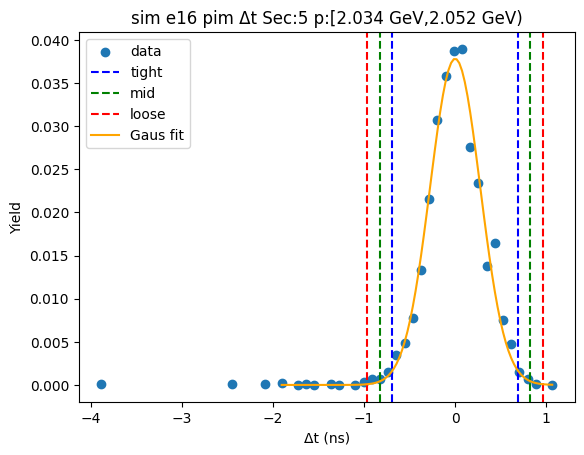

-0.627286589254608 0.6407698612664876
-0.7540922343067176 0.7675755063185972
-0.8808978793588271 0.8943811513707067


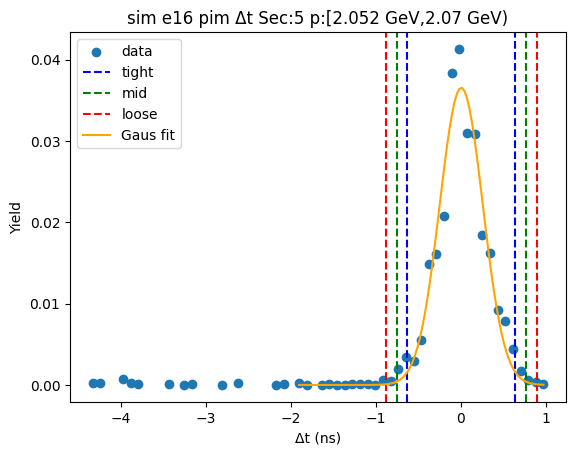

-0.7146869344093749 0.7307445003491575
-0.8592300778852281 0.8752876438250107
-1.0037732213610813 1.0198307873008639


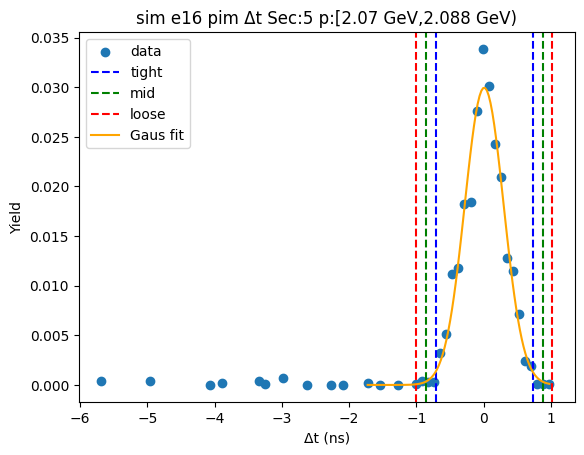

-0.6245966105185519 0.6919755894266397
-0.7562538305130709 0.8236328094211588
-0.8879110505075901 0.955290029415678


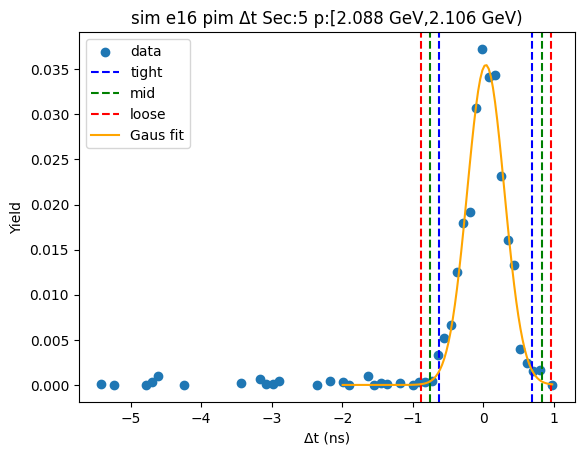

-0.6819881920689579 0.6765990175034255
-0.8178469130261962 0.8124577384606638
-0.9537056339834344 0.9483164594179021


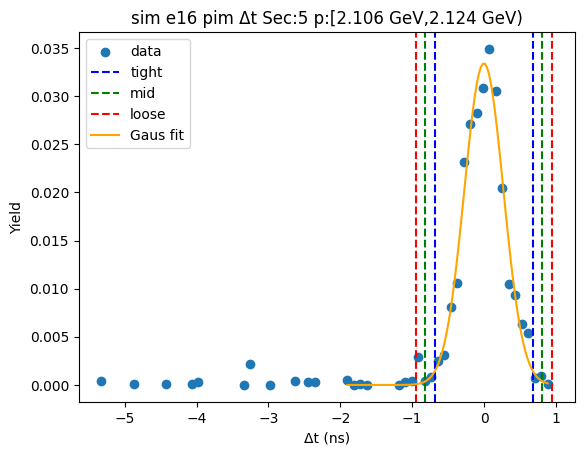

-0.6426302538104361 0.6865006297243915
-0.7755433421639188 0.8194137180778742
-0.9084564305174015 0.9523268064313569


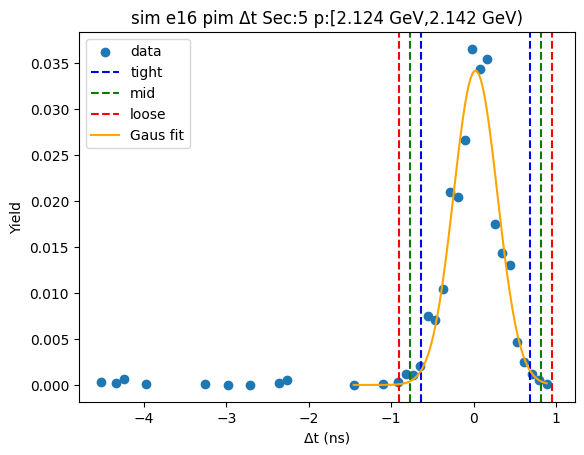

-0.698552217946132 0.7144846479274142
-0.8398559045334867 0.8557883345147689
-0.9811595911208413 0.9970920211021235


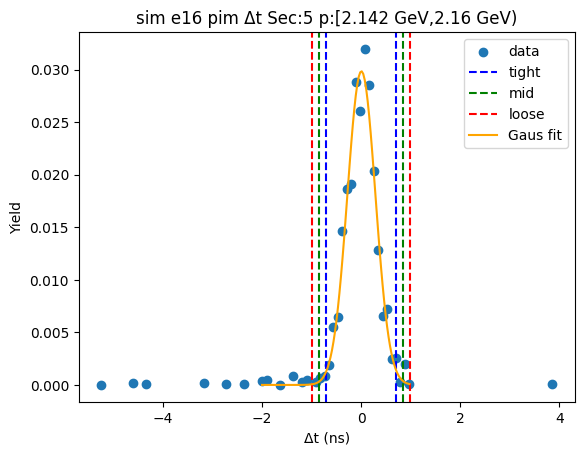

-0.7642404173601645 0.7668224217184871
-0.9173467012680295 0.9199287056263522
-1.0704529851758946 1.0730349895342175


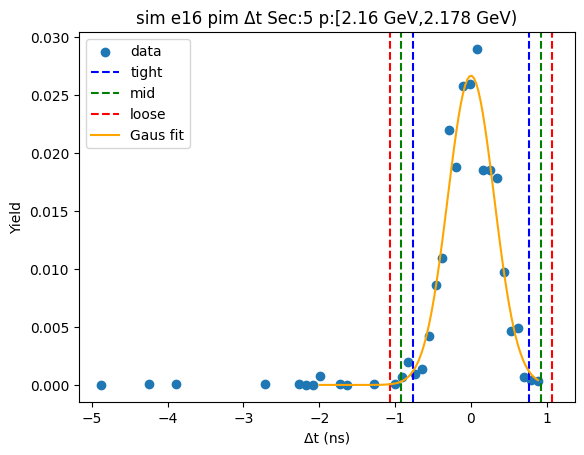

-0.7184895785807469 0.7302084586614027
-0.8633593823049618 0.8750782623856176
-1.008229186029177 1.0199480661098326


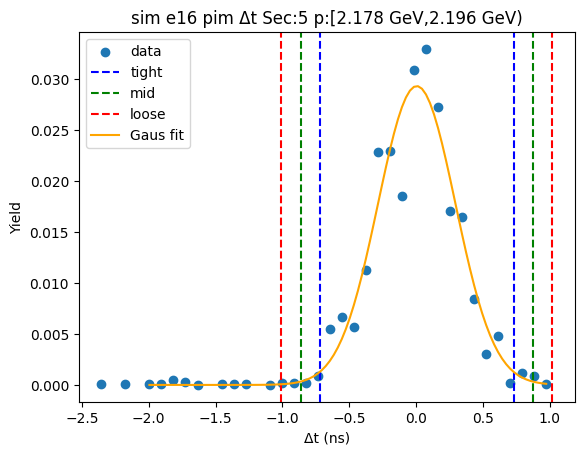

-0.7002477812974087 0.6890214160718736
-0.8391747010343369 0.8279483358088018
-0.9781016207712651 0.96687525554573


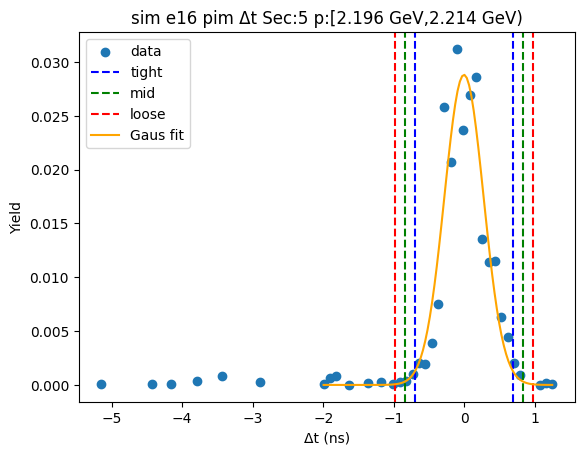

-0.6699266943620867 0.7418554087925884
-0.8111049046775543 0.8830336191080559
-0.9522831149930218 1.0242118294235234


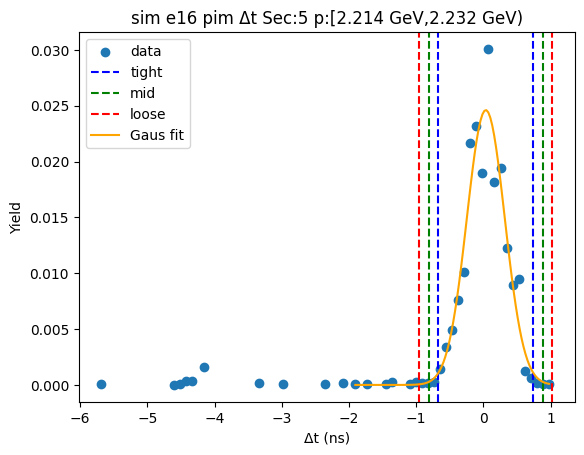

-0.6609488925110018 0.6965951286366593
-0.7967032946257679 0.8323495307514255
-0.932457696740534 0.9681039328661916


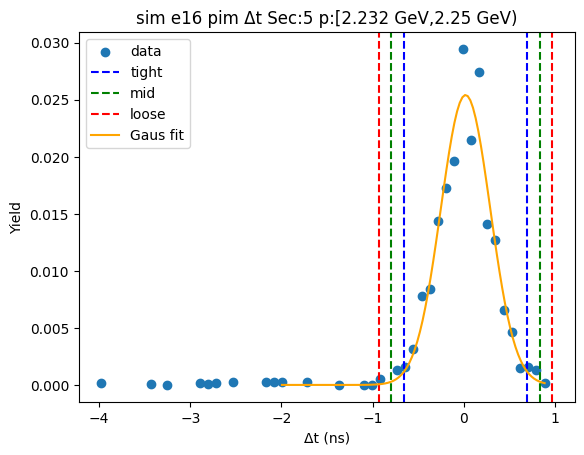

-0.6024908754568096 0.5902908982027891
-0.7217690528227695 0.709569075568749
-0.8410472301887293 0.8288472529347088


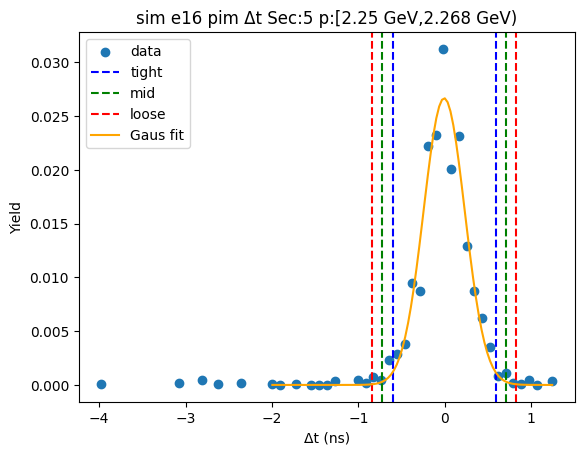

-0.669610994733409 0.7436889198302632
-0.8109409861897762 0.8850189112866303
-0.9522709776461433 1.0263489027429975


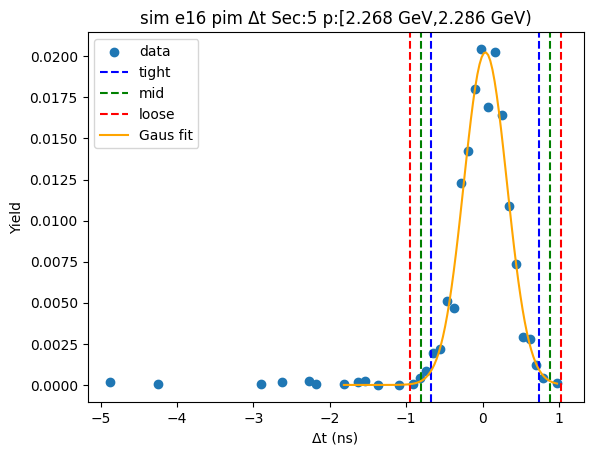

-0.6883134390564513 0.7614454588152292
-0.8332893288436194 0.9064213486023973
-0.9782652186307874 1.0513972383895653


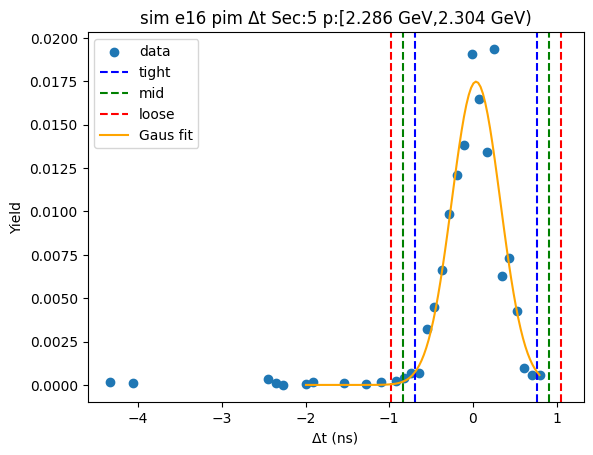

-0.6811946624221692 0.7178582911511475
-0.821099957779501 0.8577635865084793
-0.9610052531368326 0.9976688818658109


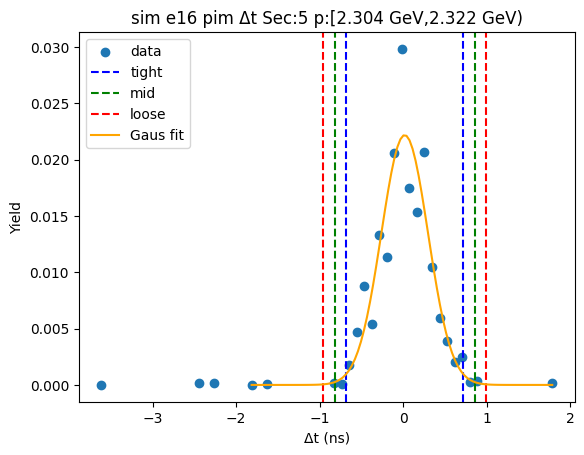

-0.7388122668882258 0.8202549899504599
-0.8947189925720944 0.9761617156343285
-1.0506257182559628 1.132068441318197


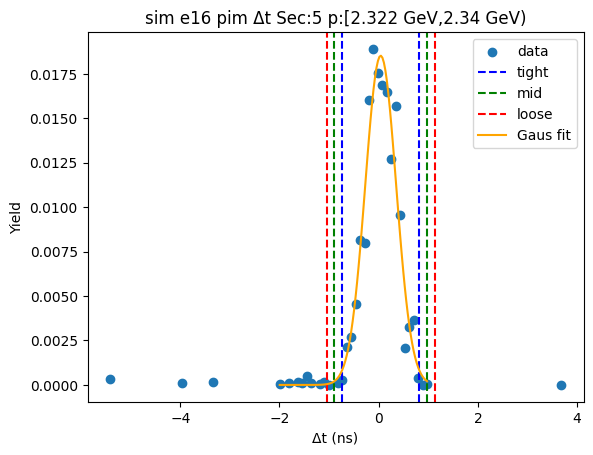

-0.7737493850351641 0.7595207966717165
-0.9270764032058522 0.9128478148424045
-1.08040342137654 1.0661748330130927


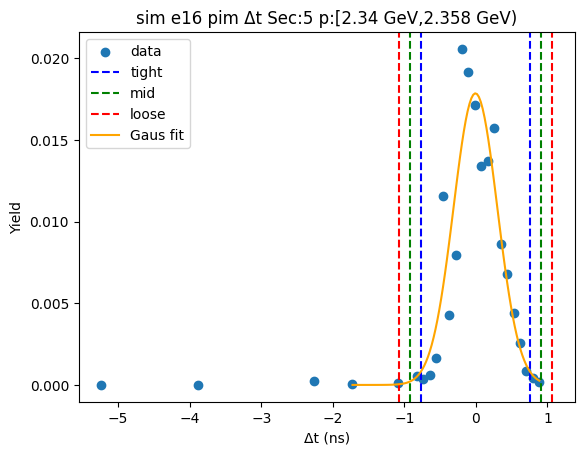

-0.705574882771308 0.70393598772894
-0.8465259698213328 0.8448870747789647
-0.9874770568713576 0.9858381618289895


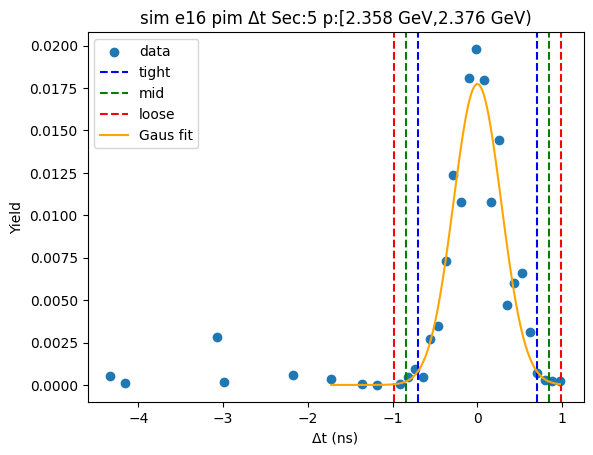

-0.6810351942019581 0.6324037985438453
-0.8123790934765385 0.7637476978184257
-0.9437229927511188 0.895091597093006


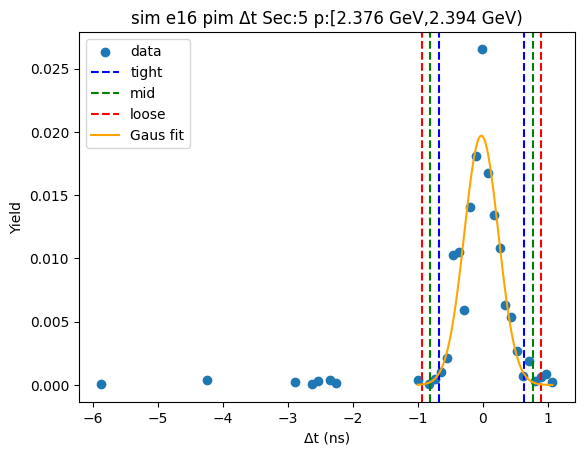

-0.6335102462852065 0.7057680333440237
-0.7674380742481295 0.8396958613069467
-0.9013659022110525 0.9736236892698698


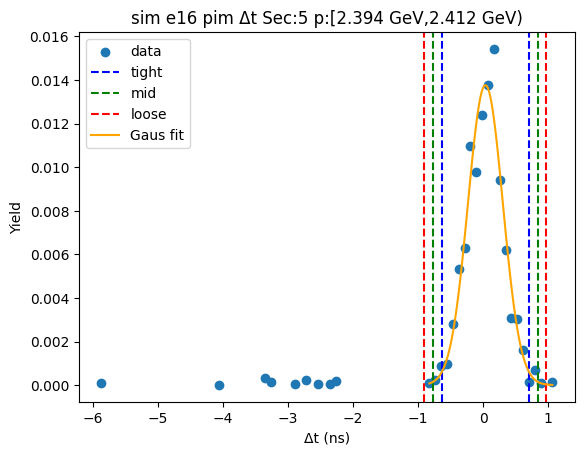

-0.6356536563003445 0.6336292577841052
-0.7625819477087895 0.7605575491925501
-0.8895102391172345 0.8874858406009951


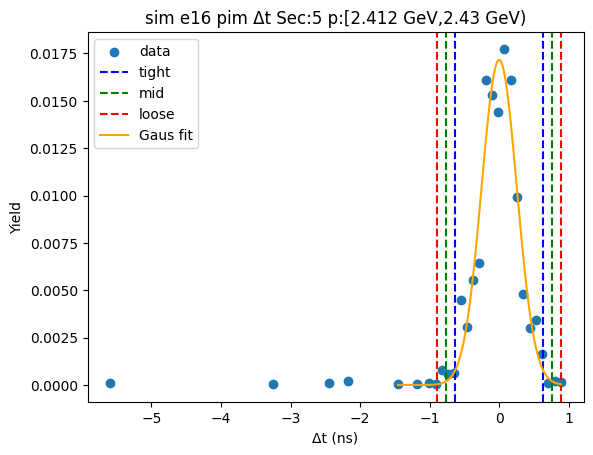

-0.7939402227913429 0.7615577956845375
-0.949490024638931 0.9171075975321256
-1.105039826486519 1.0726573993797135


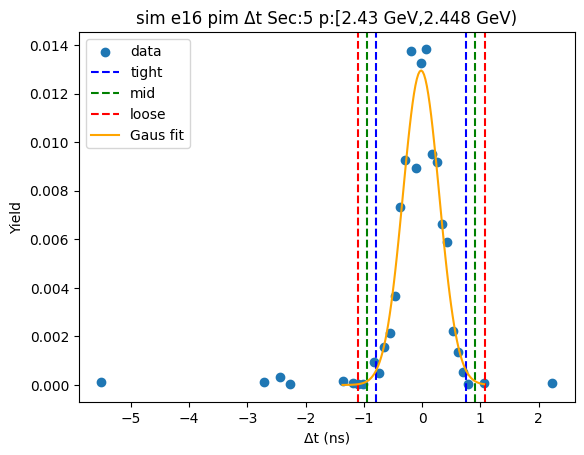

-0.6732368496496095 0.6593072079763727
-0.8064912554122078 0.7925616137389709
-0.9397456611748061 0.9258160195015692


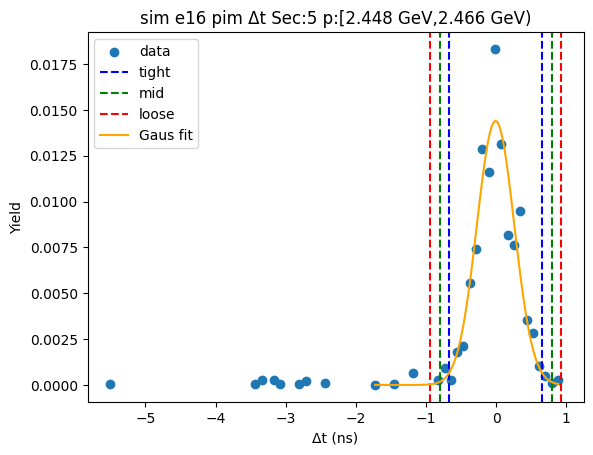

-0.570674338433321 0.6292911940028476
-0.6906708916769378 0.7492877472464644
-0.8106674449205546 0.8692843004900812


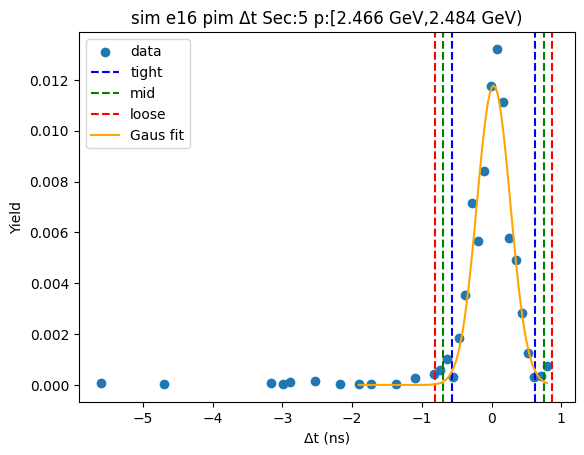

-0.7108948796654571 0.6683101714303743
-0.8488153847750403 0.8062306765399575
-0.9867358898846235 0.9441511816495407


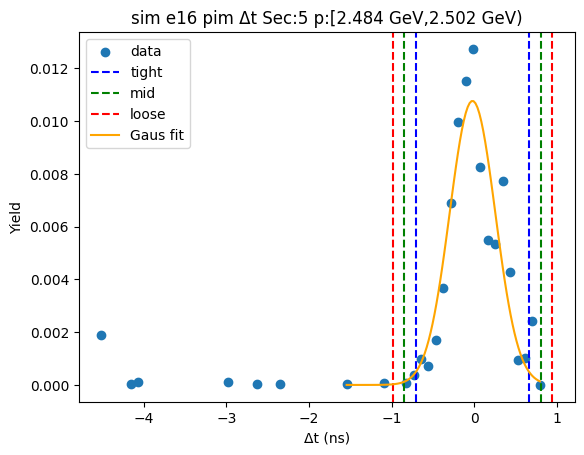

-0.6508103933301187 0.6555091698998642
-0.781442349653117 0.7861411262228625
-0.9120743059761153 0.9167730825458608


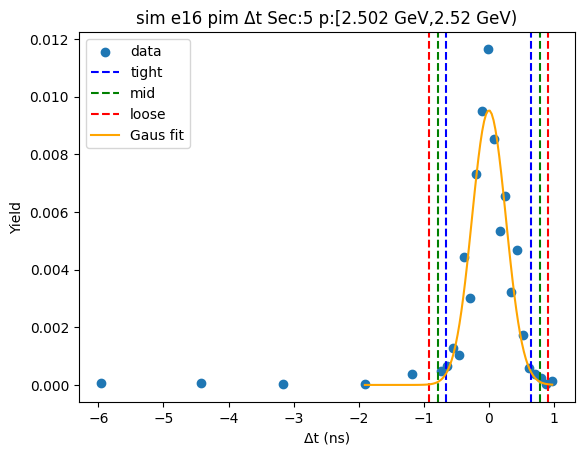

-0.6471931581930418 0.6397832278747823
-0.7758907967998242 0.7684808664815647
-0.9045884354066066 0.8971785050883471


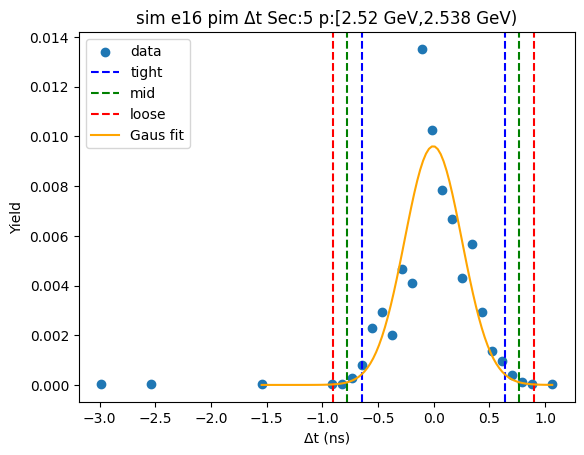

-0.7589472873635988 0.7941776276954812
-0.9142597788695069 0.9494901192013893
-1.069572270375415 1.104802610707297


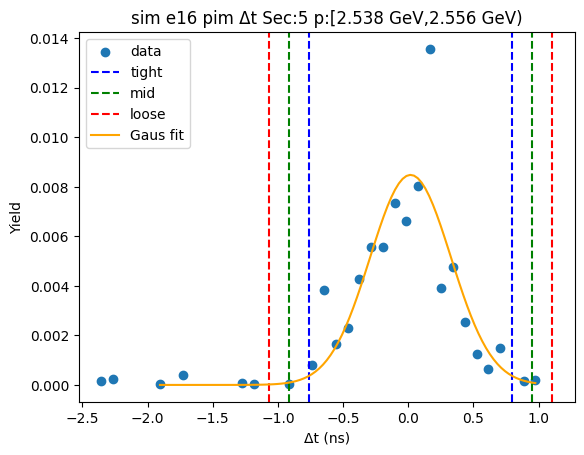

-0.6471760207108312 0.726616544290658
-0.7845552772109802 0.863995800790807
-0.9219345337111291 1.0013750572909559


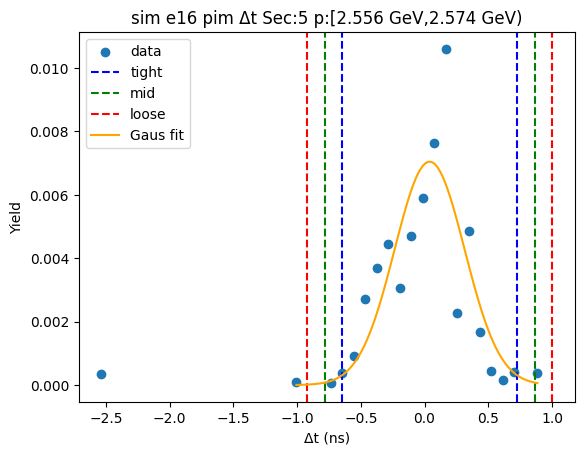

-0.7617240349216641 0.7386784052520663
-0.9117642789390371 0.8887186492694393
-1.06180452295641 1.0387588932868124


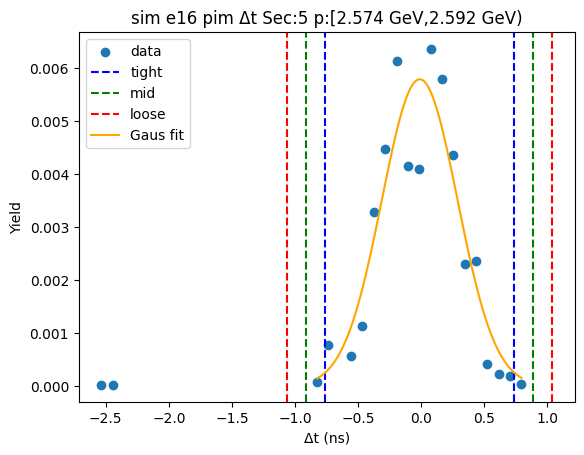

-0.6511540375552146 0.6689881154445044
-0.7831682528551864 0.8010023307444762
-0.9151824681551584 0.9330165460444482


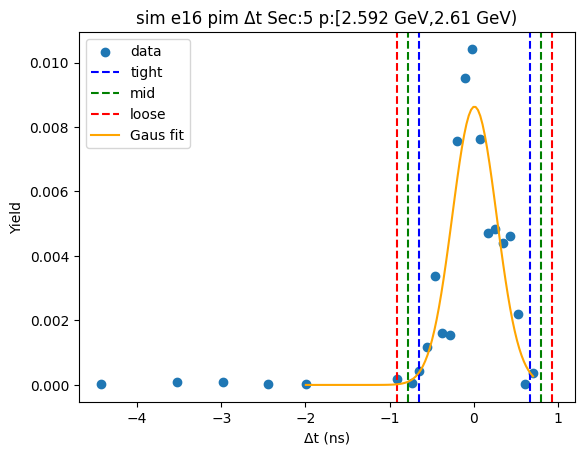

-0.7353455748355732 0.6517064822637154
-0.8740507805455021 0.7904116879736444
-1.012755986255431 0.9291168936835732


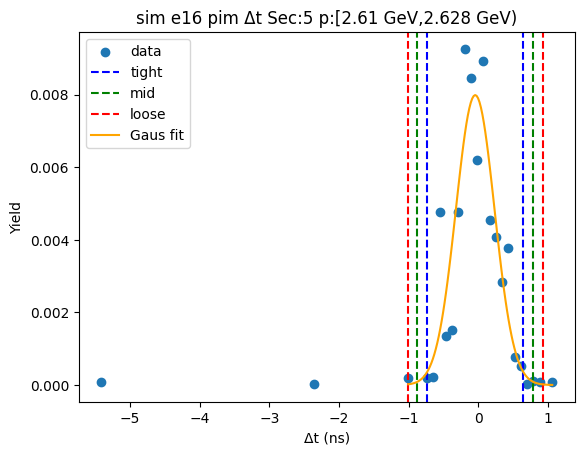

-0.6283383874852772 0.633510289558472
-0.7545232551896521 0.759695157262847
-0.8807081228940271 0.885880024967222


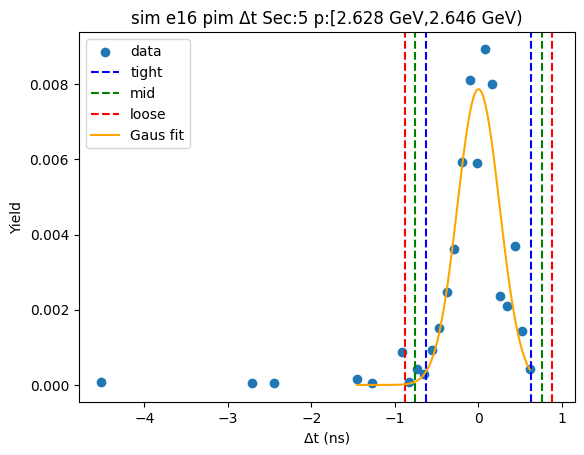

-0.8080115874339667 0.8065487996815613
-0.9694676261455196 0.9680048383931142
-1.1309236648570722 1.129460877104667


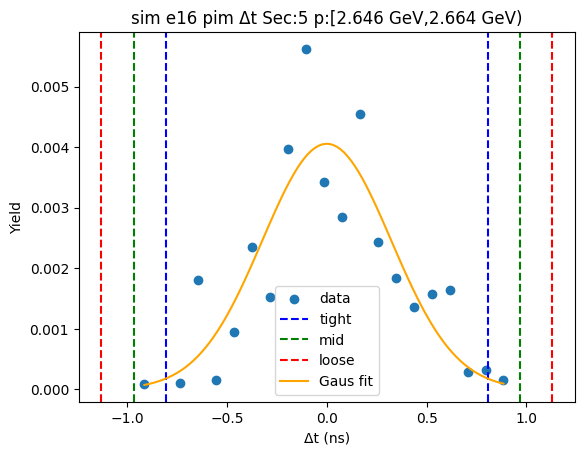

-0.7650464324201297 0.8439202237518119
-0.9259430980373238 1.004816889369006
-1.086839763654518 1.1657135549862


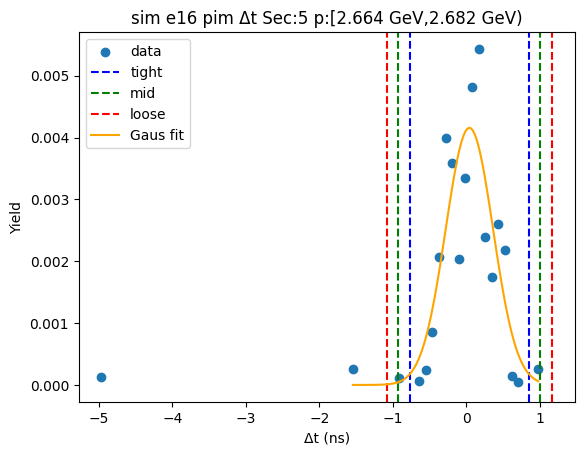

-0.8335633528691582 0.8044171935692854
-0.9973614075130026 0.9682152482131299
-1.1611594621568468 1.132013302856974


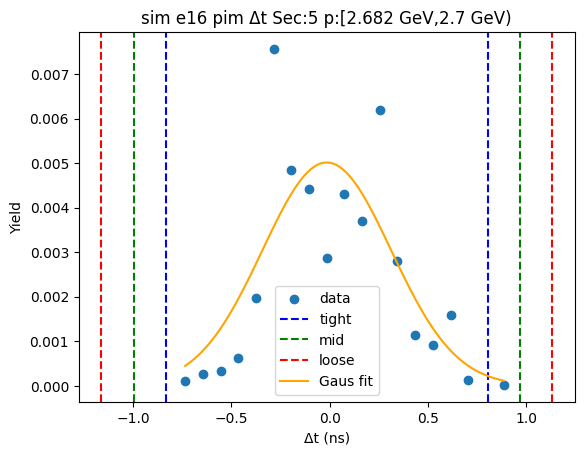

-0.7099340024921162 0.6420142615958245
-0.8451288289009102 0.7772090880046185
-0.9803236553097043 0.9124039144134126


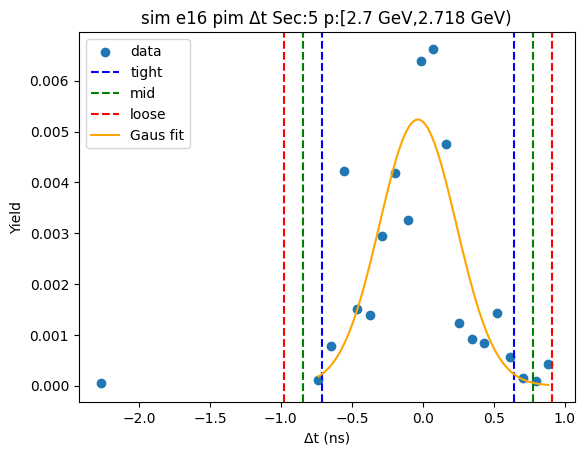

-0.7153634837123944 0.5587204544027268
-0.8427718775239065 0.6861288482142388
-0.9701802713354186 0.813537242025751


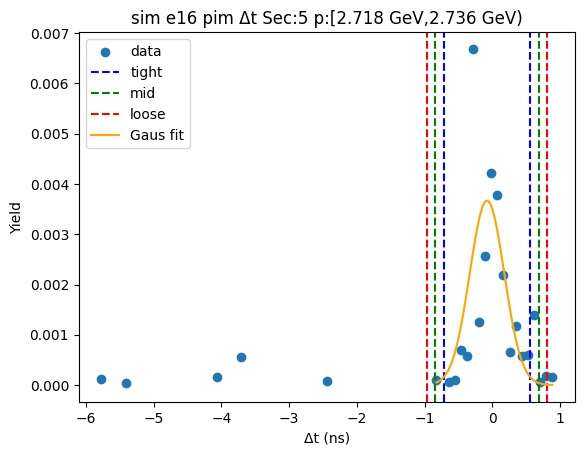

-0.8415841190112826 0.8610789799085293
-1.0118504289032637 1.0313452898005104
-1.182116738795245 1.2016115996924916


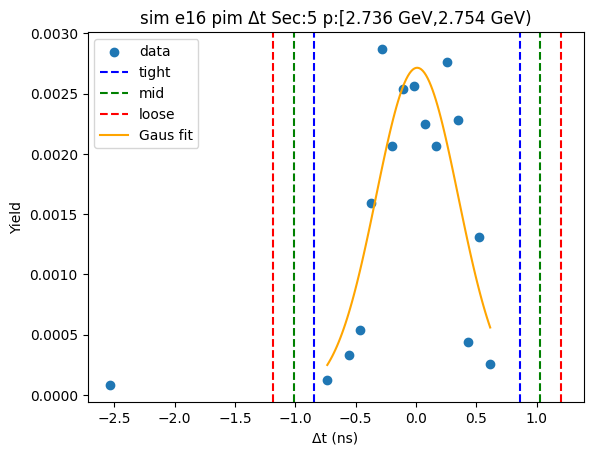

-0.7749470933972165 0.6805194567956878
-0.9204937484165069 0.8260661118149782
-1.0660404034357973 0.9716127668342688


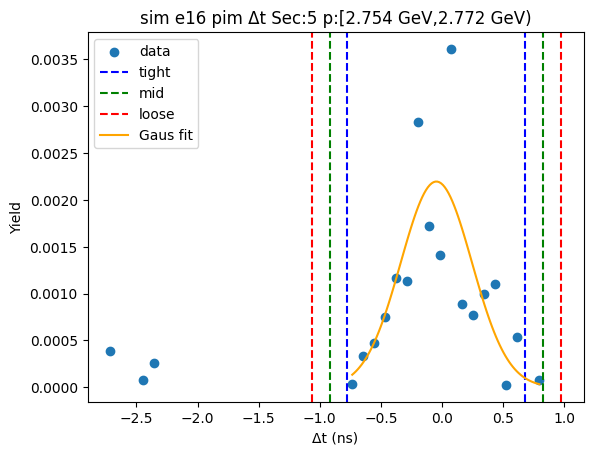

-0.2328387982452518 0.03946061525821662
-0.2600687395955986 0.06669055660856346
-0.28729868094594546 0.0939204979589103


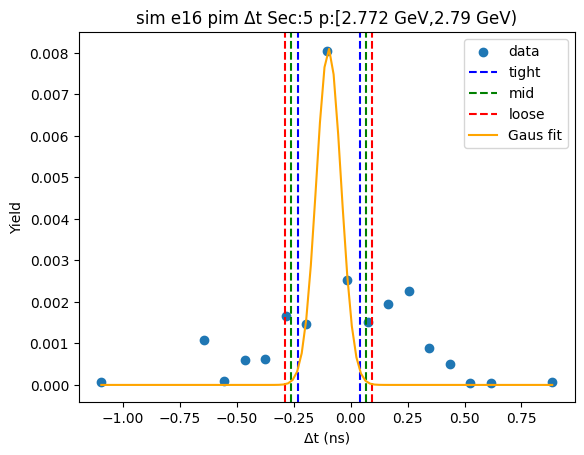

-0.7707839553071749 0.7762297572464074
-0.9254853265625332 0.9309311285017657
-1.0801866978178916 1.0856324997571238


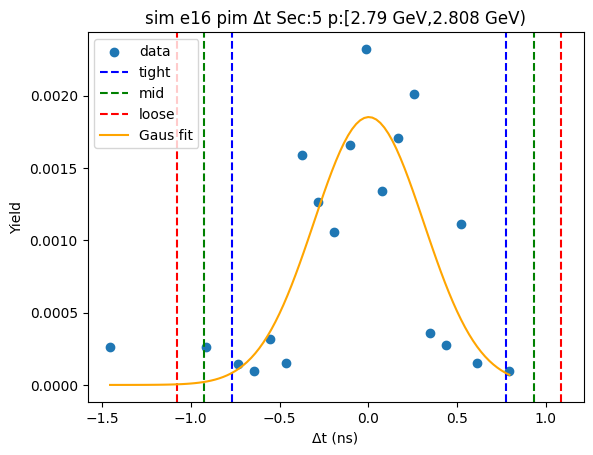

-0.785408575897379 0.7882125756752201
-0.9427706910546388 0.9455746908324799
-1.1001328062118987 1.1029368059897398


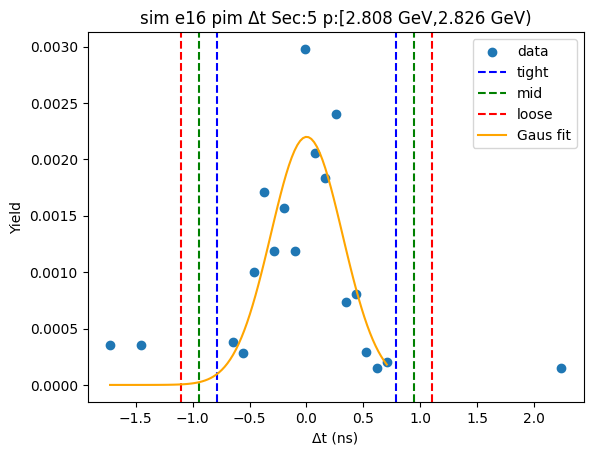

-0.6766079199305505 0.5951733492287906
-0.8037860468464846 0.7223514761447247
-0.9309641737624187 0.8495296030606588


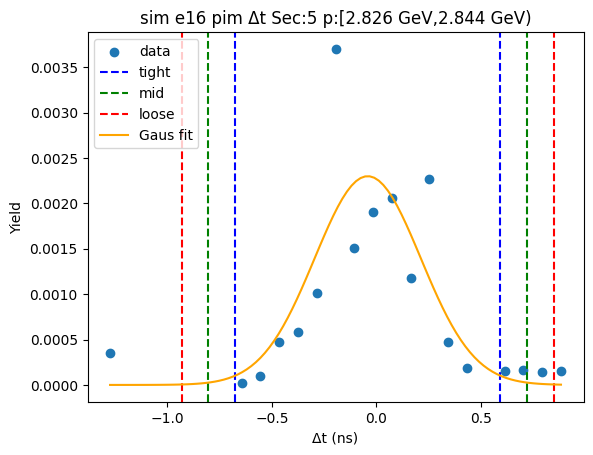

-0.5400237422239381 0.5548024592344879
-0.6495063623697808 0.6642850793803305
-0.7589889825156233 0.7737676995261731


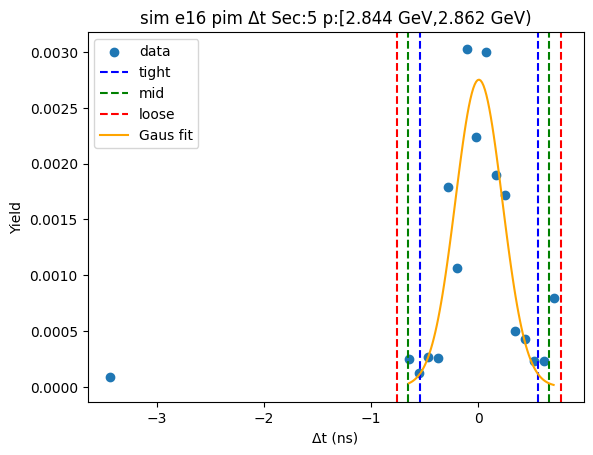

-0.7118613710475341 0.6414551094611545
-0.847193019098403 0.7767867575120234
-0.9825246671492719 0.9121184055628923


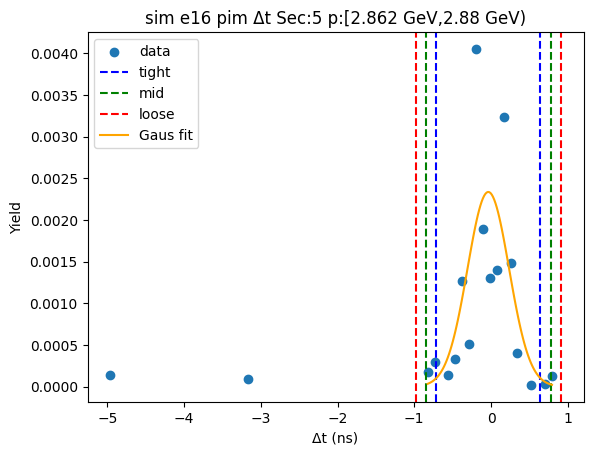

-0.7865977912314681 0.3968066432650599
-0.904938234681121 0.5151470867147128
-1.0232786781307737 0.6334875301643655


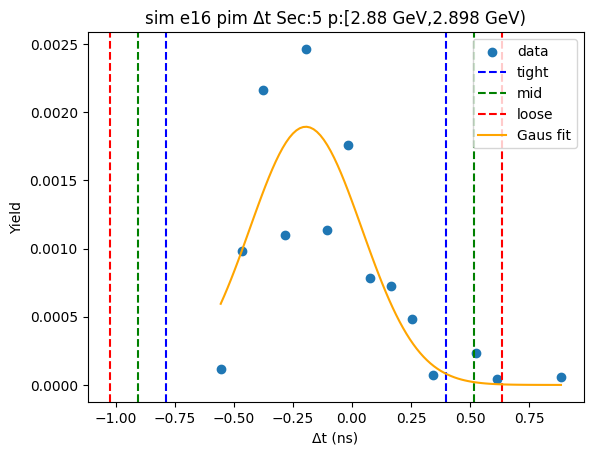

-0.3309918339044357 0.5807974636802347
-0.42217076366290274 0.6719763934387016
-0.5133496934213697 0.7631553231971686


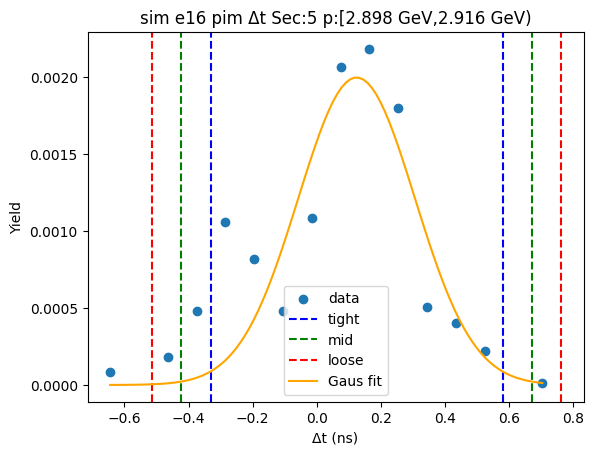

-0.5557209235201506 0.6018894396470522
-0.6714819598368709 0.7176504759637725
-0.7872429961535912 0.8334115122804928


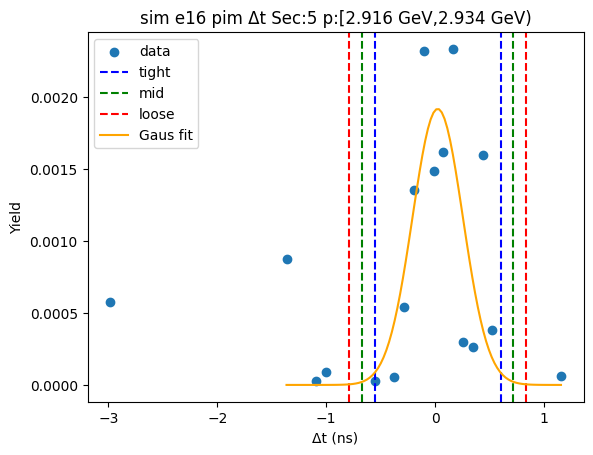

-1.2743554578167366 1.2651978206412278
-1.528310785662533 1.5191531484870242
-1.7822661135083295 1.7731084763328206


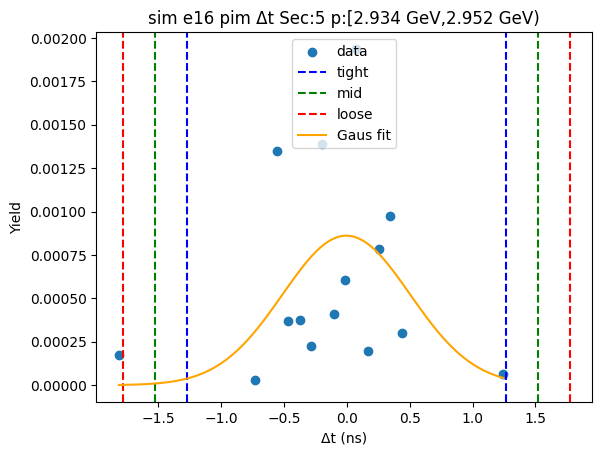

-0.493529820340786 0.39584789263579606
-0.5824675916384442 0.4847856639334542
-0.6714053629361024 0.5737234352311124


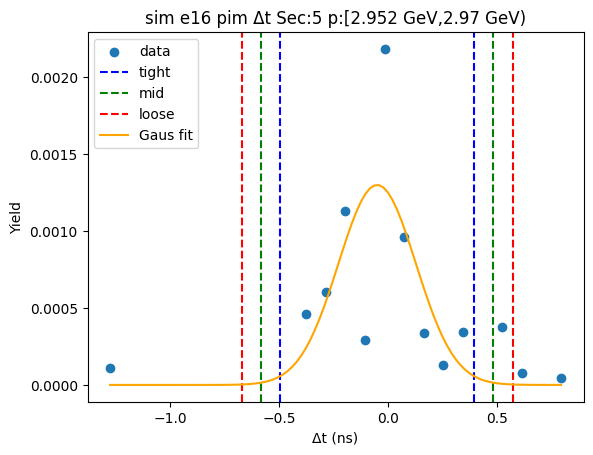

-0.980965348923124 0.9289623782897392
-1.1719581216444104 1.1199551510110253
-1.3629508943656967 1.3109479237323116


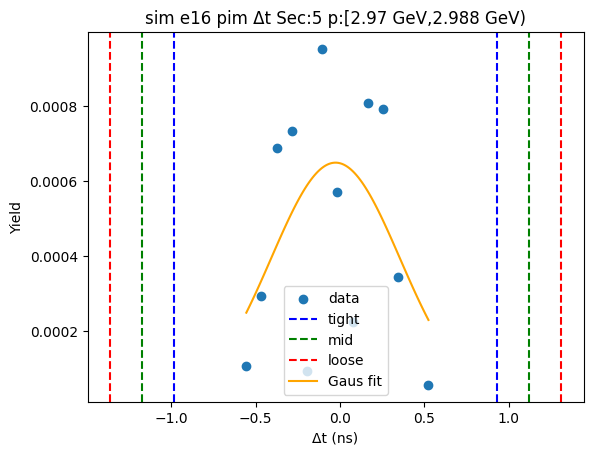

-0.6202214823663523 1.1972404046563796
-0.8019676710686254 1.3789865933586527
-0.9837138597708988 1.560732782060926


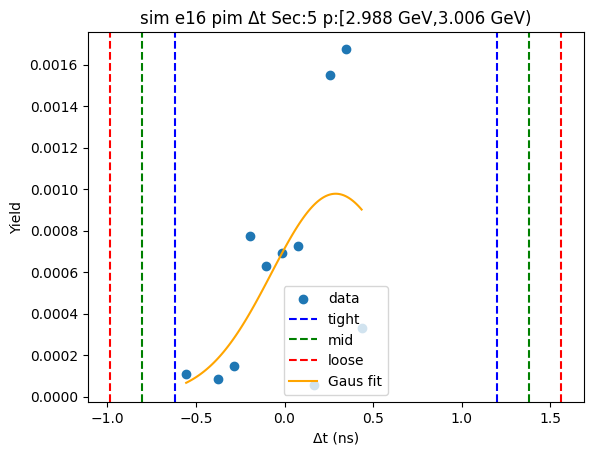

-0.9404075012354349 0.9232457161353336
-1.1267728229725118 1.1096110378724102
-1.3131381447095887 1.295976359609487


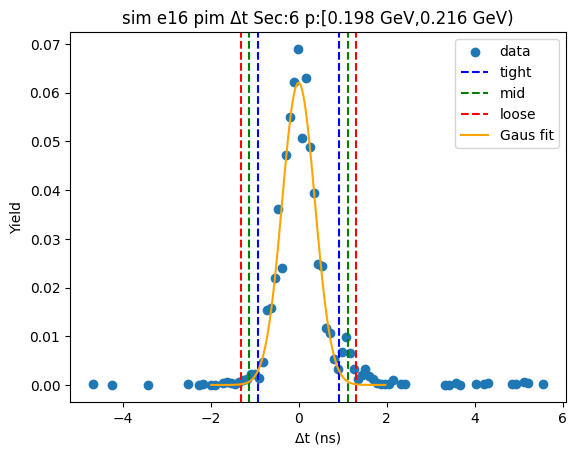

-0.982498991320445 1.015585790589028
-1.1823074695113927 1.2153942687799755
-1.38211594770234 1.4152027469709227


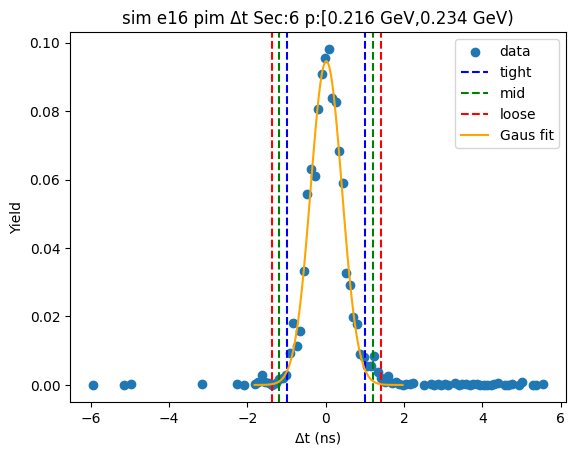

-0.9084455814077894 0.9120449641321344
-1.090494635961782 1.094094018686127
-1.2725436905157743 1.2761430732401193


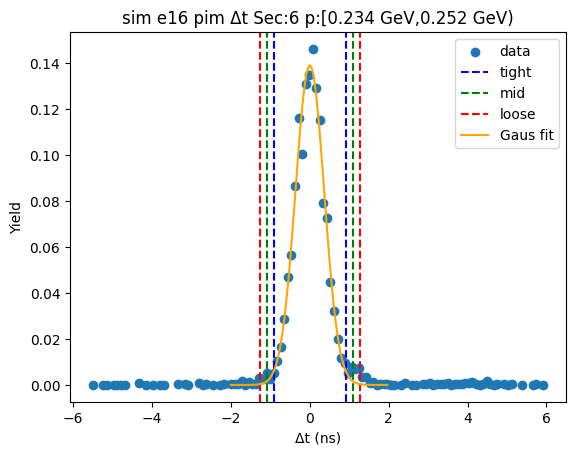

-0.8658073457973017 0.8805435481196895
-1.0404424351890007 1.0551786375113885
-1.2150775245807 1.2298137269030878


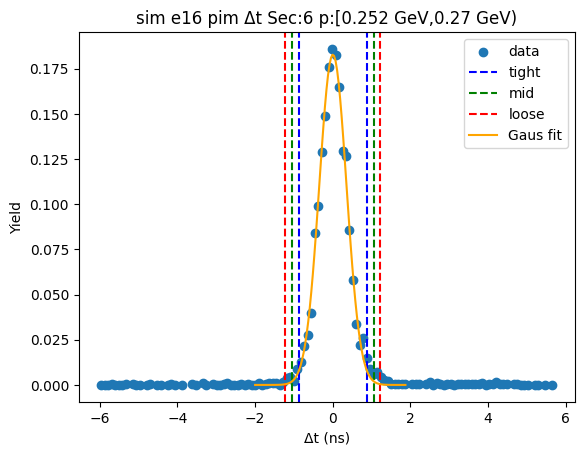

-0.8345450131387018 0.8494241193346115
-1.002941926386033 1.017821032581943
-1.1713388396333644 1.1862179458292743


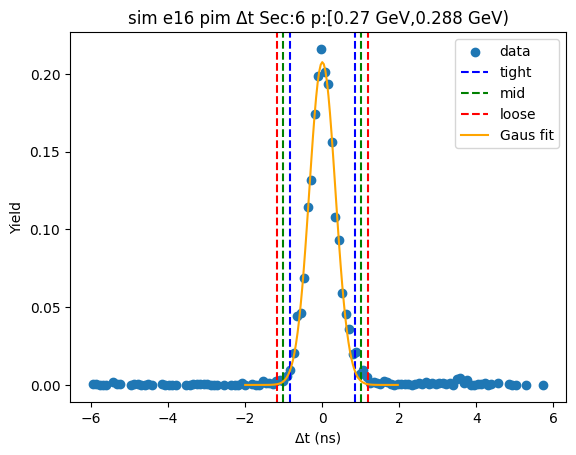

-0.7909988509530207 0.8095213284428217
-0.9510508688926049 0.9695733463824059
-1.111102886832189 1.12962536432199


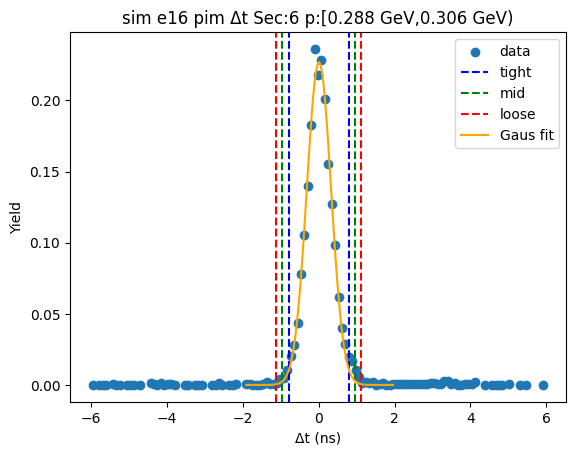

-0.8215395027758795 0.8442146939766829
-0.9881149224511357 1.010790113651939
-1.154690342126392 1.1773655333271953


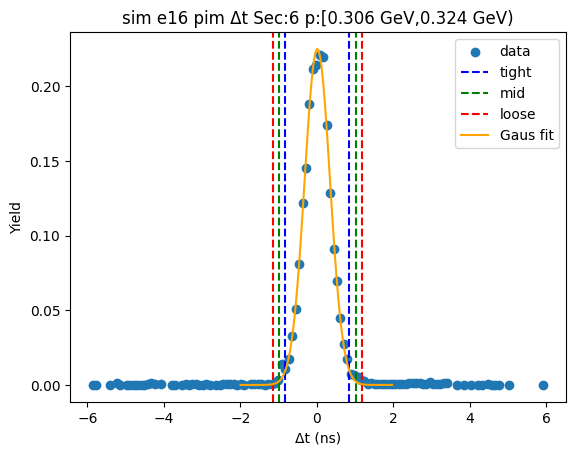

-0.8110172260990847 0.8102736943989999
-0.9731463181488932 0.9724027864488084
-1.1352754101987017 1.134531878498617


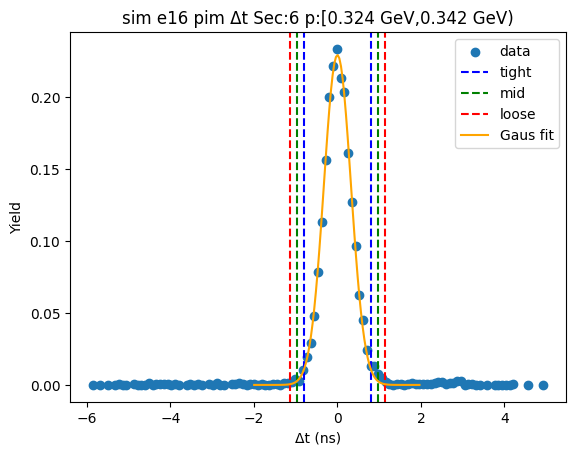

-0.8234893942987032 0.8184336154537644
-0.98768169527395 0.9826259164290112
-1.1518739962491966 1.1468182174042578


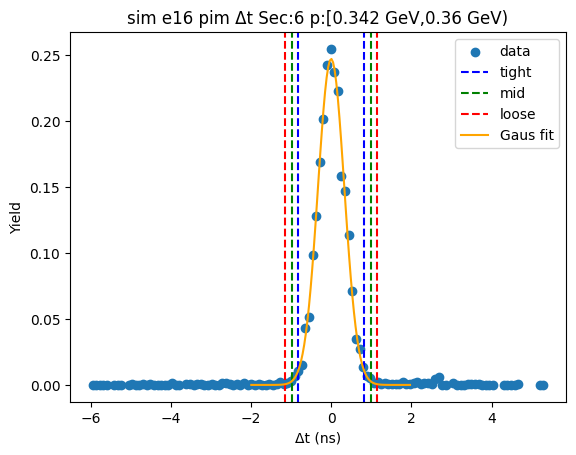

-0.7482520926598767 0.7683492229773116
-0.8999122242235955 0.9200093545410304
-1.0515723557873145 1.0716694861047493


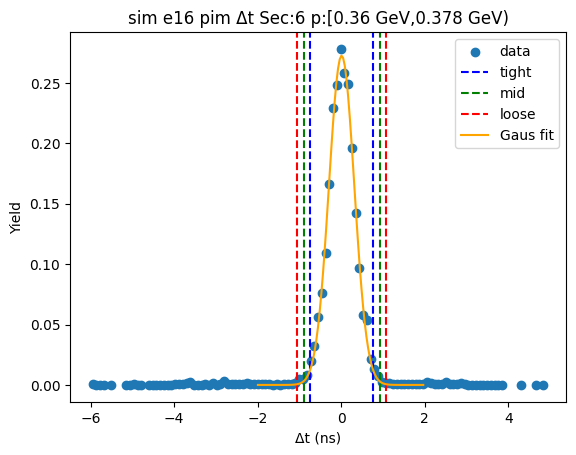

-0.7648409528870427 0.7874938709777987
-0.9200744352735267 0.9427273533642827
-1.0753079176600109 1.097960835750767


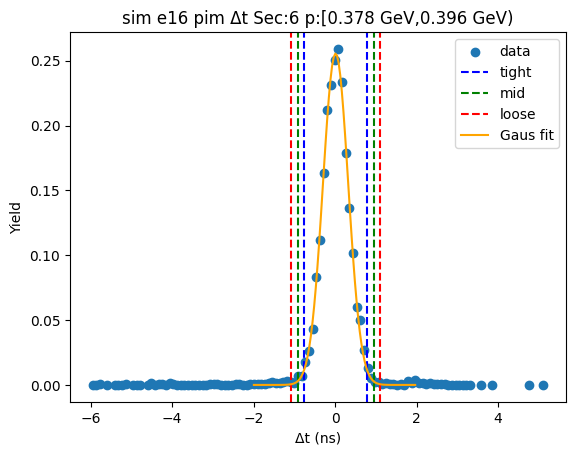

-0.7806440074421083 0.8088230345714141
-0.9395907116434604 0.9677697387727663
-1.0985374158448127 1.1267164429741188


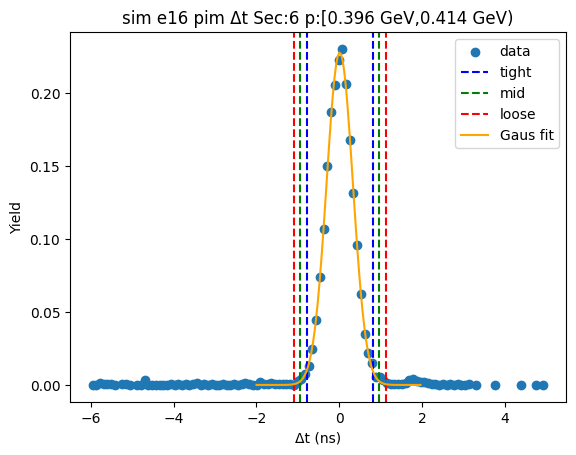

-0.7935044744802646 0.7991950388355815
-0.9527744258118492 0.9584649901671661
-1.1120443771434338 1.1177349414987505


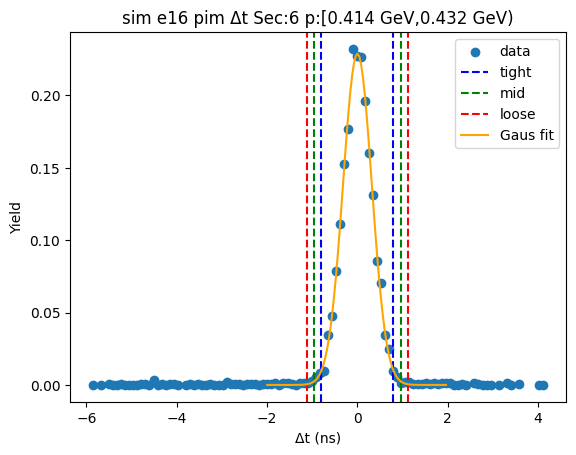

-0.7777109355182377 0.7968630734645876
-0.9351683364165202 0.9543204743628702
-1.0926257373148027 1.1117778752611527


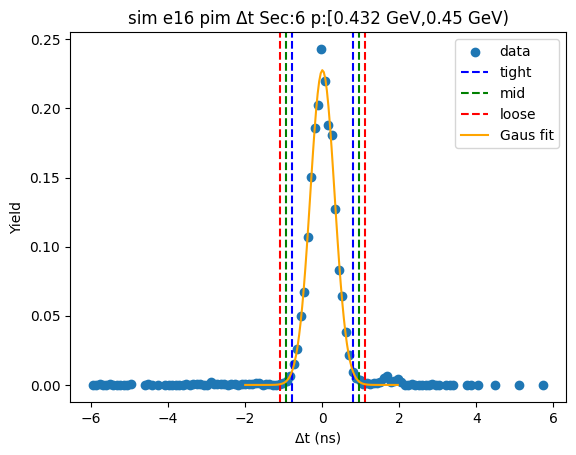

-0.776618799305361 0.8047412731184733
-0.9347548065477446 0.9628772803608568
-1.092890813790128 1.1210132876032401


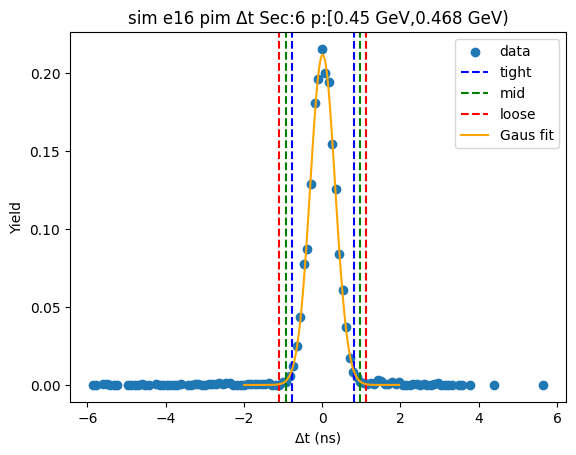

-0.7874567308646949 0.8114983773771021
-0.9473522416888746 0.9713938882012817
-1.1072477525130542 1.1312893990254613


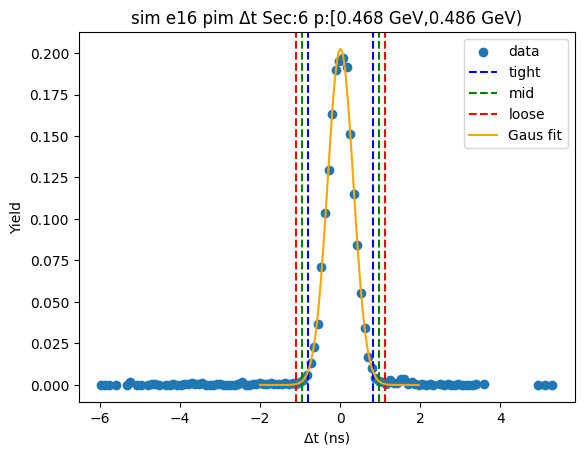

-0.7284142601963899 0.7575304313171853
-0.8770087293477473 0.9061249004685428
-1.025603198499105 1.0547193696199004


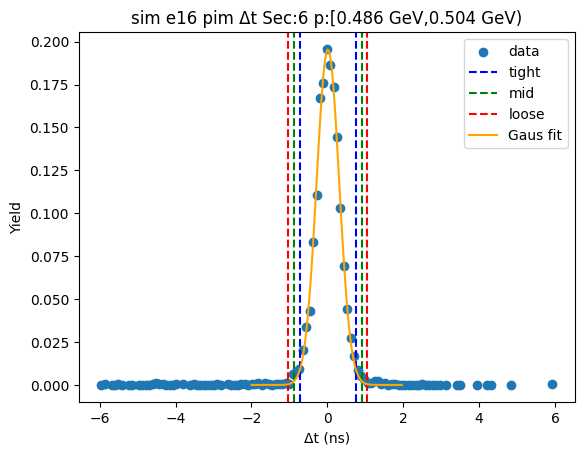

-0.7606372635671096 0.7729328395205054
-0.9139942738758712 0.926289849829267
-1.0673512841846324 1.0796468601380285


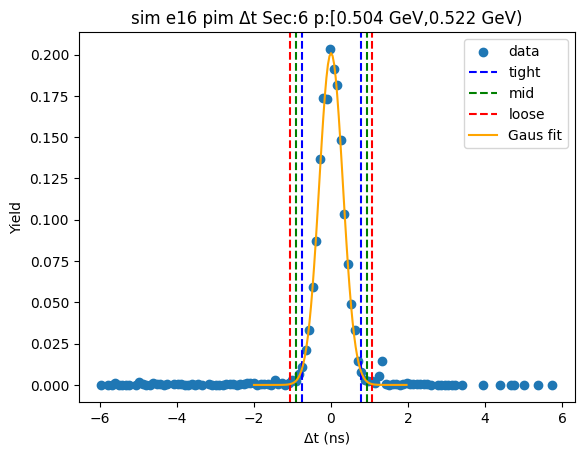

-0.7532918186687445 0.7976955849754348
-0.9083905590331623 0.9527943253398526
-1.0634892993975802 1.1078930657042707


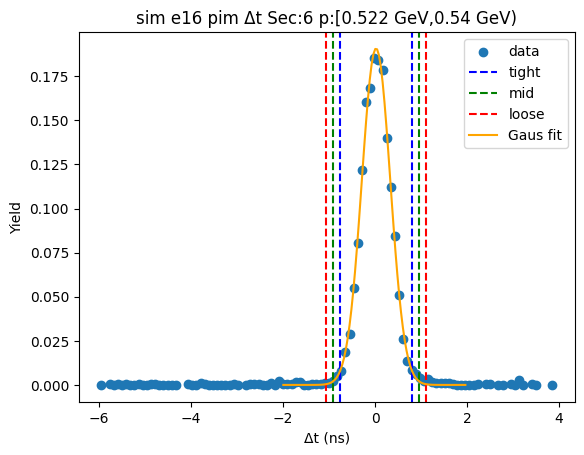

-0.736588573761485 0.7780214964291312
-0.8880495807805466 0.9294825034481928
-1.0395105877996083 1.0809435104672545


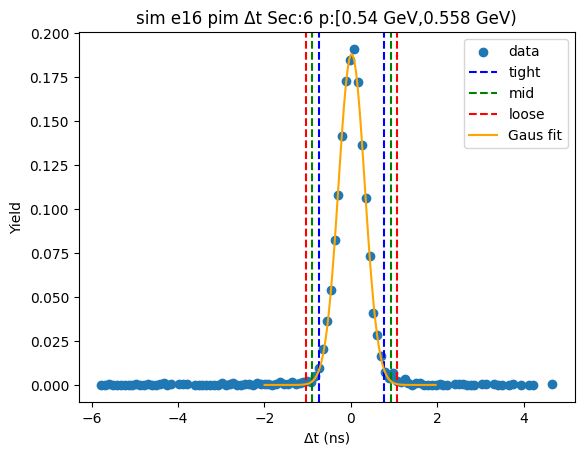

-0.7539161982093407 0.7678802336206485
-0.9060958413923397 0.9200598768036474
-1.0582754845753386 1.0722395199866463


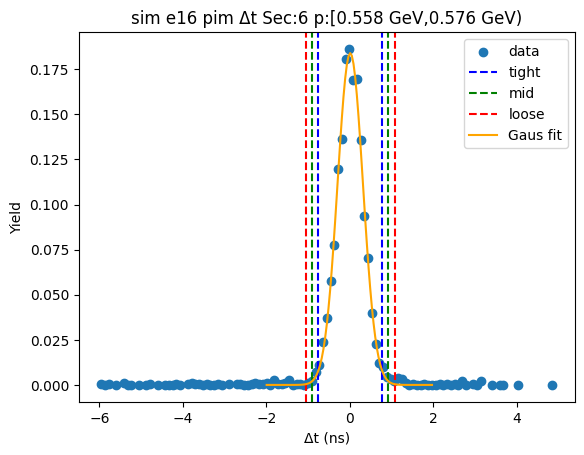

-0.7866730372193277 0.795726976354927
-0.9449130385767532 0.9539669777123525
-1.1031530399341787 1.112206979069778


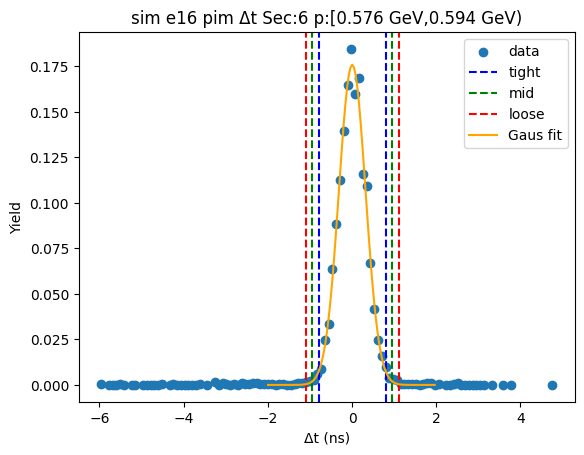

-0.7692357186371528 0.7772863695215864
-0.9238879274530266 0.9319385783374602
-1.0785401362689007 1.086590787153334


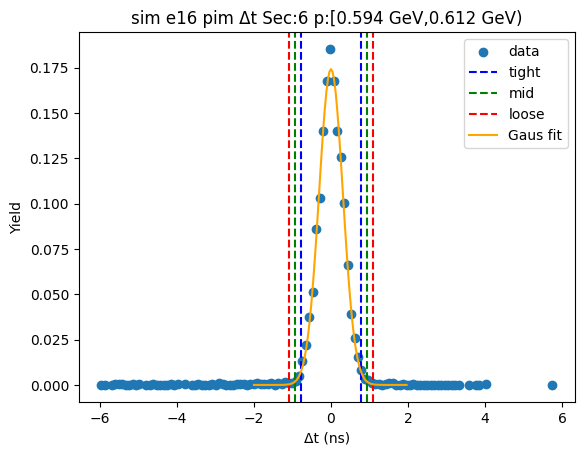

-0.7519167331610529 0.7665464038376683
-0.903763046860925 0.9183927175375404
-1.055609360560797 1.0702390312374124


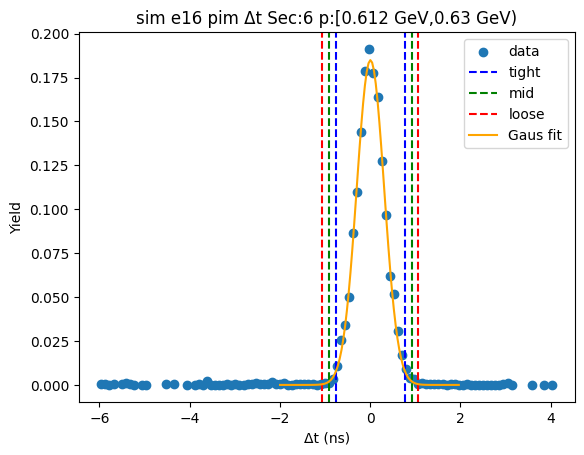

-0.781372586806408 0.8059379420532674
-0.9401036396923754 0.9646689949392349
-1.098834692578343 1.1234000478252024


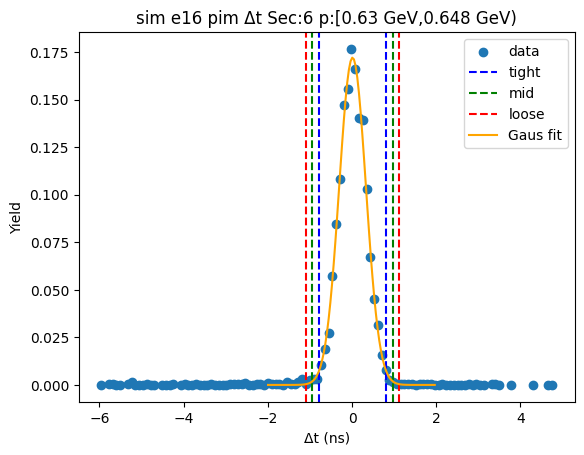

-0.7342491525223008 0.7635417055989023
-0.8840282383344212 0.9133207914110227
-1.0338073241465415 1.0630998772231428


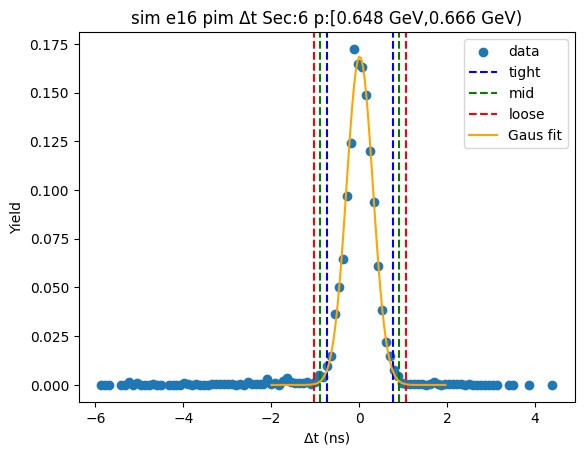

-0.7488772625892199 0.7774698148580836
-0.9015119703339504 0.9301045226028141
-1.0541466780786808 1.0827392303475445


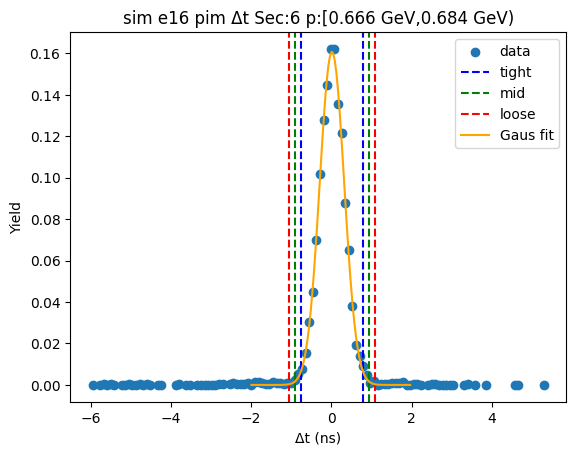

-0.7720180291598755 0.779558581533901
-0.9271756902292531 0.9347162426032786
-1.0823333512986306 1.0898739036726564


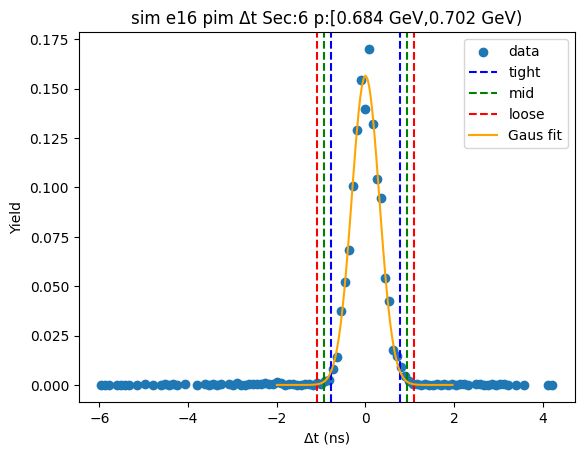

-0.7285688440610479 0.7581354343276098
-0.8772392718999138 0.9068058621664756
-1.0259096997387795 1.0554762900053414


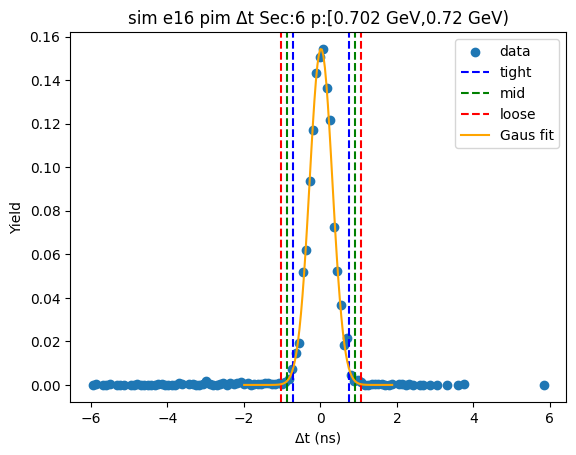

-0.7138247063364418 0.7427663296311235
-0.8594838099331984 0.8884254332278801
-1.005142913529955 1.0340845368246367


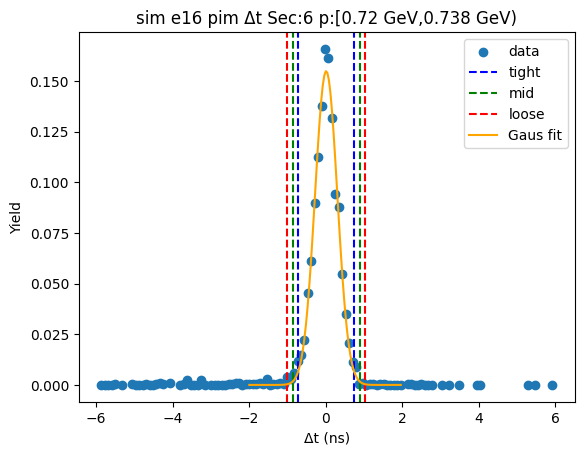

-0.7408364447953034 0.761804050160899
-0.8911004942909238 0.9120680996565194
-1.041364543786544 1.0623321491521396


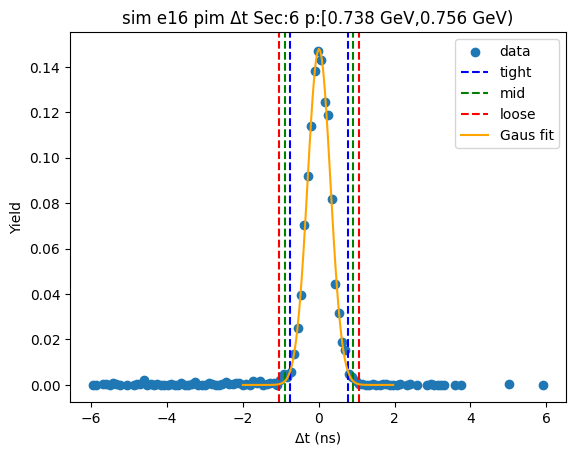

-0.7480412021891661 0.7689272144993505
-0.8997380438580178 0.9206240561682022
-1.0514348855268694 1.0723208978370538


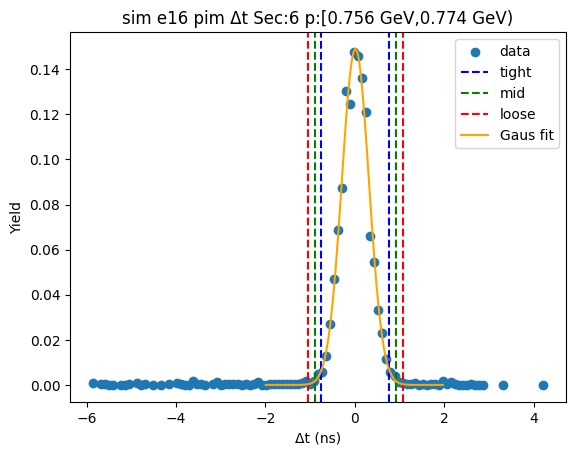

-0.763014863247975 0.7699843142357763
-0.91631478099635 0.9232842319841513
-1.0696146987447253 1.0765841497325264


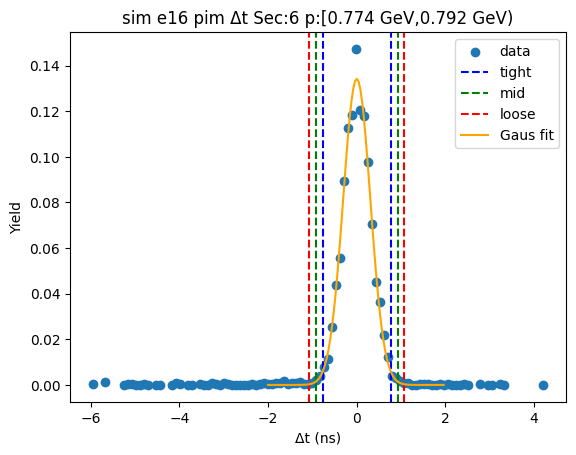

-0.734837321240983 0.7736687706375337
-0.8856879304288348 0.9245193798253855
-1.0365385396166864 1.075369989013237


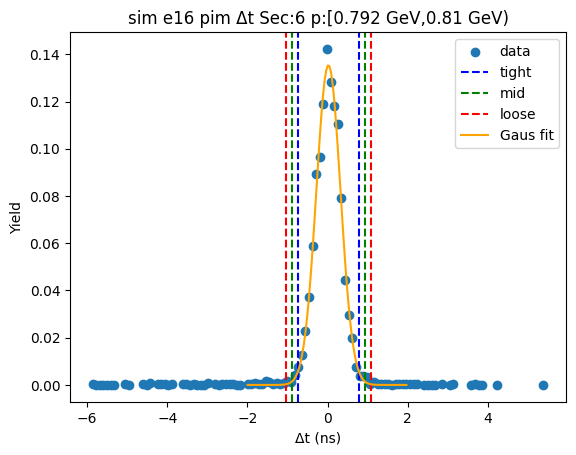

-0.7330607292147306 0.7672267602908225
-0.883089478165286 0.9172555092413779
-1.0331182271158412 1.067284258191933


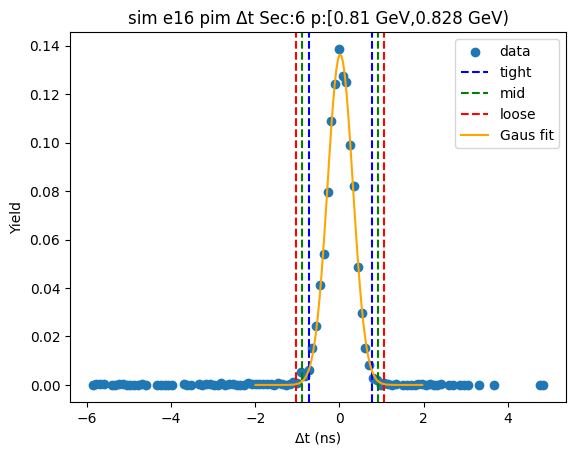

-0.7323295624979245 0.7890081974176875
-0.8844633384894857 0.9411419734092487
-1.0365971144810469 1.0932757494008096


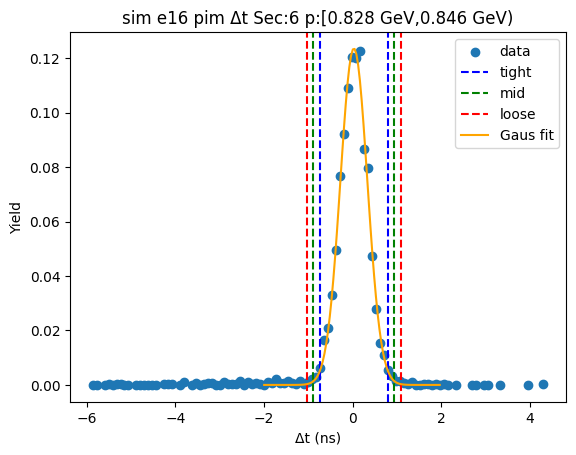

-0.7653234418212012 0.7669324759826768
-0.918549033601589 0.9201580677630646
-1.0717746253819769 1.0733836595434525


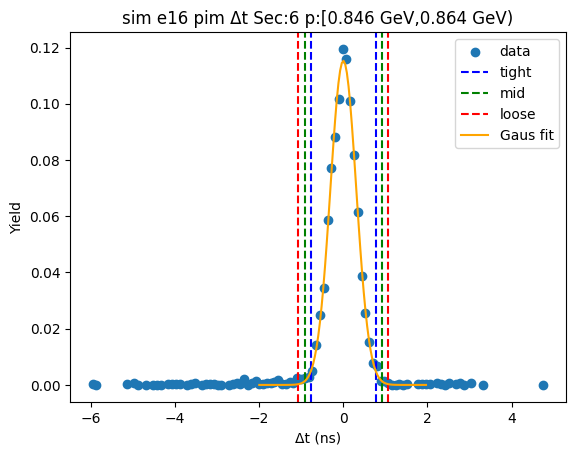

-0.772212618063587 0.790675848972458
-0.9285014647671914 0.9469646956760625
-1.084790311470796 1.1032535423796668


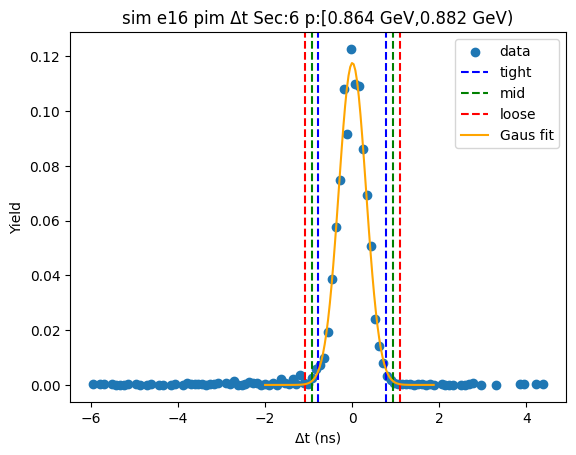

-0.7085731234278928 0.7475021284193873
-0.8541806486126209 0.8931096536041154
-0.999788173797349 1.0387171787888434


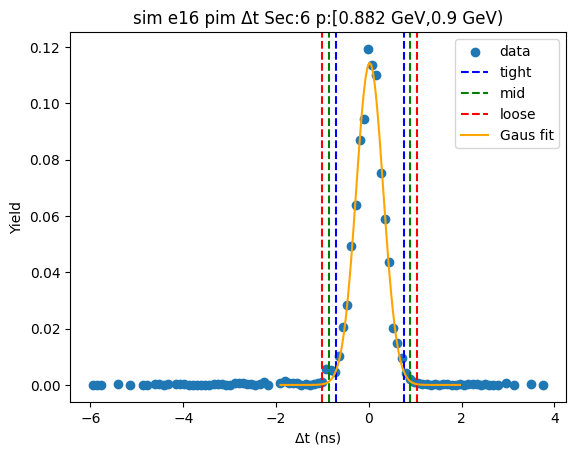

-0.7254513438815986 0.7840478426845039
-0.8764012625382089 0.9349977613411142
-1.027351181194819 1.0859476799977243


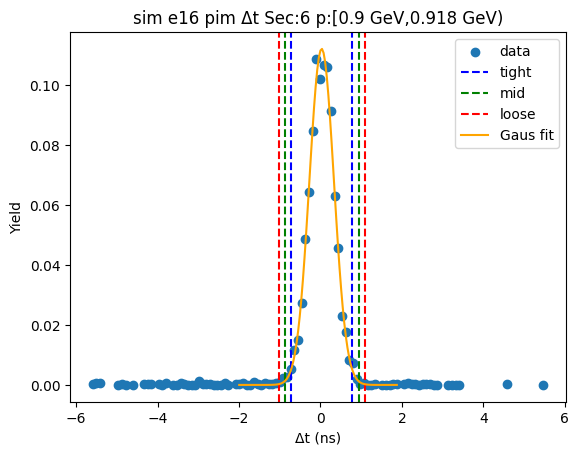

-0.7460315473717514 0.7396556892568562
-0.894600271034612 0.8882244129197169
-1.043168994697473 1.0367931365825775


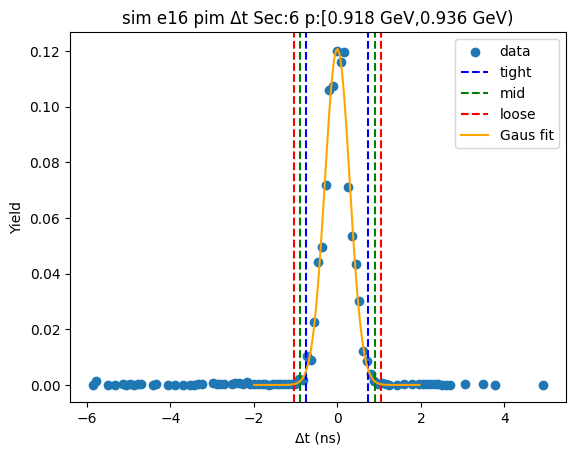

-0.7291464469609888 0.7662463063131967
-0.8786857222884075 0.9157855816406153
-1.028224997615826 1.065324856968034


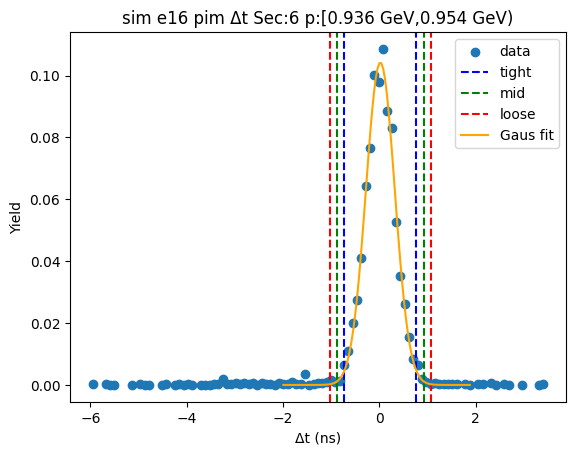

-0.754575658277613 0.7635589543589686
-0.9063891195412712 0.9153724156226268
-1.0582025808049293 1.067185876886285


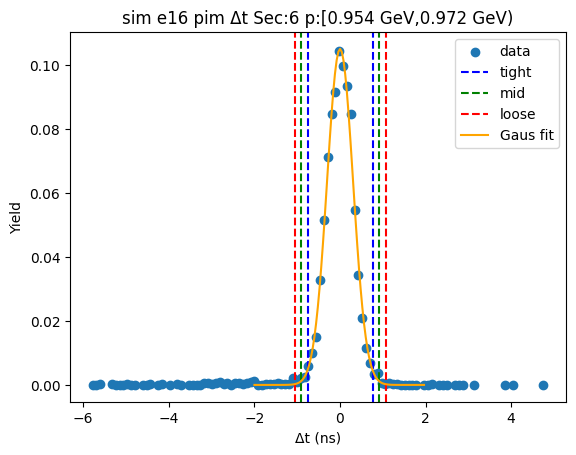

-0.715765132957944 0.7438284951956589
-0.8617244957733043 0.8897878580110192
-1.0076838585886645 1.0357472208263794


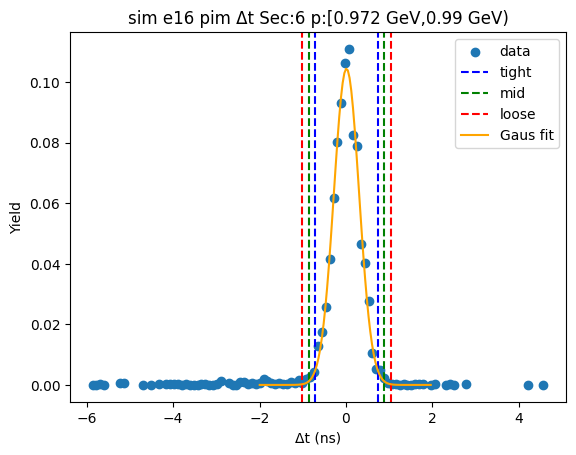

-0.7319271333881651 0.7387367105308306
-0.8789935177800646 0.8858030949227301
-1.0260599021719643 1.0328694793146296


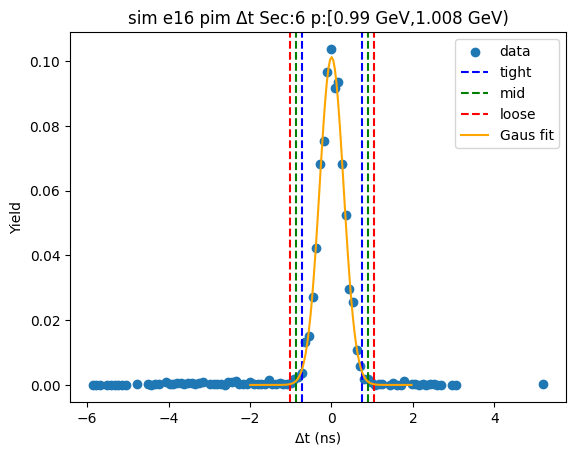

-0.702120734775472 0.7193350965476099
-0.8442663179077802 0.861480679679918
-0.9864119010400884 1.0036262628122263


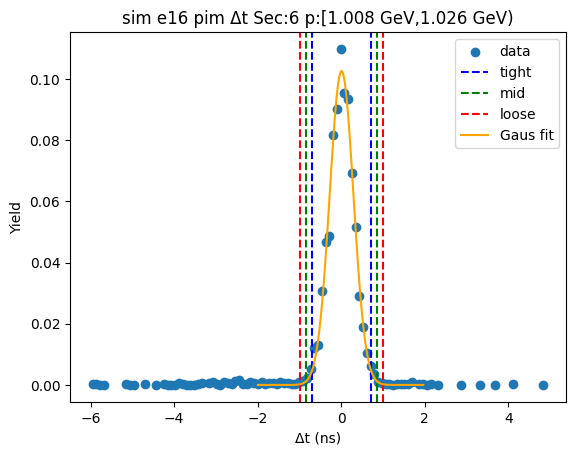

-0.7482711416247831 0.7583008456874198
-0.8989283403560034 0.9089580444186401
-1.0495855390872237 1.0596152431498607


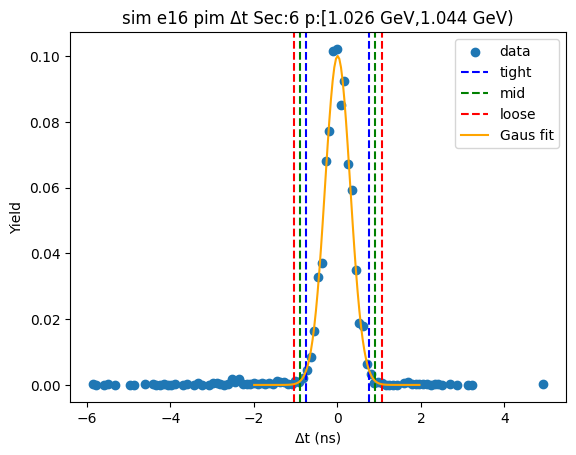

-0.7331062388153365 0.7709814768459801
-0.8835150103814683 0.9213902484121118
-1.0339237819475997 1.0717990199782435


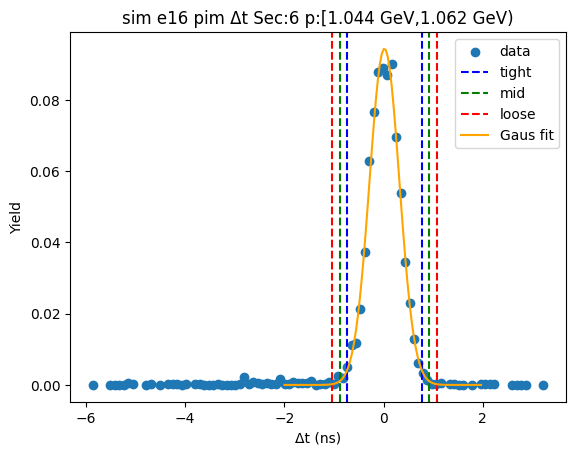

-0.7058898837459598 0.7334194552486301
-0.8498208176454188 0.877350389148089
-0.9937517515448778 1.021281323047548


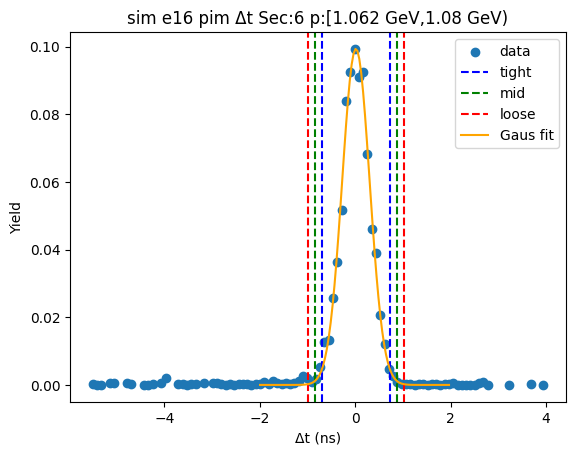

-0.7853615805645225 0.7716619593765345
-0.9410639345586282 0.9273643133706402
-1.0967662885527338 1.0830666673647458


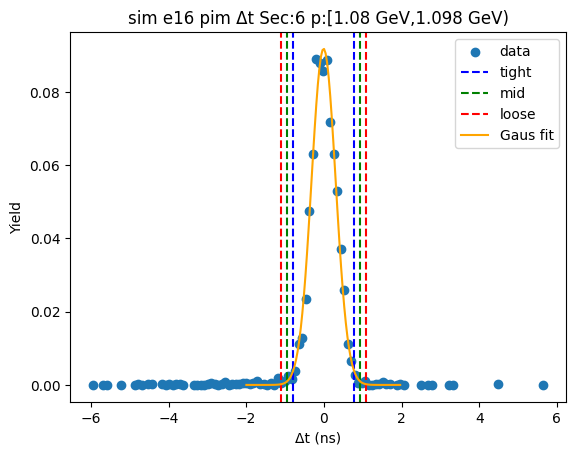

-0.7359259333159288 0.7317269147980227
-0.8826912181273239 0.8784921996094177
-1.029456502938719 1.0252574844208129


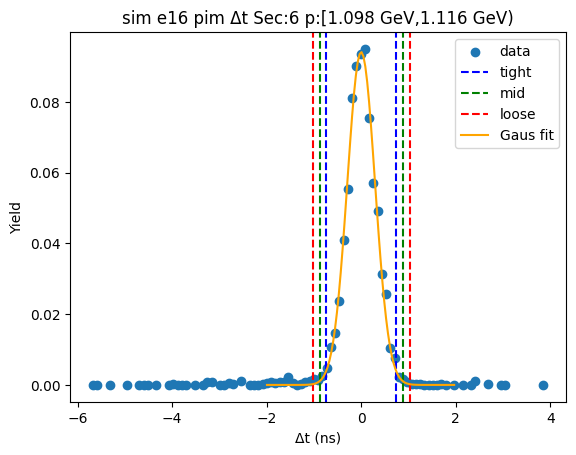

-0.723741643540262 0.7391923567472817
-0.8700350435690165 0.8854857567760361
-1.0163284435977709 1.0317791568047905


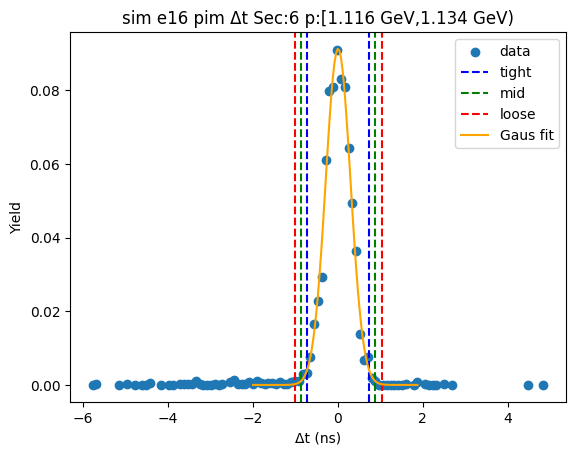

-0.735240828594119 0.7521397933476619
-0.8839788907882972 0.9008778555418401
-1.0327169529824751 1.0496159177360183


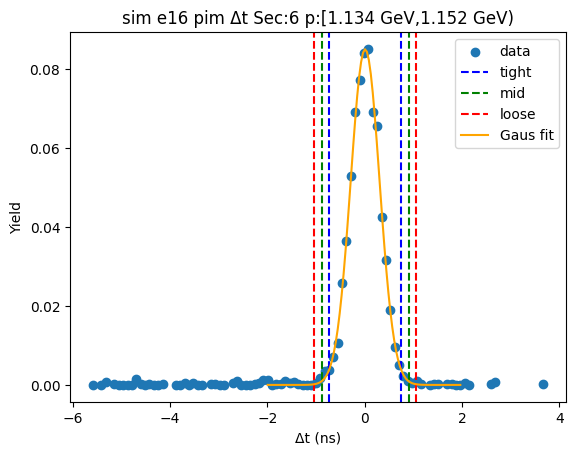

-0.74749097045364 0.7822937864498908
-0.9004694461439932 0.935272262140244
-1.0534479218343462 1.0882507378305968


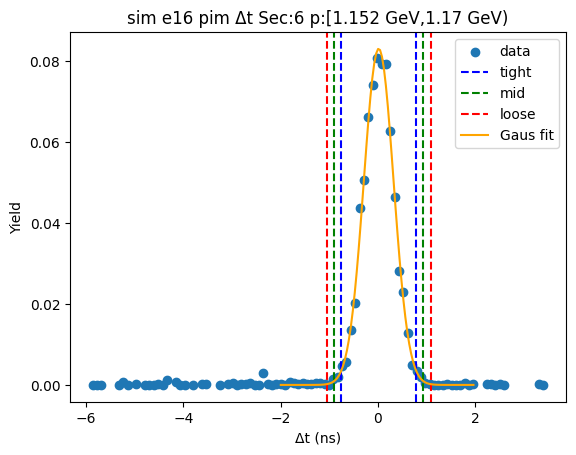

-0.7312992073747664 0.7407662020590358
-0.8785057483181465 0.8879727430024159
-1.0257122892615267 1.035179283945796


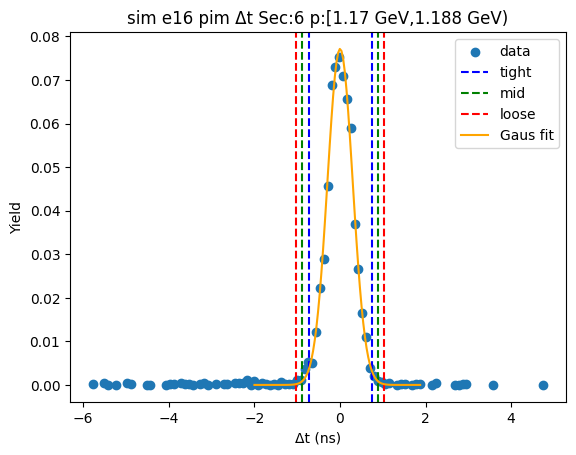

-0.7079304357757318 0.7066259892783967
-0.8493860782811445 0.8480816317838095
-0.9908417207865574 0.9895372742892223


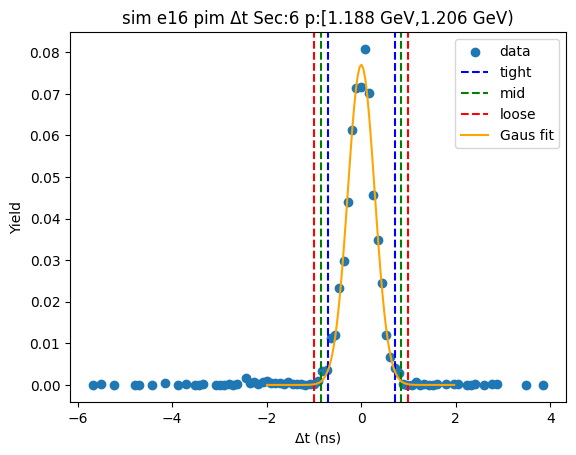

-0.7383513393211022 0.750327801814794
-0.8872192534346919 0.8991957159283837
-1.0360871675482815 1.0480636300419734


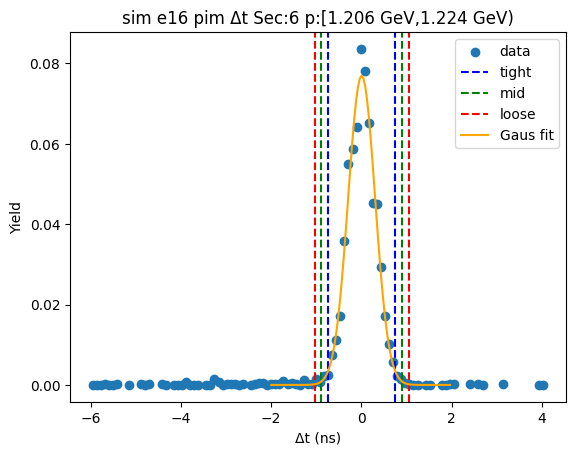

-0.6922531395554766 0.7260377124567879
-0.834082224756703 0.8678667976580143
-0.9759113099579294 1.0096958828592406


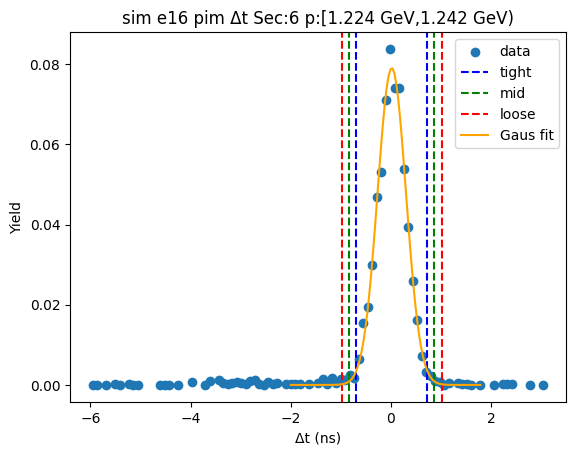

-0.7285244253596125 0.7626228268102261
-0.8776391505765962 0.9117375520272099
-1.0267538757935801 1.060852277244194


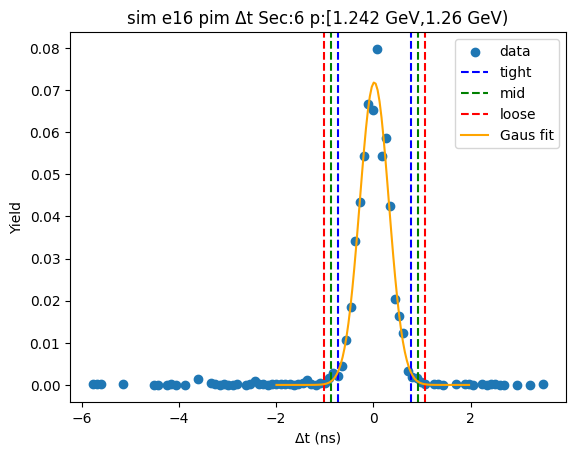

-0.7129299921504817 0.7384443655126269
-0.8580674279167925 0.8835818012789377
-1.0032048636831035 1.0287192370452485


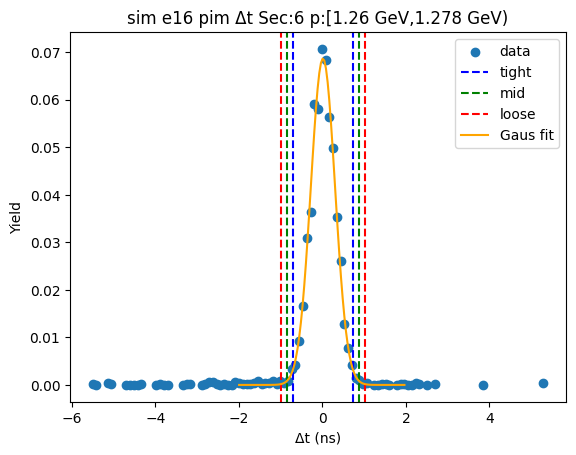

-0.7316056221535926 0.7523695617835499
-0.8800031405473068 0.900767080177264
-1.0284006589410208 1.0491645985709783


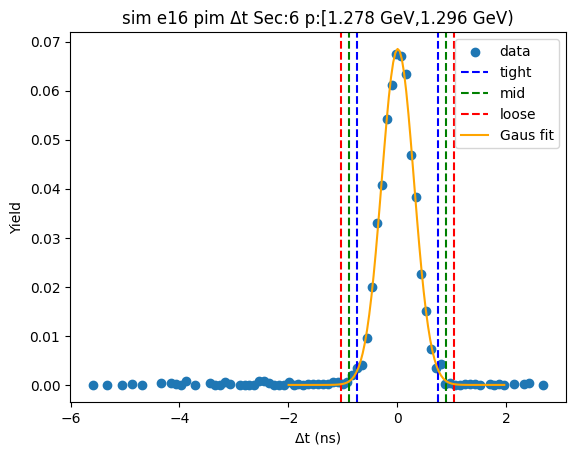

-0.7447477937574093 0.7570432916831041
-0.8949269023014605 0.9072224002271554
-1.045106010845512 1.0574015087712068


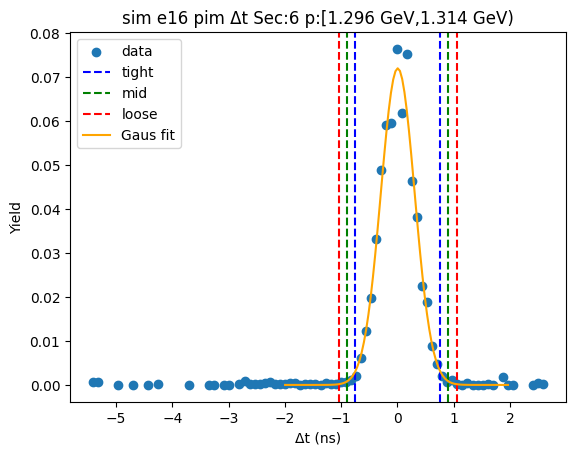

-0.7005677846585997 0.7388750260472979
-0.8445120657291895 0.8828193071178877
-0.9884563467997792 1.0267635881884776


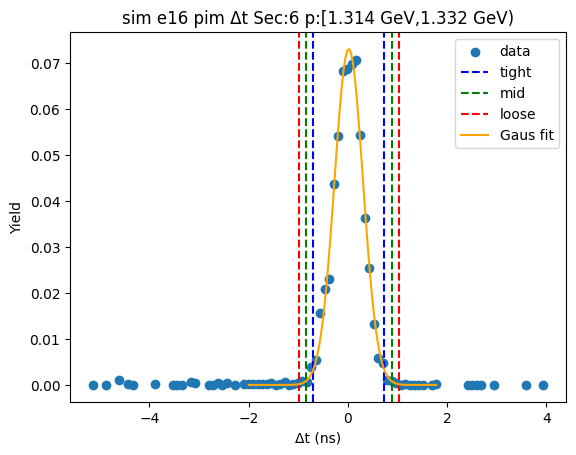

-0.7328725196999785 0.7620846318544682
-0.882368234855423 0.9115803470099128
-1.031863950010868 1.0610760621653574


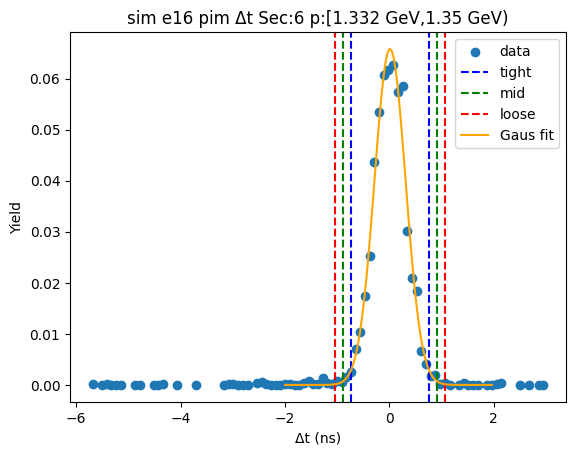

-0.713042247302363 0.7382090266002554
-0.8581673746926248 0.8833341539905173
-1.0032925020828867 1.0284592813807791


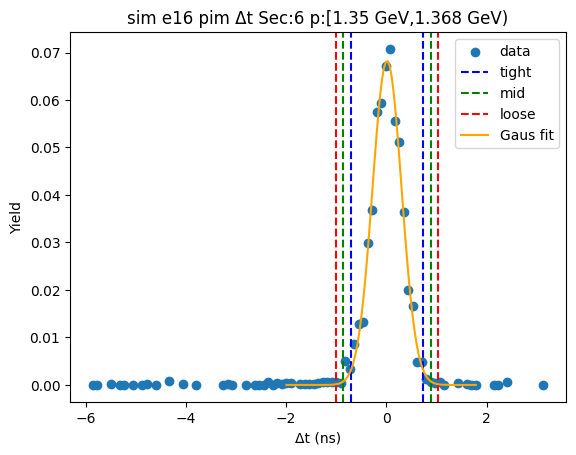

-0.6847165198300824 0.7278870121749585
-0.8259768730305863 0.8691473653754627
-0.9672372262310904 1.0104077185759668


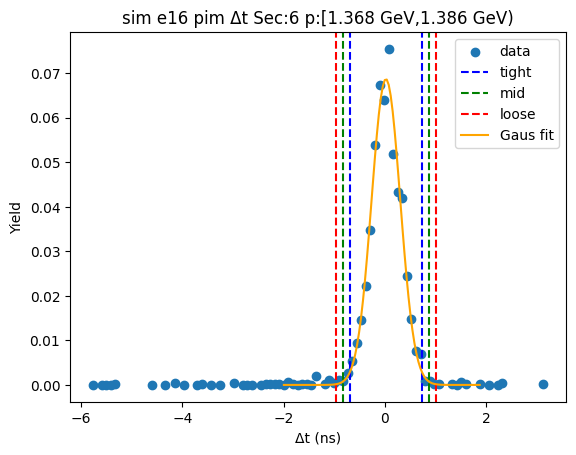

-0.7401327333507716 0.7548585044370238
-0.8896318571295512 0.9043576282158035
-1.039130980908331 1.053856751994583


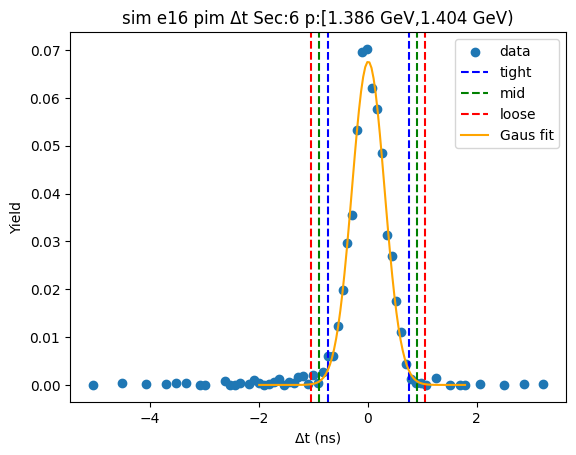

-0.6715761364784324 0.6820144998717753
-0.8069352001134531 0.817373563506796
-0.9422942637484738 0.9527326271418167


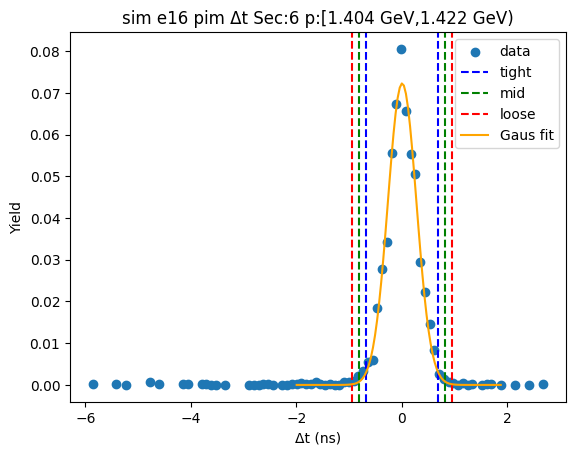

-0.673920452457608 0.7146969974333416
-0.8127821974467029 0.8535587424224365
-0.9516439424357979 0.9924204874115314


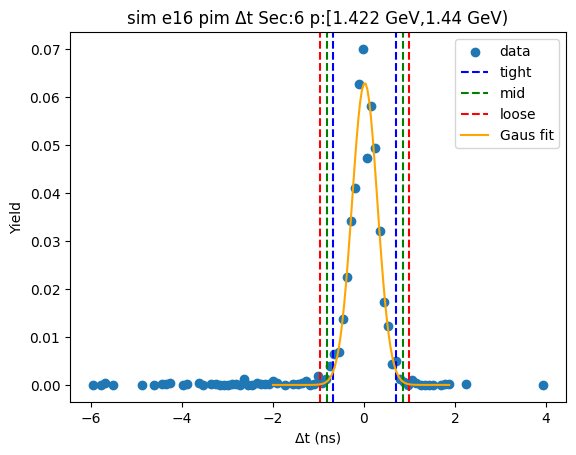

-0.7162048039536242 0.7381715620532663
-0.8616424405543132 0.8836091986539553
-1.0070800771550021 1.0290468352546442


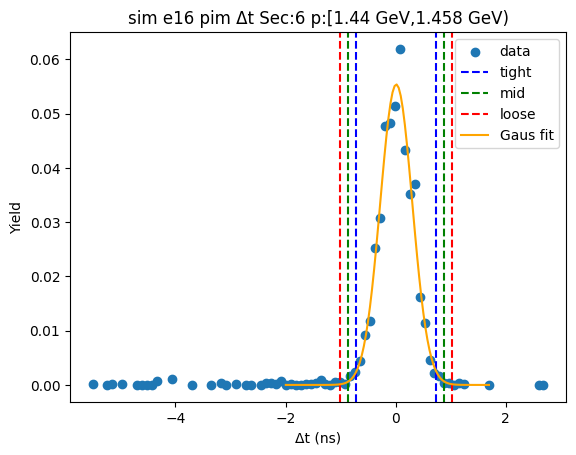

-0.7128040076102176 0.7381314988244929
-0.8578975582536885 0.8832250494679639
-1.0029911088971597 1.028318600111435


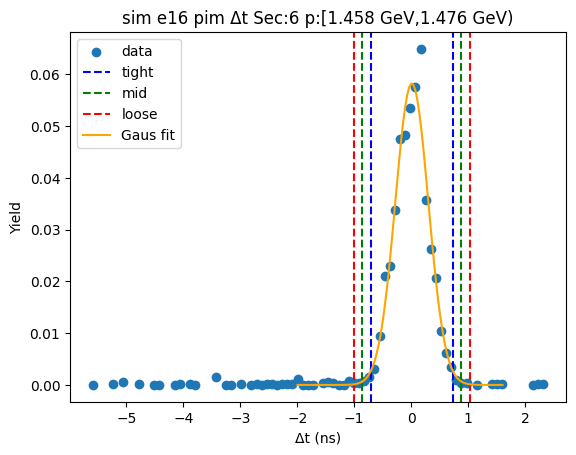

-0.7219859135949398 0.7505577714454201
-0.8692402820989757 0.8978121399494563
-1.016494650603012 1.0450665084534922


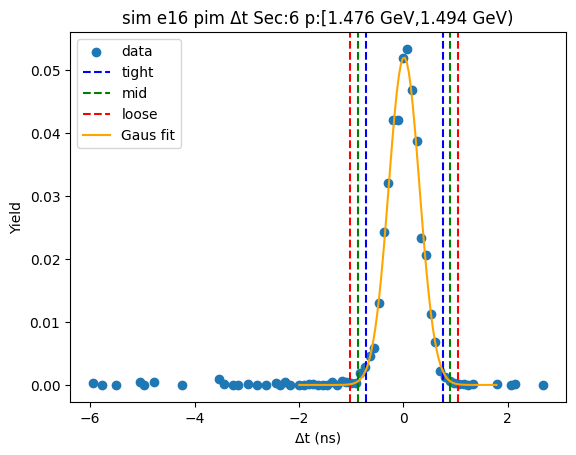

-0.7015189622905713 0.6993792493625755
-0.8416087834558861 0.8394690705278902
-0.9816986046212007 0.9795588916932049


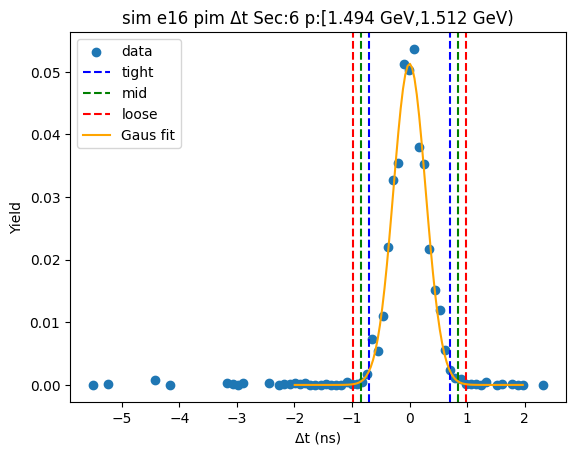

-0.6901597097433269 0.6917134977513414
-0.8283470304927937 0.8299008185008082
-0.9665343512422605 0.968088139250275


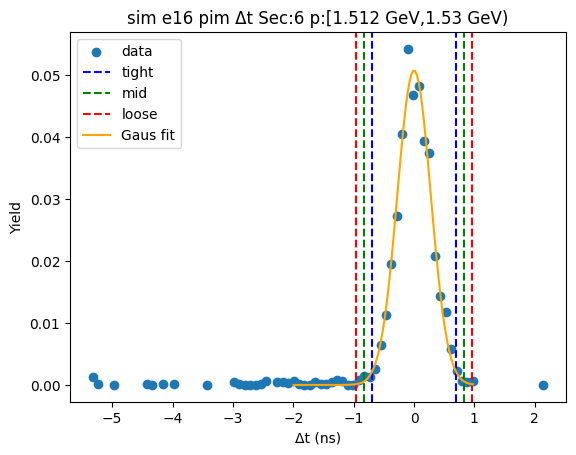

-0.7011227130515559 0.7446697388142792
-0.8457019582381395 0.8892489840008628
-0.990281203424723 1.0338282291874463


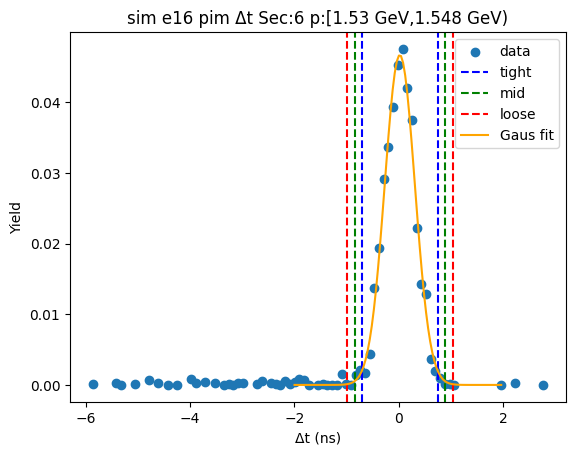

-0.6337195803074107 0.7166639430103774
-0.7687579326391895 0.8517022953421561
-0.9037962849709682 0.9867406476739349


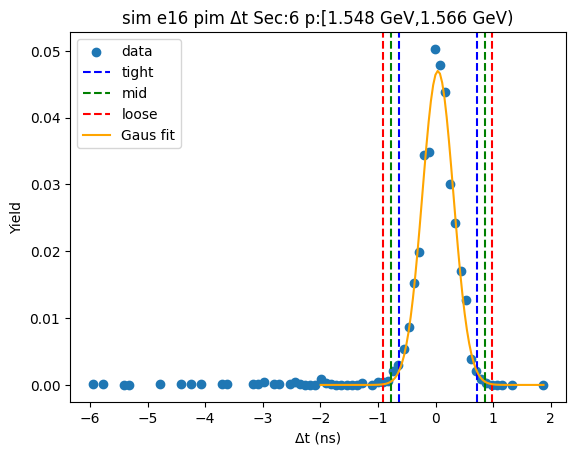

-0.6809364840257994 0.7107784992601871
-0.8201079823543981 0.8499499975887858
-0.9592794806829967 0.9891214959173844


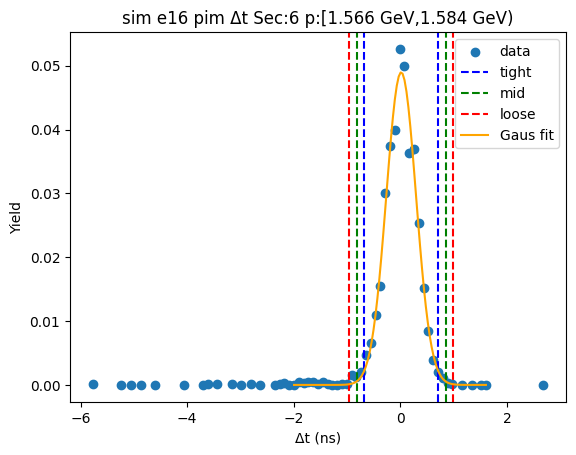

-0.6942050987165562 0.7271732300639455
-0.8363429315946065 0.8693110629419958
-0.9784807644726566 1.0114488958200458


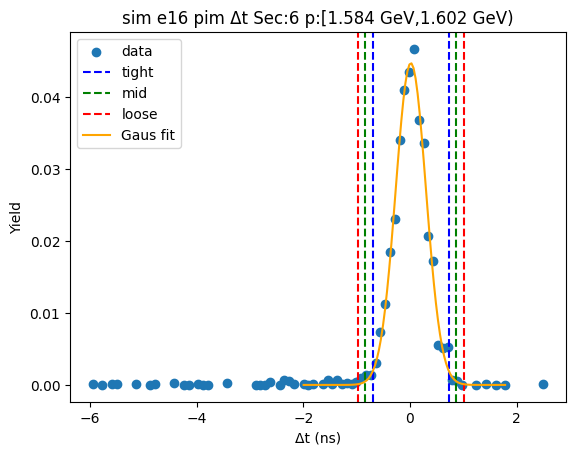

-0.6926678065096525 0.6917762742668381
-0.8311122145873017 0.8302206823444872
-0.9695566226649508 0.9686650904221363


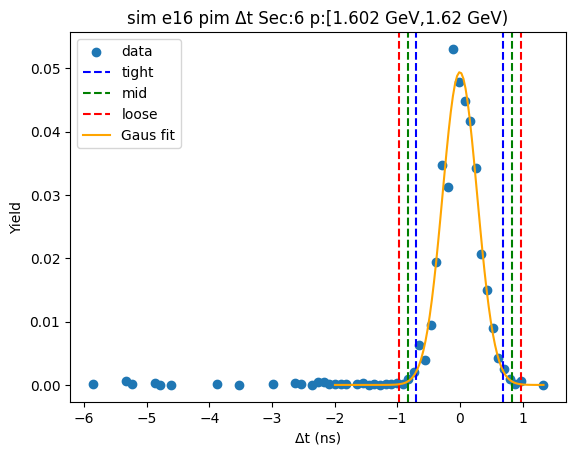

-0.745742698347953 0.7299591207454076
-0.8933128802572892 0.8775293026547437
-1.0408830621666254 1.0250994845640797


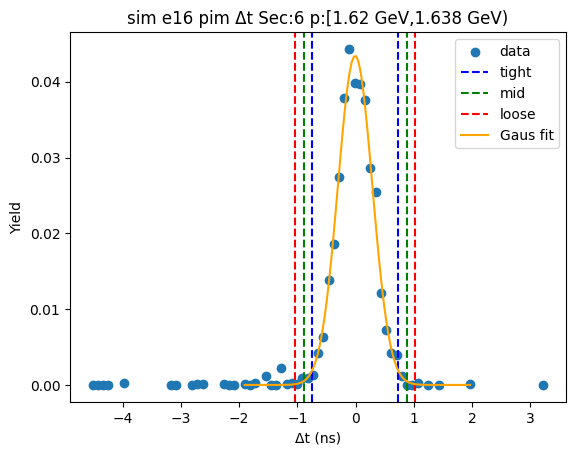

-0.7027017961246788 0.7652087616880715
-0.8494928519059537 0.9119998174693464
-0.9962839076872287 1.0587908732506215


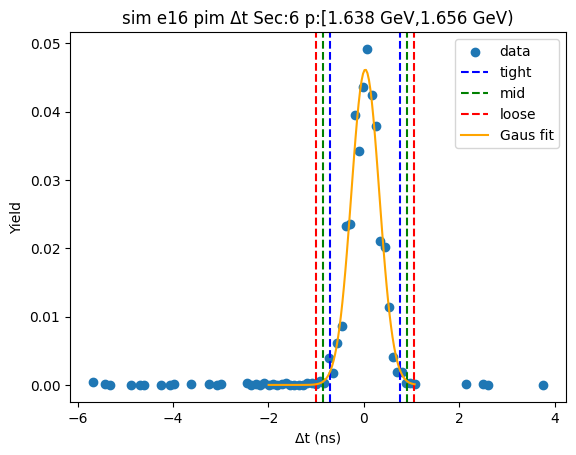

-0.7198525304408111 0.7606403885861578
-0.867901822343508 0.9086896804888547
-1.0159511142462048 1.0567389723915515


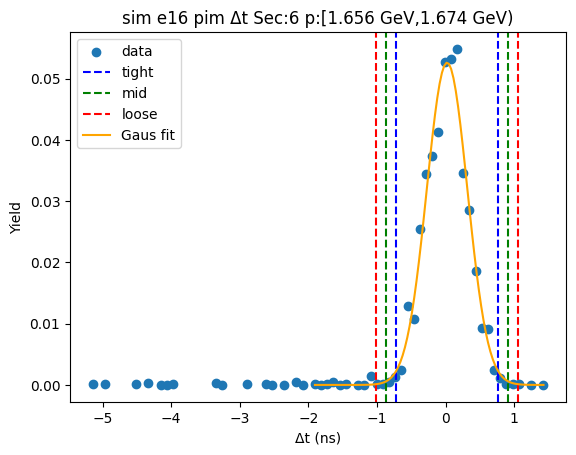

-0.7202137945595689 0.7678877801830865
-0.8690239520338345 0.9166979376573521
-1.0178341095081 1.0655080951316176


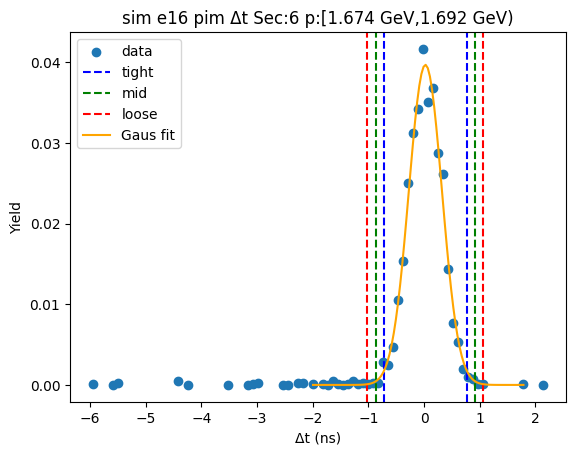

-0.6910225834547882 0.7071590496391874
-0.8308407467641857 0.846977212948585
-0.9706589100735833 0.9867953762579825


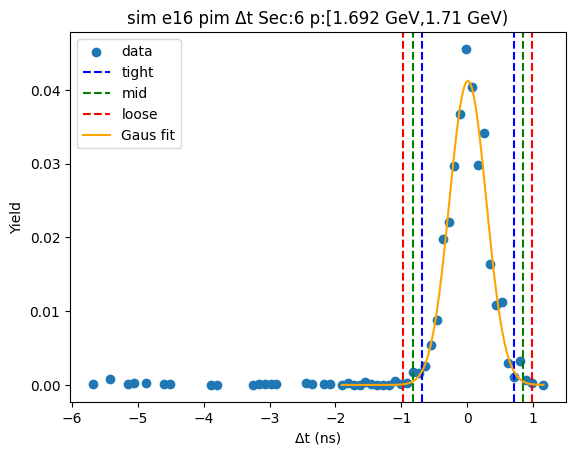

-0.700596411383524 0.7191357958610666
-0.8425696321079831 0.8611090165855256
-0.9845428528324421 1.0030822373099846


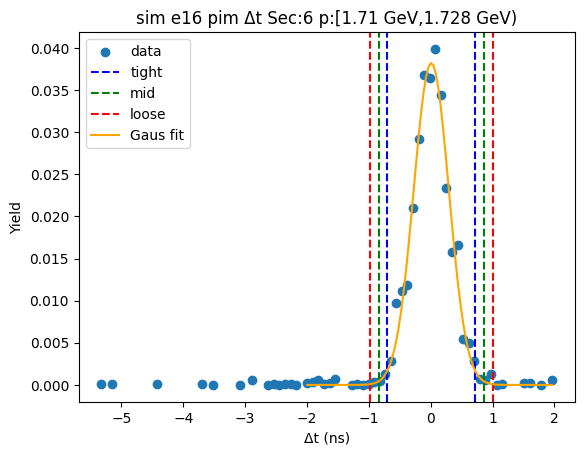

-0.703380959748173 0.7620359610762055
-0.849922651830611 0.9085776531586435
-0.9964643439130488 1.0551193452410814


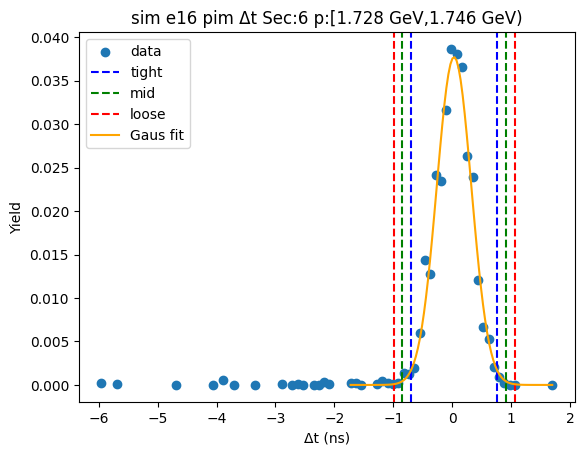

-0.6903802338874417 0.7249492415659436
-0.8319131814327804 0.8664821891112823
-0.9734461289781189 1.0080151366566208


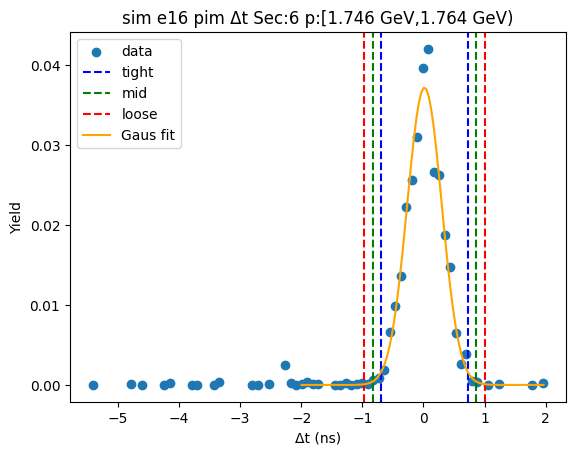

-0.602398619946225 0.656633165180839
-0.7283017984589315 0.7825363436935455
-0.8542049769716379 0.9084395222062519


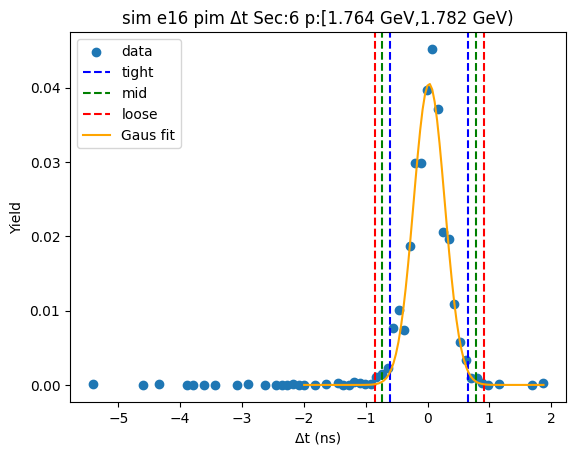

-0.6678552127950447 0.707051644549623
-0.8053458985295114 0.8445423302840898
-0.9428365842639782 0.9820330160185565


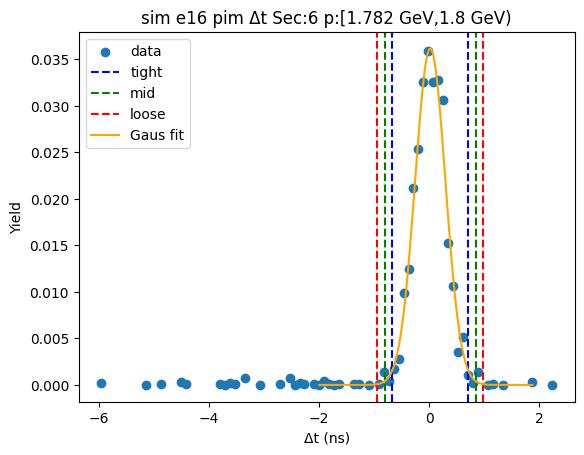

-0.7018962157118562 0.7404410195998765
-0.8461299392430296 0.8846747431310499
-0.9903636627742028 1.028908466662223


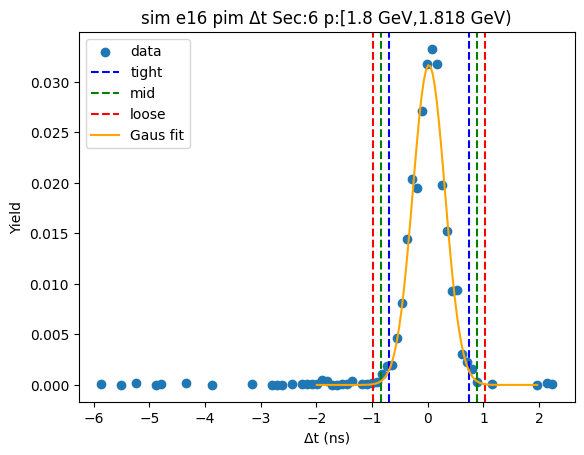

-0.7399225633028362 0.7559528941262385
-0.8895101090457438 0.905540439869146
-1.0390976547886512 1.0551279856120535


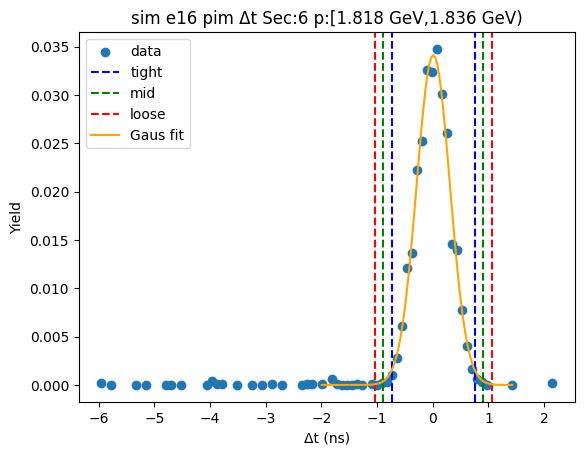

-0.7100568479072072 0.7102875682381758
-0.8520912895217456 0.8523220098527142
-0.994125731136284 0.9943564514672526


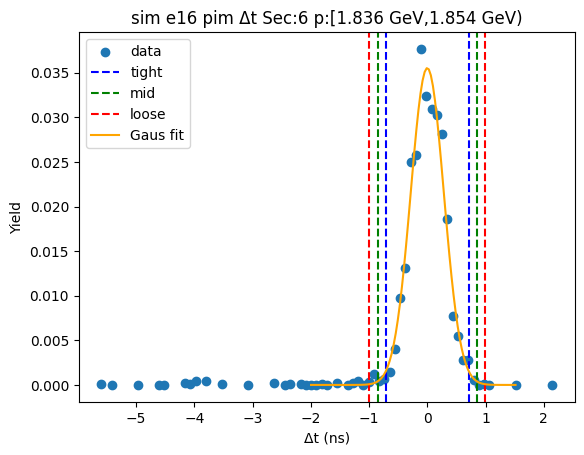

-0.771709503125793 0.7407922980324355
-0.9229596832416159 0.8920424781482584
-1.0742098633574388 1.0432926582640814


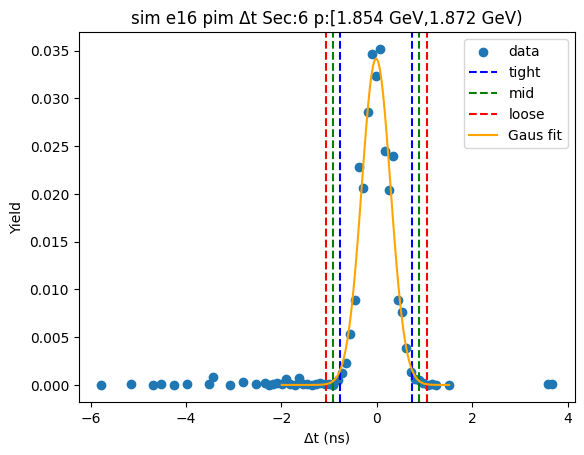

-0.6512847535867803 0.6850037608735964
-0.784913605032818 0.8186326123196341
-0.9185424564788557 0.9522614637656718


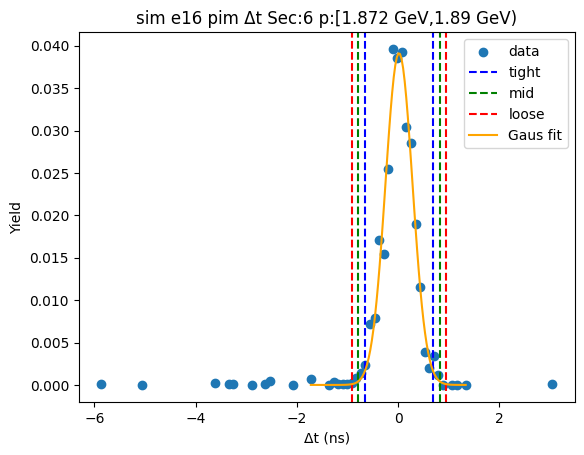

-0.7395229236849853 0.7313218521898713
-0.886607401272471 0.878406329777357
-1.0336918788599567 1.0254908073648428


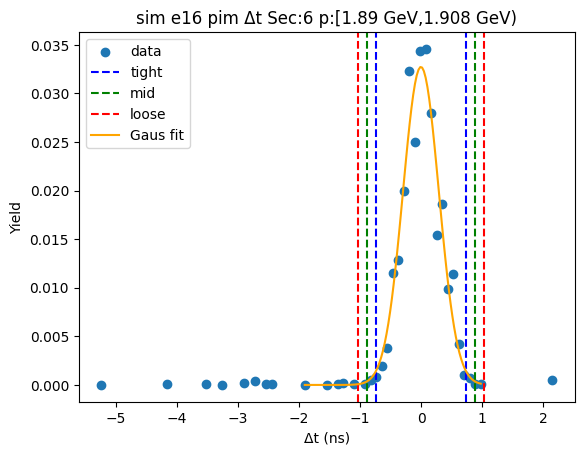

-0.7078516001484367 0.7373965729969234
-0.8523764174629727 0.8819213903114593
-0.9969012347775088 1.0264462076259955


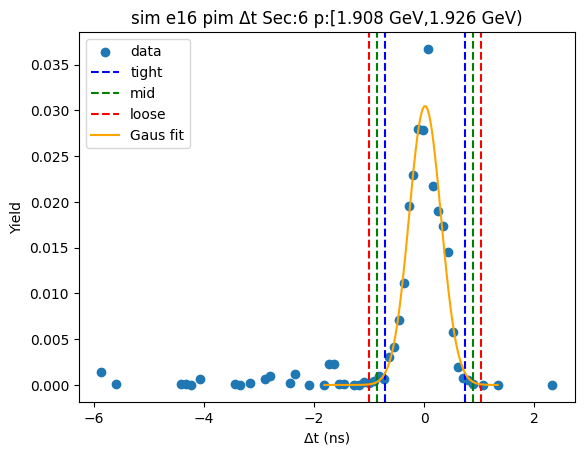

-0.6870647700923309 0.7537096572410333
-0.8311422128256672 0.8977870999743697
-0.9752196555590037 1.0418645427077062


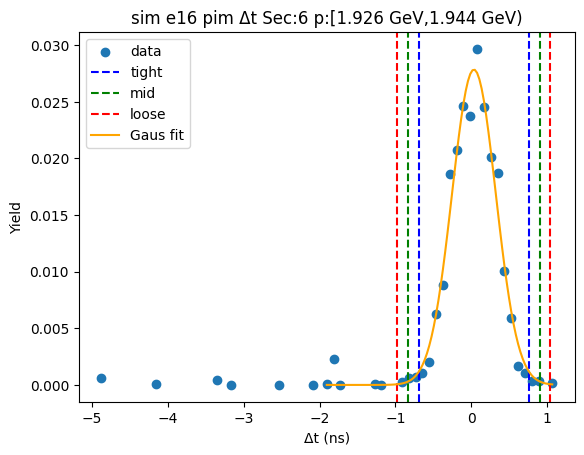

-0.6905602389163884 0.71830095498248
-0.8314463583062753 0.859187074372367
-0.9723324776961622 1.0000731937622538


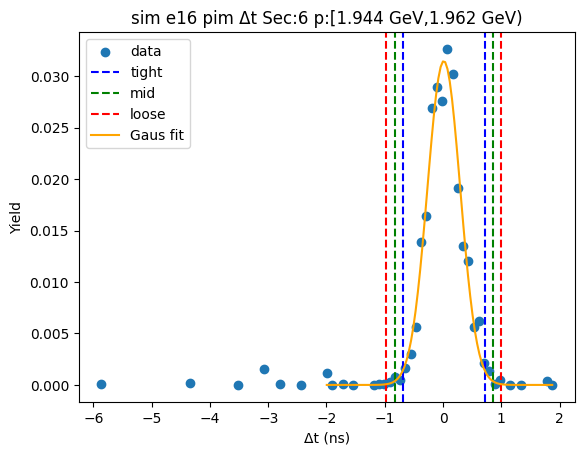

-0.708437220854649 0.7451037942733001
-0.8537913223674438 0.8904578957860949
-0.9991454238802389 1.03581199729889


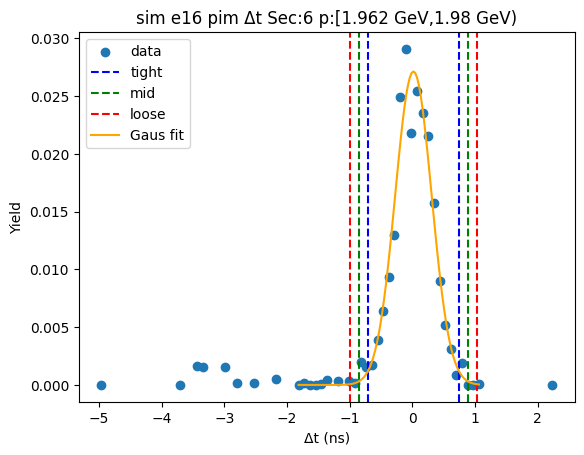

-0.7624205353889251 0.808517130696988
-0.9195143019975164 0.9656108973055794
-1.0766080686061075 1.1227046639141707


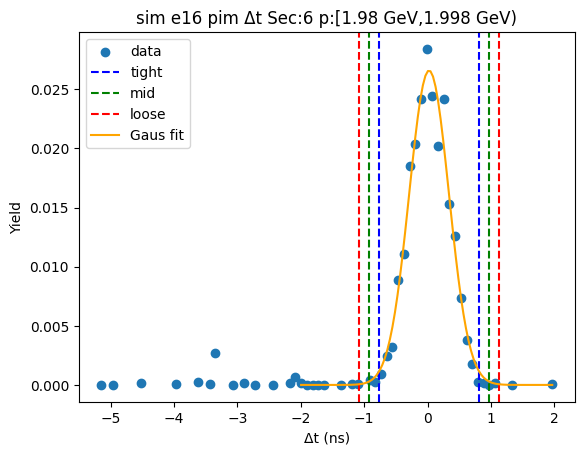

-0.729856601594061 0.7646133987636582
-0.8793036016298328 0.91406039879943
-1.0287506016656047 1.063507398835202


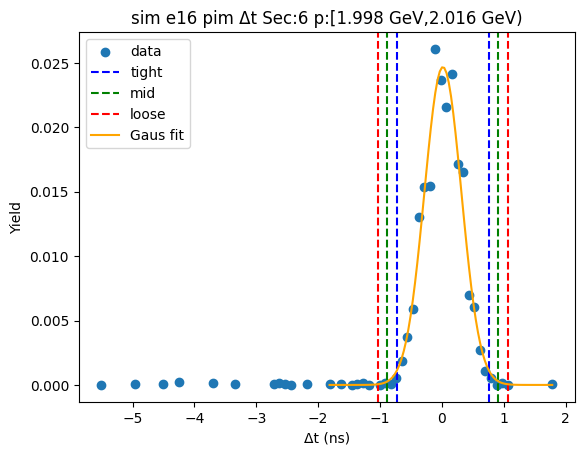

-0.709253149940083 0.7300915114802885
-0.8531876160821201 0.8740259776223256
-0.9971220822241572 1.0179604437643628


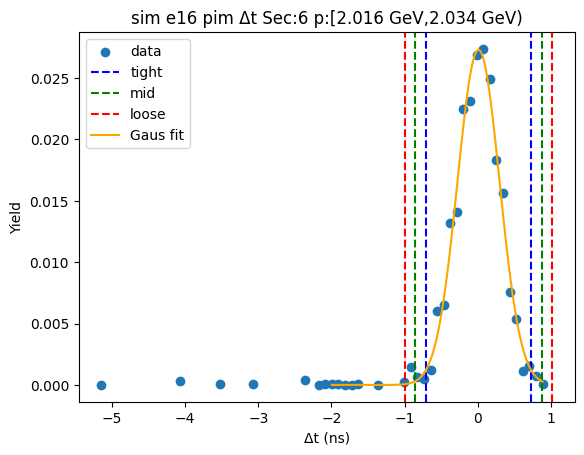

-0.7252049214064925 0.7125103229994566
-0.8689764458470873 0.8562818474400514
-1.0127479702876825 1.0000533718806464


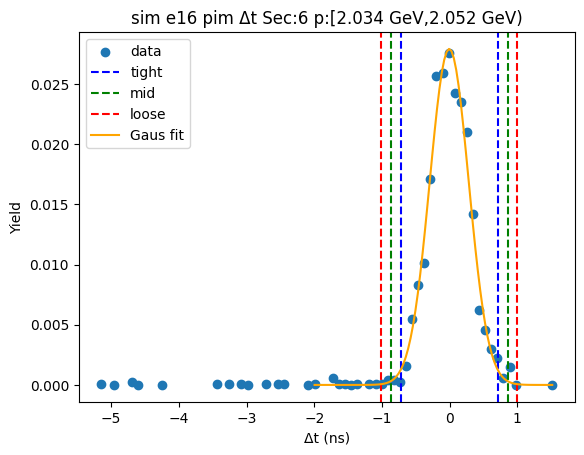

-0.6643588507980351 0.7596351714255187
-0.8067582530203906 0.9020345736478742
-0.949157655242746 1.0444339758702295


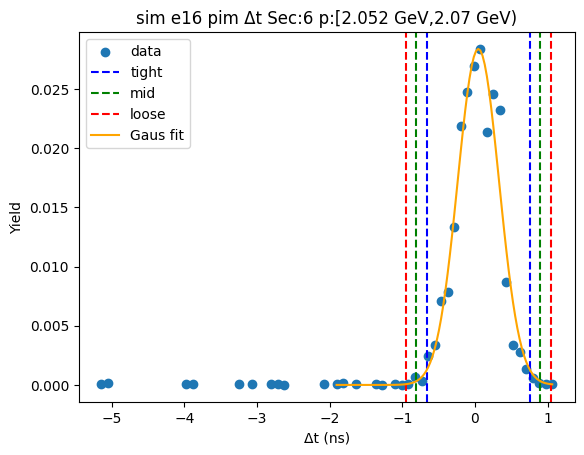

-0.6741773704745139 0.6677649000037599
-0.8083715975223413 0.8019591270515873
-0.9425658245701687 0.9361533540994147


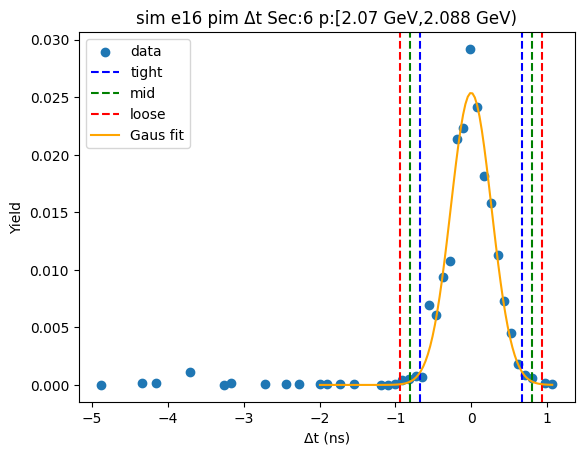

-0.6974730162223157 0.7143224075151073
-0.838652558596058 0.8555019498888496
-0.9798321009698003 0.996681492262592


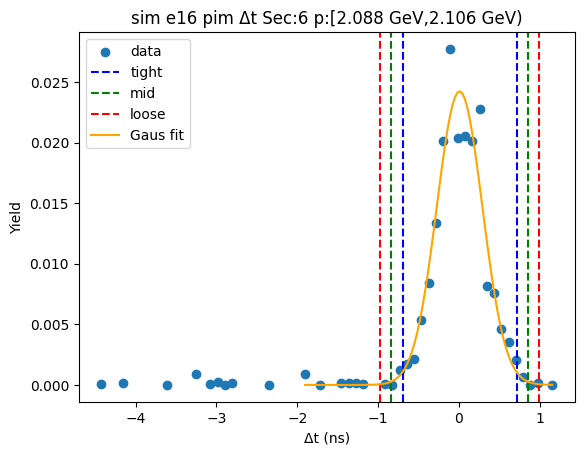

-0.719932007989515 0.7564724366465926
-0.8675724524531256 0.9041128811102033
-1.0152128969167364 1.0517533255738138


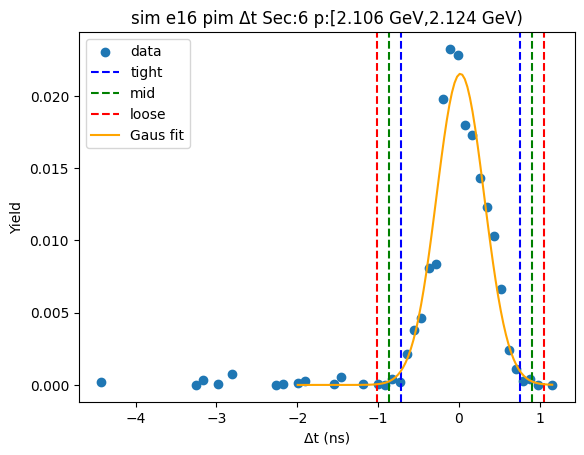

-0.6376824323947973 0.7029440286473599
-0.7717450784990131 0.8370066747515758
-0.9058077246032288 0.9710693208557915


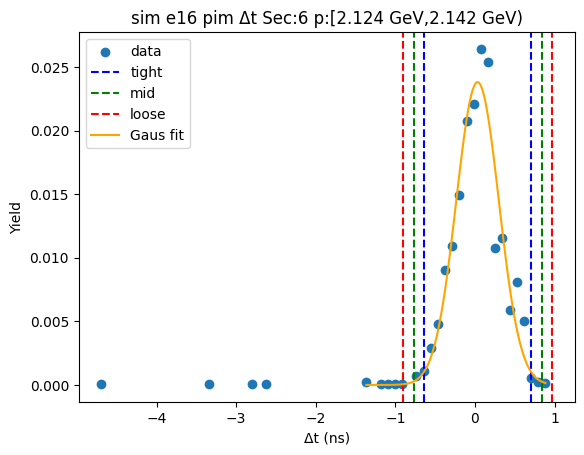

-0.6959330422331472 0.7099252304557583
-0.8365188695020377 0.8505110577246487
-0.9771046967709283 0.9910968849935393


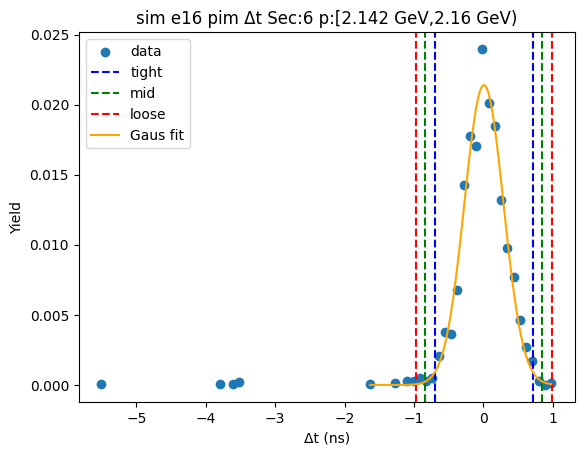

-0.7040366585928723 0.7042851665336827
-0.8448688411055278 0.8451173490463382
-0.9857010236181833 0.9859495315589937


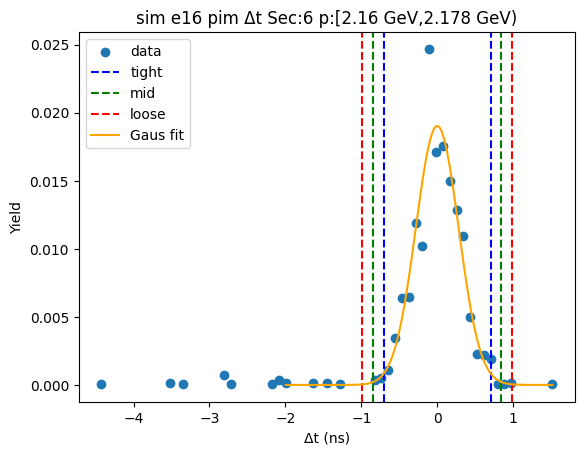

-0.7418260849582228 0.6551381722359759
-0.8815225106776426 0.7948345979553958
-1.0212189363970625 0.9345310236748157


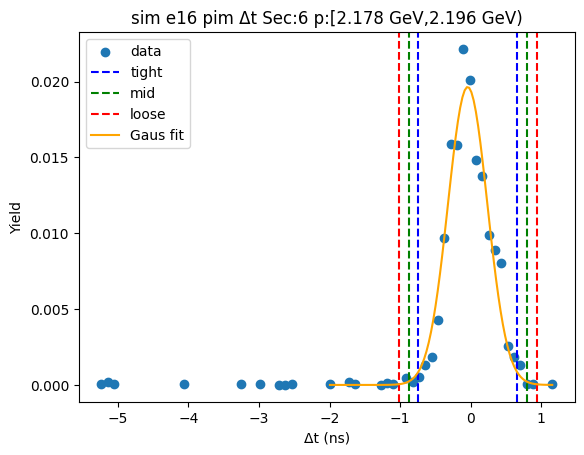

-0.6534805311674197 0.669101103040884
-0.78573869458825 0.8013592664617143
-0.9179968580090803 0.9336174298825446


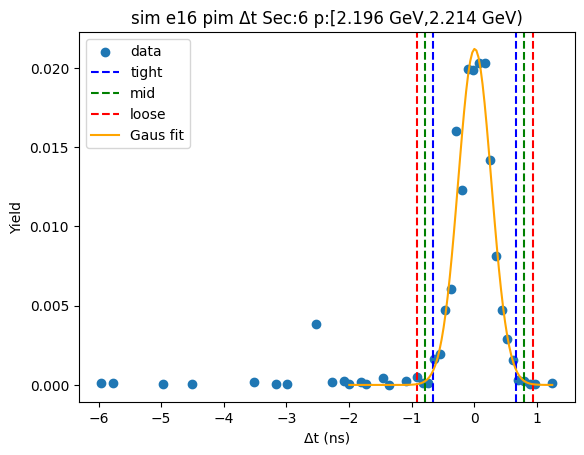

-0.6915497597859688 0.727628825907406
-0.8334676183553063 0.8695466844767434
-0.9753854769246437 1.011464543046081


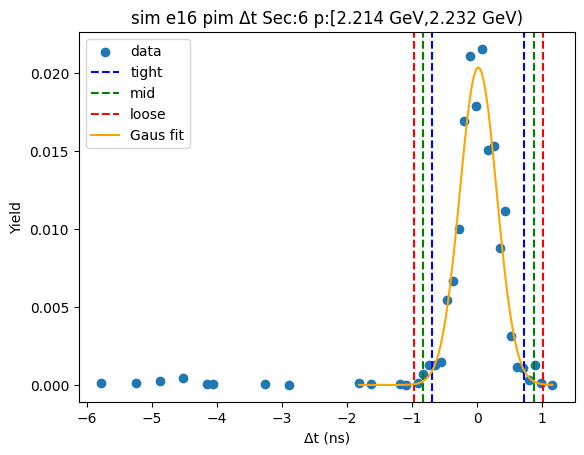

-0.750717037218427 0.7632411407780845
-0.902112855018078 0.9146369585777355
-1.0535086728177294 1.0660327763773867


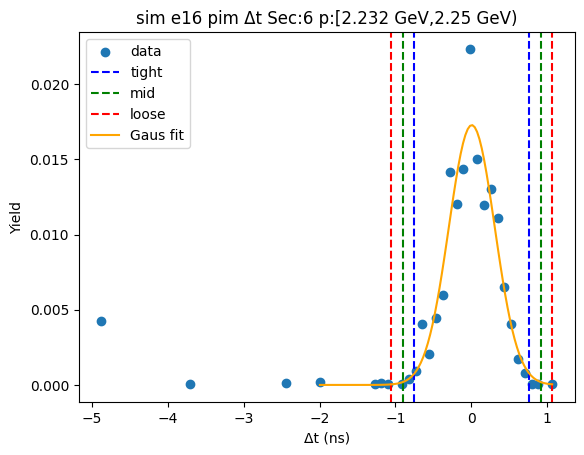

-0.6164070867526031 0.6008747193601113
-0.7381352673638746 0.7226028999713827
-0.859863447975146 0.8443310805826542


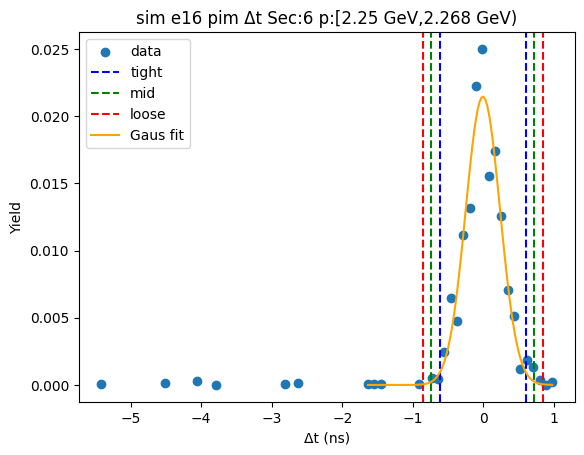

-0.7197349690563705 0.6398767342239305
-0.8556961393844005 0.7758379045519606
-0.9916573097124306 0.9117990748799907


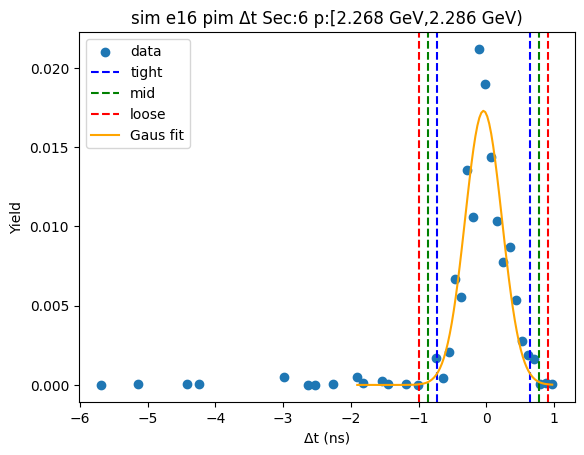

-0.7090033076733858 0.7095934284625139
-0.8508629812869758 0.8514531020761039
-0.9927226549005658 0.9933127756896939


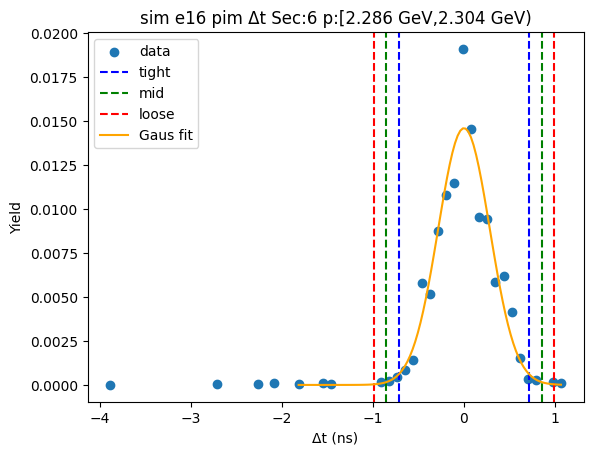

-0.6842864901727381 0.7040675711255624
-0.8231218963025683 0.8429029772553925
-0.9619573024323983 0.9817383833852226


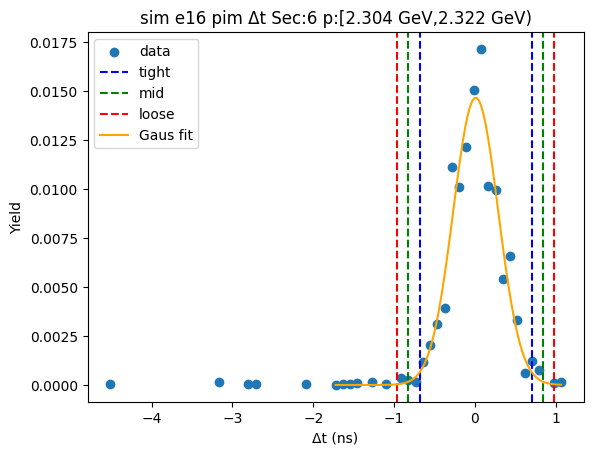

-0.7253234872927841 0.6891120651709166
-0.866767042539154 0.8305556204172866
-1.0082105977855242 0.9719991756636567


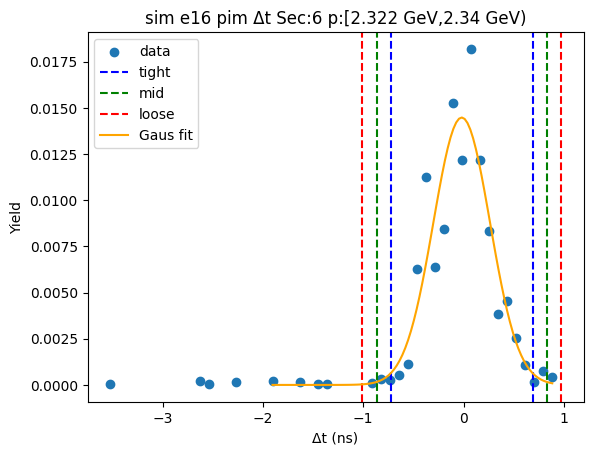

-0.762575828225007 0.7102066789375119
-0.9098540789412589 0.8574849296537638
-1.0571323296575108 1.0047631803700159


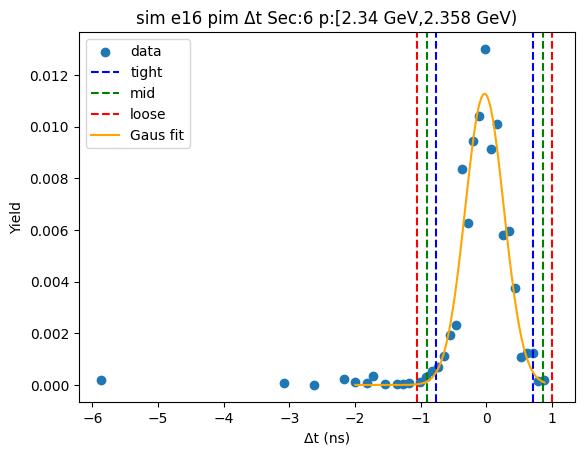

-0.6385492722967387 0.7655097362530388
-0.7789551731517166 0.9059156371080166
-0.9193610740066943 1.0463215379629944


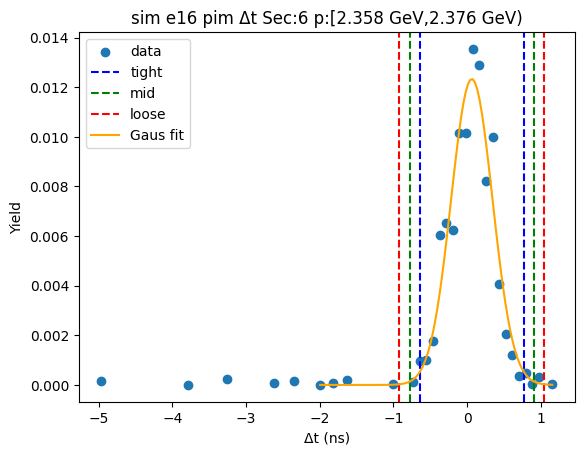

-0.7479968365413469 0.7516076253006748
-0.8979572827255491 0.901568071484877
-1.0479177289097514 1.0515285176690792


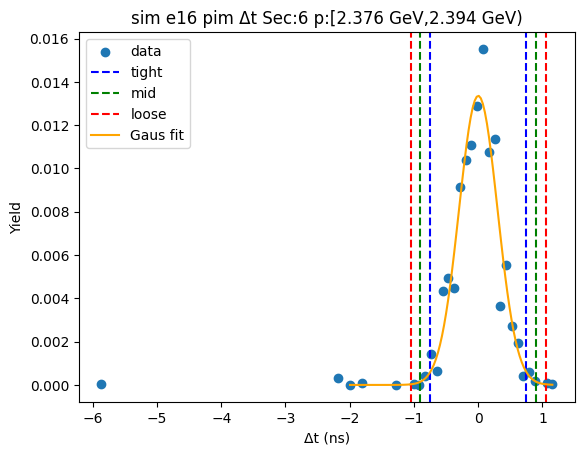

-0.653161588129231 0.7662404920945818
-0.7951017961516123 0.9081807001169631
-0.9370420041739935 1.0501209081393443


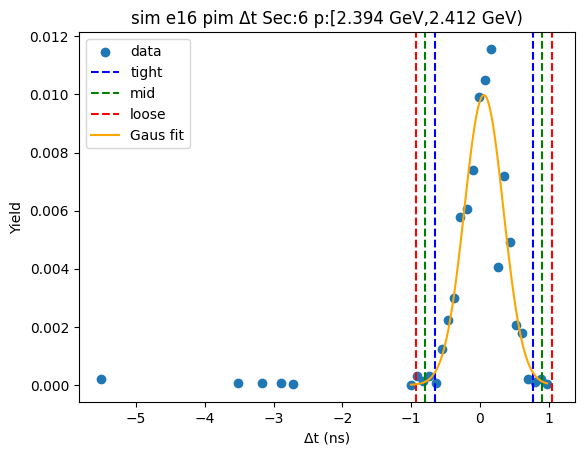

-0.6729376611139959 0.6904210015181029
-0.8092735273772057 0.8267568677813127
-0.9456093936404155 0.9630927340445226


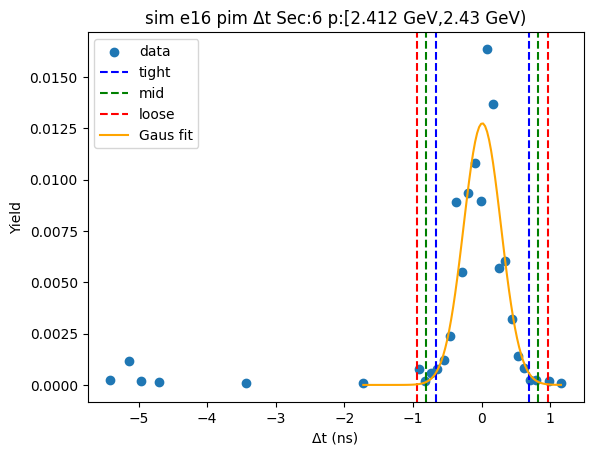

-0.6755370735082039 0.7045701749152381
-0.813547798350548 0.8425808997575822
-0.9515585231928922 0.9805916245999264


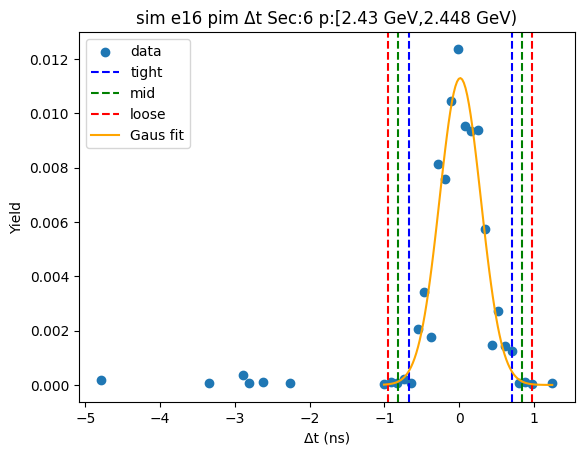

-0.6922240313207143 0.8163235050761307
-0.8430787849603989 0.9671782587158153
-0.9939335386000834 1.1180330123554998


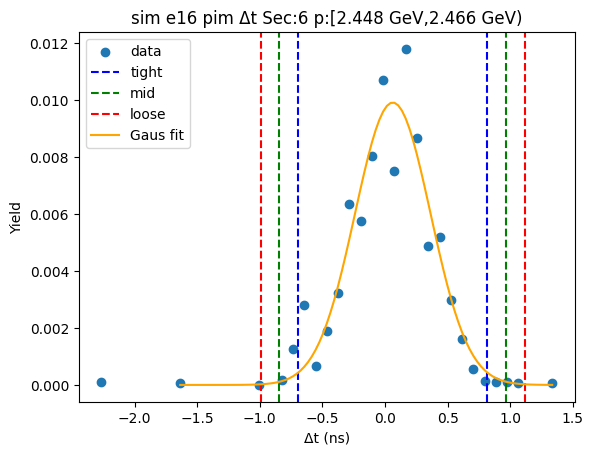

-0.6182235786165245 0.7270207198249469
-0.7527480084606717 0.861545149669094
-0.8872724383048188 0.9960695795132412


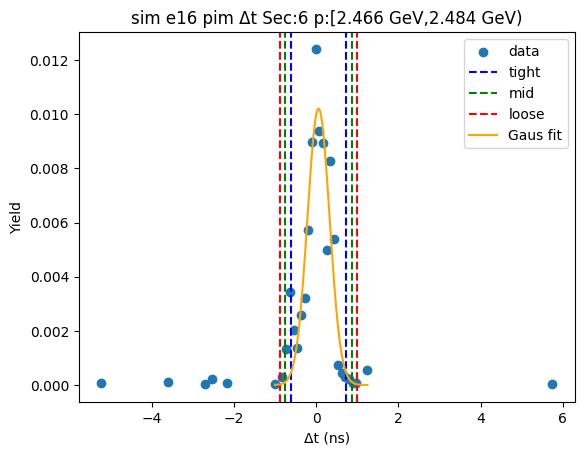

-0.7564181769616634 0.6894504576600735
-0.9010050404238371 0.8340373211222473
-1.0455919038860109 0.978624184584421


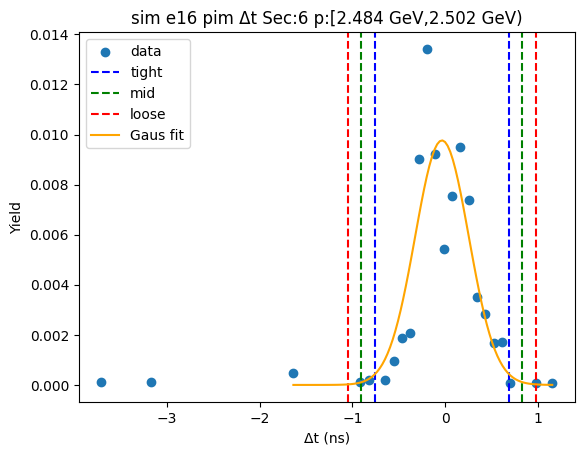

-0.6952460049689406 0.5675966607292142
-0.821530271538756 0.6938809272990296
-0.9478145381085715 0.8201651938688451


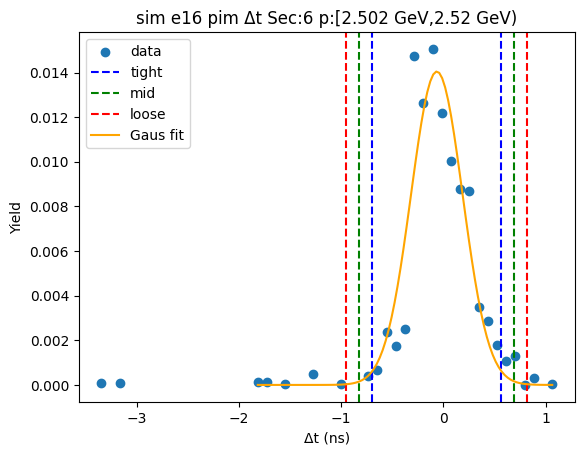

-0.5469207820891914 0.457233428193757
-0.6473362031174862 0.5576488492220518
-0.747751624145781 0.6580642702503466


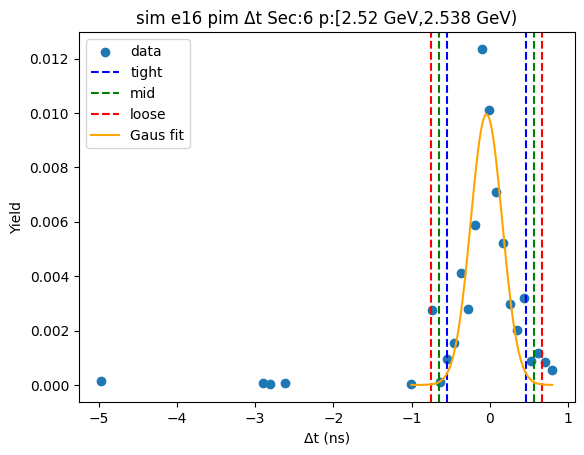

-0.5927910915889959 0.5993734935825149
-0.712007550106147 0.718589952099666
-0.831224008623298 0.837806410616817


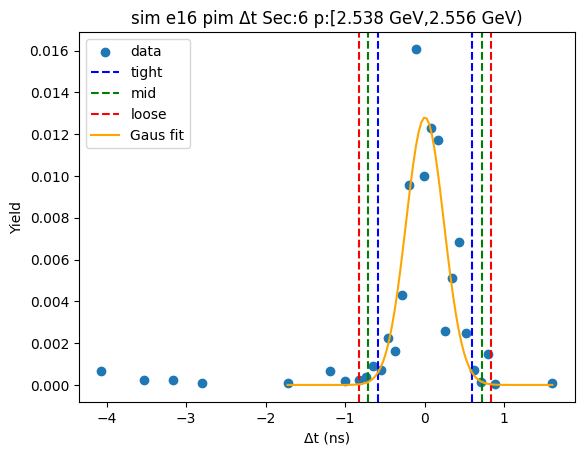

-0.6949400678019575 0.7655651142741464
-0.8409905860095679 0.9116156324817568
-0.9870411042171783 1.0576661506893672


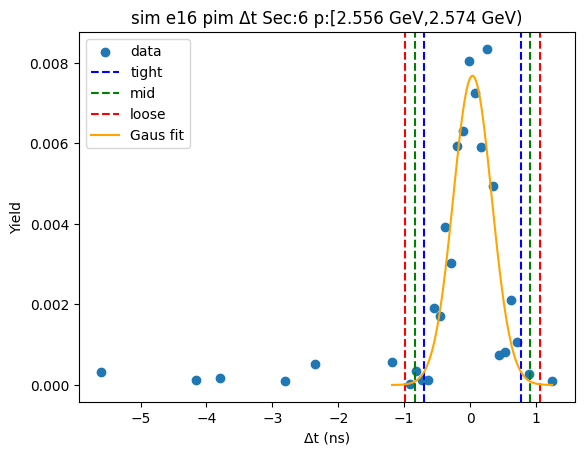

-0.6088343590753574 0.683302028917029
-0.7380479978745961 0.8125156677162676
-0.8672616366738347 0.9417293065155062


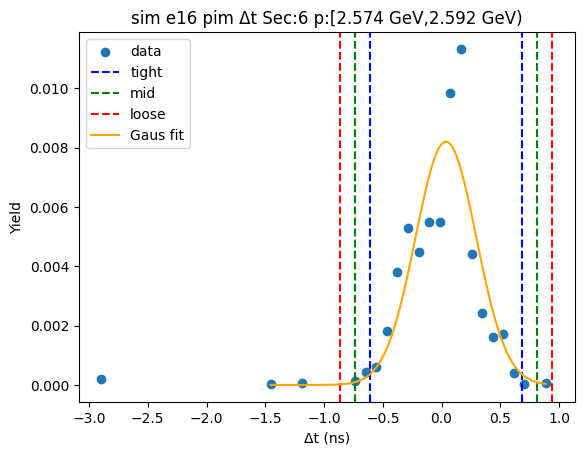

-0.8626675357661149 0.7624852465442946
-1.025182813997156 0.9250005247753355
-1.187698092228197 1.0875158030063765


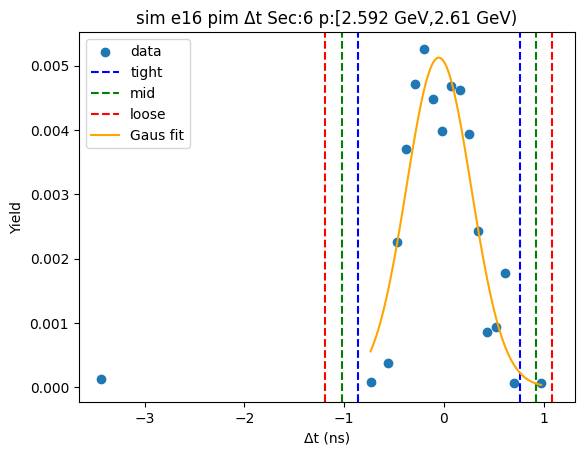

-0.778833386466218 0.693667964238535
-0.9260835215366933 0.8409180993090103
-1.0733336566071685 0.9881682343794855


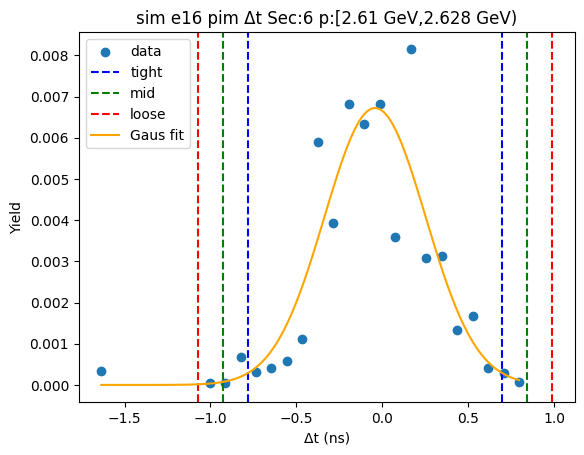

-0.7334713636493121 0.7606371740008587
-0.8828822174143293 0.9100480277658759
-1.032293071179346 1.059458881530893


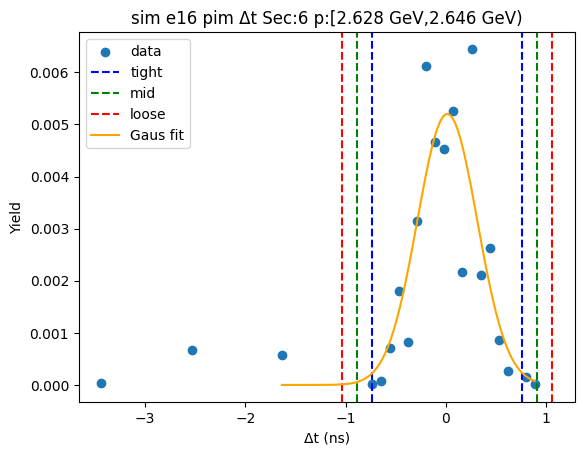

-0.5573217861804441 0.7143395318880467
-0.6844879179872931 0.8415056636948957
-0.8116540497941422 0.9686717955017448


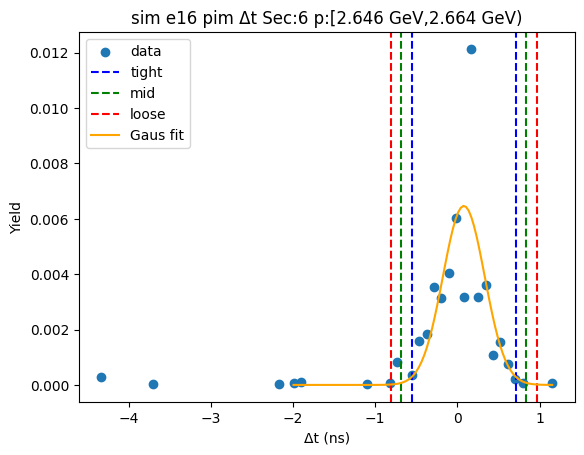

-0.7281043091289824 0.770570573693968
-0.8779717974112775 0.9204380619762631
-1.0278392856935725 1.0703055502585581


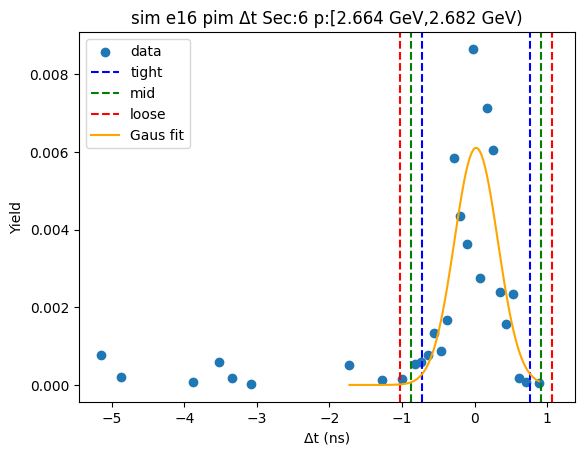

-0.8953409291480631 0.8459867994613003
-1.0694737020089995 1.0201195723222367
-1.2436064748699358 1.194252345183173


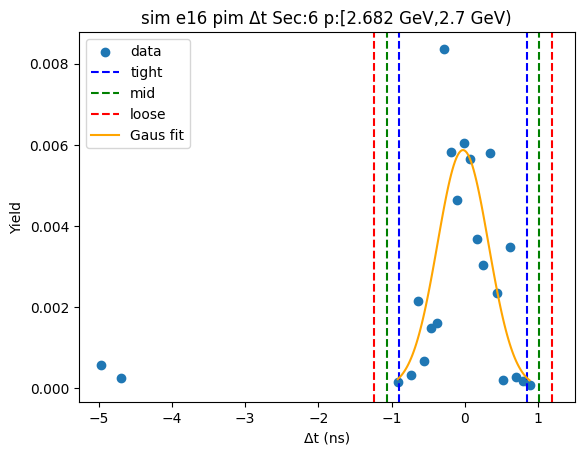

-0.8033659761300078 0.6264443883480222
-0.9463470125778107 0.7694254247958251
-1.0893280490256139 0.9124064612436281


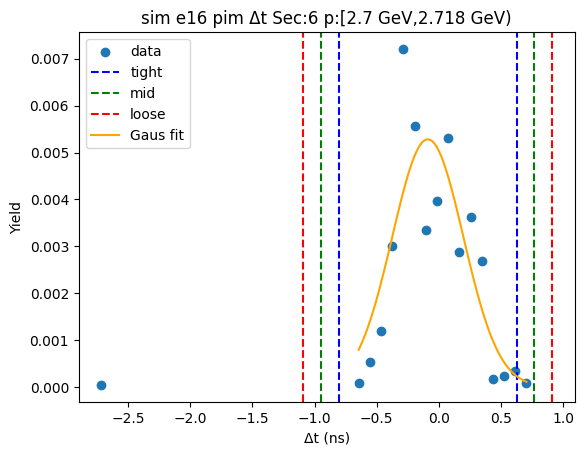

-0.8374630284869425 0.6503532503985737
-0.9862446563754941 0.7991348782871253
-1.1350262842640457 0.9479165061756769


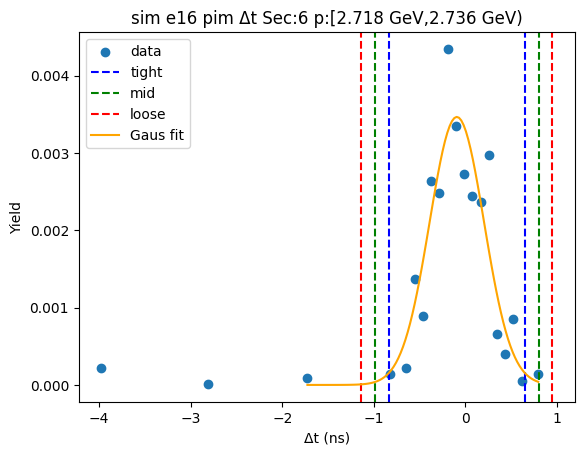

-0.7096377225584585 0.7054012785263175
-0.8511416226669362 0.8469051786347952
-0.9926455227754137 0.9884090787432728


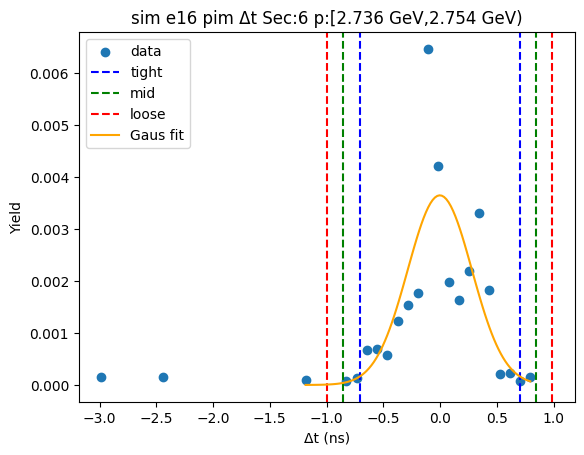

-0.6470058252896143 0.6600530355440957
-0.7777117113729853 0.7907589216274667
-0.9084175974563563 0.9214648077108377


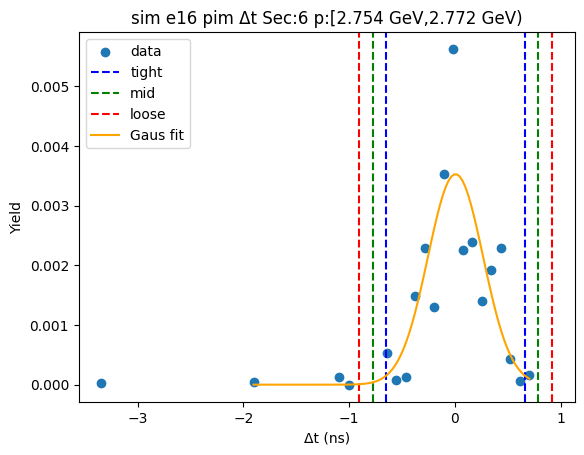

-0.6833340244969763 0.7654582171751985
-0.8282132486641939 0.910337441342416
-0.9730924728314114 1.0552166655096336


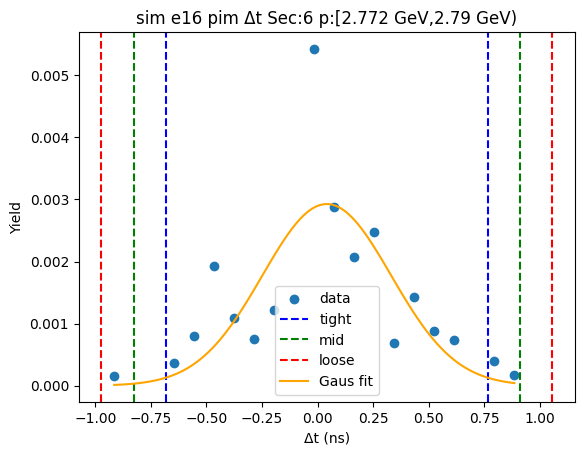

-0.4435613657438949 0.48180698226788216
-0.5360982005450726 0.5743438170690599
-0.6286350353462503 0.6668806518702376


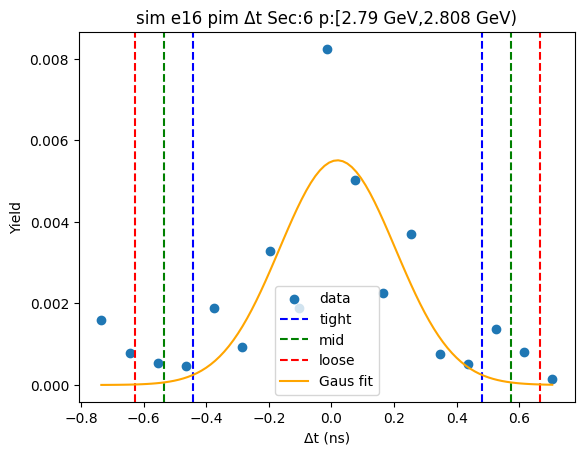

-0.7444460355174383 0.7214410626837757
-0.8910347453375597 0.8680297725038971
-1.037623455157681 1.0146184823240187


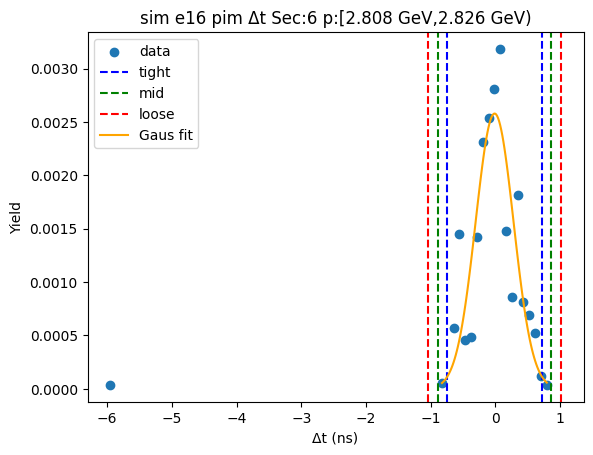

-0.6779521872929517 0.7565478497595144
-0.8214021909981982 0.8999978534647609
-0.9648521947034449 1.0434478571700074


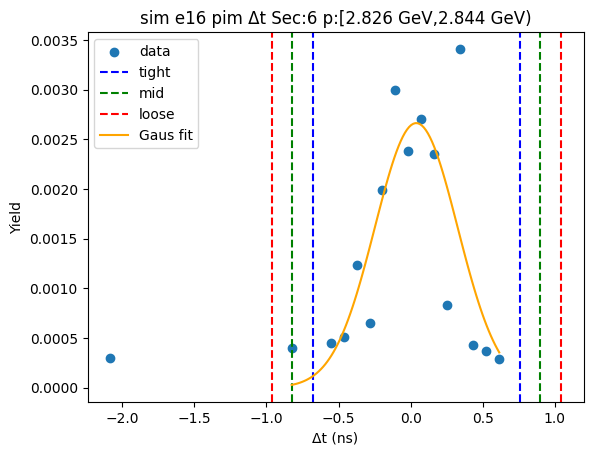

-0.8647656395638287 0.8560784183400326
-1.0368500453542149 1.028162824130419
-1.208934451144601 1.2002472299208051


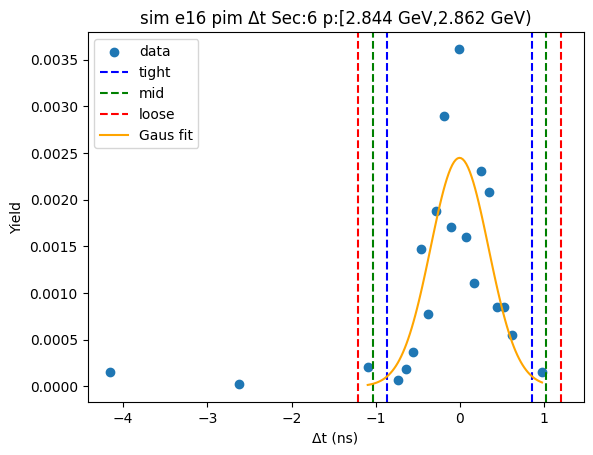

0.0074092137802021785 0.3285478032078033
-0.024704645162557937 0.36066166215056344
-0.05681850410531805 0.3927755210933236


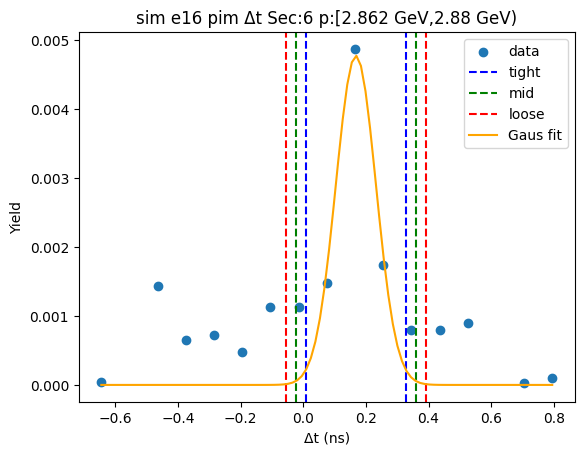

-0.6628882080600657 0.7949783350473408
-0.8086748623708062 0.9407649893580814
-0.9544615166815469 1.086551643668822


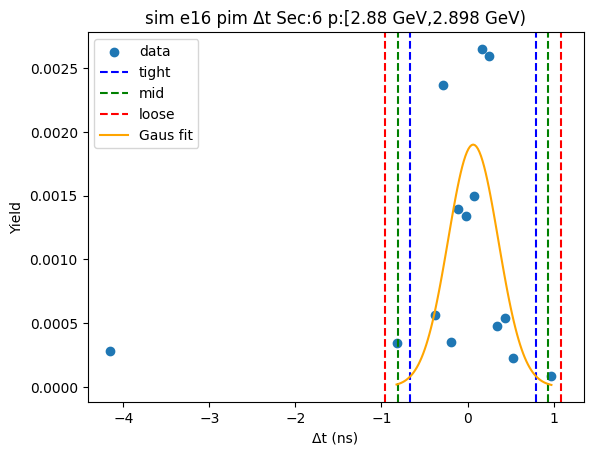

-0.27795754506988213 0.155907419261607
-0.3213440415030311 0.19929391569475596
-0.36473053793618 0.24268041212790487


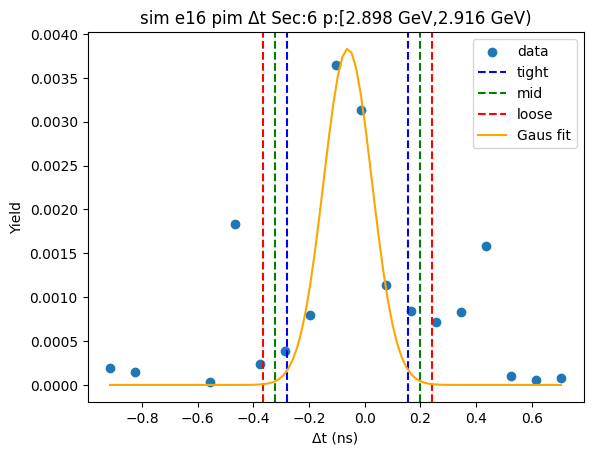

-0.8151856243480371 0.482820618434773
-0.9449862486263182 0.6126212427130541
-1.0747868729045993 0.742421866991335


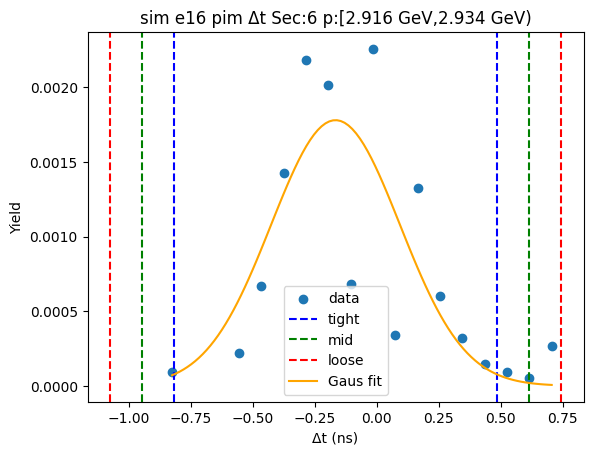

-0.4093408935039749 0.507804984723776
-0.50105548132675 0.599519572546551
-0.592770069149525 0.6912341603693262


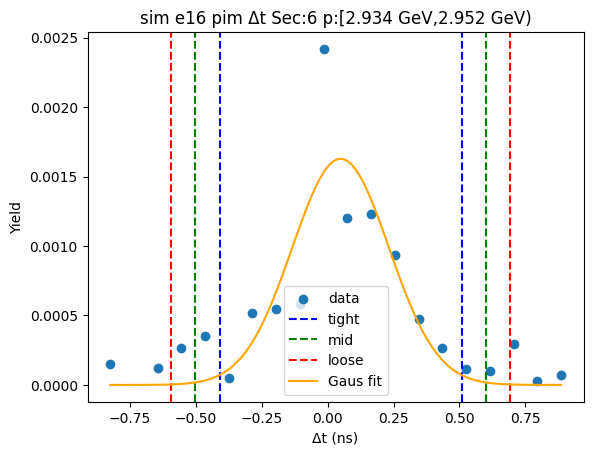

-0.2164004082995798 0.3825603518080019
-0.27629648431033793 0.44245642781876005
-0.33619256032109607 0.5023525038295182


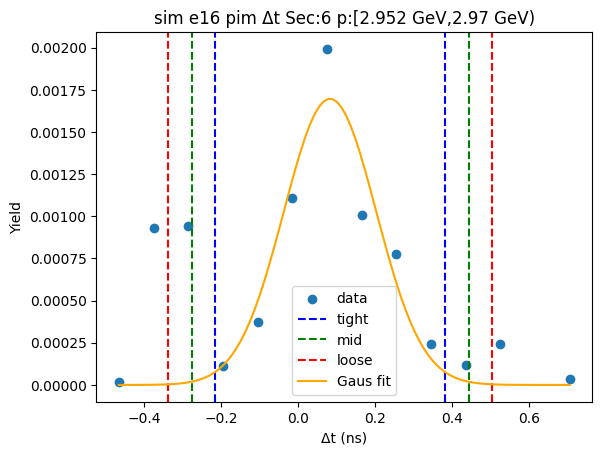

-0.7793143489557894 0.6765156792045444
-0.9248973517718228 0.8220986820205777
-1.070480354587856 0.967681684836611


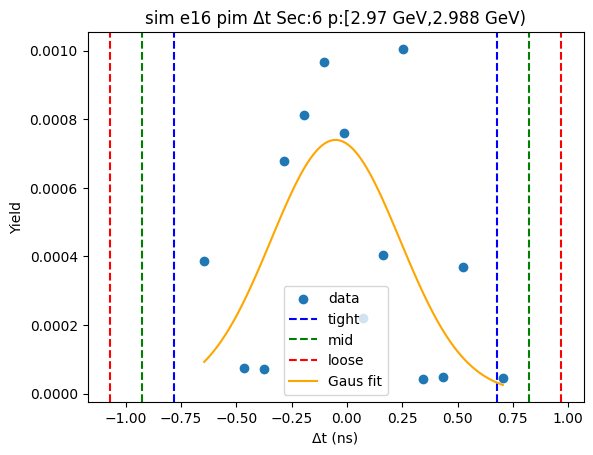

-0.36356271978684346 0.5198191089868
-0.45190090266420785 0.6081572918641643
-0.5402390855415722 0.6964954747415286


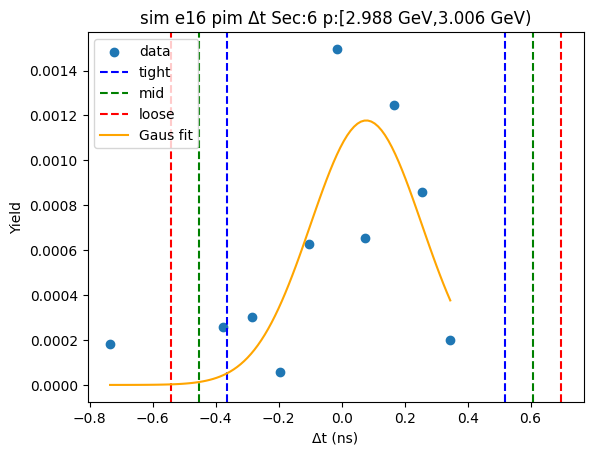

In [38]:
#Initial Guesses for Gaussian Fit
a1=30
m1=0.01
s1=1.5
initial_pars1=[0.002, 0.01855, 0.8616]

initial_pars2 = [30000,-6.0,1.0]

inital_pars3 = []

tmp_par1 = np.zeros(3)
tmp_par2 = np.zeros(6)

#par_bound_low = [0.0,0.0,0.0]
#par_bound_top = [inf,inf,inf]

fit_pars1 = np.zeros((6,len(x),6))
err1 = np.zeros((6,len(x),3))
bound_mod=[0.6,]
low_mod = 1.2
norm_mod=1.2
min_p = [0.2,0.2,0.2,0.2,0.2,0.2]
mid_p = 4.0
p_cutoff = 3.0



num_sigma1 = [2.5,3,3.5]
bounds1 = np.zeros((6,2,3,len(x)))
sigma1= np.zeros((6,2,3,len(x)))

g1_pars = np.zeros((6,len(x),3))
g2_pars = np.zeros((6,len(x),3))

for sec in range(6):
    for i in range(3):
        tmp_par1[i] = initial_pars1[i]
        for j in range(2):
            if j ==0:
                tmp_par2[i+j*3]= initial_pars1[i]
            elif j ==1:
                tmp_par2[i+j*3]= initial_pars2[i]
    for xbin in range(len(x)):
        #print(fit_y[sec][xbin])
        if fit_y[sec][xbin].sum()>0 and x[xbin]>min_p[sec] and x[xbin]<p_cutoff:
            #Set the amplitude guess to the maximum yield value
            initial_pars1[0] = np.amax(fit_y[sec][xbin])
            plt.scatter(fit_x[sec][xbin],fit_y[sec][xbin],label="data")
            #Initial Fitting
            #Set Fit Range
            if x[xbin]<mid_p:  
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x1 = Bounds_on_Y(fit_x[sec][xbin],-2.0,2.0)
                fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-2.0,2.0)
                cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
                try:
                    pars1 = op.curve_fit(Gaus,fit_x1,fit_y1,p0=tmp_par1,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars1[0][i]
                        tmp_par1[i]=pars1[0][i]
                        tmp_par2[i]=pars1[0][i]
                        err1[sec][xbin][i]=np.sqrt(pars1[1][i][i])
                        bounds1[sec][0][i][xbin] = pars1[0][1] - num_sigma1[i]*pars1[0][2]
                        bounds1[sec][1][i][xbin] = pars1[0][1] + num_sigma1[i]*pars1[0][2]
                        sigma1[sec][0][i][xbin] = pars1[1][1][1] - num_sigma1[i]*pars1[1][2][2]
                        sigma1[sec][1][i][xbin] = pars1[1][1][1] + num_sigma1[i]*pars1[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                    plt.plot(cont_x1,Gaus(cont_x1,*pars1[0]),color='orange',label='Gaus fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            else:
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x2 = Bounds_on_Y(fit_x[sec][xbin],-6.0,2.0)
                fit_y2 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x2[sec][xbin],-6.0,2.0)
                cont_x2 = np.linspace(fit_x2[0],fit_x2[len(fit_x2)-1],100)
                plt.plot(cont_x2,Gaus2(cont_x2,*tmp_par2),color='r',label='Inital 2Gaus fit')
                try:
                    pars2 = op.curve_fit(Gaus2,fit_x2,fit_y2,p0=tmp_par2,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars2[0][i]
                        g1_pars[sec][xbin][i] = pars2[0][i]
                        g2_pars[sec][xbin][i] = pars2[0][i+3]
                        err1[sec][xbin][i]=np.sqrt(pars2[1][i][i])
                        bounds1[sec][0][i][xbin] = pars2[0][1] - num_sigma1[i]*pars2[0][2]
                        bounds1[sec][1][i][xbin] = pars2[0][1] + num_sigma1[i]*pars2[0][2]
                        sigma1[sec][0][i][xbin] = pars2[1][1][1] - num_sigma1[i]*pars2[1][2][2]
                        sigma1[sec][1][i][xbin] = pars2[1][1][1] + num_sigma1[i]*pars2[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                        for j in range(2):
                            tmp_par2[i+j*3]= pars2[0][i+j*3]
                    plt.plot(cont_x2,Gaus2(cont_x2,*pars2[0]),color='orange',label='2Gaus fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g1_pars[0][xbin]),color='c',label='Proton fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g2_pars[0][xbin]),color='m',label='\u03C0+ fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            
            
            #if np.sqrt(pars1[1][1][1])/pars1[0][1] < 0.1:
            
            
           
            plot_title="{} {} {} \u0394t Sec:{} p:[{} GeV,{} GeV)".format(sim,run,species,sec+1,Pbin_low(xbin),Pbin_top(xbin))
            plt.title(plot_title)
            plt.xlabel("\u0394t (ns)")
            plt.ylabel("Yield")
            plt.legend()
            plt.show()

In [39]:

for sec in range(6):
    for cut in range(3):
        for xbin in range(len(x)):
            bounds1[sec][0][cut][xbin] = fit_pars1[sec][xbin][1]-num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][0][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]
            bounds1[sec][1][cut][xbin] = fit_pars1[sec][xbin][1]+num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][1][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]

(array([-0.9167096 ,  0.36683726, -0.23486287,  0.05350617]), array([[ 2.04487038e-04, -5.79420018e-04,  4.67155979e-04,
        -1.10946956e-04],
       [-5.79420018e-04,  1.77370197e-03, -1.50386961e-03,
         3.69874690e-04],
       [ 4.67155979e-04, -1.50386961e-03,  1.33192341e-03,
        -3.39168190e-04],
       [-1.10946956e-04,  3.69874690e-04, -3.39168190e-04,
         8.92410850e-05]]))
(array([ 0.97554013, -0.46619872,  0.30356246, -0.06745005]), array([[ 1.92126292e-04, -5.44395478e-04,  4.38917525e-04,
        -1.04240479e-04],
       [-5.44395478e-04,  1.66648596e-03, -1.41296430e-03,
         3.47516652e-04],
       [ 4.38917525e-04, -1.41296430e-03,  1.25141183e-03,
        -3.18666285e-04],
       [-1.04240479e-04,  3.47516652e-04, -3.18666285e-04,
         8.38466748e-05]]))
(array([-1.10598961,  0.45034762, -0.28892147,  0.06566698]), array([[ 0.00027976, -0.00079275,  0.0006392 , -0.00015182],
       [-0.00079275,  0.00242689, -0.00205783,  0.00050616],
       [

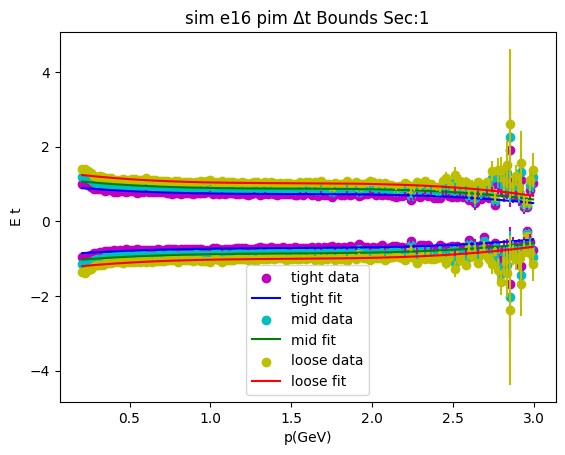

(array([-0.88462251,  0.26267714, -0.14137647,  0.02976616]), array([[ 1.86322546e-04, -5.00832253e-04,  3.88783915e-04,
        -9.02357275e-05],
       [-5.00832253e-04,  1.44817735e-03, -1.17918841e-03,
         2.83189228e-04],
       [ 3.88783915e-04, -1.17918841e-03,  9.99728931e-04,
        -2.48145827e-04],
       [-9.02357275e-05,  2.83189228e-04, -2.48145827e-04,
         6.35295039e-05]]))
(array([ 0.91354195, -0.25284644,  0.11670382, -0.02093102]), array([[ 1.68041891e-04, -4.51694123e-04,  3.50639178e-04,
        -8.13824340e-05],
       [-4.51694123e-04,  1.30609240e-03, -1.06349476e-03,
         2.55404697e-04],
       [ 3.50639178e-04, -1.06349476e-03,  9.01642573e-04,
        -2.23799506e-04],
       [-8.13824340e-05,  2.55404697e-04, -2.23799506e-04,
         5.72964363e-05]]))
(array([-1.06438771,  0.31405316, -0.16701453,  0.03478805]), array([[ 2.54139330e-04, -6.83171596e-04,  5.30372724e-04,
        -1.23109415e-04],
       [-6.83171596e-04,  1.97554625e-03, -1.

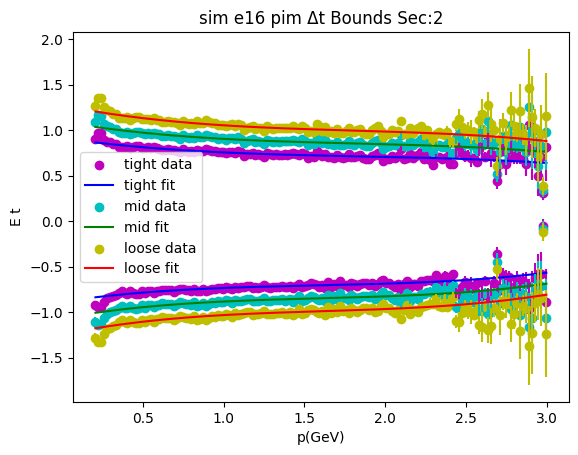

(array([-0.88841646,  0.28329217, -0.1672521 ,  0.03898575]), array([[ 2.07757341e-04, -5.89451370e-04,  4.61958991e-04,
        -1.04793941e-04],
       [-5.89451370e-04,  1.79761893e-03, -1.47282584e-03,
         3.44330868e-04],
       [ 4.61958991e-04, -1.47282584e-03,  1.25581806e-03,
        -3.03225064e-04],
       [-1.04793941e-04,  3.44330868e-04, -3.03225064e-04,
         7.55943780e-05]]))
(array([ 0.9914752 , -0.538816  ,  0.38723474, -0.09472026]), array([[ 0.0002946 , -0.00083583,  0.00065505, -0.0001486 ],
       [-0.00083583,  0.00254899, -0.00208844,  0.00048825],
       [ 0.00065505, -0.00208844,  0.00178072, -0.00042997],
       [-0.0001486 ,  0.00048825, -0.00042997,  0.00010719]]))
(array([-1.07658202,  0.36615135, -0.22335567,  0.05254654]), array([[ 0.00029552, -0.00083832,  0.00065688, -0.00014898],
       [-0.00083832,  0.00255626, -0.00209403,  0.00048945],
       [ 0.00065688, -0.00209403,  0.00178519, -0.00043095],
       [-0.00014898,  0.00048945, -0.000430

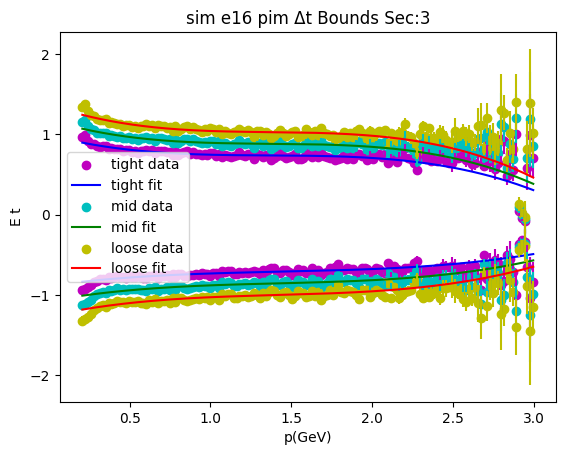

(array([-0.89841953,  0.32130998, -0.20757279,  0.04982536]), array([[ 1.68935323e-04, -4.82309796e-04,  3.81625953e-04,
        -8.81376365e-05],
       [-4.82309796e-04,  1.48851315e-03, -1.23392470e-03,
         2.94155859e-04],
       [ 3.81625953e-04, -1.23392470e-03,  1.06490909e-03,
        -2.62324244e-04],
       [-8.81376365e-05,  2.94155859e-04, -2.62324244e-04,
         6.67151528e-05]]))
(array([ 0.92913482, -0.32956869,  0.19000945, -0.03996268]), array([[ 1.58701555e-04, -4.53092421e-04,  3.58507807e-04,
        -8.27984328e-05],
       [-4.53092421e-04,  1.39834196e-03, -1.15917598e-03,
         2.76336478e-04],
       [ 3.58507807e-04, -1.15917598e-03,  1.00039900e-03,
        -2.46433160e-04],
       [-8.27984328e-05,  2.76336478e-04, -2.46433160e-04,
         6.26736808e-05]]))
(array([-1.0812016 ,  0.38649804, -0.24743405,  0.05883472]), array([[ 2.33152732e-04, -6.65667347e-04,  5.26723646e-04,
        -1.21653078e-04],
       [-6.65667347e-04,  2.05444239e-03, -1.

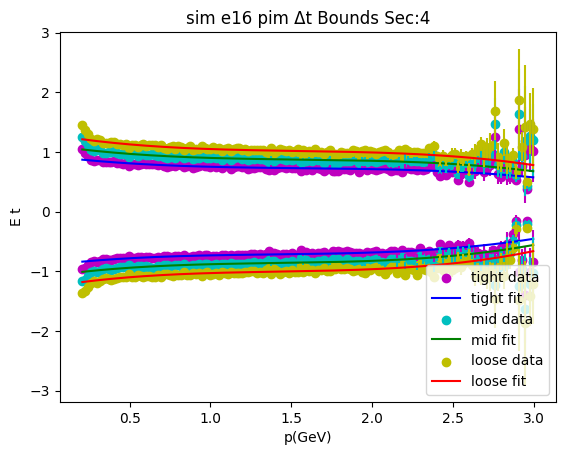

(array([-0.94423295,  0.42114097, -0.27300994,  0.06341401]), array([[ 0.00035229, -0.00094369,  0.00072037, -0.00016234],
       [-0.00094369,  0.00272446, -0.00218095,  0.00050788],
       [ 0.00072037, -0.00218095,  0.00181717, -0.00043696],
       [-0.00016234,  0.00050788, -0.00043696,  0.00010832]]))
(array([ 1.00638061, -0.57272916,  0.41516579, -0.10062423]), array([[ 0.0004555 , -0.00122016,  0.00093141, -0.0002099 ],
       [-0.00122016,  0.00352263, -0.00281989,  0.00065667],
       [ 0.00093141, -0.00281989,  0.00234954, -0.00056497],
       [-0.0002099 ,  0.00065667, -0.00056497,  0.00014005]]))
(array([-1.14014326,  0.52356763, -0.34486539,  0.08070113]), array([[ 0.00050501, -0.00135227,  0.00103178, -0.00023239],
       [-0.00135227,  0.00390263, -0.00312265,  0.00072676],
       [ 0.00103178, -0.00312265,  0.00260061, -0.00062498],
       [-0.00023239,  0.00072676, -0.00062498,  0.00015483]]))
(array([ 1.2025854 , -0.67621097,  0.48807663, -0.11821847]), array([[ 0.000

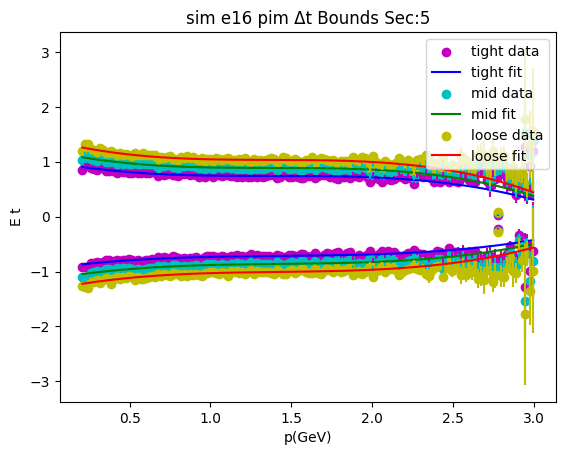

(array([-0.92641866,  0.46593293, -0.34888638,  0.08625051]), array([[ 0.00032175, -0.00093562,  0.00073845, -0.00016769],
       [-0.00093562,  0.00292383, -0.00241162,  0.00056416],
       [ 0.00073845, -0.00241162,  0.00207363, -0.00050153],
       [-0.00016769,  0.00056416, -0.00050153,  0.00012529]]))
(array([ 0.92464292, -0.38795723,  0.28101334, -0.06894911]), array([[ 2.17861625e-04, -6.33520906e-04,  5.00014613e-04,
        -1.13548640e-04],
       [-6.33520906e-04,  1.97977303e-03, -1.63295189e-03,
         3.82005569e-04],
       [ 5.00014613e-04, -1.63295189e-03,  1.40408960e-03,
        -3.39591508e-04],
       [-1.13548640e-04,  3.82005569e-04, -3.39591508e-04,
         8.48345556e-05]]))
(array([-1.11194235,  0.55290493, -0.41351485,  0.10225416]), array([[ 0.00043626, -0.00126842,  0.00100092, -0.00022724],
       [-0.00126842,  0.00396332, -0.00326838,  0.0007644 ],
       [ 0.00100092, -0.00326838,  0.00280976, -0.0006794 ],
       [-0.00022724,  0.0007644 , -0.000679

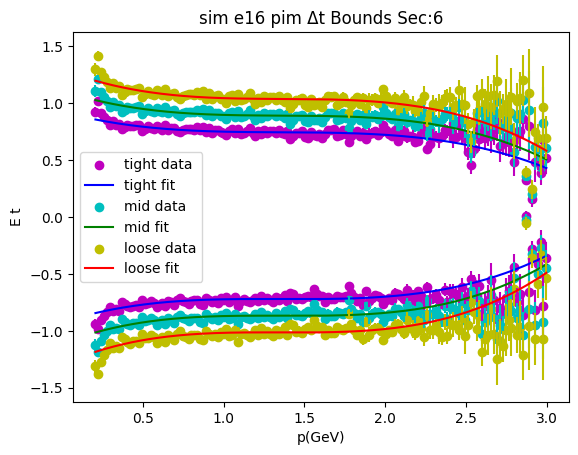

In [40]:
l0=0.0
l1=0.5
l2=-0.2
l3=0.2
initial_low_par2=[l0,l1,l2,l3]
t0=0.0
t1=0.5
t2=-0.2
t3=-0.2
initial_top_par2=[t0,t1,t2,t3]

low_par_fit= np.zeros((6,3,4))
top_par_fit = np.zeros((6,3,4))

cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

par_bou = [[[-np.inf,-np.inf,-np.inf,0.0],[np.inf,np.inf,np.inf,np.inf]],
           [[-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,0.0]]]

for sec in range(6):
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),label="{} data".format(cut_name[cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),yerr=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),fmt='',linestyle='',color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),yerr=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),fmt='',linestyle='',color=data_cols[cut])
        #Fit with 3rd order Polynomial 
        par_low1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),p0=initial_low_par2,sigma=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),bounds=par_bou[0],maxfev=5000)
        par_top1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),p0=initial_top_par2,sigma=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),bounds=par_bou[1],maxfev=5000)
        print(par_low1)
        print(par_top1)
        for i in range(4):
            low_par_fit[sec][cut][i] = par_low1[0][i]
            top_par_fit[sec][cut][i] = par_top1[0][i]
        cont_x_low = np.linspace(Remove_Zeros_X(x,bounds1[sec][0][cut])[0],Remove_Zeros_X(x,bounds1[sec][0][cut])[len(Remove_Zeros_X(x,bounds1[sec][0][cut]))-1],200)
        cont_x_top = np.linspace(Remove_Zeros_X(x,bounds1[sec][1][cut])[0],Remove_Zeros_X(x,bounds1[sec][1][cut])[len(Remove_Zeros_X(x,bounds1[sec][1][cut]))-1],200)
        plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color=cut_cols[cut],label="{} fit".format(cut_name[cut]))
        plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color=cut_cols[cut])
    plot_title="{} {} {} \u0394t Bounds Sec:{}".format(sim,run,species,sec+1)
    plt.title(plot_title)
    plt.xlabel(xname)
    plt.ylabel(yname)
    plt.legend()
    plt.show()

In [41]:
#Stuff to make it so I can plot a 2d Histogram with data in the format I have
#Would be a lot easier if I had uproot 4 working 
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    for i in range(len(xbins)):
        for j in range(len(ybins)):
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]

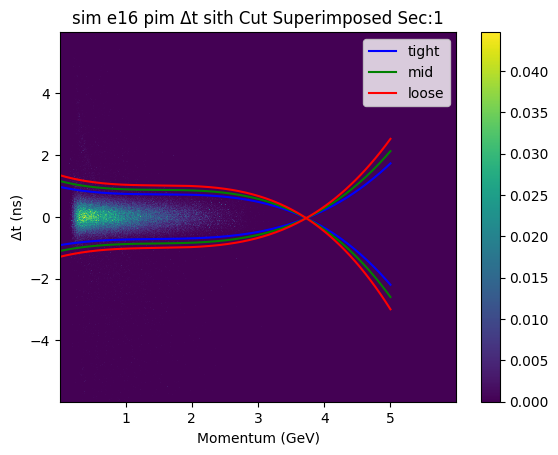

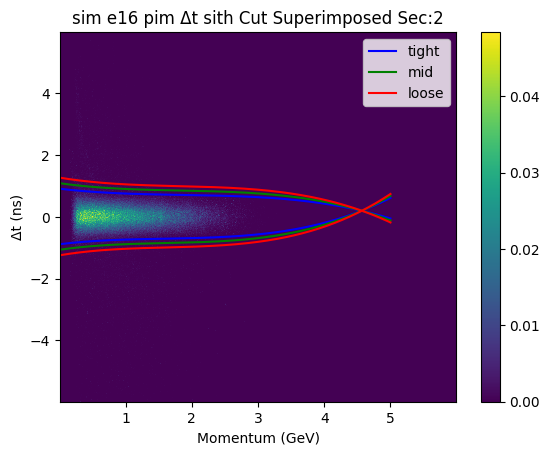

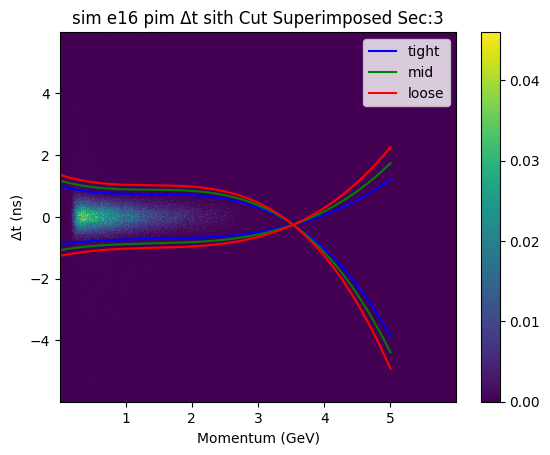

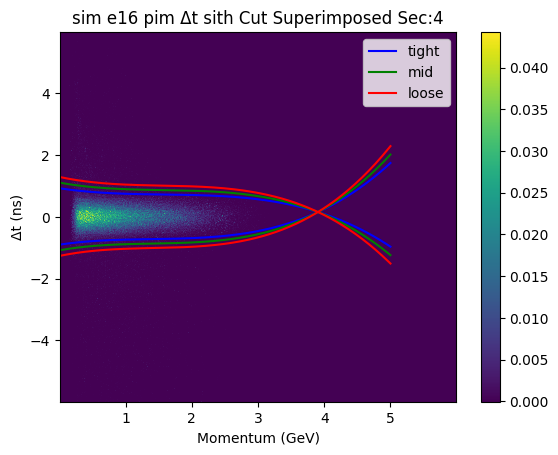

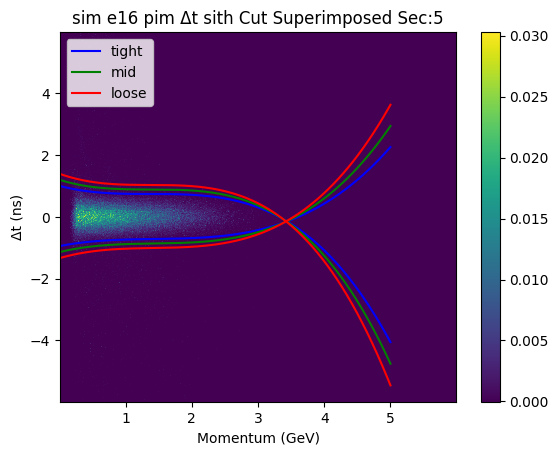

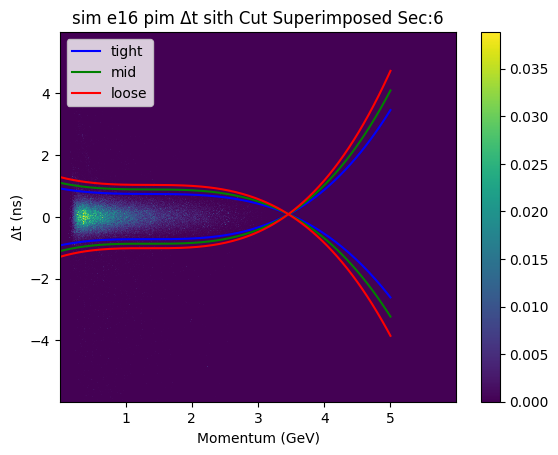

In [45]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(xbins), len(ybins)), weights=dense2[sec])
    for cut in range(3):
        #plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),color=data_cols[cut])
        #plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        cont_x_low2 = np.linspace(0.0,5.0,200)
        cont_x_top2 = np.linspace(0.0,5.0,200)
        plt.plot(cont_x_low2,Poly3(cont_x_low2,*low_par_fit[sec][cut]),color=cut_cols[cut],label=cut_name[cut])
        plt.plot(cont_x_top2,Poly3(cont_x_top2,*top_par_fit[sec][cut]),color=cut_cols[cut])
        #cont_x_low = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut]))-1],200)
        #cont_x_top = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut]))-1],200)
        #plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color='y')
        #plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color='y')
    plt.title("{} {} {} \u0394t sith Cut Superimposed Sec:{}".format(sim,run,species,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("\u0394t (ns)")
    plt.colorbar()
    plt.legend()
    plt.show()
    
    

In [43]:
print(cut_perf+" "+species+" Cut Parameters for ",num_sigma1," sigma cut using 3rd order Polynomial")
print("Lower Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        #print("{\t{\t{",low_par_fit[sec][cut][par],end=",")
                        print("{\t{\t{",low_par_fit[4][cut][par],end=",")
                    else:
                        #print("\t{\t{",low_par_fit[sec][cut][par],end=",")
                        print("\t{\t{",low_par_fit[4][cut][par],end=",")
                else:
                    #print("\t\t{",low_par_fit[sec][cut][par],end=",")
                    print("\t\t{",low_par_fit[4][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            #print(low_par_fit[sec][cut][par],"}}}")
                            print(low_par_fit[4][cut][par],"}}}")
                        else:
                            print(low_par_fit[4][cut][par],"}},")
                            #print(low_par_fit[sec][cut][par],"}},")
                    else:
                        #print(low_par_fit[sec][cut][par],"},")
                        print(low_par_fit[4][cut][par],"},")
                else:
                    #print(low_par_fit[sec][cut][par],end=",")
                    print(low_par_fit[4][cut][par],end=",")
print("Upper Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        #print("{\t{\t{",top_par_fit[sec][cut][par],end=",")
                        print("{\t{\t{",top_par_fit[4][cut][par],end=",")
                    else:
                        #print("\t{\t{",top_par_fit[sec][cut][par],end=",")
                        print("\t{\t{",top_par_fit[4][cut][par],end=",")
                else:
                    #print("\t\t{",top_par_fit[sec][cut][par],end=",")
                    print("\t\t{",top_par_fit[4][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            #print(top_par_fit[sec][cut][par],"}}}")
                            print(top_par_fit[4][cut][par],"}}}")
                        else:
                            #print(top_par_fit[sec][cut][par],"}},")
                            print(top_par_fit[4][cut][par],"}},")
                    else:
                        #print(top_par_fit[sec][cut][par],"},")
                        print(top_par_fit[4][cut][par],"},")
                else:
                    #print(top_par_fit[sec][cut][par],end=",")
                    print(top_par_fit[4][cut][par],end=",")
#print(low_par_fit)
#print(top_par_fit)

delta pim Cut Parameters for  [2.5, 3, 3.5]  sigma cut using 3rd order Polynomial
Lower Bound in order of increasing exponent
{	{	{ -0.9442329488333996,0.42114097317212296,-0.2730099447528664,0.06341401285131172 },
		{ -1.1401432580091695,0.523567633111543,-0.3448653902322543,0.08070112575894238 },
		{ -1.3361782776595355,0.6264409668903603,-0.4171674131516244,0.09811813343949308 }},
	{	{ -0.9442329488333996,0.42114097317212296,-0.2730099447528664,0.06341401285131172 },
		{ -1.1401432580091695,0.523567633111543,-0.3448653902322543,0.08070112575894238 },
		{ -1.3361782776595355,0.6264409668903603,-0.4171674131516244,0.09811813343949308 }},
	{	{ -0.9442329488333996,0.42114097317212296,-0.2730099447528664,0.06341401285131172 },
		{ -1.1401432580091695,0.523567633111543,-0.3448653902322543,0.08070112575894238 },
		{ -1.3361782776595355,0.6264409668903603,-0.4171674131516244,0.09811813343949308 }},
	{	{ -0.9442329488333996,0.42114097317212296,-0.2730099447528664,0.06341401285131172 },
		{ -